<a href="https://colab.research.google.com/github/dolmani38/concept_drift/blob/main/Generative-CDTL_part2_1204.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Concept drift tolerant machine learning method

In [ ]:
import numpy as np
import pandas as pd
import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [ ]:
import random
import os
def seed_everything(seed: int = 46):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    #tf.random.set_seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [ ]:
!pip install deepspeed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 17.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.0/54.0 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 35.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 8.5 MB/s eta 0:00:00
  Created wheel for deepspeed: filename=deepspeed-0.12.4-py3-none-any.whl size=1290645 sha256=67a4a2934061e9ce7d333f590e64822681085f5090e32c0ed0e6c470008fb2df
  Stored in directory: /root/.cache/pip/wheels/7b/0c/52/f464610477b069120f740202a9d84a27f9d7235cbf035c4b75
Successfully built deepspeed


In [ ]:
if True:
    from google.colab import drive
    drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
temp_discriminator_flops = 0
temp_G_CDTL_flops = 0

# 실험을 위한 기본적인 function 들...

In [75]:
import sys, os
import math

from torch.autograd import Variable
from argparse import Namespace
#from FRTrain_arch import Generator, DiscriminatorF, DiscriminatorR, weights_init_normal, test_model
#from FRTrain_arch import weights_init_normal, test_model
import warnings
warnings.filterwarnings("ignore")

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

In [76]:
main_figsize=(15,3)

plt.rc('font', size=10)        # 기본 폰트 크기
plt.rc('axes', labelsize=10)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=10)  # x축 눈금 폰트 크기
plt.rc('ytick', labelsize=10)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=10)  # 범례 폰트 크기
plt.rc('figure', titlesize=10) # figure title 폰트 크기


In [77]:
def weights_init_normal(m):
    """Initializes the weight and bias of the model.

    Args:
        m: A torch model to initialize.

    Returns:
        None.
    """

    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find('Linear') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.2)
        torch.nn.init.constant_(m.bias.data, 0)


In [78]:
# Define the Generator
# bucket에 대해 x를 전처리
class Generator(nn.Module):
    #__flops__ = 0

    def __init__(self,input_dim):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        self.fc1 = nn.ModuleList()
        #self.fc1.__setattr__('__flops__',torch.tensor(0))
        #self.fc2 = nn.ModuleList()
        self.fc3 = nn.ModuleList()
        #self.fc3.__setattr__('__flops__',torch.tensor(0))

        for i in range(self.input_dim):
            self.fc1.append(nn.Linear(2, 50))
            #self.fc2.append(nn.BatchNorm1d(num_features=50))
            self.fc3.append(nn.Linear(50, 1))

        #self.fc = nn.Linear(input_dim, input_dim)

    def forward(self,x,b):
        pxy = []
        for i in range(self.input_dim):
            h0 = self.fc1[i](torch.cat((x[:,i].reshape(-1,1),b), 1))
            #h1 = F.relu(self.fc2[i](h0))
            #h2 = self.fc3[i](h1)
            h2 = self.fc3[i](F.relu(h0))
            pxy.append(h2)

        #return self.fc(torch.tensor(torch.cat(pxy, dim=1), requires_grad = True))
        return torch.cat(pxy, dim=1)


In [79]:
# Define the Discriminator
# 비즈니스에 해당하는 모델
class Discriminator(nn.Module):

    def __init__(self, input_dim=5):
        """Initializes Discriminator with torch components."""
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, input_dim*4),
            nn.ReLU(),
            nn.Linear(input_dim*4, input_dim),
            nn.ReLU(),
            nn.Linear(input_dim, 1),
            nn.Sigmoid()
        )
        self.input_dim = input_dim
        self.inference_flops = 0

    def forward(self, input_data):
        """Defines a forward operation of the model.

        Args:
            input_data: The input data.

        Returns:
            The predicted label (y_hat) for the given input data.
        """
        self.inference_flops = self.inference_flops + 435*input_data.shape[0]
        output = self.model(input_data[:,0:self.input_dim])
        return output

    def predict(self, input_data):
        return self.forward(input_data), input_data[:,0:self.input_dim]

In [80]:
from deepspeed.profiling.flops_profiler import get_model_profile

"""
discriminator inference flops for 1 batch (9000,5)= 3,915,000
discriminator inference flops for 1 data (1,5)= 435
G-CDTL inference flops for 1 batch (9000,5)= 19,665,000
G-CDTL inference flops for 1 data (1,5)= 2,185

"""

def test_all_data(model,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break


    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    sp = X_live_set.cpu().data.numpy().shape

    print('Search MI & Drift...for X_live_set',sp)

    """
    batch_size = sp[0]
    flops, macs, params = get_model_profile(model=model, # model
                                    input_shape=(sp[1],sp[2]), # input shape to the model. If specified, the model takes a tensor with this shape as the only positional argument.
                                    args=None, # list of positional arguments to the model.
                                    kwargs=None, # dictionary of keyword arguments to the model.
                                    print_profile=False, # prints the model graph with the measured profile attached to each module
                                    detailed=False, # print the detailed profile
                                    as_string=False, # print raw numbers (e.g. 1000) or as human-readable strings (e.g. 1k)
                                    output_file=None, # path to the output file. If None, the profiler prints to stdout.
                                    ignore_modules=None) # the list of modules to ignore in the profiling

    print('Profile - Inference flops:',flops*batch_size)
    """

    inference_flops = 0
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):

        # Inference flops 계산!!!!!!!!!!!!!!
        if isinstance(model, G_CDTL):
            inference_flops = inference_flops + 2185*X_live_unit.shape[0]
        elif isinstance(model, Discriminator):
            inference_flops = inference_flops + 435*X_live_unit.shape[0]

        predicted_y,xs = model.predict(X_live_unit)
        predicted_y = (predicted_y.cpu().data.numpy()> 0.5).astype(float)
        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        cpu_xs = xs.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf,inference_flops

In [81]:

from sklearn.metrics import r2_score,precision_recall_fscore_support,f1_score
import scipy

#https://www.deepspeed.ai/tutorials/flops-profiler/
from deepspeed.profiling.flops_profiler import FlopsProfiler

"""
discriminator train flops (4000 epoch) : 15660000000
generator train flops (4000 epoch) : 63000000000

discriminator train flops / epoch for (9000,5) = 3,915,000
discriminator train flops / epoch for (1,5) = 435
generator train flops / epoch for (9000,5) = 15,750,000
generator train flops / epoch for (1,5) = 1,750
"""
def train_model(train_tensors, test_tensors, train_opt, lambda_f, avaible_range, alpha, columns,ShowChart = False, do_mine=True):
    #seed_everything()

    global temp_discriminator_flops
    global temp_G_CDTL_flops

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    print(device)

    lambda_f = torch.tensor([lambda_f],dtype=torch.float32).to(device)

    XS_train = train_tensors.XS_train.to(device)
    y_train = train_tensors.y_train.to(device)
    #s1_train = train_tensors.s1_train.to(device)

    XS_test = test_tensors.XS_test.to(device)
    y_test = test_tensors.y_test.to(device)
    #s1_test = test_tensors.s1_test.to(device)

    # Saves return values here
    #test_result = []

    val = train_opt.val # Number of data points in validation set
    k = train_opt.k     # Update ratio of generator and discriminator (1:k training).
    n_epochs = train_opt.n_epochs  # Number of training epoch

    b_dim = XS_train.shape[1]-1

    model = None
    g_losses =[]
    a_losses = []
    if lambda_f < 0.0:
        discriminator = Discriminator(b_dim).to(device)
        discriminator.apply(weights_init_normal)

        optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        bce_loss = nn.BCELoss()

        discriminator_prof = FlopsProfiler(discriminator,None)
        discriminator_prof.start_profile()
        temp_loss = 10000
        m_flops = 0
        for epoch in tqdm(range(n_epochs)):
            a_loss = torch.tensor(0.0)
            gen_y = discriminator(XS_train[:,0:b_dim]).reshape(-1,1)
            g_loss = bce_loss(gen_y, y_train.reshape(-1,1)) #+ torch.log(mine_loss.mean()+1)*0.001

            optimizer_D.zero_grad()

            loss = g_loss #(alpha*g_loss + (1-alpha)*a_loss) * 2
            loss.backward()

            optimizer_D.step()

            a_losses.append(a_loss.cpu().data.numpy())
            g_losses.append(g_loss.cpu().data.numpy())

            m_flops = m_flops + 435*XS_train.shape[0]

            if temp_loss < loss:
                break

            temp_loss = loss

        print('Early stop:',epoch)
        model = discriminator

        discriminator_prof.stop_profile()
        total_flops = discriminator_prof.get_total_flops()
        flops = total_flops - temp_discriminator_flops
        temp_discriminator_flops = total_flops
        discriminator_prof.end_profile()

        print('Normal discriminator train flops :',m_flops)

    else:
        # Initializes generator and discriminator
        discriminator = Discriminator(b_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(b_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)

        a_losses,g_losses,epoch, g_flops, d_flops = g_cdtl.train(XS_train,y_train,train_opt,avaible_range,alpha,do_early_stop=False)
        #flops = total_flops - temp_G_CDTL_flops
        #temp_G_CDTL_flops = total_flops
        m_flops = g_flops+d_flops
        model = g_cdtl

    model.eval()
    y_hat, xs = model.predict(XS_test)
    y_hat = (y_hat.cpu().data.numpy()> 0.5).astype(float)
    ty_ = y_test.cpu().data.numpy()
    prf = precision_recall_fscore_support(ty_,y_hat)
    print('precision_recall_fscore:',prf)
    f1 = prf[2][1]
    print('Test f1 score:',f1)
    df_loss = pd.DataFrame({'Generator loss':a_losses,'Predictor loss':g_losses})

    if ShowChart:
        #display(df_loss)
        #df_loss.plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel=f'bucket ({XS_train.shape[0]})',fontsize=15)
        df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        plt.legend(loc=1)
        plt.show()

    return f1,model,df_loss,m_flops

In [82]:
plt.style.use('bmh')

def __ks_2samp2(sample1, sample2):
    # Gets all observations
    sample1 = np.sort(sample1)
    sample2 = np.sort(sample2)
    n1 = sample1.shape[0]
    n2 = sample2.shape[0]
    data_all = np.concatenate([sample1, sample2])
    cdf1 = np.searchsorted(sample1, data_all, side='right') / n1
    cdf2 = np.searchsorted(sample2, data_all, side='right') / n2
    # Evaluates the KS statistic
    cddiffs = cdf1 - cdf2
    minS = -np.min(cddiffs)
    maxS = np.max(cddiffs)
    ks_stat =  max(minS, maxS)

    #if ks_stat == minS:
    #    ks_stat = -ks_stat

    # Calculates the P-Value based on the two-sided test
    # The P-Value comes from the KS Distribution Survival Function (SF = 1-CDF)
    m, n = float(n1), float(n2)
    en = m * n / (m + n)
    p_value = 0.0 #stats.kstwobign.sf(math.sqrt(en) * abs(ks_stat))
    #p_value = stats.kstwobign.sf(en * abs(ks_stat))
    return ks_stat,p_value

def __ks_drift(ref_x,inf_x):
    x_drift = np.zeros((ref_x.shape[1],2))
    for i in range(ref_x.shape[1]):
        #s, p = ks_2samp(ref_x[:,i],inf_x[:,i],mode='asymp')
        s, p = __ks_2samp2(ref_x[:,i],inf_x[:,i])
        x_drift[i,0] = s
        x_drift[i,1] = p
    return x_drift

In [83]:
from sklearn.feature_selection import mutual_info_regression, mutual_info_classif

def make_mi_scores(X, y, discrete_features):
    mi_scores = mutual_info_classif(X, y, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

In [84]:
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

def check_mi_drift(X:pd.DataFrame,Y:np.array,train_size:int,test_size:int):

    mi_scores = make_mi_scores(X, Y, discrete_features="auto")
    #print(mi_scores)
    print(f'MI Analysis MI Max {np.max(mi_scores):.5f}, Min {np.min(mi_scores):.5f}, Mean {np.mean(mi_scores):.5f}, Std {np.std(mi_scores):.5f}')

    columns = X.columns
    scaler_c1 = MinMaxScaler()
    # trainset을 가지고 Scaler를 fit하고, testset을 포함한 그 이후의 Data를 모두 transform 한다.
    X = pd.DataFrame(np.concatenate((scaler_c1.fit_transform(X[0:train_size]), scaler_c1.transform(X[train_size:])),axis=0), columns=columns)

    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    print('Dataset structure X_train,',X_train.shape,'X_test,',X_test.shape,'X_live',X_live.shape)
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]

        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            #print(xl.shape)
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = np.asarray(X_live_set)
    Y_live_set = np.asarray(Y_live_set)

    MIS = {}
    DRF = {}
    for col in columns:
        MIS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        X_live_unit = pd.DataFrame(X_live_unit,columns = columns)
        mi_scores = make_mi_scores(X_live_unit, Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,X_live_unit.values)
        for ix,col in enumerate(columns):
            MIS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MIS)
    df_drf = pd.DataFrame(DRF)

    for c_name in df_mis.columns:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        df_mis[c_name].plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
        ax[0].set_title(f'Mutual Information of {c_name}',fontdict={'fontsize':10})

        df_drf[c_name].plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
        ax[1].set_title(f'Drift (KS-test) of {c_name}',fontdict={'fontsize':10})
        ax[1].legend(bbox_to_anchor=(1.0, 1.0))
        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    df_mis.plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
    ax[0].set_title(f'Mutual Information',fontdict={'fontsize':10})

    df_drf.plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
    ax[1].set_title(f'Drift (KS-test)',fontdict={'fontsize':10})
    ax[1].legend(bbox_to_anchor=(1.0, 1.0))
    plt.show()

    return X,Y

In [85]:

def draw_chart(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df.T.plot.box(ax=axis, flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df.T.plot.box(ax=axis, showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df.T.median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def set_legend(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

def prepare_result_data():
    result_data = {} # Original
    train_data = {}
    result_table = {}
    result_table['Trial']=[]
    result_table['Testset F1']=[]
    result_table['Initial F1']=[]
    result_table['Mean F1']=[]
    result_table['Last F1']=[]
    result_table['Elapsed time']=[]
    result_table['Train flops']=[]
    result_table['Inference flops']=[]
    result_table['flops']=[]

    return result_data,train_data,result_table

def set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,result_data,train_data,result_table,trn_flops,inf_flops):
    result_data[f'T{idx}'] = tad
    result_table['Trial'].append(idx)
    train_data[f'T{idx}'] = (df_loss,df_mis,df_drf)
    result_table['Testset F1'].append(tad[0])
    result_table['Initial F1'].append(tad[1])
    result_table['Mean F1'].append(np.mean(tad))
    result_table['Last F1'].append(tad[-1])
    result_table['Elapsed time'].append(et)
    result_table['Train flops'].append(np.sum(trn_flops))
    result_table['Inference flops'].append(inf_flops)
    result_table['flops'].append(np.sum(trn_flops) + inf_flops)

def set_mean_sem(df):
    df.loc[len(df)] = df.median()
    df.loc[len(df)] = df[0:len(df)-1].std()
    df.at[len(df)-2,'Trial'] = 'median'
    df.at[len(df)-1,'Trial'] = 'std'

In [86]:

def draw_chart2(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))
    #pos = np.asarray(range(1,6)) + (len(legends) - 1)*0.1

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis,flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis,showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def draw_chart3(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))
    #pos = list(range(1,len(legends)+1))
    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, flierprops=flierprops,ylabel='flops',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, showfliers=False,ylabel='flops',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='flops',fontsize=10,color=color)
    return legends

def set_legend2(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

## G_CDTL

In [87]:
class G_CDTL(nn.Module):
    def __init__(self,generator,discriminator,early_stop_count = 3):
        super(G_CDTL, self).__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.generator_prof = FlopsProfiler(self.generator)
        self.discriminator_prof = FlopsProfiler(self.discriminator)
        self.inference_flops = 0
        self.min_bucket_num = 0
        self.early_stop_count = early_stop_count

    def train(self,data,target,train_opt, avaible_range, alpha, do_early_stop=True):
        self.inference_flops = 0

        # flops counter...
        print('G-CDTL Train:',data.shape)
        self.generator_prof.start_profile()
        self.discriminator_prof.start_profile()

        b_dim = data.shape[1]-1

        self.avaible_range = avaible_range
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        bce_loss = nn.BCELoss()
        p_flops = 0
        """
        optimizer = torch.optim.Adam(self.discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000

        # flops counter...
        #prof.start_profile()
        for itr in range(train_opt.n_epochs):
            predicted_y = self.discriminator(data[:,0:b_dim]).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            p_flops = p_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break
            temp_loss = loss
        """

        mse_loss = nn.MSELoss(reduce=False)  # mean square error

        optimizer = torch.optim.Adam(self.generator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        #p_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(train_opt.n_epochs):
            xs = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/avaible_range) # z0, b
            ml = torch.mean(mse_loss(xs, data[:,0:b_dim]),dim=0)
            loss =  torch.sum(ml) # + torch.std(ml)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            p_flops = p_flops + 1750*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break
            temp_loss = loss


        optimizer_G = torch.optim.Adam(self.generator.parameters(), lr=train_opt.lr_g)
        optimizer_D = torch.optim.Adam(self.discriminator.parameters(), lr=train_opt.lr_g)

        g_losses =[]
        a_losses = []

        temp_loss = 10000

        esc = 0
        self.min_bucket_num = 0.0 #np.min(data[:,b_dim].reshape(-1,1).cpu().data.numpy())

        print('min_bucket_num:',self.min_bucket_num)

        g_flops = 0
        d_flops = 0

        if do_early_stop:
            iter = range(train_opt.n_epochs)
        else:
            iter = tqdm(range(train_opt.n_epochs))


        for epoch in iter:
            xs = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/avaible_range) # z0, b
            ml = torch.mean(mse_loss(xs, data[:,0:b_dim]),dim=0)
            a_loss =  torch.sum(ml) # + torch.std(ml)

            gen_y = self.discriminator(xs).reshape(-1,1)
            g_loss = bce_loss(gen_y, target.reshape(-1,1)) #+ torch.log(mine_loss.mean()+1)*0.001

            optimizer_G.zero_grad()
            optimizer_D.zero_grad()

            loss =  (alpha*g_loss + (1-alpha)*a_loss) * 2
            loss.backward()

            optimizer_G.step()
            optimizer_D.step()

            a_losses.append(a_loss.cpu().data.numpy())
            g_losses.append(g_loss.cpu().data.numpy())

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 5,040,000

            g_flops = g_flops + 1750*data.shape[0]
            d_flops = d_flops + 435*data.shape[0]
            #if do_early_stop:
            # Early stop condition...
            if loss >= temp_loss:
                if esc > self.early_stop_count:
                    break
                esc = esc + 1
            else:
                esc = 0
            temp_loss = loss

        self.generator_prof.stop_profile()
        self.discriminator_prof.stop_profile()
        #g_flops = self.generator_prof.get_total_flops()
        #d_flops = self.discriminator_prof.get_total_flops()
        #print('g_flops:',g_flops,'d_flops',d_flops)
        #train_flops =  g_flops + d_flops

        self.generator_prof.end_profile()
        self.discriminator_prof.end_profile()

        print('G-CDTL train flops:',p_flops,g_flops,d_flops,p_flops+g_flops+d_flops)
        return a_losses,g_losses,epoch,g_flops,p_flops+d_flops

    def eval(self):
        self.generator.eval()
        self.discriminator.eval()

    def predict(self, data):

        # Inference flops 계산!!!!!!!!!!!!!!
        self.inference_flops = self.inference_flops + 995*data.shape[0]

        b_dim = data.shape[1]-1
        ax = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/self.avaible_range)
        y_hat = self.discriminator(ax)

        return y_hat, ax

    def forward(self, data):
        b_dim = data.shape[1]-1
        ax = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/self.avaible_range)
        y_hat = self.discriminator(ax)
        return y_hat

##G-CDTL+AUE2

In [88]:
import copy

class G_CDTL_AUE2():

    def __init__(self, size,retrain_interval,avaible_range, alpha,do_early_stop=True):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = None #[]
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.early_stop_at = []
        self.train_flops = {}
        self.train_flops = []

        self.avaible_range = avaible_range
        self.alpha = alpha
        self.do_early_stop = do_early_stop
        self.tc = 0

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_aue2_flops

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = f_data
            self.target = f_target
            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        # Initializes generator and discriminator
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(input_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)
        #train_opt = Namespace(val=0, n_epochs=4000, k=5, lr_g=0.001, lr_f=0.001, lr_r=0.001)
        a_losses,g_losses,epoch,g_flops, d_flops = g_cdtl.train(data,target,train_opt,self.avaible_range, self.alpha, self.do_early_stop)

        self.train_flops.append(g_flops+d_flops)
        self.early_stop_at.append(epoch)
        self.data = data
        self.target = target
        self.tc = self.tc + 1
        return g_cdtl

    def add_model(self,model,data,target):
        # model = (model,loss)
        # 여기서 m은 실제 model 이고, loss는 weight를 계산하기 위해서...
        # model[0] -> model
        # model[1] -> loss
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return
        """
        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')
        else:
            #self.models.append(model)
            self.models = model
        """
        self.models = model


    def predict(self,data):
        #b_dim = data.shape[1]-1
        #data = data[:,0:b_dim]
        """
        weights = np.asarray([1/w for w in self.weights])
        normalized_weights = weights / np.linalg.norm(weights)
        """
        """
        # 마지막 model (가장 최신 모델에...) 무조건 0.5의 weight를 부여한다.!
        if len(self.models) > 1:
            aaa = [i for i in range(1,len(self.models))]
            ass = np.sum(aaa) * 2
            normalized_weights = np.append(aaa/ass,0.5)
        else:
            normalized_weights = [1.0]

        aaa = [i for i in range(1,len(self.models)+1)]
        normalized_weights = aaa/np.sum(aaa)

        return np.sum(np.asarray([normalized_weights[i]*m.predict(data)[0].cpu().data.numpy() for i,m in enumerate(self.models)]),axis=0)
        """
        return self.models.predict(data)[0].cpu().data.numpy()

    def get_inference_flops(self):
        #return np.sum([m.inference_flops for m in self.models])
        return self.models.inference_flops

In [89]:
import copy

class G_CDTL_AUE3():

    def __init__(self, size,retrain_interval,avaible_range, alpha,do_early_stop=True):
        self.length = size
        self.retrain_interval = retrain_interval
        self.transfered_model = None
        self.current_model = None
        self.current_retrain_count = 0
        self.epoch = 400
        self.data = None
        self.target = None
        self.train_flops = []
        self.early_stop_at = []

        self.avaible_range = avaible_range
        self.alpha = alpha
        self.do_early_stop = do_early_stop
        self.tc = 0

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):
        global temp_ensemble_dtel
        self.train_opt = train_opt

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target
            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        # Initializes generator and discriminator
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(input_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)
        #train_opt = Namespace(val=0, n_epochs=4000, k=5, lr_g=0.001, lr_f=0.001, lr_r=0.001)
        a_losses,g_losses,epoch,g_flops, d_flops = g_cdtl.train(self.data,self.target,train_opt,self.avaible_range, self.alpha, self.do_early_stop)

        self.train_flops.append(g_flops+d_flops)
        self.early_stop_at.append(epoch)
        self.tc = self.tc + 1

        return g_cdtl

    def add_model(self,model,data,target):
        global temp_ensemble_dtel
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if self.transfered_model == None:
            self.transfered_model = model
        else:
            self.current_model = model

            #prof = FlopsProfiler(self.transfered_model,None)


            a_losses,g_losses,epoch,g_flops, d_flops = self.transfered_model.train(self.data,self.target,self.train_opt,self.avaible_range, self.alpha, self.do_early_stop)

            self.train_flops.append(g_flops+d_flops)
            self.early_stop_at.append(epoch)

            print('G_CDTL_AUE2 train flops:',g_flops+d_flops)
            #temp_ensemble_dtel = total_flops
            #prof.end_profile()

        self.data = data
        self.target = target


    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        #b_dim = data.shape[1]-1
        #data = data[:,0:b_dim]
        if self.current_model == None:
            return self.transfered_model(data).cpu().data.numpy()

        return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy(), self.current_model(data).cpu().data.numpy()]),axis=0)

    def get_inference_flops(self):
        return np.sum([self.transfered_model.inference_flops,self.current_model.inference_flops])

## SEA

In [90]:
temp_ensemble_sea_flops = 0

class Ensemble_SEA():

    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = []
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.train_flops = []
        self.early_stop_at = []
        self.tc = 0

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_sea_flops
        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target

            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)

        #prof = FlopsProfiler(discriminator)
        if train_opt.lr_g < 0.002:
            train_opt.lr_g = 0.002

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        m_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss
        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_sea_flops
        print('Ensemble_SEA train flops:',m_flops)
        #temp_ensemble_sea_flops = total_flops
        self.train_flops.append(m_flops)

        #prof.end_profile()
        self.data = data
        self.target = target

        self.tc = self.tc + 1

        return discriminator

    def add_model(self,model,data,target):
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')

        else:
            self.models.append(model)

    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        return np.mean(np.asarray([m(data).cpu().data.numpy() for m in self.models]),axis=0)

    def get_inference_flops(self):
        return np.sum([m.inference_flops for m in self.models])

## AUE2

In [91]:
temp_ensemble_aue2_flops = 0

class Ensemble_AUE2():


    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = []
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.train_flops = []
        self.early_stop_at = []
        self.tc = 0

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_sea_flops
        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target

            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)

        #prof = FlopsProfiler(discriminator)
        if train_opt.lr_g < 0.002:
            train_opt.lr_g = 0.002
        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        m_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss
        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_sea_flops
        print('Ensemble_SEA train flops:',m_flops)
        #temp_ensemble_sea_flops = total_flops
        self.train_flops.append(m_flops)

        #prof.end_profile()
        self.data = data
        self.target = target

        self.tc = self.tc + 1

        return discriminator

    def add_model(self,model,data,target):
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')

        else:
            self.models.append(model)

    def predict(self,data):
        aaa = [i for i in range(1,len(self.models)+1)]
        ass = np.sum(aaa)
        normalized_weights = aaa/ass

        return np.sum(np.asarray([normalized_weights[i]*m(data).cpu().data.numpy() for i,m in enumerate(self.models)]),axis=0)


    def get_inference_flops(self):
        return np.sum([m.inference_flops for m in self.models])


## DTEL

In [92]:
import copy

temp_ensemble_dtel = 0

class Ensemble_DTEL():

    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.transfered_model = None
        self.current_model = None
        self.current_retrain_count = 0
        self.epoch = 400
        self.data = None
        self.target = None
        self.train_flops = []
        self.early_stop_at = []
        self.tc = 0

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):
        global temp_ensemble_dtel
        self.train_opt = train_opt

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target
            return None

        self.epoch = epoch
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()

        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        #prof = FlopsProfiler(discriminator,None)

        #discriminator = copy.deepcopy(self.transfered_model)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        # flops counter...
        #prof.start_profile()
        m_flops = 0
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss

        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_dtel
        print('Ensemble_DTEL train flops:',m_flops)
        #temp_ensemble_dtel = total_flops
        self.train_flops.append(m_flops)
        #prof.end_profile()

        #self.data = data
        #self.target = target
        self.tc = self.tc + 1

        return discriminator

    def add_model(self,model,data,target):
        global temp_ensemble_dtel
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if self.transfered_model == None:
            self.transfered_model = model
        else:
            self.current_model = model

            #prof = FlopsProfiler(self.transfered_model,None)

            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
            bce_loss = nn.BCELoss()
            optimizer = torch.optim.Adam(self.transfered_model.parameters(), lr=self.train_opt.lr_g)
            temp_loss = 10000
            # flops counter...
            #prof.start_profile()
            m_flops = 0
            for itr in range(self.epoch):
                #predicted_y = self.transfered_model(self.data[0:len(data)]).reshape(-1,1)
                #loss = bce_loss(predicted_y, self.target[0:len(data)].reshape(-1,1))
                predicted_y = self.transfered_model(self.data).reshape(-1,1)
                loss = bce_loss(predicted_y, self.target.reshape(-1,1))
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                m_flops = m_flops + 435*self.data.shape[0]
                # Early stop condition...
                if loss > temp_loss:
                    break

                temp_loss = loss

            self.early_stop_at.append(itr)
            #prof.stop_profile()
            #total_flops = prof.get_total_flops()
            #flops = total_flops - temp_ensemble_dtel
            print('Ensemble_DTEL train flops:',m_flops)
            #temp_ensemble_dtel = total_flops
            self.train_flops.append(m_flops)
            #prof.end_profile()

        self.data = data
        self.target = target


    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        b_dim = data.shape[1]-1
        data = data[:,0:b_dim]
        if self.current_model == None:
            return self.transfered_model(data).cpu().data.numpy()

        #return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy()*2/3, self.current_model(data).cpu().data.numpy()*1/3]),axis=0)
        return self.transfered_model(data).cpu().data.numpy() #*2/3 + self.current_model(data).cpu().data.numpy()*1/3
        #return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy(), self.current_model(data).cpu().data.numpy()]),axis=0)


    def get_inference_flops(self):
        return np.sum([self.transfered_model.inference_flops,self.current_model.inference_flops])


In [93]:

def compare_algorithm(train_opt,ensemble,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    '''
    for i in range(int(X_live[(train_size-test_size):].shape[0]/test_size)):
        xl = X_live[train_size+i*test_size - test_size:train_size+i*test_size]
        yl = Y_live[train_size+i*test_size - test_size:train_size+i*test_size]
        if len(xl) ==  test_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break
    '''
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        #X_live_unit = X_live_unit[:,0:b_dim]
        predicted_y = (ensemble.predict(X_live_unit) > 0.5).astype(float)
        #predicted_y = (predicted_y.cpu().data.numpy()

        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        X_live_unit2 = X_live_unit[:,0:b_dim]
        cpu_xs = X_live_unit2.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

        # 여기서 새로운 liveset으로 새로운 모델 하나를 학습한다.
        Y_live_unit = torch.tensor(np.asarray(Y_live_unit),dtype=torch.float32).to(device)
        #new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
        new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
        ensemble.add_model(new_model,X_live_unit[-test_size:],Y_live_unit[-test_size:])

    print('Early stop at ',ensemble.early_stop_at)
    print('Train flops ',ensemble.train_flops)

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'Mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf, ensemble.train_flops, ensemble.get_inference_flops()

In [94]:
# importing the modules
from IPython.display import display
import time

def drift_tolerant2(m_epochs,experiment_title,X, Y,train_size, test_size,avaible_range = 400,lambda_f2 = 1.0,trial_count=20,lr_g=0.001,retrain_count=1, weight_init = False,isTest = False):

    seed_everything()

    print('trial_count:',trial_count)
    columns = X.columns[:-1]
    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    train_tensors = Namespace(XS_train = torch.tensor(X_train.values, dtype=torch.float32),
                            y_train = torch.tensor(Y_train, dtype=torch.float32))
    test_tensors = Namespace(XS_test = torch.tensor(X_test.values, dtype=torch.float32),
                            y_test = torch.tensor(Y_test, dtype=torch.float32))

    train_opt = Namespace(val=0, n_epochs=m_epochs, k=5, lr_g=lr_g, lr_f=0.001, lr_r=0.001,weight_init=weight_init)

    lambda_f_set = np.asarray([[-0.1,0.0] for v in range(trial_count)]).reshape(-1,) # np.concatenate([[-0.1 for v in range(trial_count)],[0.0 for v in range(trial_count)]])
    lambda_a2 = 0.0

    print('Lambda : ',lambda_f2)
    # Normal model
    nor_result_data,nor_train_data,nor_result_table = prepare_result_data()
    #G-CDTL
    gcd_result_data,gcd_train_data,gcd_result_table = prepare_result_data()

    #G-CDTL+SEA
    gea_result_data,gea_train_data,gea_result_table = prepare_result_data()
    #SEA
    sea_result_data,sea_train_data,sea_result_table = prepare_result_data()
    #AUE
    aue_result_data,aue_train_data,aue_result_table = prepare_result_data()
    #DTEL
    dte_result_data,dte_train_data,dte_result_table = prepare_result_data()

    org_g_cdtls = []
    org_discriminators = []

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(nor_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
        else:
            idx = len(gcd_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)
            print(f'######################### Retrain {retrain_count} Trial {idx} for G-CDTL ###########################')


        f1,model, df_loss, train_flops = train_model(train_tensors, test_tensors, train_opt, lambda_f = lambda_f, avaible_range = avaible_range, alpha= lambda_f2,columns = columns,ShowChart=False)# 0.00057)

        start = time.time()
        tad,df_mis,df_drf, inference_flops = test_all_data(model,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
        inference_time = time.time() - start
        print('inference_flops:',inference_flops)
        if lambda_f < 0.0:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,nor_result_data,nor_train_data,nor_result_table,[train_flops],inference_flops)
            org_discriminators.append((model,df_loss['Predictor loss'][-1:].values[0]))
            org_flops = train_flops
        else:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,gcd_result_data,gcd_train_data,gcd_result_table,[train_flops],inference_flops)
            org_g_cdtls.append((model,df_loss['Predictor loss'][-1:].values[0]))
            gdc_flops = train_flops

            print('Normal model median        :',np.median(nor_result_table['Mean F1']))
            print('Drift tolerant model median:',np.median(gcd_result_table['Mean F1']))



    if isTest:
        original_statistics_df = pd.DataFrame(nor_result_table)
        drift_statistics_df = pd.DataFrame(gcd_result_table)
        return original_statistics_df,drift_statistics_df

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(sea_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
            retrain_interval = int(len(tad)/(retrain_count+1)) + 1
            # 중간에 1회 retrain 하도록 함.
            print('retrain_interval:',retrain_interval)

            ensemble_gcdtl = G_CDTL_AUE2(10,retrain_interval,avaible_range,lambda_f2,do_early_stop=True)
            ensemble_gcdtl.add_model(org_g_cdtls[idx][0],None,None)

            ensemble_sea = Ensemble_SEA(10,retrain_interval)
            ensemble_sea.add_model(org_discriminators[idx][0],None,None)

            ensemble_aue = Ensemble_AUE2(10,retrain_interval)
            ensemble_aue.add_model(org_discriminators[idx][0],None,None)

            ensemble_dte = Ensemble_DTEL(10,retrain_interval)
            ensemble_dte.add_model(org_discriminators[idx][0],None,None)

        else:

            # f1 은 normal model과 같다.

            idx = len(sea_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)

            print(f'######################### Retrain {retrain_count} Trial {idx} for G_CDTL+AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_gcdtl,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,gea_result_data,gea_train_data,gea_result_table,train_flops+[gdc_flops],inference_flops)
            print('G_CDTL+AUE median:',np.median(gea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for SEA ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_sea,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,sea_result_data,sea_train_data,sea_result_table,train_flops+[org_flops],inference_flops)
            print('SEA median:',np.median(sea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_aue,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,aue_result_data,aue_train_data,aue_result_table,train_flops+[org_flops],inference_flops)
            print('AUE median:',np.median(aue_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for DTEL ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_dte,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,dte_result_data,dte_train_data,dte_result_table,train_flops+[org_flops],inference_flops)
            print('DTEL median:',np.median(dte_result_table['Mean F1']))


    Orginal_df = pd.DataFrame(nor_result_data)
    Driftto_df = pd.DataFrame(gcd_result_data)

    GEA_df = pd.DataFrame(gea_result_data)
    SEA_df = pd.DataFrame(sea_result_data)
    AUE_df = pd.DataFrame(aue_result_data)
    DTEL_df = pd.DataFrame(dte_result_data)

    original_statistics_df = pd.DataFrame(nor_result_table)
    drift_statistics_df = pd.DataFrame(gcd_result_table)

    gea_statistics_df = pd.DataFrame(gea_result_table)
    sea_statistics_df = pd.DataFrame(sea_result_table)
    aue_statistics_df = pd.DataFrame(aue_result_table)
    dte_statistics_df = pd.DataFrame(dte_result_table)

    set_mean_sem(original_statistics_df)
    set_mean_sem(drift_statistics_df)

    set_mean_sem(gea_statistics_df)
    set_mean_sem(sea_statistics_df)
    set_mean_sem(aue_statistics_df)
    set_mean_sem(dte_statistics_df)

    if retrain_count == 1:

        #G-CDTL 과 Normal model 의 plot
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL')
        plt.tight_layout()
        plt.show()
        #G-CDTL 과 Normal model 의 plot, outlier 제거
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL without outlier')
        plt.tight_layout()
        plt.show()
        # Best case를 찾는다.
        max_mean_trial = int(drift_statistics_df[drift_statistics_df['Mean F1']==np.max(drift_statistics_df['Mean F1'])]['Trial'].values[0])
        print('max_mean_trial=',max_mean_trial)

        # Best case에 대한 G-CDTL
        fig, ax = plt.subplots(figsize=main_figsize)
        Driftto_df[[f'T{max_mean_trial}']].plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='green',label=f'Drift tolerant model (T{max_mean_trial})')
        Orginal_df.T.median().plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='blue',label='Normal model')
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        ax.set_title('Max F1 score of G-CDTL with normal model median',fontdict={'fontsize':10})
        plt.tight_layout()
        plt.show()

        # Best case에 대한 G-CDTL의 loss
        og_loss,og_mis,og_drf = nor_train_data['T0']
        df_loss,df_mis,df_drf = gcd_train_data[f'T{max_mean_trial}']

        ax = df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        ax.set_title(f'Training loss at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        # Best case에서 Generator 이전, 이후의 MI
        fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
        og_mis.astype(np.float32).plot(ax = ax[0],linewidth=1,ylabel='MI',xlabel='bucket',legend=None)
        ax[0].set_title(f'MI of original feature',fontdict={'fontsize':10})
        df_mis.astype(np.float32).plot(ax = ax[1],linewidth=1,ylabel='MI',xlabel='bucket')
        ax[1].set_title(f'MI of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()
        # Best case에서 Generator 이전, 이후의 Drift
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        og_drf.astype(np.float32).plot(ax=ax[0],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket',legend=None)
        ax[0].set_title(f'Drift of original feature',fontdict={'fontsize':10})
        df_drf.astype(np.float32).plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket')
        ax[1].set_title(f'Drift of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
        plt.tight_layout()
        plt.show()


    if retrain_count == 1:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
        # mean f1
        box = ax[0].boxplot(
                    [original_statistics_df['Mean F1'][0:trial_count].values,
                    sea_statistics_df['Mean F1'][0:trial_count].values,
                    aue_statistics_df['Mean F1'][0:trial_count].values,
                    dte_statistics_df['Mean F1'][0:trial_count].values,
                    [i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[0].axhline(y = np.median(drift_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

        # Elapsed time
        median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
        print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
        box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    drift_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[1].axhline(y = np.median(drift_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

        # flops
        median_time = np.median(original_statistics_df['Inference flops'][0:trial_count].values)
        print('Base flops (inference flops of normal model, median):',median_time)
        box = ax[2].boxplot([original_statistics_df['Inference flops'][0:trial_count].values/median_time,
                    sea_statistics_df['flops'][0:trial_count].values/median_time,
                    aue_statistics_df['flops'][0:trial_count].values/median_time,
                    dte_statistics_df['flops'][0:trial_count].values/median_time,
                    drift_statistics_df['Inference flops'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[2].axhline(y = np.median(drift_statistics_df['Inference flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=True)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
    set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
    set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

    # flops
    median_time = np.median(original_statistics_df['flops'][0:trial_count].values)
    print('Base flops (train + inference flops of normal model, median):',median_time)
    box = ax[2].boxplot([original_statistics_df['flops'][0:trial_count].values/median_time,
                 sea_statistics_df['flops'][0:trial_count].values/median_time,
                 aue_statistics_df['flops'][0:trial_count].values/median_time,
                 dte_statistics_df['flops'][0:trial_count].values/median_time,
                 gea_statistics_df['flops'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[2].axhline(y = np.median(gea_statistics_df['flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

    plt.show()

    ############################################################################
    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})
    plt.show()
    ############################################################################

    print('@ Normal model')
    display(original_statistics_df)
    original_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_NM.csv",index=False)
    print('@ G-CDTL')
    display(drift_statistics_df)
    drift_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_G-CDTL.csv",index=False)
    print('@ SEA')
    display(sea_statistics_df)
    sea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_SEA.csv",index=False)
    print('@ AUE2')
    display(aue_statistics_df)
    aue_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_AUE2.csv",index=False)
    print('@ DTEL')
    display(dte_statistics_df)
    dte_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_DTEL.csv",index=False)
    print('@ G-CDTL+Retrain')
    display(gea_statistics_df)
    gea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_GEA.csv",index=False)


    del X_train
    del Y_train
    del X_test
    del Y_test
    del X_live
    del Y_live
    del train_tensors
    del test_tensors
    del train_opt

    del nor_result_data
    del nor_train_data
    del nor_result_table

    del gcd_result_data
    del gcd_train_data
    del gcd_result_table

    del gea_result_data
    del gea_train_data
    del gea_result_table

    del sea_result_data
    del sea_train_data
    del sea_result_table

    del aue_result_data
    del aue_train_data
    del aue_result_table

    del dte_result_data
    del dte_train_data
    del dte_result_table

    del ensemble_gcdtl
    del ensemble_sea
    del ensemble_aue
    del ensemble_dte

    del Orginal_df
    del Driftto_df
    del GEA_df
    del SEA_df
    del AUE_df
    del DTEL_df

    return original_statistics_df, drift_statistics_df, sea_statistics_df, aue_statistics_df, dte_statistics_df, gea_statistics_df

In [95]:
def experiment_all(m_epochs,experiment_title,X, Y,train_size, test_size,avaible_range = 400,lambda_f2 = 1.0,trial_count=20,lr_g=0.001,retrain_count=1, weight_init = False,isTest = False):
    org_df_rt = {}
    gcd_df_rt = {}
    sea_df_rt = {}
    aue_df_rt = {}
    dte_df_rt = {}
    gea_df_rt = {}


    orgf_df_rt = {}
    gcdf_df_rt = {}
    seaf_df_rt = {}
    auef_df_rt = {}
    dtef_df_rt = {}
    geaf_df_rt = {}

    test_f1_score = []

    for RT in range(1,retrain_count+1):
        org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(m_epochs,experiment_title,X, Y, train_size, test_size, avaible_range = avaible_range,
                                                                    lambda_f2=lambda_f2, trial_count=trial_count,lr_g=lr_g,
                                                                    retrain_count=RT,weight_init=weight_init,isTest=isTest)
        test_f1_score = org_df['Testset F1']
        org_df_rt[f'{RT}'] = org_df['Mean F1']
        gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
        sea_df_rt[f'{RT}'] = sea_df['Mean F1']
        aue_df_rt[f'{RT}'] = aue_df['Mean F1']
        dte_df_rt[f'{RT}'] = dte_df['Mean F1']
        gea_df_rt[f'{RT}'] = gea_df['Mean F1']

        orgf_df_rt[f'{RT}'] = org_df['flops']
        gcdf_df_rt[f'{RT}'] = gcd_df['flops']
        seaf_df_rt[f'{RT}'] = sea_df['flops']
        auef_df_rt[f'{RT}'] = aue_df['flops']
        dtef_df_rt[f'{RT}'] = dte_df['flops']
        geaf_df_rt[f'{RT}'] = gea_df['flops']

    org_df1 = pd.DataFrame(org_df_rt)
    gcd_df1 = pd.DataFrame(gcd_df_rt)

    sea_df1 = pd.DataFrame(sea_df_rt)
    aue_df1 = pd.DataFrame(aue_df_rt)
    dte_df1 = pd.DataFrame(dte_df_rt)
    gea_df1 = pd.DataFrame(gea_df_rt)

    sea_df1.insert(0, "0", org_df1['1'], True)
    aue_df1.insert(0, "0", org_df1['1'], True)
    dte_df1.insert(0, "0", org_df1['1'], True)
    gea_df1.insert(0, "0", gcd_df1['1'], True)

    fig, ax = plt.subplots(figsize=(10,5))
    lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
    lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
    lg = draw_chart2(ax,lg,'DTEL',dte_df1,'gray',showfliers=False)
    lg = draw_chart2(ax,lg,'G-CDTL(Retrain)',gea_df1,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

    #ax.axhline(y = np.mean(org_df1['1'][0:org_df1.shape[0]-2]), color = 'black', linewidth=1, linestyle = ':')

    tf1 = np.mean(test_f1_score[0:org_df1.shape[0]-2])
    print('Test F1 Score:',tf1)
    tcd = np.median(gea_df1['1'][0:gea_df1.shape[0]-2])
    print('G-CDTL, 1-retrain:',tcd)

    ax.axhline(y = tcd, color = 'green', linewidth=1, linestyle = ':')

    set_legend2(ax,lg,'F1 score of retrained models')
    plt.tight_layout()
    plt.show()

    org_df2 = pd.DataFrame(orgf_df_rt)
    gcd_df2 = pd.DataFrame(gcdf_df_rt)

    sea_df2 = pd.DataFrame(seaf_df_rt)
    aue_df2 = pd.DataFrame(auef_df_rt)
    dte_df2 = pd.DataFrame(dtef_df_rt)
    gea_df2 = pd.DataFrame(geaf_df_rt)

    sea_df2.insert(0, "0", org_df2['1'], True)
    aue_df2.insert(0, "0", org_df2['1'], True)
    dte_df2.insert(0, "0", org_df2['1'], True)
    gea_df2.insert(0, "0", gcd_df2['1'], True)

    fig, ax = plt.subplots(figsize=(10,5))
    lg = draw_chart3(ax,None,'SEA',sea_df2,'orange',showfliers=False)
    lg = draw_chart3(ax,lg,'AUE2',aue_df2,'brown',showfliers=False)
    lg = draw_chart3(ax,lg,'DTEL',dte_df2,'purple',showfliers=False)
    lg = draw_chart3(ax,lg,'G-CDTL(Retrain)',gea_df2,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

    set_legend2(ax,lg,'retrain flops of retrained models')
    plt.tight_layout()
    plt.show()

# synthetic data 실험
+ synthetic data를 만든다.
+ 해당 data는 data drift가 시간에 따라 변화 된다.
+ 이때, 성능의 감소를 정량적으로 측정하고
+ Bucket을 고려한 몇개의 모델을 적용한다.

## synthetic data의 생성 (Case #1 MI의 감소, Drift의 증가 )

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ 이때 대상 feature z에 대해서 MI 감소, ks-test 통계량 증가



+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature는 가변 data drift

### Dataset 준비

In [ ]:
data_size = 60000
cor = [1.5, 1.2, 0.9 , 0.7, 0.5]

In [ ]:
seed_everything()
#y= np.random.normal(1,2,data_size)
y= (np.random.normal(0.5,0.5,data_size) > 0.5).astype(int)
x = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x[:,ix] = y + np.random.normal(1,cor_,data_size)
    #sns.scatterplot(x=x[:,ix],y=y)

In [ ]:
seed_everything(100)

for i in range(600):
    s = i*100
    #x[s:s+100,3] = y[s:s+100] + np.random.normal(1,5-(i/100),100)
    x[s:s+100,4] = y[s:s+100] + np.random.normal(1,0.5+(i/100),100)
    #x[s:s+100,5] = i
#sns.scatterplot(x=x[0:200,4],y=y[0:200])
#sns.scatterplot(x=x[39800:40000,4],y=y[39800:40000])

### 실험

MI Analysis MI Max 0.20631, Min 0.01523, Mean 0.09755, Std 0.06699
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:09<00:00,  5.55it/s]


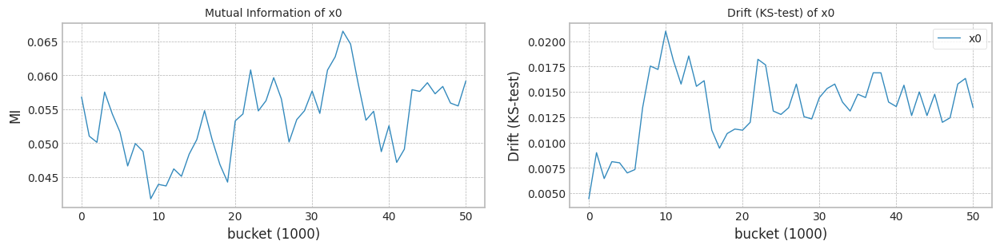

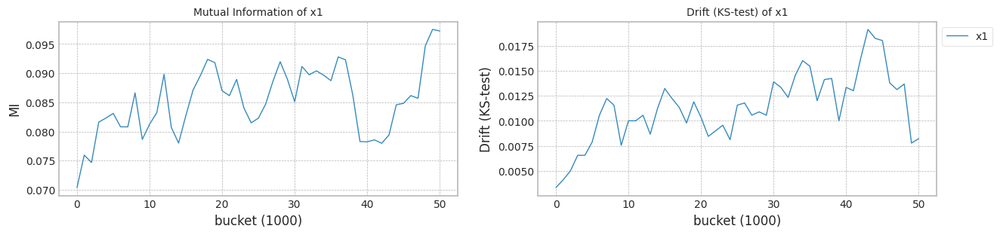

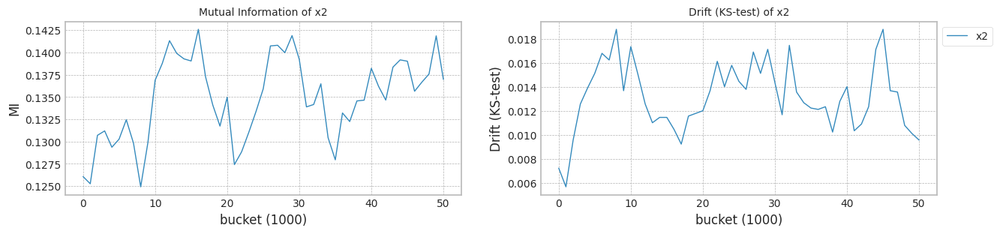

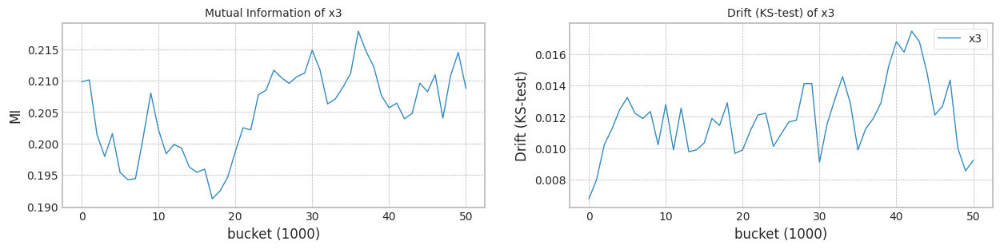

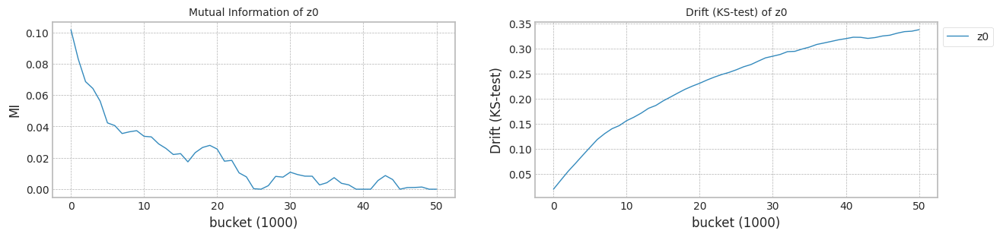

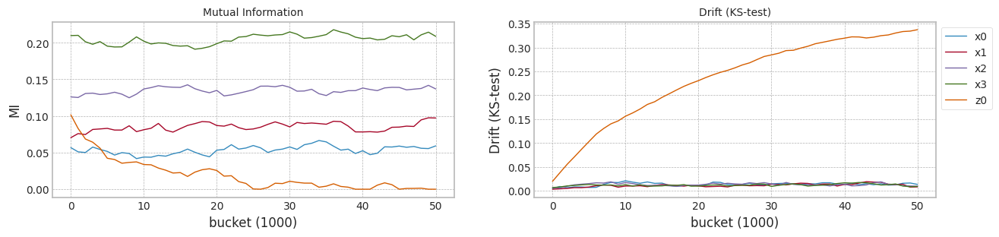

In [ ]:
columns=['x0','x1','x2','x3','z0']
X = pd.DataFrame(x,columns=columns)
Y = y

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X, Y,train_size, test_size)
#model,df = train_classificaion_model(X1,Y1,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.484659,0.586652,0.404131,0.578093,0.421766,0
1,0.642800,0.615744,0.450917,0.526770,0.529014,0
2,0.665316,0.751975,0.535797,0.191399,0.570549,0
3,0.426377,0.459274,0.304506,0.622063,0.396001,0
4,0.634133,0.507616,0.463434,0.520247,0.561748,0
...,...,...,...,...,...,...
59995,0.428835,0.731754,0.362543,0.750707,0.170510,59
59996,0.388504,0.163578,0.250745,0.650929,1.170890,59
59997,0.623148,0.528739,0.508383,0.646257,-0.984624,59
59998,0.427314,0.797644,0.544189,0.600597,1.585603,59


### Main 실험

trial_count: 1
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:22:27,064] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:04<00:05, 193.35it/s]

Early stop: 954
[2023-11-29 00:22:32,005] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:22:41,519] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 00:22:41,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:09, 166.15it/s]

[2023-11-29 00:22:52,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:22:52,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]


mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:23:06,498] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:23:06,500] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:23:15,907] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:23:15,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:14<00:51,  2.17s/it]

G-CDTL train flops: 3500000000 658000000 163560000 4321560000


100%|██████████| 51/51 [00:19<00:00,  2.68it/s]


Early stop at  [375]
Train flops  [4321560000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8384559184734368
G_CDTL+AUE median: 0.8384559184734368
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.34it/s]

Ensemble_SEA train flops: 392370000


100%|██████████| 51/51 [00:10<00:00,  4.85it/s]


Early stop at  [901]
Train flops  [392370000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7843945385102712
SEA median: 0.7843945385102712
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:06,  3.75it/s]

Ensemble_SEA train flops: 132675000


100%|██████████| 51/51 [00:09<00:00,  5.24it/s]


Early stop at  [304]
Train flops  [132675000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.812552295279879
AUE median: 0.812552295279879
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.37it/s]

Ensemble_DTEL train flops: 473715000


 53%|█████▎    | 27/51 [00:06<00:14,  1.70it/s]

Ensemble_DTEL train flops: 144855000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [1088, 332]
Train flops  [473715000, 144855000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8259821807647129
DTEL median: 0.8259821807647129


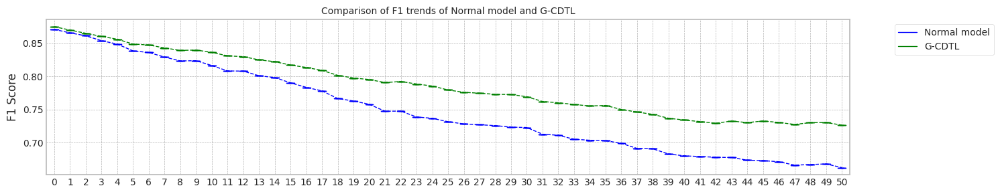

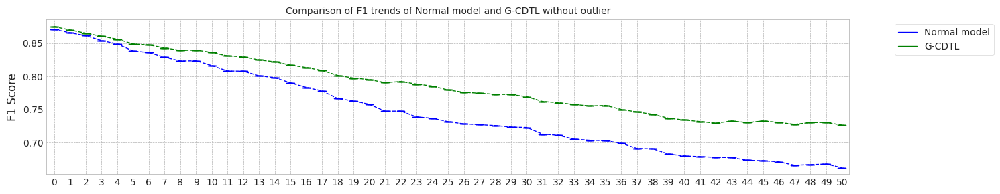

max_mean_trial= 0


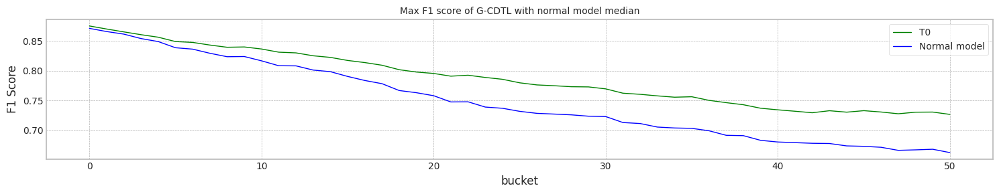

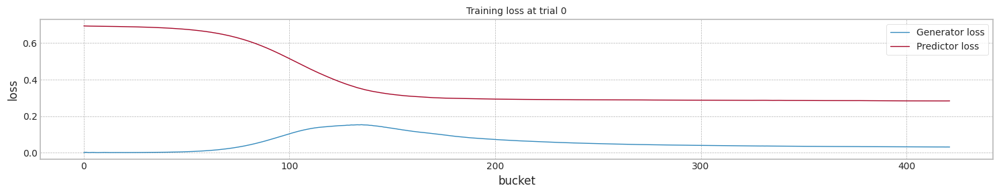

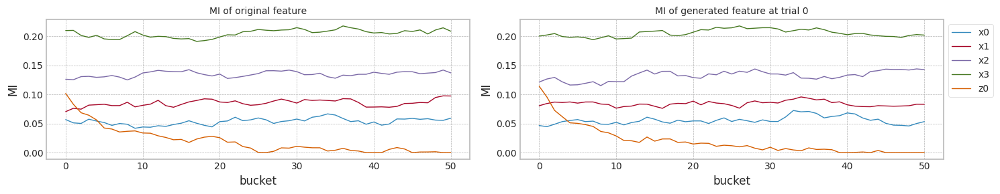

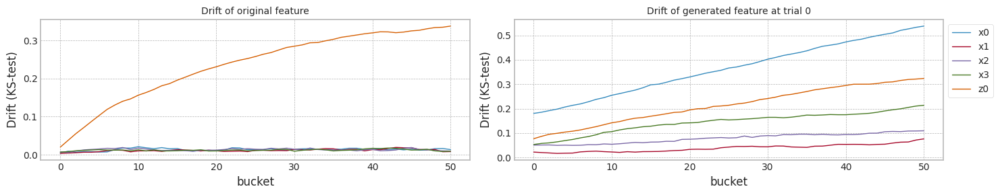

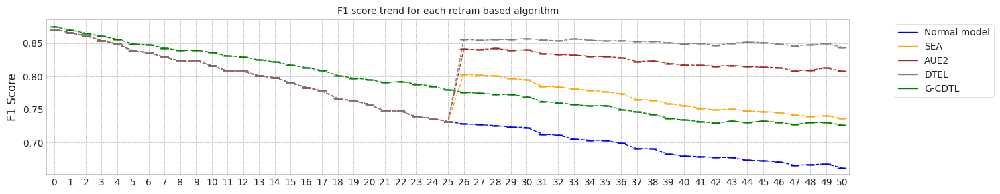

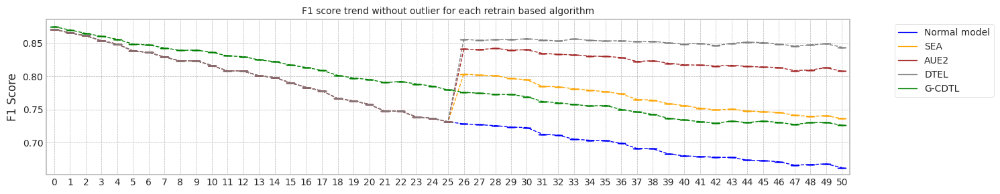

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.496105194091797
Base flops (inference flops of normal model, median): 199665000.0


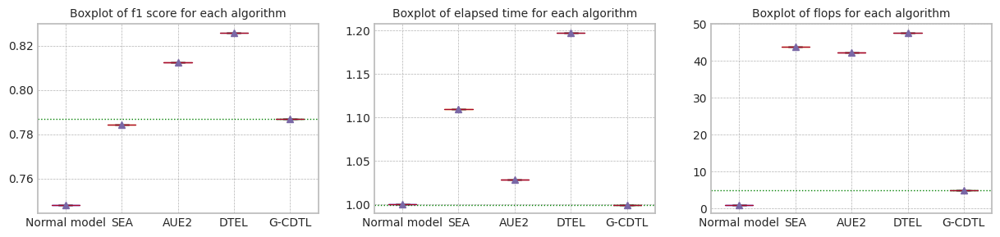

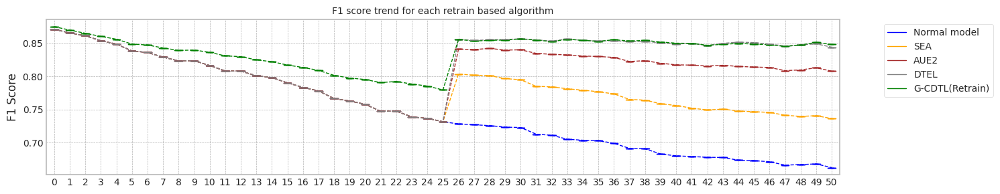

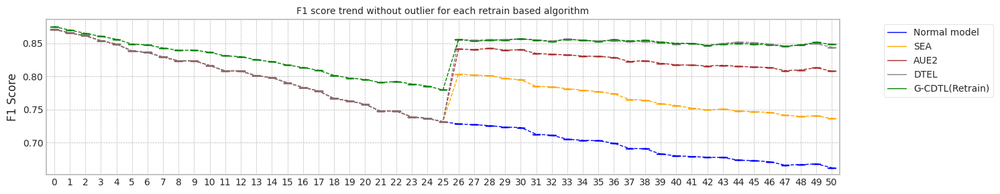

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.496105194091797
Base flops (train + inference flops of normal model, median): 3938490000.0


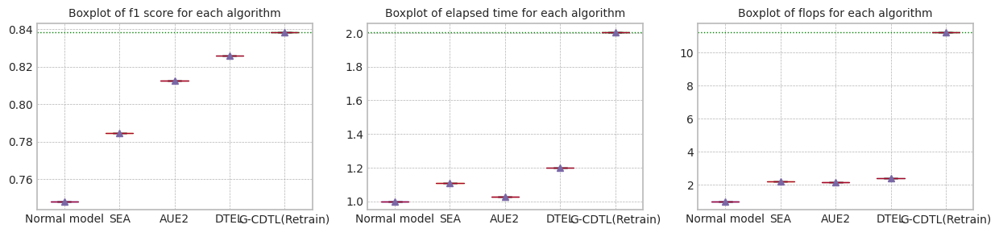

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.496105194091797


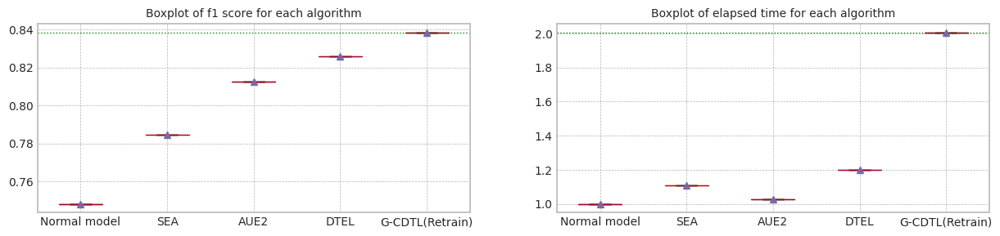

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.66242,9.496105,3.738825e+09,199665000.0,3.938490e+09
1,median,0.871099,0.865787,0.748116,0.66242,9.496105,3.738825e+09,199665000.0,3.938490e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.492044,3.979863e+10,1.002915e+09,4.080154e+10
1,median,0.875177,0.870029,0.786961,0.726602,9.492044,3.979863e+10,1.002915e+09,4.080154e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.784395,0.736534,10.538782,4.131195e+09,4.632315e+09,8.763510e+09
1,median,0.871099,0.865787,0.784395,0.736534,10.538782,4.131195e+09,4.632315e+09,8.763510e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.812552,0.80804,9.764093,3.871500e+09,4.572285e+09,8.443785e+09
1,median,0.871099,0.865787,0.812552,0.80804,9.764093,3.871500e+09,4.572285e+09,8.443785e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.825982,0.844212,11.37188,4.357395e+09,5.159970e+09,9.517365e+09
1,median,0.871099,0.865787,0.825982,0.844212,11.37188,4.357395e+09,5.159970e+09,9.517365e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.838456,0.848383,19.046748,4.412019e+10,223875000.0,4.434406e+10
1,median,0.875177,0.870029,0.838456,0.848383,19.046748,4.412019e+10,223875000.0,4.434406e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case1',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.8,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:26:56,059] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 431.98it/s]

Early stop: 954
[2023-11-29 00:26:58,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.23it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:27:08,079] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:27:08,082] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:09, 168.20it/s]

[2023-11-29 00:27:18,591] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:27:18,592] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.50it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:27:27,915] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:02, 508.49it/s]

Early stop: 512
[2023-11-29 00:27:28,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.50it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:27:38,253] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:27:38,256] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:02<00:09, 166.82it/s]

[2023-11-29 00:27:49,127] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:27:49,128] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:27:58,657] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:00<00:03, 496.53it/s]

Early stop: 447
[2023-11-29 00:27:59,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:28:09,072] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:28:09,074] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:02<00:09, 162.62it/s]

[2023-11-29 00:28:11,913] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:28:11,916] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:28:21,508] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:01<00:02, 498.23it/s]

Early stop: 845
[2023-11-29 00:28:23,209] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:28:32,702] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:28:32,705] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:02<00:09, 164.88it/s]

[2023-11-29 00:28:43,402] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:28:43,403] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:28:52,826] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:01<00:02, 487.69it/s]

Early stop: 866
[2023-11-29 00:28:54,607] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.58it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:29:03,797] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:29:03,799] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:09, 167.29it/s]

[2023-11-29 00:29:14,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:29:14,267] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:29:28,515] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:29:28,517] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:29:38,682] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:29:38,683] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:55,  2.32s/it]

G-CDTL train flops: 3500000000 780500000 194010000 4474510000


100%|██████████| 51/51 [00:19<00:00,  2.62it/s]


Early stop at  [445]
Train flops  [4474510000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8351966758056839
G_CDTL+AUE median: 0.8351966758056839
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.49it/s]

Ensemble_SEA train flops: 326250000


100%|██████████| 51/51 [00:10<00:00,  4.92it/s]


Early stop at  [749]
Train flops  [326250000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7845308120623182
SEA median: 0.7845308120623182
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.05it/s]

Ensemble_SEA train flops: 465450000


100%|██████████| 51/51 [00:10<00:00,  4.74it/s]


Early stop at  [1069]
Train flops  [465450000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8121651122948902
AUE median: 0.8121651122948902
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.41it/s]

Ensemble_DTEL train flops: 566805000


 53%|█████▎    | 27/51 [00:07<00:15,  1.53it/s]

Ensemble_DTEL train flops: 144855000


100%|██████████| 51/51 [00:11<00:00,  4.40it/s]


Early stop at  [1302, 332]
Train flops  [566805000, 144855000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8259821807647129
DTEL median: 0.8259821807647129
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.55it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:30:20,759] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:30:20,761] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:30:32,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:30:32,285] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:16<01:02,  2.60s/it]

G-CDTL train flops: 3500000000 1183000000 294060000 4977060000


100%|██████████| 51/51 [00:20<00:00,  2.45it/s]


Early stop at  [675]
Train flops  [4977060000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8343229669940749
G_CDTL+AUE median: 0.8347598213998795
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.51it/s]

Ensemble_SEA train flops: 723840000


100%|██████████| 51/51 [00:11<00:00,  4.38it/s]


Early stop at  [1663]
Train flops  [723840000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7806279098465843
SEA median: 0.7825793609544512
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:09,  2.48it/s]

Ensemble_SEA train flops: 303630000


100%|██████████| 51/51 [00:10<00:00,  4.84it/s]


Early stop at  [697]
Train flops  [303630000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8107047969365159
AUE median: 0.811434954615703
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.56it/s]

Ensemble_DTEL train flops: 441525000


 53%|█████▎    | 27/51 [00:07<00:15,  1.55it/s]

Ensemble_DTEL train flops: 251430000


100%|██████████| 51/51 [00:11<00:00,  4.43it/s]


Early stop at  [1014, 577]
Train flops  [441525000, 251430000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8263683913623626
DTEL median: 0.8261752860635377
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:31:15,434] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:31:15,436] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:31:24,989] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:31:24,990] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:14<00:52,  2.19s/it]

G-CDTL train flops: 3500000000 560000000 139200000 4199200000


100%|██████████| 51/51 [00:18<00:00,  2.71it/s]


Early stop at  [319]
Train flops  [4199200000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8511113700859121
G_CDTL+AUE median: 0.8351966758056839
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.63it/s]

Ensemble_SEA train flops: 281445000


100%|██████████| 51/51 [00:10<00:00,  4.96it/s]


Early stop at  [646]
Train flops  [281445000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7824498684759907
SEA median: 0.7824498684759907
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.21it/s]

Ensemble_SEA train flops: 411075000


100%|██████████| 51/51 [00:10<00:00,  4.80it/s]


Early stop at  [944]
Train flops  [411075000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8107645505263052
AUE median: 0.8107645505263052
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.40it/s]

Ensemble_DTEL train flops: 357570000


 53%|█████▎    | 27/51 [00:08<00:20,  1.16it/s]

Ensemble_DTEL train flops: 661200000


100%|██████████| 51/51 [00:12<00:00,  4.05it/s]


Early stop at  [821, 1519]
Train flops  [357570000, 661200000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8257259176096252
DTEL median: 0.8259821807647129
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:32:07,953] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:32:07,954] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:32:18,495] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:32:18,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.40s/it]

G-CDTL train flops: 3500000000 666750000 165735000 4332485000


100%|██████████| 51/51 [00:20<00:00,  2.54it/s]


Early stop at  [380]
Train flops  [4332485000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.839037727546247
G_CDTL+AUE median: 0.8371172016759654
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  1.86it/s]

Ensemble_SEA train flops: 529395000


100%|██████████| 51/51 [00:10<00:00,  4.64it/s]


Early stop at  [1216]
Train flops  [529395000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7916522165758585
SEA median: 0.7834903402691544
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:08,  2.71it/s]

Ensemble_SEA train flops: 265350000


100%|██████████| 51/51 [00:10<00:00,  5.00it/s]


Early stop at  [609]
Train flops  [265350000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8138307524660384
AUE median: 0.8114648314105977
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.59it/s]

Ensemble_DTEL train flops: 621615000


 53%|█████▎    | 27/51 [00:08<00:21,  1.14it/s]

Ensemble_DTEL train flops: 394545000


100%|██████████| 51/51 [00:12<00:00,  4.04it/s]


Early stop at  [1428, 906]
Train flops  [621615000, 394545000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8258786649785693
DTEL median: 0.8259304228716411
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:33:01,911] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:33:01,913] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:33:11,764] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:33:11,765] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:14<00:54,  2.25s/it]

G-CDTL train flops: 3500000000 602000000 149640000 4251640000


100%|██████████| 51/51 [00:19<00:00,  2.65it/s]


Early stop at  [343]
Train flops  [4251640000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8362723179200645
G_CDTL+AUE median: 0.8362723179200645
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.51it/s]

Ensemble_SEA train flops: 306675000


100%|██████████| 51/51 [00:10<00:00,  4.93it/s]


Early stop at  [704]
Train flops  [306675000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7816697022421403
SEA median: 0.7824498684759907
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.01it/s]

Ensemble_SEA train flops: 466755000


100%|██████████| 51/51 [00:10<00:00,  4.72it/s]


Early stop at  [1072]
Train flops  [466755000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8135988390738379
AUE median: 0.8121651122948902
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.59it/s]

Ensemble_DTEL train flops: 350610000


 53%|█████▎    | 27/51 [00:06<00:15,  1.59it/s]

Ensemble_DTEL train flops: 335385000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [805, 770]
Train flops  [350610000, 335385000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8248745136768104
DTEL median: 0.8258786649785693


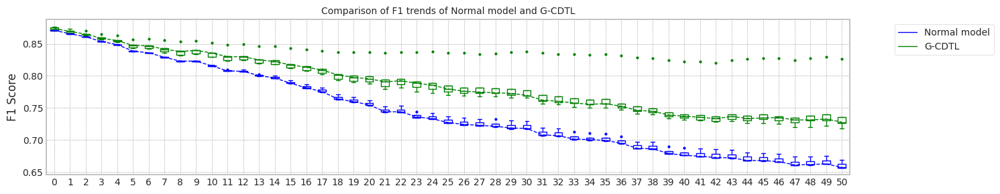

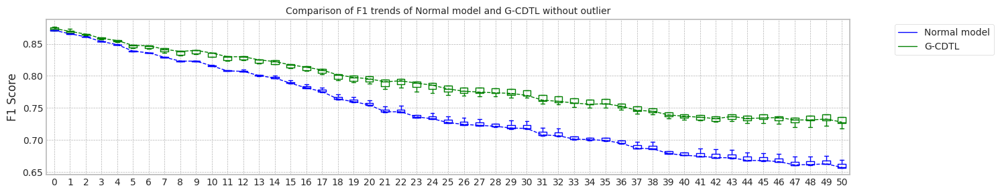

max_mean_trial= 2


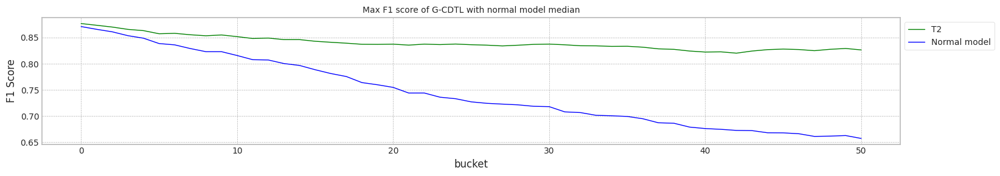

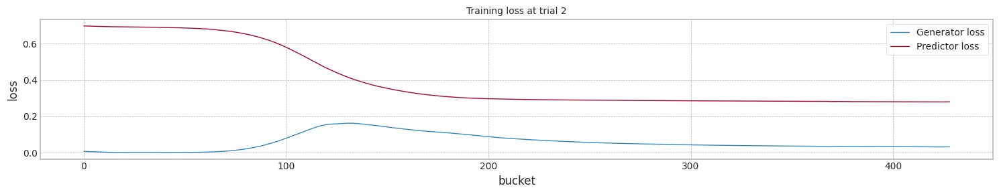

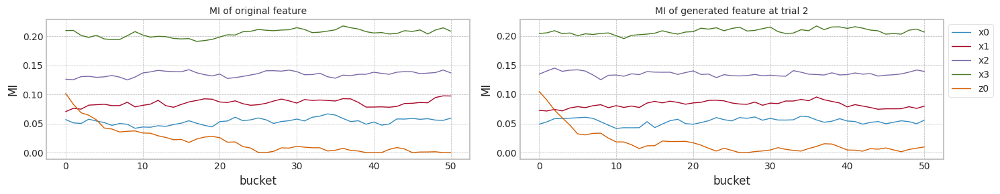

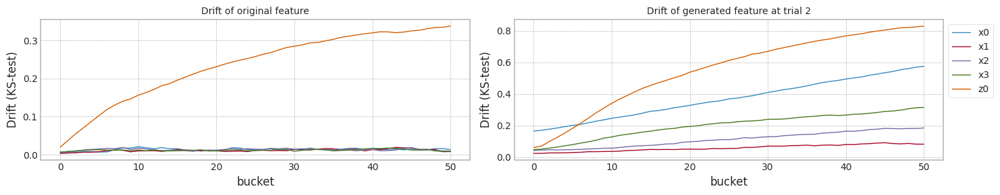

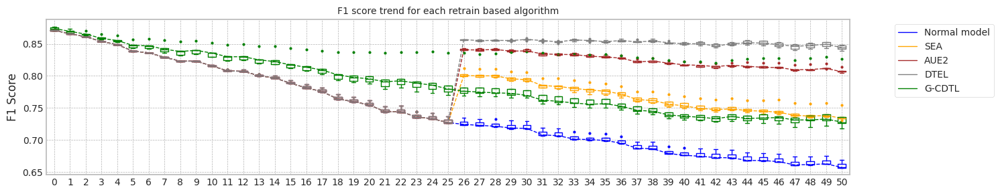

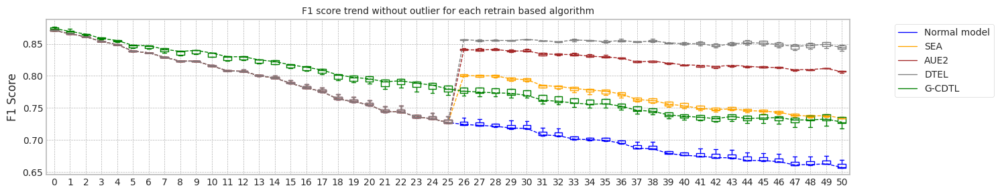

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.478688716888428
Base flops (inference flops of normal model, median): 199665000.0


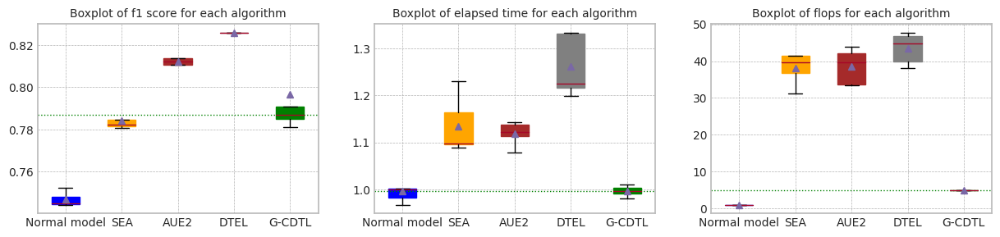

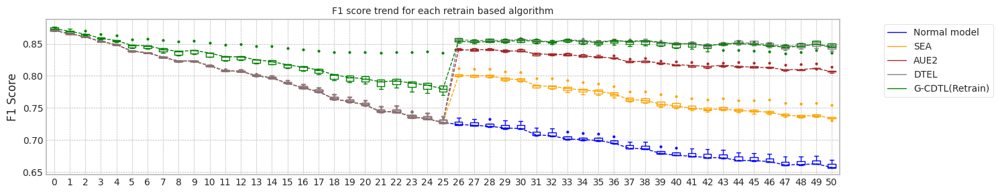

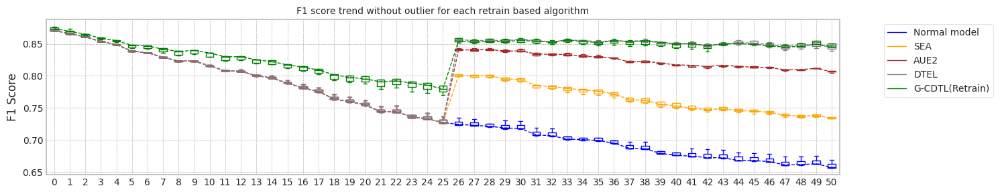

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.478688716888428
Base flops (train + inference flops of normal model, median): 3511755000.0


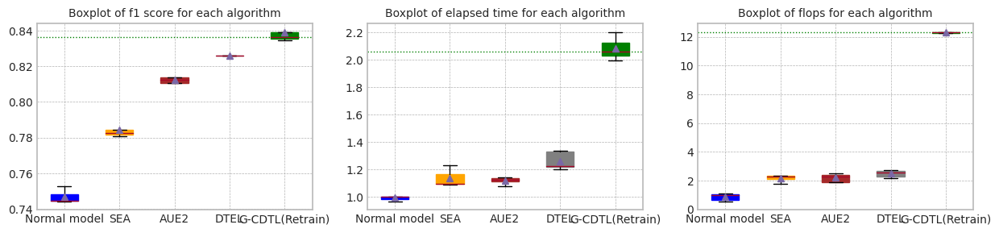

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.478688716888428


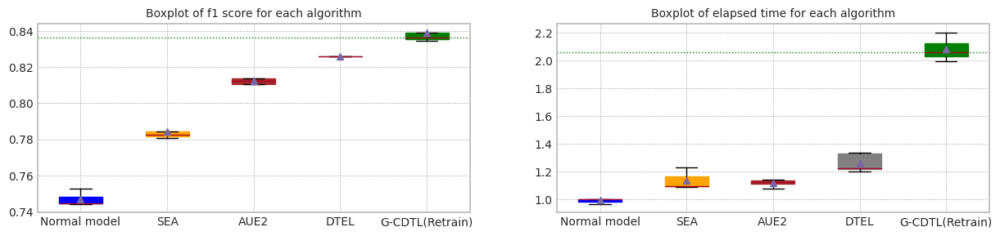

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.784363,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.308354,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.489740,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.478689,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.173087,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.478689,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.229617,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.304532,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.511760,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.573554,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.403723,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.453609,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.453609,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.102949,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.784531,0.735413,10.401523,3.720555e+09,4.566195e+09,8.286750e+09
1,1.0,0.871143,0.866126,0.780628,0.730893,11.668683,4.118145e+09,3.233355e+09,7.351500e+09
2,2.0,0.870401,0.865446,0.782450,0.734048,10.317592,3.675750e+09,2.536485e+09,6.212235e+09
3,3.0,0.871195,0.865883,0.791652,0.754496,11.026484,3.923700e+09,4.342605e+09,8.266305e+09
4,4.0,0.870160,0.865308,0.781670,0.733615,10.381996,3.700980e+09,4.202100e+09,7.903080e+09
5,median,0.871099,0.865787,0.782450,0.734048,10.401523,3.720555e+09,4.202100e+09,7.903080e+09
6,std,0.000483,0.000332,0.004412,0.009536,0.583916,1.898691e+08,8.599232e+08,8.653049e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.812165,0.805137,10.789419,3.859755e+09,4.905060e+09,8.764815e+09
1,1.0,0.871143,0.866126,0.810705,0.807757,10.555290,3.697935e+09,3.012810e+09,6.710745e+09
2,2.0,0.870401,0.865446,0.810765,0.806538,10.643610,3.805380e+09,2.865780e+09,6.671160e+09
3,3.0,0.871195,0.865883,0.813831,0.806351,10.219802,3.659655e+09,4.278225e+09,7.937880e+09
4,4.0,0.870160,0.865308,0.813599,0.814189,10.832704,3.861060e+09,4.561845e+09,8.422905e+09
5,median,0.871099,0.865787,0.812165,0.806538,10.643610,3.805380e+09,4.278225e+09,7.937880e+09
6,std,0.000483,0.000332,0.001493,0.003585,0.244002,9.319432e+07,9.280213e+08,9.682633e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.825982,0.844212,11.613583,4.105965e+09,5.253060e+09,9.359025e+09
1,1.0,0.871143,0.866126,0.826368,0.848445,11.533910,4.087260e+09,3.503925e+09,7.591185e+09
2,2.0,0.870401,0.865446,0.825726,0.847439,12.626434,4.413075e+09,3.575265e+09,7.988340e+09
3,3.0,0.871195,0.865883,0.825879,0.839612,12.642336,4.410465e+09,5.130825e+09,9.541290e+09
4,4.0,0.870160,0.865308,0.824875,0.841897,11.371492,4.080300e+09,4.882875e+09,8.963175e+09
5,median,0.871099,0.865787,0.825879,0.844212,11.613583,4.105965e+09,4.882875e+09,8.963175e+09
6,std,0.000483,0.000332,0.000552,0.003701,0.624016,1.758502e+08,8.593874e+08,8.582868e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.835197,0.836124,19.490259,4.313257e+10,223875000.0,4.335644e+10
1,1.0,0.873993,0.869518,0.834323,0.850318,20.869698,4.363512e+10,223875000.0,4.385900e+10
2,2.0,0.876834,0.873531,0.851111,0.850994,18.873484,4.285726e+10,223875000.0,4.308114e+10
3,3.0,0.871205,0.866786,0.839038,0.845728,20.104961,4.299054e+10,223875000.0,4.321442e+10
4,4.0,0.871522,0.867111,0.836272,0.845807,19.243783,4.290970e+10,223875000.0,4.313358e+10
5,median,0.873993,0.869518,0.836272,0.845807,19.490259,4.299054e+10,223875000.0,4.321442e+10
6,std,0.002400,0.002718,0.006897,0.005937,0.785189,3.140081e+08,0.0,3.140081e+08


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:34:03,938] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 471.15it/s]

Early stop: 954
[2023-11-29 00:34:05,969] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:34:15,395] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:34:15,398] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:09, 158.31it/s]

[2023-11-29 00:34:26,552] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:34:26,553] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:34:36,068] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 486.75it/s]

Early stop: 512
[2023-11-29 00:34:37,125] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:34:46,593] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:34:46,595] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:03<00:09, 155.32it/s]

[2023-11-29 00:34:58,212] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:34:58,213] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:35:07,692] [INFO] [profiler.py:80:start_profile] Flops profiler started


 22%|██▏       | 447/2000 [00:00<00:03, 472.98it/s]

Early stop: 447
[2023-11-29 00:35:08,645] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:35:18,109] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:35:18,111] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:02<00:09, 157.92it/s]

[2023-11-29 00:35:21,035] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:35:21,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:35:30,434] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:01<00:02, 482.42it/s]

Early stop: 845
[2023-11-29 00:35:32,191] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:35:41,581] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:35:41,585] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:02<00:10, 152.94it/s]

[2023-11-29 00:35:52,957] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:35:52,958] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:36:02,501] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:01<00:02, 464.17it/s]

Early stop: 866
[2023-11-29 00:36:04,374] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:36:13,858] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:36:13,861] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:10, 156.53it/s]

[2023-11-29 00:36:24,868] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:36:24,869] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:36:37,685] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:36:37,687] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:36:48,072] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:36:48,074] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:13<01:15,  2.37s/it]

G-CDTL train flops: 3500000000 656250000 163125000 4319375000


 69%|██████▊   | 35/51 [00:16<00:03,  5.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:36:51,402] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:36:51,405] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:37:01,980] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:37:01,981] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:27<00:33,  2.41s/it]

G-CDTL train flops: 3500000000 715750000 177915000 4393665000


100%|██████████| 51/51 [00:30<00:00,  1.68it/s]


Early stop at  [374, 408]
Train flops  [4319375000, 4393665000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8476911555967124
G_CDTL+AUE median: 0.8476911555967124
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:13,  2.41it/s]

Ensemble_SEA train flops: 312765000


 73%|███████▎  | 37/51 [00:09<00:05,  2.34it/s]

Ensemble_SEA train flops: 353655000


100%|██████████| 51/51 [00:11<00:00,  4.35it/s]


Early stop at  [718, 812]
Train flops  [312765000, 353655000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8125398650492064
SEA median: 0.8125398650492064
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:17,  1.84it/s]

Ensemble_SEA train flops: 496770000


 73%|███████▎  | 37/51 [00:09<00:05,  2.58it/s]

Ensemble_SEA train flops: 282750000


100%|██████████| 51/51 [00:12<00:00,  4.20it/s]


Early stop at  [1141, 649]
Train flops  [496770000, 282750000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8369031436926275
AUE median: 0.8369031436926275
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.39it/s]

Ensemble_DTEL train flops: 196185000


 37%|███▋      | 19/51 [00:06<00:22,  1.41it/s]

Ensemble_DTEL train flops: 547665000


 69%|██████▊   | 35/51 [00:08<00:02,  5.48it/s]

Ensemble_DTEL train flops: 368445000


 73%|███████▎  | 37/51 [00:11<00:08,  1.66it/s]

Ensemble_DTEL train flops: 254910000


100%|██████████| 51/51 [00:13<00:00,  3.67it/s]


Early stop at  [450, 1258, 846, 585]
Train flops  [196185000, 547665000, 368445000, 254910000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8417129305693677
DTEL median: 0.8417129305693677
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:37:45,926] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:37:45,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:37:56,552] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:37:56,553] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:17,  2.42s/it]

G-CDTL train flops: 3500000000 738500000 183570000 4422070000


 69%|██████▊   | 35/51 [00:17<00:03,  5.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:37:59,856] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:37:59,859] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:38:13,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:38:13,142] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:30<00:41,  2.98s/it]

G-CDTL train flops: 3500000000 1433250000 356265000 5289515000


100%|██████████| 51/51 [00:33<00:00,  1.53it/s]


Early stop at  [421, 818]
Train flops  [4422070000, 5289515000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8474216883654604
G_CDTL+AUE median: 0.8475564219810864
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:12,  2.54it/s]

Ensemble_SEA train flops: 306240000


 73%|███████▎  | 37/51 [00:08<00:04,  2.87it/s]

Ensemble_SEA train flops: 239685000


100%|██████████| 51/51 [00:11<00:00,  4.61it/s]


Early stop at  [703, 550]
Train flops  [306240000, 239685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8106594732583834
SEA median: 0.8115996691537949
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:13,  2.45it/s]

Ensemble_SEA train flops: 315375000


 73%|███████▎  | 37/51 [00:09<00:07,  1.88it/s]

Ensemble_SEA train flops: 511995000


100%|██████████| 51/51 [00:12<00:00,  4.22it/s]


Early stop at  [724, 1176]
Train flops  [315375000, 511995000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8350174130245979
AUE median: 0.8359602783586126
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.40it/s]

Ensemble_DTEL train flops: 500250000


 37%|███▋      | 19/51 [00:05<00:20,  1.54it/s]

Ensemble_DTEL train flops: 149640000


 69%|██████▊   | 35/51 [00:08<00:02,  5.47it/s]

Ensemble_DTEL train flops: 411945000


 73%|███████▎  | 37/51 [00:11<00:09,  1.54it/s]

Ensemble_DTEL train flops: 271005000


100%|██████████| 51/51 [00:13<00:00,  3.70it/s]


Early stop at  [1149, 343, 946, 622]
Train flops  [500250000, 149640000, 411945000, 271005000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8424770595711707
DTEL median: 0.8420949950702692
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:38:56,450] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:38:56,452] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:39:07,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:39:07,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:21,  2.56s/it]

G-CDTL train flops: 3500000000 784000000 194880000 4478880000


 69%|██████▊   | 35/51 [00:17<00:03,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:39:11,070] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:39:11,073] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:39:21,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:39:21,831] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:28<00:34,  2.45s/it]

G-CDTL train flops: 3500000000 663250000 164865000 4328115000


100%|██████████| 51/51 [00:31<00:00,  1.62it/s]


Early stop at  [447, 378]
Train flops  [4478880000, 4328115000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8523018964868122
G_CDTL+AUE median: 0.8476911555967124
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:03<00:08,  3.63it/s]

Ensemble_SEA train flops: 136155000


 73%|███████▎  | 37/51 [00:08<00:05,  2.51it/s]

Ensemble_SEA train flops: 314940000


100%|██████████| 51/51 [00:10<00:00,  4.73it/s]


Early stop at  [312, 723]
Train flops  [136155000, 314940000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8117334355989994
SEA median: 0.8117334355989994
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:14,  2.23it/s]

Ensemble_SEA train flops: 393240000


 73%|███████▎  | 37/51 [00:09<00:05,  2.46it/s]

Ensemble_SEA train flops: 326250000


100%|██████████| 51/51 [00:11<00:00,  4.38it/s]


Early stop at  [903, 749]
Train flops  [393240000, 326250000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8337890918882465
AUE median: 0.8350174130245979
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.53it/s]

Ensemble_DTEL train flops: 286665000


 37%|███▋      | 19/51 [00:06<00:26,  1.21it/s]

Ensemble_DTEL train flops: 631620000


 69%|██████▊   | 35/51 [00:09<00:02,  5.48it/s]

Ensemble_DTEL train flops: 306240000


 73%|███████▎  | 37/51 [00:11<00:06,  2.04it/s]

Ensemble_DTEL train flops: 133545000


100%|██████████| 51/51 [00:13<00:00,  3.70it/s]


Early stop at  [658, 1451, 703, 306]
Train flops  [286665000, 631620000, 306240000, 133545000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8414057281007123
DTEL median: 0.8417129305693677
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:40:04,317] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:40:04,320] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:40:15,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:40:15,599] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:21,  2.56s/it]

G-CDTL train flops: 3500000000 775250000 192705000 4467955000


 69%|██████▊   | 35/51 [00:17<00:03,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:40:18,936] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:40:18,938] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:40:29,537] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:40:29,539] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:28<00:50,  3.37s/it]

G-CDTL train flops: 3500000000 581000000 144420000 4225420000


100%|██████████| 51/51 [00:31<00:00,  1.62it/s]


Early stop at  [442, 331]
Train flops  [4467955000, 4225420000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8477415297746904
G_CDTL+AUE median: 0.8477163426857014
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:21,  1.49it/s]

Ensemble_SEA train flops: 685560000


 73%|███████▎  | 37/51 [00:10<00:05,  2.34it/s]

Ensemble_SEA train flops: 336255000


100%|██████████| 51/51 [00:12<00:00,  3.97it/s]


Early stop at  [1575, 772]
Train flops  [685560000, 336255000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8153099358100039
SEA median: 0.8121366503241029
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:03<00:09,  3.34it/s]

Ensemble_SEA train flops: 165735000


 73%|███████▎  | 37/51 [00:08<00:04,  2.85it/s]

Ensemble_SEA train flops: 229680000


100%|██████████| 51/51 [00:10<00:00,  4.75it/s]


Early stop at  [380, 527]
Train flops  [165735000, 229680000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8365477573644398
AUE median: 0.8357825851945189
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.54it/s]

Ensemble_DTEL train flops: 313200000


 37%|███▋      | 19/51 [00:05<00:19,  1.63it/s]

Ensemble_DTEL train flops: 315810000


 69%|██████▊   | 35/51 [00:08<00:02,  5.43it/s]

Ensemble_DTEL train flops: 453270000


 73%|███████▎  | 37/51 [00:11<00:08,  1.56it/s]

Ensemble_DTEL train flops: 200970000


100%|██████████| 51/51 [00:13<00:00,  3.75it/s]


Early stop at  [719, 725, 1041, 461]
Train flops  [313200000, 315810000, 453270000, 200970000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.842554307703604
DTEL median: 0.8420949950702692
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:41:13,068] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:41:13,070] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:41:24,274] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:41:24,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:14<01:57,  3.55s/it]

G-CDTL train flops: 3500000000 717500000 178350000 4395850000


 69%|██████▊   | 35/51 [00:17<00:03,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:41:27,659] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:41:27,661] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:41:38,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:41:38,286] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:28<00:33,  2.42s/it]

G-CDTL train flops: 3500000000 570500000 141810000 4212310000


100%|██████████| 51/51 [00:31<00:00,  1.63it/s]


Early stop at  [409, 325]
Train flops  [4395850000, 4212310000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8464207057514246
G_CDTL+AUE median: 0.8476911555967124
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:16,  1.95it/s]

Ensemble_SEA train flops: 457620000


 73%|███████▎  | 37/51 [00:09<00:05,  2.70it/s]

Ensemble_SEA train flops: 255345000


100%|██████████| 51/51 [00:11<00:00,  4.33it/s]


Early stop at  [1051, 586]
Train flops  [457620000, 255345000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8109926530008047
SEA median: 0.8117334355989994
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:18,  1.71it/s]

Ensemble_SEA train flops: 559410000


 73%|███████▎  | 37/51 [00:09<00:05,  2.36it/s]

Ensemble_SEA train flops: 330165000


100%|██████████| 51/51 [00:12<00:00,  4.09it/s]


Early stop at  [1285, 758]
Train flops  [559410000, 330165000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.835105262308877
AUE median: 0.835105262308877
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.45it/s]

Ensemble_DTEL train flops: 307545000


 37%|███▋      | 19/51 [00:05<00:18,  1.71it/s]

Ensemble_DTEL train flops: 254475000


 69%|██████▊   | 35/51 [00:08<00:02,  5.45it/s]

Ensemble_DTEL train flops: 453270000


 73%|███████▎  | 37/51 [00:10<00:09,  1.53it/s]

Ensemble_DTEL train flops: 177480000


100%|██████████| 51/51 [00:13<00:00,  3.78it/s]


Early stop at  [706, 584, 1041, 407]
Train flops  [307545000, 254475000, 453270000, 177480000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8418952714712358
DTEL median: 0.8418952714712358


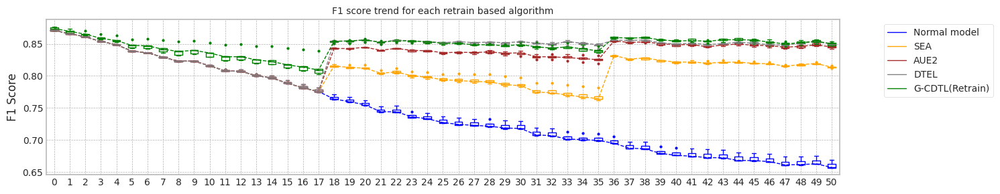

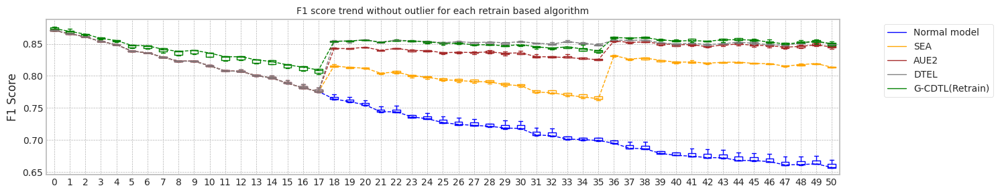

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.445964336395264
Base flops (train + inference flops of normal model, median): 3511755000.0


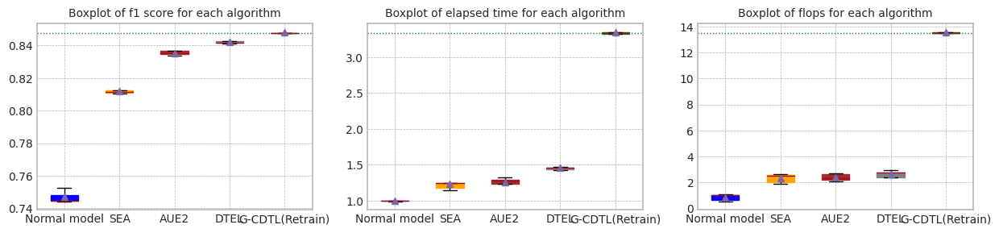

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.445964336395264


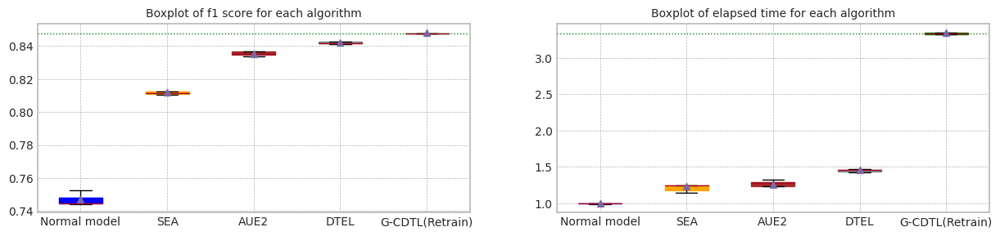

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.405427,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.451993,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.445964,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.374248,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.469006,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.445964,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.038632,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.495794,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.458178,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.377902,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.525948,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.468007,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.468007,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.055463,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.812540,0.813717,11.757145,4.060725e+09,4.996410e+09,9.057135e+09
1,1.0,0.871143,0.866126,0.810659,0.813628,11.109100,3.940230e+09,3.145485e+09,7.085715e+09
2,2.0,0.870401,0.865446,0.811733,0.815775,10.807336,3.845400e+09,2.796180e+09,6.641580e+09
3,3.0,0.871195,0.865883,0.815310,0.813486,12.885550,4.416120e+09,4.925070e+09,9.341190e+09
4,4.0,0.870160,0.865308,0.810993,0.812057,11.799075,4.107270e+09,4.698435e+09,8.805705e+09
5,median,0.871099,0.865787,0.811733,0.813628,11.757145,4.060725e+09,4.698435e+09,8.805705e+09
6,std,0.000483,0.000332,0.001859,0.001328,0.800094,2.170723e+08,1.055071e+09,1.232197e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.836903,0.848122,12.170761,4.173825e+09,5.309175e+09,9.483000e+09
1,1.0,0.871143,0.866126,0.835017,0.845171,12.112015,4.221675e+09,3.626595e+09,7.848270e+09
2,2.0,0.870401,0.865446,0.833789,0.841929,11.661683,4.113795e+09,3.264240e+09,7.378035e+09
3,3.0,0.871195,0.865883,0.836548,0.846907,10.770219,3.789720e+09,4.498335e+09,8.288055e+09
4,4.0,0.870160,0.865308,0.835105,0.843837,12.498256,4.283880e+09,5.074710e+09,9.358590e+09
5,median,0.871099,0.865787,0.835105,0.845171,12.112015,4.173825e+09,4.498335e+09,8.288055e+09
6,std,0.000483,0.000332,0.001263,0.002450,0.669494,1.931039e+08,8.901275e+08,9.257151e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.841713,0.848612,13.908240,4.761510e+09,5.712420e+09,1.047393e+10
1,1.0,0.871143,0.866126,0.842477,0.849678,13.802360,4.727145e+09,3.643560e+09,8.370705e+09
2,2.0,0.870401,0.865446,0.841406,0.852653,13.830315,4.752375e+09,3.627900e+09,8.380275e+09
3,3.0,0.871195,0.865883,0.842554,0.847594,13.630365,4.677555e+09,5.084715e+09,9.762270e+09
4,4.0,0.870160,0.865308,0.841895,0.849856,13.524569,4.587075e+09,5.082105e+09,9.669180e+09
5,median,0.871099,0.865787,0.841895,0.849678,13.802360,4.727145e+09,5.082105e+09,9.669180e+09
6,std,0.000483,0.000332,0.000495,0.001895,0.157144,7.161162e+07,9.434068e+08,9.263764e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.847691,0.847924,30.405516,4.737110e+10,134325000.0,4.750542e+10
1,1.0,0.873993,0.869518,0.847422,0.851384,33.409949,4.836964e+10,134325000.0,4.850397e+10
2,2.0,0.876834,0.873531,0.852302,0.845854,31.585816,4.746506e+10,134325000.0,4.759938e+10
3,3.0,0.871205,0.866786,0.847742,0.850134,31.482696,4.735144e+10,134325000.0,4.748576e+10
4,4.0,0.871522,0.867111,0.846421,0.853301,31.365964,4.726622e+10,134325000.0,4.740054e+10
5,median,0.873993,0.869518,0.847691,0.850134,31.482696,4.737110e+10,134325000.0,4.750542e+10
6,std,0.002400,0.002718,0.002291,0.002913,1.090751,4.554994e+08,0.0,4.554994e+08


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:42:24,314] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 453.01it/s]

Early stop: 954
[2023-11-29 00:42:26,426] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:42:35,937] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:42:35,939] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:10, 146.86it/s]

[2023-11-29 00:42:48,166] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:42:48,168] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:42:57,735] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 455.10it/s]

Early stop: 512
[2023-11-29 00:42:58,866] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.49it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:43:08,199] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:43:08,201] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:03<00:10, 149.31it/s]

[2023-11-29 00:43:20,654] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:43:20,656] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:43:30,113] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:00<00:03, 455.05it/s]

Early stop: 447
[2023-11-29 00:43:31,101] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:43:40,590] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:43:40,591] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:11, 137.47it/s]

[2023-11-29 00:43:43,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:43:43,935] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.29it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:43:53,626] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:01<00:02, 435.51it/s]

Early stop: 845
[2023-11-29 00:43:55,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:44:05,057] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:44:05,059] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:02<00:11, 141.43it/s]

[2023-11-29 00:44:17,378] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:44:17,379] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:44:26,748] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:01<00:02, 440.55it/s]

Early stop: 866
[2023-11-29 00:44:28,719] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.54it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:44:37,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:44:37,966] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:11, 148.53it/s]

[2023-11-29 00:44:49,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:44:49,658] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:45:01,534] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:45:01,537] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:45:12,663] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:45:12,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:13<01:33,  2.54s/it]

G-CDTL train flops: 3500000000 602000000 149640000 4251640000


 49%|████▉     | 25/51 [00:15<00:06,  4.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:45:15,071] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:45:15,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:45:26,331] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:45:26,332] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:27<01:29,  3.60s/it]

G-CDTL train flops: 3500000000 691250000 171825000 4363075000


 75%|███████▍  | 38/51 [00:29<00:02,  4.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:45:28,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:45:28,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:45:40,066] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:45:40,067] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:41<00:28,  2.59s/it]

G-CDTL train flops: 3500000000 659750000 163995000 4323745000


100%|██████████| 51/51 [00:43<00:00,  1.18it/s]


Early stop at  [343, 394, 376]
Train flops  [4251640000, 4363075000, 4323745000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8514157012046625
G_CDTL+AUE median: 0.8514157012046625
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:19,  1.87it/s]

Ensemble_SEA train flops: 482850000


 51%|█████     | 26/51 [00:08<00:20,  1.24it/s]

Ensemble_SEA train flops: 585075000


 78%|███████▊  | 40/51 [00:12<00:05,  2.18it/s]

Ensemble_SEA train flops: 369315000


100%|██████████| 51/51 [00:14<00:00,  3.54it/s]


Early stop at  [1109, 1344, 848]
Train flops  [482850000, 585075000, 369315000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.831663095880702
SEA median: 0.831663095880702
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:15,  2.31it/s]

Ensemble_SEA train flops: 336255000


 53%|█████▎    | 27/51 [00:07<00:10,  2.28it/s]

Ensemble_SEA train flops: 327555000


 78%|███████▊  | 40/51 [00:10<00:03,  2.98it/s]

Ensemble_SEA train flops: 203580000


100%|██████████| 51/51 [00:12<00:00,  4.09it/s]


Early stop at  [772, 752, 467]
Train flops  [336255000, 327555000, 203580000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8445945486472016
AUE median: 0.8445945486472016
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.57it/s]

Ensemble_DTEL train flops: 248385000


 27%|██▋       | 14/51 [00:05<00:30,  1.22it/s]

Ensemble_DTEL train flops: 615090000


 53%|█████▎    | 27/51 [00:09<00:11,  2.00it/s]

Ensemble_DTEL train flops: 411075000
Ensemble_DTEL train flops: 1305000


 75%|███████▍  | 38/51 [00:11<00:02,  5.39it/s]

Ensemble_DTEL train flops: 284925000


 78%|███████▊  | 40/51 [00:13<00:07,  1.57it/s]

Ensemble_DTEL train flops: 328425000


100%|██████████| 51/51 [00:15<00:00,  3.21it/s]


Early stop at  [570, 1413, 944, 2, 654, 754]
Train flops  [248385000, 615090000, 411075000, 1305000, 284925000, 328425000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8485406119502648
DTEL median: 0.8485406119502648
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:46:27,564] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:46:27,567] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:46:39,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:46:39,812] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:14<01:42,  2.77s/it]

G-CDTL train flops: 3500000000 836500000 207930000 4544430000


 49%|████▉     | 25/51 [00:16<00:06,  4.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:46:42,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:46:42,228] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:46:54,016] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:46:54,017] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:29<01:04,  2.69s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


 75%|███████▍  | 38/51 [00:31<00:03,  4.14it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:46:56,511] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:46:56,513] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:47:08,160] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:47:08,162] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:43<00:29,  2.66s/it]

G-CDTL train flops: 3500000000 668500000 166170000 4334670000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [477, 416, 381]
Train flops  [4544430000, 4411145000, 4334670000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8502599133440142
G_CDTL+AUE median: 0.8508378072743383
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:14,  2.49it/s]

Ensemble_SEA train flops: 293625000


 53%|█████▎    | 27/51 [00:07<00:10,  2.25it/s]

Ensemble_SEA train flops: 347130000


 78%|███████▊  | 40/51 [00:11<00:05,  2.00it/s]

Ensemble_SEA train flops: 426300000


100%|██████████| 51/51 [00:13<00:00,  3.89it/s]


Early stop at  [674, 797, 979]
Train flops  [293625000, 347130000, 426300000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8306128405023752
SEA median: 0.8311379681915385
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:11,  3.22it/s]

Ensemble_SEA train flops: 181395000


 53%|█████▎    | 27/51 [00:07<00:12,  1.99it/s]

Ensemble_SEA train flops: 434565000


 78%|███████▊  | 40/51 [00:10<00:05,  2.04it/s]

Ensemble_SEA train flops: 413685000


100%|██████████| 51/51 [00:12<00:00,  3.95it/s]


Early stop at  [416, 998, 950]
Train flops  [181395000, 434565000, 413685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8452621991987659
AUE median: 0.8449283739229838
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.50it/s]

Ensemble_DTEL train flops: 481545000


 27%|██▋       | 14/51 [00:04<00:25,  1.44it/s]

Ensemble_DTEL train flops: 203580000


 53%|█████▎    | 27/51 [00:08<00:08,  2.95it/s]

Ensemble_DTEL train flops: 202710000
Ensemble_DTEL train flops: 1305000


 75%|███████▍  | 38/51 [00:10<00:02,  5.48it/s]

Ensemble_DTEL train flops: 327555000


 78%|███████▊  | 40/51 [00:12<00:06,  1.65it/s]

Ensemble_DTEL train flops: 250560000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [1106, 467, 465, 2, 752, 575]
Train flops  [481545000, 203580000, 202710000, 1305000, 327555000, 250560000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.850147301452725
DTEL median: 0.8493439567014949
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:47:53,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:47:53,471] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:48:02,653] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:48:02,654] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:11<01:18,  2.13s/it]

G-CDTL train flops: 2476250000 694750000 172695000 3343695000


 49%|████▉     | 25/51 [00:13<00:05,  4.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:48:05,115] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:48:05,117] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:48:20,839] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:48:20,840] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:29<01:24,  3.51s/it]

G-CDTL train flops: 3500000000 1734250000 431085000 5665335000


 75%|███████▍  | 38/51 [00:31<00:03,  4.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:48:23,217] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:48:23,219] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:48:26,170] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:48:26,171] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:35<00:09,  1.19it/s]

G-CDTL train flops: 75250000 728000000 180960000 984210000


100%|██████████| 51/51 [00:37<00:00,  1.37it/s]


Early stop at  [396, 990, 415]
Train flops  [3343695000, 5665335000, 984210000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8531736881873212
G_CDTL+AUE median: 0.8514157012046625
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:16,  2.19it/s]

Ensemble_SEA train flops: 362790000


 53%|█████▎    | 27/51 [00:08<00:15,  1.56it/s]

Ensemble_SEA train flops: 619440000


 78%|███████▊  | 40/51 [00:12<00:05,  1.94it/s]

Ensemble_SEA train flops: 432825000


100%|██████████| 51/51 [00:14<00:00,  3.55it/s]


Early stop at  [833, 1423, 994]
Train flops  [362790000, 619440000, 432825000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8331065284825797
SEA median: 0.831663095880702
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:21,  1.69it/s]

Ensemble_SEA train flops: 533745000


 53%|█████▎    | 27/51 [00:08<00:12,  1.98it/s]

Ensemble_SEA train flops: 426735000


 78%|███████▊  | 40/51 [00:11<00:03,  2.77it/s]

Ensemble_SEA train flops: 236640000


100%|██████████| 51/51 [00:13<00:00,  3.73it/s]


Early stop at  [1226, 980, 543]
Train flops  [533745000, 426735000, 236640000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.844489334924601
AUE median: 0.8445945486472016
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.44it/s]

Ensemble_DTEL train flops: 248820000


 27%|██▋       | 14/51 [00:03<00:17,  2.10it/s]

Ensemble_DTEL train flops: 139635000


 53%|█████▎    | 27/51 [00:07<00:11,  2.04it/s]

Ensemble_DTEL train flops: 404115000
Ensemble_DTEL train flops: 1305000


 76%|███████▋  | 39/51 [00:11<00:07,  1.70it/s]

Ensemble_DTEL train flops: 369315000
Ensemble_DTEL train flops: 9570000


100%|██████████| 51/51 [00:13<00:00,  3.78it/s]


Early stop at  [571, 320, 928, 2, 848, 21]
Train flops  [248820000, 139635000, 404115000, 1305000, 369315000, 9570000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8499797773503147
DTEL median: 0.8499797773503147
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:49:12,467] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:49:12,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:49:19,698] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:49:19,699] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:09<01:03,  1.71s/it]

G-CDTL train flops: 1657250000 724500000 180090000 2561840000


 49%|████▉     | 25/51 [00:11<00:05,  4.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:49:22,085] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:49:22,088] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:49:33,818] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:49:33,819] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:23<01:03,  2.66s/it]

G-CDTL train flops: 3500000000 656250000 163125000 4319375000


 75%|███████▍  | 38/51 [00:26<00:03,  4.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:49:36,282] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:49:36,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:49:48,675] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:49:48,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:38<00:30,  2.82s/it]

G-CDTL train flops: 3500000000 752500000 187050000 4439550000


100%|██████████| 51/51 [00:40<00:00,  1.25it/s]


Early stop at  [413, 374, 429]
Train flops  [2561840000, 4319375000, 4439550000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8510332269452096
G_CDTL+AUE median: 0.851224464074936
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:28,  1.32it/s]

Ensemble_SEA train flops: 757770000


 53%|█████▎    | 27/51 [00:08<00:09,  2.52it/s]

Ensemble_SEA train flops: 277530000


 78%|███████▊  | 40/51 [00:12<00:05,  1.95it/s]

Ensemble_SEA train flops: 413685000


100%|██████████| 51/51 [00:14<00:00,  3.47it/s]


Early stop at  [1741, 637, 950]
Train flops  [757770000, 277530000, 413685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8319250872553073
SEA median: 0.8317940915680047
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.66it/s]

Ensemble_SEA train flops: 549405000


 53%|█████▎    | 27/51 [00:08<00:13,  1.72it/s]

Ensemble_SEA train flops: 524175000


 78%|███████▊  | 40/51 [00:12<00:05,  2.03it/s]

Ensemble_SEA train flops: 398895000


100%|██████████| 51/51 [00:14<00:00,  3.46it/s]


Early stop at  [1262, 1204, 916]
Train flops  [549405000, 524175000, 398895000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8444633602681811
AUE median: 0.8445419417859013
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.50it/s]

Ensemble_DTEL train flops: 152250000


 27%|██▋       | 14/51 [00:05<00:28,  1.31it/s]

Ensemble_DTEL train flops: 617700000


 49%|████▉     | 25/51 [00:07<00:05,  5.19it/s]

Ensemble_DTEL train flops: 411075000


 53%|█████▎    | 27/51 [00:10<00:16,  1.47it/s]

Ensemble_DTEL train flops: 224895000


 78%|███████▊  | 40/51 [00:13<00:04,  2.35it/s]

Ensemble_DTEL train flops: 311460000
Ensemble_DTEL train flops: 5220000


100%|██████████| 51/51 [00:15<00:00,  3.29it/s]


Early stop at  [349, 1419, 944, 516, 715, 11]
Train flops  [152250000, 617700000, 411075000, 224895000, 311460000, 5220000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8487555994631113
DTEL median: 0.849367688406713
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:50:38,329] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:50:38,331] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:50:48,900] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:50:48,901] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:13<01:29,  2.42s/it]

G-CDTL train flops: 2957500000 642250000 159645000 3759395000


 49%|████▉     | 25/51 [00:15<00:05,  4.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:50:51,323] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:50:51,325] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:51:04,117] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:51:04,118] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:28<01:09,  2.89s/it]

G-CDTL train flops: 3500000000 873250000 217065000 4590315000


 75%|███████▍  | 38/51 [00:30<00:03,  4.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:51:06,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:51:06,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:51:18,960] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:51:18,961] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:43<00:47,  3.96s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [366, 498, 416]
Train flops  [3759395000, 4590315000, 4411145000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8498606888900995
G_CDTL+AUE median: 0.8510332269452096
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:20,  1.84it/s]

Ensemble_SEA train flops: 461535000


 53%|█████▎    | 27/51 [00:07<00:08,  2.99it/s]

Ensemble_SEA train flops: 182265000


 78%|███████▊  | 40/51 [00:11<00:05,  2.06it/s]

Ensemble_SEA train flops: 384975000


100%|██████████| 51/51 [00:13<00:00,  3.85it/s]


Early stop at  [1060, 418, 884]
Train flops  [461535000, 182265000, 384975000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8317704644148978
SEA median: 0.8317704644148978
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:14,  2.53it/s]

Ensemble_SEA train flops: 256650000


 53%|█████▎    | 27/51 [00:07<00:11,  2.05it/s]

Ensemble_SEA train flops: 394545000


 78%|███████▊  | 40/51 [00:11<00:06,  1.73it/s]

Ensemble_SEA train flops: 497640000


100%|██████████| 51/51 [00:13<00:00,  3.70it/s]


Early stop at  [589, 906, 1143]
Train flops  [256650000, 394545000, 497640000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8454961921429325
AUE median: 0.8445945486472016
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.38it/s]

Ensemble_DTEL train flops: 338430000


 27%|██▋       | 14/51 [00:04<00:20,  1.77it/s]

Ensemble_DTEL train flops: 153120000


 53%|█████▎    | 27/51 [00:07<00:08,  2.74it/s]

Ensemble_DTEL train flops: 239685000
Ensemble_DTEL train flops: 1305000


 75%|███████▍  | 38/51 [00:09<00:02,  5.38it/s]

Ensemble_DTEL train flops: 303195000


 78%|███████▊  | 40/51 [00:12<00:06,  1.61it/s]

Ensemble_DTEL train flops: 262305000


100%|██████████| 51/51 [00:14<00:00,  3.63it/s]


Early stop at  [777, 351, 550, 2, 696, 602]
Train flops  [338430000, 153120000, 239685000, 1305000, 303195000, 262305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8494342500223349
DTEL median: 0.8494342500223349


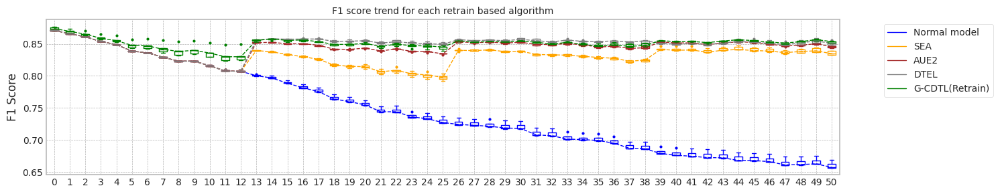

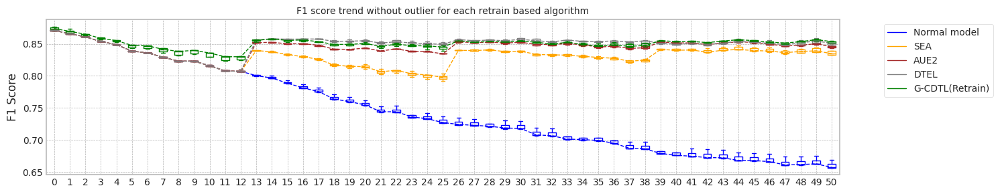

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.467994213104248
Base flops (train + inference flops of normal model, median): 3511755000.0


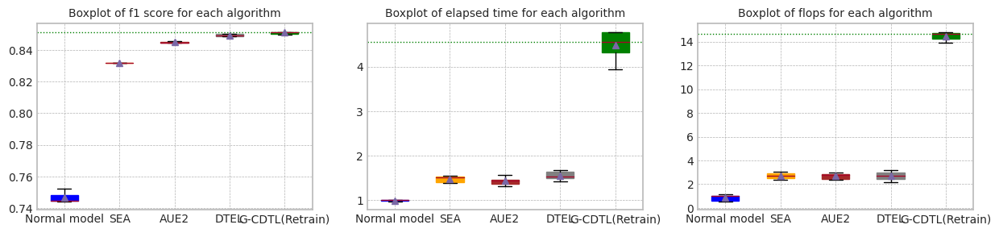

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.467994213104248


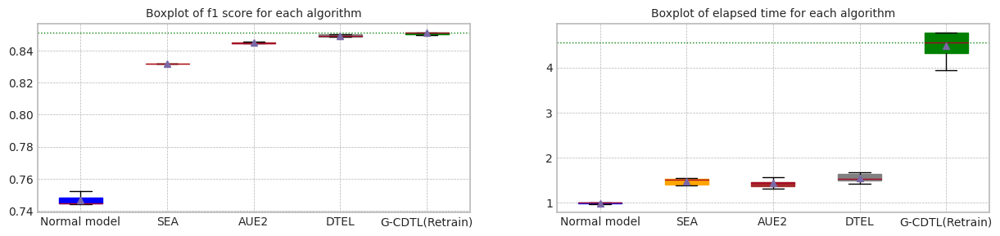

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.491998,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.317711,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.470433,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.467994,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.228281,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.467994,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.116399,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.547730,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.440235,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.672131,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.349451,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.457377,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.457377,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.122211,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.831663,0.834709,14.438992,4.831545e+09,5.872935e+09,1.070448e+10
1,1.0,0.871143,0.866126,0.830613,0.832686,13.157396,4.461360e+09,3.772320e+09,8.233680e+09
2,2.0,0.870401,0.865446,0.833107,0.839073,14.395852,4.809360e+09,3.865845e+09,8.675205e+09
3,3.0,0.871195,0.865883,0.831925,0.832494,14.728182,4.843290e+09,5.457945e+09,1.030124e+10
4,4.0,0.870160,0.865308,0.831770,0.838609,13.265890,4.423080e+09,5.119950e+09,9.543030e+09
5,median,0.871099,0.865787,0.831770,0.834709,14.395852,4.809360e+09,5.119950e+09,9.543030e+09
6,std,0.000483,0.000332,0.000887,0.003163,0.729473,2.121191e+08,9.504784e+08,1.046195e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.844595,0.845499,12.500778,4.261695e+09,5.502750e+09,9.764445e+09
1,1.0,0.871143,0.866126,0.845262,0.846933,12.953258,4.423950e+09,3.934575e+09,8.358525e+09
2,2.0,0.870401,0.865446,0.844489,0.844737,13.694158,4.591425e+09,3.847575e+09,8.439000e+09
3,3.0,0.871195,0.865883,0.844463,0.843767,14.764484,4.866780e+09,5.681100e+09,1.054788e+10
4,4.0,0.870160,0.865308,0.845496,0.848036,13.814770,4.543140e+09,5.439675e+09,9.982815e+09
5,median,0.871099,0.865787,0.844595,0.845499,13.694158,4.543140e+09,5.439675e+09,9.764445e+09
6,std,0.000483,0.000332,0.000483,0.001705,0.869299,2.237895e+08,9.086444e+08,9.742428e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.848541,0.848248,15.940299,5.283510e+09,5.771145e+09,1.105466e+10
1,1.0,0.871143,0.866126,0.850147,0.851467,14.515635,4.861560e+09,3.593970e+09,8.455530e+09
2,2.0,0.870401,0.865446,0.849980,0.856096,13.541503,4.567065e+09,3.076320e+09,7.643385e+09
3,3.0,0.871195,0.865883,0.848756,0.850644,15.522104,5.116905e+09,5.273940e+09,1.039084e+10
4,4.0,0.870160,0.865308,0.849434,0.848451,14.098168,4.692345e+09,4.916805e+09,9.609150e+09
5,median,0.871099,0.865787,0.849434,0.850644,14.515635,4.861560e+09,4.916805e+09,9.609150e+09
6,std,0.000483,0.000332,0.000715,0.003177,0.993696,2.955842e+08,1.143764e+09,1.390720e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.851416,0.851640,43.148538,5.159652e+10,107460000.0,5.170398e+10
1,1.0,0.873993,0.869518,0.850260,0.853537,45.263692,5.194830e+10,107460000.0,5.205576e+10
2,2.0,0.876834,0.873531,0.853174,0.850152,37.337957,4.865130e+10,107460000.0,4.875876e+10
3,3.0,0.871205,0.866786,0.851033,0.854855,40.892953,4.997882e+10,107460000.0,5.008628e+10
4,4.0,0.871522,0.867111,0.849861,0.854174,45.268224,5.141892e+10,107460000.0,5.152638e+10
5,median,0.873993,0.869518,0.851033,0.853537,43.148538,5.141892e+10,107460000.0,5.152638e+10
6,std,0.002400,0.002718,0.001288,0.001936,3.349688,1.377893e+09,0.0,1.377893e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:52:08,301] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 413.34it/s]

Early stop: 954
[2023-11-29 00:52:10,615] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:52:20,062] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:52:20,065] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 421/2000 [00:03<00:11, 134.92it/s]

[2023-11-29 00:52:33,187] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:52:33,189] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:52:42,577] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 408.28it/s]

Early stop: 512
[2023-11-29 00:52:43,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.48it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:52:53,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:52:53,195] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:03<00:11, 134.46it/s]

[2023-11-29 00:53:06,749] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:53:06,751] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:53:16,225] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:01<00:03, 415.55it/s]

Early stop: 447
[2023-11-29 00:53:17,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.45it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:53:26,707] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:53:26,709] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:11, 134.97it/s]

[2023-11-29 00:53:30,134] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:53:30,135] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:53:39,686] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:02<00:02, 419.73it/s]

Early stop: 845
[2023-11-29 00:53:41,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:53:51,147] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:53:51,149] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:03<00:12, 132.61it/s]

[2023-11-29 00:54:04,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:54:04,368] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:54:13,803] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:02<00:02, 413.13it/s]

Early stop: 866
[2023-11-29 00:54:15,905] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:54:25,286] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:54:25,288] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:11, 136.95it/s]

[2023-11-29 00:54:38,083] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:54:38,085] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:54:49,621] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:54:49,624] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 00:55:02,240] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:02,241] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:14<01:52,  2.87s/it]

G-CDTL train flops: 3500000000 687750000 170955000 4358705000


 41%|████      | 21/51 [00:16<00:08,  3.41it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:55:04,306] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:55:04,308] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 00:55:17,518] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:17,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:30<01:24,  3.02s/it]

G-CDTL train flops: 3500000000 789250000 196185000 4485435000


 63%|██████▎   | 32/51 [00:31<00:05,  3.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:55:19,576] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:55:19,579] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 00:55:33,297] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:33,298] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:45<00:53,  3.12s/it]

G-CDTL train flops: 3500000000 946750000 235335000 4682085000


 84%|████████▍ | 43/51 [00:47<00:02,  3.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:55:35,342] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:55:35,345] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 00:55:48,256] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:48,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:00<00:29,  4.14s/it]

G-CDTL train flops: 3500000000 700000000 174000000 4374000000


100%|██████████| 51/51 [01:01<00:00,  1.22s/it]


Early stop at  [392, 450, 540, 399]
Train flops  [4358705000, 4485435000, 4682085000, 4374000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8521006075734281
G_CDTL+AUE median: 0.8521006075734281
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.93it/s]

Ensemble_SEA train flops: 402375000


 45%|████▌     | 23/51 [00:08<00:19,  1.45it/s]

Ensemble_SEA train flops: 639015000


 67%|██████▋   | 34/51 [00:11<00:07,  2.39it/s]

Ensemble_SEA train flops: 283185000


 88%|████████▊ | 45/51 [00:14<00:03,  1.91it/s]

Ensemble_SEA train flops: 408465000


100%|██████████| 51/51 [00:16<00:00,  3.17it/s]


Early stop at  [924, 1468, 650, 938]
Train flops  [402375000, 639015000, 283185000, 408465000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8337165712413391
SEA median: 0.8337165712413391
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.21it/s]

Ensemble_SEA train flops: 333645000


 45%|████▌     | 23/51 [00:06<00:12,  2.33it/s]

Ensemble_SEA train flops: 304065000


 67%|██████▋   | 34/51 [00:10<00:08,  2.05it/s]

Ensemble_SEA train flops: 367140000


 86%|████████▋ | 44/51 [00:12<00:03,  2.17it/s]

Ensemble_SEA train flops: 232290000


100%|██████████| 51/51 [00:14<00:00,  3.59it/s]


Early stop at  [766, 698, 843, 533]
Train flops  [333645000, 304065000, 367140000, 232290000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8456097901184714
AUE median: 0.8456097901184714
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.38it/s]

Ensemble_DTEL train flops: 263175000


 24%|██▎       | 12/51 [00:06<00:39,  1.01s/it]

Ensemble_DTEL train flops: 765165000


 41%|████      | 21/51 [00:07<00:06,  4.62it/s]

Ensemble_DTEL train flops: 311895000


 45%|████▌     | 23/51 [00:09<00:14,  1.92it/s]

Ensemble_DTEL train flops: 94395000


 63%|██████▎   | 32/51 [00:11<00:03,  4.96it/s]

Ensemble_DTEL train flops: 160515000


 67%|██████▋   | 34/51 [00:13<00:10,  1.56it/s]

Ensemble_DTEL train flops: 396285000


 84%|████████▍ | 43/51 [00:15<00:01,  4.99it/s]

Ensemble_DTEL train flops: 674250000


 88%|████████▊ | 45/51 [00:20<00:06,  1.10s/it]

Ensemble_DTEL train flops: 486330000


100%|██████████| 51/51 [00:21<00:00,  2.40it/s]


Early stop at  [604, 1758, 716, 216, 368, 910, 1549, 1117]
Train flops  [263175000, 765165000, 311895000, 94395000, 160515000, 396285000, 674250000, 486330000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8508561933975374
DTEL median: 0.8508561933975374
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:56:43,330] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:56:43,333] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 00:56:51,709] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:56:51,710] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:10<01:16,  1.97s/it]

G-CDTL train flops: 1828750000 715750000 177915000 2722415000


 41%|████      | 21/51 [00:12<00:08,  3.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:56:53,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:56:53,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 00:57:07,695] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:57:07,696] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:26<01:27,  3.14s/it]

G-CDTL train flops: 3500000000 887250000 220545000 4607795000


 63%|██████▎   | 32/51 [00:28<00:05,  3.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:57:09,773] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:57:09,776] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 00:57:13,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:57:13,315] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:32<00:16,  1.01it/s]

G-CDTL train flops: 75250000 789250000 196185000 1060685000


 84%|████████▍ | 43/51 [00:33<00:01,  4.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:57:15,359] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:57:15,361] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 00:57:29,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:57:29,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:48<00:18,  3.16s/it]

G-CDTL train flops: 3500000000 897750000 223155000 4620905000


100%|██████████| 51/51 [00:49<00:00,  1.03it/s]


Early stop at  [408, 506, 450, 512]
Train flops  [2722415000, 4607795000, 1060685000, 4620905000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8524378791473655
G_CDTL+AUE median: 0.8522692433603968
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.20it/s]

Ensemble_SEA train flops: 329730000


 45%|████▌     | 23/51 [00:07<00:16,  1.73it/s]

Ensemble_SEA train flops: 474150000


 67%|██████▋   | 34/51 [00:10<00:08,  1.90it/s]

Ensemble_SEA train flops: 417600000


 88%|████████▊ | 45/51 [00:13<00:02,  2.76it/s]

Ensemble_SEA train flops: 199665000


100%|██████████| 51/51 [00:14<00:00,  3.40it/s]


Early stop at  [757, 1089, 959, 458]
Train flops  [329730000, 474150000, 417600000, 199665000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8342836472958296
SEA median: 0.8340001092685844
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:20,  1.97it/s]

Ensemble_SEA train flops: 267090000


 45%|████▌     | 23/51 [00:07<00:18,  1.52it/s]

Ensemble_SEA train flops: 554625000


 67%|██████▋   | 34/51 [00:12<00:11,  1.47it/s]

Ensemble_SEA train flops: 603780000


 88%|████████▊ | 45/51 [00:14<00:02,  2.77it/s]

Ensemble_SEA train flops: 204885000


100%|██████████| 51/51 [00:15<00:00,  3.19it/s]


Early stop at  [613, 1274, 1387, 470]
Train flops  [267090000, 554625000, 603780000, 204885000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8458616956977419
AUE median: 0.8457357429081067
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.33it/s]

Ensemble_DTEL train flops: 277965000


 24%|██▎       | 12/51 [00:03<00:20,  1.93it/s]

Ensemble_DTEL train flops: 121800000


 41%|████      | 21/51 [00:05<00:05,  5.06it/s]

Ensemble_DTEL train flops: 528525000


 45%|████▌     | 23/51 [00:08<00:19,  1.42it/s]

Ensemble_DTEL train flops: 100485000


 63%|██████▎   | 32/51 [00:09<00:03,  4.98it/s]

Ensemble_DTEL train flops: 415860000


 67%|██████▋   | 34/51 [00:12<00:11,  1.43it/s]

Ensemble_DTEL train flops: 217065000


 84%|████████▍ | 43/51 [00:14<00:01,  4.85it/s]

Ensemble_DTEL train flops: 427170000


 88%|████████▊ | 45/51 [00:17<00:04,  1.34it/s]

Ensemble_DTEL train flops: 253170000


100%|██████████| 51/51 [00:18<00:00,  2.76it/s]


Early stop at  [638, 279, 1214, 230, 955, 498, 981, 581]
Train flops  [277965000, 121800000, 528525000, 100485000, 415860000, 217065000, 427170000, 253170000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8510205190205063
DTEL median: 0.8509383562090218
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.41it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:58:22,406] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:58:22,409] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 00:58:35,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:58:35,447] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:15<01:55,  2.97s/it]

G-CDTL train flops: 3500000000 677250000 168345000 4345595000


 41%|████      | 21/51 [00:16<00:08,  3.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:58:37,496] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:58:37,499] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 00:58:50,668] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:58:50,669] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:30<02:02,  4.22s/it]

G-CDTL train flops: 3500000000 721000000 179220000 4400220000


 63%|██████▎   | 32/51 [00:32<00:05,  3.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:58:52,702] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:58:52,704] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 00:59:07,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:59:07,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:47<00:56,  3.32s/it]

G-CDTL train flops: 3500000000 1072750000 266655000 4839405000


 84%|████████▍ | 43/51 [00:48<00:02,  3.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:59:09,407] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:59:09,411] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 00:59:24,627] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:59:24,629] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:04<00:33,  4.84s/it]

G-CDTL train flops: 3500000000 1156750000 287535000 4944285000


100%|██████████| 51/51 [01:05<00:00,  1.29s/it]


Early stop at  [386, 411, 612, 660]
Train flops  [4345595000, 4400220000, 4839405000, 4944285000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.855151078258567
G_CDTL+AUE median: 0.8524378791473655
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:15,  2.49it/s]

Ensemble_SEA train flops: 265350000


 45%|████▌     | 23/51 [00:06<00:11,  2.44it/s]

Ensemble_SEA train flops: 275355000


 67%|██████▋   | 34/51 [00:10<00:09,  1.85it/s]

Ensemble_SEA train flops: 432390000


 88%|████████▊ | 45/51 [00:13<00:02,  2.16it/s]

Ensemble_SEA train flops: 326685000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [609, 632, 993, 750]
Train flops  [265350000, 275355000, 432390000, 326685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8342292967061502
SEA median: 0.8342292967061502
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:18,  2.07it/s]

Ensemble_SEA train flops: 369750000


 45%|████▌     | 23/51 [00:06<00:09,  3.01it/s]

Ensemble_SEA train flops: 177480000


 67%|██████▋   | 34/51 [00:10<00:09,  1.77it/s]

Ensemble_SEA train flops: 456750000


 88%|████████▊ | 45/51 [00:12<00:01,  3.24it/s]

Ensemble_SEA train flops: 135285000


100%|██████████| 51/51 [00:13<00:00,  3.68it/s]


Early stop at  [849, 407, 1049, 310]
Train flops  [369750000, 177480000, 456750000, 135285000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8451678256033419
AUE median: 0.8456097901184714
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.59it/s]

Ensemble_DTEL train flops: 244905000


 24%|██▎       | 12/51 [00:03<00:21,  1.85it/s]

Ensemble_DTEL train flops: 192270000


 41%|████      | 21/51 [00:05<00:05,  5.13it/s]

Ensemble_DTEL train flops: 150510000


 45%|████▌     | 23/51 [00:06<00:10,  2.71it/s]

Ensemble_DTEL train flops: 70905000


 63%|██████▎   | 32/51 [00:08<00:03,  5.29it/s]

Ensemble_DTEL train flops: 296670000


 67%|██████▋   | 34/51 [00:10<00:10,  1.66it/s]

Ensemble_DTEL train flops: 207495000


 88%|████████▊ | 45/51 [00:13<00:02,  2.46it/s]

Ensemble_DTEL train flops: 267525000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:14<00:00,  3.44it/s]


Early stop at  [562, 441, 345, 162, 681, 476, 614, 2]
Train flops  [244905000, 192270000, 150510000, 70905000, 296670000, 207495000, 267525000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8510807457273186
DTEL median: 0.8510205190205063
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:11,232] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:11,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 01:00:20,584] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:00:20,585] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:11<01:24,  2.18s/it]

G-CDTL train flops: 2098250000 747250000 185745000 3031245000


 41%|████      | 21/51 [00:13<00:08,  3.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:22,645] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:22,648] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 01:00:34,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:00:34,027] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:24<01:13,  2.62s/it]

G-CDTL train flops: 3500000000 250250000 62205000 3812455000


 63%|██████▎   | 32/51 [00:26<00:05,  3.54it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:36,065] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:36,067] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 01:00:50,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:00:50,644] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:41<00:56,  3.30s/it]

G-CDTL train flops: 3500000000 999250000 248385000 4747635000


 84%|████████▍ | 43/51 [00:43<00:02,  3.14it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:52,726] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:52,728] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 01:01:06,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:01:06,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:57<00:18,  3.06s/it]

G-CDTL train flops: 3500000000 679000000 168780000 4347780000


100%|██████████| 51/51 [00:58<00:00,  1.14s/it]


Early stop at  [426, 142, 570, 387]
Train flops  [3031245000, 3812455000, 4747635000, 4347780000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.6694524677538314
G_CDTL+AUE median: 0.8522692433603968
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.90it/s]

Ensemble_SEA train flops: 401940000


 45%|████▌     | 23/51 [00:07<00:14,  1.92it/s]

Ensemble_SEA train flops: 401505000


 67%|██████▋   | 34/51 [00:10<00:08,  2.07it/s]

Ensemble_SEA train flops: 361050000


 88%|████████▊ | 45/51 [00:13<00:02,  2.36it/s]

Ensemble_SEA train flops: 279270000


100%|██████████| 51/51 [00:15<00:00,  3.39it/s]


Early stop at  [923, 922, 829, 641]
Train flops  [401940000, 401505000, 361050000, 279270000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8338981014739341
SEA median: 0.8340636990900421
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:15,  2.58it/s]

Ensemble_SEA train flops: 236205000


 45%|████▌     | 23/51 [00:06<00:09,  2.83it/s]

Ensemble_SEA train flops: 210105000


 67%|██████▋   | 34/51 [00:10<00:11,  1.53it/s]

Ensemble_SEA train flops: 576810000


 88%|████████▊ | 45/51 [00:12<00:01,  3.19it/s]

Ensemble_SEA train flops: 151380000


100%|██████████| 51/51 [00:14<00:00,  3.63it/s]


Early stop at  [542, 482, 1325, 347]
Train flops  [236205000, 210105000, 576810000, 151380000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8459400538429424
AUE median: 0.8457357429081067
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.38it/s]

Ensemble_DTEL train flops: 194880000


 24%|██▎       | 12/51 [00:04<00:27,  1.43it/s]

Ensemble_DTEL train flops: 421080000


 41%|████      | 21/51 [00:06<00:06,  4.92it/s]

Ensemble_DTEL train flops: 323205000


 45%|████▌     | 23/51 [00:08<00:18,  1.48it/s]

Ensemble_DTEL train flops: 258825000


 63%|██████▎   | 32/51 [00:10<00:03,  4.89it/s]

Ensemble_DTEL train flops: 254475000


 67%|██████▋   | 34/51 [00:12<00:09,  1.70it/s]

Ensemble_DTEL train flops: 224460000


 86%|████████▋ | 44/51 [00:16<00:04,  1.43it/s]

Ensemble_DTEL train flops: 438045000
Ensemble_DTEL train flops: 870000


100%|██████████| 51/51 [00:17<00:00,  2.87it/s]


Early stop at  [447, 967, 742, 594, 584, 515, 1006, 1]
Train flops  [194880000, 421080000, 323205000, 258825000, 254475000, 224460000, 438045000, 870000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8483455267371509
DTEL median: 0.8509383562090218
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:01:56,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:01:56,412] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 01:02:15,828] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:15,829] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:21<02:48,  4.32s/it]

G-CDTL train flops: 1972250000 3141250000 780825000 5894325000


 41%|████      | 21/51 [00:23<00:10,  2.83it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:02:17,893] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:02:17,895] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 01:02:21,202] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:21,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:27<00:27,  1.04it/s]

G-CDTL train flops: 70000000 703500000 174870000 948370000


 63%|██████▎   | 32/51 [00:28<00:04,  4.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:02:23,289] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:02:23,292] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 01:02:27,733] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:27,735] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:33<00:19,  1.14s/it]

G-CDTL train flops: 56000000 997500000 247950000 1301450000


 84%|████████▍ | 43/51 [00:35<00:01,  4.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:02:29,777] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:02:29,779] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 01:02:43,322] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:43,323] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:49<00:18,  3.05s/it]

G-CDTL train flops: 3500000000 707000000 175740000 4382740000


100%|██████████| 51/51 [00:50<00:00,  1.02it/s]


Early stop at  [1794, 401, 569, 403]
Train flops  [5894325000, 948370000, 1301450000, 4382740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8512191689878174
G_CDTL+AUE median: 0.8521006075734281
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:14,  2.76it/s]

Ensemble_SEA train flops: 212715000


 45%|████▌     | 23/51 [00:06<00:16,  1.74it/s]

Ensemble_SEA train flops: 468930000


 67%|██████▋   | 34/51 [00:09<00:05,  2.88it/s]

Ensemble_SEA train flops: 178350000


 88%|████████▊ | 45/51 [00:14<00:04,  1.33it/s]

Ensemble_SEA train flops: 675555000


100%|██████████| 51/51 [00:15<00:00,  3.29it/s]


Early stop at  [488, 1077, 409, 1552]
Train flops  [212715000, 468930000, 178350000, 675555000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8341320404524336
SEA median: 0.8341320404524336
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.26it/s]

Ensemble_SEA train flops: 306240000


 45%|████▌     | 23/51 [00:08<00:25,  1.09it/s]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:11<00:05,  2.89it/s]

Ensemble_SEA train flops: 173565000


 88%|████████▊ | 45/51 [00:14<00:02,  2.18it/s]

Ensemble_SEA train flops: 316680000


100%|██████████| 51/51 [00:16<00:00,  3.18it/s]


Early stop at  [703, 1999, 398, 727]
Train flops  [306240000, 870000000, 173565000, 316680000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8458176387859813
AUE median: 0.8458176387859813
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.50it/s]

Ensemble_DTEL train flops: 485025000


 24%|██▎       | 12/51 [00:07<00:48,  1.25s/it]

Ensemble_DTEL train flops: 772125000


 41%|████      | 21/51 [00:08<00:06,  4.29it/s]

Ensemble_DTEL train flops: 283620000


 45%|████▌     | 23/51 [00:11<00:18,  1.50it/s]

Ensemble_DTEL train flops: 267090000


 63%|██████▎   | 32/51 [00:13<00:04,  4.62it/s]

Ensemble_DTEL train flops: 163560000


 67%|██████▋   | 34/51 [00:15<00:09,  1.78it/s]

Ensemble_DTEL train flops: 265350000


 88%|████████▊ | 45/51 [00:18<00:03,  1.88it/s]

Ensemble_DTEL train flops: 394980000
Ensemble_DTEL train flops: 2610000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [1114, 1774, 651, 613, 375, 609, 907, 5]
Train flops  [485025000, 772125000, 283620000, 267090000, 163560000, 265350000, 394980000, 2610000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8475712307896631
DTEL median: 0.8508561933975374


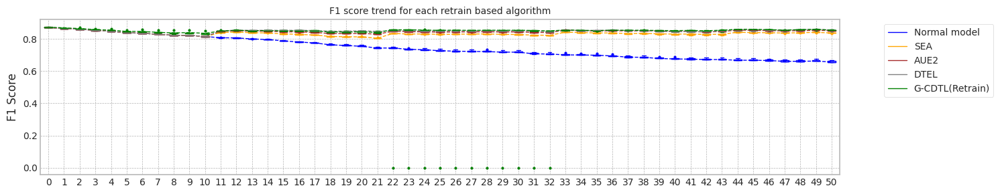

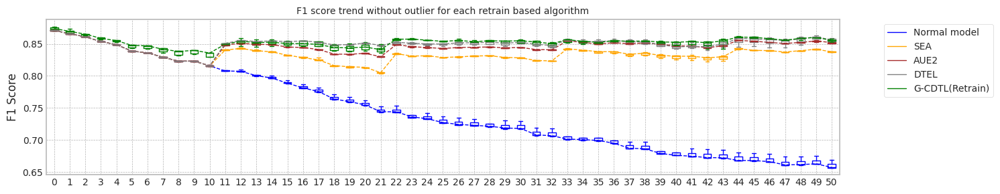

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.382378339767456
Base flops (train + inference flops of normal model, median): 3511755000.0


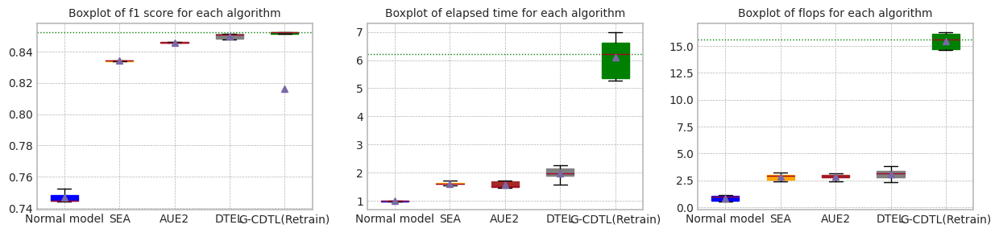

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.382378339767456


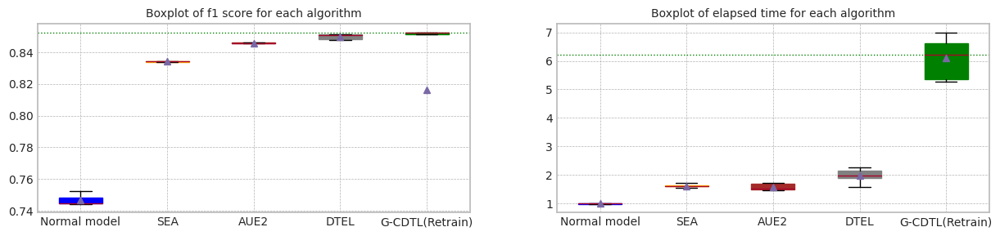

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.429904,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.337891,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.382378,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.422319,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.360212,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.382378,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.039490,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.369166,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.454248,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.527527,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.415712,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.477999,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.454248,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.060242,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.833717,0.837645,16.111356,5.127345e+09,6.243120e+09,1.137046e+10
1,1.0,0.871143,0.866126,0.834284,0.837225,15.021944,4.815450e+09,4.200795e+09,9.016245e+09
2,2.0,0.870401,0.865446,0.834229,0.840677,14.503303,4.694085e+09,3.824955e+09,8.519040e+09
3,3.0,0.871195,0.865883,0.833898,0.834921,15.089420,4.838070e+09,5.527110e+09,1.036518e+10
4,4.0,0.870160,0.865308,0.834132,0.837645,15.529429,4.929855e+09,5.701110e+09,1.063096e+10
5,median,0.871099,0.865787,0.834132,0.837645,15.089420,4.838070e+09,5.527110e+09,1.036518e+10
6,std,0.000483,0.000332,0.000239,0.002049,0.603192,1.613611e+08,1.034986e+09,1.179909e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.845610,0.852037,14.251846,4.631445e+09,5.946885e+09,1.057833e+10
1,1.0,0.871143,0.866126,0.845862,0.853077,16.005303,5.024685e+09,4.609695e+09,9.634380e+09
2,2.0,0.870401,0.865446,0.845168,0.850378,13.889686,4.533570e+09,3.864105e+09,8.397675e+09
3,3.0,0.871195,0.865883,0.845940,0.852343,14.075657,4.568805e+09,5.457510e+09,1.002632e+10
4,4.0,0.870160,0.865308,0.845818,0.851078,16.084855,5.060790e+09,6.031710e+09,1.109250e+10
5,median,0.871099,0.865787,0.845818,0.852037,14.251846,4.631445e+09,5.457510e+09,1.002632e+10
6,std,0.000483,0.000332,0.000311,0.001064,1.088408,2.572988e+08,9.283510e+08,1.026544e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.850856,0.859384,21.255866,6.546315e+09,6.957825e+09,1.350414e+10
1,1.0,0.871143,0.866126,0.851021,0.857390,18.519825,5.736345e+09,3.930660e+09,9.667005e+09
2,2.0,0.870401,0.865446,0.851081,0.856224,14.853479,4.825890e+09,3.295995e+09,8.121885e+09
3,3.0,0.871195,0.865883,0.848346,0.854209,17.783125,5.510145e+09,5.457945e+09,1.096809e+10
4,4.0,0.870160,0.865308,0.847571,0.848531,20.218942,6.028665e+09,5.899035e+09,1.192770e+10
5,median,0.871099,0.865787,0.850856,0.856224,18.519825,5.736345e+09,5.457945e+09,1.096809e+10
6,std,0.000483,0.000332,0.001683,0.004147,2.467668,6.366634e+08,1.486568e+09,2.065259e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.852101,0.857924,62.027931,5.655828e+10,62685000.0,5.662097e+10
1,1.0,0.873993,0.869518,0.852438,0.852964,49.525696,5.166986e+10,62685000.0,5.173254e+10
2,2.0,0.876834,0.873531,0.855151,0.854536,65.642722,5.718756e+10,62685000.0,5.725025e+10
3,3.0,0.871205,0.866786,0.669452,0.856291,58.198673,5.459718e+10,62685000.0,5.465986e+10
4,4.0,0.871522,0.867111,0.851219,0.855514,50.264929,5.118494e+10,62685000.0,5.124763e+10
5,median,0.873993,0.869518,0.852101,0.855514,58.198673,5.459718e+10,62685000.0,5.465986e+10
6,std,0.002400,0.002718,0.081976,0.001861,7.116053,2.744501e+09,0.0,2.744501e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:03:42,517] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 373.73it/s]

Early stop: 954
[2023-11-29 01:03:45,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:03:54,495] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:03:54,497] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 421/2000 [00:03<00:13, 121.16it/s]

[2023-11-29 01:04:09,294] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:04:09,296] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:04:18,853] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 381.09it/s]

Early stop: 512
[2023-11-29 01:04:20,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:04:30,278] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:04:30,280] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:04<00:13, 115.01it/s]

[2023-11-29 01:04:45,745] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:04:45,746] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:04:55,363] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:01<00:04, 322.27it/s]

Early stop: 447
[2023-11-29 01:04:56,759] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.23it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:05:06,573] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 01:05:06,576] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:13, 117.19it/s]

[2023-11-29 01:05:10,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:05:10,547] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]


mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:05:20,154] [INFO] [profiler.py:80:start_profile] Flops profiler started


 42%|████▏     | 845/2000 [00:02<00:03, 373.63it/s]

Early stop: 845
[2023-11-29 01:05:22,422] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.25it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:05:32,197] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:05:32,199] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:03<00:13, 114.25it/s]

[2023-11-29 01:05:47,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:05:47,315] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.25it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:05:57,087] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:02<00:02, 380.50it/s]

Early stop: 866
[2023-11-29 01:05:59,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:06:08,749] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:06:08,751] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:03<00:13, 120.55it/s]

[2023-11-29 01:06:22,973] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:06:22,974] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:06:34,244] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:06:34,246] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:06:47,563] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:06:47,564] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:14<03:02,  4.35s/it]

G-CDTL train flops: 3500000000 570500000 141810000 4212310000


 33%|███▎      | 17/51 [00:16<00:14,  2.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:06:49,251] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:06:49,253] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:07:03,244] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:03,245] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:30<01:43,  3.24s/it]

G-CDTL train flops: 3500000000 624750000 155295000 4280045000


 51%|█████     | 26/51 [00:32<00:10,  2.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:07:04,935] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:07:04,938] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:07:20,872] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:20,873] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:48<01:24,  3.66s/it]

G-CDTL train flops: 3500000000 1086750000 270135000 4856885000


 69%|██████▊   | 35/51 [00:49<00:07,  2.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:07:22,572] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:07:22,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:07:36,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:36,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:03<00:45,  3.23s/it]

G-CDTL train flops: 3500000000 588000000 146160000 4234160000


 86%|████████▋ | 44/51 [01:05<00:03,  2.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:07:38,039] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:07:38,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:07:54,563] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:54,564] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:22<00:18,  3.78s/it]

G-CDTL train flops: 3500000000 1204000000 299280000 5003280000


100%|██████████| 51/51 [01:23<00:00,  1.63s/it]


Early stop at  [325, 356, 620, 335, 687]
Train flops  [4212310000, 4280045000, 4856885000, 4234160000, 5003280000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8563609009195051
G_CDTL+AUE median: 0.8563609009195051
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:13,  3.00it/s]

Ensemble_SEA train flops: 173565000


 37%|███▋      | 19/51 [00:04<00:10,  2.93it/s]

Ensemble_SEA train flops: 169650000


 55%|█████▍    | 28/51 [00:06<00:04,  4.65it/s]

Ensemble_SEA train flops: 27840000


 73%|███████▎  | 37/51 [00:10<00:07,  1.82it/s]

Ensemble_SEA train flops: 426300000


 90%|█████████ | 46/51 [00:13<00:02,  1.71it/s]

Ensemble_SEA train flops: 445005000


100%|██████████| 51/51 [00:14<00:00,  3.51it/s]


Early stop at  [398, 389, 63, 979, 1022]
Train flops  [173565000, 169650000, 27840000, 426300000, 445005000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8309674950902607
SEA median: 0.8309674950902607
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:14,  2.81it/s]

Ensemble_SEA train flops: 197490000


 37%|███▋      | 19/51 [00:06<00:18,  1.72it/s]

Ensemble_SEA train flops: 458055000


 55%|█████▍    | 28/51 [00:09<00:10,  2.13it/s]

Ensemble_SEA train flops: 299715000


 73%|███████▎  | 37/51 [00:12<00:08,  1.61it/s]

Ensemble_SEA train flops: 491985000


 90%|█████████ | 46/51 [00:15<00:02,  1.97it/s]

Ensemble_SEA train flops: 354090000


100%|██████████| 51/51 [00:16<00:00,  3.02it/s]


Early stop at  [453, 1052, 688, 1130, 813]
Train flops  [197490000, 458055000, 299715000, 491985000, 354090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.850481206533659
AUE median: 0.850481206533659
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.52it/s]

Ensemble_DTEL train flops: 348870000


 20%|█▉        | 10/51 [00:05<00:41,  1.01s/it]

Ensemble_DTEL train flops: 579420000


 33%|███▎      | 17/51 [00:06<00:08,  4.04it/s]

Ensemble_DTEL train flops: 148335000


 37%|███▋      | 19/51 [00:09<00:18,  1.70it/s]

Ensemble_DTEL train flops: 291450000


 51%|█████     | 26/51 [00:10<00:05,  4.67it/s]

Ensemble_DTEL train flops: 449355000


 55%|█████▍    | 28/51 [00:13<00:17,  1.29it/s]

Ensemble_DTEL train flops: 234465000


 69%|██████▊   | 35/51 [00:14<00:03,  4.35it/s]

Ensemble_DTEL train flops: 563325000


 73%|███████▎  | 37/51 [00:18<00:11,  1.17it/s]

Ensemble_DTEL train flops: 180525000


 90%|█████████ | 46/51 [00:21<00:02,  1.87it/s]

Ensemble_DTEL train flops: 379320000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:22<00:00,  2.29it/s]


Early stop at  [801, 1331, 340, 669, 1032, 538, 1294, 414, 871, 2]
Train flops  [348870000, 579420000, 148335000, 291450000, 449355000, 234465000, 563325000, 180525000, 379320000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8541822350867064
DTEL median: 0.8541822350867064
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:08:51,188] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:08:51,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:09:06,288] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:06,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:16<02:21,  3.45s/it]

G-CDTL train flops: 3500000000 861000000 214020000 4575020000


 33%|███▎      | 17/51 [00:18<00:15,  2.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:07,996] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:07,999] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:09:22,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:22,839] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:33<01:49,  3.44s/it]

G-CDTL train flops: 3500000000 813750000 202275000 4516025000


 51%|█████     | 26/51 [00:34<00:11,  2.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:24,538] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:24,540] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:09:38,535] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:38,537] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:49<01:14,  3.26s/it]

G-CDTL train flops: 3500000000 619500000 153990000 4273490000


 69%|██████▊   | 35/51 [00:50<00:06,  2.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:40,191] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:40,194] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:09:54,676] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:54,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:05<00:46,  3.35s/it]

G-CDTL train flops: 3500000000 668500000 166170000 4334670000


 86%|████████▋ | 44/51 [01:06<00:03,  2.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:56,330] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:56,332] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:10:10,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:10:10,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:21<00:16,  3.35s/it]

G-CDTL train flops: 3500000000 687750000 170955000 4358705000


100%|██████████| 51/51 [01:22<00:00,  1.62s/it]


Early stop at  [491, 464, 353, 381, 392]
Train flops  [4575020000, 4516025000, 4273490000, 4334670000, 4358705000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8558009917872595
G_CDTL+AUE median: 0.8560809463533823
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:20,  1.98it/s]

Ensemble_SEA train flops: 361485000


 37%|███▋      | 19/51 [00:05<00:12,  2.52it/s]

Ensemble_SEA train flops: 226635000


 55%|█████▍    | 28/51 [00:09<00:15,  1.52it/s]

Ensemble_SEA train flops: 522870000


 73%|███████▎  | 37/51 [00:13<00:08,  1.71it/s]

Ensemble_SEA train flops: 438915000


 90%|█████████ | 46/51 [00:16<00:02,  1.78it/s]

Ensemble_SEA train flops: 411075000


100%|██████████| 51/51 [00:17<00:00,  2.90it/s]


Early stop at  [830, 520, 1201, 1008, 944]
Train flops  [361485000, 226635000, 522870000, 438915000, 411075000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8364100827346044
SEA median: 0.8336887889124325
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:21,  1.93it/s]

Ensemble_SEA train flops: 362790000


 37%|███▋      | 19/51 [00:06<00:18,  1.75it/s]

Ensemble_SEA train flops: 418035000


 55%|█████▍    | 28/51 [00:10<00:12,  1.89it/s]

Ensemble_SEA train flops: 380625000


 73%|███████▎  | 37/51 [00:13<00:07,  1.84it/s]

Ensemble_SEA train flops: 396720000


 88%|████████▊ | 45/51 [00:17<00:05,  1.02it/s]

Ensemble_SEA train flops: 605955000


100%|██████████| 51/51 [00:18<00:00,  2.75it/s]


Early stop at  [833, 960, 874, 911, 1392]
Train flops  [362790000, 418035000, 380625000, 396720000, 605955000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8491544334403346
AUE median: 0.8498178199869968
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.48it/s]

Ensemble_DTEL train flops: 180960000


 20%|█▉        | 10/51 [00:04<00:27,  1.48it/s]

Ensemble_DTEL train flops: 350610000


 33%|███▎      | 17/51 [00:05<00:07,  4.51it/s]

Ensemble_DTEL train flops: 559410000


 37%|███▋      | 19/51 [00:09<00:32,  1.02s/it]

Ensemble_DTEL train flops: 351045000


 51%|█████     | 26/51 [00:10<00:06,  4.02it/s]

Ensemble_DTEL train flops: 359745000


 55%|█████▍    | 28/51 [00:13<00:17,  1.28it/s]

Ensemble_DTEL train flops: 289275000


 69%|██████▊   | 35/51 [00:15<00:03,  4.33it/s]

Ensemble_DTEL train flops: 307110000


 73%|███████▎  | 37/51 [00:17<00:09,  1.53it/s]

Ensemble_DTEL train flops: 205755000


 90%|█████████ | 46/51 [00:21<00:03,  1.61it/s]

Ensemble_DTEL train flops: 478935000
Ensemble_DTEL train flops: 2610000


100%|██████████| 51/51 [00:22<00:00,  2.28it/s]


Early stop at  [415, 805, 1285, 806, 826, 664, 705, 472, 1100, 5]
Train flops  [180960000, 350610000, 559410000, 351045000, 359745000, 289275000, 307110000, 205755000, 478935000, 2610000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8514413104863829
DTEL median: 0.8528117727865447
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:11:12,186] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:11:12,189] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:11:27,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:11:27,498] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:17<02:23,  3.50s/it]

G-CDTL train flops: 3500000000 869750000 216195000 4585945000


 33%|███▎      | 17/51 [00:18<00:15,  2.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:11:29,155] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:11:29,157] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:11:43,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:11:43,628] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:33<01:47,  3.36s/it]

G-CDTL train flops: 3500000000 673750000 167475000 4341225000


 51%|█████     | 26/51 [00:34<00:11,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:11:45,315] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:11:45,317] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:12:04,676] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:12:04,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:54<02:28,  6.18s/it]

G-CDTL train flops: 3500000000 1704500000 423690000 5628190000


 69%|██████▊   | 35/51 [00:55<00:08,  1.84it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:12:06,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:12:06,447] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:12:20,372] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:12:20,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:10<00:46,  3.29s/it]

G-CDTL train flops: 3500000000 523250000 130065000 4153315000


 86%|████████▋ | 44/51 [01:11<00:03,  2.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:12:22,046] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:12:22,048] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:12:37,023] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:12:37,024] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:26<00:29,  4.86s/it]

G-CDTL train flops: 3500000000 708750000 176175000 4384925000


100%|██████████| 51/51 [01:27<00:00,  1.72s/it]


Early stop at  [496, 384, 973, 298, 404]
Train flops  [4585945000, 4341225000, 5628190000, 4153315000, 4384925000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8570060470476926
G_CDTL+AUE median: 0.8563609009195051
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:13,  3.00it/s]

Ensemble_SEA train flops: 166605000


 37%|███▋      | 19/51 [00:05<00:11,  2.73it/s]

Ensemble_SEA train flops: 204015000


 55%|█████▍    | 28/51 [00:08<00:11,  2.07it/s]

Ensemble_SEA train flops: 317115000


 73%|███████▎  | 37/51 [00:10<00:05,  2.50it/s]

Ensemble_SEA train flops: 231855000


 90%|█████████ | 46/51 [00:13<00:02,  2.32it/s]

Ensemble_SEA train flops: 266655000


100%|██████████| 51/51 [00:14<00:00,  3.54it/s]


Early stop at  [382, 468, 728, 532, 612]
Train flops  [166605000, 204015000, 317115000, 231855000, 266655000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8401103222164639
SEA median: 0.8364100827346044
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:26,  1.55it/s]

Ensemble_SEA train flops: 501990000


 37%|███▋      | 19/51 [00:07<00:18,  1.69it/s]

Ensemble_SEA train flops: 435870000


 55%|█████▍    | 28/51 [00:09<00:07,  3.01it/s]

Ensemble_SEA train flops: 151380000


 73%|███████▎  | 37/51 [00:15<00:13,  1.03it/s]

Ensemble_SEA train flops: 870000000


 90%|█████████ | 46/51 [00:18<00:02,  1.82it/s]

Ensemble_SEA train flops: 368880000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [1153, 1001, 347, 1999, 847]
Train flops  [501990000, 435870000, 151380000, 870000000, 368880000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8494629915238375
AUE median: 0.8494629915238375
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.42it/s]

Ensemble_DTEL train flops: 1740000


 20%|█▉        | 10/51 [00:02<00:17,  2.32it/s]

Ensemble_DTEL train flops: 266655000


 33%|███▎      | 17/51 [00:04<00:06,  4.95it/s]

Ensemble_DTEL train flops: 663375000


 37%|███▋      | 19/51 [00:08<00:30,  1.05it/s]

Ensemble_DTEL train flops: 195315000


 55%|█████▍    | 28/51 [00:11<00:12,  1.86it/s]

Ensemble_DTEL train flops: 362790000
Ensemble_DTEL train flops: 870000


 69%|██████▊   | 35/51 [00:12<00:03,  4.76it/s]

Ensemble_DTEL train flops: 306240000


 73%|███████▎  | 37/51 [00:15<00:08,  1.59it/s]

Ensemble_DTEL train flops: 174435000


 90%|█████████ | 46/51 [00:18<00:02,  1.85it/s]

Ensemble_DTEL train flops: 381495000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [3, 612, 1524, 448, 833, 1, 703, 400, 876, 2]
Train flops  [1740000, 266655000, 663375000, 195315000, 362790000, 870000, 306240000, 174435000, 381495000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8535932504986757
DTEL median: 0.8535932504986757
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:13:33,010] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:13:33,013] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:13:55,500] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:13:55,501] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:24<03:26,  5.05s/it]

G-CDTL train flops: 3500000000 2255750000 560715000 6316465000


 33%|███▎      | 17/51 [00:25<00:19,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:13:57,178] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:13:57,180] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:14:12,189] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:14:12,190] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:41<01:53,  3.54s/it]

G-CDTL train flops: 3500000000 715750000 177915000 4393665000


 51%|█████     | 26/51 [00:42<00:11,  2.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:14:13,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:14:13,868] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:14:28,154] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:14:28,156] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:56<01:16,  3.32s/it]

G-CDTL train flops: 3500000000 588000000 146160000 4234160000


 69%|██████▊   | 35/51 [00:58<00:07,  2.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:14:29,834] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:14:29,836] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:14:44,207] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:14:44,208] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:13<00:46,  3.33s/it]

G-CDTL train flops: 3500000000 575750000 143115000 4218865000


 86%|████████▋ | 44/51 [01:14<00:03,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:14:45,912] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:14:45,914] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:15:13,692] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:15:13,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:42<00:52,  8.70s/it]

G-CDTL train flops: 3500000000 3361750000 835635000 7697385000


100%|██████████| 51/51 [01:43<00:00,  2.03s/it]


Early stop at  [1288, 408, 335, 328, 1920]
Train flops  [6316465000, 4393665000, 4234160000, 4218865000, 7697385000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8556357521435023
G_CDTL+AUE median: 0.8560809463533823
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.45it/s]

Ensemble_SEA train flops: 2175000


 37%|███▋      | 19/51 [00:04<00:12,  2.60it/s]

Ensemble_SEA train flops: 215760000


 55%|█████▍    | 28/51 [00:07<00:10,  2.12it/s]

Ensemble_SEA train flops: 313635000


 73%|███████▎  | 37/51 [00:10<00:06,  2.30it/s]

Ensemble_SEA train flops: 258825000


 90%|█████████ | 46/51 [00:13<00:02,  1.97it/s]

Ensemble_SEA train flops: 346695000


100%|██████████| 51/51 [00:14<00:00,  3.57it/s]


Early stop at  [4, 495, 720, 594, 796]
Train flops  [2175000, 215760000, 313635000, 258825000, 346695000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8295549289061398
SEA median: 0.8336887889124325
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:18,  2.27it/s]

Ensemble_SEA train flops: 274485000


 37%|███▋      | 19/51 [00:07<00:27,  1.17it/s]

Ensemble_SEA train flops: 746025000


 55%|█████▍    | 28/51 [00:10<00:11,  2.04it/s]

Ensemble_SEA train flops: 294930000


 73%|███████▎  | 37/51 [00:15<00:11,  1.23it/s]

Ensemble_SEA train flops: 703395000


 90%|█████████ | 46/51 [00:18<00:02,  1.80it/s]

Ensemble_SEA train flops: 391500000


100%|██████████| 51/51 [00:19<00:00,  2.59it/s]


Early stop at  [630, 1714, 677, 1616, 899]
Train flops  [274485000, 746025000, 294930000, 703395000, 391500000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8491364524234196
AUE median: 0.8493087124820861
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.59it/s]

Ensemble_DTEL train flops: 274050000


 20%|█▉        | 10/51 [00:04<00:31,  1.32it/s]

Ensemble_DTEL train flops: 325815000


 33%|███▎      | 17/51 [00:05<00:08,  4.18it/s]

Ensemble_DTEL train flops: 544620000


 37%|███▋      | 19/51 [00:10<00:32,  1.02s/it]

Ensemble_DTEL train flops: 343650000


 55%|█████▍    | 28/51 [00:13<00:14,  1.64it/s]

Ensemble_DTEL train flops: 454140000
Ensemble_DTEL train flops: 870000


 69%|██████▊   | 35/51 [00:14<00:03,  4.68it/s]

Ensemble_DTEL train flops: 438915000


 73%|███████▎  | 37/51 [00:17<00:11,  1.27it/s]

Ensemble_DTEL train flops: 219240000


 90%|█████████ | 46/51 [00:21<00:03,  1.60it/s]

Ensemble_DTEL train flops: 456315000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:22<00:00,  2.26it/s]


Early stop at  [629, 748, 1251, 789, 1043, 1, 1008, 503, 1048, 2]
Train flops  [274050000, 325815000, 544620000, 343650000, 454140000, 870000, 438915000, 219240000, 456315000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8531249679226638
DTEL median: 0.8533591092106698
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:13,112] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:13,114] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:16:22,779] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:16:22,781] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:11<01:33,  2.27s/it]

G-CDTL train flops: 1760500000 733250000 182265000 2676015000


 33%|███▎      | 17/51 [00:12<00:12,  2.83it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:24,456] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:24,458] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:16:39,506] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:16:39,507] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:28<01:49,  3.44s/it]

G-CDTL train flops: 3500000000 647500000 160950000 4308450000


 51%|█████     | 26/51 [00:29<00:11,  2.20it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:41,200] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:41,202] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:16:55,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:16:55,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:44<01:18,  3.41s/it]

G-CDTL train flops: 3500000000 581000000 144420000 4225420000


 69%|██████▊   | 35/51 [00:46<00:07,  2.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:57,647] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:57,650] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:17:05,508] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:17:05,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:54<00:27,  1.97s/it]

G-CDTL train flops: 75250000 1531250000 380625000 1987125000


 86%|████████▋ | 44/51 [00:55<00:02,  3.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:17:07,200] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:17:07,203] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:17:23,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:17:23,047] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:11<00:17,  3.59s/it]

G-CDTL train flops: 3500000000 803250000 199665000 4502915000


100%|██████████| 51/51 [01:12<00:00,  1.43s/it]


Early stop at  [418, 369, 331, 874, 458]
Train flops  [2676015000, 4308450000, 4225420000, 1987125000, 4502915000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8546457184839646
G_CDTL+AUE median: 0.8558009917872595
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:23,  1.73it/s]

Ensemble_SEA train flops: 412815000


 37%|███▋      | 19/51 [00:05<00:10,  2.96it/s]

Ensemble_SEA train flops: 155295000


 55%|█████▍    | 28/51 [00:09<00:11,  2.07it/s]

Ensemble_SEA train flops: 321465000


 71%|███████   | 36/51 [00:11<00:07,  2.03it/s]

Ensemble_SEA train flops: 216630000


 88%|████████▊ | 45/51 [00:15<00:05,  1.16it/s]

Ensemble_SEA train flops: 499380000


100%|██████████| 51/51 [00:16<00:00,  3.07it/s]


Early stop at  [948, 356, 738, 497, 1147]
Train flops  [412815000, 155295000, 321465000, 216630000, 499380000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8363818075551455
SEA median: 0.8363818075551455
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:26,  1.55it/s]

Ensemble_SEA train flops: 494160000


 37%|███▋      | 19/51 [00:06<00:13,  2.45it/s]

Ensemble_SEA train flops: 221850000


 55%|█████▍    | 28/51 [00:09<00:08,  2.78it/s]

Ensemble_SEA train flops: 180960000


 73%|███████▎  | 37/51 [00:12<00:08,  1.73it/s]

Ensemble_SEA train flops: 422385000


 90%|█████████ | 46/51 [00:15<00:02,  1.89it/s]

Ensemble_SEA train flops: 360180000


100%|██████████| 51/51 [00:16<00:00,  3.05it/s]


Early stop at  [1135, 509, 415, 970, 827]
Train flops  [494160000, 221850000, 180960000, 422385000, 360180000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8502490376422817
AUE median: 0.8494629915238375
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.51it/s]

Ensemble_DTEL train flops: 273180000


 20%|█▉        | 10/51 [00:03<00:23,  1.76it/s]

Ensemble_DTEL train flops: 140070000


 33%|███▎      | 17/51 [00:04<00:07,  4.64it/s]

Ensemble_DTEL train flops: 612045000


 37%|███▋      | 19/51 [00:08<00:31,  1.02it/s]

Ensemble_DTEL train flops: 241860000


 51%|█████     | 26/51 [00:10<00:06,  3.99it/s]

Ensemble_DTEL train flops: 573765000


 55%|█████▍    | 28/51 [00:14<00:22,  1.04it/s]

Ensemble_DTEL train flops: 230115000


 69%|██████▊   | 35/51 [00:15<00:04,  3.98it/s]

Ensemble_DTEL train flops: 382365000


 73%|███████▎  | 37/51 [00:17<00:09,  1.51it/s]

Ensemble_DTEL train flops: 112665000


 90%|█████████ | 46/51 [00:21<00:03,  1.63it/s]

Ensemble_DTEL train flops: 454140000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:22<00:00,  2.27it/s]


Early stop at  [627, 321, 1406, 555, 1318, 528, 878, 258, 1043, 2]
Train flops  [273180000, 140070000, 612045000, 241860000, 573765000, 230115000, 382365000, 112665000, 454140000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8535836305497515
DTEL median: 0.8535836305497515


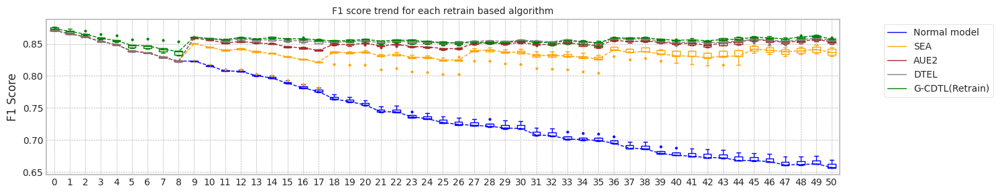

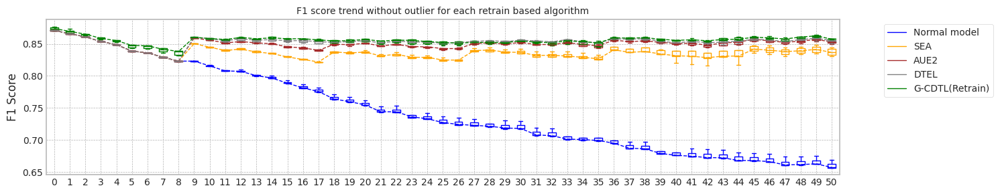

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.757805347442627
Base flops (train + inference flops of normal model, median): 3511755000.0


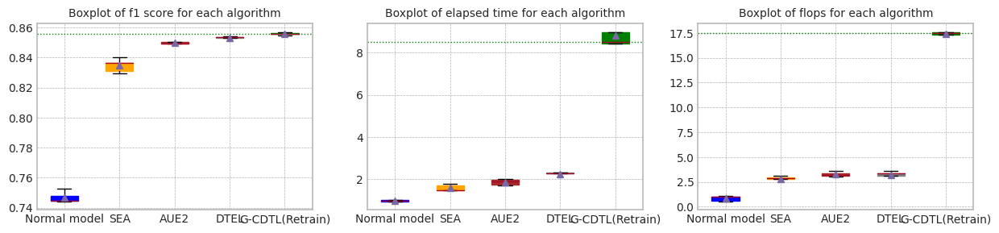

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.757805347442627


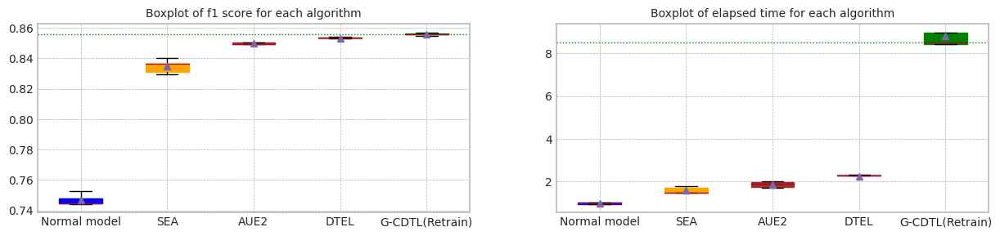

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.401495,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,10.055998,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.795512,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.757805,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.361615,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.757805,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.291356,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.538157,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.593124,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.582482,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.751762,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.560064,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.582482,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.084667,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.830967,0.830261,14.560174,4.636665e+09,5.854230e+09,1.049090e+10
1,1.0,0.871143,0.866126,0.836410,0.833015,17.607986,5.355285e+09,4.842420e+09,1.019770e+10
2,2.0,0.870401,0.865446,0.840110,0.842525,14.450070,4.580550e+09,3.813210e+09,8.393760e+09
3,3.0,0.871195,0.865883,0.829555,0.844449,14.328513,4.531395e+09,5.322225e+09,9.853620e+09
4,4.0,0.870160,0.865308,0.836382,0.836576,16.622814,4.999890e+09,5.872935e+09,1.087282e+10
5,median,0.871099,0.865787,0.836382,0.836576,14.560174,4.636665e+09,5.322225e+09,1.019770e+10
6,std,0.000483,0.000332,0.004342,0.006059,1.505104,3.511155e+08,8.557810e+08,9.534164e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.850481,0.853890,16.913878,5.195640e+09,6.612870e+09,1.180851e+10
1,1.0,0.871143,0.866126,0.849154,0.851140,18.563326,5.558430e+09,5.245230e+09,1.080366e+10
2,2.0,0.870401,0.865446,0.849463,0.853045,19.366024,5.722425e+09,5.154750e+09,1.087718e+10
3,3.0,0.871195,0.865883,0.849136,0.849638,19.700205,5.804640e+09,6.795135e+09,1.259978e+10
4,4.0,0.870160,0.865308,0.850249,0.853448,16.759211,5.073840e+09,6.146550e+09,1.122039e+10
5,median,0.871099,0.865787,0.849463,0.853045,18.563326,5.558430e+09,6.146550e+09,1.122039e+10
6,std,0.000483,0.000332,0.000629,0.001790,1.365091,3.223869e+08,7.604338e+08,7.497347e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.854182,0.857541,22.329816,6.570675e+09,6.207885e+09,1.277856e+10
1,1.0,0.871143,0.866126,0.851441,0.850802,22.363837,6.479760e+09,4.489200e+09,1.096896e+10
2,2.0,0.870401,0.865446,0.853593,0.855381,19.372139,5.748525e+09,3.576570e+09,9.325095e+09
3,3.0,0.871195,0.865883,0.853125,0.853025,22.554766,6.453225e+09,5.461860e+09,1.191508e+10
4,4.0,0.870160,0.865308,0.853584,0.855022,22.512810,6.415815e+09,5.377035e+09,1.179285e+10
5,median,0.871099,0.865787,0.853584,0.855022,22.363837,6.453225e+09,5.377035e+09,1.179285e+10
6,std,0.000483,0.000332,0.001045,0.002551,1.375440,3.320201e+08,1.012298e+09,1.303981e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.856361,0.857143,83.145873,6.124474e+10,53730000.0,6.129847e+10
1,1.0,0.873993,0.869518,0.855801,0.859769,82.413858,6.071597e+10,53730000.0,6.076970e+10
2,2.0,0.876834,0.873531,0.857006,0.857392,87.678744,6.175166e+10,53730000.0,6.180539e+10
3,3.0,0.871205,0.866786,0.855636,0.857418,103.512526,6.551860e+10,53730000.0,6.557233e+10
4,4.0,0.871522,0.867111,0.854646,0.858148,72.754550,5.635798e+10,53730000.0,5.641172e+10
5,median,0.873993,0.869518,0.855801,0.857418,83.145873,6.124474e+10,53730000.0,6.129847e+10
6,std,0.002400,0.002718,0.000879,0.001071,11.246180,3.263520e+09,0.0,3.263520e+09


In [ ]:

org_df_rt = {}
gcd_df_rt = {}
sea_df_rt = {}
aue_df_rt = {}
dte_df_rt = {}
gea_df_rt = {}


orgf_df_rt = {}
gcdf_df_rt = {}
seaf_df_rt = {}
auef_df_rt = {}
dtef_df_rt = {}
geaf_df_rt = {}

test_f1_score = []

for RT in range(1,6):
    org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case1',X1, Y1,train_size, test_size,avaible_range = 300,
                                                                lambda_f2=0.8,trial_count=5,lr_g=0.002,
                                                                retrain_count=RT,weight_init=True)
    test_f1_score = org_df['Testset F1']
    org_df_rt[f'{RT}'] = org_df['Mean F1']
    gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
    sea_df_rt[f'{RT}'] = sea_df['Mean F1']
    aue_df_rt[f'{RT}'] = aue_df['Mean F1']
    dte_df_rt[f'{RT}'] = dte_df['Mean F1']
    gea_df_rt[f'{RT}'] = gea_df['Mean F1']

    orgf_df_rt[f'{RT}'] = org_df['flops']
    gcdf_df_rt[f'{RT}'] = gcd_df['flops']
    seaf_df_rt[f'{RT}'] = sea_df['flops']
    auef_df_rt[f'{RT}'] = aue_df['flops']
    dtef_df_rt[f'{RT}'] = dte_df['flops']
    geaf_df_rt[f'{RT}'] = gea_df['flops']

Test F1 Score: 0.8707996702252515
G-CDTL, 1-retrain: 0.8362723179200645


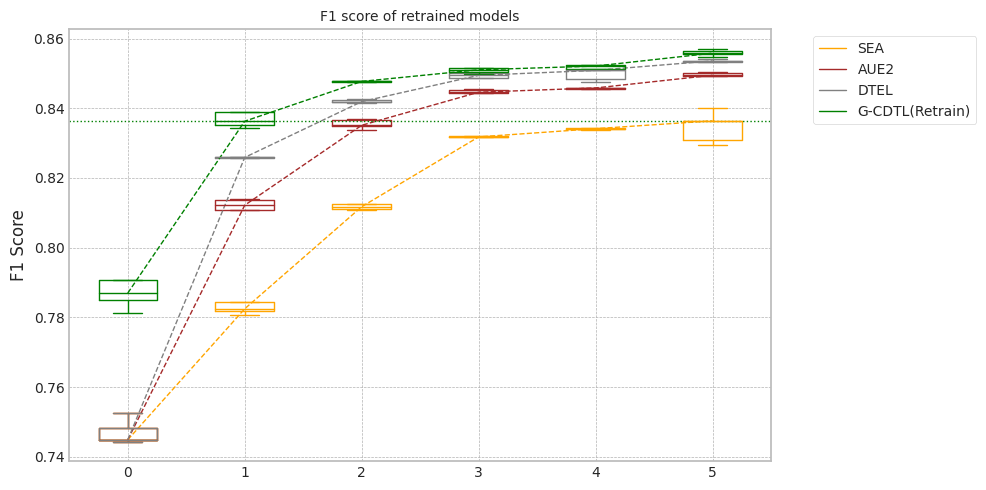

In [ ]:
org_df1 = pd.DataFrame(org_df_rt)
gcd_df1 = pd.DataFrame(gcd_df_rt)

sea_df1 = pd.DataFrame(sea_df_rt)
aue_df1 = pd.DataFrame(aue_df_rt)
dte_df1 = pd.DataFrame(dte_df_rt)
gea_df1 = pd.DataFrame(gea_df_rt)

sea_df1.insert(0, "0", org_df1['1'], True)
aue_df1.insert(0, "0", org_df1['1'], True)
dte_df1.insert(0, "0", org_df1['1'], True)
gea_df1.insert(0, "0", gcd_df1['1'], True)

fig, ax = plt.subplots(figsize=(10,5))
lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
lg = draw_chart2(ax,lg,'DTEL',dte_df1,'gray',showfliers=False)
lg = draw_chart2(ax,lg,'G-CDTL(Retrain)',gea_df1,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

#ax.axhline(y = np.mean(org_df1['1'][0:org_df1.shape[0]-2]), color = 'black', linewidth=1, linestyle = ':')

tf1 = np.mean(test_f1_score[0:org_df1.shape[0]-2])
print('Test F1 Score:',tf1)
tcd = np.median(gea_df1['1'][0:gea_df1.shape[0]-2])
print('G-CDTL, 1-retrain:',tcd)

ax.axhline(y = tcd, color = 'green', linewidth=1, linestyle = ':')

set_legend2(ax,lg,'F1 score of retrained models')
plt.tight_layout()
plt.show()


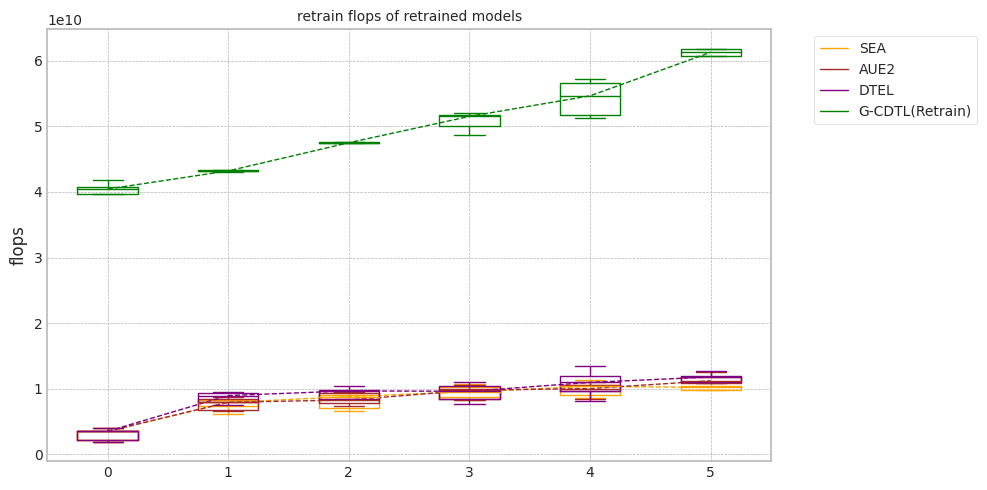

In [ ]:
org_df2 = pd.DataFrame(orgf_df_rt)
gcd_df2 = pd.DataFrame(gcdf_df_rt)

sea_df2 = pd.DataFrame(seaf_df_rt)
aue_df2 = pd.DataFrame(auef_df_rt)
dte_df2 = pd.DataFrame(dtef_df_rt)
gea_df2 = pd.DataFrame(geaf_df_rt)

sea_df2.insert(0, "0", org_df2['1'], True)
aue_df2.insert(0, "0", org_df2['1'], True)
dte_df2.insert(0, "0", org_df2['1'], True)
gea_df2.insert(0, "0", gcd_df2['1'], True)

fig, ax = plt.subplots(figsize=(10,5))
lg = draw_chart3(ax,None,'SEA',sea_df2,'orange',showfliers=False)
lg = draw_chart3(ax,lg,'AUE2',aue_df2,'brown',showfliers=False)
lg = draw_chart3(ax,lg,'DTEL',dte_df2,'purple',showfliers=False)
lg = draw_chart3(ax,lg,'G-CDTL(Retrain)',gea_df2,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

set_legend2(ax,lg,'retrain flops of retrained models')
plt.tight_layout()
plt.show()

## synthetic data의 생성 (Case #2 MI의 증감(상대적), Drift의 고정)

+ $P_t(y|X) \ne P_{t+w}(y|X)$ and $P_t(X) = P_{t+w}(X)$
+ Actual Drift
+ 즉, P(X)의 변화없이, Concept (본 Dataset에서 MI의 변화)만 변경


+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature에 대해 y의 비중이 시간에 따라 감소하도록 생성

### Dataset 준비

In [ ]:
data_size = 60000
cor = np.asarray([1.5, 1.2, 0.9 , 0.7, 2.5])

In [ ]:
seed_everything()

x1 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x1[:,ix] = np.random.normal(1,cor_,data_size)

In [ ]:
x1.shape

(60000, 5)

In [ ]:
import matplotlib.pyplot as plt

seed_everything()

y1_array = []
cor_const = cor[4]
for ii in range(x1.shape[0]):
    cor[4] = cor[4] - cor_const / x1.shape[0]
    e = np.random.normal(0.0, 2.0)
    y1_array.append(np.sum(cor * x1[ii])+e)

In [ ]:
m = 5 #np.mean(y1_array[0:2000])
print(m)
y1 = [1 if y_ > m else 0 for y_ in y1_array]
print(sum(y1))

5
31901


### 실험

MI Analysis MI Max 0.22806, Min 0.00205, Mean 0.07018, Std 0.08508
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:08<00:00,  5.72it/s]


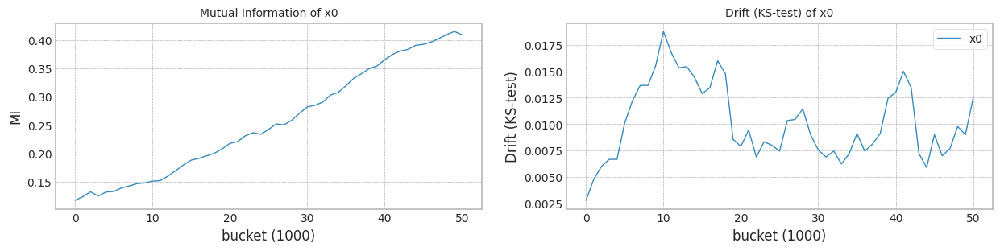

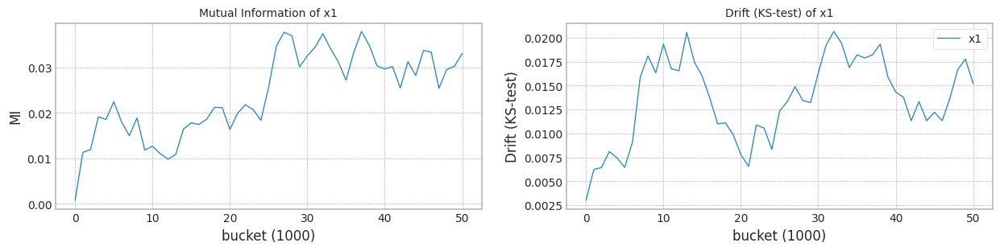

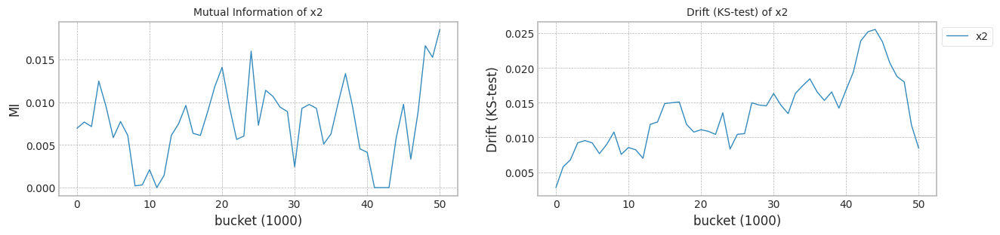

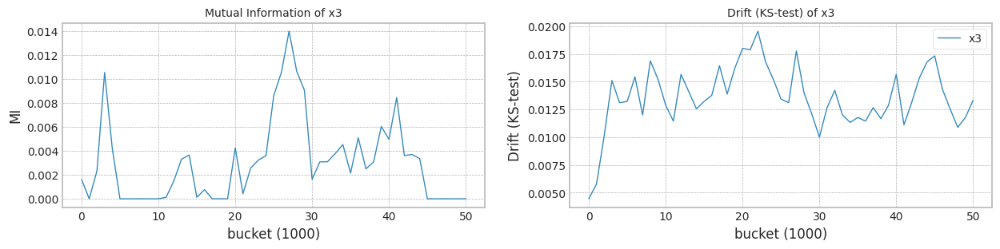

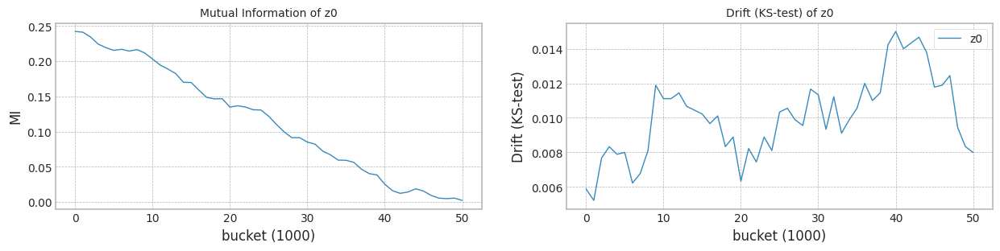

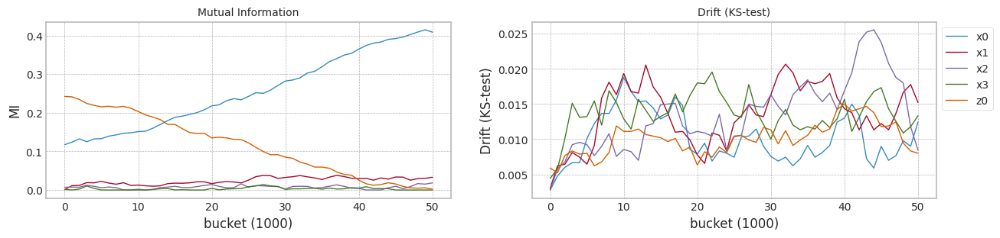

In [ ]:
columns=['x0','x1','x2','x3','z0']
X1 = pd.DataFrame(x1,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X1, y1,train_size, test_size)
#model,df = train_classificaion_model(X1,Y1,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.444809,0.549493,0.334264,0.490066,0
1,0.610533,0.615178,0.580336,0.386537,0.428404,0
2,0.556874,0.639435,0.724770,0.481368,0.025473,0
3,0.344341,0.459348,0.528780,0.367451,0.747377,0
4,0.503142,0.605841,0.465698,0.400521,0.420567,0
...,...,...,...,...,...,...
59995,0.480638,0.384668,0.703331,0.287800,0.697453,59
59996,0.288861,0.418546,0.215280,0.307386,0.782058,59
59997,0.662003,0.594007,0.488092,0.450741,0.571961,59
59998,0.655881,0.383029,0.773189,0.490745,0.517104,59


trial_count: 1
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:27:03,711] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:04<00:01, 358.47it/s]

Early stop: 1611
[2023-11-29 01:27:08,214] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.51it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:27:17,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:27:17,555] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:04<00:13, 114.26it/s]

[2023-11-29 01:27:34,167] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:27:34,168] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]


mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.53it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:27:48,391] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:27:48,394] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:28:04,509] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:28:04,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:21<01:25,  3.57s/it]

G-CDTL train flops: 3419500000 897750000 223155000 4540405000


100%|██████████| 51/51 [00:25<00:00,  2.01it/s]


Early stop at  [512]
Train flops  [4540405000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9557518410475129
G_CDTL+AUE median: 0.9557518410475129
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.03it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.90it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9195677382231323
SEA median: 0.9195677382231323
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:20,  1.16it/s]

Ensemble_SEA train flops: 756030000


100%|██████████| 51/51 [00:12<00:00,  4.08it/s]


Early stop at  [1737]
Train flops  [756030000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9386898622496477
AUE median: 0.9386898622496477
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.54it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:11<00:39,  1.65s/it]

Ensemble_DTEL train flops: 728190000


100%|██████████| 51/51 [00:16<00:00,  3.14it/s]


Early stop at  [1999, 1673]
Train flops  [870000000, 728190000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9436617175298717
DTEL median: 0.9436617175298717


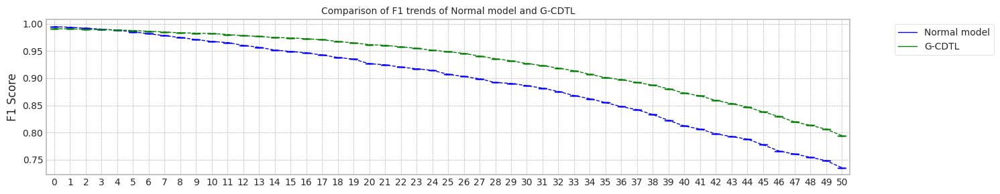

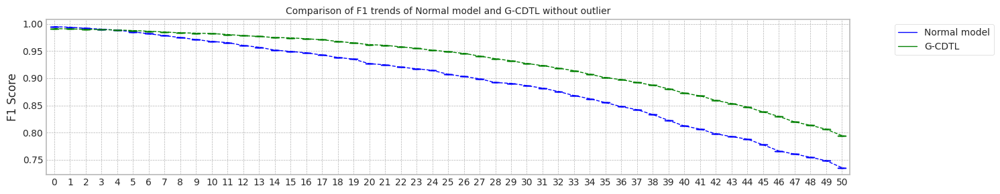

max_mean_trial= 0


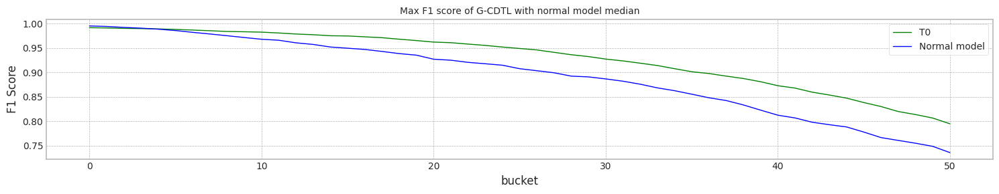

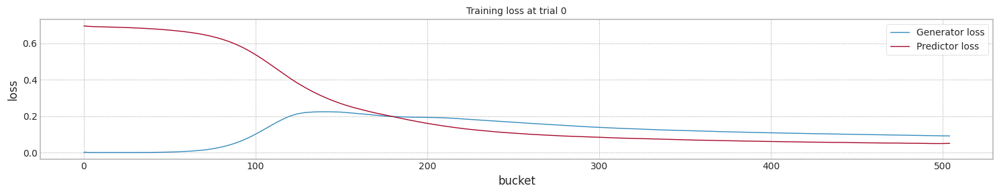

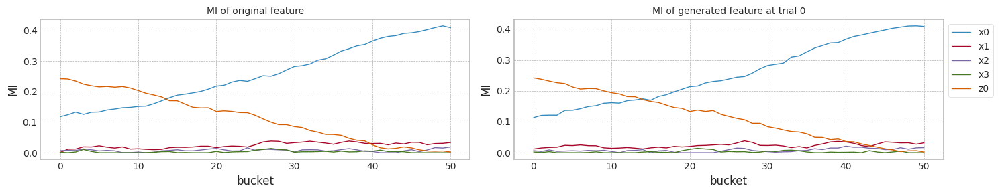

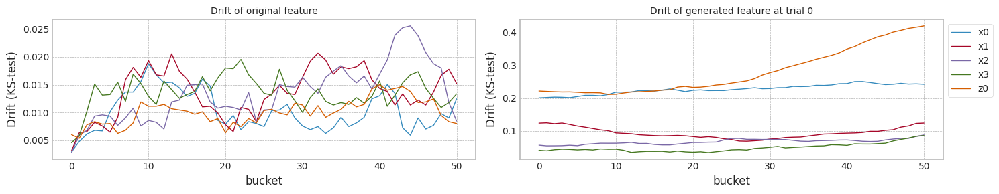

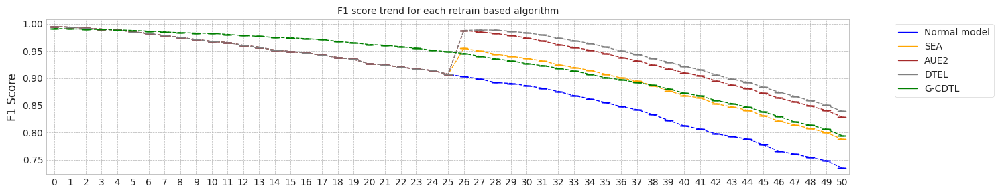

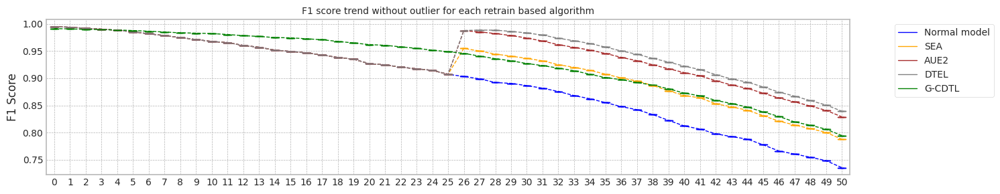

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.324888467788696
Base flops (inference flops of normal model, median): 199665000.0


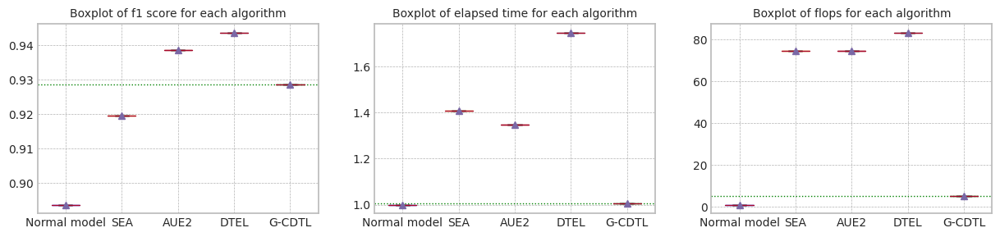

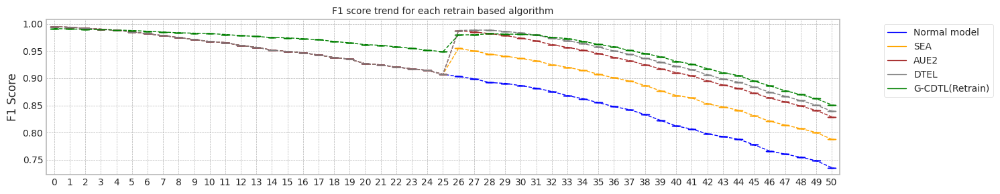

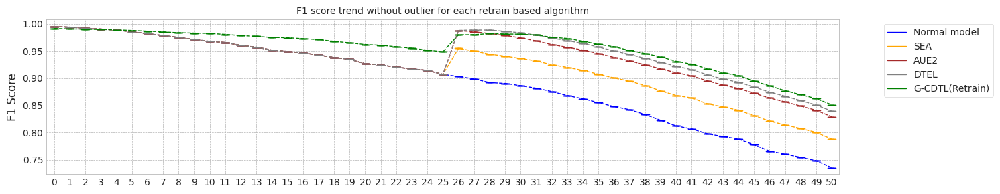

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.324888467788696
Base flops (train + inference flops of normal model, median): 6510645000.0


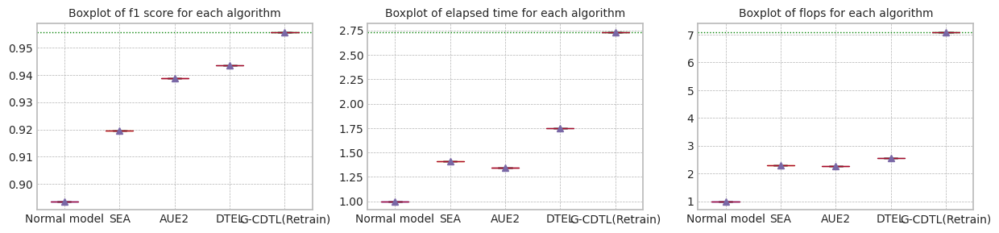

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.324888467788696


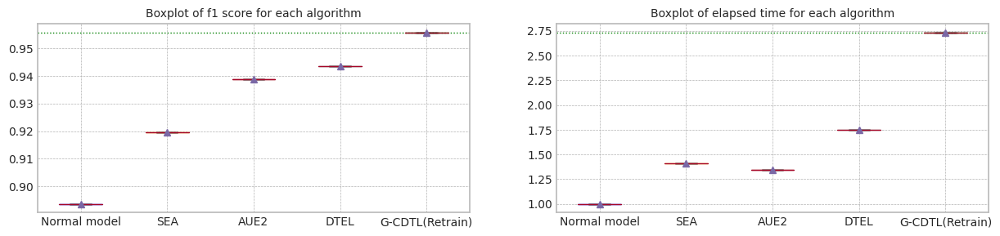

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.324888,6.310980e+09,199665000.0,6.510645e+09
1,median,0.994875,0.993892,0.893682,0.735588,9.324888,6.310980e+09,199665000.0,6.510645e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.393821,4.143082e+10,1.002915e+09,4.243374e+10
1,median,0.991374,0.990734,0.928653,0.794588,9.393821,4.143082e+10,1.002915e+09,4.243374e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.919568,0.787799,13.131788,7.180980e+09,7.682100e+09,1.486308e+10
1,median,0.994875,0.993892,0.919568,0.787799,13.131788,7.180980e+09,7.682100e+09,1.486308e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.93869,0.829094,12.559887,7.067010e+09,7.767795e+09,1.483480e+10
1,median,0.994875,0.993892,0.93869,0.829094,12.559887,7.067010e+09,7.767795e+09,1.483480e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.943662,0.839481,16.297592,7.909170e+09,8.711745e+09,1.662092e+10
1,median,0.994875,0.993892,0.943662,0.839481,16.297592,7.909170e+09,8.711745e+09,1.662092e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.955752,0.8512,25.499095,4.597123e+10,223875000.0,4.619510e+10
1,median,0.991374,0.990734,0.955752,0.8512,25.499095,4.597123e+10,223875000.0,4.619510e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case2',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.8,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:31:58,551] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:04<00:01, 352.54it/s]

Early stop: 1611
[2023-11-29 01:32:03,127] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.57it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:32:12,373] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:32:12,375] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:04<00:13, 112.32it/s]

[2023-11-29 01:32:29,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:32:29,259] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:32:38,694] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 349.67it/s]

Early stop: 1134
[2023-11-29 01:32:41,942] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.54it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:32:51,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:32:51,225] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:05<00:12, 110.71it/s]

[2023-11-29 01:33:09,574] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:33:09,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:33:19,202] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 340.88it/s]

Early stop: 1488
[2023-11-29 01:33:23,574] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:33:33,164] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:33:33,166] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:04<00:13, 111.50it/s]

[2023-11-29 01:33:38,236] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-11-29 01:33:38,238] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.52it/s]

mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:33:47,556] [INFO] [profiler.py:80:start_profile] Flops profiler started



 95%|█████████▍| 1896/2000 [00:05<00:00, 352.59it/s]

Early stop: 1896
[2023-11-29 01:33:52,939] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.52it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:34:02,270] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:34:02,272] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:04<00:13, 108.67it/s]

[2023-11-29 01:34:19,509] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:34:19,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.50it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:34:28,892] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:04<00:00, 346.86it/s]

Early stop: 1689
[2023-11-29 01:34:33,767] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.57it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:34:43,030] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:34:43,032] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:03<00:14, 110.84it/s]

[2023-11-29 01:34:51,613] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:34:51,614] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:35:05,848] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:35:05,851] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:35:12,163] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:35:12,164] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:11<00:36,  1.51s/it]

G-CDTL train flops: 75250000 1205750000 299715000 1580715000


100%|██████████| 51/51 [00:15<00:00,  3.27it/s]


Early stop at  [688]
Train flops  [1580715000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9529454211563336
G_CDTL+AUE median: 0.9529454211563336
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:22,  1.08it/s]

Ensemble_SEA train flops: 797355000


100%|██████████| 51/51 [00:12<00:00,  3.94it/s]


Early stop at  [1832]
Train flops  [797355000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9155969460515575
SEA median: 0.9155969460515575
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:20,  1.18it/s]

Ensemble_SEA train flops: 722100000


100%|██████████| 51/51 [00:12<00:00,  4.11it/s]


Early stop at  [1659]
Train flops  [722100000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9378824393097898
AUE median: 0.9378824393097898
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.65it/s]

Ensemble_DTEL train flops: 816060000


 53%|█████▎    | 27/51 [00:11<00:38,  1.59s/it]

Ensemble_DTEL train flops: 728190000


100%|██████████| 51/51 [00:15<00:00,  3.21it/s]


Early stop at  [1875, 1673]
Train flops  [816060000, 728190000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9436617175298717
DTEL median: 0.9436617175298717
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:36:03,094] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:36:03,096] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:36:19,946] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:36:19,947] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:21<01:29,  3.73s/it]

G-CDTL train flops: 3500000000 876750000 217935000 4594685000


100%|██████████| 51/51 [00:26<00:00,  1.94it/s]


Early stop at  [500]
Train flops  [4594685000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9507530745409194
G_CDTL+AUE median: 0.9518492478486265
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:22,  1.06it/s]

Ensemble_SEA train flops: 798225000


100%|██████████| 51/51 [00:12<00:00,  3.95it/s]


Early stop at  [1834]
Train flops  [798225000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9192476602823338
SEA median: 0.9174223031669457
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:18,  1.32it/s]

Ensemble_SEA train flops: 616395000


100%|██████████| 51/51 [00:11<00:00,  4.25it/s]


Early stop at  [1416]
Train flops  [616395000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.93748927883238
AUE median: 0.9376858590710848
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.60it/s]

Ensemble_DTEL train flops: 649890000


 53%|█████▎    | 27/51 [00:11<00:38,  1.60s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:15<00:00,  3.21it/s]


Early stop at  [1493, 1999]
Train flops  [649890000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9435331409761736
DTEL median: 0.9435974292530227
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:37:10,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:37:10,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:37:14,610] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:37:14,611] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:09<00:26,  1.08s/it]

G-CDTL train flops: 56000000 805000000 200100000 1061100000


100%|██████████| 51/51 [00:13<00:00,  3.74it/s]


Early stop at  [459]
Train flops  [1061100000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9528377346941299
G_CDTL+AUE median: 0.9528377346941299
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.02it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.91it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9176879871863158
SEA median: 0.9176879871863158
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.01it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.91it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9387208639947016
AUE median: 0.9378824393097898
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.62it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:42,  1.77s/it]

Ensemble_DTEL train flops: 843030000


100%|██████████| 51/51 [00:16<00:00,  3.05it/s]


Early stop at  [1999, 1937]
Train flops  [870000000, 843030000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9435642459084468
DTEL median: 0.9435642459084468
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:38:07,151] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:38:07,153] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:38:25,124] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:38:25,125] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:23<01:35,  3.96s/it]

G-CDTL train flops: 3500000000 1090250000 271005000 4861255000


100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


Early stop at  [622]
Train flops  [4861255000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9533125430596264
G_CDTL+AUE median: 0.9528915779252318
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:22,  1.07it/s]

Ensemble_SEA train flops: 807795000


100%|██████████| 51/51 [00:12<00:00,  3.93it/s]


Early stop at  [1856]
Train flops  [807795000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9153299854224366
SEA median: 0.9166424666189367
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.02it/s]

Ensemble_SEA train flops: 864345000


100%|██████████| 51/51 [00:13<00:00,  3.92it/s]


Early stop at  [1986]
Train flops  [864345000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9396941625699425
AUE median: 0.9383016516522457
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.55it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:42,  1.79s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:16<00:00,  3.02it/s]


Early stop at  [1999, 1999]
Train flops  [870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9437361899472091
DTEL median: 0.9436129817191592
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.53it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:39:17,692] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:39:17,695] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:39:35,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:39:35,546] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:22<01:34,  3.93s/it]

G-CDTL train flops: 3500000000 1067500000 265350000 4832850000


100%|██████████| 51/51 [00:27<00:00,  1.87it/s]


Early stop at  [609]
Train flops  [4832850000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.946975830754785
G_CDTL+AUE median: 0.9528377346941299
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.01it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:12<00:00,  3.92it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.907541056936379
SEA median: 0.9155969460515575
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:08<00:33,  1.33s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.89it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9399847930176555
AUE median: 0.9387208639947016
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.61it/s]

Ensemble_DTEL train flops: 770820000


 53%|█████▎    | 27/51 [00:09<00:29,  1.21s/it]

Ensemble_DTEL train flops: 332775000


100%|██████████| 51/51 [00:14<00:00,  3.63it/s]


Early stop at  [1771, 764]
Train flops  [770820000, 332775000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9428289909143764
DTEL median: 0.9435642459084468


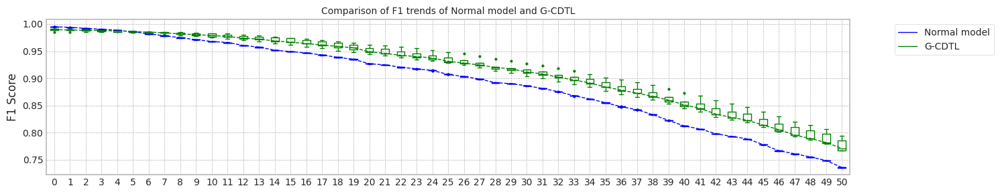

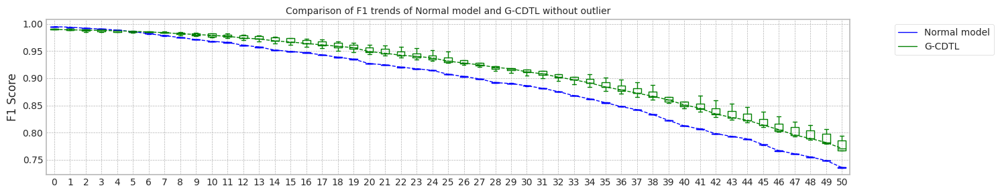

max_mean_trial= 0


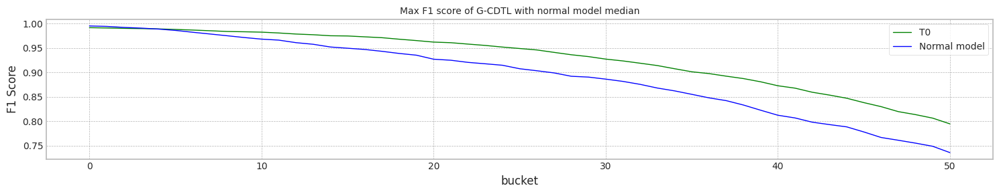

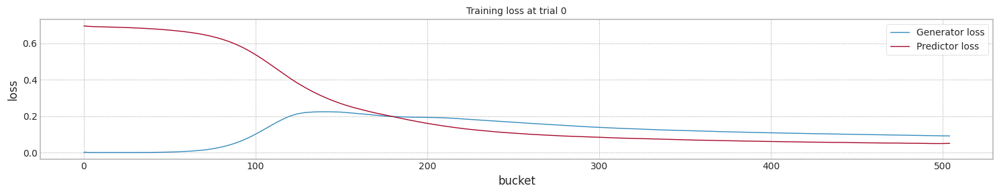

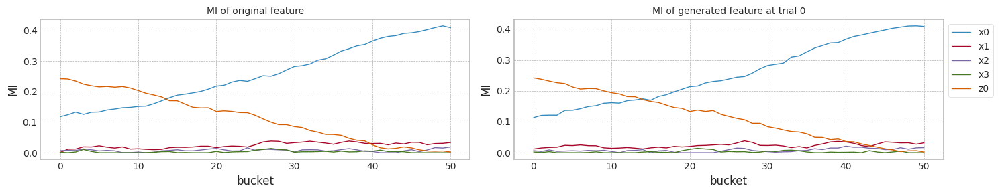

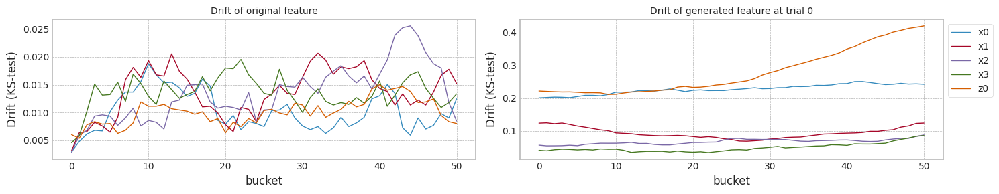

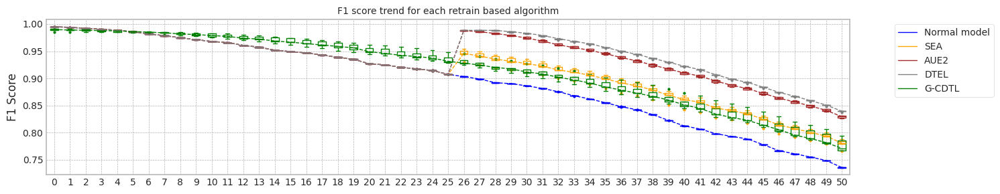

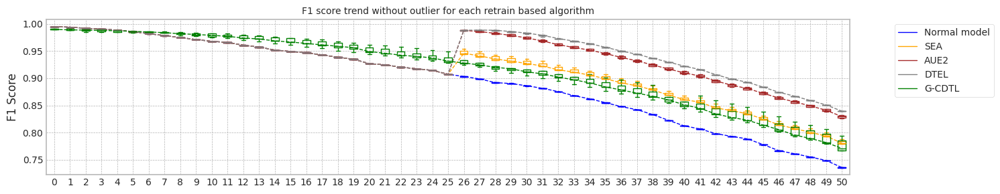

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.265263557434082
Base flops (inference flops of normal model, median): 199665000.0


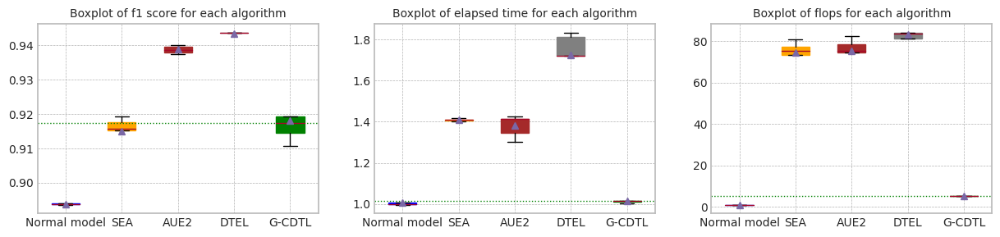

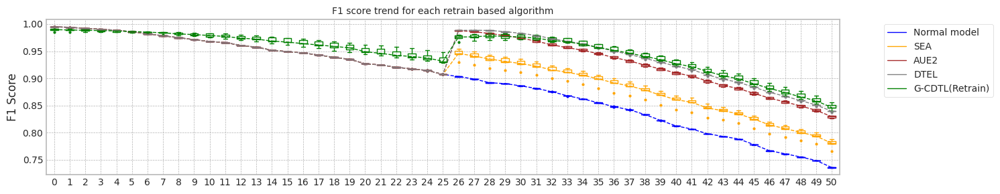

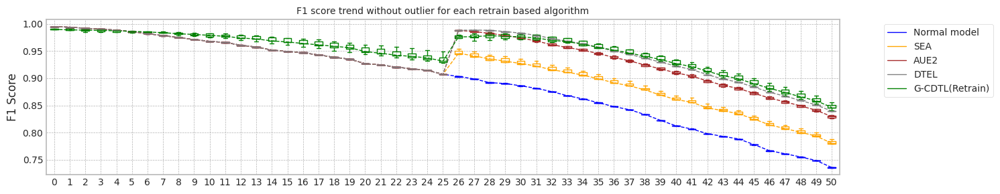

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.265263557434082
Base flops (train + inference flops of normal model, median): 6510645000.0


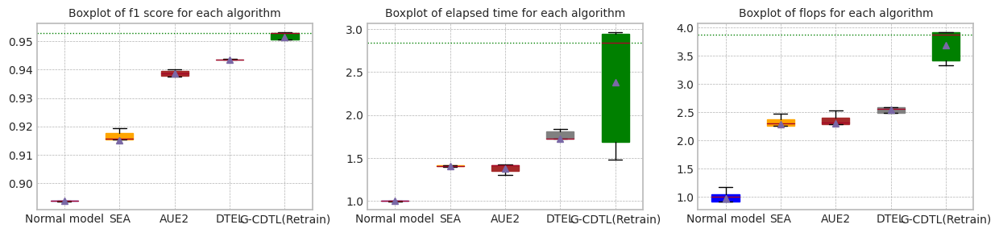

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.265263557434082


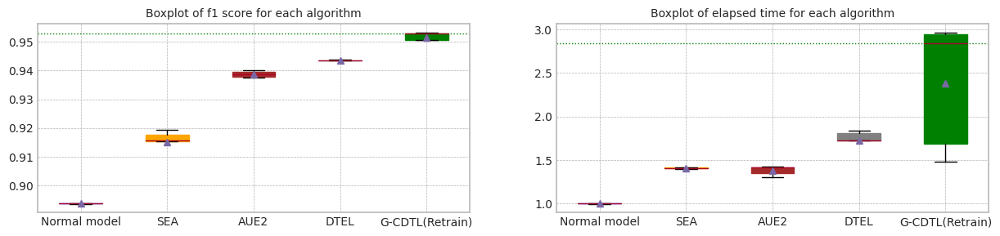

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.228912,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.265264,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.574411,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.313896,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.246232,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.265264,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.142594,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.415196,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.608717,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.297532,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.363218,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.407789,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.407789,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.116187,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.915597,0.780609,13.005244,7.413705e+09,7.609455e+09,1.502316e+10
1,1.0,0.994876,0.993988,0.919248,0.787462,12.978076,7.414575e+09,5.742870e+09,1.315744e+10
2,2.0,0.994390,0.993786,0.917688,0.784412,13.137340,7.486350e+09,7.200555e+09,1.468690e+10
3,3.0,0.994775,0.993983,0.915330,0.779562,13.051400,7.424145e+09,8.735670e+09,1.615982e+10
4,4.0,0.995157,0.994175,0.907541,0.765717,13.075014,7.486350e+09,7.987470e+09,1.547382e+10
5,median,0.994875,0.993983,0.915597,0.780609,13.051400,7.424145e+09,7.609455e+09,1.502316e+10
6,std,0.000277,0.000144,0.004509,0.008347,0.062110,3.794611e+07,1.111713e+09,1.119540e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.937882,0.827364,12.482522,7.338450e+09,7.733865e+09,1.507232e+10
1,1.0,0.994876,0.993988,0.937489,0.826658,12.072017,7.232745e+09,5.760705e+09,1.299345e+10
2,2.0,0.994390,0.993786,0.938721,0.829469,13.106550,7.486350e+09,7.400220e+09,1.488657e+10
3,3.0,0.994775,0.993983,0.939694,0.831383,13.087676,7.480695e+09,8.991885e+09,1.647258e+10
4,4.0,0.995157,0.994175,0.939985,0.831659,13.200209,7.486350e+09,8.187135e+09,1.567348e+10
5,median,0.994875,0.993983,0.938721,0.829469,13.087676,7.480695e+09,7.733865e+09,1.507232e+10
6,std,0.000277,0.000144,0.001091,0.002273,0.491713,1.151803e+08,1.196016e+09,1.290782e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.943662,0.839481,15.951604,8.160600e+09,8.657805e+09,1.681840e+10
1,1.0,0.994876,0.993988,0.943533,0.839633,15.961210,8.136240e+09,6.765990e+09,1.490223e+10
2,2.0,0.994390,0.993786,0.943564,0.839597,16.794113,8.329380e+09,8.345040e+09,1.667442e+10
3,3.0,0.994775,0.993983,0.943736,0.839503,16.991682,8.356350e+09,9.969330e+09,1.832568e+10
4,4.0,0.995157,0.994175,0.942829,0.837194,14.132931,7.719945e+09,8.522520e+09,1.624246e+10
5,median,0.994875,0.993983,0.943564,0.839503,15.961210,8.160600e+09,8.522520e+09,1.667442e+10
6,std,0.000277,0.000144,0.000364,0.001057,1.128956,2.547330e+08,1.140580e+09,1.228942e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.952945,0.845876,15.670562,2.202669e+10,223875000.0,2.225056e+10
1,1.0,0.985570,0.985016,0.950753,0.846385,26.309533,2.504066e+10,223875000.0,2.526454e+10
2,2.0,0.991229,0.990418,0.952838,0.850998,13.705664,2.150708e+10,223875000.0,2.173095e+10
3,3.0,0.989726,0.989077,0.953313,0.855785,27.481925,2.530723e+10,223875000.0,2.553110e+10
4,4.0,0.989262,0.988322,0.946976,0.840309,27.317634,2.527882e+10,223875000.0,2.550270e+10
5,median,0.989726,0.989077,0.952838,0.846385,26.309533,2.504066e+10,223875000.0,2.526454e+10
6,std,0.002347,0.002288,0.002650,0.005826,6.813801,1.897030e+09,0.0,1.897030e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:40:35,609] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:04<00:01, 345.54it/s]

Early stop: 1611
[2023-11-29 01:40:40,279] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:40:49,692] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:40:49,694] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:04<00:14, 106.38it/s]

[2023-11-29 01:41:07,062] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:41:07,064] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:41:16,578] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 346.49it/s]

Early stop: 1134
[2023-11-29 01:41:19,857] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.52it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:41:29,172] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:41:29,174] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:05<00:12, 108.92it/s]

[2023-11-29 01:41:47,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:41:47,759] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:41:57,220] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 342.39it/s]

Early stop: 1488
[2023-11-29 01:42:01,570] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:42:10,985] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:42:10,988] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:05<00:13, 106.12it/s]

[2023-11-29 01:42:16,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:42:16,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:42:25,789] [INFO] [profiler.py:80:start_profile] Flops profiler started



 95%|█████████▍| 1896/2000 [00:05<00:00, 338.63it/s]

Early stop: 1896
[2023-11-29 01:42:31,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.49it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:42:40,784] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:42:40,786] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:04<00:13, 107.16it/s]

[2023-11-29 01:42:58,216] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:42:58,217] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.45it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:43:07,665] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:05<00:00, 337.28it/s]

Early stop: 1689
[2023-11-29 01:43:12,680] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.53it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:43:21,983] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:43:21,985] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:03<00:15, 105.68it/s]

[2023-11-29 01:43:30,956] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:43:30,957] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:43:43,844] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:43:43,846] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:44:01,094] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:44:01,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:20<02:01,  3.81s/it]

G-CDTL train flops: 3500000000 897750000 223155000 4620905000


 69%|██████▊   | 35/51 [00:23<00:03,  5.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:44:04,430] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:44:04,432] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:44:23,030] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:44:23,031] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:42<00:57,  4.10s/it]

G-CDTL train flops: 3500000000 1142750000 284055000 4926805000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [512, 652]
Train flops  [4620905000, 4926805000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9701061662358711
G_CDTL+AUE median: 0.9701061662358711
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:26,  1.22it/s]

Ensemble_SEA train flops: 644235000


 73%|███████▎  | 37/51 [00:12<00:12,  1.16it/s]

Ensemble_SEA train flops: 713400000


100%|██████████| 51/51 [00:15<00:00,  3.28it/s]


Early stop at  [1480, 1639]
Train flops  [644235000, 713400000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9260897106467754
SEA median: 0.9260897106467754
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:28,  1.12it/s]

Ensemble_SEA train flops: 743850000


 73%|███████▎  | 37/51 [00:12<00:09,  1.53it/s]

Ensemble_SEA train flops: 488940000


100%|██████████| 51/51 [00:14<00:00,  3.41it/s]


Early stop at  [1709, 1123]
Train flops  [743850000, 488940000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9482498052398476
AUE median: 0.9482498052398476
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.54it/s]

Ensemble_DTEL train flops: 554625000


 37%|███▋      | 19/51 [00:09<00:43,  1.37s/it]

Ensemble_DTEL train flops: 689040000


 69%|██████▊   | 35/51 [00:12<00:03,  5.02it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:20<00:25,  1.85s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.23it/s]


Early stop at  [1274, 1583, 1999, 1999]
Train flops  [554625000, 689040000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9645810360526201
DTEL median: 0.9645810360526201
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:45:22,754] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:45:22,756] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:45:27,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:45:27,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:08<00:37,  1.19s/it]

G-CDTL train flops: 57750000 883750000 219675000 1161175000


 69%|██████▊   | 35/51 [00:11<00:02,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:45:30,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:45:30,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:45:48,735] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:45:48,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:29<00:55,  3.95s/it]

G-CDTL train flops: 3500000000 974750000 242295000 4717045000


100%|██████████| 51/51 [00:32<00:00,  1.59it/s]


Early stop at  [504, 556]
Train flops  [1161175000, 4717045000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9692405238806545
G_CDTL+AUE median: 0.9696733450582629
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:06<00:35,  1.08s/it]

Ensemble_SEA train flops: 657720000


 73%|███████▎  | 37/51 [00:13<00:12,  1.10it/s]

Ensemble_SEA train flops: 750375000


100%|██████████| 51/51 [00:15<00:00,  3.24it/s]


Early stop at  [1511, 1724]
Train flops  [657720000, 750375000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9262854651670008
SEA median: 0.9261875879068882
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:07<00:32,  1.02s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:14<00:13,  1.04it/s]

Ensemble_SEA train flops: 813450000


100%|██████████| 51/51 [00:16<00:00,  3.01it/s]


Early stop at  [1999, 1869]
Train flops  [870000000, 813450000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9488254223287457
AUE median: 0.9485376137842967
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.59it/s]

Ensemble_DTEL train flops: 668595000


 37%|███▋      | 19/51 [00:09<00:49,  1.54s/it]

Ensemble_DTEL train flops: 749070000


 69%|██████▊   | 35/51 [00:12<00:02,  5.42it/s]

Ensemble_DTEL train flops: 608130000


 73%|███████▎  | 37/51 [00:19<00:22,  1.61s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.27it/s]


Early stop at  [1536, 1721, 1397, 1999]
Train flops  [668595000, 749070000, 608130000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9647132417932976
DTEL median: 0.964647138922959
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:46:50,304] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:46:50,307] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:47:08,107] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:47:08,108] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:21<03:02,  5.54s/it]

G-CDTL train flops: 3500000000 904750000 224895000 4629645000


 69%|██████▊   | 35/51 [00:24<00:03,  4.96it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:47:11,563] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:47:11,565] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:47:30,403] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:47:30,405] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:43<00:58,  4.15s/it]

G-CDTL train flops: 3500000000 1109500000 275790000 4885290000


100%|██████████| 51/51 [00:46<00:00,  1.10it/s]


Early stop at  [516, 633]
Train flops  [4629645000, 4885290000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9684988912320437
G_CDTL+AUE median: 0.9692405238806545
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:06<00:37,  1.15s/it]

Ensemble_SEA train flops: 691650000


 73%|███████▎  | 37/51 [00:12<00:10,  1.34it/s]

Ensemble_SEA train flops: 536790000


100%|██████████| 51/51 [00:15<00:00,  3.30it/s]


Early stop at  [1589, 1233]
Train flops  [691650000, 536790000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9266960900374223
SEA median: 0.9262854651670008
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:22,  1.42it/s]

Ensemble_SEA train flops: 530265000


 73%|███████▎  | 37/51 [00:09<00:02,  5.04it/s]

Ensemble_SEA train flops: 13920000


100%|██████████| 51/51 [00:11<00:00,  4.26it/s]


Early stop at  [1218, 31]
Train flops  [530265000, 13920000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9318083675871333
AUE median: 0.9482498052398476
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.30it/s]

Ensemble_DTEL train flops: 552015000


 37%|███▋      | 19/51 [00:09<00:48,  1.51s/it]

Ensemble_DTEL train flops: 811275000


 71%|███████   | 36/51 [00:17<00:21,  1.42s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 3915000


100%|██████████| 51/51 [00:19<00:00,  2.57it/s]


Early stop at  [1268, 1864, 1999, 8]
Train flops  [552015000, 811275000, 870000000, 3915000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.940493393169615
DTEL median: 0.9645810360526201
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:48:24,112] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:48:24,115] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:48:41,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:48:41,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:21<02:05,  3.92s/it]

G-CDTL train flops: 3500000000 880250000 218805000 4599055000


 69%|██████▊   | 35/51 [00:24<00:03,  4.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:48:45,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:48:45,287] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:49:02,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:49:02,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:42<01:22,  5.49s/it]

G-CDTL train flops: 3500000000 857500000 213150000 4570650000


100%|██████████| 51/51 [00:44<00:00,  1.13it/s]


Early stop at  [502, 489]
Train flops  [4599055000, 4570650000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9701880006782331
G_CDTL+AUE median: 0.9696733450582629
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:24,  1.30it/s]

Ensemble_SEA train flops: 588990000


 73%|███████▎  | 37/51 [00:13<00:14,  1.00s/it]

Ensemble_SEA train flops: 849555000


100%|██████████| 51/51 [00:16<00:00,  3.18it/s]


Early stop at  [1353, 1952]
Train flops  [588990000, 849555000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9233104612245646
SEA median: 0.9261875879068882
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:28,  1.10it/s]

Ensemble_SEA train flops: 744720000


 73%|███████▎  | 37/51 [00:13<00:13,  1.03it/s]

Ensemble_SEA train flops: 816930000


100%|██████████| 51/51 [00:16<00:00,  3.08it/s]


Early stop at  [1711, 1877]
Train flops  [744720000, 816930000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9501573658664588
AUE median: 0.9485376137842967
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.37it/s]

Ensemble_DTEL train flops: 771255000


 37%|███▋      | 19/51 [00:11<00:56,  1.77s/it]

Ensemble_DTEL train flops: 870000000


 69%|██████▊   | 35/51 [00:13<00:02,  5.34it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:22<00:26,  1.87s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:24<00:00,  2.05it/s]


Early stop at  [1772, 1999, 1999, 1999]
Train flops  [771255000, 870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9648971388423976
DTEL median: 0.964647138922959
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:50:06,800] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:50:06,803] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:50:11,524] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:50:11,525] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:08<00:37,  1.18s/it]

G-CDTL train flops: 63000000 850500000 211410000 1124910000


 69%|██████▊   | 35/51 [00:11<00:02,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:50:14,863] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:50:14,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:50:36,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:50:36,598] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:33<01:06,  4.75s/it]

G-CDTL train flops: 3500000000 1604750000 398895000 5503645000


100%|██████████| 51/51 [00:36<00:00,  1.42it/s]


Early stop at  [485, 916]
Train flops  [1124910000, 5503645000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9646750725416474
G_CDTL+AUE median: 0.9692405238806545
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:07<00:34,  1.08s/it]

Ensemble_SEA train flops: 843900000


 73%|███████▎  | 37/51 [00:14<00:11,  1.22it/s]

Ensemble_SEA train flops: 612480000


100%|██████████| 51/51 [00:16<00:00,  3.01it/s]


Early stop at  [1939, 1407]
Train flops  [843900000, 612480000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9263985337840585
SEA median: 0.9262854651670008
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:07<00:35,  1.10s/it]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:14<00:18,  1.22s/it]

Ensemble_SEA train flops: 706440000


100%|██████████| 51/51 [00:17<00:00,  2.90it/s]


Early stop at  [1999, 1623]
Train flops  [870000000, 706440000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9526663405935656
AUE median: 0.9488254223287457
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.36it/s]

Ensemble_DTEL train flops: 725145000


 37%|███▋      | 19/51 [00:09<00:47,  1.49s/it]

Ensemble_DTEL train flops: 591600000


 69%|██████▊   | 35/51 [00:12<00:02,  5.39it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:20<00:25,  1.83s/it]

Ensemble_DTEL train flops: 793875000


100%|██████████| 51/51 [00:23<00:00,  2.17it/s]


Early stop at  [1666, 1359, 1999, 1824]
Train flops  [725145000, 591600000, 870000000, 793875000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9646476472973271
DTEL median: 0.9646476472973271


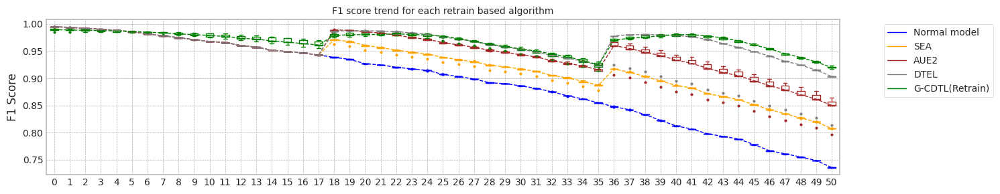

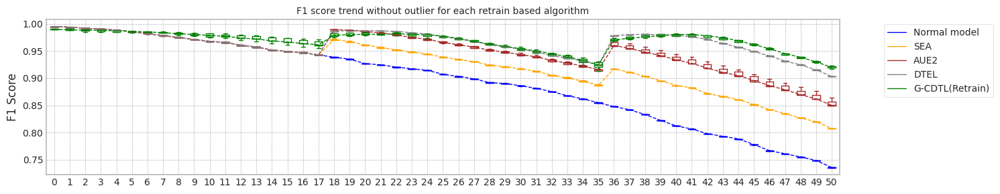

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.370770931243896
Base flops (train + inference flops of normal model, median): 6510645000.0


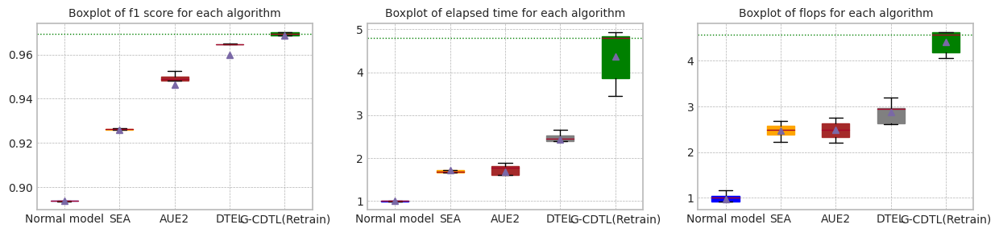

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.370770931243896


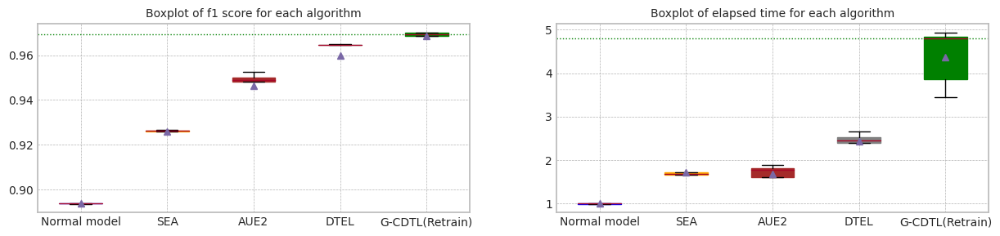

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.393665,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.300170,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.393894,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.370771,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.286111,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.370771,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.052019,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.495376,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.442288,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.454995,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.428190,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.489084,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.454995,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.029276,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.926090,0.807591,15.616642,7.973985e+09,8.259780e+09,1.623376e+10
1,1.0,0.994876,0.993988,0.926285,0.807802,15.809207,8.024445e+09,6.442785e+09,1.446723e+10
2,2.0,0.994390,0.993786,0.926696,0.807587,15.503044,7.844790e+09,7.649040e+09,1.549383e+10
3,3.0,0.994775,0.993983,0.923310,0.807360,16.109899,8.054895e+09,9.456465e+09,1.751136e+10
4,4.0,0.995157,0.994175,0.926399,0.807541,17.017141,8.072730e+09,8.663895e+09,1.673662e+10
5,median,0.994875,0.993983,0.926285,0.807587,15.809207,8.024445e+09,8.259780e+09,1.623376e+10
6,std,0.000277,0.000144,0.001385,0.000158,0.607527,9.151174e+07,1.132814e+09,1.167031e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.948250,0.849994,15.038430,7.849140e+09,8.334600e+09,1.618374e+10
1,1.0,0.994876,0.993988,0.948825,0.850309,17.027149,8.299800e+09,6.917805e+09,1.521760e+10
2,2.0,0.994390,0.993786,0.931808,0.796288,12.031976,7.160535e+09,7.164450e+09,1.432498e+10
3,3.0,0.994775,0.993983,0.950157,0.857336,16.624083,8.178000e+09,9.779235e+09,1.795724e+10
4,4.0,0.995157,0.994175,0.952666,0.864189,17.657179,8.192790e+09,8.983620e+09,1.717641e+10
5,median,0.994875,0.993983,0.948825,0.850309,16.624083,8.178000e+09,8.334600e+09,1.618374e+10
6,std,0.000277,0.000144,0.008300,0.027097,2.254714,4.652274e+08,1.207900e+09,1.459313e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.964581,0.903054,22.942024,9.600015e+09,9.542595e+09,1.914261e+10
1,1.0,0.994876,0.993988,0.964713,0.903980,22.495363,9.512145e+09,7.473300e+09,1.698544e+10
2,2.0,0.994390,0.993786,0.940493,0.813964,19.932835,8.853555e+09,8.317200e+09,1.717076e+10
3,3.0,0.994775,0.993983,0.964897,0.903666,24.909518,9.997605e+09,1.083933e+10,2.083694e+10
4,4.0,0.995157,0.994175,0.964648,0.903457,23.614105,9.596970e+09,9.674400e+09,1.927137e+10
5,median,0.994875,0.993983,0.964648,0.903457,22.942024,9.596970e+09,9.542595e+09,1.914261e+10
6,std,0.000277,0.000144,0.010831,0.040061,1.833316,4.136208e+08,1.302494e+09,1.609769e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.970106,0.919893,45.321127,2.999368e+10,134325000.0,3.012801e+10
1,1.0,0.985570,0.985016,0.969241,0.919474,32.233340,2.632420e+10,134325000.0,2.645852e+10
2,2.0,0.991229,0.990418,0.968499,0.923364,46.267307,2.996091e+10,134325000.0,3.009524e+10
3,3.0,0.989726,0.989077,0.970188,0.921604,45.033123,2.961568e+10,134325000.0,2.975000e+10
4,4.0,0.989262,0.988322,0.964675,0.917031,36.088839,2.707453e+10,134325000.0,2.720886e+10
5,median,0.989726,0.989077,0.969241,0.919893,45.033123,2.961568e+10,134325000.0,2.975000e+10
6,std,0.002347,0.002288,0.002269,0.002378,6.396404,1.755861e+09,0.0,1.755861e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:51:43,309] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:05<00:01, 320.36it/s]

Early stop: 1611
[2023-11-29 01:51:48,344] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:51:57,923] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:51:57,925] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:05<00:15, 97.44it/s]

[2023-11-29 01:52:16,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:52:16,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:52:26,378] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 310.20it/s]

Early stop: 1134
[2023-11-29 01:52:30,040] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:52:39,799] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:52:39,801] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:06<00:14, 95.49it/s]

[2023-11-29 01:53:00,502] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:53:00,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.12it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:53:10,558] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 307.71it/s]

Early stop: 1488
[2023-11-29 01:53:15,400] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:53:25,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:53:25,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:05<00:14, 100.14it/s]

[2023-11-29 01:53:30,841] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:53:30,843] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]


mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:53:40,595] [INFO] [profiler.py:80:start_profile] Flops profiler started


 95%|█████████▍| 1896/2000 [00:06<00:00, 315.91it/s]

Early stop: 1896
[2023-11-29 01:53:46,602] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:53:56,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:53:56,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:05<00:15, 96.84it/s]

[2023-11-29 01:54:15,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:54:15,194] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.08it/s]


mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:54:25,332] [INFO] [profiler.py:80:start_profile] Flops profiler started


 84%|████████▍ | 1689/2000 [00:05<00:00, 316.88it/s]

Early stop: 1689
[2023-11-29 01:54:30,668] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:54:40,346] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:54:40,348] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:04<00:16, 99.00it/s]

[2023-11-29 01:54:50,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:54:50,027] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.24it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:55:02,374] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:55:02,377] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 01:55:20,672] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:55:20,673] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:20<02:30,  4.06s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


 49%|████▉     | 25/51 [00:23<00:06,  3.73it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:55:23,184] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:55:23,186] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:55:42,105] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:55:42,106] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:42<01:40,  4.20s/it]

G-CDTL train flops: 3500000000 868000000 215760000 4583760000


 75%|███████▍  | 38/51 [00:44<00:03,  3.70it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:55:44,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:55:44,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 01:56:02,883] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:56:02,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [01:03<00:44,  4.08s/it]

G-CDTL train flops: 3500000000 791000000 196620000 4487620000


100%|██████████| 51/51 [01:05<00:00,  1.28s/it]


Early stop at  [443, 495, 451]
Train flops  [4470140000, 4583760000, 4487620000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9738529350072703
G_CDTL+AUE median: 0.9738529350072703
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:28,  1.31it/s]

Ensemble_SEA train flops: 557235000


 53%|█████▎    | 27/51 [00:12<00:25,  1.08s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:18<00:10,  1.07it/s]

Ensemble_SEA train flops: 706875000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [1280, 1999, 1624]
Train flops  [557235000, 870000000, 706875000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9295861872506024
SEA median: 0.9295861872506024
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:39,  1.08s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:25,  1.06s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:20<00:11,  1.07s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.30it/s]


Early stop at  [1999, 1999, 1999]
Train flops  [870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9480544029007213
AUE median: 0.9480544029007213
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.27it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:07,  1.83s/it]

Ensemble_DTEL train flops: 709485000


 53%|█████▎    | 27/51 [00:17<00:26,  1.10s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


 75%|███████▍  | 38/51 [00:19<00:02,  4.84it/s]

Ensemble_DTEL train flops: 441090000


 78%|███████▊  | 40/51 [00:26<00:17,  1.55s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:28<00:00,  1.81it/s]


Early stop at  [1999, 1630, 1999, 3, 1013, 1999]
Train flops  [870000000, 709485000, 870000000, 1740000, 441090000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9626261295860568
DTEL median: 0.9626261295860568
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:57:18,510] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:57:18,512] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 01:57:39,051] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:57:39,053] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:23<04:03,  6.42s/it]

G-CDTL train flops: 3500000000 1062250000 264045000 4826295000


 49%|████▉     | 25/51 [00:25<00:07,  3.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:57:41,597] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:57:41,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:57:52,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:57:52,520] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:36<01:28,  3.53s/it]

G-CDTL train flops: 1384250000 908250000 225765000 2518265000


 75%|███████▍  | 38/51 [00:38<00:03,  4.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:57:55,047] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:57:55,051] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 01:58:13,620] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:58:13,622] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:57<00:45,  4.12s/it]

G-CDTL train flops: 3500000000 757750000 188355000 4446105000


100%|██████████| 51/51 [00:59<00:00,  1.18s/it]


Early stop at  [606, 518, 432]
Train flops  [4826295000, 2518265000, 4446105000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9734251747258318
G_CDTL+AUE median: 0.973639054866551
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:37,  1.02s/it]

Ensemble_SEA train flops: 774300000


 53%|█████▎    | 27/51 [00:13<00:26,  1.09s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:19<00:10,  1.06it/s]

Ensemble_SEA train flops: 709920000


100%|██████████| 51/51 [00:21<00:00,  2.38it/s]


Early stop at  [1779, 1999, 1631]
Train flops  [774300000, 870000000, 709920000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9313902373013396
SEA median: 0.930488212275971
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.10s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:19,  1.21it/s]

Ensemble_SEA train flops: 601170000


 78%|███████▊  | 40/51 [00:17<00:08,  1.26it/s]

Ensemble_SEA train flops: 584640000


100%|██████████| 51/51 [00:19<00:00,  2.56it/s]


Early stop at  [1999, 1381, 1343]
Train flops  [870000000, 601170000, 584640000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9474203908051193
AUE median: 0.9477373968529204
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.07it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:07,  1.82s/it]

Ensemble_DTEL train flops: 698610000


 49%|████▉     | 25/51 [00:12<00:05,  4.49it/s]

Ensemble_DTEL train flops: 635970000


 53%|█████▎    | 27/51 [00:20<00:42,  1.77s/it]

Ensemble_DTEL train flops: 870000000


 76%|███████▋  | 39/51 [00:26<00:16,  1.39s/it]

Ensemble_DTEL train flops: 784740000
Ensemble_DTEL train flops: 3480000


100%|██████████| 51/51 [00:28<00:00,  1.77it/s]


Early stop at  [1999, 1605, 1461, 1999, 1803, 7]
Train flops  [870000000, 698610000, 635970000, 870000000, 784740000, 3480000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9571642068430416
DTEL median: 0.9598951682145491
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:59:28,959] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:59:28,962] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 01:59:48,466] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:59:48,468] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:22<02:39,  4.32s/it]

G-CDTL train flops: 3500000000 943250000 234465000 4677715000


 49%|████▉     | 25/51 [00:24<00:07,  3.64it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:59:50,983] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:59:50,986] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:59:56,092] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:59:56,094] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:29<00:44,  1.78s/it]

G-CDTL train flops: 98000000 812000000 201840000 1111840000


 75%|███████▍  | 38/51 [00:32<00:02,  4.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:59:58,601] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:59:58,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 02:00:21,326] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:00:21,327] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:54<01:24,  7.03s/it]

G-CDTL train flops: 3500000000 1436750000 357135000 5293885000


100%|██████████| 51/51 [00:57<00:00,  1.12s/it]


Early stop at  [538, 463, 820]
Train flops  [4677715000, 1111840000, 5293885000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9741864951350027
G_CDTL+AUE median: 0.9738529350072703
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:07<00:41,  1.11s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:26,  1.11s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:18<00:08,  1.32it/s]

Ensemble_SEA train flops: 539835000


100%|██████████| 51/51 [00:21<00:00,  2.42it/s]


Early stop at  [1999, 1999, 1240]
Train flops  [870000000, 870000000, 539835000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9306335643034643
SEA median: 0.9306335643034643
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:07<00:41,  1.11s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:19,  1.26it/s]

Ensemble_SEA train flops: 580725000


 78%|███████▊  | 40/51 [00:18<00:10,  1.09it/s]

Ensemble_SEA train flops: 672945000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [1999, 1334, 1546]
Train flops  [870000000, 580725000, 672945000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9472992062582161
AUE median: 0.9474203908051193
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.37it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:06,  1.80s/it]

Ensemble_DTEL train flops: 664680000


 53%|█████▎    | 27/51 [00:16<00:26,  1.10s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 76%|███████▋  | 39/51 [00:22<00:12,  1.03s/it]

Ensemble_DTEL train flops: 544185000
Ensemble_DTEL train flops: 4350000


100%|██████████| 51/51 [00:24<00:00,  2.09it/s]


Early stop at  [1999, 1527, 1999, 4, 1250, 9]
Train flops  [870000000, 664680000, 870000000, 2175000, 544185000, 4350000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9331714002722035
DTEL median: 0.9571642068430416
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:01:32,281] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:01:32,283] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 02:01:51,478] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:01:51,480] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:21<02:37,  4.25s/it]

G-CDTL train flops: 3500000000 857500000 213150000 4570650000


 49%|████▉     | 25/51 [00:24<00:07,  3.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:01:54,024] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:01:54,027] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 02:02:13,961] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:02:13,963] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:44<01:46,  4.43s/it]

G-CDTL train flops: 3500000000 973000000 241860000 4714860000


 75%|███████▍  | 38/51 [00:46<00:03,  3.67it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:02:16,435] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:02:16,437] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 02:02:36,646] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:02:36,648] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [01:07<00:49,  4.47s/it]

G-CDTL train flops: 3500000000 1072750000 266655000 4839405000


100%|██████████| 51/51 [01:09<00:00,  1.35s/it]


Early stop at  [489, 555, 612]
Train flops  [4570650000, 4714860000, 4839405000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9748881034396292
G_CDTL+AUE median: 0.9740197150711365
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.10s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:24,  1.00s/it]

Ensemble_SEA train flops: 772995000


 78%|███████▊  | 40/51 [00:18<00:09,  1.15it/s]

Ensemble_SEA train flops: 651630000


100%|██████████| 51/51 [00:20<00:00,  2.44it/s]


Early stop at  [1999, 1776, 1497]
Train flops  [870000000, 772995000, 651630000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9305429976438995
SEA median: 0.9305882809736818
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.09s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:26,  1.10s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:20<00:12,  1.11s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.26it/s]


Early stop at  [1999, 1999, 1999]
Train flops  [870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9491027591608825
AUE median: 0.9477373968529204
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.13it/s]

Ensemble_DTEL train flops: 151380000


 27%|██▋       | 14/51 [00:07<00:46,  1.25s/it]

Ensemble_DTEL train flops: 838245000


 53%|█████▎    | 27/51 [00:13<00:22,  1.05it/s]

Ensemble_DTEL train flops: 748635000
Ensemble_DTEL train flops: 1740000


 75%|███████▍  | 38/51 [00:15<00:02,  5.01it/s]

Ensemble_DTEL train flops: 572895000


 78%|███████▊  | 40/51 [00:23<00:18,  1.68s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:25<00:00,  2.03it/s]


Early stop at  [347, 1926, 1720, 3, 1316, 1999]
Train flops  [151380000, 838245000, 748635000, 1740000, 572895000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9626487485664299
DTEL median: 0.9598951682145491
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:03:50,325] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:03:50,327] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 02:03:55,287] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:03:55,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:07<01:04,  1.70s/it]

G-CDTL train flops: 77000000 808500000 200970000 1086470000


 49%|████▉     | 25/51 [00:09<00:05,  4.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:03:57,791] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:03:57,793] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 02:04:16,564] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:04:16,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:28<01:39,  4.14s/it]

G-CDTL train flops: 3500000000 805000000 200100000 4505100000


 75%|███████▍  | 38/51 [00:30<00:03,  3.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:04:19,002] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:04:19,004] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 02:04:25,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:04:25,374] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:37<00:17,  1.56s/it]

G-CDTL train flops: 92750000 1022000000 254040000 1368790000


100%|██████████| 51/51 [00:39<00:00,  1.28it/s]


Early stop at  [461, 459, 583]
Train flops  [1086470000, 4505100000, 1368790000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9744388709190572
G_CDTL+AUE median: 0.9741864951350027
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.11s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:26,  1.09s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:19<00:09,  1.20it/s]

Ensemble_SEA train flops: 615090000


100%|██████████| 51/51 [00:21<00:00,  2.41it/s]


Early stop at  [1999, 1999, 1413]
Train flops  [870000000, 870000000, 615090000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9313102952650877
SEA median: 0.9306335643034643
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.10s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:24,  1.01s/it]

Ensemble_SEA train flops: 774735000


 78%|███████▊  | 40/51 [00:18<00:09,  1.22it/s]

Ensemble_SEA train flops: 595515000


100%|██████████| 51/51 [00:20<00:00,  2.46it/s]


Early stop at  [1999, 1780, 1368]
Train flops  [870000000, 774735000, 595515000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9474379574505031
AUE median: 0.9474379574505031
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.42it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:12,  1.96s/it]

Ensemble_DTEL train flops: 799530000


 49%|████▉     | 25/51 [00:12<00:05,  4.59it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:21<00:44,  1.87s/it]

Ensemble_DTEL train flops: 705570000


 75%|███████▍  | 38/51 [00:23<00:02,  4.53it/s]

Ensemble_DTEL train flops: 548100000


 78%|███████▊  | 40/51 [00:30<00:18,  1.66s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.56it/s]


Early stop at  [1999, 1837, 1999, 1621, 1259, 1999]
Train flops  [870000000, 799530000, 870000000, 705570000, 548100000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9735726825244619
DTEL median: 0.9626261295860568


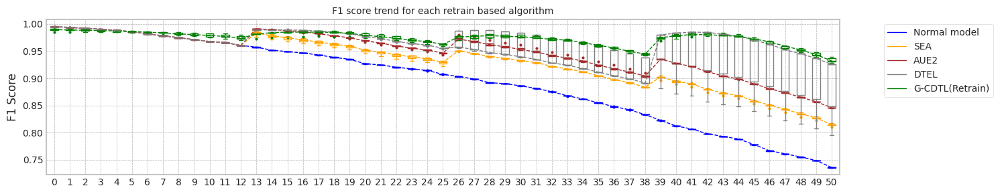

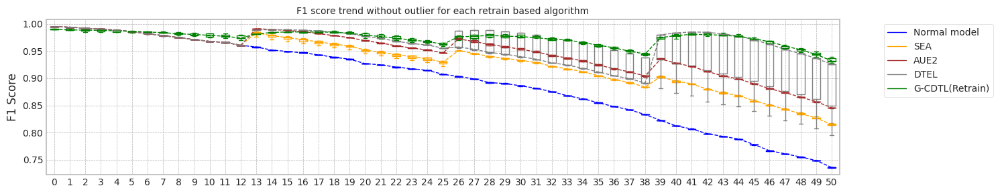

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.656697511672974
Base flops (train + inference flops of normal model, median): 6510645000.0


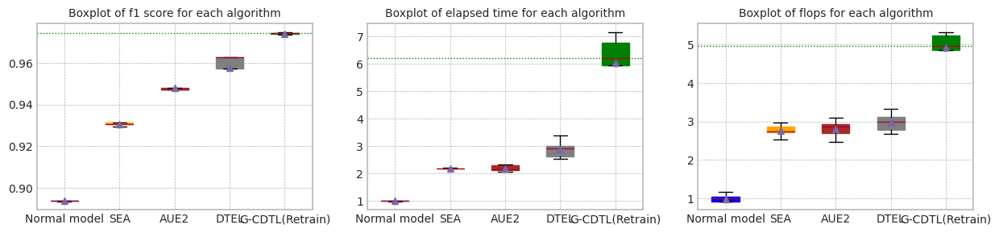

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.656697511672974


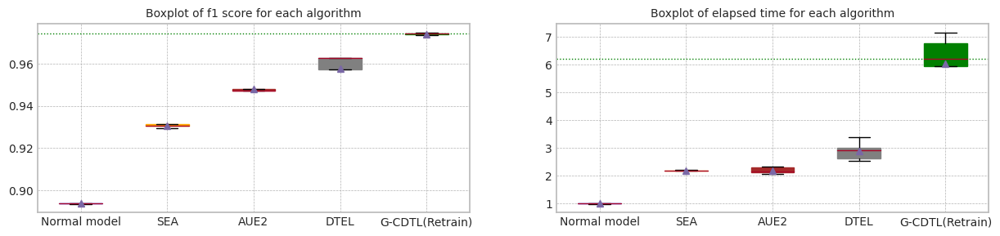

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.562472,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.739250,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.772475,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.602808,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.656698,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.656698,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.088738,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.777356,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,10.032608,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.727358,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,10.110564,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.808489,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.808489,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.169383,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.929586,0.817441,20.248605,8.750460e+09,9.141960e+09,1.789242e+10
1,1.0,0.994876,0.993988,0.931390,0.814130,21.470206,8.970570e+09,7.494615e+09,1.646518e+10
2,2.0,0.994390,0.993786,0.930634,0.809749,21.139359,8.896185e+09,8.806140e+09,1.770232e+10
3,3.0,0.994775,0.993983,0.930543,0.815656,21.011401,8.910975e+09,1.041825e+10,1.932922e+10
4,4.0,0.995157,0.994175,0.931310,0.814782,21.228620,8.971440e+09,9.668310e+09,1.863975e+10
5,median,0.994875,0.993983,0.930634,0.814782,21.139359,8.910975e+09,9.141960e+09,1.789242e+10
6,std,0.000277,0.000144,0.000728,0.002858,0.462487,9.025102e+07,1.086964e+09,1.076080e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.948054,0.845430,22.263714,9.226350e+09,9.817515e+09,1.904386e+10
1,1.0,0.994876,0.993988,0.947420,0.845731,19.979269,8.672160e+09,7.395870e+09,1.606803e+10
2,2.0,0.994390,0.993786,0.947299,0.845921,20.449907,8.740020e+09,8.849640e+09,1.758966e+10
3,3.0,0.994775,0.993983,0.949103,0.845990,22.637016,9.226350e+09,1.093329e+10,2.015964e+10
4,4.0,0.995157,0.994175,0.947438,0.845086,20.786957,8.856600e+09,9.753135e+09,1.860974e+10
5,median,0.994875,0.993983,0.947438,0.845731,20.786957,8.856600e+09,9.753135e+09,1.860974e+10
6,std,0.000277,0.000144,0.000753,0.000374,1.163744,2.657942e+08,1.318795e+09,1.548680e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.962626,0.925844,28.237009,1.037866e+10,9.135870e+09,1.951454e+10
1,1.0,0.994876,0.993988,0.957164,0.848947,28.924185,1.047915e+10,7.602930e+09,1.808208e+10
2,2.0,0.994390,0.993786,0.933171,0.795065,24.412240,9.571740e+09,7.847400e+09,1.741914e+10
3,3.0,0.994775,0.993983,0.962649,0.925718,25.233075,9.799245e+09,1.051221e+10,2.031146e+10
4,4.0,0.995157,0.994175,0.973573,0.925575,32.734912,1.127955e+10,1.034212e+10,2.162168e+10
5,median,0.994875,0.993983,0.962626,0.925575,28.237009,1.037866e+10,9.135870e+09,1.951454e+10
6,std,0.000277,0.000144,0.015021,0.059912,3.309665,6.668781e+08,1.355361e+09,1.691146e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.973853,0.931022,65.313450,3.398750e+10,107460000.0,3.409496e+10
1,1.0,0.985570,0.985016,0.973425,0.939863,60.024372,3.223664e+10,107460000.0,3.234410e+10
2,2.0,0.991229,0.990418,0.974186,0.928522,57.389231,3.152942e+10,107460000.0,3.163688e+10
3,3.0,0.989726,0.989077,0.974888,0.936715,69.167862,3.457089e+10,107460000.0,3.467835e+10
4,4.0,0.989262,0.988322,0.974439,0.932093,39.843842,2.740634e+10,107460000.0,2.751380e+10
5,median,0.989726,0.989077,0.974186,0.932093,60.024372,3.223664e+10,107460000.0,3.234410e+10
6,std,0.002347,0.002288,0.000557,0.004572,11.310617,2.825081e+09,0.0,2.825081e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 02:05:48,283] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:05<00:01, 302.31it/s]


Early stop: 1611
[2023-11-29 02:05:53,619] [INFO] [profiler.py:226:end_profile] Flops profiler finished
Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:06:03,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:06:03,197] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:05<00:15, 96.30it/s]

[2023-11-29 02:06:22,674] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:06:22,675] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 02:06:32,428] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 309.88it/s]

Early stop: 1134
[2023-11-29 02:06:36,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:06:45,555] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:06:45,557] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:06<00:14, 94.30it/s]

[2023-11-29 02:07:06,981] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:07:06,983] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 02:07:16,618] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 307.46it/s]

Early stop: 1488
[2023-11-29 02:07:21,464] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:07:31,080] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:07:31,083] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:05<00:15, 94.79it/s]

[2023-11-29 02:07:37,060] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:07:37,061] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 02:07:46,819] [INFO] [profiler.py:80:start_profile] Flops profiler started



 95%|█████████▍| 1896/2000 [00:06<00:00, 306.34it/s]

Early stop: 1896
[2023-11-29 02:07:53,014] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:08:02,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:08:02,606] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:05<00:15, 95.39it/s]

[2023-11-29 02:08:22,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:08:22,395] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 02:08:32,142] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:05<00:01, 301.71it/s]

Early stop: 1689
[2023-11-29 02:08:37,745] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:08:47,233] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:08:47,235] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:04<00:16, 93.72it/s]

[2023-11-29 02:08:57,312] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:08:57,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.22it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:09:09,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:09:09,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:09:32,283] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:09:32,285] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:25<03:17,  5.08s/it]

G-CDTL train flops: 3500000000 1421000000 353220000 5274220000


 41%|████      | 21/51 [00:26<00:11,  2.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:09:34,390] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:09:34,393] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:09:53,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:09:53,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:46<02:02,  4.38s/it]

G-CDTL train flops: 3500000000 897750000 223155000 4620905000


 63%|██████▎   | 32/51 [00:48<00:06,  2.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:09:56,003] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:09:56,006] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:10:01,420] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:10:01,421] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:54<00:34,  1.94s/it]

G-CDTL train flops: 71750000 871500000 216630000 1159880000


 84%|████████▍ | 43/51 [00:56<00:01,  4.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:10:03,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:10:03,557] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:10:09,389] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:10:09,390] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:02<00:08,  1.44s/it]

G-CDTL train flops: 89250000 917000000 227940000 1234190000


100%|██████████| 51/51 [01:03<00:00,  1.24s/it]


Early stop at  [811, 512, 497, 523]
Train flops  [5274220000, 4620905000, 1159880000, 1234190000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9762295069909148
G_CDTL+AUE median: 0.9762295069909148
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:43,  1.12s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:30,  1.08s/it]

Ensemble_SEA train flops: 806925000


 67%|██████▋   | 34/51 [00:18<00:16,  1.06it/s]

Ensemble_SEA train flops: 696435000


 88%|████████▊ | 45/51 [00:24<00:06,  1.01s/it]

Ensemble_SEA train flops: 743850000


100%|██████████| 51/51 [00:25<00:00,  2.00it/s]


Early stop at  [1999, 1854, 1600, 1709]
Train flops  [870000000, 806925000, 696435000, 743850000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9343975881271892
SEA median: 0.9343975881271892
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:44,  1.13s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:25,  1.08it/s]

Ensemble_SEA train flops: 675990000


 67%|██████▋   | 34/51 [00:17<00:15,  1.09it/s]

Ensemble_SEA train flops: 658590000


 88%|████████▊ | 45/51 [00:23<00:05,  1.03it/s]

Ensemble_SEA train flops: 746460000


100%|██████████| 51/51 [00:24<00:00,  2.07it/s]


Early stop at  [1999, 1553, 1513, 1715]
Train flops  [870000000, 675990000, 658590000, 746460000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.954299273445715
AUE median: 0.954299273445715
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:43,  1.11s/it]

Ensemble_DTEL train flops: 812145000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:08<00:06,  4.52it/s]

Ensemble_DTEL train flops: 700785000


 45%|████▌     | 23/51 [00:16<00:52,  1.88s/it]

Ensemble_DTEL train flops: 870000000


 63%|██████▎   | 32/51 [00:18<00:04,  3.92it/s]

Ensemble_DTEL train flops: 870000000


 67%|██████▋   | 34/51 [00:26<00:32,  1.91s/it]

Ensemble_DTEL train flops: 731670000


 84%|████████▍ | 43/51 [00:28<00:02,  3.85it/s]

Ensemble_DTEL train flops: 801270000


 88%|████████▊ | 45/51 [00:37<00:12,  2.01s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:38<00:00,  1.33it/s]


Early stop at  [1866, 4, 1610, 1999, 1999, 1681, 1841, 1999]
Train flops  [812145000, 2175000, 700785000, 870000000, 870000000, 731670000, 801270000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9696550474874767
DTEL median: 0.9696550474874767
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:11:41,711] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:11:41,713] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:12:01,448] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:01,449] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:22<02:51,  4.39s/it]

G-CDTL train flops: 3500000000 878500000 218370000 4596870000


 41%|████      | 21/51 [00:23<00:10,  2.81it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:12:03,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:12:03,556] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:12:22,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:22,910] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:43<02:01,  4.34s/it]

G-CDTL train flops: 3500000000 771750000 191835000 4463585000


 63%|██████▎   | 32/51 [00:45<00:06,  2.82it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:12:24,984] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:12:24,989] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:12:30,124] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:30,125] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:50<00:22,  1.35s/it]

G-CDTL train flops: 82250000 796250000 197925000 1076425000


 84%|████████▍ | 43/51 [00:52<00:01,  4.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:12:32,212] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:12:32,215] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:12:52,816] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:52,817] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:13<00:27,  4.54s/it]

G-CDTL train flops: 3500000000 927500000 230550000 4658050000


100%|██████████| 51/51 [01:14<00:00,  1.46s/it]


Early stop at  [501, 440, 454, 529]
Train flops  [4596870000, 4463585000, 1076425000, 4658050000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9758188875027252
G_CDTL+AUE median: 0.97602419724682
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:06<01:02,  1.57s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:13<00:32,  1.15s/it]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:19<00:17,  1.01s/it]

Ensemble_SEA train flops: 740370000


 88%|████████▊ | 45/51 [00:25<00:05,  1.01it/s]

Ensemble_SEA train flops: 722535000


100%|██████████| 51/51 [00:26<00:00,  1.95it/s]


Early stop at  [1999, 1999, 1701, 1660]
Train flops  [870000000, 870000000, 740370000, 722535000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.934773750021158
SEA median: 0.9345856690741736
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:33,  1.15it/s]

Ensemble_SEA train flops: 618570000


 45%|████▌     | 23/51 [00:12<00:32,  1.15s/it]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:18<00:17,  1.03s/it]

Ensemble_SEA train flops: 752985000


 88%|████████▊ | 45/51 [00:23<00:05,  1.07it/s]

Ensemble_SEA train flops: 681210000


100%|██████████| 51/51 [00:24<00:00,  2.06it/s]


Early stop at  [1421, 1999, 1730, 1565]
Train flops  [618570000, 870000000, 752985000, 681210000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9542128335520199
AUE median: 0.9542560534988674
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:44,  1.14s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:08<00:06,  4.47it/s]

Ensemble_DTEL train flops: 724710000


 45%|████▌     | 23/51 [00:13<00:32,  1.17s/it]

Ensemble_DTEL train flops: 162255000


 65%|██████▍   | 33/51 [00:19<00:28,  1.56s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


 84%|████████▍ | 43/51 [00:21<00:01,  4.41it/s]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:30<00:12,  2.08s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.59it/s]


Early stop at  [1999, 4, 1665, 372, 1999, 3, 1999, 1999]
Train flops  [870000000, 2175000, 724710000, 162255000, 870000000, 1740000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9588183449803805
DTEL median: 0.9642366962339286
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:14:19,487] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:14:19,489] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:14:24,847] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:14:24,849] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:07<00:51,  1.33s/it]

G-CDTL train flops: 64750000 838250000 208365000 1111365000


 41%|████      | 21/51 [00:09<00:07,  4.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:14:26,963] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:14:26,965] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:14:52,475] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:14:52,477] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:35<03:48,  7.88s/it]

G-CDTL train flops: 3500000000 1764000000 438480000 5702480000


 63%|██████▎   | 32/51 [00:36<00:07,  2.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:14:54,569] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:14:54,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:15:00,789] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:15:00,790] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:43<00:27,  1.60s/it]

G-CDTL train flops: 73500000 997500000 247950000 1318950000


 84%|████████▍ | 43/51 [00:45<00:01,  4.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:15:02,857] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:15:02,860] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:15:24,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:15:24,078] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:06<00:28,  4.67s/it]

G-CDTL train flops: 3500000000 1058750000 263175000 4821925000


100%|██████████| 51/51 [01:07<00:00,  1.33s/it]


Early stop at  [478, 1007, 569, 604]
Train flops  [1111365000, 5702480000, 1318950000, 4821925000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9767017692546248
G_CDTL+AUE median: 0.9762295069909148
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:45,  1.16s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:29,  1.06s/it]

Ensemble_SEA train flops: 786045000


 67%|██████▋   | 34/51 [00:18<00:17,  1.01s/it]

Ensemble_SEA train flops: 739935000


 88%|████████▊ | 45/51 [00:24<00:06,  1.00s/it]

Ensemble_SEA train flops: 729930000


100%|██████████| 51/51 [00:25<00:00,  1.96it/s]


Early stop at  [1999, 1806, 1700, 1677]
Train flops  [870000000, 786045000, 739935000, 729930000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9343320747037359
SEA median: 0.9343975881271892
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:37,  1.04it/s]

Ensemble_SEA train flops: 702090000


 45%|████▌     | 23/51 [00:11<00:27,  1.02it/s]

Ensemble_SEA train flops: 719490000


 65%|██████▍   | 33/51 [00:18<00:28,  1.56s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:24<00:06,  1.15s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:25<00:00,  1.96it/s]


Early stop at  [1613, 1653, 1999, 1999]
Train flops  [702090000, 719490000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.954128375446742
AUE median: 0.9542128335520199
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:36,  1.07it/s]

Ensemble_DTEL train flops: 668160000
Ensemble_DTEL train flops: 1740000


 41%|████      | 21/51 [00:07<00:06,  4.59it/s]

Ensemble_DTEL train flops: 870000000


 45%|████▌     | 23/51 [00:15<00:50,  1.81s/it]

Ensemble_DTEL train flops: 611175000


 67%|██████▋   | 34/51 [00:20<00:13,  1.26it/s]

Ensemble_DTEL train flops: 518520000
Ensemble_DTEL train flops: 2175000


 84%|████████▍ | 43/51 [00:22<00:01,  4.47it/s]

Ensemble_DTEL train flops: 780390000


 88%|████████▊ | 45/51 [00:30<00:11,  2.00s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.59it/s]


Early stop at  [1535, 3, 1999, 1404, 1191, 4, 1793, 1999]
Train flops  [668160000, 1740000, 870000000, 611175000, 518520000, 2175000, 780390000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9589689289004869
DTEL median: 0.9589689289004869
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:16:51,781] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:16:51,783] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:17:13,121] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:17:13,122] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:23<03:04,  4.74s/it]

G-CDTL train flops: 3500000000 1079750000 268395000 4848145000


 41%|████      | 21/51 [00:25<00:11,  2.66it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:17:15,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:17:15,226] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:17:35,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:17:35,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:45<02:04,  4.46s/it]

G-CDTL train flops: 3500000000 873250000 217065000 4590315000


 63%|██████▎   | 32/51 [00:47<00:06,  2.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:17:37,158] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:17:37,160] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:17:44,400] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:17:44,401] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:54<00:44,  2.48s/it]

G-CDTL train flops: 89250000 1130500000 281010000 1500760000


 84%|████████▍ | 43/51 [00:56<00:02,  3.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:17:46,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:17:46,526] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:18:07,764] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:18:07,765] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:18<00:28,  4.68s/it]

G-CDTL train flops: 3500000000 1053500000 261870000 4815370000


100%|██████████| 51/51 [01:19<00:00,  1.56s/it]


Early stop at  [616, 498, 645, 601]
Train flops  [4848145000, 4590315000, 1500760000, 4815370000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9760231526100681
G_CDTL+AUE median: 0.9761263298004914
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:45,  1.17s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:13<00:32,  1.16s/it]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:19<00:16,  1.03it/s]

Ensemble_SEA train flops: 694260000


 88%|████████▊ | 45/51 [00:23<00:04,  1.44it/s]

Ensemble_SEA train flops: 441090000


100%|██████████| 51/51 [00:24<00:00,  2.06it/s]


Early stop at  [1999, 1999, 1595, 1013]
Train flops  [870000000, 870000000, 694260000, 441090000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9329692678485548
SEA median: 0.9343648314154626
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:45,  1.16s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:25,  1.10it/s]

Ensemble_SEA train flops: 633360000


 67%|██████▋   | 34/51 [00:17<00:14,  1.14it/s]

Ensemble_SEA train flops: 624225000


 88%|████████▊ | 45/51 [00:24<00:06,  1.16s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:25<00:00,  2.01it/s]


Early stop at  [1999, 1455, 1434, 1999]
Train flops  [870000000, 633360000, 624225000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9541830725704106
AUE median: 0.9541979530612152
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:37,  1.03it/s]

Ensemble_DTEL train flops: 699480000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:07<00:06,  4.59it/s]

Ensemble_DTEL train flops: 732975000


 45%|████▌     | 23/51 [00:14<00:45,  1.61s/it]

Ensemble_DTEL train flops: 567240000


 67%|██████▋   | 34/51 [00:21<00:18,  1.11s/it]

Ensemble_DTEL train flops: 831285000
Ensemble_DTEL train flops: 2175000


 84%|████████▍ | 43/51 [00:22<00:01,  4.58it/s]

Ensemble_DTEL train flops: 784740000


 88%|████████▊ | 45/51 [00:31<00:11,  1.99s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.56it/s]


Early stop at  [1607, 4, 1684, 1303, 1910, 4, 1803, 1999]
Train flops  [699480000, 2175000, 732975000, 567240000, 831285000, 2175000, 784740000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9593202328828397
DTEL median: 0.9591445808916633
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  4.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:19:34,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:19:34,413] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:19:43,283] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:19:43,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:11<01:21,  2.09s/it]

G-CDTL train flops: 82250000 1338750000 332775000 1753775000


 41%|████      | 21/51 [00:13<00:08,  3.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:19:45,426] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:19:45,429] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:20:06,181] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:20:06,183] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:34<02:08,  4.59s/it]

G-CDTL train flops: 3500000000 887250000 220545000 4607795000


 63%|██████▎   | 32/51 [00:35<00:06,  2.72it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:20:08,282] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:20:08,284] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:20:13,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:20:13,729] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:41<00:24,  1.42s/it]

G-CDTL train flops: 56000000 831250000 206625000 1093875000


 84%|████████▍ | 43/51 [00:43<00:01,  4.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:20:15,856] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:20:15,859] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:20:37,583] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:20:37,584] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:05<00:28,  4.78s/it]

G-CDTL train flops: 3500000000 1037750000 257955000 4795705000


100%|██████████| 51/51 [01:06<00:00,  1.31s/it]


Early stop at  [764, 506, 474, 592]
Train flops  [1753775000, 4607795000, 1093875000, 4795705000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9744134700872766
G_CDTL+AUE median: 0.9760231526100681
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:40,  1.05s/it]

Ensemble_SEA train flops: 752985000


 45%|████▌     | 23/51 [00:11<00:25,  1.11it/s]

Ensemble_SEA train flops: 625965000


 67%|██████▋   | 34/51 [00:17<00:17,  1.00s/it]

Ensemble_SEA train flops: 685560000


 88%|████████▊ | 45/51 [00:22<00:04,  1.25it/s]

Ensemble_SEA train flops: 526350000


100%|██████████| 51/51 [00:23<00:00,  2.15it/s]


Early stop at  [1730, 1438, 1575, 1209]
Train flops  [752985000, 625965000, 685560000, 526350000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9337358556825294
SEA median: 0.9343320747037359
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:07<00:46,  1.20s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:26,  1.06it/s]

Ensemble_SEA train flops: 646845000


 67%|██████▋   | 34/51 [00:18<00:16,  1.04it/s]

Ensemble_SEA train flops: 675120000


 88%|████████▊ | 45/51 [00:25<00:07,  1.17s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:26<00:00,  1.93it/s]


Early stop at  [1999, 1486, 1551, 1999]
Train flops  [870000000, 646845000, 675120000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9540831575954511
AUE median: 0.9541830725704106
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:07<00:46,  1.20s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:08<00:06,  4.47it/s]

Ensemble_DTEL train flops: 484155000


 45%|████▌     | 23/51 [00:16<00:47,  1.69s/it]

Ensemble_DTEL train flops: 870000000


 63%|██████▎   | 32/51 [00:17<00:04,  4.09it/s]

Ensemble_DTEL train flops: 639885000


 67%|██████▋   | 34/51 [00:25<00:28,  1.70s/it]

Ensemble_DTEL train flops: 712095000


 84%|████████▍ | 43/51 [00:26<00:01,  4.08it/s]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:35<00:11,  1.85s/it]

Ensemble_DTEL train flops: 609870000


100%|██████████| 51/51 [00:36<00:00,  1.41it/s]


Early stop at  [1999, 4, 1112, 1999, 1470, 1636, 1999, 1401]
Train flops  [870000000, 2175000, 484155000, 870000000, 639885000, 712095000, 870000000, 609870000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.969709855078517
DTEL median: 0.9593202328828397


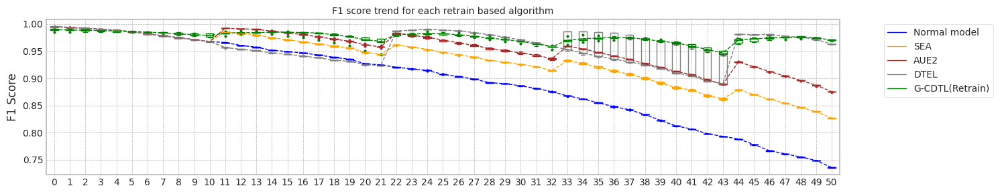

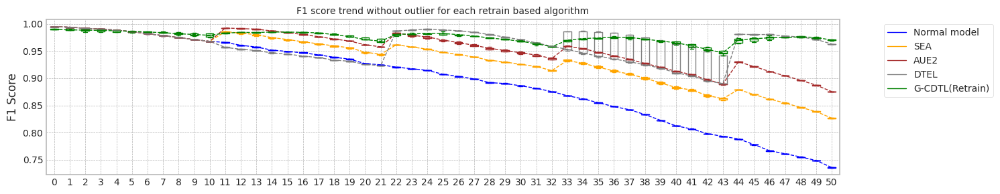

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.558502674102783
Base flops (train + inference flops of normal model, median): 6510645000.0


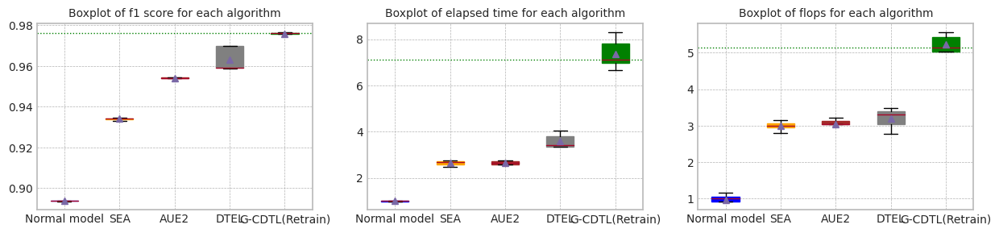

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.558502674102783


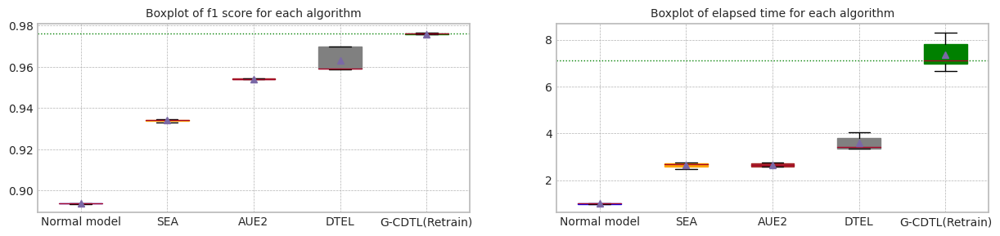

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.558503,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.443442,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.597714,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.572422,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.471229,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.558503,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.067332,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.731510,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.613955,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.733879,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.726424,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.840503,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.731510,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.080163,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.934398,0.826299,25.605523,9.733560e+09,1.019944e+10,1.993300e+10
1,1.0,0.994876,0.993988,0.934774,0.826996,26.243814,9.819255e+09,8.417685e+09,1.823694e+10
2,2.0,0.994390,0.993786,0.934332,0.827195,26.042517,9.742260e+09,9.726600e+09,1.946886e+10
3,3.0,0.994775,0.993983,0.932969,0.825923,24.807083,9.491700e+09,1.107336e+10,2.056506e+10
4,4.0,0.995157,0.994175,0.933736,0.826652,23.829811,9.207210e+09,9.978465e+09,1.918568e+10
5,median,0.994875,0.993983,0.934332,0.826652,25.605523,9.733560e+09,9.978465e+09,1.946886e+10
6,std,0.000277,0.000144,0.000705,0.000515,0.992436,2.510750e+08,9.614756e+08,8.681152e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.954299,0.875385,24.668406,9.567390e+09,1.023294e+10,1.980033e+10
1,1.0,0.994876,0.993988,0.954213,0.875513,24.804852,9.539115e+09,8.337210e+09,1.787632e+10
2,2.0,0.994390,0.993786,0.954128,0.874015,26.033114,9.777930e+09,9.961935e+09,1.973986e+10
3,3.0,0.994775,0.993983,0.954183,0.875670,25.431545,9.613935e+09,1.139526e+10,2.100920e+10
4,4.0,0.995157,0.994175,0.954083,0.875941,26.461757,9.678315e+09,1.064924e+10,2.032755e+10
5,median,0.994875,0.993983,0.954183,0.875513,25.431545,9.613935e+09,1.023294e+10,1.980033e+10
6,std,0.000277,0.000144,0.000083,0.000750,0.772438,9.554238e+07,1.131630e+09,1.165378e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.969655,0.963025,38.536041,1.227440e+10,1.038867e+10,2.266306e+10
1,1.0,0.994876,0.993988,0.958818,0.962805,32.146977,1.098723e+10,7.152270e+09,1.813950e+10
2,2.0,0.994390,0.993786,0.958969,0.963227,32.103321,1.093851e+10,8.897490e+09,1.983600e+10
3,3.0,0.994775,0.993983,0.959320,0.963254,32.760404,1.110642e+10,1.045566e+10,2.156208e+10
4,4.0,0.995157,0.994175,0.969710,0.963016,36.239460,1.167453e+10,1.048306e+10,2.215760e+10
5,median,0.994875,0.993983,0.959320,0.963025,32.760404,1.110642e+10,1.038867e+10,2.156208e+10
6,std,0.000277,0.000144,0.005834,0.000183,2.894842,5.721458e+08,1.461273e+09,1.862574e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.976230,0.971374,63.562151,3.273517e+10,62685000.0,3.279786e+10
1,1.0,0.985570,0.985016,0.975819,0.968295,74.599955,3.524090e+10,62685000.0,3.530359e+10
2,2.0,0.991229,0.990418,0.976702,0.970044,68.050618,3.340070e+10,62685000.0,3.346338e+10
3,3.0,0.989726,0.989077,0.976023,0.971721,79.511802,3.620056e+10,62685000.0,3.626325e+10
4,4.0,0.989262,0.988322,0.974413,0.970176,66.834459,3.269712e+10,62685000.0,3.275981e+10
5,median,0.989726,0.989077,0.976023,0.970176,68.050618,3.340070e+10,62685000.0,3.346338e+10
6,std,0.002347,0.002288,0.000861,0.001348,6.434107,1.583012e+09,0.0,1.583012e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 02:22:10,646] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:05<00:01, 273.39it/s]

Early stop: 1611
[2023-11-29 02:22:16,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:22:26,156] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:22:26,158] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:05<00:16, 89.70it/s]

[2023-11-29 02:22:47,517] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:22:47,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 02:22:57,194] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 292.56it/s]

Early stop: 1134
[2023-11-29 02:23:01,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:23:10,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:23:10,555] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:07<00:15, 89.18it/s]

[2023-11-29 02:23:33,006] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:23:33,007] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 02:23:42,761] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:05<00:01, 291.99it/s]

Early stop: 1488
[2023-11-29 02:23:47,864] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:23:57,373] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:23:57,375] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:06<00:16, 87.01it/s]

[2023-11-29 02:24:03,874] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:24:03,875] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.30it/s]


mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 02:24:13,597] [INFO] [profiler.py:80:start_profile] Flops profiler started


 95%|█████████▍| 1896/2000 [00:06<00:00, 289.90it/s]

Early stop: 1896
[2023-11-29 02:24:20,144] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.33it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:24:29,807] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:24:29,809] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:05<00:17, 86.17it/s]

[2023-11-29 02:24:51,223] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:24:51,224] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.22it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 02:25:01,089] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:05<00:01, 286.28it/s]


Early stop: 1689
[2023-11-29 02:25:06,997] [INFO] [profiler.py:226:end_profile] Flops profiler finished
Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:25:16,561] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:25:16,563] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:04<00:17, 88.64it/s]

[2023-11-29 02:25:27,199] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:25:27,200] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.27it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:25:38,769] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:25:38,772] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:26:00,233] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:00,235] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:23<03:18,  4.83s/it]

G-CDTL train flops: 3500000000 969500000 240990000 4710490000


 33%|███▎      | 17/51 [00:24<00:19,  1.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:01,993] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:01,996] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:26:22,441] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:22,442] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:45<02:29,  4.67s/it]

G-CDTL train flops: 3500000000 808500000 200970000 4509470000


 51%|█████     | 26/51 [00:46<00:13,  1.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:24,141] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:24,144] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:26:45,767] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:45,768] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:08<02:46,  6.94s/it]

G-CDTL train flops: 3500000000 981750000 244035000 4725785000


 69%|██████▊   | 35/51 [01:10<00:09,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:47,448] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:47,451] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:26:54,385] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:54,387] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:17<00:25,  1.83s/it]

G-CDTL train flops: 84000000 1055250000 262305000 1401555000


 86%|████████▋ | 44/51 [01:18<00:02,  3.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:56,134] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:56,136] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:27:05,541] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:27:05,542] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:28<00:11,  2.24s/it]

G-CDTL train flops: 99750000 1436750000 357135000 1893635000


100%|██████████| 51/51 [01:29<00:00,  1.76s/it]


Early stop at  [553, 461, 560, 602, 820]
Train flops  [4710490000, 4509470000, 4725785000, 1401555000, 1893635000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9786878503748764
G_CDTL+AUE median: 0.9786878503748764
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:49,  1.21s/it]

Ensemble_SEA train flops: 870000000


 37%|███▋      | 19/51 [00:11<00:30,  1.05it/s]

Ensemble_SEA train flops: 645975000


 55%|█████▍    | 28/51 [00:18<00:27,  1.21s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:24<00:16,  1.18s/it]

Ensemble_SEA train flops: 853470000


 90%|█████████ | 46/51 [00:30<00:05,  1.16s/it]

Ensemble_SEA train flops: 826935000


100%|██████████| 51/51 [00:31<00:00,  1.62it/s]


Early stop at  [1999, 1484, 1999, 1961, 1900]
Train flops  [870000000, 645975000, 870000000, 853470000, 826935000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9347310464020524
SEA median: 0.9347310464020524
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:39,  1.05it/s]

Ensemble_SEA train flops: 667290000


 37%|███▋      | 19/51 [00:11<00:36,  1.13s/it]

Ensemble_SEA train flops: 810405000


 55%|█████▍    | 28/51 [00:17<00:27,  1.20s/it]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:23<00:24,  1.66s/it]

Ensemble_SEA train flops: 870000000


 90%|█████████ | 46/51 [00:29<00:05,  1.02s/it]

Ensemble_SEA train flops: 714705000


100%|██████████| 51/51 [00:30<00:00,  1.67it/s]


Early stop at  [1533, 1862, 1999, 1999, 1642]
Train flops  [667290000, 810405000, 870000000, 870000000, 714705000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9572858890326973
AUE median: 0.9572858890326973
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:36,  1.11it/s]

Ensemble_DTEL train flops: 609435000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:06<00:08,  4.09it/s]

Ensemble_DTEL train flops: 564630000


 37%|███▋      | 19/51 [00:12<00:43,  1.36s/it]

Ensemble_DTEL train flops: 449790000


 55%|█████▍    | 28/51 [00:16<00:17,  1.29it/s]

Ensemble_DTEL train flops: 489810000
Ensemble_DTEL train flops: 1740000


 69%|██████▊   | 35/51 [00:17<00:03,  4.21it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:27<00:30,  2.15s/it]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:32<00:08,  1.49s/it]

Ensemble_DTEL train flops: 735585000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:34<00:00,  1.50it/s]


Early stop at  [1400, 2, 1297, 1033, 1125, 3, 1999, 1999, 1690, 3]
Train flops  [609435000, 1305000, 564630000, 449790000, 489810000, 1740000, 870000000, 870000000, 735585000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9653331052179359
DTEL median: 0.9653331052179359
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:28:44,776] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:28:44,778] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:28:50,269] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:28:50,270] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:07<00:56,  1.38s/it]

G-CDTL train flops: 71750000 824250000 204885000 1100885000


 33%|███▎      | 17/51 [00:08<00:09,  3.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:28:52,005] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:28:52,007] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:29:09,192] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:29:09,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:26<02:59,  5.43s/it]

G-CDTL train flops: 2402750000 1013250000 251865000 3667865000


 51%|█████     | 26/51 [00:27<00:12,  2.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:29:10,895] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:29:10,897] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:29:31,711] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:29:31,713] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:48<01:48,  4.71s/it]

G-CDTL train flops: 3500000000 770000000 191400000 4461400000


 69%|██████▊   | 35/51 [00:50<00:09,  1.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:29:33,486] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:29:33,488] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:29:58,136] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:29:58,137] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:15<01:57,  7.85s/it]

G-CDTL train flops: 3500000000 1394750000 346695000 5241445000


 86%|████████▋ | 44/51 [01:16<00:04,  1.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:29:59,904] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:29:59,907] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:30:21,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:30:21,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:38<00:24,  4.92s/it]

G-CDTL train flops: 3500000000 875000000 217500000 4592500000


100%|██████████| 51/51 [01:39<00:00,  1.95s/it]


Early stop at  [470, 578, 439, 796, 499]
Train flops  [1100885000, 3667865000, 4461400000, 5241445000, 4592500000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9794638733059255
G_CDTL+AUE median: 0.979075861840401
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:42,  1.04s/it]

Ensemble_SEA train flops: 718620000


 37%|███▋      | 19/51 [00:11<00:32,  1.01s/it]

Ensemble_SEA train flops: 685560000


 55%|█████▍    | 28/51 [00:17<00:28,  1.23s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:23<00:15,  1.13s/it]

Ensemble_SEA train flops: 763860000


 90%|█████████ | 46/51 [00:30<00:06,  1.22s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:31<00:00,  1.63it/s]


Early stop at  [1651, 1575, 1999, 1755, 1999]
Train flops  [718620000, 685560000, 870000000, 763860000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9357913224689808
SEA median: 0.9352611844355165
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:50,  1.23s/it]

Ensemble_SEA train flops: 870000000


 37%|███▋      | 19/51 [00:11<00:29,  1.08it/s]

Ensemble_SEA train flops: 605955000


 55%|█████▍    | 28/51 [00:17<00:27,  1.18s/it]

Ensemble_SEA train flops: 846510000


 73%|███████▎  | 37/51 [00:23<00:15,  1.11s/it]

Ensemble_SEA train flops: 770385000


 90%|█████████ | 46/51 [00:29<00:05,  1.12s/it]

Ensemble_SEA train flops: 781695000


100%|██████████| 51/51 [00:30<00:00,  1.66it/s]


Early stop at  [1999, 1392, 1945, 1770, 1796]
Train flops  [870000000, 605955000, 846510000, 770385000, 781695000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9570865482536867
AUE median: 0.957186218643192
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:48,  1.19s/it]

Ensemble_DTEL train flops: 858255000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:07<00:09,  3.75it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:14<00:52,  1.63s/it]

Ensemble_DTEL train flops: 366705000


 55%|█████▍    | 28/51 [00:19<00:21,  1.09it/s]

Ensemble_DTEL train flops: 583770000
Ensemble_DTEL train flops: 1740000


 69%|██████▊   | 35/51 [00:21<00:03,  4.03it/s]

Ensemble_DTEL train flops: 807795000


 73%|███████▎  | 37/51 [00:30<00:29,  2.12s/it]

Ensemble_DTEL train flops: 870000000


 90%|█████████ | 46/51 [00:36<00:06,  1.26s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:37<00:00,  1.35it/s]


Early stop at  [1972, 2, 1999, 842, 1341, 3, 1856, 1999, 1999, 4]
Train flops  [858255000, 1305000, 870000000, 366705000, 583770000, 1740000, 807795000, 870000000, 870000000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9649602104322724
DTEL median: 0.9651466578251042
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:32:04,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:32:04,442] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:32:26,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:32:26,484] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:23<04:57,  7.08s/it]

G-CDTL train flops: 3500000000 966000000 240120000 4706120000


 33%|███▎      | 17/51 [00:25<00:19,  1.73it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:32:28,256] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:32:28,259] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:32:49,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:32:49,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:47<02:35,  4.86s/it]

G-CDTL train flops: 3500000000 871500000 216630000 4588130000


 51%|█████     | 26/51 [00:48<00:14,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:32:51,310] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:32:51,312] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:33:15,580] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:33:15,581] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [01:13<02:06,  5.48s/it]

G-CDTL train flops: 3500000000 1251250000 311025000 5062275000


 69%|██████▊   | 35/51 [01:14<00:10,  1.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:33:17,297] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:33:17,300] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:33:38,059] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:33:38,061] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:35<01:06,  4.77s/it]

G-CDTL train flops: 3500000000 721000000 179220000 4400220000


 86%|████████▋ | 44/51 [01:36<00:03,  1.77it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:33:39,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:33:39,793] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:33:46,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:33:46,372] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:43<00:08,  1.76s/it]

G-CDTL train flops: 78750000 974750000 242295000 1295795000


100%|██████████| 51/51 [01:44<00:00,  2.06s/it]


Early stop at  [551, 497, 714, 411, 556]
Train flops  [4706120000, 4588130000, 5062275000, 4400220000, 1295795000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9791482821335014
G_CDTL+AUE median: 0.9791482821335014
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:31,  1.30it/s]

Ensemble_SEA train flops: 483720000


 37%|███▋      | 19/51 [00:10<00:37,  1.17s/it]

Ensemble_SEA train flops: 809970000


 55%|█████▍    | 28/51 [00:17<00:28,  1.26s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:22<00:14,  1.02s/it]

Ensemble_SEA train flops: 686865000


 90%|█████████ | 46/51 [00:29<00:06,  1.23s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:30<00:00,  1.68it/s]


Early stop at  [1111, 1861, 1999, 1578, 1999]
Train flops  [483720000, 809970000, 870000000, 686865000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9363481843331967
SEA median: 0.9357913224689808
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:42,  1.03s/it]

Ensemble_SEA train flops: 696870000


 37%|███▋      | 19/51 [00:12<00:39,  1.24s/it]

Ensemble_SEA train flops: 870000000


 55%|█████▍    | 28/51 [00:17<00:23,  1.01s/it]

Ensemble_SEA train flops: 672945000


 73%|███████▎  | 37/51 [00:23<00:14,  1.02s/it]

Ensemble_SEA train flops: 685125000


 90%|█████████ | 46/51 [00:29<00:06,  1.20s/it]

Ensemble_SEA train flops: 860430000


100%|██████████| 51/51 [00:30<00:00,  1.67it/s]


Early stop at  [1601, 1999, 1546, 1574, 1977]
Train flops  [696870000, 870000000, 672945000, 685125000, 860430000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9574449692310932
AUE median: 0.9572858890326973
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:50,  1.23s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:07<00:09,  3.69it/s]

Ensemble_DTEL train flops: 476760000


 37%|███▋      | 19/51 [00:14<00:46,  1.45s/it]

Ensemble_DTEL train flops: 546795000


 55%|█████▍    | 28/51 [00:20<00:25,  1.11s/it]

Ensemble_DTEL train flops: 743850000
Ensemble_DTEL train flops: 1740000


 73%|███████▎  | 37/51 [00:26<00:17,  1.25s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 870000


 86%|████████▋ | 44/51 [00:27<00:01,  3.68it/s]

Ensemble_DTEL train flops: 646410000


 90%|█████████ | 46/51 [00:36<00:09,  1.97s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:37<00:00,  1.36it/s]


Early stop at  [1999, 2, 1095, 1256, 1709, 3, 1999, 1, 1485, 1999]
Train flops  [870000000, 1305000, 476760000, 546795000, 743850000, 1740000, 870000000, 870000, 646410000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9564519763031146
DTEL median: 0.9649602104322724
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:35:27,933] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:35:27,936] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:35:56,371] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:35:56,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:30<04:19,  6.34s/it]

G-CDTL train flops: 3500000000 1879500000 467190000 5846690000


 33%|███▎      | 17/51 [00:31<00:23,  1.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:35:58,107] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:35:58,110] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:36:19,914] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:19,915] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:53<03:54,  7.09s/it]

G-CDTL train flops: 3500000000 838250000 208365000 4546615000


 51%|█████     | 26/51 [00:55<00:14,  1.71it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:36:21,613] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:36:21,616] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:36:27,386] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:27,388] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [01:01<00:36,  1.60s/it]

G-CDTL train flops: 66500000 847000000 210540000 1124040000


 69%|██████▊   | 35/51 [01:02<00:04,  3.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:36:29,108] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:36:29,111] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:36:35,487] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:35,488] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:09<00:22,  1.59s/it]

G-CDTL train flops: 78750000 929250000 230985000 1238985000


 86%|████████▋ | 44/51 [01:10<00:02,  3.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:36:37,226] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:36:37,228] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:36:46,327] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:46,328] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:20<00:10,  2.16s/it]

G-CDTL train flops: 89250000 1286250000 319725000 1695225000


100%|██████████| 51/51 [01:21<00:00,  1.59s/it]


Early stop at  [1073, 478, 483, 530, 734]
Train flops  [5846690000, 4546615000, 1124040000, 1238985000, 1695225000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9793768053624848
G_CDTL+AUE median: 0.9792625437479932
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:15,  2.60it/s]

Ensemble_SEA train flops: 165735000


 35%|███▌      | 18/51 [00:09<00:54,  1.65s/it]

Ensemble_SEA train flops: 870000000


 55%|█████▍    | 28/51 [00:14<00:22,  1.02it/s]

Ensemble_SEA train flops: 640320000


 71%|███████   | 36/51 [00:18<00:16,  1.07s/it]

Ensemble_SEA train flops: 493290000


 88%|████████▊ | 45/51 [00:24<00:09,  1.51s/it]

Ensemble_SEA train flops: 774735000


100%|██████████| 51/51 [00:26<00:00,  1.95it/s]


Early stop at  [380, 1999, 1471, 1133, 1780]
Train flops  [165735000, 870000000, 640320000, 493290000, 774735000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9382656272561997
SEA median: 0.9360697534010887
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:47,  1.17s/it]

Ensemble_SEA train flops: 803010000


 37%|███▋      | 19/51 [00:12<00:36,  1.13s/it]

Ensemble_SEA train flops: 759075000


 55%|█████▍    | 28/51 [00:17<00:20,  1.13it/s]

Ensemble_SEA train flops: 561585000


 73%|███████▎  | 37/51 [00:22<00:12,  1.09it/s]

Ensemble_SEA train flops: 598560000


 90%|█████████ | 46/51 [00:28<00:06,  1.22s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:29<00:00,  1.71it/s]


Early stop at  [1845, 1744, 1290, 1375, 1999]
Train flops  [803010000, 759075000, 561585000, 598560000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9563285703961034
AUE median: 0.957186218643192
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:50,  1.23s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


 33%|███▎      | 17/51 [00:08<00:09,  3.75it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:14<00:46,  1.46s/it]

Ensemble_DTEL train flops: 204015000


 53%|█████▎    | 27/51 [00:18<00:24,  1.02s/it]

Ensemble_DTEL train flops: 450660000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:19<00:03,  4.17it/s]

Ensemble_DTEL train flops: 815625000


 73%|███████▎  | 37/51 [00:29<00:30,  2.17s/it]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:35<00:09,  1.57s/it]

Ensemble_DTEL train flops: 769515000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:36<00:00,  1.40it/s]


Early stop at  [1999, 3, 1999, 468, 1035, 4, 1874, 1999, 1768, 4]
Train flops  [870000000, 1740000, 870000000, 204015000, 450660000, 2175000, 815625000, 870000000, 769515000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9651325027200389
DTEL median: 0.9650463565761557
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:38:21,792] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:38:21,794] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:38:48,955] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:38:48,956] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:29<04:08,  6.06s/it]

G-CDTL train flops: 3500000000 1706250000 424125000 5630375000


 33%|███▎      | 17/51 [00:30<00:22,  1.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:38:50,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:38:50,670] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:39:11,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:39:11,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:51<02:36,  4.88s/it]

G-CDTL train flops: 3500000000 752500000 187050000 4439550000


 51%|█████     | 26/51 [00:53<00:14,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:39:13,589] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:39:13,592] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:39:34,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:39:34,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:14<02:42,  6.78s/it]

G-CDTL train flops: 3500000000 754250000 187485000 4441735000


 69%|██████▊   | 35/51 [01:16<00:09,  1.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:39:36,383] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:39:36,386] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:39:43,161] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:39:43,162] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:23<00:37,  2.49s/it]

G-CDTL train flops: 77000000 987000000 245340000 1309340000


 86%|████████▋ | 44/51 [01:24<00:02,  3.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:39:44,881] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:39:44,884] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:40:08,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:40:08,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:48<00:26,  5.28s/it]

G-CDTL train flops: 3500000000 1174250000 291885000 4966135000


100%|██████████| 51/51 [01:49<00:00,  2.15s/it]


Early stop at  [974, 429, 430, 563, 670]
Train flops  [5630375000, 4439550000, 4441735000, 1309340000, 4966135000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9791924668469494
G_CDTL+AUE median: 0.9791924668469494
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:44,  1.07s/it]

Ensemble_SEA train flops: 710355000


 37%|███▋      | 19/51 [00:10<00:27,  1.15it/s]

Ensemble_SEA train flops: 538965000


 55%|█████▍    | 28/51 [00:17<00:28,  1.26s/it]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:23<00:26,  1.76s/it]

Ensemble_SEA train flops: 870000000


 90%|█████████ | 46/51 [00:30<00:06,  1.25s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:31<00:00,  1.61it/s]


Early stop at  [1632, 1238, 1999, 1999, 1999]
Train flops  [710355000, 538965000, 870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9353858549850839
SEA median: 0.9357913224689808
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:35,  1.16it/s]

Ensemble_SEA train flops: 556800000


 37%|███▋      | 19/51 [00:10<00:31,  1.01it/s]

Ensemble_SEA train flops: 652500000


 55%|█████▍    | 28/51 [00:16<00:24,  1.05s/it]

Ensemble_SEA train flops: 694260000


 71%|███████   | 36/51 [00:21<00:22,  1.49s/it]

Ensemble_SEA train flops: 725145000


 90%|█████████ | 46/51 [00:28<00:06,  1.27s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:29<00:00,  1.73it/s]


Early stop at  [1279, 1499, 1595, 1666, 1999]
Train flops  [556800000, 652500000, 694260000, 725145000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9575094606587795
AUE median: 0.9572858890326973
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:46,  1.13s/it]

Ensemble_DTEL train flops: 770820000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:07<00:08,  3.84it/s]

Ensemble_DTEL train flops: 64815000


 37%|███▋      | 19/51 [00:10<00:26,  1.19it/s]

Ensemble_DTEL train flops: 460230000


 53%|█████▎    | 27/51 [00:12<00:05,  4.32it/s]

Ensemble_DTEL train flops: 1740000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:13<00:02,  5.34it/s]

Ensemble_DTEL train flops: 710790000


 73%|███████▎  | 37/51 [00:23<00:28,  2.04s/it]

Ensemble_DTEL train flops: 870000000


 90%|█████████ | 46/51 [00:28<00:05,  1.12s/it]

Ensemble_DTEL train flops: 715140000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:29<00:00,  1.71it/s]


Early stop at  [1771, 2, 148, 1057, 3, 4, 1633, 1999, 1643, 3]
Train flops  [770820000, 1305000, 64815000, 460230000, 1740000, 2175000, 710790000, 870000000, 715140000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9655878817372432
DTEL median: 0.9651325027200389


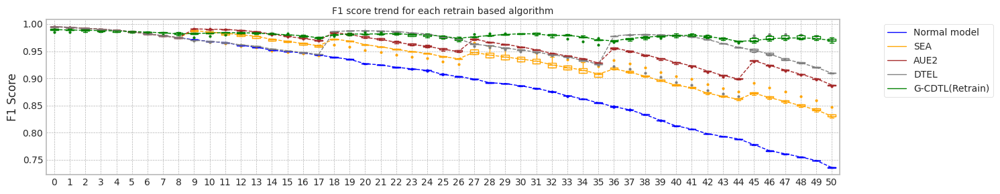

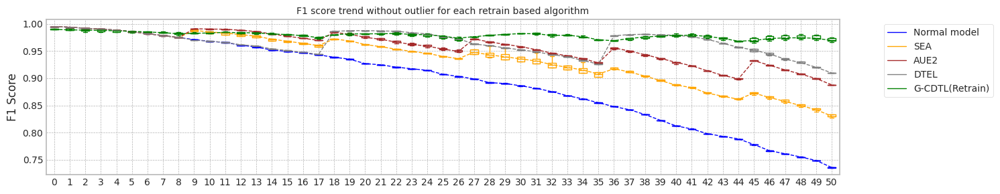

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.54557490348816
Base flops (train + inference flops of normal model, median): 6510645000.0


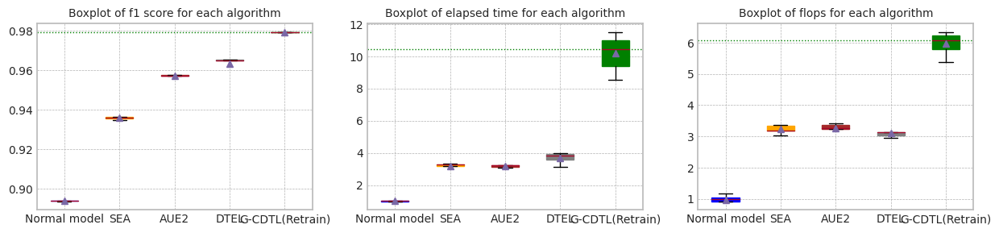

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.54557490348816


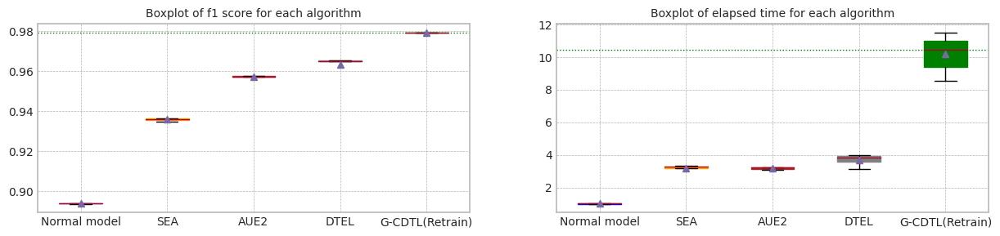

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.590554,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.458447,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.488317,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.641612,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.545575,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.545575,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.074353,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.654038,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.729351,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.696723,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.843629,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.738849,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.729351,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.070420,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.934731,0.826966,31.521029,1.068273e+10,1.125040e+10,2.193314e+10
1,1.0,0.994876,0.993988,0.935791,0.829778,31.303232,1.052439e+10,9.224610e+09,1.974900e+10
2,2.0,0.994390,0.993786,0.936348,0.830373,30.406723,1.033690e+10,1.042304e+10,2.075994e+10
3,3.0,0.994775,0.993983,0.938266,0.847690,26.216778,9.560430e+09,1.124388e+10,2.080431e+10
4,4.0,0.995157,0.994175,0.935386,0.833092,31.793347,1.047567e+10,1.134872e+10,2.182438e+10
5,median,0.994875,0.993983,0.935791,0.830373,31.303232,1.047567e+10,1.124388e+10,2.080431e+10
6,std,0.000277,0.000144,0.001345,0.008182,2.312907,4.400951e+08,9.045786e+08,8.958619e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.957286,0.887969,30.659409,1.054875e+10,1.131609e+10,2.186484e+10
1,1.0,0.994876,0.993988,0.957087,0.885931,30.862051,1.049090e+10,9.390780e+09,1.988168e+10
2,2.0,0.994390,0.993786,0.957445,0.887970,30.660167,1.040172e+10,1.068752e+10,2.108924e+10
3,3.0,0.994775,0.993983,0.956329,0.887180,29.893865,1.020858e+10,1.209170e+10,2.230028e+10
4,4.0,0.995157,0.994175,0.957509,0.888199,29.597255,1.011506e+10,1.118776e+10,2.130282e+10
5,median,0.994875,0.993983,0.957286,0.887969,30.659409,1.040172e+10,1.118776e+10,2.130282e+10
6,std,0.000277,0.000144,0.000477,0.000933,0.553991,1.851902e+08,9.991155e+08,9.185480e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.965333,0.909309,34.102743,1.121038e+10,9.173715e+09,2.038410e+10
1,1.0,0.994876,0.993988,0.964960,0.909794,37.911434,1.184810e+10,7.358025e+09,1.920612e+10
2,2.0,0.994390,0.993786,0.956452,0.971524,37.541142,1.164408e+10,8.699130e+09,2.034321e+10
3,3.0,0.994775,0.993983,0.965133,0.909859,36.452863,1.147226e+10,1.007895e+10,2.155120e+10
4,4.0,0.995157,0.994175,0.965588,0.910157,29.812575,1.021510e+10,9.469515e+09,1.968462e+10
5,median,0.994875,0.993983,0.965133,0.909859,36.452863,1.147226e+10,9.173715e+09,2.034321e+10
6,std,0.000277,0.000144,0.003943,0.027615,3.340074,6.385678e+08,1.023672e+09,8.842852e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.978688,0.969322,89.754172,3.768691e+10,53730000.0,3.774064e+10
1,1.0,0.985570,0.985016,0.979464,0.975099,99.524677,3.951007e+10,53730000.0,3.956380e+10
2,2.0,0.991229,0.990418,0.979148,0.973367,104.923110,4.049852e+10,53730000.0,4.055224e+10
3,3.0,0.989726,0.989077,0.979377,0.965970,81.311855,3.489753e+10,53730000.0,3.495126e+10
4,4.0,0.989262,0.988322,0.979192,0.969495,109.925741,4.123311e+10,53730000.0,4.128684e+10
5,median,0.989726,0.989077,0.979192,0.969495,99.524677,3.951007e+10,53730000.0,3.956380e+10
6,std,0.002347,0.002288,0.000301,0.003612,11.562933,2.538276e+09,0.0,2.538276e+09


Test F1 Score: 0.9948145866196703
G-CDTL, 1-retrain: 0.9528377346941299


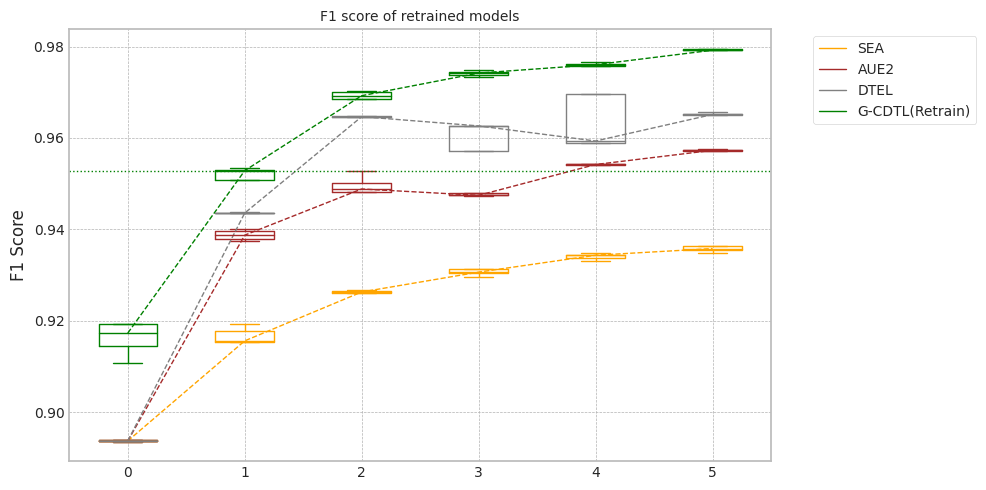

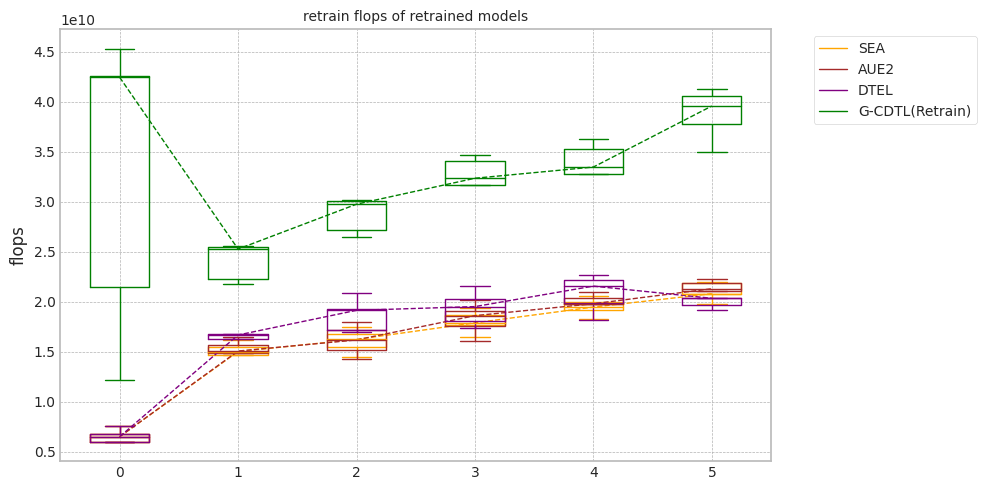

In [ ]:
experiment_all(2000,'case2',X1, Y1,train_size, test_size,avaible_range = 300,
               lambda_f2=0.8,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

## synthetic data의 생성 (Case #3 MI의 증감(상대적), Drift의 증가)

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ 이때 대상 feature $z_0$에 대해서 MI 증가, ks-test 통계량 증가
+ 이에따라 $X_0$의 MI 감소

+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature는 가변 data drift, MI는 고정

### Dataset 준비

In [ ]:
import matplotlib.pyplot as plt

cor = np.asarray([2.5, 1.2, 0.9 , 0.7, 1.5])
data_size = 60000
seed_everything()

x1 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x1[:,ix] = np.random.normal(1,cor_,data_size)

seed_everything()

y1_array = []
cor_const = cor[0]
for ii in range(x1.shape[0]):
    cor[0] = cor[0] - cor_const / x1.shape[0]
    e = np.random.normal(0.0, 1.0)
    e1 = np.random.normal(0.0,  6*ii/60000)
    x1[ii,4] = x1[ii,4] + e1
    y1_array.append(np.sum(cor * x1[ii])+e)

In [ ]:
m = np.mean(y1_array)
print(m)
y1 = [1 if y_ > m else 0 for y_ in y1_array]
sum(y1)

5.588707982526439


30197

### 실험

MI Analysis MI Max 0.25674, Min 0.00115, Mean 0.07258, Std 0.09686
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:09<00:00,  5.14it/s]


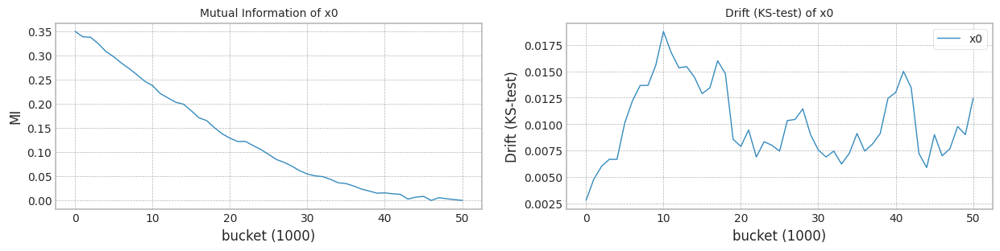

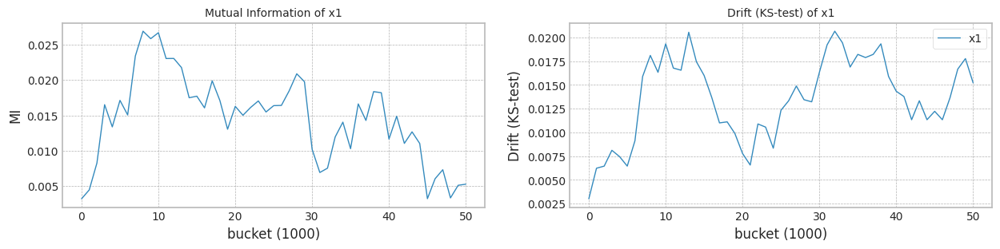

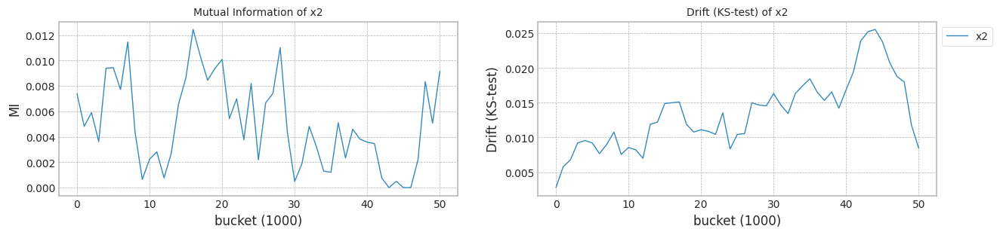

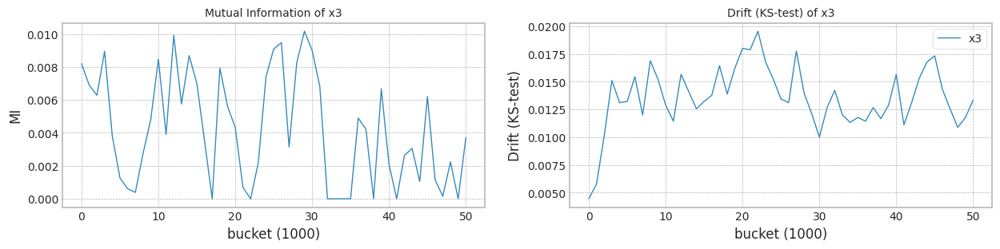

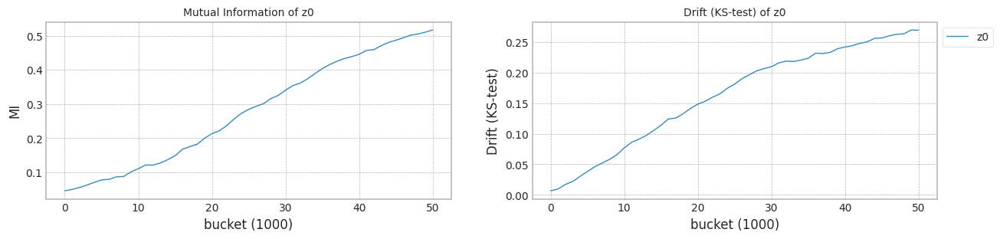

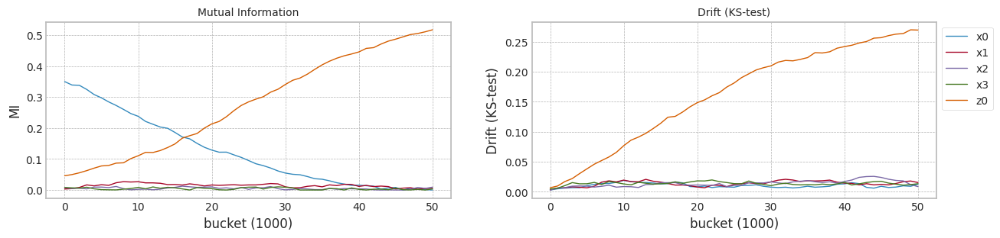

In [ ]:
columns=['x0','x1','x2','x3','z0']
X1 = pd.DataFrame(x1,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X1, y1,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.444809,0.549493,0.334264,0.503728,0
1,0.610533,0.615178,0.580336,0.386537,0.446379,0
2,0.556874,0.639435,0.724770,0.481368,0.071687,0
3,0.344341,0.459348,0.528780,0.367451,0.742993,0
4,0.503142,0.605841,0.465698,0.400521,0.439129,0
...,...,...,...,...,...,...
59995,0.480638,0.384668,0.703331,0.287800,0.877706,59
59996,0.288861,0.418546,0.215280,0.307386,0.776950,59
59997,0.662003,0.594007,0.488092,0.450741,-0.117448,59
59998,0.655881,0.383029,0.773189,0.490745,0.792410,59


trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 13:46:57,733] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 454.06it/s]

Early stop: 1050
[2023-11-29 13:47:00,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:47:10,286] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 13:47:10,288] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:02<00:10, 151.74it/s]

[2023-11-29 13:47:21,975] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:47:21,976] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.85it/s]

mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 13:47:32,591] [INFO] [profiler.py:80:start_profile] Flops profiler started



 41%|████      | 818/2000 [00:01<00:02, 455.84it/s]

Early stop: 818
[2023-11-29 13:47:34,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:47:44,512] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:47:44,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:02<00:10, 152.10it/s]

[2023-11-29 13:47:56,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:47:56,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.00it/s]


mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 13:48:06,390] [INFO] [profiler.py:80:start_profile] Flops profiler started


 33%|███▎      | 668/2000 [00:01<00:02, 460.06it/s]

Early stop: 668
[2023-11-29 13:48:07,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.12it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:48:17,896] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:48:17,898] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:03<00:09, 153.28it/s]

[2023-11-29 13:48:21,174] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:48:21,175] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.08it/s]

mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 13:48:31,315] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 857/2000 [00:01<00:02, 456.42it/s]

Early stop: 857
[2023-11-29 13:48:33,199] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.14it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:48:43,204] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:48:43,206] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:02<00:10, 148.54it/s]

[2023-11-29 13:48:55,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:48:55,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 13:49:05,331] [INFO] [profiler.py:80:start_profile] Flops profiler started


 46%|████▌     | 915/2000 [00:02<00:02, 450.97it/s]

Early stop: 915
[2023-11-29 13:49:07,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.88it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:49:17,921] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:49:17,923] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:02<00:10, 151.44it/s]

[2023-11-29 13:49:23,986] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:49:23,987] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:05<00:05,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:49:39,504] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:49:39,507] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:49:43,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:49:43,099] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:09<00:22,  1.05it/s]

G-CDTL train flops: 77000000 962500000 239250000 1278750000


100%|██████████| 51/51 [00:13<00:00,  3.73it/s]


Early stop at  [549]
Train flops  [1278750000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9363882679917808
G_CDTL+AUE median: 0.9363882679917808
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:07<00:21,  1.15it/s]

Ensemble_SEA train flops: 653370000


100%|██████████| 51/51 [00:12<00:00,  4.12it/s]


Early stop at  [1501]
Train flops  [653370000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.906057081440001
SEA median: 0.906057081440001
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.24it/s]

Ensemble_SEA train flops: 335820000


100%|██████████| 51/51 [00:11<00:00,  4.58it/s]


Early stop at  [771]
Train flops  [335820000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9208709129591179
AUE median: 0.9208709129591179
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.23it/s]

Ensemble_DTEL train flops: 382800000


 53%|█████▎    | 27/51 [00:09<00:26,  1.11s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:14<00:00,  3.57it/s]


Early stop at  [879, 1999]
Train flops  [382800000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9286408125130783
DTEL median: 0.9286408125130783
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  4.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:50:31,292] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:50:31,295] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:50:42,688] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:50:42,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:16<01:30,  3.62s/it]

G-CDTL train flops: 3500000000 859250000 213585000 4572835000


100%|██████████| 51/51 [00:21<00:00,  2.37it/s]


Early stop at  [490]
Train flops  [4572835000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9339898019028635
G_CDTL+AUE median: 0.9351890349473222
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:13,  1.73it/s]

Ensemble_SEA train flops: 533745000


100%|██████████| 51/51 [00:11<00:00,  4.32it/s]


Early stop at  [1226]
Train flops  [533745000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9073215349678466
SEA median: 0.9066893082039238
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.09it/s]

Ensemble_SEA train flops: 388890000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [893]
Train flops  [388890000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9217369036399637
AUE median: 0.9213039082995409
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.12it/s]

Ensemble_DTEL train flops: 537660000


 53%|█████▎    | 27/51 [00:10<00:29,  1.21s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:14<00:00,  3.44it/s]


Early stop at  [1235, 1999]
Train flops  [537660000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9289237730833838
DTEL median: 0.928782292798231
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:51:31,149] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:51:31,152] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:51:35,043] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:51:35,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:09<00:34,  1.37s/it]

G-CDTL train flops: 61250000 1039500000 258390000 1359140000


100%|██████████| 51/51 [00:14<00:00,  3.64it/s]


Early stop at  [593]
Train flops  [1359140000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.935583098477541
G_CDTL+AUE median: 0.935583098477541
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  2.00it/s]

Ensemble_SEA train flops: 437610000


100%|██████████| 51/51 [00:11<00:00,  4.49it/s]


Early stop at  [1005]
Train flops  [437610000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.906437617556084
SEA median: 0.906437617556084
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  1.88it/s]

Ensemble_SEA train flops: 460230000


100%|██████████| 51/51 [00:11<00:00,  4.37it/s]


Early stop at  [1057]
Train flops  [460230000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9210303036905882
AUE median: 0.9210303036905882
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.01it/s]

Ensemble_DTEL train flops: 629010000


 51%|█████     | 26/51 [00:09<00:39,  1.56s/it]

Ensemble_DTEL train flops: 682515000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [1445, 1568]
Train flops  [629010000, 682515000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9284661892439404
DTEL median: 0.9286408125130783
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  4.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:52:23,039] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:52:23,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:52:35,046] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:52:35,048] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:17<01:35,  3.81s/it]

G-CDTL train flops: 3500000000 948500000 235770000 4684270000


100%|██████████| 51/51 [00:22<00:00,  2.30it/s]


Early stop at  [541]
Train flops  [4684270000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.93802222514402
G_CDTL+AUE median: 0.9359856832346609
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.55it/s]

Ensemble_SEA train flops: 617700000


100%|██████████| 51/51 [00:12<00:00,  4.21it/s]


Early stop at  [1419]
Train flops  [617700000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9066894221892776
SEA median: 0.9065635198726808
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  1.85it/s]

Ensemble_SEA train flops: 465885000


100%|██████████| 51/51 [00:11<00:00,  4.34it/s]


Early stop at  [1070]
Train flops  [465885000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9213492465465001
AUE median: 0.9211897751185442
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.16it/s]

Ensemble_DTEL train flops: 723840000


 53%|█████▎    | 27/51 [00:10<00:28,  1.21s/it]

Ensemble_DTEL train flops: 651630000


100%|██████████| 51/51 [00:14<00:00,  3.45it/s]


Early stop at  [1663, 1497]
Train flops  [723840000, 651630000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9285017503257156
DTEL median: 0.9285712814193969
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.15it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:53:24,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:53:24,077] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:53:35,711] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:53:35,713] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:16<01:32,  3.69s/it]

G-CDTL train flops: 3500000000 826000000 205320000 4531320000


100%|██████████| 51/51 [00:21<00:00,  2.36it/s]


Early stop at  [471]
Train flops  [4531320000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9374760986045484
G_CDTL+AUE median: 0.9363882679917808
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:13,  1.73it/s]

Ensemble_SEA train flops: 525045000


100%|██████████| 51/51 [00:11<00:00,  4.31it/s]


Early stop at  [1206]
Train flops  [525045000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9065335170551364
SEA median: 0.9065335170551364
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:18,  1.30it/s]

Ensemble_SEA train flops: 779085000


100%|██████████| 51/51 [00:12<00:00,  3.98it/s]


Early stop at  [1790]
Train flops  [779085000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.922365657410436
AUE median: 0.9213492465465001
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.08it/s]

Ensemble_DTEL train flops: 443700000


 53%|█████▎    | 27/51 [00:09<00:25,  1.08s/it]

Ensemble_DTEL train flops: 772560000


100%|██████████| 51/51 [00:14<00:00,  3.61it/s]


Early stop at  [1019, 1775]
Train flops  [443700000, 772560000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9287512587370034
DTEL median: 0.9286408125130783


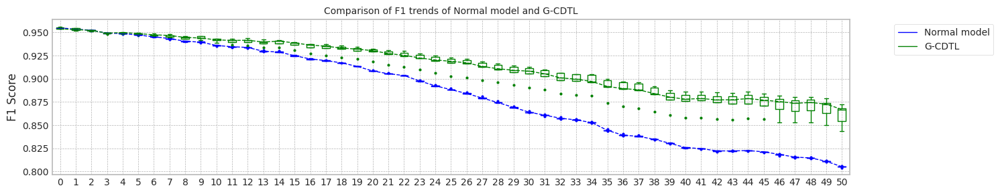

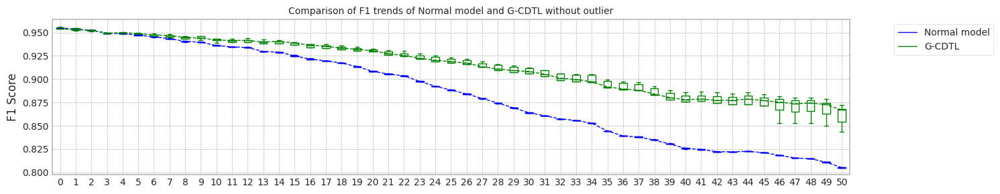

max_mean_trial= 3


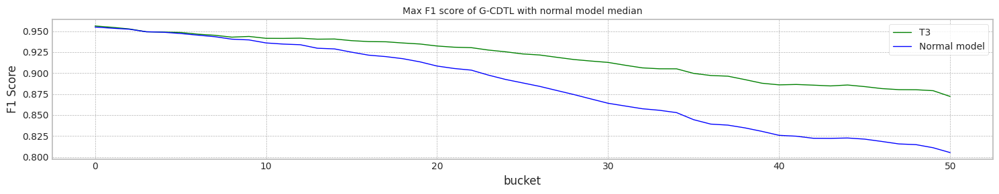

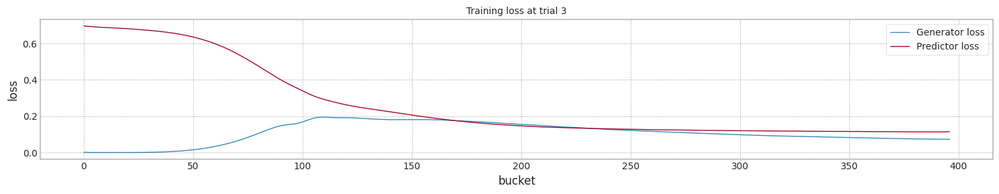

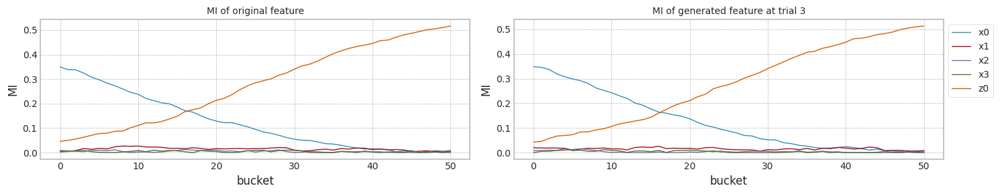

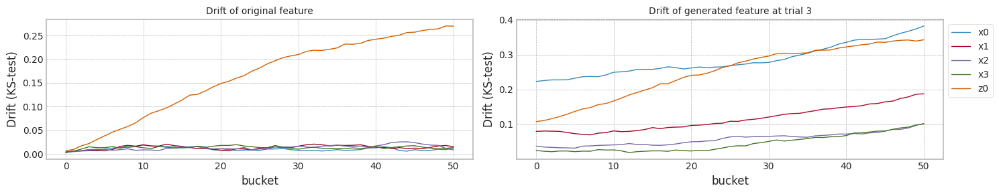

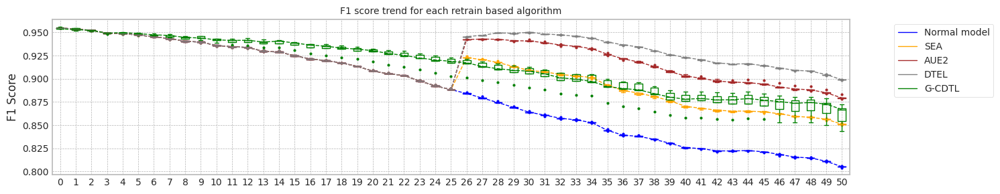

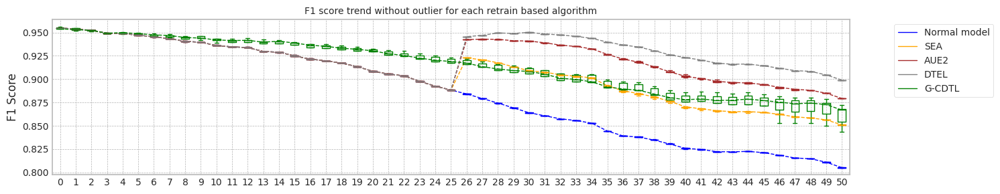

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.10230040550232
Base flops (inference flops of normal model, median): 199665000.0


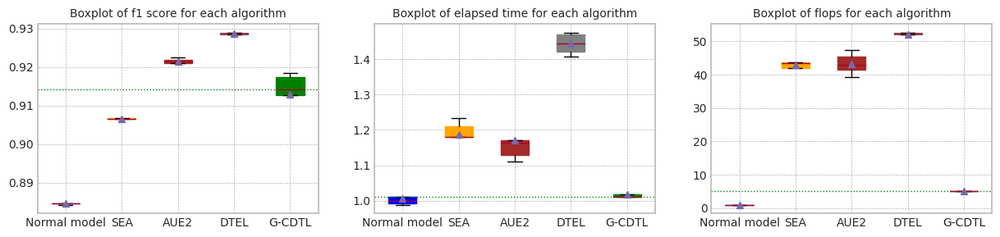

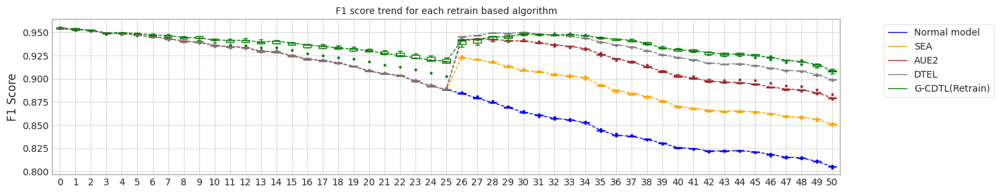

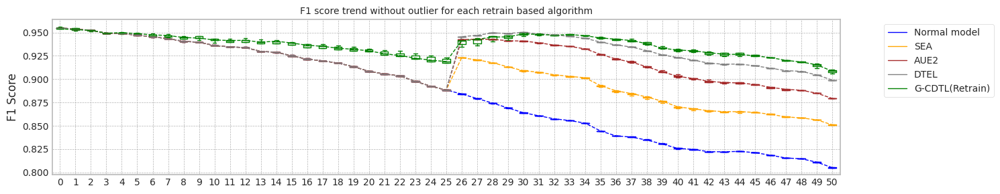

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.10230040550232
Base flops (train + inference flops of normal model, median): 3558735000.0


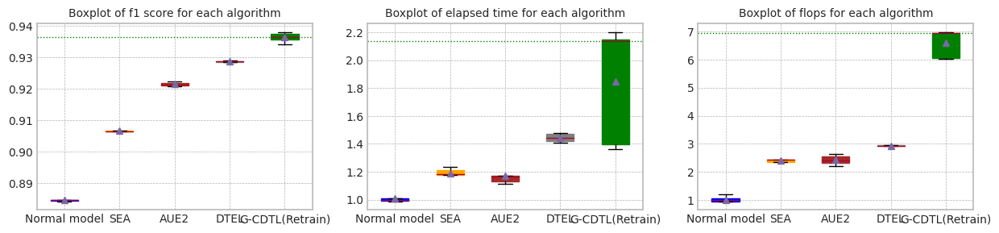

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.10230040550232


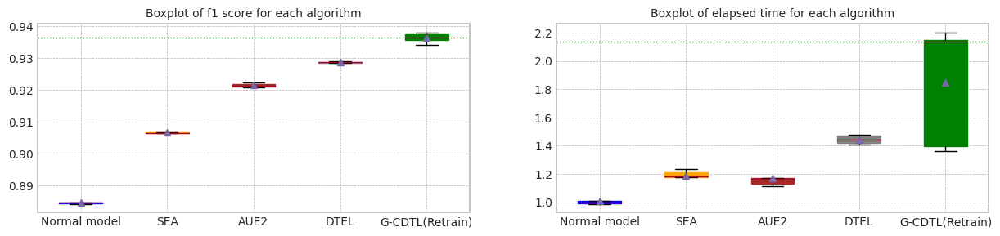

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.216397,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.102300,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.031464,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,9.988451,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.535089,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.102300,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.219126,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.597459,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.274355,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.122884,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.214939,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.214368,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.214939,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.182977,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.906057,0.850187,12.456208,4.239510e+09,5.269155e+09,9.508665e+09
1,1.0,0.954396,0.953533,0.907322,0.852314,11.915078,4.119885e+09,4.241250e+09,8.361135e+09
2,2.0,0.954834,0.953377,0.906438,0.850968,11.451106,4.023750e+09,3.557865e+09,7.581615e+09
3,3.0,0.954910,0.953454,0.906689,0.851160,12.215432,4.203840e+09,4.477890e+09,8.681730e+09
4,4.0,0.954901,0.953539,0.906534,0.850837,11.928427,4.111185e+09,4.612305e+09,8.723490e+09
5,median,0.954901,0.953533,0.906534,0.850968,11.928427,4.119885e+09,4.477890e+09,8.681730e+09
6,std,0.000235,0.000094,0.000462,0.000774,0.376805,8.474387e+07,6.196655e+08,6.959985e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.920871,0.878009,11.226309,3.921960e+09,5.151270e+09,9.073230e+09
1,1.0,0.954396,0.953533,0.921737,0.879308,11.410284,3.975030e+09,4.296060e+09,8.271090e+09
2,2.0,0.954834,0.953377,0.921030,0.879235,11.753560,4.046370e+09,3.780150e+09,7.826520e+09
3,3.0,0.954910,0.953454,0.921349,0.879364,11.829946,4.052025e+09,4.525740e+09,8.577765e+09
4,4.0,0.954901,0.953539,0.922366,0.883060,12.907513,4.365225e+09,5.066010e+09,9.431235e+09
5,median,0.954901,0.953533,0.921349,0.879308,11.753560,4.046370e+09,4.525740e+09,8.577765e+09
6,std,0.000235,0.000094,0.000600,0.001909,0.653334,1.724470e+08,5.666958e+08,6.354875e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.928641,0.899012,14.353645,4.838940e+09,6.170040e+09,1.100898e+10
1,1.0,0.954396,0.953533,0.928924,0.899012,14.903407,4.993800e+09,5.416620e+09,1.041042e+10
2,2.0,0.954834,0.953377,0.928466,0.899140,14.580073,4.897665e+09,4.733235e+09,9.630900e+09
3,3.0,0.954910,0.953454,0.928502,0.898315,14.851740,4.961610e+09,5.537115e+09,1.049872e+10
4,4.0,0.954901,0.953539,0.928751,0.899012,14.221217,4.802400e+09,5.604975e+09,1.040738e+10
5,median,0.954901,0.953533,0.928641,0.899012,14.580073,4.897665e+09,5.537115e+09,1.041042e+10
6,std,0.000235,0.000094,0.000188,0.000331,0.299323,8.038583e+07,5.137953e+08,4.929252e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.936388,0.907632,13.768551,2.121344e+10,223875000.0,2.143731e+10
1,1.0,0.953787,0.952034,0.933990,0.910465,21.607107,2.450752e+10,223875000.0,2.473140e+10
2,2.0,0.953612,0.952352,0.935583,0.905846,14.112960,2.129382e+10,223875000.0,2.151770e+10
3,3.0,0.956214,0.954604,0.938022,0.908471,22.248808,2.461896e+10,223875000.0,2.484283e+10
4,4.0,0.955650,0.954514,0.937476,0.909415,21.723120,2.446600e+10,223875000.0,2.468988e+10
5,median,0.953868,0.953043,0.936388,0.908471,21.607107,2.446600e+10,223875000.0,2.468988e+10
6,std,0.001212,0.001198,0.001597,0.001761,4.345814,1.796091e+09,0.0,1.796091e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 13:54:36,072] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 431.74it/s]

Early stop: 1050
[2023-11-29 13:54:38,512] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.18it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:54:48,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:54:48,473] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:11, 139.89it/s]

[2023-11-29 13:55:01,003] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:55:01,004] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 13:55:11,237] [INFO] [profiler.py:80:start_profile] Flops profiler started


 41%|████      | 818/2000 [00:01<00:02, 435.99it/s]

Early stop: 818
[2023-11-29 13:55:13,122] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.97it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:55:23,486] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:55:23,488] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:02<00:11, 141.30it/s]

[2023-11-29 13:55:35,900] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:55:35,901] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.08it/s]

mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 13:55:46,035] [INFO] [profiler.py:80:start_profile] Flops profiler started



 33%|███▎      | 668/2000 [00:01<00:03, 442.58it/s]

Early stop: 668
[2023-11-29 13:55:47,550] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:55:57,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:55:57,669] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:03<00:10, 139.17it/s]

[2023-11-29 13:56:01,274] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:56:01,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.05it/s]


mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 13:56:11,487] [INFO] [profiler.py:80:start_profile] Flops profiler started


 43%|████▎     | 857/2000 [00:01<00:02, 433.85it/s]

Early stop: 857
[2023-11-29 13:56:13,471] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.16it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:56:23,441] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:56:23,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:02<00:11, 144.83it/s]

[2023-11-29 13:56:35,572] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:56:35,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]


mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 13:56:45,795] [INFO] [profiler.py:80:start_profile] Flops profiler started


 46%|████▌     | 915/2000 [00:02<00:02, 441.58it/s]

Early stop: 915
[2023-11-29 13:56:47,872] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.07it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:56:58,032] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:56:58,035] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:02<00:11, 140.26it/s]

[2023-11-29 13:57:04,542] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:57:04,543] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:57:18,381] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:57:18,384] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 13:57:30,282] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:57:30,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:15<02:04,  3.78s/it]

G-CDTL train flops: 3500000000 775250000 192705000 4467955000


 69%|██████▊   | 35/51 [00:18<00:03,  4.73it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:57:33,918] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:57:33,920] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 13:57:46,311] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:57:46,312] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:31<00:58,  3.93s/it]

G-CDTL train flops: 3500000000 878500000 218370000 4596870000


100%|██████████| 51/51 [00:34<00:00,  1.48it/s]


Early stop at  [442, 501]
Train flops  [4467955000, 4596870000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9426408922160909
G_CDTL+AUE median: 0.9426408922160909
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:17,  1.84it/s]

Ensemble_SEA train flops: 469800000


 71%|███████   | 36/51 [00:11<00:14,  1.01it/s]

Ensemble_SEA train flops: 719055000


100%|██████████| 51/51 [00:14<00:00,  3.55it/s]


Early stop at  [1079, 1652]
Train flops  [469800000, 719055000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9174759726880507
SEA median: 0.9174759726880507
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:27,  1.16it/s]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:12<00:12,  1.19it/s]

Ensemble_SEA train flops: 585510000


100%|██████████| 51/51 [00:15<00:00,  3.33it/s]


Early stop at  [1999, 1345]
Train flops  [870000000, 585510000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9310796841369037
AUE median: 0.9310796841369037
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.15it/s]

Ensemble_DTEL train flops: 366705000


 35%|███▌      | 18/51 [00:07<00:50,  1.52s/it]

Ensemble_DTEL train flops: 870000000


 71%|███████   | 36/51 [00:13<00:13,  1.15it/s]

Ensemble_DTEL train flops: 612915000
Ensemble_DTEL train flops: 2610000


100%|██████████| 51/51 [00:16<00:00,  3.06it/s]


Early stop at  [842, 1999, 1408, 5]
Train flops  [366705000, 870000000, 612915000, 2610000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9275667136477821
DTEL median: 0.9275667136477821
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.15it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:58:39,538] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:58:39,540] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 13:58:42,375] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:58:42,377] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:06<00:34,  1.05s/it]

G-CDTL train flops: 61250000 714000000 177480000 952730000


 69%|██████▊   | 35/51 [00:09<00:03,  5.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:58:45,919] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:58:45,921] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 13:58:58,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:58:58,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:22<01:01,  4.09s/it]

G-CDTL train flops: 3500000000 992250000 246645000 4738895000


100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


Early stop at  [407, 566]
Train flops  [952730000, 4738895000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9413564873559581
G_CDTL+AUE median: 0.9419986897860245
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:15,  2.03it/s]

Ensemble_SEA train flops: 375840000


 73%|███████▎  | 37/51 [00:10<00:09,  1.51it/s]

Ensemble_SEA train flops: 620745000


100%|██████████| 51/51 [00:13<00:00,  3.72it/s]


Early stop at  [863, 1426]
Train flops  [375840000, 620745000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9176925831883077
SEA median: 0.9175842779381792
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:21,  1.55it/s]

Ensemble_SEA train flops: 420210000


 73%|███████▎  | 37/51 [00:11<00:09,  1.44it/s]

Ensemble_SEA train flops: 654240000


100%|██████████| 51/51 [00:13<00:00,  3.65it/s]


Early stop at  [965, 1503]
Train flops  [420210000, 654240000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9308134112033718
AUE median: 0.9309465476701377
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.05it/s]

Ensemble_DTEL train flops: 348870000


 35%|███▌      | 18/51 [00:06<00:33,  1.01s/it]

Ensemble_DTEL train flops: 381495000


 69%|██████▊   | 35/51 [00:09<00:03,  5.13it/s]

Ensemble_DTEL train flops: 803880000


 73%|███████▎  | 37/51 [00:13<00:12,  1.08it/s]

Ensemble_DTEL train flops: 197055000


100%|██████████| 51/51 [00:16<00:00,  3.15it/s]


Early stop at  [801, 876, 1847, 452]
Train flops  [348870000, 381495000, 803880000, 197055000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9402343257315402
DTEL median: 0.9339005196896611
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:59:49,629] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:59:49,632] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 13:59:57,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:59:57,694] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:11<01:26,  2.62s/it]

G-CDTL train flops: 1904000000 817250000 203145000 2924395000


 69%|██████▊   | 35/51 [00:15<00:03,  4.78it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:00:01,344] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:00:01,347] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:00:13,687] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:00:13,689] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:27<00:39,  2.80s/it]

G-CDTL train flops: 3500000000 757750000 188355000 4446105000


100%|██████████| 51/51 [00:30<00:00,  1.67it/s]


Early stop at  [466, 432]
Train flops  [2924395000, 4446105000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9422502237236008
G_CDTL+AUE median: 0.9422502237236008
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:13,  2.37it/s]

Ensemble_SEA train flops: 297105000


 71%|███████   | 36/51 [00:10<00:13,  1.12it/s]

Ensemble_SEA train flops: 622485000


100%|██████████| 51/51 [00:13<00:00,  3.77it/s]


Early stop at  [682, 1430]
Train flops  [297105000, 622485000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.917171455811101
SEA median: 0.9174759726880507
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:19,  1.66it/s]

Ensemble_SEA train flops: 356265000


 73%|███████▎  | 37/51 [00:11<00:12,  1.16it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:14<00:00,  3.47it/s]


Early stop at  [818, 1999]
Train flops  [356265000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9310076705924152
AUE median: 0.9310076705924152
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.08it/s]

Ensemble_DTEL train flops: 334515000


 37%|███▋      | 19/51 [00:06<00:24,  1.32it/s]

Ensemble_DTEL train flops: 400635000


 71%|███████   | 36/51 [00:11<00:10,  1.40it/s]

Ensemble_DTEL train flops: 461970000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [768, 920, 1061, 4]
Train flops  [334515000, 400635000, 461970000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9284092078266841
DTEL median: 0.9284092078266841
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.00it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:01:03,283] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:01:03,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:01:09,688] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:01:09,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:09<01:10,  2.13s/it]

G-CDTL train flops: 1123500000 806750000 200535000 2130785000


 69%|██████▊   | 35/51 [00:13<00:03,  4.58it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:01:13,562] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:01:13,564] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:01:17,989] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:01:17,991] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:18<00:23,  1.55s/it]

G-CDTL train flops: 92750000 1064000000 264480000 1421230000


100%|██████████| 51/51 [00:21<00:00,  2.40it/s]


Early stop at  [460, 607]
Train flops  [2130785000, 1421230000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9422712926968236
G_CDTL+AUE median: 0.9422607582102123
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:28,  1.14it/s]

Ensemble_SEA train flops: 849990000


 73%|███████▎  | 37/51 [00:12<00:07,  1.87it/s]

Ensemble_SEA train flops: 442830000


100%|██████████| 51/51 [00:14<00:00,  3.42it/s]


Early stop at  [1953, 1017]
Train flops  [849990000, 442830000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9178444752725207
SEA median: 0.9175842779381792
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:16,  1.89it/s]

Ensemble_SEA train flops: 415425000


 73%|███████▎  | 37/51 [00:11<00:10,  1.37it/s]

Ensemble_SEA train flops: 688605000


100%|██████████| 51/51 [00:14<00:00,  3.57it/s]


Early stop at  [954, 1582]
Train flops  [415425000, 688605000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9311096375687007
AUE median: 0.9310436773646594
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.01it/s]

Ensemble_DTEL train flops: 369315000


 37%|███▋      | 19/51 [00:05<00:20,  1.53it/s]

Ensemble_DTEL train flops: 204885000


 69%|██████▊   | 35/51 [00:09<00:03,  5.05it/s]

Ensemble_DTEL train flops: 826065000


 71%|███████   | 36/51 [00:14<00:27,  1.82s/it]

Ensemble_DTEL train flops: 610740000


100%|██████████| 51/51 [00:17<00:00,  2.87it/s]


Early stop at  [848, 470, 1898, 1403]
Train flops  [369315000, 204885000, 826065000, 610740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9394622683680813
DTEL median: 0.9339357380973827
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:02:11,756] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:02:11,759] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:02:27,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:02:27,599] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:19<02:43,  4.96s/it]

G-CDTL train flops: 3500000000 1625750000 404115000 5529865000


 69%|██████▊   | 35/51 [00:22<00:03,  4.68it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:02:31,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:02:31,238] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:02:50,553] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:02:50,554] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:42<01:30,  6.01s/it]

G-CDTL train flops: 3500000000 2509500000 623790000 6633290000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [928, 1433]
Train flops  [5529865000, 6633290000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9401093009312876
G_CDTL+AUE median: 0.9422502237236008
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:24,  1.33it/s]

Ensemble_SEA train flops: 491115000


 71%|███████   | 36/51 [00:11<00:14,  1.06it/s]

Ensemble_SEA train flops: 654675000


100%|██████████| 51/51 [00:14<00:00,  3.49it/s]


Early stop at  [1128, 1504]
Train flops  [491115000, 654675000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9174504500114263
SEA median: 0.9174759726880507
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:18,  1.80it/s]

Ensemble_SEA train flops: 318855000


 71%|███████   | 36/51 [00:09<00:09,  1.65it/s]

Ensemble_SEA train flops: 361920000


100%|██████████| 51/51 [00:12<00:00,  4.04it/s]


Early stop at  [732, 831]
Train flops  [318855000, 361920000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9304386065558754
AUE median: 0.9310076705924152
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.15it/s]

Ensemble_DTEL train flops: 410640000


 37%|███▋      | 19/51 [00:05<00:21,  1.48it/s]

Ensemble_DTEL train flops: 184005000


 69%|██████▊   | 35/51 [00:09<00:03,  4.95it/s]

Ensemble_DTEL train flops: 379320000


 73%|███████▎  | 37/51 [00:12<00:10,  1.34it/s]

Ensemble_DTEL train flops: 301455000


100%|██████████| 51/51 [00:15<00:00,  3.40it/s]


Early stop at  [943, 422, 871, 692]
Train flops  [410640000, 184005000, 379320000, 301455000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9401720670276187
DTEL median: 0.9394622683680813


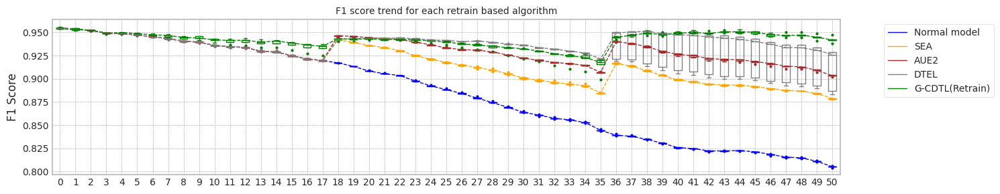

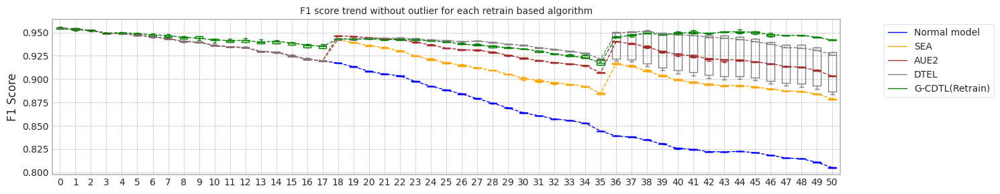

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.0965895652771
Base flops (train + inference flops of normal model, median): 3558735000.0


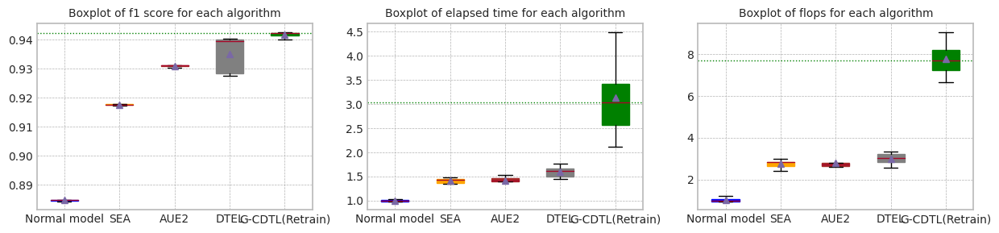

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.0965895652771


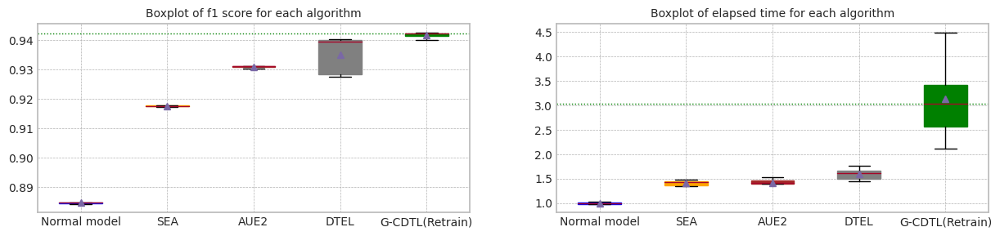

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,9.939114,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.343665,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.096590,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,9.952815,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.142947,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.096590,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.164813,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.211834,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.114491,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.191979,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.199932,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.214098,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.199932,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.041229,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.917476,0.878177,14.413959,4.774995e+09,5.894685e+09,1.066968e+10
1,1.0,0.954396,0.953533,0.917693,0.879003,13.797889,4.582725e+09,4.794135e+09,9.376860e+09
2,2.0,0.954834,0.953377,0.917171,0.879103,13.602865,4.505730e+09,4.129890e+09,8.635620e+09
3,3.0,0.954910,0.953454,0.917844,0.877652,14.995952,4.878960e+09,5.243055e+09,1.012202e+10
4,4.0,0.954901,0.953539,0.917450,0.878802,14.667615,4.731930e+09,5.323095e+09,1.005502e+10
5,median,0.954901,0.953533,0.917476,0.878802,14.413959,4.731930e+09,5.243055e+09,1.005502e+10
6,std,0.000235,0.000094,0.000256,0.000617,0.585341,1.500275e+08,6.583646e+08,7.835716e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.931080,0.903938,15.369924,5.041650e+09,6.361005e+09,1.140266e+10
1,1.0,0.954396,0.953533,0.930813,0.903099,14.031857,4.660590e+09,5.071665e+09,9.732255e+09
2,2.0,0.954834,0.953377,0.931008,0.903960,14.768216,4.812405e+09,4.636230e+09,9.448635e+09
3,3.0,0.954910,0.953454,0.931110,0.903241,14.349631,4.690170e+09,5.253930e+09,9.944100e+09
4,4.0,0.954901,0.953539,0.930439,0.901729,12.688766,4.266915e+09,5.057745e+09,9.324660e+09
5,median,0.954901,0.953533,0.931008,0.903241,14.349631,4.690170e+09,5.071665e+09,9.732255e+09
6,std,0.000235,0.000094,0.000277,0.000908,1.002172,2.821401e+08,6.473825e+08,8.363579e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.927567,0.883566,16.763842,5.438370e+09,6.402765e+09,1.184114e+10
1,1.0,0.954396,0.953533,0.940234,0.928555,16.272640,5.317440e+09,5.391390e+09,1.070883e+10
2,2.0,0.954834,0.953377,0.928409,0.886759,14.571921,4.785435e+09,4.286490e+09,9.071925e+09
3,3.0,0.954910,0.953454,0.939462,0.926154,17.815525,5.597145e+09,5.803335e+09,1.140048e+10
4,4.0,0.954901,0.953539,0.940172,0.928901,15.098347,4.861560e+09,5.253495e+09,1.011506e+10
5,median,0.954901,0.953533,0.939462,0.926154,16.272640,5.317440e+09,5.391390e+09,1.070883e+10
6,std,0.000235,0.000094,0.006569,0.023443,1.299207,3.587277e+08,7.787617e+08,1.090807e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.942641,0.942557,34.588157,2.899951e+10,134325000.0,2.913384e+10
1,1.0,0.953787,0.952034,0.941356,0.941908,25.969827,2.562631e+10,134325000.0,2.576064e+10
2,2.0,0.953612,0.952352,0.942250,0.947406,30.698930,2.730518e+10,134325000.0,2.743951e+10
3,3.0,0.956214,0.954604,0.942271,0.941701,21.339214,2.348670e+10,134325000.0,2.362102e+10
4,4.0,0.955650,0.954514,0.940109,0.938141,45.373780,3.209784e+10,134325000.0,3.223216e+10
5,median,0.953868,0.953043,0.942250,0.941908,30.698930,2.730518e+10,134325000.0,2.743951e+10
6,std,0.001212,0.001198,0.001020,0.003315,9.171156,3.280391e+09,0.0,3.280391e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 14:03:42,047] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 408.12it/s]

Early stop: 1050
[2023-11-29 14:03:44,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:03:54,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:03:54,671] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:11, 131.47it/s]

[2023-11-29 14:04:08,286] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:04:08,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.10it/s]


mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 14:04:18,388] [INFO] [profiler.py:80:start_profile] Flops profiler started


 41%|████      | 818/2000 [00:01<00:02, 417.12it/s]

Early stop: 818
[2023-11-29 14:04:20,356] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.05it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:04:30,551] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:04:30,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:03<00:11, 134.49it/s]

[2023-11-29 14:04:43,865] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:04:43,867] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.07it/s]

mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 14:04:54,012] [INFO] [profiler.py:80:start_profile] Flops profiler started



 33%|███▎      | 668/2000 [00:01<00:03, 411.79it/s]

Early stop: 668
[2023-11-29 14:04:55,640] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.97it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:05:06,003] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:05:06,006] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:03<00:11, 133.87it/s]

[2023-11-29 14:05:09,767] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:05:09,769] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]


mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 14:05:19,877] [INFO] [profiler.py:80:start_profile] Flops profiler started


 43%|████▎     | 857/2000 [00:02<00:02, 413.47it/s]

Early stop: 857
[2023-11-29 14:05:21,955] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:05:32,156] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:05:32,159] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:03<00:12, 130.44it/s]

[2023-11-29 14:05:45,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:05:45,278] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]


mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 14:05:55,324] [INFO] [profiler.py:80:start_profile] Flops profiler started


 46%|████▌     | 915/2000 [00:02<00:02, 403.60it/s]

Early stop: 915
[2023-11-29 14:05:57,596] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:06:07,822] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:07,824] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:02<00:12, 131.60it/s]

[2023-11-29 14:06:14,766] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:06:14,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.06it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:06:27,637] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:27,640] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:06:40,467] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:06:40,468] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:15<02:35,  4.09s/it]

G-CDTL train flops: 3500000000 736750000 183135000 4419885000


 49%|████▉     | 25/51 [00:17<00:06,  4.03it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:06:43,031] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:43,033] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:06:56,561] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:06:56,562] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:31<01:47,  4.29s/it]

G-CDTL train flops: 3500000000 966000000 240120000 4706120000


 75%|███████▍  | 38/51 [00:33<00:03,  3.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:06:59,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:59,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:07:12,811] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:07:12,812] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:47<00:51,  4.33s/it]

G-CDTL train flops: 3500000000 924000000 229680000 4653680000


100%|██████████| 51/51 [00:50<00:00,  1.02it/s]


Early stop at  [420, 551, 527]
Train flops  [4419885000, 4706120000, 4653680000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9434276737542288
G_CDTL+AUE median: 0.9434276737542288
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.61it/s]

Ensemble_SEA train flops: 506775000


 53%|█████▎    | 27/51 [00:10<00:21,  1.10it/s]

Ensemble_SEA train flops: 870000000


 76%|███████▋  | 39/51 [00:15<00:10,  1.09it/s]

Ensemble_SEA train flops: 611610000


100%|██████████| 51/51 [00:17<00:00,  2.86it/s]


Early stop at  [1164, 1999, 1405]
Train flops  [506775000, 870000000, 611610000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9180718735700873
SEA median: 0.9180718735700873
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:19,  1.87it/s]

Ensemble_SEA train flops: 400200000


 53%|█████▎    | 27/51 [00:07<00:09,  2.55it/s]

Ensemble_SEA train flops: 241425000


 76%|███████▋  | 39/51 [00:13<00:14,  1.20s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:15<00:00,  3.20it/s]


Early stop at  [919, 554, 1999]
Train flops  [400200000, 241425000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9314879916055705
AUE median: 0.9314879916055705
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.20it/s]

Ensemble_DTEL train flops: 372360000


 27%|██▋       | 14/51 [00:06<00:35,  1.05it/s]

Ensemble_DTEL train flops: 567675000


 51%|█████     | 26/51 [00:10<00:18,  1.33it/s]

Ensemble_DTEL train flops: 460230000
Ensemble_DTEL train flops: 2175000


 75%|███████▍  | 38/51 [00:12<00:02,  4.76it/s]

Ensemble_DTEL train flops: 870000000


 78%|███████▊  | 40/51 [00:18<00:14,  1.36s/it]

Ensemble_DTEL train flops: 543315000


100%|██████████| 51/51 [00:21<00:00,  2.43it/s]


Early stop at  [855, 1304, 1057, 4, 1999, 1248]
Train flops  [372360000, 567675000, 460230000, 2175000, 870000000, 543315000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9338782825118
DTEL median: 0.9338782825118
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:08:12,785] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:08:12,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:08:26,766] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:08:26,768] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:16<02:48,  4.44s/it]

G-CDTL train flops: 3500000000 988750000 245775000 4734525000


 49%|████▉     | 25/51 [00:19<00:06,  3.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:08:29,438] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:08:29,440] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:08:40,922] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:08:40,923] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:30<01:32,  3.69s/it]

G-CDTL train flops: 2612750000 983500000 244470000 3840720000


 75%|███████▍  | 38/51 [00:33<00:03,  4.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:08:43,533] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:08:43,536] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:08:56,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:08:56,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:46<00:50,  4.25s/it]

G-CDTL train flops: 3500000000 831250000 206625000 4537875000


100%|██████████| 51/51 [00:49<00:00,  1.04it/s]


Early stop at  [564, 561, 474]
Train flops  [4734525000, 3840720000, 4537875000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9438762889825715
G_CDTL+AUE median: 0.9436519813684001
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:18,  2.01it/s]

Ensemble_SEA train flops: 362355000


 51%|█████     | 26/51 [00:08<00:16,  1.55it/s]

Ensemble_SEA train flops: 371925000


 78%|███████▊  | 40/51 [00:12<00:05,  1.85it/s]

Ensemble_SEA train flops: 413250000


100%|██████████| 51/51 [00:14<00:00,  3.48it/s]


Early stop at  [832, 854, 949]
Train flops  [362355000, 371925000, 413250000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.917786384296285
SEA median: 0.9179291289331861
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:18,  2.02it/s]

Ensemble_SEA train flops: 367575000


 53%|█████▎    | 27/51 [00:08<00:15,  1.60it/s]

Ensemble_SEA train flops: 514170000


 78%|███████▊  | 40/51 [00:14<00:10,  1.09it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:16<00:00,  3.01it/s]


Early stop at  [844, 1181, 1999]
Train flops  [367575000, 514170000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9318700450617503
AUE median: 0.9316790183336604
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.05it/s]

Ensemble_DTEL train flops: 505035000


 25%|██▌       | 13/51 [00:06<00:50,  1.34s/it]

Ensemble_DTEL train flops: 445005000


 51%|█████     | 26/51 [00:10<00:18,  1.35it/s]

Ensemble_DTEL train flops: 462405000
Ensemble_DTEL train flops: 2175000


 75%|███████▍  | 38/51 [00:13<00:02,  5.01it/s]

Ensemble_DTEL train flops: 652935000


 76%|███████▋  | 39/51 [00:17<00:16,  1.42s/it]

Ensemble_DTEL train flops: 383235000


100%|██████████| 51/51 [00:19<00:00,  2.59it/s]


Early stop at  [1160, 1022, 1062, 4, 1500, 880]
Train flops  [505035000, 445005000, 462405000, 2175000, 652935000, 383235000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9340986545377683
DTEL median: 0.9339884685247841
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  4.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:09:53,476] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:09:53,479] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:10:01,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:10:01,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:10<01:39,  2.62s/it]

G-CDTL train flops: 1310750000 994000000 247080000 2551830000


 49%|████▉     | 25/51 [00:13<00:06,  4.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:10:04,132] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:10:04,135] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:10:18,250] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:10:18,251] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:27<01:51,  4.47s/it]

G-CDTL train flops: 3500000000 959000000 238380000 4697380000


 75%|███████▍  | 38/51 [00:29<00:03,  3.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:10:20,837] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:10:20,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:10:37,818] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:10:37,820] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:46<01:04,  5.34s/it]

G-CDTL train flops: 3500000000 1597750000 397155000 5494905000


100%|██████████| 51/51 [00:49<00:00,  1.03it/s]


Early stop at  [567, 547, 912]
Train flops  [2551830000, 4697380000, 5494905000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9447820700475926
G_CDTL+AUE median: 0.9438762889825715
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:26,  1.45it/s]

Ensemble_SEA train flops: 418035000


 53%|█████▎    | 27/51 [00:08<00:14,  1.67it/s]

Ensemble_SEA train flops: 491550000


 78%|███████▊  | 40/51 [00:13<00:07,  1.51it/s]

Ensemble_SEA train flops: 561585000


100%|██████████| 51/51 [00:15<00:00,  3.23it/s]


Early stop at  [960, 1129, 1290]
Train flops  [418035000, 491550000, 561585000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9184373782514416
SEA median: 0.9180718735700873
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:32,  1.17it/s]

Ensemble_SEA train flops: 536355000


 53%|█████▎    | 27/51 [00:08<00:11,  2.18it/s]

Ensemble_SEA train flops: 303195000


 76%|███████▋  | 39/51 [00:13<00:11,  1.05it/s]

Ensemble_SEA train flops: 626835000


100%|██████████| 51/51 [00:16<00:00,  3.16it/s]


Early stop at  [1232, 696, 1440]
Train flops  [536355000, 303195000, 626835000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9316343456956713
AUE median: 0.9316343456956713
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:23,  1.59it/s]

Ensemble_DTEL train flops: 357135000
Ensemble_DTEL train flops: 1740000


 49%|████▉     | 25/51 [00:06<00:05,  4.98it/s]

Ensemble_DTEL train flops: 618135000


 51%|█████     | 26/51 [00:10<00:34,  1.37s/it]

Ensemble_DTEL train flops: 365835000


 76%|███████▋  | 39/51 [00:16<00:13,  1.10s/it]

Ensemble_DTEL train flops: 740370000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:18<00:00,  2.77it/s]


Early stop at  [820, 3, 1420, 840, 1701, 3]
Train flops  [357135000, 1740000, 618135000, 365835000, 740370000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9291739532795648
DTEL median: 0.9338782825118
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  4.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:11:33,489] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:11:33,492] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:11:38,513] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:11:38,514] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:07<01:05,  1.73s/it]

G-CDTL train flops: 1345750000 234500000 58290000 1638540000


 49%|████▉     | 25/51 [00:10<00:05,  4.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:11:41,132] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:11:41,135] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:11:54,641] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:11:54,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:23<01:46,  4.27s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


 75%|███████▍  | 38/51 [00:26<00:03,  3.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:11:57,220] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:11:57,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:12:11,577] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:12:11,578] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:40<00:54,  4.55s/it]

G-CDTL train flops: 3500000000 946750000 235335000 4682085000


100%|██████████| 51/51 [00:43<00:00,  1.18it/s]


Early stop at  [133, 454, 540]
Train flops  [1638540000, 4494175000, 4682085000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8784993473532574
G_CDTL+AUE median: 0.9436519813684001
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.61it/s]

Ensemble_SEA train flops: 509820000


 53%|█████▎    | 27/51 [00:09<00:17,  1.38it/s]

Ensemble_SEA train flops: 632925000


 76%|███████▋  | 39/51 [00:14<00:10,  1.16it/s]

Ensemble_SEA train flops: 555060000


100%|██████████| 51/51 [00:16<00:00,  3.03it/s]


Early stop at  [1171, 1454, 1275]
Train flops  [509820000, 632925000, 555060000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.917904446324305
SEA median: 0.9179881599471962
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:05<00:44,  1.16s/it]

Ensemble_SEA train flops: 786045000


 53%|█████▎    | 27/51 [00:09<00:11,  2.01it/s]

Ensemble_SEA train flops: 344520000


 78%|███████▊  | 40/51 [00:15<00:09,  1.22it/s]

Ensemble_SEA train flops: 747330000


100%|██████████| 51/51 [00:17<00:00,  2.88it/s]


Early stop at  [1806, 791, 1717]
Train flops  [786045000, 344520000, 747330000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9317436113929309
AUE median: 0.9316889785443011
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.16it/s]

Ensemble_DTEL train flops: 44805000


 27%|██▋       | 14/51 [00:03<00:13,  2.81it/s]

Ensemble_DTEL train flops: 145290000


 51%|█████     | 26/51 [00:07<00:20,  1.19it/s]

Ensemble_DTEL train flops: 533310000
Ensemble_DTEL train flops: 2175000


 75%|███████▍  | 38/51 [00:10<00:02,  4.71it/s]

Ensemble_DTEL train flops: 686430000


 78%|███████▊  | 40/51 [00:16<00:16,  1.50s/it]

Ensemble_DTEL train flops: 832590000


100%|██████████| 51/51 [00:19<00:00,  2.66it/s]


Early stop at  [102, 333, 1225, 4, 1577, 1913]
Train flops  [44805000, 145290000, 533310000, 2175000, 686430000, 832590000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9336991003376892
DTEL median: 0.9337886914247446
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  4.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:13:10,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:13:10,557] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:13:18,951] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:13:18,952] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:11<01:13,  1.98s/it]

G-CDTL train flops: 1573250000 826000000 205320000 2604570000


 49%|████▉     | 25/51 [00:13<00:05,  4.34it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:13:21,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:13:21,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:13:35,147] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:13:35,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:27<01:47,  4.31s/it]

G-CDTL train flops: 3500000000 701750000 174435000 4376185000


 75%|███████▍  | 38/51 [00:29<00:03,  3.85it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:13:37,804] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:13:37,808] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:13:52,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:13:52,408] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:44<00:55,  4.63s/it]

G-CDTL train flops: 3500000000 836500000 207930000 4544430000


100%|██████████| 51/51 [00:46<00:00,  1.09it/s]


Early stop at  [471, 400, 477]
Train flops  [2604570000, 4376185000, 4544430000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9456151330018114
G_CDTL+AUE median: 0.9438762889825715
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:26,  1.45it/s]

Ensemble_SEA train flops: 390195000


 51%|█████     | 26/51 [00:08<00:14,  1.68it/s]

Ensemble_SEA train flops: 309720000


 76%|███████▋  | 39/51 [00:14<00:15,  1.31s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:16<00:00,  3.02it/s]


Early stop at  [896, 711, 1999]
Train flops  [390195000, 309720000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9176481431674317
SEA median: 0.917904446324305
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:17,  2.09it/s]

Ensemble_SEA train flops: 333210000


 51%|█████     | 26/51 [00:09<00:24,  1.02it/s]

Ensemble_SEA train flops: 636405000


 76%|███████▋  | 39/51 [00:15<00:15,  1.25s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:17<00:00,  2.90it/s]


Early stop at  [765, 1462, 1999]
Train flops  [333210000, 636405000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9318977883478567
AUE median: 0.9317436113929309
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:26,  1.45it/s]

Ensemble_DTEL train flops: 393675000
Ensemble_DTEL train flops: 1740000


 49%|████▉     | 25/51 [00:06<00:05,  4.77it/s]

Ensemble_DTEL train flops: 828240000


 51%|█████     | 26/51 [00:12<00:50,  2.03s/it]

Ensemble_DTEL train flops: 684255000


 76%|███████▋  | 39/51 [00:17<00:08,  1.40it/s]

Ensemble_DTEL train flops: 407160000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:19<00:00,  2.60it/s]


Early stop at  [904, 3, 1903, 1572, 935, 4]
Train flops  [393675000, 1740000, 828240000, 684255000, 407160000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9294847967676759
DTEL median: 0.9336991003376892


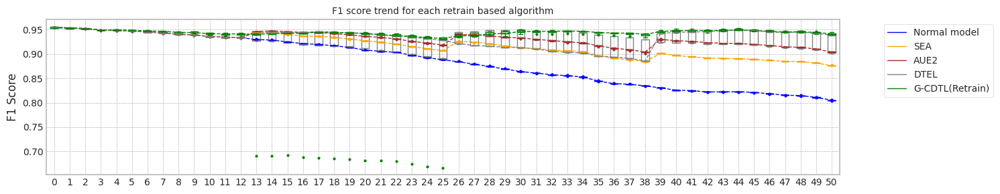

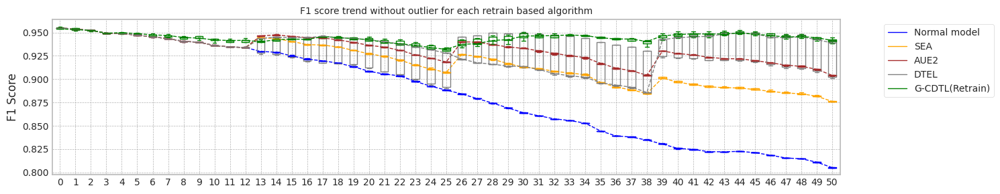

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.182899475097656
Base flops (train + inference flops of normal model, median): 3558735000.0


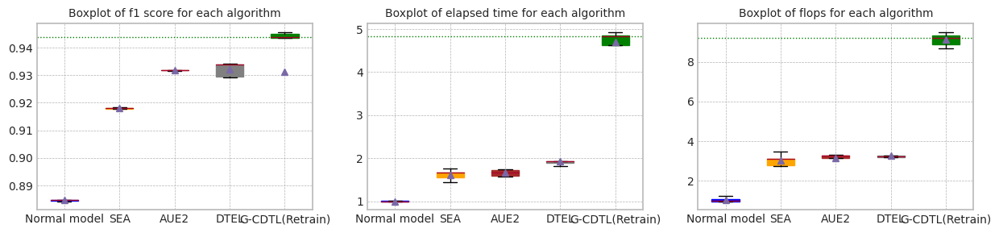

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.182899475097656


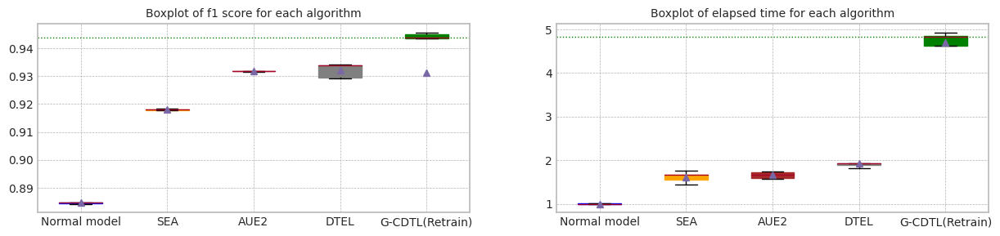

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.022033,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.177904,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.342868,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,10.182899,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.206007,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.182899,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.113982,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.078892,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.126256,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.088734,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.023283,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.156170,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.088734,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.050399,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.918072,0.876407,17.900890,5.574525e+09,6.799920e+09,1.237444e+10
1,1.0,0.954396,0.953533,0.917786,0.875661,14.728717,4.733670e+09,5.050785e+09,9.784455e+09
2,2.0,0.954834,0.953377,0.918437,0.877427,15.879663,5.057310e+09,4.787175e+09,9.844485e+09
3,3.0,0.954910,0.953454,0.917904,0.875834,16.885327,5.283945e+09,5.753745e+09,1.103769e+10
4,4.0,0.954901,0.953539,0.917648,0.876033,16.990868,5.156055e+09,5.852925e+09,1.100898e+10
5,median,0.954901,0.953533,0.917904,0.876033,16.885327,5.156055e+09,5.753745e+09,1.100898e+10
6,std,0.000235,0.000094,0.000304,0.000703,1.211565,3.080200e+08,7.870478e+08,1.063354e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.931488,0.904818,15.986174,5.097765e+09,6.522825e+09,1.162059e+10
1,1.0,0.954396,0.953533,0.931870,0.903994,17.015388,5.337885e+09,5.854665e+09,1.119255e+10
2,2.0,0.954834,0.953377,0.931634,0.903248,16.199511,5.052525e+09,4.982055e+09,1.003458e+10
3,3.0,0.954910,0.953454,0.931744,0.903671,17.803460,5.464035e+09,6.133500e+09,1.159754e+10
4,4.0,0.954901,0.953539,0.931898,0.904573,17.638045,5.425755e+09,6.322290e+09,1.174804e+10
5,median,0.954901,0.953533,0.931744,0.903994,17.015388,5.337885e+09,6.133500e+09,1.159754e+10
6,std,0.000235,0.000094,0.000170,0.000643,0.820969,1.892891e+08,6.011558e+08,7.046399e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.933878,0.941417,21.103892,6.401895e+09,6.900405e+09,1.330230e+10
1,1.0,0.954396,0.953533,0.934099,0.941176,19.734029,6.036930e+09,5.492310e+09,1.152924e+10
2,2.0,0.954834,0.953377,0.929174,0.901115,18.486993,5.671095e+09,4.531395e+09,1.020249e+10
3,3.0,0.954910,0.953454,0.933699,0.938717,19.217057,5.830740e+09,5.828130e+09,1.165887e+10
4,4.0,0.954901,0.953539,0.929485,0.902415,19.710184,5.903385e+09,5.484045e+09,1.138743e+10
5,median,0.954901,0.953533,0.933699,0.938717,19.710184,5.903385e+09,5.492310e+09,1.152924e+10
6,std,0.000235,0.000094,0.002505,0.021213,0.957145,2.757630e+08,8.513063e+08,1.107162e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.943428,0.942167,50.219284,3.371437e+10,107460000.0,3.382183e+10
1,1.0,0.953787,0.952034,0.943876,0.937923,49.172370,3.304780e+10,107460000.0,3.315526e+10
2,2.0,0.953612,0.952352,0.944782,0.940140,49.413489,3.267880e+10,107460000.0,3.278626e+10
3,3.0,0.956214,0.954604,0.878499,0.941448,43.176471,3.074948e+10,107460000.0,3.085694e+10
4,4.0,0.955650,0.954514,0.945615,0.944431,47.028177,3.145987e+10,107460000.0,3.156733e+10
5,median,0.953868,0.953043,0.943876,0.941448,49.172370,3.267880e+10,107460000.0,3.278626e+10
6,std,0.001212,0.001198,0.029495,0.002413,2.842200,1.205046e+09,0.0,1.205046e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 14:14:55,363] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 393.57it/s]

Early stop: 1050
[2023-11-29 14:14:58,487] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.97it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:15:08,854] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:15:08,856] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:12, 125.78it/s]

[2023-11-29 14:15:23,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:15:23,149] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.94it/s]

mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 14:15:33,582] [INFO] [profiler.py:80:start_profile] Flops profiler started



 41%|████      | 818/2000 [00:02<00:03, 384.42it/s]

Early stop: 818
[2023-11-29 14:15:35,716] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:15:45,936] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:15:45,938] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 423/2000 [00:03<00:12, 121.99it/s]

[2023-11-29 14:16:00,215] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:16:00,217] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.93it/s]

mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 14:16:10,671] [INFO] [profiler.py:80:start_profile] Flops profiler started



 33%|███▎      | 668/2000 [00:01<00:03, 379.05it/s]

Early stop: 668
[2023-11-29 14:16:12,442] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.82it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:16:23,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:16:23,134] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:04<00:12, 118.01it/s]

[2023-11-29 14:16:27,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:16:27,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.93it/s]

mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 14:16:37,842] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 857/2000 [00:02<00:03, 379.50it/s]

Early stop: 857
[2023-11-29 14:16:40,106] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.15it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:16:50,112] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:16:50,115] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:03<00:13, 121.09it/s]

[2023-11-29 14:17:04,501] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:17:04,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.01it/s]

mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 14:17:14,791] [INFO] [profiler.py:80:start_profile] Flops profiler started



 46%|████▌     | 915/2000 [00:02<00:02, 385.82it/s]

Early stop: 915
[2023-11-29 14:17:17,169] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.02it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:17:27,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:17:27,441] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:03<00:13, 120.39it/s]

[2023-11-29 14:17:35,041] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:17:35,042] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.05it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:17:47,518] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:17:47,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:18:05,725] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:05,726] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:20<03:50,  5.77s/it]

G-CDTL train flops: 3500000000 1720250000 427605000 5647855000


 41%|████      | 21/51 [00:22<00:10,  2.83it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:18:07,956] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:18:07,958] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:18:22,473] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:22,474] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:37<02:15,  4.67s/it]

G-CDTL train flops: 3500000000 918750000 228375000 4647125000


 63%|██████▎   | 32/51 [00:39<00:06,  3.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:18:24,646] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:18:24,649] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:18:39,246] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:39,248] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:53<01:24,  4.67s/it]

G-CDTL train flops: 3500000000 829500000 206190000 4535690000


 84%|████████▍ | 43/51 [00:55<00:02,  3.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:18:41,455] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:18:41,458] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:18:57,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:57,282] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:11<00:35,  5.04s/it]

G-CDTL train flops: 3500000000 1107750000 275355000 4883105000


100%|██████████| 51/51 [01:13<00:00,  1.44s/it]


Early stop at  [982, 524, 473, 632]
Train flops  [5647855000, 4647125000, 4535690000, 4883105000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9461616724861327
G_CDTL+AUE median: 0.9461616724861327
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:30,  1.31it/s]

Ensemble_SEA train flops: 441090000


 43%|████▎     | 22/51 [00:08<00:23,  1.23it/s]

Ensemble_SEA train flops: 477195000


 65%|██████▍   | 33/51 [00:13<00:21,  1.22s/it]

Ensemble_SEA train flops: 806925000


 86%|████████▋ | 44/51 [00:18<00:05,  1.21it/s]

Ensemble_SEA train flops: 489810000


100%|██████████| 51/51 [00:19<00:00,  2.63it/s]


Early stop at  [1013, 1096, 1854, 1125]
Train flops  [441090000, 477195000, 806925000, 489810000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.919481701929448
SEA median: 0.919481701929448
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:28,  1.40it/s]

Ensemble_SEA train flops: 401070000


 45%|████▌     | 23/51 [00:09<00:27,  1.02it/s]

Ensemble_SEA train flops: 870000000


 65%|██████▍   | 33/51 [00:14<00:15,  1.18it/s]

Ensemble_SEA train flops: 505905000


 88%|████████▊ | 45/51 [00:19<00:04,  1.27it/s]

Ensemble_SEA train flops: 653370000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [921, 1999, 1162, 1501]
Train flops  [401070000, 870000000, 505905000, 653370000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9327503908386474
AUE median: 0.9327503908386474
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:26,  1.48it/s]

Ensemble_DTEL train flops: 382365000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:05<00:06,  4.84it/s]

Ensemble_DTEL train flops: 556365000


 45%|████▌     | 23/51 [00:09<00:26,  1.05it/s]

Ensemble_DTEL train flops: 312330000


 63%|██████▎   | 32/51 [00:11<00:04,  4.36it/s]

Ensemble_DTEL train flops: 361485000


 67%|██████▋   | 34/51 [00:15<00:16,  1.03it/s]

Ensemble_DTEL train flops: 513300000


 86%|████████▋ | 44/51 [00:20<00:08,  1.20s/it]

Ensemble_DTEL train flops: 794745000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:22<00:00,  2.31it/s]


Early stop at  [878, 2, 1278, 717, 830, 1179, 1826, 4]
Train flops  [382365000, 1305000, 556365000, 312330000, 361485000, 513300000, 794745000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9377179514667412
DTEL median: 0.9377179514667412
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  4.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:03,170] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:03,172] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:20:10,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:10,832] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:09<01:42,  2.55s/it]

G-CDTL train flops: 1352750000 742000000 184440000 2279190000


 41%|████      | 21/51 [00:11<00:07,  3.81it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:13,025] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:13,028] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:20:27,449] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:27,450] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:26<02:12,  4.58s/it]

G-CDTL train flops: 3500000000 766500000 190530000 4457030000


 63%|██████▎   | 32/51 [00:28<00:06,  3.03it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:29,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:29,737] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:20:33,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:33,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:32<00:26,  1.49s/it]

G-CDTL train flops: 80500000 819000000 203580000 1103080000


 84%|████████▍ | 43/51 [00:34<00:01,  4.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:35,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:35,932] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:20:51,956] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:51,957] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [00:51<00:35,  5.04s/it]

G-CDTL train flops: 3500000000 1158500000 287970000 4946470000


100%|██████████| 51/51 [00:52<00:00,  1.03s/it]


Early stop at  [423, 437, 467, 661]
Train flops  [2279190000, 4457030000, 1103080000, 4946470000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9450719661147021
G_CDTL+AUE median: 0.9456168193004174
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:35,  1.14it/s]

Ensemble_SEA train flops: 512865000


 45%|████▌     | 23/51 [00:08<00:16,  1.66it/s]

Ensemble_SEA train flops: 440655000


 65%|██████▍   | 33/51 [00:14<00:23,  1.31s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:20<00:05,  1.02it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:21<00:00,  2.36it/s]


Early stop at  [1178, 1012, 1999, 1999]
Train flops  [512865000, 440655000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9198124569345061
SEA median: 0.9196470794319771
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.94it/s]

Ensemble_SEA train flops: 354960000


 43%|████▎     | 22/51 [00:08<00:26,  1.10it/s]

Ensemble_SEA train flops: 556365000


 65%|██████▍   | 33/51 [00:12<00:17,  1.03it/s]

Ensemble_SEA train flops: 598560000


 88%|████████▊ | 45/51 [00:17<00:03,  1.64it/s]

Ensemble_SEA train flops: 457620000


100%|██████████| 51/51 [00:18<00:00,  2.77it/s]


Early stop at  [815, 1278, 1375, 1051]
Train flops  [354960000, 556365000, 598560000, 457620000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9327971490802577
AUE median: 0.9327737699594525
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.07it/s]

Ensemble_DTEL train flops: 404115000


 24%|██▎       | 12/51 [00:04<00:24,  1.60it/s]

Ensemble_DTEL train flops: 65685000


 43%|████▎     | 22/51 [00:08<00:22,  1.31it/s]

Ensemble_DTEL train flops: 443265000
Ensemble_DTEL train flops: 1740000


 63%|██████▎   | 32/51 [00:10<00:03,  4.77it/s]

Ensemble_DTEL train flops: 491115000


 67%|██████▋   | 34/51 [00:13<00:14,  1.17it/s]

Ensemble_DTEL train flops: 259260000


 86%|████████▋ | 44/51 [00:19<00:09,  1.31s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:20<00:00,  2.47it/s]


Early stop at  [928, 150, 1018, 3, 1128, 595, 1999, 3]
Train flops  [404115000, 65685000, 443265000, 1740000, 491115000, 259260000, 870000000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.937862813691693
DTEL median: 0.9377903825792171
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:21:56,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:21:56,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:22:15,137] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:22:15,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:20<03:55,  5.88s/it]

G-CDTL train flops: 3500000000 1632750000 405855000 5538605000


 41%|████      | 21/51 [00:22<00:10,  2.78it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:22:17,367] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:22:17,370] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:22:35,715] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:22:35,716] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:41<02:48,  5.82s/it]

G-CDTL train flops: 3500000000 1534750000 381495000 5416245000


 63%|██████▎   | 32/51 [00:43<00:06,  2.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:22:37,969] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:22:37,971] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:22:52,804] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:22:52,806] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:58<01:25,  4.77s/it]

G-CDTL train flops: 3500000000 841750000 209235000 4550985000


 84%|████████▍ | 43/51 [01:00<00:02,  3.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:22:54,973] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:22:54,976] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:23:11,443] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:23:11,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:17<00:36,  5.23s/it]

G-CDTL train flops: 3500000000 1162000000 288840000 4950840000


100%|██████████| 51/51 [01:18<00:00,  1.54s/it]


Early stop at  [932, 876, 480, 663]
Train flops  [5538605000, 5416245000, 4550985000, 4950840000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9453300965844081
G_CDTL+AUE median: 0.9453300965844081
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:23,  1.67it/s]

Ensemble_SEA train flops: 453270000


 45%|████▌     | 23/51 [00:07<00:14,  1.93it/s]

Ensemble_SEA train flops: 350175000


 65%|██████▍   | 33/51 [00:13<00:23,  1.32s/it]

Ensemble_SEA train flops: 870000000


 86%|████████▋ | 44/51 [00:19<00:09,  1.33s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:20<00:00,  2.43it/s]


Early stop at  [1041, 804, 1999, 1999]
Train flops  [453270000, 350175000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9197389817323876
SEA median: 0.9197389817323876
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:19,  2.01it/s]

Ensemble_SEA train flops: 327990000


 43%|████▎     | 22/51 [00:07<00:17,  1.67it/s]

Ensemble_SEA train flops: 314070000


 67%|██████▋   | 34/51 [00:13<00:16,  1.02it/s]

Ensemble_SEA train flops: 870000000


 86%|████████▋ | 44/51 [00:16<00:04,  1.53it/s]

Ensemble_SEA train flops: 344085000


100%|██████████| 51/51 [00:18<00:00,  2.83it/s]


Early stop at  [753, 721, 1999, 790]
Train flops  [327990000, 314070000, 870000000, 344085000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9326758142954855
AUE median: 0.9327503908386474
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:26,  1.49it/s]

Ensemble_DTEL train flops: 353220000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:05<00:06,  4.76it/s]

Ensemble_DTEL train flops: 599430000


 45%|████▌     | 23/51 [00:09<00:26,  1.07it/s]

Ensemble_DTEL train flops: 211845000


 65%|██████▍   | 33/51 [00:15<00:23,  1.30s/it]

Ensemble_DTEL train flops: 841725000
Ensemble_DTEL train flops: 1740000


 84%|████████▍ | 43/51 [00:17<00:01,  4.21it/s]

Ensemble_DTEL train flops: 673815000


 86%|████████▋ | 44/51 [00:20<00:08,  1.26s/it]

Ensemble_DTEL train flops: 148335000


100%|██████████| 51/51 [00:22<00:00,  2.29it/s]


Early stop at  [811, 2, 1377, 486, 1934, 3, 1548, 340]
Train flops  [353220000, 1305000, 599430000, 211845000, 841725000, 1740000, 673815000, 148335000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9353471859042098
DTEL median: 0.9377179514667412
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:24:16,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:24:16,580] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:24:26,507] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:24:26,508] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:12<02:09,  3.24s/it]

G-CDTL train flops: 1832250000 876750000 217935000 2926935000


 41%|████      | 21/51 [00:14<00:08,  3.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:24:28,702] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:24:28,705] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:24:43,566] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:24:43,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:29<02:16,  4.72s/it]

G-CDTL train flops: 3500000000 766500000 190530000 4457030000


 63%|██████▎   | 32/51 [00:31<00:06,  3.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:24:45,730] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:24:45,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:25:00,665] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:25:00,667] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:46<01:25,  4.77s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


 84%|████████▍ | 43/51 [00:48<00:02,  2.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:25:02,951] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:25:02,954] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:25:26,246] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:25:26,247] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:11<00:51,  7.29s/it]

G-CDTL train flops: 3500000000 2528750000 628575000 6657325000


100%|██████████| 51/51 [01:13<00:00,  1.44s/it]


Early stop at  [500, 437, 438, 1444]
Train flops  [2926935000, 4457030000, 4459215000, 6657325000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9454169619202467
G_CDTL+AUE median: 0.9453735292523274
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:29,  1.35it/s]

Ensemble_SEA train flops: 404115000


 43%|████▎     | 22/51 [00:08<00:21,  1.34it/s]

Ensemble_SEA train flops: 411945000


 65%|██████▍   | 33/51 [00:12<00:16,  1.08it/s]

Ensemble_SEA train flops: 557670000


 88%|████████▊ | 45/51 [00:18<00:05,  1.13it/s]

Ensemble_SEA train flops: 753420000


100%|██████████| 51/51 [00:19<00:00,  2.62it/s]


Early stop at  [928, 946, 1281, 1731]
Train flops  [404115000, 411945000, 557670000, 753420000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9200432183097969
SEA median: 0.9197757193334468
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.88it/s]

Ensemble_SEA train flops: 374100000


 45%|████▌     | 23/51 [00:08<00:17,  1.59it/s]

Ensemble_SEA train flops: 460230000


 65%|██████▍   | 33/51 [00:12<00:13,  1.30it/s]

Ensemble_SEA train flops: 425865000


 88%|████████▊ | 45/51 [00:18<00:05,  1.03it/s]

Ensemble_SEA train flops: 848685000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [859, 1057, 978, 1950]
Train flops  [374100000, 460230000, 425865000, 848685000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9326125619204165
AUE median: 0.9327131025670665
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:28,  1.42it/s]

Ensemble_DTEL train flops: 381495000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:05<00:06,  4.77it/s]

Ensemble_DTEL train flops: 455445000


 45%|████▌     | 23/51 [00:09<00:22,  1.24it/s]

Ensemble_DTEL train flops: 210975000


 63%|██████▎   | 32/51 [00:10<00:04,  4.57it/s]

Ensemble_DTEL train flops: 753420000


 65%|██████▍   | 33/51 [00:15<00:29,  1.62s/it]

Ensemble_DTEL train flops: 358005000


 86%|████████▋ | 44/51 [00:21<00:08,  1.19s/it]

Ensemble_DTEL train flops: 733410000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:22<00:00,  2.26it/s]


Early stop at  [876, 2, 1046, 484, 1731, 822, 1685, 4]
Train flops  [381495000, 1305000, 455445000, 210975000, 753420000, 358005000, 733410000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9379586400970118
DTEL median: 0.9377903825792171
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  4.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:26:31,493] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:26:31,495] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:26:48,412] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:26:48,413] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:19<03:35,  5.38s/it]

G-CDTL train flops: 2220750000 2049250000 509385000 4779385000


 41%|████      | 21/51 [00:21<00:10,  2.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:26:50,635] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:26:50,638] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:27:05,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:27:05,660] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:36<02:19,  4.81s/it]

G-CDTL train flops: 3500000000 717500000 178350000 4395850000


 63%|██████▎   | 32/51 [00:38<00:06,  3.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:27:07,884] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:27:07,887] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:27:16,443] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:27:16,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:47<00:51,  2.86s/it]

G-CDTL train flops: 57750000 1786750000 444135000 2288635000


 84%|████████▍ | 43/51 [00:49<00:02,  3.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:27:18,668] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:27:18,671] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:27:34,116] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:27:34,117] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:04<00:34,  4.89s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


100%|██████████| 51/51 [01:06<00:00,  1.30s/it]


Early stop at  [1170, 409, 1020, 454]
Train flops  [4779385000, 4395850000, 2288635000, 4494175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.946085450408646
G_CDTL+AUE median: 0.9454169619202467
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:19,  2.02it/s]

Ensemble_SEA train flops: 316245000


 45%|████▌     | 23/51 [00:07<00:14,  2.00it/s]

Ensemble_SEA train flops: 328860000


 67%|██████▋   | 34/51 [00:13<00:16,  1.01it/s]

Ensemble_SEA train flops: 860865000


 86%|████████▋ | 44/51 [00:18<00:09,  1.33s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [726, 755, 1978, 1999]
Train flops  [316245000, 328860000, 860865000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9193229763724821
SEA median: 0.9197389817323876
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:31,  1.28it/s]

Ensemble_SEA train flops: 429345000


 43%|████▎     | 22/51 [00:10<00:39,  1.35s/it]

Ensemble_SEA train flops: 870000000


 65%|██████▍   | 33/51 [00:15<00:22,  1.27s/it]

Ensemble_SEA train flops: 798660000


 88%|████████▊ | 45/51 [00:21<00:04,  1.22it/s]

Ensemble_SEA train flops: 667725000


100%|██████████| 51/51 [00:22<00:00,  2.29it/s]


Early stop at  [986, 1999, 1835, 1534]
Train flops  [429345000, 870000000, 798660000, 667725000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9332027464737733
AUE median: 0.9327503908386474
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:05<00:53,  1.35s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:07<00:07,  4.27it/s]

Ensemble_DTEL train flops: 409770000


 45%|████▌     | 23/51 [00:11<00:26,  1.05it/s]

Ensemble_DTEL train flops: 388455000


 63%|██████▎   | 32/51 [00:13<00:04,  4.37it/s]

Ensemble_DTEL train flops: 849120000


 65%|██████▍   | 33/51 [00:19<00:31,  1.78s/it]

Ensemble_DTEL train flops: 339300000


 86%|████████▋ | 44/51 [00:24<00:08,  1.23s/it]

Ensemble_DTEL train flops: 765600000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


Early stop at  [1999, 2, 941, 892, 1951, 779, 1759, 3]
Train flops  [870000000, 1305000, 409770000, 388455000, 849120000, 339300000, 765600000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9381988981640609
DTEL median: 0.937862813691693


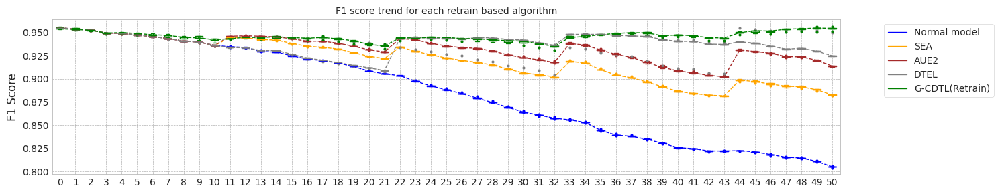

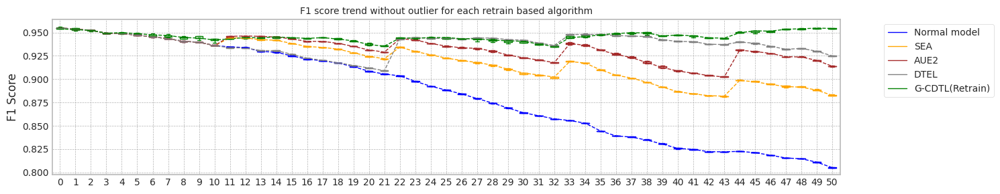

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.252821207046509
Base flops (train + inference flops of normal model, median): 3558735000.0


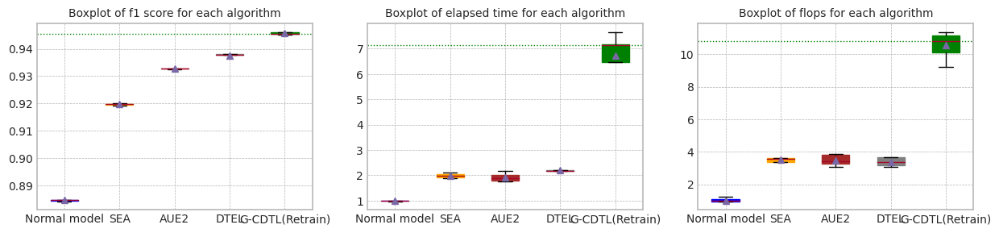

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.252821207046509


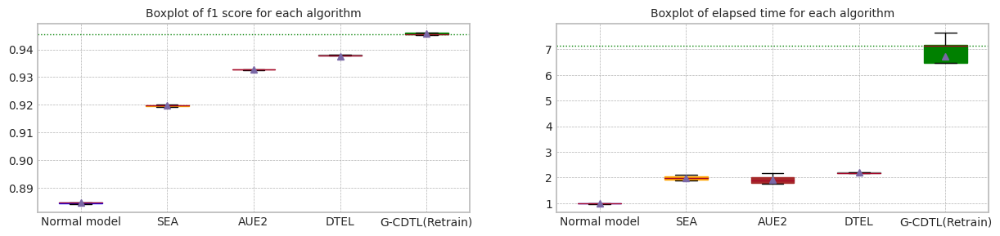

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.349063,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.199574,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.669537,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,9.986040,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.252821,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.252821,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.249739,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.415374,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.429672,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.429888,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.265102,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.188229,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.415374,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.112123,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.919482,0.882543,19.467470,5.801160e+09,7.100940e+09,1.290210e+10
1,1.0,0.954396,0.953533,0.919812,0.882414,21.678966,6.279660e+09,6.671160e+09,1.295082e+10
2,2.0,0.954834,0.953377,0.919739,0.882997,21.058708,6.129585e+09,5.933835e+09,1.206342e+10
3,3.0,0.954910,0.953454,0.920043,0.883587,19.524386,5.713290e+09,6.257475e+09,1.197076e+10
4,4.0,0.954901,0.953539,0.919323,0.881500,20.452673,5.962110e+09,6.733365e+09,1.269548e+10
5,median,0.954901,0.953533,0.919739,0.882543,20.452673,5.962110e+09,6.671160e+09,1.269548e+10
6,std,0.000235,0.000094,0.000283,0.000771,0.962042,2.321473e+08,4.518022e+08,4.670282e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.932750,0.913781,20.507080,6.016485e+09,7.515930e+09,1.353242e+10
1,1.0,0.954396,0.953533,0.932797,0.914057,18.499949,5.553645e+09,6.144810e+09,1.169846e+10
2,2.0,0.954834,0.953377,0.932676,0.913197,18.091380,5.442285e+09,5.446200e+09,1.088848e+10
3,3.0,0.954910,0.953454,0.932613,0.913493,19.392268,5.695020e+09,6.438870e+09,1.213389e+10
4,4.0,0.954901,0.953539,0.933203,0.914393,22.358363,6.351870e+09,7.322790e+09,1.367466e+10
5,median,0.954901,0.953533,0.932750,0.913781,19.392268,5.695020e+09,6.438870e+09,1.213389e+10
6,std,0.000235,0.000094,0.000232,0.000468,1.718749,3.709429e+08,8.547390e+08,1.199348e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.937718,0.924729,22.142631,6.510210e+09,6.541095e+09,1.305130e+10
1,1.0,0.954396,0.953533,0.937863,0.925362,20.736035,6.123060e+09,5.207385e+09,1.133044e+10
2,2.0,0.954834,0.953377,0.935347,0.949569,22.307747,6.417555e+09,4.458750e+09,1.087630e+10
3,3.0,0.954910,0.953454,0.937959,0.924692,22.606522,6.482370e+09,5.467515e+09,1.194988e+10
4,4.0,0.954901,0.953539,0.938199,0.924839,26.021426,7.211430e+09,5.885115e+09,1.309654e+10
5,median,0.954901,0.953533,0.937863,0.924839,22.307747,6.482370e+09,5.467515e+09,1.194988e+10
6,std,0.000235,0.000094,0.001170,0.011033,1.958477,4.010799e+08,7.749768e+08,1.000327e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.946162,0.954473,73.459345,3.964846e+10,62685000.0,3.971114e+10
1,1.0,0.953787,0.952034,0.945072,0.953660,52.532340,3.272046e+10,62685000.0,3.278314e+10
2,2.0,0.953612,0.952352,0.945330,0.954322,78.579948,4.039136e+10,62685000.0,4.045404e+10
3,3.0,0.956214,0.954604,0.945417,0.950979,73.342231,3.843519e+10,62685000.0,3.849788e+10
4,4.0,0.955650,0.954514,0.946085,0.956009,66.337559,3.589273e+10,62685000.0,3.595542e+10
5,median,0.953868,0.953043,0.945417,0.954322,73.342231,3.843519e+10,62685000.0,3.849788e+10
6,std,0.001212,0.001198,0.000484,0.001840,10.107874,3.132247e+09,0.0,3.132247e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 14:28:50,304] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:03<00:02, 343.70it/s]

Early stop: 1050
[2023-11-29 14:28:53,369] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.00it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:29:03,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:29:03,670] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:13, 112.50it/s]

[2023-11-29 14:29:19,729] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:29:19,732] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.95it/s]

mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 14:29:30,133] [INFO] [profiler.py:80:start_profile] Flops profiler started



 41%|████      | 818/2000 [00:02<00:03, 345.96it/s]

Early stop: 818
[2023-11-29 14:29:32,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:29:42,745] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:29:42,748] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:03<00:14, 108.74it/s]

[2023-11-29 14:29:58,881] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:29:58,882] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.89it/s]


mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 14:30:09,401] [INFO] [profiler.py:80:start_profile] Flops profiler started


 33%|███▎      | 668/2000 [00:01<00:03, 348.58it/s]

Early stop: 668
[2023-11-29 14:30:11,323] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.02it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:30:21,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:30:21,578] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:04<00:14, 107.93it/s]

[2023-11-29 14:30:26,229] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:30:26,231] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.88it/s]

mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 14:30:36,772] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 857/2000 [00:02<00:03, 340.96it/s]

Early stop: 857
[2023-11-29 14:30:39,291] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.06it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:30:49,468] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:30:49,471] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:03<00:14, 107.93it/s]

[2023-11-29 14:31:05,529] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:31:05,530] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.98it/s]

mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 14:31:15,876] [INFO] [profiler.py:80:start_profile] Flops profiler started



 46%|████▌     | 915/2000 [00:02<00:03, 355.60it/s]

Early stop: 915
[2023-11-29 14:31:18,456] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:31:28,680] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:31:28,682] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:03<00:15, 105.83it/s]

[2023-11-29 14:31:37,143] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:31:37,146] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.01it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  4.86it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:31:49,296] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:31:49,298] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:32:08,038] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:32:08,039] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:20<04:14,  6.07s/it]

G-CDTL train flops: 3500000000 1358000000 337560000 5195560000


 33%|███▎      | 17/51 [00:22<00:17,  1.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:32:09,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:32:09,841] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:32:26,254] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:32:26,256] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:38<02:56,  5.36s/it]

G-CDTL train flops: 3500000000 934500000 232290000 4666790000


 51%|█████     | 26/51 [00:40<00:12,  1.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:32:28,106] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:32:28,108] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:32:42,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:32:42,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:54<01:50,  4.61s/it]

G-CDTL train flops: 2864750000 803250000 199665000 3867665000


 69%|██████▊   | 35/51 [00:56<00:07,  2.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:32:43,945] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:32:43,947] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:33:00,756] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:33:00,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:13<01:21,  5.43s/it]

G-CDTL train flops: 3500000000 904750000 224895000 4629645000


 86%|████████▋ | 44/51 [01:14<00:03,  1.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:33:02,601] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:33:02,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:33:29,318] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:33:29,320] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:41<00:50,  8.43s/it]

G-CDTL train flops: 3500000000 2938250000 730365000 7168615000


100%|██████████| 51/51 [01:43<00:00,  2.02s/it]


Early stop at  [775, 533, 458, 516, 1678]
Train flops  [5195560000, 4666790000, 3867665000, 4629645000, 7168615000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9466799064314227
G_CDTL+AUE median: 0.9466799064314227
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:26,  1.53it/s]

Ensemble_SEA train flops: 468060000


 35%|███▌      | 18/51 [00:07<00:23,  1.38it/s]

Ensemble_SEA train flops: 359310000


 53%|█████▎    | 27/51 [00:09<00:06,  3.92it/s]

Ensemble_SEA train flops: 19575000


 71%|███████   | 36/51 [00:14<00:17,  1.16s/it]

Ensemble_SEA train flops: 702090000


 90%|█████████ | 46/51 [00:20<00:05,  1.03s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:21<00:00,  2.40it/s]


Early stop at  [1075, 825, 44, 1613, 1999]
Train flops  [468060000, 359310000, 19575000, 702090000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9160618642678282
SEA median: 0.9160618642678282
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:26,  1.58it/s]

Ensemble_SEA train flops: 451965000


 37%|███▋      | 19/51 [00:07<00:16,  1.92it/s]

Ensemble_SEA train flops: 317985000


 53%|█████▎    | 27/51 [00:11<00:21,  1.14it/s]

Ensemble_SEA train flops: 483285000


 71%|███████   | 36/51 [00:16<00:17,  1.16s/it]

Ensemble_SEA train flops: 685560000


 90%|█████████ | 46/51 [00:21<00:05,  1.03s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.23it/s]


Early stop at  [1038, 730, 1110, 1575, 1999]
Train flops  [451965000, 317985000, 483285000, 685560000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9371662980494386
AUE median: 0.9371662980494386
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:28,  1.48it/s]

Ensemble_DTEL train flops: 337125000
Ensemble_DTEL train flops: 1740000


 33%|███▎      | 17/51 [00:04<00:07,  4.43it/s]

Ensemble_DTEL train flops: 486330000


 37%|███▋      | 19/51 [00:08<00:27,  1.17it/s]

Ensemble_DTEL train flops: 198360000


 53%|█████▎    | 27/51 [00:12<00:23,  1.03it/s]

Ensemble_DTEL train flops: 542445000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:14<00:03,  4.11it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:19<00:17,  1.28s/it]

Ensemble_DTEL train flops: 238815000


 88%|████████▊ | 45/51 [00:24<00:08,  1.34s/it]

Ensemble_DTEL train flops: 788655000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


Early stop at  [774, 3, 1117, 455, 1246, 4, 1999, 548, 1812, 4]
Train flops  [337125000, 1740000, 486330000, 198360000, 542445000, 2175000, 870000000, 238815000, 788655000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9399157840081391
DTEL median: 0.9399157840081391
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:34:42,549] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:34:42,552] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:34:58,865] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:34:58,866] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:18<03:42,  5.30s/it]

G-CDTL train flops: 3500000000 813750000 202275000 4516025000


 33%|███▎      | 17/51 [00:19<00:16,  2.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:00,714] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:00,717] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:35:13,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:35:13,395] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:32<02:19,  4.21s/it]

G-CDTL train flops: 2402750000 834750000 207495000 3444995000


 51%|█████     | 26/51 [00:34<00:10,  2.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:15,212] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:15,215] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:35:31,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:35:31,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:51<02:09,  5.38s/it]

G-CDTL train flops: 3500000000 852250000 211845000 4564095000


 69%|██████▊   | 35/51 [00:52<00:08,  1.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:33,770] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:33,773] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:35:50,309] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:35:50,310] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:09<01:20,  5.37s/it]

G-CDTL train flops: 3500000000 819000000 203580000 4522580000


 86%|████████▋ | 44/51 [01:11<00:03,  2.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:52,086] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:52,089] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:36:10,726] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:36:10,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:29<00:36,  6.00s/it]

G-CDTL train flops: 3500000000 1130500000 281010000 4911510000


100%|██████████| 51/51 [01:31<00:00,  1.79s/it]


Early stop at  [464, 476, 486, 467, 645]
Train flops  [4516025000, 3444995000, 4564095000, 4522580000, 4911510000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9456149878726038
G_CDTL+AUE median: 0.9461474471520133
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:35,  1.19it/s]

Ensemble_SEA train flops: 449790000


 37%|███▋      | 19/51 [00:07<00:17,  1.80it/s]

Ensemble_SEA train flops: 349740000


 53%|█████▎    | 27/51 [00:12<00:27,  1.16s/it]

Ensemble_SEA train flops: 685125000


 71%|███████   | 36/51 [00:17<00:21,  1.44s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:22<00:06,  1.09s/it]

Ensemble_SEA train flops: 597690000


100%|██████████| 51/51 [00:23<00:00,  2.14it/s]


Early stop at  [1033, 803, 1574, 1999, 1373]
Train flops  [449790000, 349740000, 685125000, 870000000, 597690000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9239114389272733
SEA median: 0.9199866515975508
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:23,  1.75it/s]

Ensemble_SEA train flops: 368445000


 37%|███▋      | 19/51 [00:07<00:16,  1.90it/s]

Ensemble_SEA train flops: 331470000


 53%|█████▎    | 27/51 [00:11<00:28,  1.20s/it]

Ensemble_SEA train flops: 720795000


 73%|███████▎  | 37/51 [00:17<00:12,  1.11it/s]

Ensemble_SEA train flops: 716445000


 88%|████████▊ | 45/51 [00:22<00:08,  1.43s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:23<00:00,  2.13it/s]


Early stop at  [846, 761, 1656, 1646, 1999]
Train flops  [368445000, 331470000, 720795000, 716445000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9372155262374571
AUE median: 0.9371909121434479
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:29,  1.42it/s]

Ensemble_DTEL train flops: 347565000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:05<00:07,  4.29it/s]

Ensemble_DTEL train flops: 318855000


 37%|███▋      | 19/51 [00:09<00:32,  1.03s/it]

Ensemble_DTEL train flops: 528525000


 53%|█████▎    | 27/51 [00:14<00:28,  1.20s/it]

Ensemble_DTEL train flops: 699480000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:15<00:04,  3.89it/s]

Ensemble_DTEL train flops: 730365000


 73%|███████▎  | 37/51 [00:20<00:14,  1.06s/it]

Ensemble_DTEL train flops: 127455000


 88%|████████▊ | 45/51 [00:25<00:08,  1.44s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:26<00:00,  1.90it/s]


Early stop at  [798, 2, 732, 1214, 1607, 4, 1678, 292, 1999, 3]
Train flops  [347565000, 1305000, 318855000, 528525000, 699480000, 2175000, 730365000, 127455000, 870000000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9395432897481842
DTEL median: 0.9397295368781617
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.00it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:37:28,642] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:37:28,644] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:37:44,980] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:37:44,982] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:18<03:43,  5.31s/it]

G-CDTL train flops: 3500000000 745500000 185310000 4430810000


 33%|███▎      | 17/51 [00:19<00:16,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:37:46,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:37:46,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:37:57,192] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:37:57,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:30<01:56,  3.53s/it]

G-CDTL train flops: 1813000000 761250000 189225000 2763475000


 51%|█████     | 26/51 [00:32<00:09,  2.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:37:59,070] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:37:59,073] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:38:22,424] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:38:22,426] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:55<02:56,  7.35s/it]

G-CDTL train flops: 3500000000 2084250000 518085000 6102335000


 69%|██████▊   | 35/51 [00:57<00:09,  1.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:38:24,287] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:38:24,290] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:38:41,491] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:38:41,492] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:14<01:24,  5.66s/it]

G-CDTL train flops: 3500000000 820750000 204015000 4524765000


 86%|████████▋ | 44/51 [01:16<00:03,  1.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:38:43,287] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:38:43,290] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:38:49,556] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:38:49,558] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:22<00:13,  2.30s/it]

G-CDTL train flops: 84000000 1139250000 283185000 1506435000


100%|██████████| 51/51 [01:23<00:00,  1.65s/it]


Early stop at  [425, 434, 1190, 468, 650]
Train flops  [4430810000, 2763475000, 6102335000, 4524765000, 1506435000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9455994152293417
G_CDTL+AUE median: 0.9456149878726038
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:35,  1.17it/s]

Ensemble_SEA train flops: 441525000


 35%|███▌      | 18/51 [00:07<00:26,  1.26it/s]

Ensemble_SEA train flops: 400635000


 53%|█████▎    | 27/51 [00:13<00:31,  1.33s/it]

Ensemble_SEA train flops: 791700000


 71%|███████   | 36/51 [00:16<00:12,  1.22it/s]

Ensemble_SEA train flops: 398895000


 88%|████████▊ | 45/51 [00:22<00:08,  1.43s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:23<00:00,  2.13it/s]


Early stop at  [1014, 920, 1819, 916, 1999]
Train flops  [441525000, 400635000, 791700000, 398895000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9236560701249291
SEA median: 0.9236560701249291
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:24,  1.64it/s]

Ensemble_SEA train flops: 407160000


 37%|███▋      | 19/51 [00:08<00:28,  1.13it/s]

Ensemble_SEA train flops: 692520000


 55%|█████▍    | 28/51 [00:12<00:14,  1.56it/s]

Ensemble_SEA train flops: 420210000


 71%|███████   | 36/51 [00:18<00:20,  1.38s/it]

Ensemble_SEA train flops: 821280000


 90%|█████████ | 46/51 [00:21<00:02,  1.74it/s]

Ensemble_SEA train flops: 336690000


100%|██████████| 51/51 [00:22<00:00,  2.24it/s]


Early stop at  [935, 1591, 965, 1887, 773]
Train flops  [407160000, 692520000, 420210000, 821280000, 336690000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9371230937284245
AUE median: 0.9371662980494386
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:05<00:53,  1.27s/it]

Ensemble_DTEL train flops: 737325000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:06<00:08,  3.94it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:13<00:47,  1.49s/it]

Ensemble_DTEL train flops: 436740000


 53%|█████▎    | 27/51 [00:17<00:25,  1.07s/it]

Ensemble_DTEL train flops: 575940000
Ensemble_DTEL train flops: 1740000


 69%|██████▊   | 35/51 [00:18<00:03,  4.09it/s]

Ensemble_DTEL train flops: 870000000


 71%|███████   | 36/51 [00:24<00:26,  1.74s/it]

Ensemble_DTEL train flops: 197925000


 88%|████████▊ | 45/51 [00:29<00:07,  1.31s/it]

Ensemble_DTEL train flops: 752985000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:30<00:00,  1.66it/s]


Early stop at  [1694, 2, 1999, 1003, 1323, 3, 1999, 454, 1730, 3]
Train flops  [737325000, 1305000, 870000000, 436740000, 575940000, 1740000, 870000000, 197925000, 752985000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9394964950857437
DTEL median: 0.9395432897481842
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:40:10,163] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:40:10,165] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:40:32,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:40:32,771] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:24<05:05,  7.27s/it]

G-CDTL train flops: 3500000000 1895250000 471105000 5866355000


 33%|███▎      | 17/51 [00:25<00:20,  1.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:40:34,598] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:40:34,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:40:51,337] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:40:51,338] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:43<02:05,  3.91s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


 51%|█████     | 26/51 [00:44<00:12,  1.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:40:53,137] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:40:53,140] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:41:10,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:41:10,898] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:02<02:17,  5.75s/it]

G-CDTL train flops: 3500000000 899500000 223590000 4623090000


 69%|██████▊   | 35/51 [01:04<00:08,  1.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:41:12,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:41:12,670] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:41:17,404] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:41:17,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:09<00:27,  1.84s/it]

G-CDTL train flops: 78750000 841750000 209235000 1129735000


 86%|████████▋ | 44/51 [01:10<00:02,  3.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:41:19,180] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:41:19,182] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:41:44,252] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:41:44,253] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:35<00:46,  7.79s/it]

G-CDTL train flops: 3500000000 2278500000 566370000 6344870000


100%|██████████| 51/51 [01:37<00:00,  1.90s/it]


Early stop at  [1082, 438, 513, 480, 1301]
Train flops  [5866355000, 4459215000, 4623090000, 1129735000, 6344870000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9466776060387235
G_CDTL+AUE median: 0.9461462969556637
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:12,  3.37it/s]

Ensemble_SEA train flops: 93090000


 37%|███▋      | 19/51 [00:06<00:19,  1.67it/s]

Ensemble_SEA train flops: 401505000


 55%|█████▍    | 28/51 [00:10<00:15,  1.47it/s]

Ensemble_SEA train flops: 475020000


 71%|███████   | 36/51 [00:14<00:15,  1.01s/it]

Ensemble_SEA train flops: 553755000


 88%|████████▊ | 45/51 [00:19<00:08,  1.35s/it]

Ensemble_SEA train flops: 779955000


100%|██████████| 51/51 [00:21<00:00,  2.42it/s]


Early stop at  [213, 922, 1091, 1272, 1792]
Train flops  [93090000, 401505000, 475020000, 553755000, 779955000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9278383908291034
SEA median: 0.9237837545261012
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:26,  1.54it/s]

Ensemble_SEA train flops: 447180000


 35%|███▌      | 18/51 [00:09<00:47,  1.45s/it]

Ensemble_SEA train flops: 870000000


 55%|█████▍    | 28/51 [00:13<00:13,  1.74it/s]

Ensemble_SEA train flops: 345390000


 71%|███████   | 36/51 [00:19<00:21,  1.44s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:24<00:08,  1.47s/it]

Ensemble_SEA train flops: 849120000


100%|██████████| 51/51 [00:26<00:00,  1.95it/s]


Early stop at  [1027, 1999, 793, 1999, 1951]
Train flops  [447180000, 870000000, 345390000, 870000000, 849120000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9366439146729932
AUE median: 0.9371446958889316
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:34,  1.22it/s]

Ensemble_DTEL train flops: 423690000
Ensemble_DTEL train flops: 1740000


 33%|███▎      | 17/51 [00:05<00:07,  4.32it/s]

Ensemble_DTEL train flops: 621180000


 35%|███▌      | 18/51 [00:10<00:55,  1.68s/it]

Ensemble_DTEL train flops: 406725000


 53%|█████▎    | 27/51 [00:14<00:23,  1.03it/s]

Ensemble_DTEL train flops: 507210000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:16<00:03,  4.19it/s]

Ensemble_DTEL train flops: 663375000


 71%|███████   | 36/51 [00:20<00:22,  1.49s/it]

Ensemble_DTEL train flops: 243165000


 88%|████████▊ | 45/51 [00:26<00:08,  1.49s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:27<00:00,  1.84it/s]


Early stop at  [973, 3, 1427, 934, 1165, 4, 1524, 558, 1999, 4]
Train flops  [423690000, 1740000, 621180000, 406725000, 507210000, 2175000, 663375000, 243165000, 870000000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9399886113795578
DTEL median: 0.9397295368781617
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  4.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:02,512] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:02,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:43:08,701] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:08,702] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:08<01:29,  2.14s/it]

G-CDTL train flops: 119000000 1058750000 263175000 1440925000


 33%|███▎      | 17/51 [00:09<00:10,  3.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:10,563] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:10,566] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:43:27,378] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:27,379] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:26<02:55,  5.33s/it]

G-CDTL train flops: 3500000000 708750000 176175000 4384925000


 51%|█████     | 26/51 [00:28<00:12,  2.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:29,188] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:29,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:43:47,135] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:47,136] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:46<02:19,  5.79s/it]

G-CDTL train flops: 3500000000 890750000 221415000 4612165000


 69%|██████▊   | 35/51 [00:48<00:08,  1.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:48,940] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:48,942] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:43:59,978] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:59,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:59<00:56,  3.74s/it]

G-CDTL train flops: 78750000 1953000000 485460000 2517210000


 86%|████████▋ | 44/51 [01:00<00:02,  2.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:44:01,843] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:44:01,846] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:44:25,892] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:44:25,894] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:25<00:45,  7.57s/it]

G-CDTL train flops: 3500000000 2045750000 508515000 6054265000


100%|██████████| 51/51 [01:26<00:00,  1.69s/it]


Early stop at  [604, 404, 508, 1115, 1168]
Train flops  [1440925000, 4384925000, 4612165000, 2517210000, 6054265000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.945532866096554
G_CDTL+AUE median: 0.9456149878726038
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:32,  1.28it/s]

Ensemble_SEA train flops: 382800000


 35%|███▌      | 18/51 [00:06<00:20,  1.58it/s]

Ensemble_SEA train flops: 282315000


 53%|█████▎    | 27/51 [00:10<00:21,  1.12it/s]

Ensemble_SEA train flops: 466320000


 73%|███████▎  | 37/51 [00:15<00:11,  1.25it/s]

Ensemble_SEA train flops: 587685000


 90%|█████████ | 46/51 [00:21<00:05,  1.01s/it]

Ensemble_SEA train flops: 789090000


100%|██████████| 51/51 [00:22<00:00,  2.30it/s]


Early stop at  [879, 648, 1071, 1350, 1813]
Train flops  [382800000, 282315000, 466320000, 587685000, 789090000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9239543469848055
SEA median: 0.9239114389272733
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:19,  2.08it/s]

Ensemble_SEA train flops: 283185000


 37%|███▋      | 19/51 [00:06<00:16,  1.98it/s]

Ensemble_SEA train flops: 297975000


 53%|█████▎    | 27/51 [00:10<00:23,  1.03it/s]

Ensemble_SEA train flops: 513735000


 71%|███████   | 36/51 [00:15<00:18,  1.20s/it]

Ensemble_SEA train flops: 671640000


 90%|█████████ | 46/51 [00:21<00:05,  1.10s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.24it/s]


Early stop at  [650, 684, 1180, 1543, 1999]
Train flops  [283185000, 297975000, 513735000, 671640000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9372900132714719
AUE median: 0.9371662980494386
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:21,  1.87it/s]

Ensemble_DTEL train flops: 325815000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:04<00:07,  4.54it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:09<00:37,  1.16s/it]

Ensemble_DTEL train flops: 92220000


 53%|█████▎    | 27/51 [00:15<00:36,  1.52s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:17<00:04,  3.67it/s]

Ensemble_DTEL train flops: 469365000


 73%|███████▎  | 37/51 [00:20<00:12,  1.11it/s]

Ensemble_DTEL train flops: 191835000


 88%|████████▊ | 45/51 [00:26<00:08,  1.47s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:27<00:00,  1.84it/s]


Early stop at  [748, 2, 1999, 211, 1999, 4, 1078, 440, 1999, 4]
Train flops  [325815000, 1305000, 870000000, 92220000, 870000000, 2175000, 469365000, 191835000, 870000000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9396315743074272
DTEL median: 0.9396315743074272


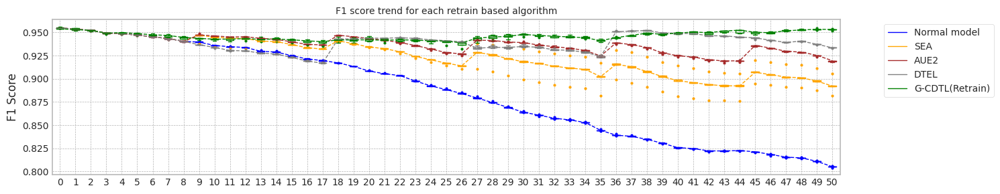

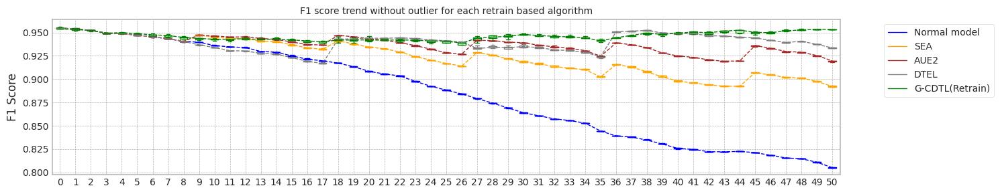

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.21947169303894
Base flops (train + inference flops of normal model, median): 3558735000.0


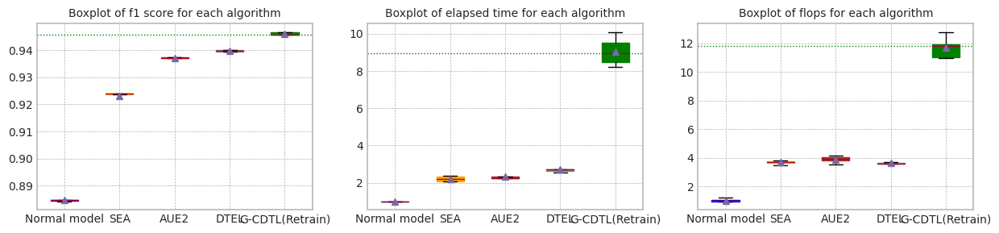

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.21947169303894


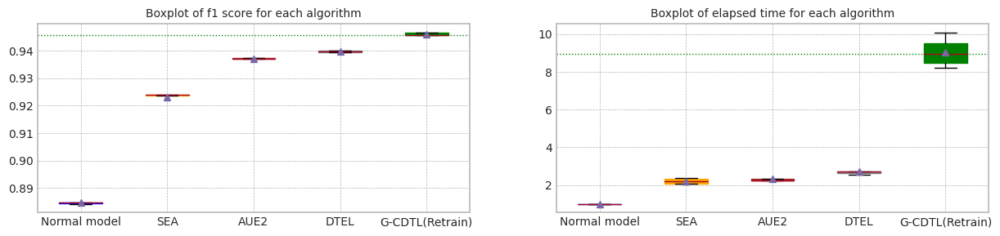

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.279109,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.219472,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.230561,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,10.154500,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.203157,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.219472,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.045124,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.377592,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.496662,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.520150,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.322227,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.249926,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.377592,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.114705,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.916062,0.882002,21.279801,6.005175e+09,7.406745e+09,1.341192e+10
1,1.0,0.954396,0.953533,0.923911,0.892155,23.949814,6.538485e+09,7.031775e+09,1.357026e+10
2,2.0,0.954834,0.953377,0.923656,0.891820,23.997845,6.488895e+09,6.394935e+09,1.288383e+10
3,3.0,0.954910,0.953454,0.927838,0.905471,21.179178,5.889465e+09,6.535440e+09,1.242490e+10
4,4.0,0.954901,0.953539,0.923954,0.892774,22.291913,6.094350e+09,6.967395e+09,1.306174e+10
5,median,0.954901,0.953533,0.923911,0.892155,22.291913,6.094350e+09,6.967395e+09,1.306174e+10
6,std,0.000235,0.000094,0.004292,0.008345,1.379708,2.930570e+08,4.066115e+08,4.522286e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.937166,0.919556,22.937123,6.394935e+09,7.996170e+09,1.439110e+10
1,1.0,0.954396,0.953533,0.937216,0.919665,23.976489,6.593295e+09,7.286250e+09,1.387954e+10
2,2.0,0.954834,0.953377,0.937123,0.918887,22.817782,6.264000e+09,6.369705e+09,1.263370e+10
3,3.0,0.954910,0.953454,0.936644,0.918153,26.246580,6.967830e+09,7.813470e+09,1.478130e+10
4,4.0,0.954901,0.953539,0.937290,0.919556,22.890305,6.222675e+09,7.295385e+09,1.351806e+10
5,median,0.954901,0.953533,0.937166,0.919556,22.937123,6.394935e+09,7.295385e+09,1.387954e+10
6,std,0.000235,0.000094,0.000256,0.000644,1.462044,3.043669e+08,6.325230e+08,8.291738e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.939916,0.933431,25.909458,7.053960e+09,6.149160e+09,1.320312e+10
1,1.0,0.954396,0.953533,0.939543,0.933464,26.853448,7.213605e+09,5.540160e+09,1.275376e+10
2,2.0,0.954834,0.953377,0.939496,0.933005,30.723142,8.031840e+09,4.814145e+09,1.284598e+10
3,3.0,0.954910,0.953454,0.939989,0.933726,27.735462,7.327575e+09,5.687625e+09,1.301520e+10
4,4.0,0.954901,0.953539,0.939632,0.933627,27.740042,7.281030e+09,5.548425e+09,1.282946e+10
5,median,0.954901,0.953533,0.939632,0.933464,27.735462,7.281030e+09,5.548425e+09,1.284598e+10
6,std,0.000235,0.000094,0.000223,0.000277,1.804324,3.779601e+08,4.794511e+08,1.803323e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.946680,0.951767,103.134616,4.546296e+10,53730000.0,4.551669e+10
1,1.0,0.953787,0.952034,0.945615,0.953146,91.259824,4.189389e+10,53730000.0,4.194762e+10
2,2.0,0.953612,0.952352,0.945599,0.953296,84.053945,3.926250e+10,53730000.0,3.931624e+10
3,3.0,0.956214,0.954604,0.946678,0.953127,97.108954,4.235795e+10,53730000.0,4.241168e+10
4,4.0,0.955650,0.954514,0.945533,0.954077,86.503912,3.894418e+10,53730000.0,3.899790e+10
5,median,0.953868,0.953043,0.945615,0.953146,91.259824,4.189389e+10,53730000.0,4.194762e+10
6,std,0.001212,0.001198,0.000601,0.000832,7.796249,2.650442e+09,0.0,2.650442e+09


Test F1 Score: 0.9548057650842703
G-CDTL, 1-retrain: 0.9363882679917808


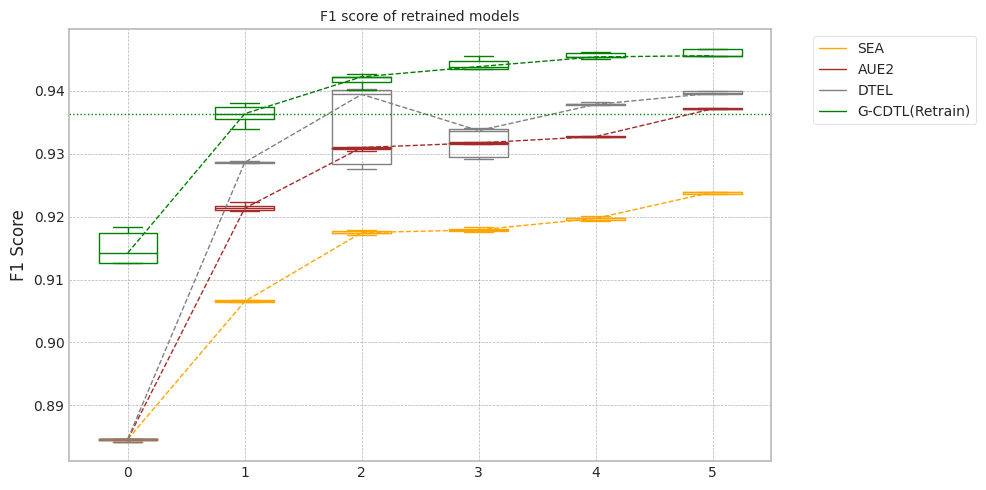

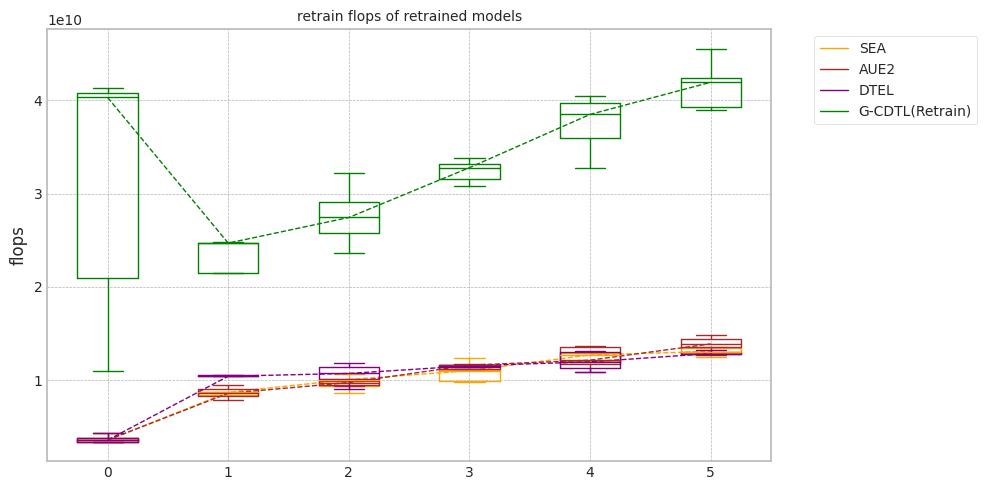

In [ ]:
experiment_all(2000,'case3',X1, Y1,train_size, test_size,avaible_range = 300,
               lambda_f2=0.8,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

## synthetic data의 생성 (Case #4 MI의 고정, Drift의 증가)

+ $P_t(y|X) = P_{t+w}(y|X)$ and $P_t(X) \ne P_{t+w}(X)$
+ Virtual Drift
+ 즉, Concept (본 Dataset에서 MI의 변화)의 변화는 없고, P(X)만 변함.

### Dataset 준비

In [ ]:
seed_everything()

data_size = 60000
cor = np.asarray([1.5, 1.2, 0.9 , 0.7, 0.5])

y3= (np.random.normal(0.5,0.5,data_size) > 0.5).astype(int)
x3 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    '''
    x3[:,ix] = y3 + np.random.normal(1,cor_,data_size)
    '''
    # z0
    if ix == 4:
        for ii in range(len(y3)):
            x3[ii,ix] = y3[ii] + np.random.normal(0.0 + 2*ii/data_size,cor_)
    else:
        x3[:,ix] = y3 + np.random.normal(1,cor_,data_size)

### 실험

MI Analysis MI Max 0.20631, Min 0.04921, Mean 0.12983, Std 0.05780
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:09<00:00,  5.54it/s]


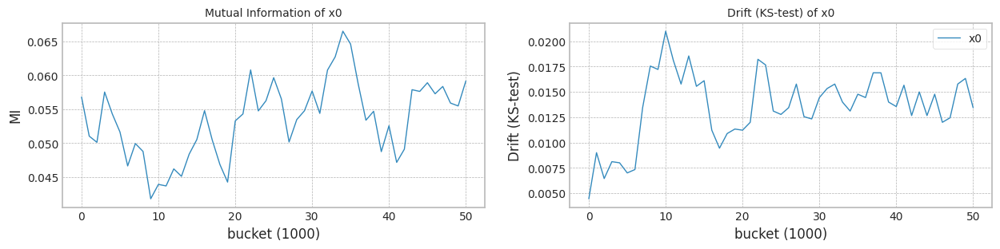

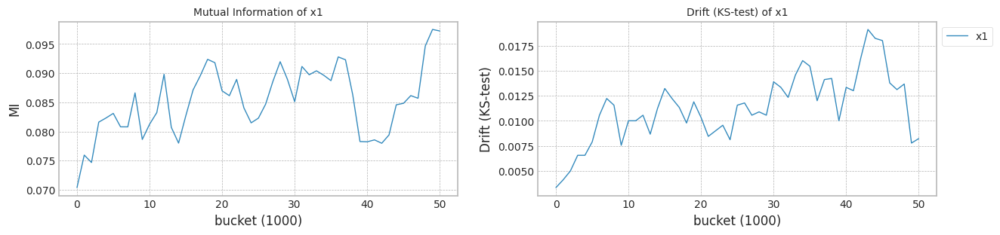

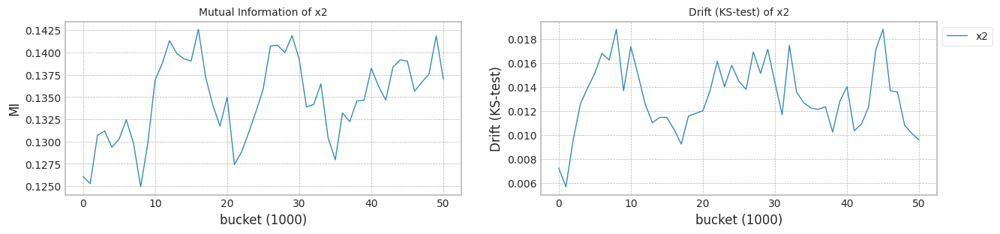

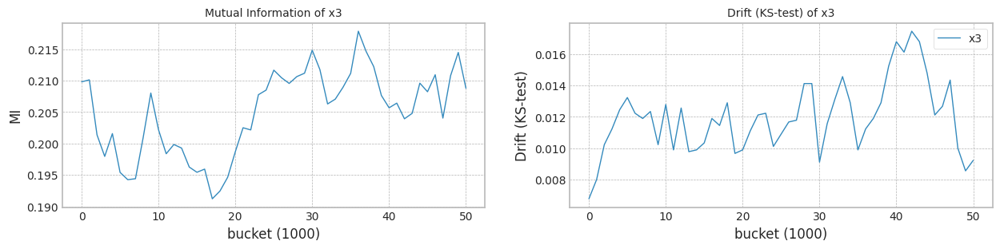

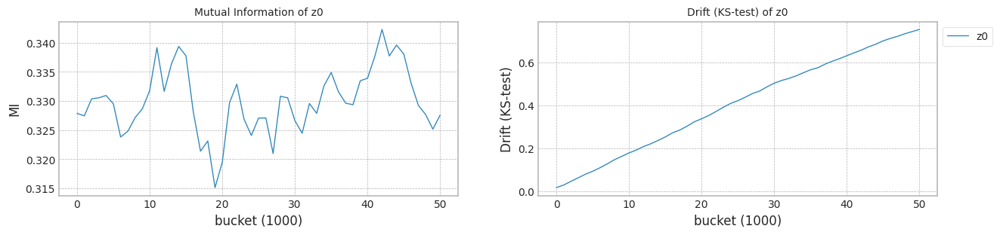

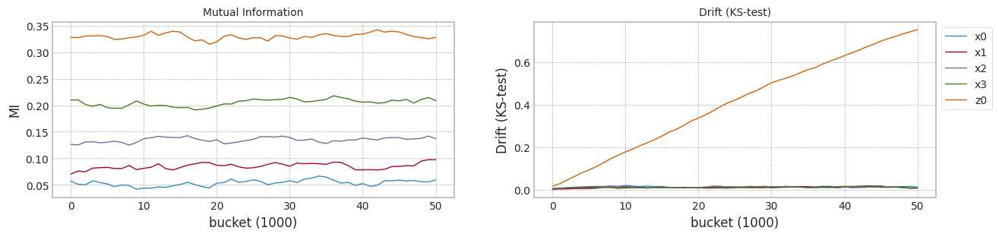

In [ ]:
columns=['x0','x1','x2','x3','z0']
X3 = pd.DataFrame(x3,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X3, y3,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.484659,0.586652,0.404131,0.578093,0.608368,0
1,0.642800,0.615744,0.450917,0.526770,0.605447,0
2,0.665316,0.751975,0.535797,0.191399,0.508040,0
3,0.426377,0.459274,0.304506,0.622063,0.473654,0
4,0.634133,0.507616,0.463434,0.520247,0.636503,0
...,...,...,...,...,...,...
59995,0.428835,0.731754,0.362543,0.750707,1.025053,59
59996,0.388504,0.163578,0.250745,0.650929,0.719542,59
59997,0.623148,0.528739,0.508383,0.646257,1.084968,59
59998,0.427314,0.797644,0.544189,0.600597,0.794855,59


trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:00:55,196] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 487.96it/s]

Early stop: 1186
[2023-11-29 21:00:57,635] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.24it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:01:07,416] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:01:07,418] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:10, 162.95it/s]

[2023-11-29 21:01:18,043] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:01:18,044] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]


mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:01:27,684] [INFO] [profiler.py:80:start_profile] Flops profiler started


 47%|████▋     | 949/2000 [00:01<00:02, 490.20it/s]

Early stop: 949
[2023-11-29 21:01:29,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:01:39,170] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:01:39,172] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:05<00:06, 164.99it/s]

[2023-11-29 21:01:50,700] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:01:50,701] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]

mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:02:00,436] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▉   | 1388/2000 [00:02<00:01, 485.73it/s]

Early stop: 1388
[2023-11-29 21:02:03,299] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:02:12,902] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:02:12,904] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:02<00:09, 165.00it/s]

[2023-11-29 21:02:23,907] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:02:23,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.30it/s]


mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:02:33,585] [INFO] [profiler.py:80:start_profile] Flops profiler started


 26%|██▌       | 516/2000 [00:01<00:03, 469.99it/s]

Early stop: 516
[2023-11-29 21:02:34,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:02:44,240] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:02:44,242] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:02<00:09, 160.52it/s]

[2023-11-29 21:02:55,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:02:55,282] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.29it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:03:04,977] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 483.89it/s]

Early stop: 548
[2023-11-29 21:03:06,115] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:03:15,672] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:03:15,675] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:10, 157.88it/s]

[2023-11-29 21:03:26,350] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:03:26,352] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.23it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:03:41,136] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:03:41,138] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:03:51,604] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:03:51,606] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.39s/it]

G-CDTL train flops: 3500000000 824250000 204885000 4529135000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [470]
Train flops  [4529135000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9163872281378767
G_CDTL+AUE median: 0.9163872281378767
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.03it/s]

Ensemble_SEA train flops: 458055000


100%|██████████| 51/51 [00:10<00:00,  4.65it/s]


Early stop at  [1052]
Train flops  [458055000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8642683654281395
SEA median: 0.8642683654281395
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.02it/s]

Ensemble_SEA train flops: 464580000


100%|██████████| 51/51 [00:10<00:00,  4.64it/s]


Early stop at  [1067]
Train flops  [464580000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8825536722952462
AUE median: 0.8825536722952462
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:17,  1.42it/s]

Ensemble_DTEL train flops: 520260000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [1195, 13]
Train flops  [520260000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8981691749183477
DTEL median: 0.8981691749183477
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:04:34,717] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:04:34,720] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:04:37,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:04:37,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:07<00:18,  1.33it/s]

G-CDTL train flops: 71750000 756000000 187920000 1015670000


100%|██████████| 51/51 [00:12<00:00,  4.14it/s]


Early stop at  [431]
Train flops  [1015670000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9122577980076138
G_CDTL+AUE median: 0.9143225130727453
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.51it/s]

Ensemble_SEA train flops: 672510000


100%|██████████| 51/51 [00:11<00:00,  4.32it/s]


Early stop at  [1545]
Train flops  [672510000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8658274264813188
SEA median: 0.8650478959547292
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.24it/s]

Ensemble_SEA train flops: 364965000


100%|██████████| 51/51 [00:10<00:00,  4.67it/s]


Early stop at  [838]
Train flops  [364965000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8824282312577807
AUE median: 0.8824909517765134
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:15,  1.62it/s]

Ensemble_DTEL train flops: 452400000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:10<00:00,  4.69it/s]


Early stop at  [1039, 13]
Train flops  [452400000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8980126783978284
DTEL median: 0.8980909266580881
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:05:20,568] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:05:20,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:05:30,672] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:05:30,673] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:55,  2.31s/it]

G-CDTL train flops: 3500000000 710500000 176610000 4387110000


100%|██████████| 51/51 [00:19<00:00,  2.62it/s]


Early stop at  [405]
Train flops  [4387110000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.919057124116446
G_CDTL+AUE median: 0.9163872281378767
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:13,  1.83it/s]

Ensemble_SEA train flops: 506775000


100%|██████████| 51/51 [00:11<00:00,  4.57it/s]


Early stop at  [1164]
Train flops  [506775000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8646364565436395
SEA median: 0.8646364565436395
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.58it/s]

Ensemble_SEA train flops: 294930000


100%|██████████| 51/51 [00:10<00:00,  4.90it/s]


Early stop at  [677]
Train flops  [294930000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8827176129965382
AUE median: 0.8825536722952462
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:18,  1.34it/s]

Ensemble_DTEL train flops: 585510000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:11<00:00,  4.52it/s]


Early stop at  [1345, 13]
Train flops  [585510000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8993542614352628
DTEL median: 0.8981691749183477
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:06:13,120] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:06:13,122] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:06:23,601] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:06:23,602] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.39s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


100%|██████████| 51/51 [00:19<00:00,  2.56it/s]


Early stop at  [443]
Train flops  [4470140000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9206349312272155
G_CDTL+AUE median: 0.9177221761271613
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.56it/s]

Ensemble_SEA train flops: 300150000


100%|██████████| 51/51 [00:10<00:00,  4.89it/s]


Early stop at  [689]
Train flops  [300150000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8645535648218546
SEA median: 0.8645950106827471
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:13,  1.81it/s]

Ensemble_SEA train flops: 522000000


100%|██████████| 51/51 [00:11<00:00,  4.55it/s]


Early stop at  [1199]
Train flops  [522000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8831430428506456
AUE median: 0.8826356426458921
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:07<00:25,  1.03s/it]

Ensemble_DTEL train flops: 839985000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:12<00:00,  4.18it/s]


Early stop at  [1930, 13]
Train flops  [839985000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8990689658544563
DTEL median: 0.898619070386402
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:07:07,016] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:07:07,018] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:07:17,595] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:07:17,596] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.41s/it]

G-CDTL train flops: 3500000000 820750000 204015000 4524765000


100%|██████████| 51/51 [00:20<00:00,  2.55it/s]


Early stop at  [468]
Train flops  [4524765000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9211586581310363
G_CDTL+AUE median: 0.919057124116446
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:13,  1.74it/s]

Ensemble_SEA train flops: 550275000


100%|██████████| 51/51 [00:11<00:00,  4.55it/s]


Early stop at  [1264]
Train flops  [550275000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8653006336241179
SEA median: 0.8646364565436395
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.50it/s]

Ensemble_SEA train flops: 696000000


100%|██████████| 51/51 [00:11<00:00,  4.33it/s]


Early stop at  [1599]
Train flops  [696000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8846252112680787
AUE median: 0.8827176129965382
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:14,  1.74it/s]

Ensemble_DTEL train flops: 402375000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:10<00:00,  4.75it/s]


Early stop at  [924, 13]
Train flops  [402375000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8985515284313871
DTEL median: 0.8985515284313871


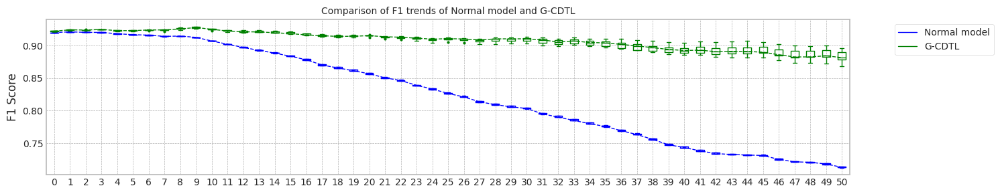

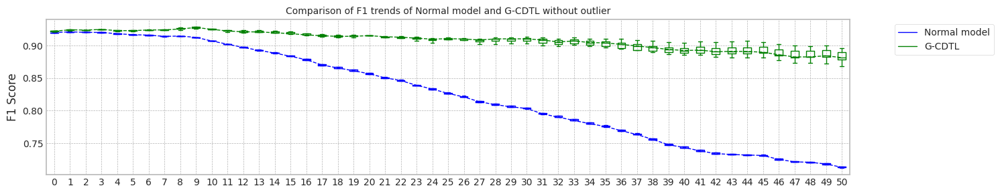

max_mean_trial= 3


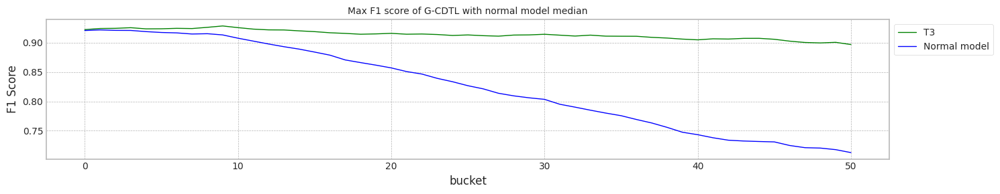

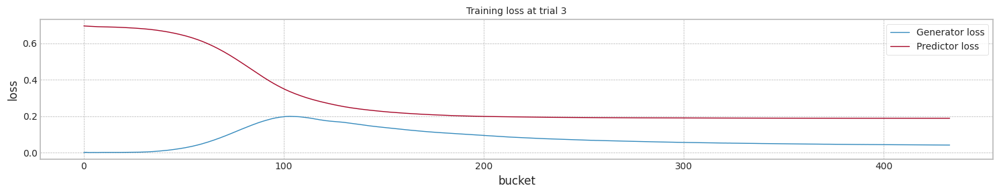

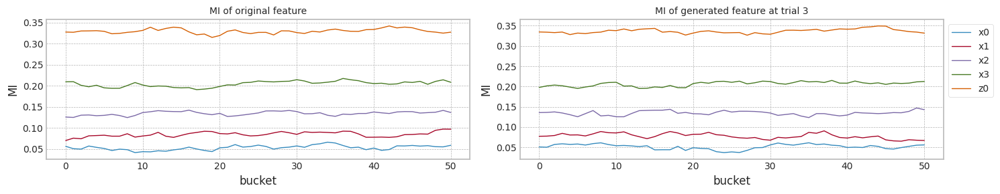

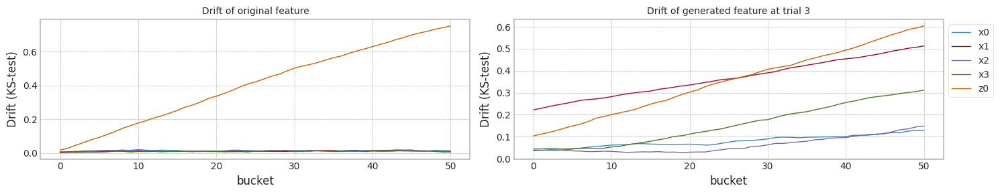

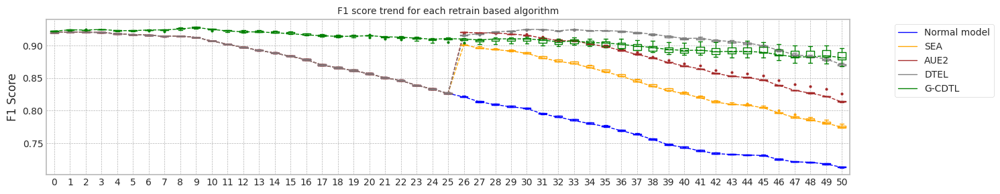

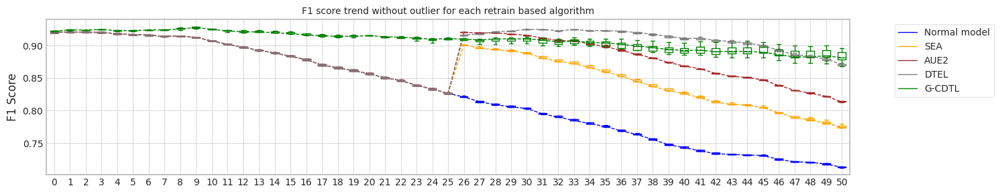

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.539766550064087
Base flops (inference flops of normal model, median): 199665000.0


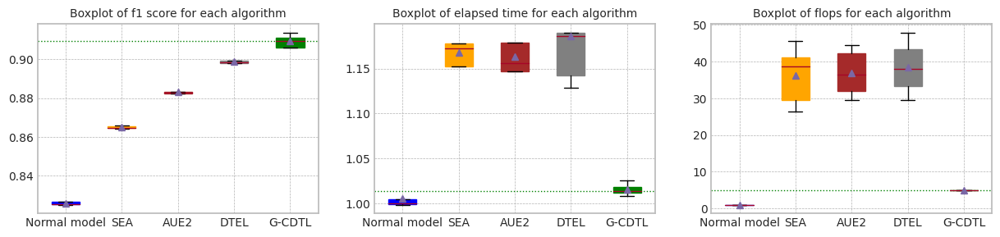

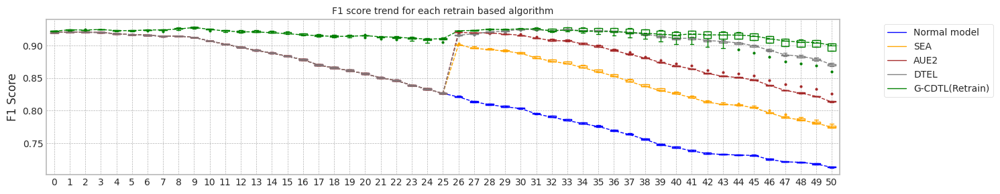

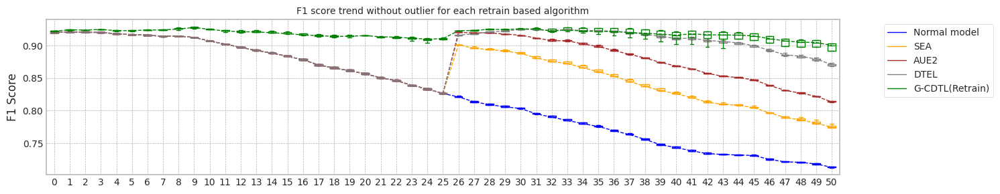

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.539766550064087
Base flops (train + inference flops of normal model, median): 3918915000.0


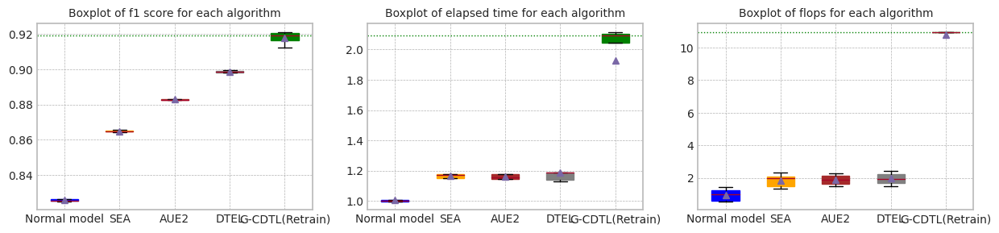

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.539766550064087


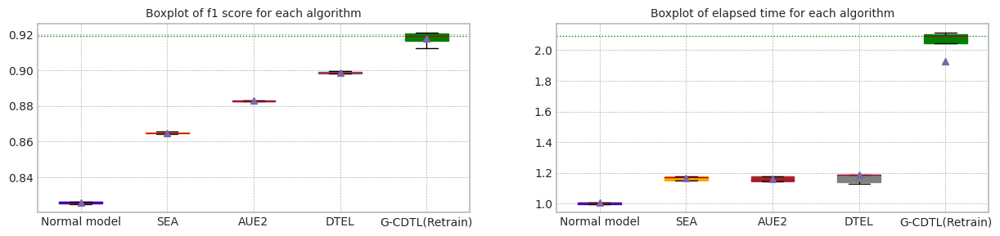

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.764874,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.526696,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.586094,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.533324,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.539767,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.539767,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.100423,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.620220,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.718130,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.657522,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.675470,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.786343,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.675470,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.063633,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.864268,0.773715,10.990540,2.607390e+09,5.606280e+09,8.213670e+09
1,1.0,0.920325,0.921341,0.865827,0.780328,11.846809,2.821845e+09,4.892880e+09,7.714725e+09
2,2.0,0.920255,0.921272,0.864636,0.774507,11.185618,2.656110e+09,6.445830e+09,9.101940e+09
3,3.0,0.920576,0.921592,0.864554,0.773913,10.461848,2.449485e+09,2.825325e+09,5.274810e+09
4,4.0,0.920325,0.921341,0.865301,0.776684,11.235107,2.699610e+09,3.200730e+09,5.900340e+09
5,median,0.920325,0.921341,0.864636,0.774507,11.185618,2.656110e+09,4.892880e+09,7.714725e+09
6,std,0.000125,0.000125,0.000634,0.002778,0.498210,1.360171e+08,1.550220e+09,1.604437e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.882554,0.813465,11.026553,2.613915e+09,5.812470e+09,8.426385e+09
1,1.0,0.920325,0.921341,0.882428,0.813538,10.943206,2.514300e+09,4.785000e+09,7.299300e+09
2,2.0,0.920255,0.921272,0.882718,0.813173,10.445036,2.444265e+09,6.433650e+09,8.877915e+09
3,3.0,0.920576,0.921592,0.883143,0.814495,11.243285,2.671335e+09,3.246840e+09,5.918175e+09
4,4.0,0.920325,0.921341,0.884625,0.825916,11.819377,2.845335e+09,3.546120e+09,6.391455e+09
5,median,0.920325,0.921341,0.882718,0.813538,11.026553,2.613915e+09,4.785000e+09,7.299300e+09
6,std,0.000125,0.000125,0.000898,0.005500,0.499222,1.544991e+08,1.384961e+09,1.270758e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.898169,0.869204,11.353147,2.675685e+09,5.976030e+09,8.651715e+09
1,1.0,0.920325,0.921341,0.898013,0.868784,10.899518,2.607825e+09,4.980315e+09,7.588140e+09
2,2.0,0.920255,0.921272,0.899354,0.873554,11.318870,2.740935e+09,6.832110e+09,9.573045e+09
3,3.0,0.920576,0.921592,0.899069,0.871199,12.240802,2.995410e+09,3.672705e+09,6.668115e+09
4,4.0,0.920325,0.921341,0.898552,0.871055,10.766709,2.557800e+09,3.360375e+09,5.918175e+09
5,median,0.920325,0.921341,0.898552,0.871055,11.318870,2.675685e+09,4.980315e+09,7.588140e+09
6,std,0.000125,0.000125,0.000574,0.001898,0.577024,1.710592e+08,1.479304e+09,1.471753e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.916387,0.892440,20.188006,4.271524e+10,223875000.0,4.293911e+10
1,1.0,0.922875,0.924630,0.912258,0.860170,12.332531,3.920177e+10,223875000.0,3.942564e+10
2,2.0,0.922514,0.924461,0.919057,0.900597,19.531640,4.257321e+10,223875000.0,4.279708e+10
3,3.0,0.921861,0.923788,0.920635,0.903680,19.966835,4.265624e+10,223875000.0,4.288012e+10
4,4.0,0.921318,0.923471,0.921159,0.903562,20.049735,4.271086e+10,223875000.0,4.293474e+10
5,median,0.922514,0.924461,0.919057,0.900597,19.966835,4.265624e+10,223875000.0,4.288012e+10
6,std,0.000668,0.000544,0.003659,0.018421,3.408350,1.549365e+09,0.0,1.549365e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:08:11,579] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 476.92it/s]

Early stop: 1186
[2023-11-29 21:08:14,072] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:08:23,570] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:08:23,573] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:10, 154.63it/s]

[2023-11-29 21:08:34,727] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:08:34,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]

mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:08:44,473] [INFO] [profiler.py:80:start_profile] Flops profiler started



 47%|████▋     | 949/2000 [00:02<00:02, 472.08it/s]

Early stop: 949
[2023-11-29 21:08:46,489] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:08:56,003] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:08:56,006] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:05<00:07, 154.60it/s]

[2023-11-29 21:09:08,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:09:08,368] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]

mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:09:18,015] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▉   | 1388/2000 [00:02<00:01, 470.56it/s]

Early stop: 1388
[2023-11-29 21:09:20,971] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.25it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:09:30,737] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:09:30,740] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:02<00:10, 151.39it/s]

[2023-11-29 21:09:42,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:09:42,267] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]


mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:09:51,802] [INFO] [profiler.py:80:start_profile] Flops profiler started


 26%|██▌       | 516/2000 [00:01<00:03, 477.83it/s]

Early stop: 516
[2023-11-29 21:09:52,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:10:02,453] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:10:02,455] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:02<00:10, 155.22it/s]

[2023-11-29 21:10:14,059] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:10:14,060] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:10:23,719] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 464.93it/s]

Early stop: 548
[2023-11-29 21:10:24,904] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:10:34,293] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:10:34,296] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:10, 152.50it/s]

[2023-11-29 21:10:45,320] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:10:45,321] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:10:58,321] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:10:58,323] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:11:09,437] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:11:09,438] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:20,  2.53s/it]

G-CDTL train flops: 3500000000 866250000 215325000 4581575000


 69%|██████▊   | 35/51 [00:17<00:03,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:11:12,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:11:12,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:11:23,340] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:11:23,342] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:28<00:33,  2.40s/it]

G-CDTL train flops: 3500000000 672000000 167040000 4339040000


100%|██████████| 51/51 [00:31<00:00,  1.64it/s]


Early stop at  [494, 383]
Train flops  [4581575000, 4339040000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9218912792557893
G_CDTL+AUE median: 0.9218912792557893
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:11,  2.90it/s]

Ensemble_SEA train flops: 226200000


 73%|███████▎  | 37/51 [00:09<00:07,  1.88it/s]

Ensemble_SEA train flops: 501555000


100%|██████████| 51/51 [00:11<00:00,  4.29it/s]


Early stop at  [519, 1152]
Train flops  [226200000, 501555000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8779880491081776
SEA median: 0.8779880491081776
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:19,  1.68it/s]

Ensemble_SEA train flops: 567240000


 73%|███████▎  | 37/51 [00:11<00:10,  1.35it/s]

Ensemble_SEA train flops: 796050000


100%|██████████| 51/51 [00:14<00:00,  3.61it/s]


Early stop at  [1303, 1829]
Train flops  [567240000, 796050000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8979229547050712
AUE median: 0.8979229547050712
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:25,  1.30it/s]

Ensemble_DTEL train flops: 550710000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:10<00:07,  1.89it/s]

Ensemble_DTEL train flops: 480240000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:13<00:00,  3.92it/s]


Early stop at  [1265, 10, 1103, 6]
Train flops  [550710000, 4785000, 480240000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9149785825116578
DTEL median: 0.9149785825116578
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:12:08,647] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:12:08,649] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:12:11,783] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:12:11,785] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:06<00:27,  1.18it/s]

G-CDTL train flops: 66500000 847000000 210540000 1124040000


 69%|██████▊   | 35/51 [00:09<00:03,  5.32it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:12:15,204] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:12:15,206] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:12:26,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:12:26,511] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:21<00:35,  2.56s/it]

G-CDTL train flops: 3500000000 805000000 200100000 4505100000


100%|██████████| 51/51 [00:24<00:00,  2.12it/s]


Early stop at  [483, 459]
Train flops  [1124040000, 4505100000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9223025523776238
G_CDTL+AUE median: 0.9220969158167065
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:15,  2.02it/s]

Ensemble_SEA train flops: 442395000


 73%|███████▎  | 37/51 [00:10<00:07,  1.79it/s]

Ensemble_SEA train flops: 513735000


100%|██████████| 51/51 [00:12<00:00,  4.00it/s]


Early stop at  [1016, 1180]
Train flops  [442395000, 513735000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8777036061327457
SEA median: 0.8778458276204617
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:19,  1.61it/s]

Ensemble_SEA train flops: 596385000


 73%|███████▎  | 37/51 [00:09<00:05,  2.60it/s]

Ensemble_SEA train flops: 269265000


100%|██████████| 51/51 [00:12<00:00,  4.07it/s]


Early stop at  [1370, 618]
Train flops  [596385000, 269265000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8979763550384183
AUE median: 0.8979496548717447
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:14,  2.29it/s]

Ensemble_DTEL train flops: 234900000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:10<00:10,  1.33it/s]

Ensemble_DTEL train flops: 778215000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:13<00:00,  3.91it/s]


Early stop at  [539, 10, 1788, 6]
Train flops  [234900000, 4785000, 778215000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9149507454460383
DTEL median: 0.914964663978848
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:13:11,090] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:13:11,092] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:13:22,752] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:13:22,754] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:15<02:01,  3.70s/it]

G-CDTL train flops: 3500000000 890750000 221415000 4612165000


 69%|██████▊   | 35/51 [00:18<00:03,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:13:26,126] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:13:26,129] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:13:29,333] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:13:29,335] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:21<00:12,  1.16it/s]

G-CDTL train flops: 120750000 826000000 205320000 1152070000


100%|██████████| 51/51 [00:24<00:00,  2.09it/s]


Early stop at  [508, 471]
Train flops  [4612165000, 1152070000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9228836993010865
G_CDTL+AUE median: 0.9223025523776238
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:17,  1.88it/s]

Ensemble_SEA train flops: 344085000


 73%|███████▎  | 37/51 [00:09<00:07,  1.95it/s]

Ensemble_SEA train flops: 443700000


100%|██████████| 51/51 [00:12<00:00,  4.18it/s]


Early stop at  [790, 1019]
Train flops  [344085000, 443700000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8788868960668796
SEA median: 0.8779880491081776
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:18,  1.78it/s]

Ensemble_SEA train flops: 513735000


 73%|███████▎  | 37/51 [00:11<00:09,  1.40it/s]

Ensemble_SEA train flops: 720795000


100%|██████████| 51/51 [00:13<00:00,  3.68it/s]


Early stop at  [1180, 1656]
Train flops  [513735000, 720795000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8978003642902409
AUE median: 0.8979229547050712
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:20,  1.61it/s]

Ensemble_DTEL train flops: 409335000
Ensemble_DTEL train flops: 4785000


 71%|███████   | 36/51 [00:09<00:07,  1.90it/s]

Ensemble_DTEL train flops: 294060000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:12<00:00,  4.24it/s]


Early stop at  [940, 10, 675, 6]
Train flops  [409335000, 4785000, 294060000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9153415130811502
DTEL median: 0.9149785825116578
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:14:13,689] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:14:13,692] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:14:25,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:14:25,658] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:15<01:26,  2.71s/it]

G-CDTL train flops: 3500000000 957250000 237945000 4695195000


 69%|██████▊   | 35/51 [00:18<00:03,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:14:29,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:14:29,044] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:14:40,053] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:14:40,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:29<00:35,  2.51s/it]

G-CDTL train flops: 3500000000 670250000 166605000 4336855000


100%|██████████| 51/51 [00:32<00:00,  1.57it/s]


Early stop at  [546, 382]
Train flops  [4695195000, 4336855000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9224778172473296
G_CDTL+AUE median: 0.9223901848124767
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:21,  1.47it/s]

Ensemble_SEA train flops: 671205000


 73%|███████▎  | 37/51 [00:10<00:06,  2.18it/s]

Ensemble_SEA train flops: 374100000


100%|██████████| 51/51 [00:13<00:00,  3.89it/s]


Early stop at  [1542, 859]
Train flops  [671205000, 374100000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.879250993344658
SEA median: 0.8784374725875286
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:18,  1.79it/s]

Ensemble_SEA train flops: 357135000


 73%|███████▎  | 37/51 [00:09<00:05,  2.59it/s]

Ensemble_SEA train flops: 269700000


100%|██████████| 51/51 [00:11<00:00,  4.34it/s]


Early stop at  [820, 619]
Train flops  [357135000, 269700000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8974687957652426
AUE median: 0.8978616594976561
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:23,  1.42it/s]

Ensemble_DTEL train flops: 487200000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:11<00:10,  1.29it/s]

Ensemble_DTEL train flops: 816495000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:14<00:00,  3.64it/s]


Early stop at  [1119, 10, 1876, 6]
Train flops  [487200000, 4785000, 816495000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9152208528441199
DTEL median: 0.9150997176778888
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:15:25,199] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:15:25,201] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:15:28,459] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:15:28,460] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:06<00:28,  1.14it/s]

G-CDTL train flops: 71750000 857500000 213150000 1142400000


 69%|██████▊   | 35/51 [00:09<00:03,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:15:31,816] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:15:31,818] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:15:43,268] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:15:43,269] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:21<00:36,  2.59s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


100%|██████████| 51/51 [00:24<00:00,  2.10it/s]


Early stop at  [489, 438]
Train flops  [1142400000, 4459215000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9228516597163773
G_CDTL+AUE median: 0.9224778172473296
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:12,  2.52it/s]

Ensemble_SEA train flops: 286230000


 73%|███████▎  | 37/51 [00:09<00:05,  2.45it/s]

Ensemble_SEA train flops: 309720000


100%|██████████| 51/51 [00:11<00:00,  4.40it/s]


Early stop at  [657, 711]
Train flops  [286230000, 309720000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8777298154765003
SEA median: 0.8779880491081776
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:18,  1.75it/s]

Ensemble_SEA train flops: 524175000


 73%|███████▎  | 37/51 [00:10<00:07,  1.91it/s]

Ensemble_SEA train flops: 469800000


100%|██████████| 51/51 [00:12<00:00,  3.95it/s]


Early stop at  [1204, 1079]
Train flops  [524175000, 469800000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8961981917311155
AUE median: 0.8978003642902409
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:22,  1.46it/s]

Ensemble_DTEL train flops: 479370000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:10<00:09,  1.54it/s]

Ensemble_DTEL train flops: 623790000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:13<00:00,  3.82it/s]


Early stop at  [1101, 10, 1433, 6]
Train flops  [479370000, 4785000, 623790000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9148676677083595
DTEL median: 0.9149785825116578


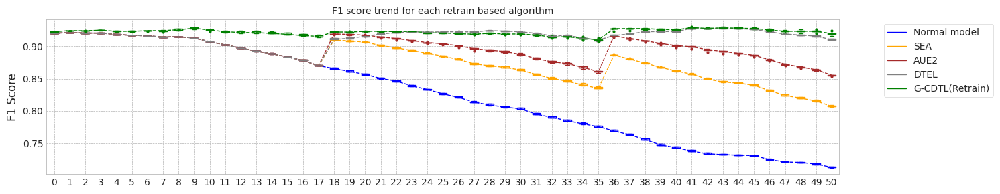

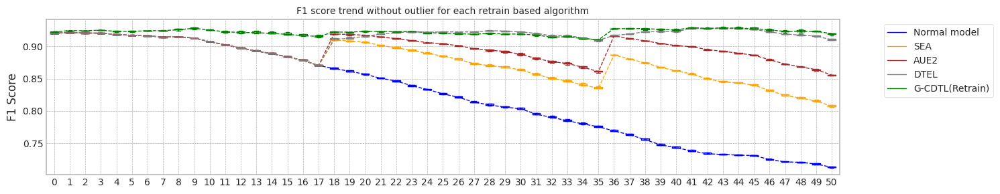

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.497466325759888
Base flops (train + inference flops of normal model, median): 3918915000.0


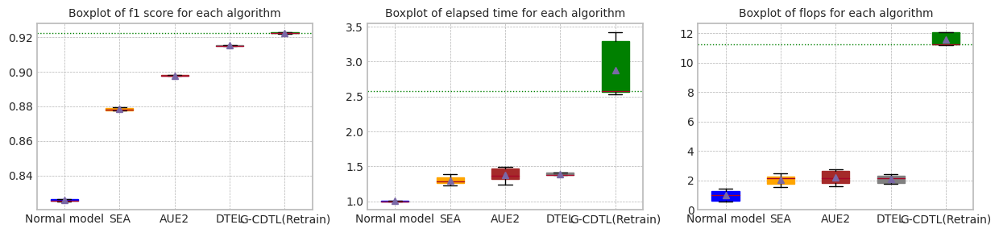

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.497466325759888


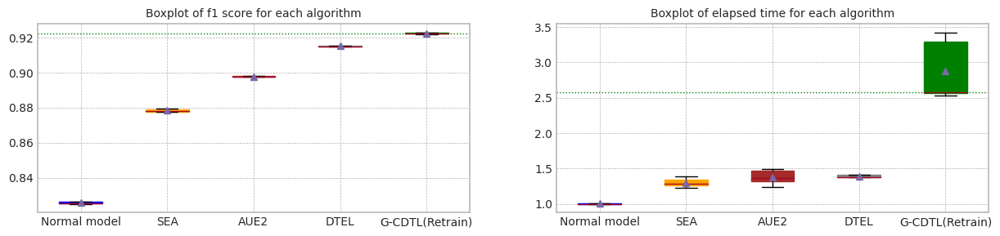

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.483463,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.497466,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.746964,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.550357,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.373329,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.497466,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.137165,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.727109,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.630846,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.516608,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.642629,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.570798,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.630846,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.079347,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.877988,0.807233,11.914931,2.877090e+09,5.966025e+09,8.843115e+09
1,1.0,0.920325,0.921341,0.877704,0.806515,12.776207,3.105465e+09,5.266545e+09,8.372010e+09
2,2.0,0.920255,0.921272,0.878887,0.808780,12.234758,2.937120e+09,6.816885e+09,9.754005e+09
3,3.0,0.920576,0.921592,0.879251,0.809358,13.126746,3.194640e+09,3.660525e+09,6.855165e+09
4,4.0,0.920325,0.921341,0.877730,0.807089,11.630596,2.745285e+09,3.336450e+09,6.081735e+09
5,median,0.920325,0.921341,0.877988,0.807233,12.234758,2.937120e+09,5.266545e+09,8.372010e+09
6,std,0.000125,0.000125,0.000712,0.001211,0.613230,1.795868e+08,1.488832e+09,1.492849e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.897923,0.856329,14.175905,3.512625e+09,6.801225e+09,1.031385e+10
1,1.0,0.920325,0.921341,0.897976,0.855625,12.547087,3.014985e+09,5.375730e+09,8.390715e+09
2,2.0,0.920255,0.921272,0.897800,0.855950,13.884151,3.383865e+09,7.463295e+09,1.084716e+10
3,3.0,0.920576,0.921592,0.897469,0.855273,11.775290,2.776170e+09,3.441720e+09,6.217890e+09
4,4.0,0.920325,0.921341,0.896198,0.854192,12.953816,3.143310e+09,3.934140e+09,7.077450e+09
5,median,0.920325,0.921341,0.897800,0.855625,12.953816,3.143310e+09,5.375730e+09,8.390715e+09
6,std,0.000125,0.000125,0.000740,0.000816,0.980948,2.927890e+08,1.746766e+09,2.001171e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.914979,0.909939,13.054204,3.188115e+09,5.937750e+09,9.125865e+09
1,1.0,0.920325,0.921341,0.914951,0.910070,13.076864,3.170280e+09,5.307870e+09,8.478150e+09
2,2.0,0.920255,0.921272,0.915342,0.912193,12.072598,2.860560e+09,6.542400e+09,9.402960e+09
3,3.0,0.920576,0.921592,0.915221,0.911358,14.040539,3.460860e+09,3.650955e+09,7.111815e+09
4,4.0,0.920325,0.921341,0.914868,0.910336,13.386837,3.260325e+09,3.583530e+09,6.843855e+09
5,median,0.920325,0.921341,0.914979,0.910336,13.076864,3.188115e+09,5.307870e+09,8.478150e+09
6,std,0.000125,0.000125,0.000200,0.000967,0.710922,2.163414e+08,1.339717e+09,1.162401e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.921891,0.916440,31.201179,4.710672e+10,134325000.0,4.724104e+10
1,1.0,0.922875,0.924630,0.922303,0.919793,24.030125,4.381524e+10,134325000.0,4.394956e+10
2,2.0,0.922514,0.924461,0.922884,0.923906,24.459652,4.395034e+10,134325000.0,4.408466e+10
3,3.0,0.921861,0.923788,0.922478,0.918606,32.495048,4.721815e+10,134325000.0,4.735248e+10
4,4.0,0.921318,0.923471,0.922852,0.920208,24.309922,4.378772e+10,134325000.0,4.392204e+10
5,median,0.922514,0.924461,0.922478,0.919793,24.459652,4.395034e+10,134325000.0,4.408466e+10
6,std,0.000668,0.000544,0.000412,0.002727,4.180548,1.815165e+09,0.0,1.815165e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:16:29,822] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 449.99it/s]

Early stop: 1186
[2023-11-29 21:16:32,465] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:16:42,015] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:16:42,017] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:11, 142.82it/s]

[2023-11-29 21:16:53,874] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:16:53,877] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]


mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:17:03,618] [INFO] [profiler.py:80:start_profile] Flops profiler started


 47%|████▋     | 949/2000 [00:02<00:02, 437.94it/s]

Early stop: 949
[2023-11-29 21:17:05,790] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:17:15,372] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:17:15,374] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:06<00:07, 144.75it/s]

[2023-11-29 21:17:28,438] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:17:28,439] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]

mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:17:38,069] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▉   | 1388/2000 [00:03<00:01, 447.63it/s]

Early stop: 1388
[2023-11-29 21:17:41,176] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:17:50,697] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:17:50,699] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:02<00:10, 144.46it/s]

[2023-11-29 21:18:03,044] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:18:03,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.30it/s]

mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:18:12,722] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 516/2000 [00:01<00:03, 439.97it/s]

Early stop: 516
[2023-11-29 21:18:13,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:18:23,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:18:23,471] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:03<00:10, 143.95it/s]

[2023-11-29 21:18:35,946] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:18:35,948] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:18:45,611] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 446.58it/s]

Early stop: 548
[2023-11-29 21:18:46,844] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.33it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:18:56,473] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:18:56,475] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:11, 143.43it/s]

[2023-11-29 21:19:08,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:19:08,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.15it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:19:20,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:19:20,546] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:19:31,988] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:19:31,990] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:14<01:36,  2.61s/it]

G-CDTL train flops: 3500000000 714000000 177480000 4391480000


 49%|████▉     | 25/51 [00:16<00:06,  4.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:19:34,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:19:34,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:19:46,061] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:19:46,062] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:28<01:32,  3.71s/it]

G-CDTL train flops: 3500000000 752500000 187050000 4439550000


 75%|███████▍  | 38/51 [00:30<00:03,  4.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:19:48,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:19:48,555] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:20:00,439] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:20:00,440] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:42<00:29,  2.71s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


100%|██████████| 51/51 [00:44<00:00,  1.14it/s]


Early stop at  [407, 429, 443]
Train flops  [4391480000, 4439550000, 4470140000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9240617170441618
G_CDTL+AUE median: 0.9240617170441618
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.65it/s]

Ensemble_SEA train flops: 552015000


 53%|█████▎    | 27/51 [00:10<00:19,  1.20it/s]

Ensemble_SEA train flops: 852600000


 78%|███████▊  | 40/51 [00:14<00:05,  1.89it/s]

Ensemble_SEA train flops: 452835000


100%|██████████| 51/51 [00:16<00:00,  3.17it/s]


Early stop at  [1268, 1959, 1040]
Train flops  [552015000, 852600000, 452835000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8848162930002603
SEA median: 0.8848162930002603
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:21,  1.76it/s]

Ensemble_SEA train flops: 504165000


 53%|█████▎    | 27/51 [00:08<00:14,  1.62it/s]

Ensemble_SEA train flops: 561150000


 78%|███████▊  | 40/51 [00:14<00:08,  1.22it/s]

Ensemble_SEA train flops: 855645000


100%|██████████| 51/51 [00:16<00:00,  3.12it/s]


Early stop at  [1158, 1289, 1966]
Train flops  [504165000, 561150000, 855645000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9039040782959006
AUE median: 0.9039040782959006
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:24,  1.57it/s]

Ensemble_DTEL train flops: 391500000
Ensemble_DTEL train flops: 3915000


 51%|█████     | 26/51 [00:07<00:12,  1.98it/s]

Ensemble_DTEL train flops: 294930000
Ensemble_DTEL train flops: 2610000


 78%|███████▊  | 40/51 [00:12<00:07,  1.56it/s]

Ensemble_DTEL train flops: 608130000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:14<00:00,  3.60it/s]


Early stop at  [899, 8, 677, 5, 1397, 4]
Train flops  [391500000, 3915000, 294930000, 2610000, 608130000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202419139373585
DTEL median: 0.9202419139373585
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:20:51,995] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:20:51,997] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:21:04,001] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:21:04,003] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:14<01:41,  2.73s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


 49%|████▉     | 25/51 [00:16<00:06,  4.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:21:06,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:21:06,446] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:21:18,201] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:21:18,202] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:28<01:04,  2.68s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


 75%|███████▍  | 38/51 [00:30<00:03,  4.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:21:20,602] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:21:20,605] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:21:32,753] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:21:32,754] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:43<00:30,  2.76s/it]

G-CDTL train flops: 3500000000 799750000 198795000 4498545000


100%|██████████| 51/51 [00:45<00:00,  1.12it/s]


Early stop at  [454, 416, 456]
Train flops  [4494175000, 4411145000, 4498545000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9241313731784774
G_CDTL+AUE median: 0.9240965451113197
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:28,  1.29it/s]

Ensemble_SEA train flops: 783000000


 53%|█████▎    | 27/51 [00:08<00:09,  2.65it/s]

Ensemble_SEA train flops: 244905000


 78%|███████▊  | 40/51 [00:12<00:05,  2.03it/s]

Ensemble_SEA train flops: 416295000


100%|██████████| 51/51 [00:14<00:00,  3.49it/s]


Early stop at  [1799, 562, 956]
Train flops  [783000000, 244905000, 416295000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8843431958705802
SEA median: 0.8845797444354202
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:24,  1.58it/s]

Ensemble_SEA train flops: 398460000


 53%|█████▎    | 27/51 [00:07<00:10,  2.35it/s]

Ensemble_SEA train flops: 312330000


 78%|███████▊  | 40/51 [00:11<00:05,  2.10it/s]

Ensemble_SEA train flops: 394980000


100%|██████████| 51/51 [00:13<00:00,  3.77it/s]


Early stop at  [915, 717, 907]
Train flops  [398460000, 312330000, 394980000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9039869639210588
AUE median: 0.9039455211084797
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.67it/s]

Ensemble_DTEL train flops: 538530000
Ensemble_DTEL train flops: 3915000


 53%|█████▎    | 27/51 [00:07<00:08,  2.90it/s]

Ensemble_DTEL train flops: 211845000
Ensemble_DTEL train flops: 2610000


 78%|███████▊  | 40/51 [00:11<00:04,  2.44it/s]

Ensemble_DTEL train flops: 291015000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:13<00:00,  3.87it/s]


Early stop at  [1237, 8, 486, 5, 668, 4]
Train flops  [538530000, 3915000, 211845000, 2610000, 291015000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202547558811071
DTEL median: 0.9202483349092327
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:22:18,913] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:22:18,915] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:22:31,940] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:22:31,942] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:15<02:37,  4.14s/it]

G-CDTL train flops: 3500000000 981750000 244035000 4725785000


 49%|████▉     | 25/51 [00:17<00:06,  4.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:22:34,429] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:22:34,431] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:22:46,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:22:46,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:30<01:05,  2.72s/it]

G-CDTL train flops: 3500000000 719250000 178785000 4398035000


 75%|███████▍  | 38/51 [00:32<00:03,  4.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:22:48,791] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:22:48,792] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:22:56,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:22:56,661] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:40<00:20,  1.86s/it]

G-CDTL train flops: 70000000 2026500000 503730000 2600230000


100%|██████████| 51/51 [00:42<00:00,  1.20it/s]


Early stop at  [560, 410, 1157]
Train flops  [4725785000, 4398035000, 2600230000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9245667001335748
G_CDTL+AUE median: 0.9241313731784774
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:18,  2.03it/s]

Ensemble_SEA train flops: 393675000


 53%|█████▎    | 27/51 [00:07<00:09,  2.43it/s]

Ensemble_SEA train flops: 298845000


 78%|███████▊  | 40/51 [00:10<00:03,  2.83it/s]

Ensemble_SEA train flops: 211845000


100%|██████████| 51/51 [00:12<00:00,  4.00it/s]


Early stop at  [904, 686, 486]
Train flops  [393675000, 298845000, 211845000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8850790003020678
SEA median: 0.8848162930002603
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:31,  1.17it/s]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:08<00:08,  2.88it/s]

Ensemble_SEA train flops: 195750000


 78%|███████▊  | 40/51 [00:12<00:05,  1.96it/s]

Ensemble_SEA train flops: 403680000


100%|██████████| 51/51 [00:14<00:00,  3.43it/s]


Early stop at  [1999, 449, 927]
Train flops  [870000000, 195750000, 403680000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.904389898128727
AUE median: 0.9039869639210588
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:19,  1.98it/s]

Ensemble_DTEL train flops: 291015000
Ensemble_DTEL train flops: 3915000


 51%|█████     | 26/51 [00:07<00:18,  1.37it/s]

Ensemble_DTEL train flops: 494160000
Ensemble_DTEL train flops: 2175000


 78%|███████▊  | 40/51 [00:11<00:04,  2.39it/s]

Ensemble_DTEL train flops: 291450000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:13<00:00,  3.80it/s]


Early stop at  [668, 8, 1135, 4, 669, 4]
Train flops  [291015000, 3915000, 494160000, 2175000, 291450000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9196944854978755
DTEL median: 0.9202419139373585
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:23:42,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:23:42,574] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:23:55,035] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:23:55,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:15<01:44,  2.82s/it]

G-CDTL train flops: 3500000000 792750000 197055000 4489805000


 49%|████▉     | 25/51 [00:17<00:06,  4.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:23:57,438] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:23:57,440] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:24:09,292] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:24:09,294] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:29<01:04,  2.70s/it]

G-CDTL train flops: 3500000000 619500000 153990000 4273490000


 75%|███████▍  | 38/51 [00:31<00:03,  4.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:24:11,739] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:24:11,741] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:24:24,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:24:24,497] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:44<00:31,  2.89s/it]

G-CDTL train flops: 3500000000 862750000 214455000 4577205000


100%|██████████| 51/51 [00:46<00:00,  1.09it/s]


Early stop at  [452, 353, 492]
Train flops  [4489805000, 4273490000, 4577205000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9234773905676196
G_CDTL+AUE median: 0.9240965451113197
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.66it/s]

Ensemble_SEA train flops: 545055000


 53%|█████▎    | 27/51 [00:08<00:10,  2.35it/s]

Ensemble_SEA train flops: 311895000


 78%|███████▊  | 40/51 [00:12<00:06,  1.76it/s]

Ensemble_SEA train flops: 489375000


100%|██████████| 51/51 [00:14<00:00,  3.56it/s]


Early stop at  [1252, 716, 1124]
Train flops  [545055000, 311895000, 489375000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8849191758401946
SEA median: 0.8848677344202275
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:29,  1.27it/s]

Ensemble_SEA train flops: 782565000


 53%|█████▎    | 27/51 [00:10<00:15,  1.51it/s]

Ensemble_SEA train flops: 596820000


 78%|███████▊  | 40/51 [00:14<00:07,  1.53it/s]

Ensemble_SEA train flops: 590730000


100%|██████████| 51/51 [00:16<00:00,  3.04it/s]


Early stop at  [1798, 1371, 1357]
Train flops  [782565000, 596820000, 590730000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9041270860231387
AUE median: 0.9040570249720987
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:21,  1.77it/s]

Ensemble_DTEL train flops: 332775000
Ensemble_DTEL train flops: 3915000


 53%|█████▎    | 27/51 [00:07<00:09,  2.48it/s]

Ensemble_DTEL train flops: 283620000
Ensemble_DTEL train flops: 2175000


 78%|███████▊  | 40/51 [00:10<00:04,  2.68it/s]

Ensemble_DTEL train flops: 247515000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:12<00:00,  4.02it/s]


Early stop at  [764, 8, 651, 4, 568, 4]
Train flops  [332775000, 3915000, 283620000, 2175000, 247515000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202152007921115
DTEL median: 0.9202285573647351
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:25:13,151] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:25:13,153] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:25:25,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:25:25,848] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:15<02:33,  4.04s/it]

G-CDTL train flops: 3500000000 810250000 201405000 4511655000


 49%|████▉     | 25/51 [00:17<00:06,  4.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:25:28,396] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:25:28,398] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:25:38,306] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:25:38,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:27<00:55,  2.30s/it]

G-CDTL train flops: 3500000000 120750000 30015000 3650765000


 75%|███████▍  | 38/51 [00:29<00:02,  4.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:25:40,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:25:40,738] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:25:48,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:25:48,142] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:37<00:19,  1.76s/it]

G-CDTL train flops: 80500000 1858500000 461970000 2400970000


100%|██████████| 51/51 [00:39<00:00,  1.29it/s]


Early stop at  [462, 68, 1061]
Train flops  [4511655000, 3650765000, 2400970000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.6886941079086526
G_CDTL+AUE median: 0.9240617170441618
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:30,  1.23it/s]

Ensemble_SEA train flops: 798225000


 53%|█████▎    | 27/51 [00:09<00:12,  1.87it/s]

Ensemble_SEA train flops: 438045000


 78%|███████▊  | 40/51 [00:13<00:05,  2.06it/s]

Ensemble_SEA train flops: 373665000


100%|██████████| 51/51 [00:15<00:00,  3.28it/s]


Early stop at  [1834, 1006, 858]
Train flops  [798225000, 438045000, 373665000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8850432136699004
SEA median: 0.8849191758401946
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:19,  1.90it/s]

Ensemble_SEA train flops: 303195000


 53%|█████▎    | 27/51 [00:06<00:04,  4.84it/s]

Ensemble_SEA train flops: 24795000


 78%|███████▊  | 40/51 [00:11<00:09,  1.16it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.66it/s]


Early stop at  [696, 56, 1999]
Train flops  [303195000, 24795000, 870000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8923835883844882
AUE median: 0.9039869639210588
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:33,  1.13it/s]

Ensemble_DTEL train flops: 632925000
Ensemble_DTEL train flops: 3915000


 53%|█████▎    | 27/51 [00:10<00:20,  1.15it/s]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 78%|███████▊  | 40/51 [00:14<00:06,  1.79it/s]

Ensemble_DTEL train flops: 471540000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:16<00:00,  3.04it/s]


Early stop at  [1454, 8, 1999, 4, 1083, 4]
Train flops  [632925000, 3915000, 870000000, 2175000, 471540000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.919871331754279
DTEL median: 0.9202152007921115


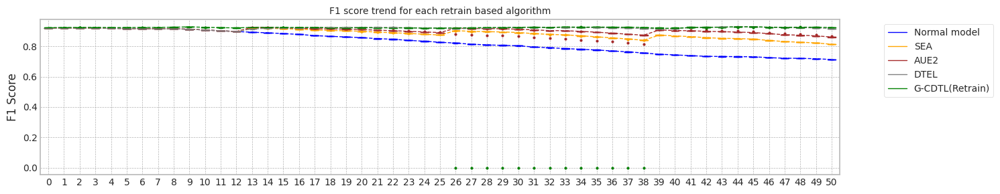

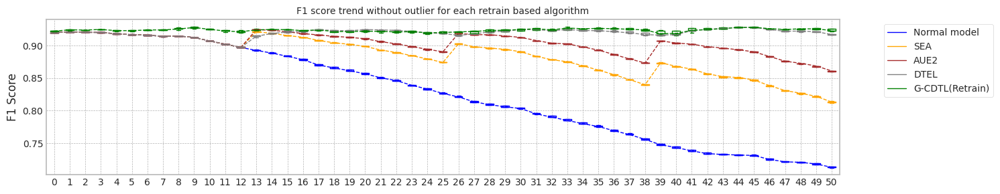

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.551180124282837
Base flops (train + inference flops of normal model, median): 3918915000.0


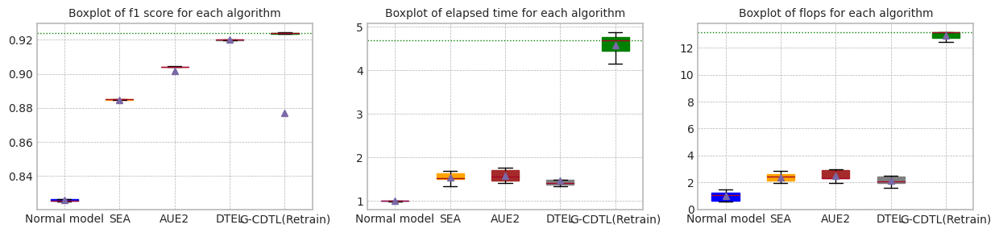

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.551180124282837


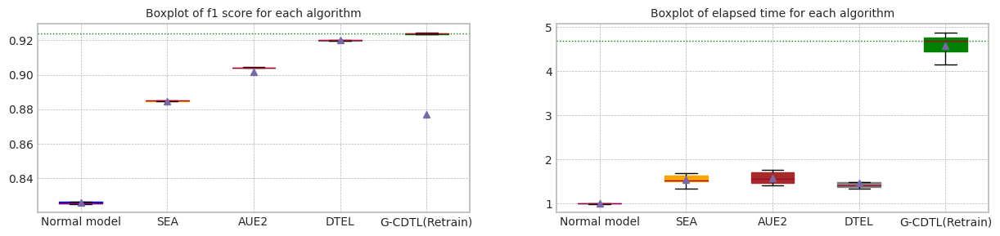

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.533465,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.564592,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.501892,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.551180,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.611638,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.551180,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.040524,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.722657,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.613546,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.660756,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.642739,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.637649,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.642739,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.041168,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.884816,0.813431,16.144046,4.006785e+09,7.201425e+09,1.120821e+10
1,1.0,0.920325,0.921341,0.884343,0.812153,14.642367,3.593535e+09,5.860320e+09,9.453855e+09
2,2.0,0.920255,0.921272,0.885079,0.813358,12.784400,3.053700e+09,7.039170e+09,1.009287e+10
3,3.0,0.920576,0.921592,0.884919,0.812735,14.367510,3.495660e+09,4.067250e+09,7.562910e+09
4,4.0,0.920325,0.921341,0.885043,0.814455,15.580993,3.759270e+09,4.456140e+09,8.215410e+09
5,median,0.920325,0.921341,0.884919,0.813358,14.642367,3.593535e+09,5.860320e+09,9.453855e+09
6,std,0.000125,0.000125,0.000297,0.000861,1.288869,3.530422e+08,1.439038e+09,1.456638e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.903904,0.861294,16.361650,4.070295e+09,7.464600e+09,1.153490e+10
1,1.0,0.920325,0.921341,0.903987,0.859815,13.562370,3.255105e+09,5.721555e+09,8.976660e+09
2,2.0,0.920255,0.921272,0.904390,0.861212,14.917093,3.618765e+09,7.803900e+09,1.142266e+10
3,3.0,0.920576,0.921592,0.904127,0.860061,16.816771,4.119450e+09,4.890705e+09,9.010155e+09
4,4.0,0.920325,0.921341,0.892384,0.867979,13.960854,3.347325e+09,4.243860e+09,7.591185e+09
5,median,0.920325,0.921341,0.903987,0.861212,14.917093,3.618765e+09,5.721555e+09,9.010155e+09
6,std,0.000125,0.000125,0.005244,0.003368,1.434543,4.001189e+08,1.564297e+09,1.716127e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.920242,0.917712,14.181180,3.452595e+09,6.066510e+09,9.519105e+09
1,1.0,0.920325,0.921341,0.920255,0.917729,13.217875,3.199425e+09,4.821540e+09,8.020965e+09
2,2.0,0.920255,0.921272,0.919694,0.916737,13.442220,3.234225e+09,6.540225e+09,9.774450e+09
3,3.0,0.920576,0.921592,0.920215,0.917315,12.725795,3.021510e+09,3.082410e+09,6.103920e+09
4,4.0,0.920325,0.921341,0.919871,0.916562,16.782822,4.132065e+09,3.431715e+09,7.563780e+09
5,median,0.920325,0.921341,0.920215,0.917315,13.442220,3.234225e+09,4.821540e+09,8.020965e+09
6,std,0.000125,0.000125,0.000257,0.000542,1.604593,4.328206e+08,1.537413e+09,1.504098e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.924062,0.922304,44.752592,5.148727e+10,107460000.0,5.159473e+10
1,1.0,0.922875,0.924630,0.924131,0.925670,45.532510,5.158996e+10,107460000.0,5.169742e+10
2,2.0,0.922514,0.924461,0.924567,0.923523,42.526946,4.991015e+10,107460000.0,5.001761e+10
3,3.0,0.921861,0.923788,0.923477,0.925885,46.656879,5.152660e+10,107460000.0,5.163406e+10
4,4.0,0.921318,0.923471,0.688694,0.923341,39.699842,4.874949e+10,107460000.0,4.885695e+10
5,median,0.922514,0.924461,0.924062,0.923523,44.752592,5.148727e+10,107460000.0,5.159473e+10
6,std,0.000668,0.000544,0.105259,0.001563,2.761206,1.275957e+09,0.0,1.275957e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:26:42,634] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 409.30it/s]

Early stop: 1186
[2023-11-29 21:26:45,538] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.45it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:26:54,950] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:26:54,952] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:12, 134.04it/s]

[2023-11-29 21:27:07,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:27:07,739] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:27:17,204] [INFO] [profiler.py:80:start_profile] Flops profiler started



 47%|████▋     | 949/2000 [00:02<00:02, 421.43it/s]

Early stop: 949
[2023-11-29 21:27:19,462] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:27:28,962] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 21:27:28,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:06<00:08, 135.97it/s]

[2023-11-29 21:27:42,978] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:27:42,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]


mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:27:52,696] [INFO] [profiler.py:80:start_profile] Flops profiler started


 69%|██████▉   | 1388/2000 [00:03<00:01, 417.11it/s]

Early stop: 1388
[2023-11-29 21:27:56,029] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:28:05,607] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:28:05,609] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:03<00:11, 134.51it/s]

[2023-11-29 21:28:18,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:28:18,930] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:28:28,519] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 516/2000 [00:01<00:03, 407.24it/s]

Early stop: 516
[2023-11-29 21:28:29,791] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:28:39,294] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:28:39,296] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:03<00:11, 132.44it/s]

[2023-11-29 21:28:52,755] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:28:52,757] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:29:02,368] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 402.25it/s]

Early stop: 548
[2023-11-29 21:29:03,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:29:13,331] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:13,333] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:12, 132.93it/s]

[2023-11-29 21:29:26,139] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:29:26,140] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.33it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:29:37,832] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:37,834] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:29:50,615] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:29:50,617] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:15<01:53,  2.91s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


 41%|████      | 21/51 [00:16<00:08,  3.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:29:52,719] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:52,722] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:29:56,001] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:29:56,002] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:20<00:26,  1.07it/s]

G-CDTL train flops: 75250000 742000000 184440000 1001690000


 63%|██████▎   | 32/51 [00:22<00:04,  4.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:29:58,079] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:58,081] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:30:11,185] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:30:11,186] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:35<00:50,  2.96s/it]

G-CDTL train flops: 3500000000 775250000 192705000 4467955000


 84%|████████▍ | 43/51 [00:37<00:02,  3.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:30:13,239] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:30:13,242] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:30:26,485] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:30:26,486] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:50<00:18,  3.02s/it]

G-CDTL train flops: 3500000000 817250000 203145000 4520395000


100%|██████████| 51/51 [00:52<00:00,  1.02s/it]


Early stop at  [438, 423, 442, 466]
Train flops  [4459215000, 1001690000, 4467955000, 4520395000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9229947548510828
G_CDTL+AUE median: 0.9229947548510828
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:26,  1.46it/s]

Ensemble_SEA train flops: 587250000


 45%|████▌     | 23/51 [00:07<00:11,  2.44it/s]

Ensemble_SEA train flops: 250560000


 67%|██████▋   | 34/51 [00:11<00:09,  1.78it/s]

Ensemble_SEA train flops: 455445000


 88%|████████▊ | 45/51 [00:14<00:02,  2.40it/s]

Ensemble_SEA train flops: 271005000


100%|██████████| 51/51 [00:15<00:00,  3.24it/s]


Early stop at  [1349, 575, 1046, 622]
Train flops  [587250000, 250560000, 455445000, 271005000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8959332999172185
SEA median: 0.8959332999172185
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:25,  1.50it/s]

Ensemble_SEA train flops: 583770000


 45%|████▌     | 23/51 [00:07<00:13,  2.08it/s]

Ensemble_SEA train flops: 352350000


 67%|██████▋   | 34/51 [00:11<00:07,  2.29it/s]

Ensemble_SEA train flops: 300585000


 88%|████████▊ | 45/51 [00:14<00:02,  2.20it/s]

Ensemble_SEA train flops: 328425000


100%|██████████| 51/51 [00:15<00:00,  3.27it/s]


Early stop at  [1341, 809, 690, 754]
Train flops  [583770000, 352350000, 300585000, 328425000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9118366842935051
AUE median: 0.9118366842935051
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:42,  1.05s/it]

Ensemble_DTEL train flops: 729495000
Ensemble_DTEL train flops: 3480000


 45%|████▌     | 23/51 [00:08<00:15,  1.81it/s]

Ensemble_DTEL train flops: 432825000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 33/51 [00:12<00:14,  1.27it/s]

Ensemble_DTEL train flops: 512430000
Ensemble_DTEL train flops: 2175000


 86%|████████▋ | 44/51 [00:17<00:07,  1.04s/it]

Ensemble_DTEL train flops: 749070000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:18<00:00,  2.71it/s]


Early stop at  [1676, 7, 994, 4, 1177, 4, 1721, 3]
Train flops  [729495000, 3480000, 432825000, 2175000, 512430000, 2175000, 749070000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9206819272002615
DTEL median: 0.9206819272002615
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:20,129] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:20,132] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:31:33,356] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:31:33,357] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:15<01:57,  3.01s/it]

G-CDTL train flops: 3500000000 778750000 193575000 4472325000


 41%|████      | 21/51 [00:17<00:08,  3.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:35,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:35,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:31:48,628] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:31:48,629] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:30<01:24,  3.01s/it]

G-CDTL train flops: 3500000000 764750000 190095000 4454845000


 63%|██████▎   | 32/51 [00:32<00:05,  3.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:50,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:50,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:31:53,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:31:53,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:36<00:15,  1.10it/s]

G-CDTL train flops: 68250000 705250000 175305000 948805000


 84%|████████▍ | 43/51 [00:37<00:01,  4.66it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:55,937] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:55,939] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:32:09,359] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:32:09,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:51<00:18,  3.02s/it]

G-CDTL train flops: 3500000000 801500000 199230000 4500730000


100%|██████████| 51/51 [00:52<00:00,  1.03s/it]


Early stop at  [444, 436, 402, 457]
Train flops  [4472325000, 4454845000, 948805000, 4500730000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9240106741004008
G_CDTL+AUE median: 0.9235027144757418
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:29,  1.33it/s]

Ensemble_SEA train flops: 674685000


 45%|████▌     | 23/51 [00:08<00:13,  2.01it/s]

Ensemble_SEA train flops: 370620000


 67%|██████▋   | 34/51 [00:11<00:08,  1.95it/s]

Ensemble_SEA train flops: 393675000


 88%|████████▊ | 45/51 [00:15<00:03,  1.68it/s]

Ensemble_SEA train flops: 493725000


100%|██████████| 51/51 [00:17<00:00,  2.99it/s]


Early stop at  [1550, 851, 904, 1134]
Train flops  [674685000, 370620000, 393675000, 493725000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8965315533059728
SEA median: 0.8962324266115956
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:22,  1.73it/s]

Ensemble_SEA train flops: 471540000


 45%|████▌     | 23/51 [00:07<00:15,  1.81it/s]

Ensemble_SEA train flops: 417165000


 67%|██████▋   | 34/51 [00:13<00:15,  1.11it/s]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:16<00:02,  2.06it/s]

Ensemble_SEA train flops: 354525000


100%|██████████| 51/51 [00:17<00:00,  2.85it/s]


Early stop at  [1083, 958, 1999, 814]
Train flops  [471540000, 417165000, 870000000, 354525000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9118812840564219
AUE median: 0.9118589841749635
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:37,  1.07it/s]

Ensemble_DTEL train flops: 609435000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:07<00:18,  1.59it/s]

Ensemble_DTEL train flops: 357570000
Ensemble_DTEL train flops: 2610000


 67%|██████▋   | 34/51 [00:11<00:07,  2.23it/s]

Ensemble_DTEL train flops: 304065000
Ensemble_DTEL train flops: 2175000


 88%|████████▊ | 45/51 [00:16<00:04,  1.38it/s]

Ensemble_DTEL train flops: 624660000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:17<00:00,  2.94it/s]


Early stop at  [1400, 7, 821, 5, 698, 4, 1435, 3]
Train flops  [609435000, 3480000, 357570000, 2610000, 304065000, 2175000, 624660000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202894361436155
DTEL median: 0.9204856816719384
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:05,249] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:05,251] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:33:09,329] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:33:09,330] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:06<00:57,  1.44s/it]

G-CDTL train flops: 71750000 929250000 230985000 1231985000


 41%|████      | 21/51 [00:08<00:06,  4.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:11,460] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:11,462] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:33:25,078] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:33:25,080] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:22<01:25,  3.07s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


 63%|██████▎   | 32/51 [00:23<00:05,  3.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:27,206] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:27,209] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:33:45,479] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:33:45,480] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:42<01:09,  4.09s/it]

G-CDTL train flops: 3500000000 1884750000 468495000 5853245000


 84%|████████▍ | 43/51 [00:44<00:02,  2.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:47,561] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:47,563] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:34:06,464] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:34:06,465] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:03<00:25,  4.24s/it]

G-CDTL train flops: 3500000000 1968750000 489375000 5958125000


100%|██████████| 51/51 [01:04<00:00,  1.27s/it]


Early stop at  [530, 443, 1076, 1124]
Train flops  [1231985000, 4470140000, 5853245000, 5958125000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9233346181915186
G_CDTL+AUE median: 0.9233346181915186
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:22,  1.75it/s]

Ensemble_SEA train flops: 406290000


 43%|████▎     | 22/51 [00:08<00:28,  1.02it/s]

Ensemble_SEA train flops: 650325000


 67%|██████▋   | 34/51 [00:13<00:11,  1.49it/s]

Ensemble_SEA train flops: 538965000


 86%|████████▋ | 44/51 [00:17<00:05,  1.20it/s]

Ensemble_SEA train flops: 515910000


100%|██████████| 51/51 [00:18<00:00,  2.72it/s]


Early stop at  [933, 1494, 1238, 1185]
Train flops  [406290000, 650325000, 538965000, 515910000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8964693108402746
SEA median: 0.8964693108402746
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:23,  1.70it/s]

Ensemble_SEA train flops: 303630000


 43%|████▎     | 22/51 [00:06<00:17,  1.63it/s]

Ensemble_SEA train flops: 339300000


 65%|██████▍   | 33/51 [00:12<00:21,  1.18s/it]

Ensemble_SEA train flops: 832155000


 88%|████████▊ | 45/51 [00:18<00:05,  1.11it/s]

Ensemble_SEA train flops: 821715000


100%|██████████| 51/51 [00:19<00:00,  2.65it/s]


Early stop at  [697, 779, 1912, 1888]
Train flops  [303630000, 339300000, 832155000, 821715000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9121553178137185
AUE median: 0.9118812840564219
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:05<00:46,  1.16s/it]

Ensemble_DTEL train flops: 788655000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:09<00:25,  1.12it/s]

Ensemble_DTEL train flops: 567240000
Ensemble_DTEL train flops: 2175000


 67%|██████▋   | 34/51 [00:13<00:07,  2.23it/s]

Ensemble_DTEL train flops: 305370000
Ensemble_DTEL train flops: 2175000


 88%|████████▊ | 45/51 [00:16<00:02,  2.34it/s]

Ensemble_DTEL train flops: 268395000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:17<00:00,  2.92it/s]


Early stop at  [1812, 7, 1303, 4, 701, 4, 616, 2]
Train flops  [788655000, 3480000, 567240000, 2175000, 305370000, 2175000, 268395000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202450518912899
DTEL median: 0.9202894361436155
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:05,531] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:05,533] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:35:19,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:35:19,407] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:16<02:57,  4.44s/it]

G-CDTL train flops: 3500000000 733250000 182265000 4415515000


 41%|████      | 21/51 [00:18<00:09,  3.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:21,668] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:21,670] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:35:33,120] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:35:33,121] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:29<01:48,  3.73s/it]

G-CDTL train flops: 3500000000 168000000 41760000 3709760000


 63%|██████▎   | 32/51 [00:31<00:05,  3.38it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:35,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:35,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:35:44,851] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:35:44,853] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:41<00:56,  3.12s/it]

G-CDTL train flops: 78750000 2096500000 521130000 2696380000


 84%|████████▍ | 43/51 [00:43<00:02,  3.58it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:47,036] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:47,038] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:36:06,150] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:36:06,151] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:02<00:25,  4.25s/it]

G-CDTL train flops: 3500000000 1895250000 471105000 5866355000


100%|██████████| 51/51 [01:04<00:00,  1.26s/it]


Early stop at  [418, 95, 1197, 1082]
Train flops  [4415515000, 3709760000, 2696380000, 5866355000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.7243337294083594
G_CDTL+AUE median: 0.9231646865213008
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:36,  1.06it/s]

Ensemble_SEA train flops: 870000000


 43%|████▎     | 22/51 [00:10<00:26,  1.09it/s]

Ensemble_SEA train flops: 578985000


 67%|██████▋   | 34/51 [00:13<00:08,  2.10it/s]

Ensemble_SEA train flops: 296670000


 86%|████████▋ | 44/51 [00:17<00:04,  1.57it/s]

Ensemble_SEA train flops: 336255000


100%|██████████| 51/51 [00:18<00:00,  2.75it/s]


Early stop at  [1999, 1330, 681, 772]
Train flops  [870000000, 578985000, 296670000, 336255000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8965633871242863
SEA median: 0.8965004320731237
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:05<00:42,  1.07s/it]

Ensemble_SEA train flops: 704265000


 45%|████▌     | 23/51 [00:09<00:15,  1.79it/s]

Ensemble_SEA train flops: 404115000


 65%|██████▍   | 33/51 [00:14<00:23,  1.30s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:18<00:02,  2.01it/s]

Ensemble_SEA train flops: 333645000


100%|██████████| 51/51 [00:19<00:00,  2.60it/s]


Early stop at  [1618, 928, 1999, 766]
Train flops  [704265000, 404115000, 870000000, 333645000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9119133942774925
AUE median: 0.9118973391669571
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:21,  1.84it/s]

Ensemble_DTEL train flops: 275355000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:06<00:18,  1.59it/s]

Ensemble_DTEL train flops: 344955000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 33/51 [00:11<00:17,  1.02it/s]

Ensemble_DTEL train flops: 645105000
Ensemble_DTEL train flops: 2175000


 86%|████████▋ | 44/51 [00:15<00:04,  1.51it/s]

Ensemble_DTEL train flops: 352350000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:16<00:00,  3.08it/s]


Early stop at  [632, 7, 792, 4, 1482, 4, 809, 3]
Train flops  [275355000, 3480000, 344955000, 2175000, 645105000, 2175000, 352350000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9205958295505812
DTEL median: 0.9204426328470983
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:04,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:04,547] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:37:30,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:37:30,903] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:28<05:30,  8.27s/it]

G-CDTL train flops: 3500000000 3500000000 870000000 7870000000


 41%|████      | 21/51 [00:30<00:12,  2.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:33,071] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:33,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:37:47,219] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:37:47,220] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:45<01:31,  3.28s/it]

G-CDTL train flops: 3500000000 745500000 185310000 4430810000


 63%|██████▎   | 32/51 [00:46<00:06,  3.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:49,335] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:49,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:37:54,851] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:37:54,852] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:52<00:34,  1.94s/it]

G-CDTL train flops: 54250000 1193500000 296670000 1544420000


 84%|████████▍ | 43/51 [00:54<00:01,  4.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:57,011] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:57,013] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:38:13,174] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:38:13,175] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:11<00:21,  3.61s/it]

G-CDTL train flops: 3500000000 1172500000 291450000 4963950000


100%|██████████| 51/51 [01:12<00:00,  1.42s/it]


Early stop at  [1999, 425, 681, 669]
Train flops  [7870000000, 4430810000, 1544420000, 4963950000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9225503127337755
G_CDTL+AUE median: 0.9229947548510828
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.20it/s]

Ensemble_SEA train flops: 296235000


 45%|████▌     | 23/51 [00:07<00:15,  1.82it/s]

Ensemble_SEA train flops: 409770000


 67%|██████▋   | 34/51 [00:11<00:10,  1.66it/s]

Ensemble_SEA train flops: 465015000


 86%|████████▋ | 44/51 [00:15<00:06,  1.03it/s]

Ensemble_SEA train flops: 612915000


100%|██████████| 51/51 [00:17<00:00,  2.96it/s]


Early stop at  [680, 941, 1068, 1408]
Train flops  [296235000, 409770000, 465015000, 612915000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.89645689716923
SEA median: 0.8964693108402746
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:31,  1.24it/s]

Ensemble_SEA train flops: 706440000


 43%|████▎     | 22/51 [00:09<00:27,  1.06it/s]

Ensemble_SEA train flops: 582465000


 67%|██████▋   | 34/51 [00:12<00:07,  2.39it/s]

Ensemble_SEA train flops: 243600000


 86%|████████▋ | 44/51 [00:16<00:04,  1.64it/s]

Ensemble_SEA train flops: 335820000


100%|██████████| 51/51 [00:17<00:00,  2.88it/s]


Early stop at  [1623, 1338, 559, 771]
Train flops  [706440000, 582465000, 243600000, 335820000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9114912726132669
AUE median: 0.9118812840564219
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:35,  1.12it/s]

Ensemble_DTEL train flops: 556365000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:08<00:19,  1.51it/s]

Ensemble_DTEL train flops: 362355000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 33/51 [00:12<00:16,  1.07it/s]

Ensemble_DTEL train flops: 584205000
Ensemble_DTEL train flops: 2175000


 86%|████████▋ | 44/51 [00:17<00:06,  1.05it/s]

Ensemble_DTEL train flops: 603345000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:18<00:00,  2.74it/s]


Early stop at  [1278, 7, 832, 4, 1342, 4, 1386, 3]
Train flops  [556365000, 3480000, 362355000, 2175000, 584205000, 2175000, 603345000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202976557520651
DTEL median: 0.9202976557520651


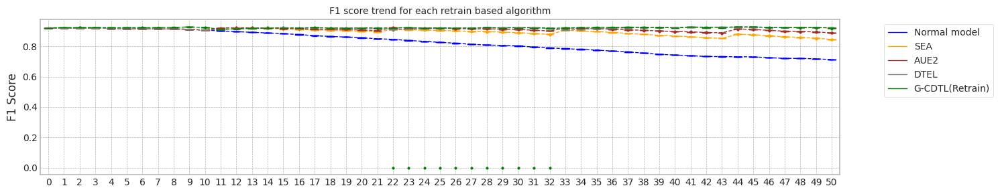

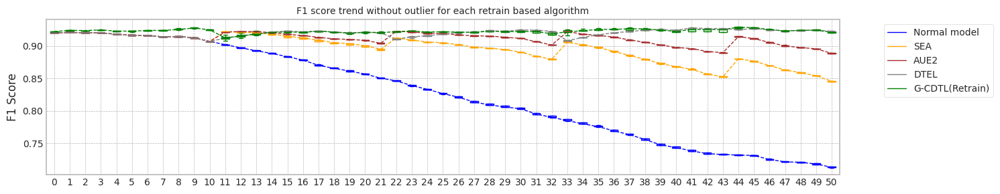

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.485473394393921
Base flops (train + inference flops of normal model, median): 3918915000.0


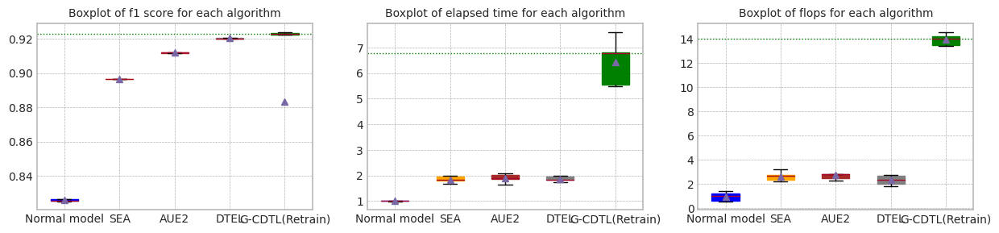

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.485473394393921


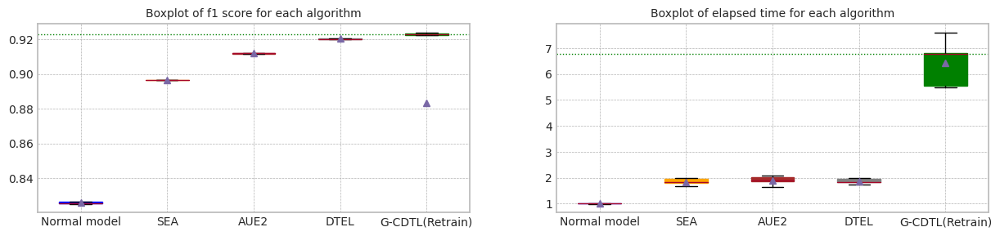

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.396806,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.483713,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.560670,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.485473,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.576208,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.485473,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.071785,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.447474,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.694436,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.572799,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.588680,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.600943,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.588680,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.088347,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.895933,0.845556,15.758847,3.713595e+09,6.982620e+09,1.069622e+10
1,1.0,0.920325,0.921341,0.896532,0.847302,17.118037,4.082040e+09,6.423210e+09,1.050525e+10
2,2.0,0.920255,0.921272,0.896469,0.845981,18.763826,4.260825e+09,8.320680e+09,1.258150e+10
3,3.0,0.920576,0.921592,0.896563,0.845664,18.594167,4.231245e+09,4.877220e+09,9.108465e+09
4,4.0,0.920325,0.921341,0.896457,0.843610,17.266760,3.933270e+09,4.704525e+09,8.637795e+09
5,median,0.920325,0.921341,0.896469,0.845664,17.266760,4.082040e+09,6.423210e+09,1.050525e+10
6,std,0.000125,0.000125,0.000260,0.001323,1.227433,2.263566e+08,1.510529e+09,1.548135e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.911837,0.888933,15.634023,3.714465e+09,7.183155e+09,1.089762e+10
1,1.0,0.920325,0.921341,0.911881,0.889198,17.933290,4.262565e+09,6.803400e+09,1.106596e+10
2,2.0,0.920255,0.921272,0.912155,0.891060,19.268909,4.446135e+09,8.705655e+09,1.315179e+10
3,3.0,0.920576,0.921592,0.911913,0.888911,19.619705,4.461360e+09,5.307000e+09,9.768360e+09
4,4.0,0.920325,0.921341,0.911491,0.888073,17.747508,4.017660e+09,4.988580e+09,9.006240e+09
5,median,0.920325,0.921341,0.911881,0.888933,17.933290,4.262565e+09,6.803400e+09,1.089762e+10
6,std,0.000125,0.000125,0.000238,0.001104,1.572526,3.161821e+08,1.506960e+09,1.572468e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.920682,0.923292,18.835647,4.582725e+09,6.208320e+09,1.079104e+10
1,1.0,0.920325,0.921341,0.920289,0.923143,17.379316,4.055070e+09,5.156490e+09,9.211560e+09
2,2.0,0.920255,0.921272,0.920245,0.922845,17.493884,4.088130e+09,6.518040e+09,1.060617e+10
3,3.0,0.920576,0.921592,0.920596,0.922645,16.569174,3.776670e+09,3.188550e+09,6.965220e+09
4,4.0,0.920325,0.921341,0.920298,0.922597,18.681170,4.265175e+09,3.564825e+09,7.830000e+09
5,median,0.920325,0.921341,0.920298,0.922845,17.493884,4.088130e+09,5.156490e+09,9.211560e+09
6,std,0.000125,0.000125,0.000201,0.000305,0.953193,2.969293e+08,1.508607e+09,1.681441e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.922995,0.921626,52.053979,5.263536e+10,62685000.0,5.269804e+10
1,1.0,0.922875,0.924630,0.924011,0.921176,52.663546,5.256280e+10,62685000.0,5.262549e+10
2,2.0,0.922514,0.924461,0.923335,0.916526,64.688491,5.569960e+10,62685000.0,5.576228e+10
3,3.0,0.921861,0.923788,0.724334,0.922152,64.169547,5.487411e+10,62685000.0,5.493680e+10
4,4.0,0.921318,0.923471,0.922550,0.923027,72.201244,5.699528e+10,62685000.0,5.705796e+10
5,median,0.922514,0.924461,0.922995,0.921626,64.169547,5.487411e+10,62685000.0,5.493680e+10
6,std,0.000668,0.000544,0.088947,0.002541,8.638952,1.937831e+09,0.0,1.937831e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:39:14,138] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:03<00:02, 374.96it/s]

Early stop: 1186
[2023-11-29 21:39:17,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.21it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:39:27,143] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:39:27,146] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:03<00:14, 114.63it/s]

[2023-11-29 21:39:41,723] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:39:41,724] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.17it/s]


mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:39:51,637] [INFO] [profiler.py:80:start_profile] Flops profiler started


 47%|████▋     | 949/2000 [00:02<00:02, 368.33it/s]

Early stop: 949
[2023-11-29 21:39:54,219] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.20it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:40:04,076] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:40:04,078] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:07<00:09, 119.72it/s]

[2023-11-29 21:40:20,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:40:20,037] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]


mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:40:30,036] [INFO] [profiler.py:80:start_profile] Flops profiler started


 69%|██████▉   | 1388/2000 [00:03<00:01, 381.06it/s]

Early stop: 1388
[2023-11-29 21:40:33,683] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.18it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:40:43,571] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 21:40:43,574] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:03<00:13, 120.09it/s]

[2023-11-29 21:40:58,514] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:40:58,515] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.11it/s]

mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:41:08,551] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 516/2000 [00:01<00:03, 372.96it/s]

Early stop: 516
[2023-11-29 21:41:09,941] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.14it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:41:19,905] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:41:19,908] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:03<00:13, 118.87it/s]

[2023-11-29 21:41:35,055] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:41:35,058] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]


mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:41:45,067] [INFO] [profiler.py:80:start_profile] Flops profiler started


 27%|██▋       | 548/2000 [00:01<00:03, 379.09it/s]

Early stop: 548
[2023-11-29 21:41:46,518] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.22it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:41:56,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:41:56,342] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:13, 119.14it/s]

[2023-11-29 21:42:10,632] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:10,633] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.16it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:42:22,342] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:42:22,345] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:42:37,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:37,037] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:16<02:18,  3.37s/it]

G-CDTL train flops: 3500000000 757750000 188355000 4446105000


 33%|███▎      | 17/51 [00:17<00:15,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:42:38,777] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:42:38,779] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:42:42,623] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:42,625] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:22<00:50,  1.53s/it]

G-CDTL train flops: 73500000 773500000 192270000 1039270000


 51%|█████     | 26/51 [00:23<00:06,  3.65it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:42:44,417] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:42:44,420] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:42:58,717] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:58,718] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:38<01:14,  3.24s/it]

G-CDTL train flops: 3500000000 698250000 173565000 4371815000


 69%|██████▊   | 35/51 [00:39<00:07,  2.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:43:00,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:43:00,447] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:43:15,692] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:43:15,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:55<00:49,  3.52s/it]

G-CDTL train flops: 3500000000 871500000 216630000 4588130000


 86%|████████▋ | 44/51 [00:56<00:03,  2.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:43:17,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:43:17,412] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:43:32,113] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:43:32,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:11<00:28,  4.79s/it]

G-CDTL train flops: 3500000000 766500000 190530000 4457030000


100%|██████████| 51/51 [01:12<00:00,  1.43s/it]


Early stop at  [432, 441, 398, 497, 437]
Train flops  [4446105000, 1039270000, 4371815000, 4588130000, 4457030000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9239180403916785
G_CDTL+AUE median: 0.9239180403916785
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:30,  1.33it/s]

Ensemble_SEA train flops: 620310000


 37%|███▋      | 19/51 [00:07<00:13,  2.31it/s]

Ensemble_SEA train flops: 251430000


 55%|█████▍    | 28/51 [00:09<00:05,  4.42it/s]

Ensemble_SEA train flops: 27405000


 73%|███████▎  | 37/51 [00:12<00:07,  1.82it/s]

Ensemble_SEA train flops: 394545000


 90%|█████████ | 46/51 [00:15<00:02,  1.92it/s]

Ensemble_SEA train flops: 362790000


100%|██████████| 51/51 [00:16<00:00,  3.04it/s]


Early stop at  [1425, 577, 62, 906, 833]
Train flops  [620310000, 251430000, 27405000, 394545000, 362790000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8823174539230919
SEA median: 0.8823174539230919
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:32,  1.25it/s]

Ensemble_SEA train flops: 672510000


 37%|███▋      | 19/51 [00:07<00:13,  2.34it/s]

Ensemble_SEA train flops: 244470000


 55%|█████▍    | 28/51 [00:10<00:11,  2.00it/s]

Ensemble_SEA train flops: 339735000


 73%|███████▎  | 37/51 [00:14<00:10,  1.37it/s]

Ensemble_SEA train flops: 593775000


 90%|█████████ | 46/51 [00:18<00:02,  1.80it/s]

Ensemble_SEA train flops: 384105000


100%|██████████| 51/51 [00:19<00:00,  2.67it/s]


Early stop at  [1545, 561, 780, 1364, 882]
Train flops  [672510000, 244470000, 339735000, 593775000, 384105000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9094243068204417
AUE median: 0.9094243068204417
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:32,  1.28it/s]

Ensemble_DTEL train flops: 441960000
Ensemble_DTEL train flops: 3045000


 35%|███▌      | 18/51 [00:07<00:27,  1.21it/s]

Ensemble_DTEL train flops: 496770000
Ensemble_DTEL train flops: 2175000


 55%|█████▍    | 28/51 [00:10<00:11,  1.96it/s]

Ensemble_DTEL train flops: 354090000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 36/51 [00:14<00:15,  1.00s/it]

Ensemble_DTEL train flops: 631620000
Ensemble_DTEL train flops: 2175000


 90%|█████████ | 46/51 [00:18<00:02,  2.05it/s]

Ensemble_DTEL train flops: 311025000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:19<00:00,  2.68it/s]


Early stop at  [1015, 6, 1141, 4, 813, 3, 1451, 4, 714, 2]
Train flops  [441960000, 3045000, 496770000, 2175000, 354090000, 1740000, 631620000, 2175000, 311025000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9214461886758337
DTEL median: 0.9214461886758337
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:44:30,044] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:44:30,046] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:44:34,501] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:44:34,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:06<00:47,  1.15s/it]

G-CDTL train flops: 73500000 922250000 229245000 1224995000


 33%|███▎      | 17/51 [00:07<00:09,  3.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:44:36,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:44:36,237] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:44:52,460] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:44:52,461] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:24<02:49,  5.12s/it]

G-CDTL train flops: 3500000000 1004500000 249690000 4754190000


 51%|█████     | 26/51 [00:25<00:12,  2.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:44:54,252] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:44:54,254] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:45:09,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:45:09,831] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:41<02:01,  5.07s/it]

G-CDTL train flops: 3500000000 899500000 223590000 4623090000


 69%|██████▊   | 35/51 [00:43<00:07,  2.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:45:11,566] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:45:11,568] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:45:15,151] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:45:15,152] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:46<00:22,  1.47s/it]

G-CDTL train flops: 66500000 694750000 172695000 933945000


 86%|████████▋ | 44/51 [00:48<00:01,  3.70it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:45:16,960] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:45:16,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:45:21,113] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:45:21,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [00:52<00:05,  1.11s/it]

G-CDTL train flops: 110250000 801500000 199230000 1110980000


100%|██████████| 51/51 [00:53<00:00,  1.06s/it]


Early stop at  [526, 573, 513, 396, 457]
Train flops  [1224995000, 4754190000, 4623090000, 933945000, 1110980000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9244507139559646
G_CDTL+AUE median: 0.9241843771738215
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:29,  1.40it/s]

Ensemble_SEA train flops: 566370000


 37%|███▋      | 19/51 [00:08<00:25,  1.27it/s]

Ensemble_SEA train flops: 643365000


 55%|█████▍    | 28/51 [00:12<00:15,  1.51it/s]

Ensemble_SEA train flops: 506340000


 73%|███████▎  | 37/51 [00:15<00:07,  1.84it/s]

Ensemble_SEA train flops: 378015000


 90%|█████████ | 46/51 [00:19<00:02,  2.04it/s]

Ensemble_SEA train flops: 306240000


100%|██████████| 51/51 [00:20<00:00,  2.54it/s]


Early stop at  [1301, 1478, 1163, 868, 703]
Train flops  [566370000, 643365000, 506340000, 378015000, 306240000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8908787124481276
SEA median: 0.8865980831856097
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:17,  2.28it/s]

Ensemble_SEA train flops: 274920000


 37%|███▋      | 19/51 [00:06<00:19,  1.67it/s]

Ensemble_SEA train flops: 448920000


 55%|█████▍    | 28/51 [00:09<00:11,  1.94it/s]

Ensemble_SEA train flops: 335385000


 73%|███████▎  | 37/51 [00:14<00:10,  1.38it/s]

Ensemble_SEA train flops: 576810000


 90%|█████████ | 46/51 [00:17<00:03,  1.65it/s]

Ensemble_SEA train flops: 438915000


100%|██████████| 51/51 [00:18<00:00,  2.74it/s]


Early stop at  [631, 1031, 770, 1325, 1008]
Train flops  [274920000, 448920000, 335385000, 576810000, 438915000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9094257739130951
AUE median: 0.9094250403667684
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:36,  1.17it/s]

Ensemble_DTEL train flops: 497640000
Ensemble_DTEL train flops: 3045000


 35%|███▌      | 18/51 [00:07<00:29,  1.12it/s]

Ensemble_DTEL train flops: 524175000
Ensemble_DTEL train flops: 2175000


 55%|█████▍    | 28/51 [00:10<00:09,  2.40it/s]

Ensemble_DTEL train flops: 232290000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 36/51 [00:14<00:10,  1.38it/s]

Ensemble_DTEL train flops: 408900000
Ensemble_DTEL train flops: 2175000


 88%|████████▊ | 45/51 [00:17<00:04,  1.23it/s]

Ensemble_DTEL train flops: 441090000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:18<00:00,  2.70it/s]


Early stop at  [1143, 6, 1204, 4, 533, 3, 939, 4, 1013, 2]
Train flops  [497640000, 3045000, 524175000, 2175000, 232290000, 1740000, 408900000, 2175000, 441090000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9213262098710174
DTEL median: 0.9213861992734256
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:46:21,700] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:46:21,703] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:46:37,716] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:46:37,717] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:17<02:29,  3.65s/it]

G-CDTL train flops: 3500000000 962500000 239250000 4701750000


 33%|███▎      | 17/51 [00:19<00:16,  2.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:46:39,463] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:46:39,465] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:46:54,978] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:46:54,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:35<01:54,  3.59s/it]

G-CDTL train flops: 3500000000 805000000 200100000 4505100000


 51%|█████     | 26/51 [00:36<00:11,  2.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:46:56,748] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:46:56,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:47:22,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:47:22,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:02<03:17,  8.24s/it]

G-CDTL train flops: 3500000000 3076500000 764730000 7341230000


 69%|██████▊   | 35/51 [01:04<00:10,  1.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:47:24,918] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:47:24,920] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:47:38,840] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:47:38,841] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:18<01:10,  4.71s/it]

G-CDTL train flops: 3500000000 539000000 133980000 4172980000


 86%|████████▋ | 44/51 [01:20<00:03,  2.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:47:40,567] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:47:40,569] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:47:55,708] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:47:55,709] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:35<00:17,  3.50s/it]

G-CDTL train flops: 3500000000 764750000 190095000 4454845000


100%|██████████| 51/51 [01:36<00:00,  1.90s/it]


Early stop at  [549, 459, 1757, 307, 436]
Train flops  [4701750000, 4505100000, 7341230000, 4172980000, 4454845000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9250723991492842
G_CDTL+AUE median: 0.9244507139559646
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:25,  1.59it/s]

Ensemble_SEA train flops: 462840000


 35%|███▌      | 18/51 [00:06<00:17,  1.88it/s]

Ensemble_SEA train flops: 240120000


 55%|█████▍    | 28/51 [00:10<00:14,  1.54it/s]

Ensemble_SEA train flops: 498075000


 71%|███████   | 36/51 [00:13<00:10,  1.40it/s]

Ensemble_SEA train flops: 380190000


 90%|█████████ | 46/51 [00:17<00:02,  1.83it/s]

Ensemble_SEA train flops: 365400000


100%|██████████| 51/51 [00:18<00:00,  2.78it/s]


Early stop at  [1063, 551, 1144, 873, 839]
Train flops  [462840000, 240120000, 498075000, 380190000, 365400000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8906749520618745
SEA median: 0.8906749520618745
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:27,  1.47it/s]

Ensemble_SEA train flops: 525480000


 37%|███▋      | 19/51 [00:08<00:25,  1.27it/s]

Ensemble_SEA train flops: 641190000


 55%|█████▍    | 28/51 [00:12<00:13,  1.75it/s]

Ensemble_SEA train flops: 386715000


 73%|███████▎  | 37/51 [00:16<00:11,  1.19it/s]

Ensemble_SEA train flops: 709485000


 90%|█████████ | 46/51 [00:20<00:02,  1.78it/s]

Ensemble_SEA train flops: 383670000


100%|██████████| 51/51 [00:21<00:00,  2.42it/s]


Early stop at  [1207, 1473, 888, 1630, 881]
Train flops  [525480000, 641190000, 386715000, 709485000, 383670000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9096233301470481
AUE median: 0.9094257739130951
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:01<00:08,  5.02it/s]

Ensemble_DTEL train flops: 1305000
Ensemble_DTEL train flops: 3045000


 37%|███▋      | 19/51 [00:06<00:24,  1.28it/s]

Ensemble_DTEL train flops: 654240000
Ensemble_DTEL train flops: 1740000


 55%|█████▍    | 28/51 [00:09<00:13,  1.76it/s]

Ensemble_DTEL train flops: 396285000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 36/51 [00:14<00:18,  1.26s/it]

Ensemble_DTEL train flops: 785610000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 46/51 [00:18<00:02,  1.81it/s]

Ensemble_DTEL train flops: 362790000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [2, 6, 1503, 3, 910, 3, 1805, 3, 833, 3]
Train flops  [1305000, 3045000, 654240000, 1740000, 396285000, 1740000, 785610000, 1740000, 362790000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9212957648249197
DTEL median: 0.9213262098710174
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:48:57,463] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:48:57,466] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:16,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:16,910] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:21<03:00,  4.40s/it]

G-CDTL train flops: 3500000000 1548750000 384975000 5433725000


 33%|███▎      | 17/51 [00:22<00:18,  1.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:18,648] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:18,650] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:34,782] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:34,783] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:39<02:54,  5.28s/it]

G-CDTL train flops: 3500000000 894250000 222285000 4616535000


 51%|█████     | 26/51 [00:40<00:12,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:36,507] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:36,509] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:51,932] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:51,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:56<02:00,  5.03s/it]

G-CDTL train flops: 3500000000 749000000 186180000 4435180000


 69%|██████▊   | 35/51 [00:57<00:07,  2.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:53,703] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:53,706] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:56,818] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:56,819] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:01<00:13,  1.01it/s]

G-CDTL train flops: 68250000 582750000 144855000 795855000


 86%|████████▋ | 44/51 [01:02<00:01,  3.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:58,564] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:58,566] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:50:00,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:50:00,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:04<00:02,  1.69it/s]

G-CDTL train flops: 78750000 295750000 73515000 448015000


100%|██████████| 51/51 [01:05<00:00,  1.29s/it]


Early stop at  [884, 510, 427, 332, 168]
Train flops  [5433725000, 4616535000, 4435180000, 795855000, 448015000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.894149097689885
G_CDTL+AUE median: 0.9241843771738215
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.25it/s]

Ensemble_SEA train flops: 1740000


 37%|███▋      | 19/51 [00:06<00:24,  1.33it/s]

Ensemble_SEA train flops: 596385000


 55%|█████▍    | 28/51 [00:09<00:10,  2.24it/s]

Ensemble_SEA train flops: 251865000


 73%|███████▎  | 37/51 [00:12<00:07,  1.93it/s]

Ensemble_SEA train flops: 343650000


 90%|█████████ | 46/51 [00:15<00:02,  2.20it/s]

Ensemble_SEA train flops: 264045000


100%|██████████| 51/51 [00:16<00:00,  3.13it/s]


Early stop at  [3, 1370, 578, 789, 606]
Train flops  [1740000, 596385000, 251865000, 343650000, 264045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8952009817472405
SEA median: 0.890776832255001
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:28,  1.42it/s]

Ensemble_SEA train flops: 547230000


 37%|███▋      | 19/51 [00:09<00:32,  1.01s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:21,  1.09it/s]

Ensemble_SEA train flops: 502425000


 73%|███████▎  | 37/51 [00:18<00:12,  1.11it/s]

Ensemble_SEA train flops: 770385000


 90%|█████████ | 46/51 [00:22<00:02,  1.74it/s]

Ensemble_SEA train flops: 400200000


100%|██████████| 51/51 [00:23<00:00,  2.20it/s]


Early stop at  [1257, 1999, 1154, 1770, 919]
Train flops  [547230000, 870000000, 502425000, 770385000, 400200000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9096308494419446
AUE median: 0.9095245520300717
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:36,  1.14it/s]

Ensemble_DTEL train flops: 498075000
Ensemble_DTEL train flops: 3045000


 35%|███▌      | 18/51 [00:07<00:24,  1.33it/s]

Ensemble_DTEL train flops: 403680000
Ensemble_DTEL train flops: 2175000


 55%|█████▍    | 28/51 [00:10<00:12,  1.88it/s]

Ensemble_DTEL train flops: 355395000
Ensemble_DTEL train flops: 1305000


 71%|███████   | 36/51 [00:14<00:13,  1.12it/s]

Ensemble_DTEL train flops: 524610000
Ensemble_DTEL train flops: 2175000


 90%|█████████ | 46/51 [00:19<00:04,  1.10it/s]

Ensemble_DTEL train flops: 771255000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:20<00:00,  2.46it/s]


Early stop at  [1144, 6, 927, 4, 816, 2, 1205, 4, 1772, 2]
Train flops  [498075000, 3045000, 403680000, 2175000, 355395000, 1305000, 524610000, 2175000, 771255000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9209953913558663
DTEL median: 0.9213109873479686
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:03,591] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:03,593] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:20,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:20,056] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:18<03:44,  5.34s/it]

G-CDTL train flops: 3500000000 939750000 233595000 4673345000


 33%|███▎      | 17/51 [00:19<00:16,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:21,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:21,869] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:36,997] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:36,998] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:35<01:52,  3.52s/it]

G-CDTL train flops: 3500000000 654500000 162690000 4317190000


 51%|█████     | 26/51 [00:36<00:11,  2.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:38,704] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:38,706] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:42,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:42,706] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:40<00:37,  1.58s/it]

G-CDTL train flops: 68250000 777000000 193140000 1038390000


 69%|██████▊   | 35/51 [00:42<00:04,  3.72it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:44,408] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:44,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:49,397] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:49,398] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:47<00:17,  1.28s/it]

G-CDTL train flops: 71750000 955500000 237510000 1264760000


 86%|████████▋ | 44/51 [00:49<00:01,  3.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:51,104] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:51,107] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:55,475] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:55,477] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [00:53<00:05,  1.15s/it]

G-CDTL train flops: 87500000 815500000 202710000 1105710000


100%|██████████| 51/51 [00:54<00:00,  1.07s/it]


Early stop at  [536, 373, 443, 545, 465]
Train flops  [4673345000, 4317190000, 1038390000, 1264760000, 1105710000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9241980430535522
G_CDTL+AUE median: 0.9241980430535522
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:24,  1.70it/s]

Ensemble_SEA train flops: 411510000


 37%|███▋      | 19/51 [00:07<00:17,  1.87it/s]

Ensemble_SEA train flops: 358875000


 55%|█████▍    | 28/51 [00:10<00:11,  1.95it/s]

Ensemble_SEA train flops: 330600000


 73%|███████▎  | 37/51 [00:13<00:08,  1.68it/s]

Ensemble_SEA train flops: 417600000


 90%|█████████ | 46/51 [00:17<00:03,  1.59it/s]

Ensemble_SEA train flops: 449790000


100%|██████████| 51/51 [00:18<00:00,  2.76it/s]


Early stop at  [945, 824, 759, 959, 1033]
Train flops  [411510000, 358875000, 330600000, 417600000, 449790000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8910548923349816
SEA median: 0.8908787124481276
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:35,  1.16it/s]

Ensemble_SEA train flops: 716445000


 37%|███▋      | 19/51 [00:07<00:15,  2.06it/s]

Ensemble_SEA train flops: 271875000


 55%|█████▍    | 28/51 [00:11<00:14,  1.59it/s]

Ensemble_SEA train flops: 456750000


 73%|███████▎  | 37/51 [00:15<00:07,  1.80it/s]

Ensemble_SEA train flops: 381495000


 88%|████████▊ | 45/51 [00:19<00:05,  1.00it/s]

Ensemble_SEA train flops: 592035000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [1646, 624, 1049, 876, 1360]
Train flops  [716445000, 271875000, 456750000, 381495000, 592035000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.909145217600684
AUE median: 0.9094257739130951
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:05<00:52,  1.25s/it]

Ensemble_DTEL train flops: 766470000
Ensemble_DTEL train flops: 3045000


 37%|███▋      | 19/51 [00:08<00:13,  2.29it/s]

Ensemble_DTEL train flops: 231420000
Ensemble_DTEL train flops: 2175000


 53%|█████▎    | 27/51 [00:12<00:27,  1.16s/it]

Ensemble_DTEL train flops: 735585000
Ensemble_DTEL train flops: 1740000


 73%|███████▎  | 37/51 [00:16<00:07,  1.84it/s]

Ensemble_DTEL train flops: 351915000
Ensemble_DTEL train flops: 2175000


 90%|█████████ | 46/51 [00:19<00:02,  2.15it/s]

Ensemble_DTEL train flops: 284925000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [1761, 6, 531, 4, 1690, 3, 808, 4, 654, 2]
Train flops  [766470000, 3045000, 231420000, 2175000, 735585000, 1740000, 351915000, 2175000, 284925000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9211502427357361
DTEL median: 0.9212957648249197


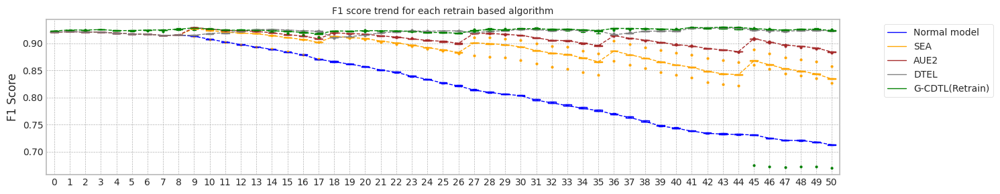

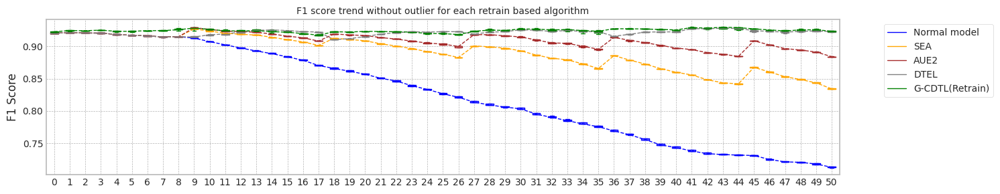

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.837863445281982
Base flops (train + inference flops of normal model, median): 3918915000.0


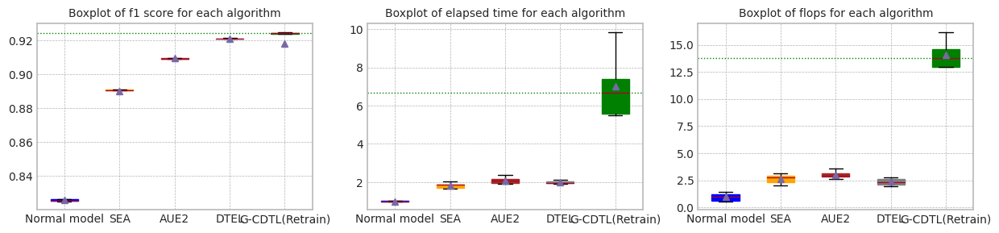

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.837863445281982


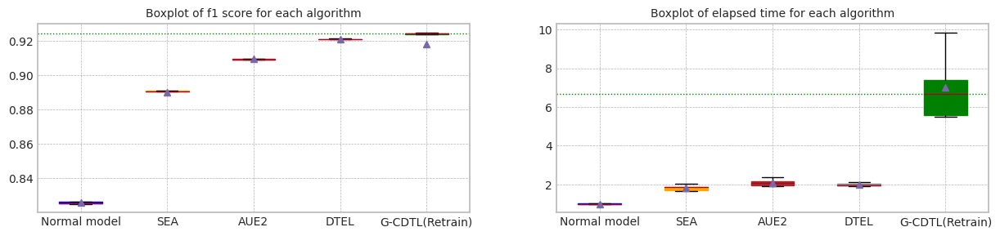

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.816301,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.837863,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.870718,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.944789,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.802790,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.837863,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.056624,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.895763,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.978657,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,10.014286,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.987937,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.918757,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.978657,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.049746,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.882317,0.826484,16.795054,3.805815e+09,7.176630e+09,1.098244e+10
1,1.0,0.920325,0.921341,0.890879,0.834303,20.077430,4.549665e+09,6.992625e+09,1.154229e+10
2,2.0,0.920255,0.921272,0.890675,0.834072,18.375469,4.095960e+09,8.257605e+09,1.235356e+10
3,3.0,0.920576,0.921592,0.895201,0.858014,16.315333,3.607020e+09,4.354785e+09,7.961805e+09
4,4.0,0.920325,0.921341,0.891055,0.835228,18.530532,4.117710e+09,4.990755e+09,9.108465e+09
5,median,0.920325,0.921341,0.890879,0.834303,18.375469,4.095960e+09,6.992625e+09,1.098244e+10
6,std,0.000125,0.000125,0.004701,0.011929,1.502198,3.574666e+08,1.625082e+09,1.807817e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.909424,0.884285,19.156946,4.383930e+09,7.954410e+09,1.233834e+10
1,1.0,0.920325,0.921341,0.909426,0.883785,18.651304,4.224285e+09,6.866910e+09,1.109120e+10
2,2.0,0.920255,0.921272,0.909623,0.884157,21.142786,4.795875e+09,9.157185e+09,1.395306e+10
3,3.0,0.920576,0.921592,0.909631,0.884047,23.228118,5.239575e+09,6.187005e+09,1.142658e+10
4,4.0,0.920325,0.921341,0.909145,0.881966,20.432128,4.567935e+09,5.640645e+09,1.020858e+10
5,median,0.920325,0.921341,0.909426,0.884047,20.432128,4.567935e+09,6.866910e+09,1.142658e+10
6,std,0.000125,0.000125,0.000198,0.000958,1.808273,3.960254e+08,1.410752e+09,1.423014e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.921446,0.923579,19.071882,4.395240e+09,5.771145e+09,1.016638e+10
1,1.0,0.920325,0.921341,0.921326,0.923294,18.924329,4.263870e+09,4.973355e+09,9.237225e+09
2,2.0,0.920255,0.921272,0.921296,0.921870,19.332378,4.359570e+09,6.613305e+09,1.097288e+10
3,3.0,0.920576,0.921592,0.920995,0.922793,20.805198,4.712355e+09,3.607890e+09,8.320245e+09
4,4.0,0.920325,0.921341,0.921150,0.922408,20.153708,4.530090e+09,3.247275e+09,7.777365e+09
5,median,0.920325,0.921341,0.921296,0.922793,19.332378,4.395240e+09,4.973355e+09,9.237225e+09
6,std,0.000125,0.000125,0.000174,0.000683,0.798377,1.739543e+08,1.421642e+09,1.306836e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.923918,0.925853,72.734859,5.708845e+10,53730000.0,5.714218e+10
1,1.0,0.922875,0.924630,0.924451,0.923376,53.956977,5.083330e+10,53730000.0,5.088703e+10
2,2.0,0.922514,0.924461,0.925072,0.924087,96.904042,6.336200e+10,53730000.0,6.341574e+10
3,3.0,0.921861,0.923788,0.894149,0.670802,65.789368,5.391541e+10,53730000.0,5.396914e+10
4,4.0,0.921318,0.923471,0.924198,0.922928,54.777335,5.058550e+10,53730000.0,5.063922e+10
5,median,0.922514,0.924461,0.924198,0.923376,65.789368,5.391541e+10,53730000.0,5.396914e+10
6,std,0.000668,0.000544,0.013540,0.113266,17.545152,5.295923e+09,0.0,5.295923e+09


Test F1 Score: 0.9203812038023009
G-CDTL, 1-retrain: 0.919057124116446


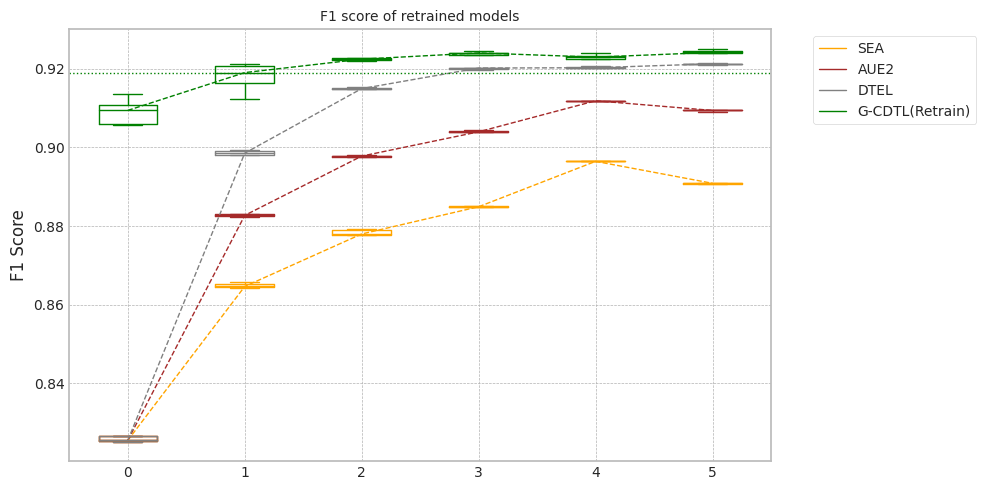

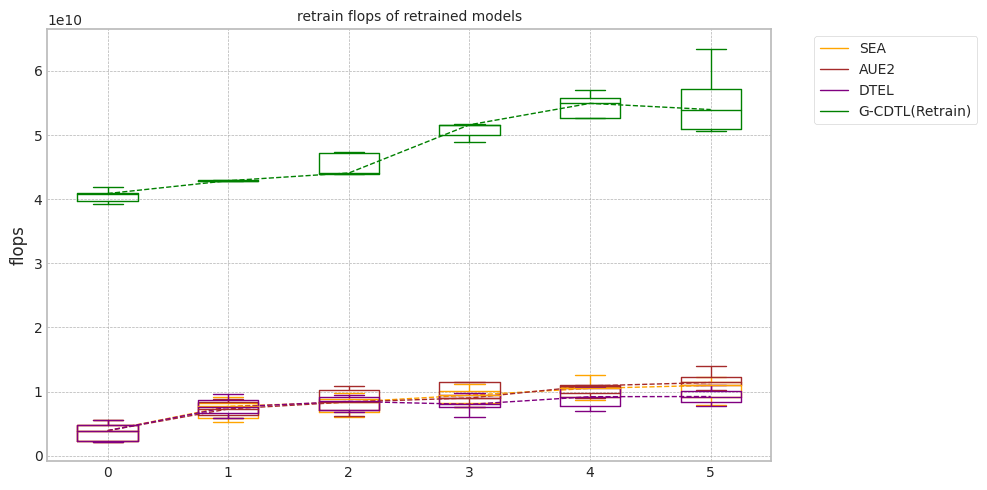

In [ ]:
experiment_all(2000,'case4',X1, Y1,train_size, test_size,avaible_range = 300,
               lambda_f2=0.8,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

## synthetic data의 생성 (Case #5 - Case #1,2,3,4의 상황이 각 feature에 혼재되어 있는 경우)

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ 전체적으로는 Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ $x_0$ : No drift
+ $x_1$ : $P_t(y|X) = P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Virtual Drift
+ $x_2$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Real Concept Drift, MI 감소, Drift 증가
+ $x_3$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Real Concept Drift, MI 증가, Drift 증가
+ $z_0$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) = P_{t+w}(X)$ 인 Actual Drift, MI 감소, Drift 고정


### Dataset 준비

In [ ]:
seed_everything()

data_size = 40000
cor = np.asarray([1.5, 1.2, 0.5 , 0.7, 2.5])

x4 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x4[:,ix] = np.random.normal(1,cor_,data_size)

y4_array = []
cor_const = cor[4]
cor_const2 = 3/x4.shape[0]
for ii in range(x4.shape[0]):
    # Case #2, MI의 증감(상대적), Drift의 고정 - z0
    cor[4] = cor[4] - cor_const / x4.shape[0]
    e = np.random.normal(0.0, 2.0)
    # Case #3 MI의 증감(상대적), Drift의 증가 - x3
    e1 = np.random.normal(0.0, 3*cor_const2 * ii)
    x4[ii,3] = x4[ii,3] + e1
    y4_array.append(np.sum(cor * x4[ii])+e)

y4 = [1 if y_ > 5 else 0 for y_ in y4_array]

for i in range(len(y4)):
    #Case #1 MI의 감소, Drift의 증가 - x2
    x4[i,2] = y4[i] + np.random.normal(1,0.5+6*(i/data_size))
    #Case #4 MI의 고정, Drift의 증가 - x1
    x4[i,1] = y4[i] + np.random.normal(0.0 + 5*(i/data_size),cor[1])

### 실험

MI Analysis MI Max 0.14553, Min 0.01466, Mean 0.06221, Std 0.05048
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:06<00:00,  5.16it/s]


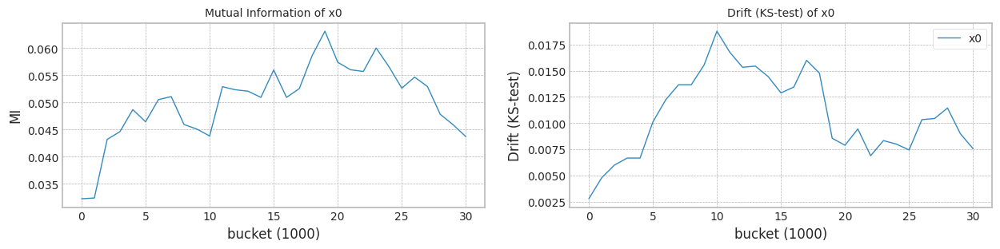

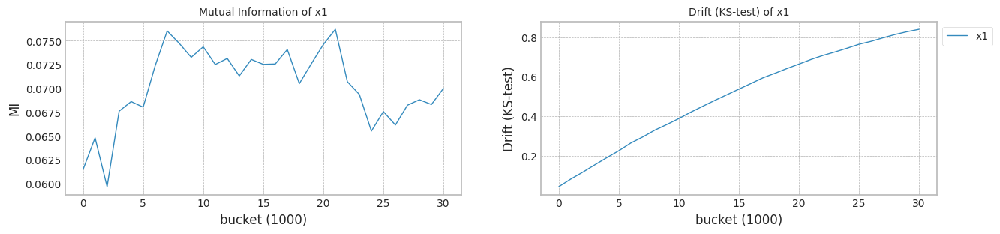

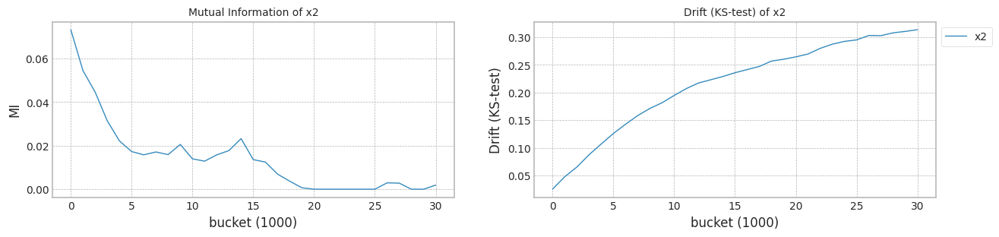

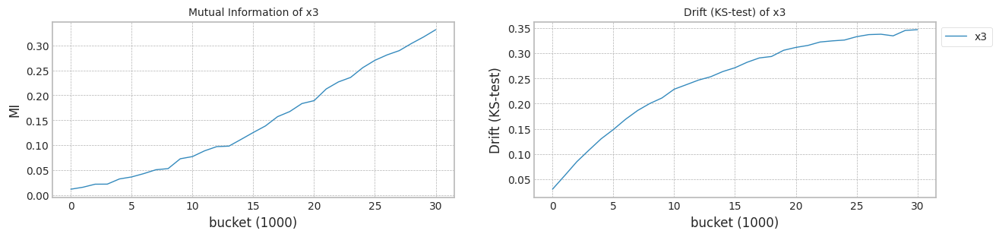

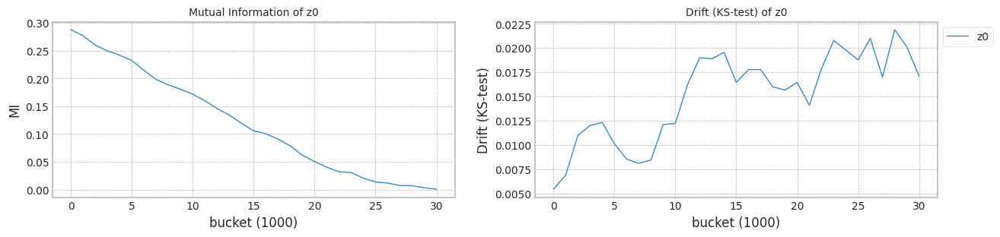

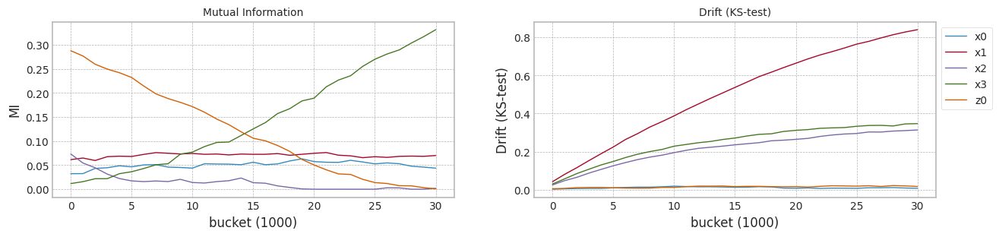

In [ ]:
columns=['x0','x1','x2','x3','z0']
X4 = pd.DataFrame(x4,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X4, y4,train_size, test_size)

In [ ]:
bucket_size = 500
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.333218,0.407388,0.544992,0.366139,0
1,0.610533,0.485121,0.442603,0.555701,0.662926,0
2,0.556874,0.343161,0.521317,0.605806,0.486574,0
3,0.344341,0.461929,0.599438,0.537806,0.611850,0
4,0.503142,0.520745,0.406416,0.515854,0.487044,0
...,...,...,...,...,...,...
39995,0.333622,0.740534,0.134489,0.657291,0.709407,79
39996,0.358451,1.150512,-0.133533,0.366003,0.695384,79
39997,0.559469,1.058702,0.654202,1.326009,0.504288,79
39998,0.433692,1.134226,0.229890,0.802431,0.762158,79


trial_count: 1
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 12:10:34,841] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 968/2000 [00:05<00:05, 181.24it/s]

Early stop: 968
[2023-11-30 12:10:40,189] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3793635000
precision_recall_fscore: (array([0.89566143, 0.90749571]), array([0.87402597, 0.9238835 ]), array([0.88471145, 0.91561628]), array([3850, 5150]))
Test f1 score: 0.9156162801885885
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.03it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8297476836452425
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:10:46,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:10:46,441] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 439/2000 [00:02<00:09, 161.83it/s]

[2023-11-30 12:10:57,670] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:10:57,671] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6930000000 1722600000 40152600000
precision_recall_fscore: (array([0.88169586, 0.92550879]), array([0.90207792, 0.90951456]), array([0.89177045, 0.91744197]), array([3850, 5150]))
Test f1 score: 0.9174419743413965
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]


mean of drift:
x0    0.214197
x1    0.459204
x2    0.169921
x3    0.231502
z0    0.337323
dtype: float64
Mean F1 for all data: 0.8407336960822396
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:11:07,140] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:11:07,143] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:11:17,351] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:11:17,352] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:13<00:49,  3.28s/it]

G-CDTL train flops: 3426500000 721000000 179220000 4326720000


100%|██████████| 31/31 [00:16<00:00,  1.88it/s]


Early stop at  [411]
Train flops  [4326720000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8747507191454909
G_CDTL+AUE median: 0.8747507191454909
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.29it/s]

Ensemble_SEA train flops: 347130000


100%|██████████| 31/31 [00:07<00:00,  4.25it/s]


Early stop at  [797]
Train flops  [347130000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8491775290397382
SEA median: 0.8491775290397382
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:06,  2.05it/s]

Ensemble_SEA train flops: 419340000


100%|██████████| 31/31 [00:07<00:00,  4.11it/s]


Early stop at  [963]
Train flops  [419340000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8606670248614434
AUE median: 0.8606670248614434
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.99it/s]

Ensemble_DTEL train flops: 429345000


 55%|█████▍    | 17/31 [00:05<00:08,  1.60it/s]

Ensemble_DTEL train flops: 193140000


100%|██████████| 31/31 [00:08<00:00,  3.78it/s]


Early stop at  [986, 443]
Train flops  [429345000, 193140000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8649060628074824
DTEL median: 0.8649060628074824


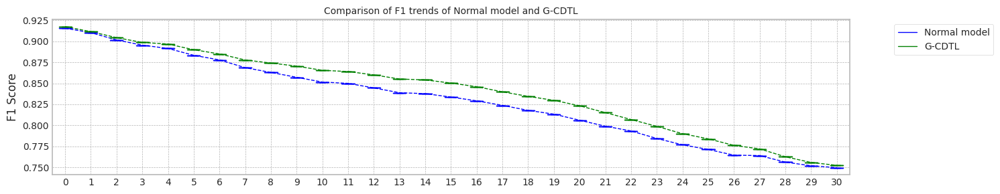

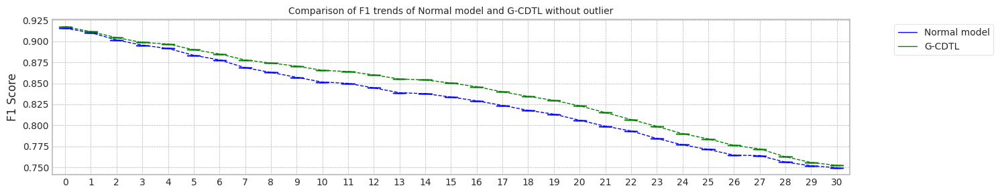

max_mean_trial= 0


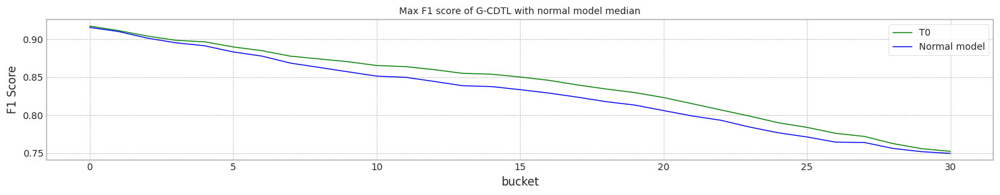

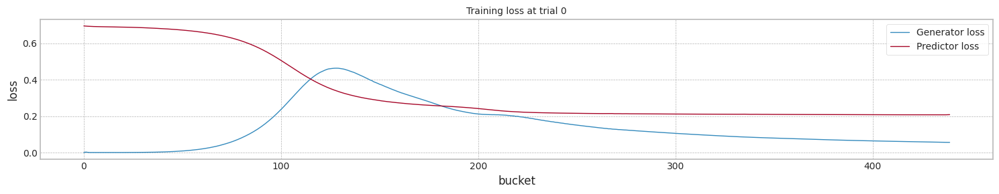

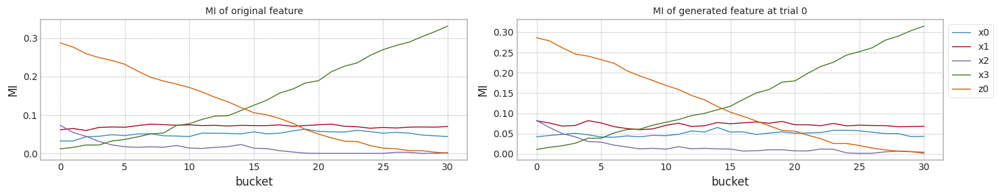

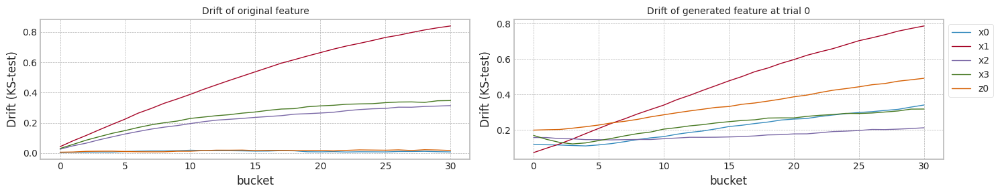

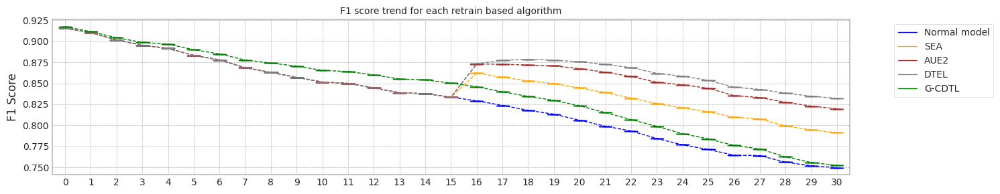

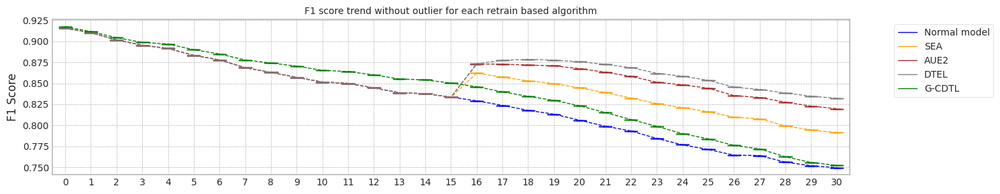

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.232304573059082
Base flops (inference flops of normal model, median): 121365000.0


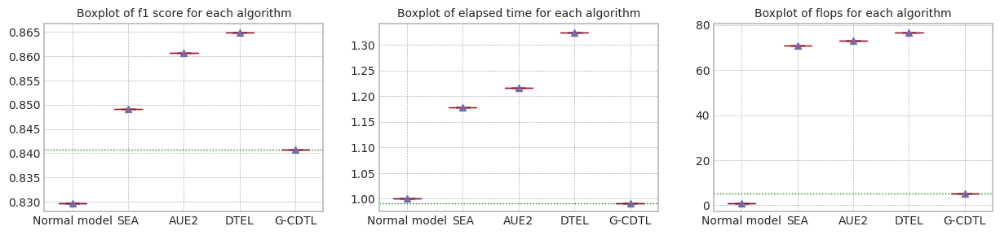

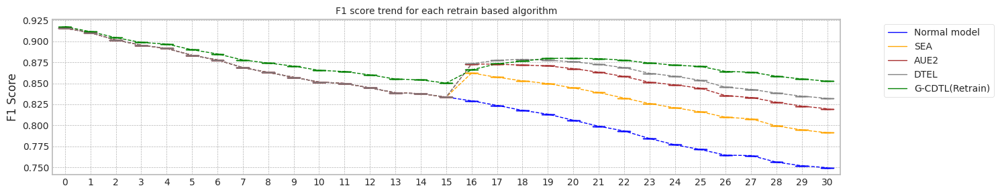

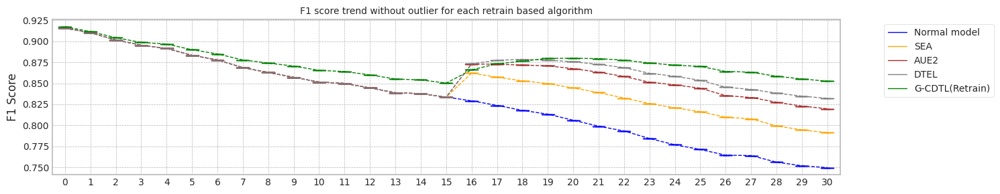

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.232304573059082
Base flops (train + inference flops of normal model, median): 3915000000.0


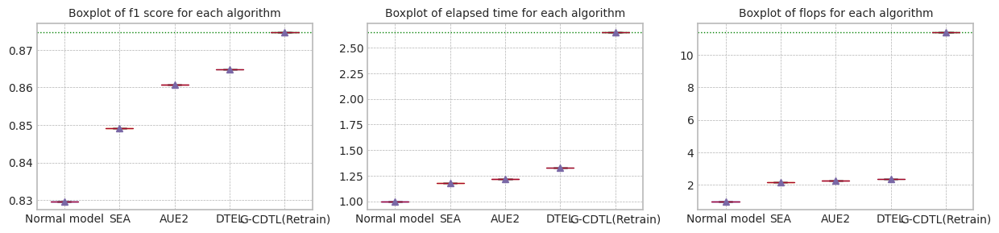

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.232304573059082


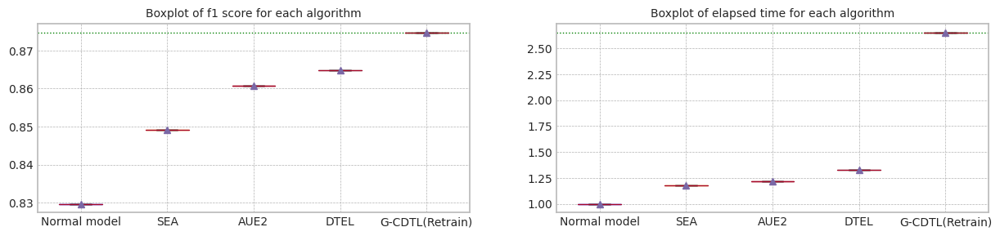

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.829748,0.74966,6.232305,3.793635e+09,121365000.0,3.915000e+09
1,median,0.915616,0.910295,0.829748,0.74966,6.232305,3.793635e+09,121365000.0,3.915000e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.840734,0.752348,6.181578,4.015260e+10,609615000.0,4.076222e+10
1,median,0.917442,0.911551,0.840734,0.752348,6.181578,4.015260e+10,609615000.0,4.076222e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.849178,0.791211,7.345859,4.140765e+09,4.446135e+09,8.586900e+09
1,median,0.915616,0.910295,0.849178,0.791211,7.345859,4.140765e+09,4.446135e+09,8.586900e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.860667,0.819748,7.584336,4.212975e+09,4.639710e+09,8.852685e+09
1,median,0.915616,0.910295,0.860667,0.819748,7.584336,4.212975e+09,4.639710e+09,8.852685e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.864906,0.83213,8.25449,4.416120e+09,4.905495e+09,9.321615e+09
1,median,0.915616,0.910295,0.864906,0.83213,8.25449,4.416120e+09,4.905495e+09,9.321615e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.874751,0.852542,16.534721,4.447932e+10,134325000.0,4.461364e+10
1,median,0.917442,0.911551,0.874751,0.852542,16.534721,4.447932e+10,134325000.0,4.461364e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case5',X1, Y1,train_size, test_size,avaible_range = 400,
                                                            lambda_f2=0.9,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 12:13:10,197] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 968/2000 [00:02<00:02, 468.52it/s]

Early stop: 968
[2023-11-30 12:13:12,269] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3793635000
precision_recall_fscore: (array([0.89566143, 0.90749571]), array([0.87402597, 0.9238835 ]), array([0.88471145, 0.91561628]), array([3850, 5150]))
Test f1 score: 0.9156162801885885
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.06it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8297476836452425
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:13:18,475] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:13:18,477] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 439/2000 [00:02<00:09, 158.62it/s]

[2023-11-30 12:13:29,912] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:13:29,913] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6930000000 1722600000 40152600000
precision_recall_fscore: (array([0.88169586, 0.92550879]), array([0.90207792, 0.90951456]), array([0.89177045, 0.91744197]), array([3850, 5150]))
Test f1 score: 0.9174419743413965
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.98it/s]

mean of drift:
x0    0.214197
x1    0.459204
x2    0.169921
x3    0.231502
z0    0.337323
dtype: float64
Mean F1 for all data: 0.8407336960822396
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-30 12:13:36,214] [INFO] [profiler.py:80:start_profile] Flops profiler started



 38%|███▊      | 765/2000 [00:01<00:02, 463.77it/s]

Early stop: 765
[2023-11-30 12:13:37,872] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2998890000
precision_recall_fscore: (array([0.89855072, 0.90481608]), array([0.86961039, 0.92660194]), array([0.88384372, 0.91557943]), array([3850, 5150]))
Test f1 score: 0.9155794320798158
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.02it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8334474883649953
inference_flops: 121365000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:13:44,113] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:13:44,115] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 444/2000 [00:02<00:10, 153.98it/s]

[2023-11-30 12:13:52,316] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:13:52,317] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 19230750000 7008750000 1742175000 27981675000
precision_recall_fscore: (array([0.88052872, 0.92380576]), array([0.89974026, 0.90873786]), array([0.89003083, 0.91620987]), array([3850, 5150]))
Test f1 score: 0.9162098668754893
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]


mean of drift:
x0    0.153763
x1    0.323978
x2    0.173430
x3    0.279502
z0    0.214986
dtype: float64
Mean F1 for all data: 0.8378116662863696
inference_flops: 609615000
Normal model median        : 0.8315975860051189
Drift tolerant model median: 0.8392726811843045
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-30 12:13:58,527] [INFO] [profiler.py:80:start_profile] Flops profiler started


 39%|███▉      | 787/2000 [00:01<00:02, 476.80it/s]

Early stop: 787
[2023-11-30 12:14:00,184] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3085020000
precision_recall_fscore: (array([0.89721627, 0.90539514]), array([0.87064935, 0.92543689]), array([0.88373319, 0.91530632]), array([3850, 5150]))
Test f1 score: 0.9153063184175149
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.98it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8296577026854857
inference_flops: 121365000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:14:06,470] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:14:06,472] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 29%|██▉       | 575/2000 [00:03<00:09, 152.11it/s]

[2023-11-30 12:14:10,383] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:14:10,384] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 9072000000 2255040000 11752290000
precision_recall_fscore: (array([0.90276659, 0.90733371]), array([0.87298701, 0.92970874]), array([0.8876271 , 0.91838496]), array([3850, 5150]))
Test f1 score: 0.9183849621175794
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

mean of drift:
x0    0.170061
x1    0.373964
x2    0.146014
x3    0.184556
z0    0.196495
dtype: float64
Mean F1 for all data: 0.8303009494211239
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8378116662863696
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-30 12:14:16,705] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▋       | 525/2000 [00:01<00:03, 448.18it/s]

Early stop: 525
[2023-11-30 12:14:17,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2059290000
precision_recall_fscore: (array([0.89548249, 0.90492489]), array([0.87012987, 0.92407767]), array([0.88262416, 0.914401  ]), array([3850, 5150]))
Test f1 score: 0.9144009991353637
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.02it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8189535580239609
inference_flops: 121365000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:14:24,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:14:24,134] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 18%|█▊        | 367/2000 [00:02<00:10, 154.19it/s]

[2023-11-30 12:14:35,288] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:14:35,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5796000000 1440720000 38736720000
precision_recall_fscore: (array([0.90333063, 0.90314679]), array([0.86649351, 0.93067961]), array([0.8845287 , 0.91670651]), array([3850, 5150]))
Test f1 score: 0.9167065123840489
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.00it/s]

mean of drift:
x0    0.143351
x1    0.381183
x2    0.310957
x3    0.241613
z0    0.230939
dtype: float64
Mean F1 for all data: 0.8457878928025607
inference_flops: 609615000
Normal model median        : 0.8297026931653642
Drift tolerant model median: 0.8392726811843045
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-30 12:14:41,552] [INFO] [profiler.py:80:start_profile] Flops profiler started



 55%|█████▍    | 1090/2000 [00:02<00:01, 464.84it/s]

Early stop: 1090
[2023-11-30 12:14:43,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4271265000
precision_recall_fscore: (array([0.89949075, 0.90624407]), array([0.87168831, 0.92718447]), array([0.88537132, 0.91659468]), array([3850, 5150]))
Test f1 score: 0.9165946827910548
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.01it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8442659535091332
inference_flops: 121365000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:14:50,164] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:14:50,166] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:02<00:10, 152.94it/s]

[2023-11-30 12:15:01,796] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:15:01,797] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6756750000 1679535000 39936285000
precision_recall_fscore: (array([0.90337382, 0.90500472]), array([0.86935065, 0.93048544]), array([0.88603574, 0.91756821]), array([3850, 5150]))
Test f1 score: 0.9175682144566778
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.05it/s]


mean of drift:
x0    0.108262
x1    0.334530
x2    0.221606
x3    0.182735
z0    0.225756
dtype: float64
Mean F1 for all data: 0.843200881802644
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:15:11,291] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:15:11,293] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:15:22,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:15:22,362] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 17/31 [00:14<00:35,  2.53s/it]

G-CDTL train flops: 3500000000 764750000 190095000 4454845000


100%|██████████| 31/31 [00:17<00:00,  1.79it/s]


Early stop at  [436]
Train flops  [4454845000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8741320287573952
G_CDTL+AUE median: 0.8741320287573952
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:07,  1.90it/s]

Ensemble_SEA train flops: 317985000


100%|██████████| 31/31 [00:07<00:00,  4.24it/s]


Early stop at  [730]
Train flops  [317985000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8481158534741337
SEA median: 0.8481158534741337
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:11,  1.33it/s]

Ensemble_SEA train flops: 553755000


100%|██████████| 31/31 [00:08<00:00,  3.84it/s]


Early stop at  [1272]
Train flops  [553755000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8597473437391938
AUE median: 0.8597473437391938
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.99it/s]

Ensemble_DTEL train flops: 329295000


 55%|█████▍    | 17/31 [00:05<00:07,  1.76it/s]

Ensemble_DTEL train flops: 193140000


100%|██████████| 31/31 [00:07<00:00,  3.90it/s]


Early stop at  [756, 443]
Train flops  [329295000, 193140000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8649060628074824
DTEL median: 0.8649060628074824
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:15:52,101] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:15:52,103] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:16:02,873] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:16:02,875] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:51,  3.45s/it]

G-CDTL train flops: 3500000000 680750000 169215000 4349965000


100%|██████████| 31/31 [00:16<00:00,  1.82it/s]


Early stop at  [388]
Train flops  [4349965000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8716980007031271
G_CDTL+AUE median: 0.8729150147302611
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:06<00:10,  1.27it/s]

Ensemble_SEA train flops: 804315000


100%|██████████| 31/31 [00:09<00:00,  3.41it/s]


Early stop at  [1848]
Train flops  [804315000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8509260921686542
SEA median: 0.8495209728213939
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:09,  1.59it/s]

Ensemble_SEA train flops: 429780000


100%|██████████| 31/31 [00:07<00:00,  4.05it/s]


Early stop at  [987]
Train flops  [429780000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8612863663913491
AUE median: 0.8605168550652715
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.18it/s]

Ensemble_DTEL train flops: 343650000


 55%|█████▍    | 17/31 [00:07<00:13,  1.00it/s]

Ensemble_DTEL train flops: 803445000


100%|██████████| 31/31 [00:09<00:00,  3.12it/s]


Early stop at  [789, 1846]
Train flops  [343650000, 803445000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8660814198839674
DTEL median: 0.8654937413457249
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:16:35,990] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:16:35,993] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:16:47,113] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:16:47,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:53,  3.56s/it]

G-CDTL train flops: 3500000000 750750000 186615000 4437365000


100%|██████████| 31/31 [00:17<00:00,  1.77it/s]


Early stop at  [428]
Train flops  [4437365000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8728584530126248
G_CDTL+AUE median: 0.8728584530126248
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:05<00:08,  1.68it/s]

Ensemble_SEA train flops: 566370000


100%|██████████| 31/31 [00:08<00:00,  3.85it/s]


Early stop at  [1301]
Train flops  [566370000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8483254458169337
SEA median: 0.8483254458169337
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:07,  2.14it/s]

Ensemble_SEA train flops: 249255000


100%|██████████| 31/31 [00:07<00:00,  4.38it/s]


Early stop at  [572]
Train flops  [249255000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8600125501014303
AUE median: 0.8600125501014303
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.08it/s]

Ensemble_DTEL train flops: 655980000


 52%|█████▏    | 16/31 [00:05<00:15,  1.03s/it]

Ensemble_DTEL train flops: 140505000


100%|██████████| 31/31 [00:08<00:00,  3.47it/s]


Early stop at  [1507, 322]
Train flops  [655980000, 140505000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8656515492310356
DTEL median: 0.8656515492310356
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:17:17,821] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:17:17,824] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:17:28,298] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:17:28,299] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:13<00:50,  3.36s/it]

G-CDTL train flops: 3500000000 579250000 143985000 4223235000


100%|██████████| 31/31 [00:16<00:00,  1.83it/s]


Early stop at  [330]
Train flops  [4223235000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8744551300933833
G_CDTL+AUE median: 0.87349524088501
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:05<00:08,  1.65it/s]

Ensemble_SEA train flops: 568110000


100%|██████████| 31/31 [00:08<00:00,  3.78it/s]


Early stop at  [1305]
Train flops  [568110000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8418657343776693
SEA median: 0.8482206496455337
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:06,  2.20it/s]

Ensemble_SEA train flops: 227505000


100%|██████████| 31/31 [00:07<00:00,  4.32it/s]


Early stop at  [522]
Train flops  [227505000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8568165429078582
AUE median: 0.859879946920312
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.93it/s]

Ensemble_DTEL train flops: 586815000


 52%|█████▏    | 16/31 [00:05<00:14,  1.02it/s]

Ensemble_DTEL train flops: 171390000


100%|██████████| 31/31 [00:08<00:00,  3.53it/s]


Early stop at  [1348, 393]
Train flops  [586815000, 171390000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8636526381877041
DTEL median: 0.865278806019259
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  4.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:17:59,084] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:17:59,087] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:18:10,702] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:18:10,703] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:14<00:55,  3.71s/it]

G-CDTL train flops: 3500000000 887250000 220545000 4607795000


100%|██████████| 31/31 [00:18<00:00,  1.72it/s]


Early stop at  [506]
Train flops  [4607795000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8735672885333633
G_CDTL+AUE median: 0.8735672885333633
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:04<00:08,  1.81it/s]

Ensemble_SEA train flops: 332340000


100%|██████████| 31/31 [00:07<00:00,  4.17it/s]


Early stop at  [763]
Train flops  [332340000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8567194239388091
SEA median: 0.8483254458169337
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:05<00:12,  1.20it/s]

Ensemble_SEA train flops: 585075000


100%|██████████| 31/31 [00:08<00:00,  3.72it/s]


Early stop at  [1344]
Train flops  [585075000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8649280578300508
AUE median: 0.8600125501014303
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 52%|█████▏    | 16/31 [00:03<00:06,  2.34it/s]

Ensemble_DTEL train flops: 210975000
Ensemble_DTEL train flops: 3480000


100%|██████████| 31/31 [00:06<00:00,  4.45it/s]


Early stop at  [484, 7]
Train flops  [210975000, 3480000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.855604555389604
DTEL median: 0.8649060628074824


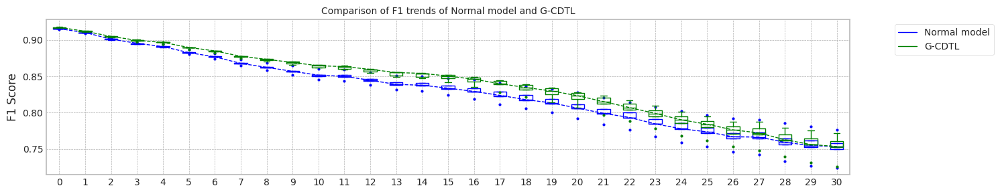

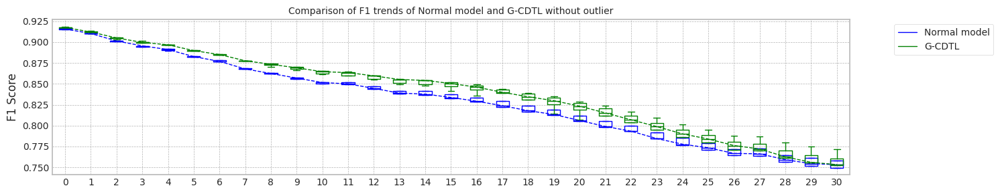

max_mean_trial= 3


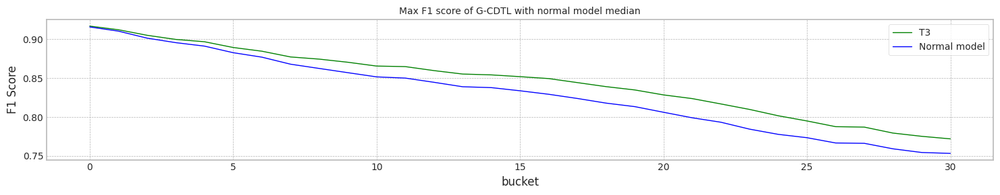

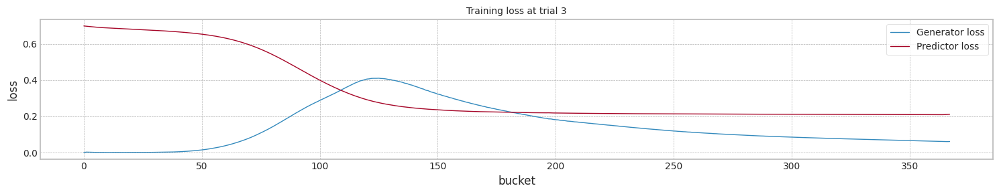

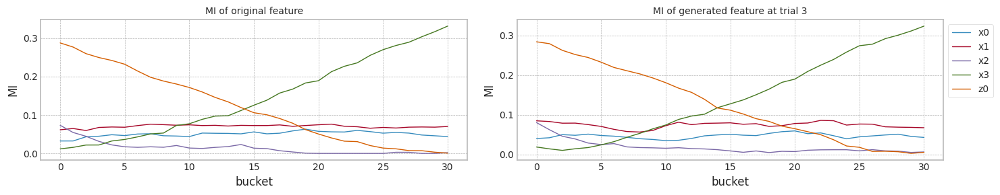

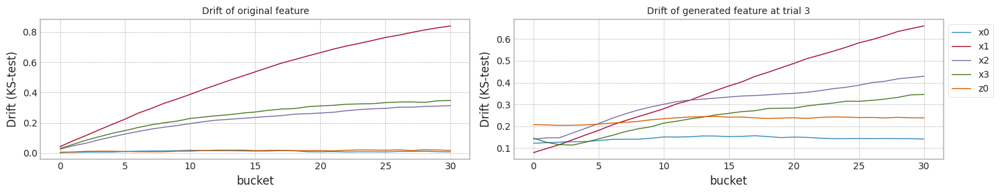

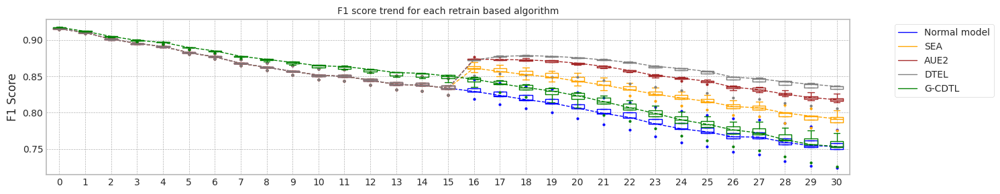

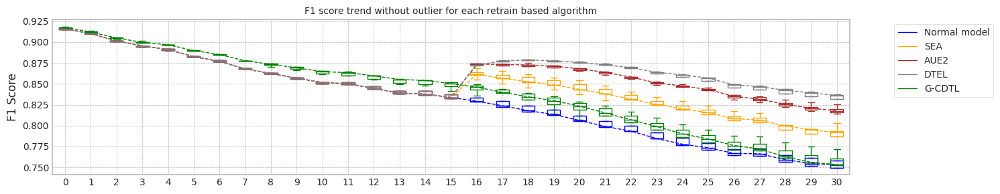

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.229193449020386
Base flops (inference flops of normal model, median): 121365000.0


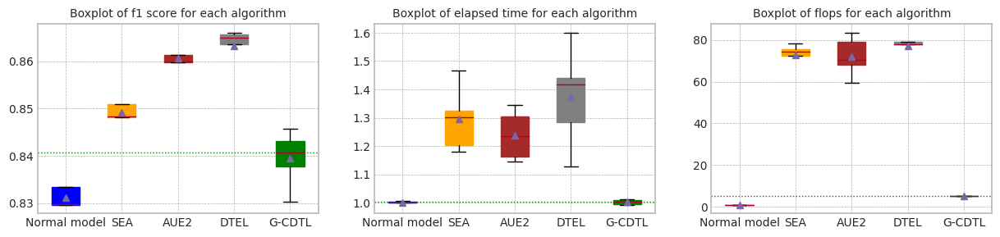

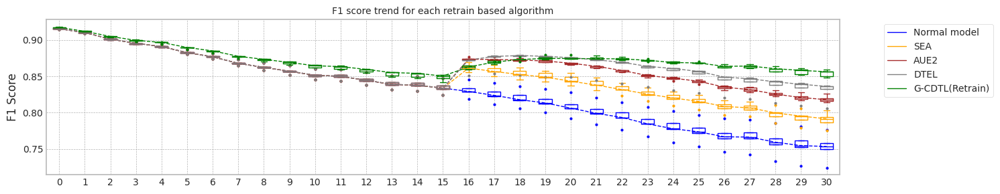

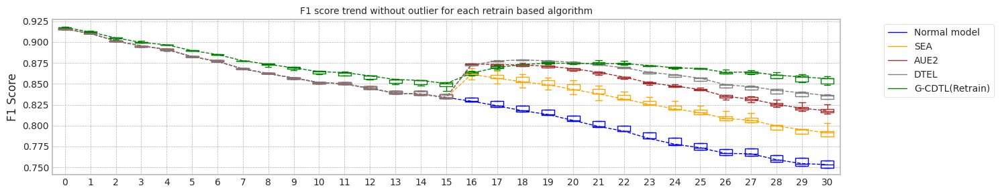

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.229193449020386
Base flops (train + inference flops of normal model, median): 3206385000.0


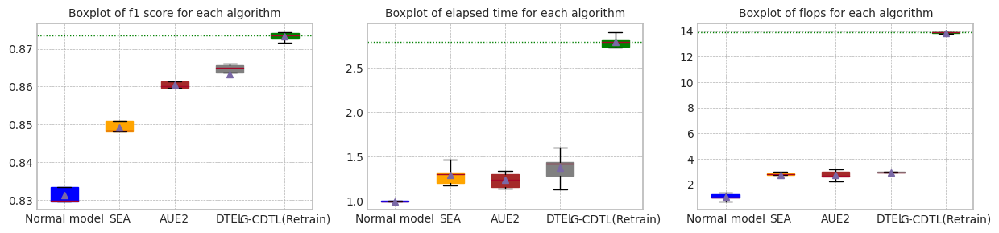

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.229193449020386


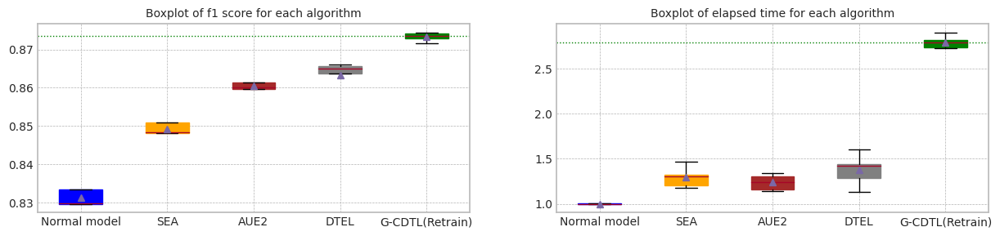

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.829748,0.749660,6.186982,3.793635e+09,121365000.0,3.915000e+09
1,1.0,0.915579,0.910222,0.833447,0.758317,6.224885,2.998890e+09,121365000.0,3.120255e+09
2,2.0,0.915306,0.910049,0.829658,0.753309,6.270216,3.085020e+09,121365000.0,3.206385e+09
3,3.0,0.914401,0.908813,0.818954,0.724145,6.229193,2.059290e+09,121365000.0,2.180655e+09
4,4.0,0.916595,0.911179,0.844266,0.776449,6.243106,4.271265e+09,121365000.0,4.392630e+09
5,median,0.915579,0.910222,0.829748,0.753309,6.229193,3.085020e+09,121365000.0,3.206385e+09
6,std,0.000785,0.000848,0.009086,0.018842,0.030260,8.435394e+08,0.0,8.435394e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.840734,0.752348,6.281781,4.015260e+10,609615000.0,4.076222e+10
1,1.0,0.916210,0.910644,0.837812,0.753283,6.190304,2.798168e+10,609615000.0,2.859129e+10
2,2.0,0.918385,0.913173,0.830301,0.725624,6.302204,1.175229e+10,609615000.0,1.236190e+10
3,3.0,0.916707,0.912018,0.845788,0.771953,6.244523,3.873672e+10,609615000.0,3.934634e+10
4,4.0,0.917568,0.912789,0.843201,0.760834,6.182386,3.993628e+10,609615000.0,4.054590e+10
5,median,0.917442,0.912018,0.840734,0.753283,6.244523,3.873672e+10,609615000.0,3.934634e+10
6,std,0.000837,0.001004,0.005963,0.017105,0.053442,1.225290e+10,0.0,1.225290e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.848116,0.786829,7.353778,4.589250e+09,4.416990e+09,9.006240e+09
1,1.0,0.915579,0.910222,0.850926,0.793758,9.134160,5.075580e+09,4.108575e+09,9.184155e+09
2,2.0,0.915306,0.910049,0.848325,0.791463,8.115381,4.837635e+09,3.956760e+09,8.794395e+09
3,3.0,0.914401,0.908813,0.841866,0.775314,8.258534,4.839375e+09,2.932770e+09,7.772145e+09
4,4.0,0.916595,0.911179,0.856719,0.802785,7.490589,4.603605e+09,4.908975e+09,9.512580e+09
5,median,0.915579,0.910222,0.848325,0.791463,8.115381,4.837635e+09,4.108575e+09,9.006240e+09
6,std,0.000785,0.000848,0.005368,0.010068,0.710410,2.008124e+08,7.300257e+08,6.595206e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.859747,0.815627,8.116549,4.825020e+09,4.774125e+09,9.599145e+09
1,1.0,0.915579,0.910222,0.861286,0.819762,7.700519,4.701045e+09,3.855405e+09,8.556450e+09
2,2.0,0.915306,0.910049,0.860013,0.817795,7.133361,4.520520e+09,3.761010e+09,8.281530e+09
3,3.0,0.914401,0.908813,0.856817,0.813981,7.231896,4.498770e+09,2.713530e+09,7.212300e+09
4,4.0,0.916595,0.911179,0.864928,0.825774,8.375023,4.856340e+09,5.283075e+09,1.013942e+10
5,median,0.915579,0.910222,0.860013,0.817795,7.700519,4.701045e+09,3.855405e+09,8.556450e+09
6,std,0.000785,0.000848,0.002940,0.004573,0.540535,1.664685e+08,9.935547e+08,1.148114e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.864906,0.832130,7.996516,4.793700e+09,4.805445e+09,9.599145e+09
1,1.0,0.915579,0.910222,0.866081,0.836682,9.972528,5.418360e+09,4.635360e+09,1.005372e+10
2,2.0,0.915306,0.910049,0.865652,0.837455,8.977652,5.067750e+09,4.370880e+09,9.438630e+09
3,3.0,0.914401,0.908813,0.863653,0.836132,8.829887,5.029470e+09,3.306870e+09,8.336340e+09
4,4.0,0.916595,0.911179,0.855605,0.806155,7.025245,4.485720e+09,4.975095e+09,9.460815e+09
5,median,0.915579,0.910222,0.864906,0.836132,8.829887,5.029470e+09,4.635360e+09,9.460815e+09
6,std,0.000785,0.000848,0.004333,0.013328,1.108546,3.460933e+08,6.604054e+08,6.326713e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.874132,0.848534,17.346919,4.439113e+10,134325000.0,4.452546e+10
1,1.0,0.916210,0.910644,0.871698,0.850229,17.039838,4.428625e+10,134325000.0,4.442058e+10
2,2.0,0.918385,0.913173,0.872858,0.856824,17.535419,4.437365e+10,134325000.0,4.450798e+10
3,3.0,0.916707,0.912018,0.874455,0.858939,16.984408,4.415952e+10,134325000.0,4.429384e+10
4,4.0,0.917568,0.912789,0.873567,0.856287,18.065287,4.454408e+10,134325000.0,4.467840e+10
5,median,0.917442,0.912018,0.873567,0.856287,17.346919,4.437365e+10,134325000.0,4.450798e+10
6,std,0.000837,0.001004,0.001101,0.004516,0.437618,1.416514e+08,0.0,1.416514e+08


trial_count: 5
Lambda :  0.9
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 12:18:49,095] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 968/2000 [00:02<00:02, 436.14it/s]

Early stop: 968
[2023-11-30 12:18:51,326] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3793635000
precision_recall_fscore: (array([0.89566143, 0.90749571]), array([0.87402597, 0.9238835 ]), array([0.88471145, 0.91561628]), array([3850, 5150]))
Test f1 score: 0.9156162801885885
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.75it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8297476836452425
inference_flops: 121365000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:18:57,918] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:18:57,920] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 439/2000 [00:03<00:10, 141.94it/s]

[2023-11-30 12:19:10,391] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:19:10,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6930000000 1722600000 40152600000
precision_recall_fscore: (array([0.88169586, 0.92550879]), array([0.90207792, 0.90951456]), array([0.89177045, 0.91744197]), array([3850, 5150]))
Test f1 score: 0.9174419743413965
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]

mean of drift:
x0    0.214197
x1    0.459204
x2    0.169921
x3    0.231502
z0    0.337323
dtype: float64
Mean F1 for all data: 0.8407336960822396
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-30 12:19:16,898] [INFO] [profiler.py:80:start_profile] Flops profiler started



 38%|███▊      | 765/2000 [00:01<00:02, 435.97it/s]

Early stop: 765
[2023-11-30 12:19:18,661] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2998890000
precision_recall_fscore: (array([0.89855072, 0.90481608]), array([0.86961039, 0.92660194]), array([0.88384372, 0.91557943]), array([3850, 5150]))
Test f1 score: 0.9155794320798158
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8334474883649953
inference_flops: 121365000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:19:25,089] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:19:25,092] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 444/2000 [00:03<00:11, 137.88it/s]

[2023-11-30 12:19:33,950] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:19:33,951] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 19230750000 7008750000 1742175000 27981675000
precision_recall_fscore: (array([0.88052872, 0.92380576]), array([0.89974026, 0.90873786]), array([0.89003083, 0.91620987]), array([3850, 5150]))
Test f1 score: 0.9162098668754893
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.87it/s]

mean of drift:
x0    0.153763
x1    0.323978
x2    0.173430
x3    0.279502
z0    0.214986
dtype: float64
Mean F1 for all data: 0.8378116662863696
inference_flops: 609615000
Normal model median        : 0.8315975860051189
Drift tolerant model median: 0.8392726811843045
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-30 12:19:40,393] [INFO] [profiler.py:80:start_profile] Flops profiler started



 39%|███▉      | 787/2000 [00:01<00:02, 439.75it/s]

Early stop: 787
[2023-11-30 12:19:42,189] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3085020000
precision_recall_fscore: (array([0.89721627, 0.90539514]), array([0.87064935, 0.92543689]), array([0.88373319, 0.91530632]), array([3850, 5150]))
Test f1 score: 0.9153063184175149
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8296577026854857
inference_flops: 121365000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:19:48,612] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:19:48,615] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 29%|██▉       | 575/2000 [00:03<00:09, 144.63it/s]

[2023-11-30 12:19:52,738] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:19:52,740] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 9072000000 2255040000 11752290000
precision_recall_fscore: (array([0.90276659, 0.90733371]), array([0.87298701, 0.92970874]), array([0.8876271 , 0.91838496]), array([3850, 5150]))
Test f1 score: 0.9183849621175794
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.02it/s]

mean of drift:
x0    0.170061
x1    0.373964
x2    0.146014
x3    0.184556
z0    0.196495
dtype: float64
Mean F1 for all data: 0.8303009494211239
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8378116662863696
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-30 12:19:58,987] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▋       | 525/2000 [00:01<00:03, 438.77it/s]

Early stop: 525
[2023-11-30 12:20:00,192] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2059290000
precision_recall_fscore: (array([0.89548249, 0.90492489]), array([0.87012987, 0.92407767]), array([0.88262416, 0.914401  ]), array([3850, 5150]))
Test f1 score: 0.9144009991353637
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.91it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8189535580239609
inference_flops: 121365000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:20:06,580] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:20:06,583] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 367/2000 [00:02<00:11, 141.10it/s]

[2023-11-30 12:20:18,617] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:20:18,618] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5796000000 1440720000 38736720000
precision_recall_fscore: (array([0.90333063, 0.90314679]), array([0.86649351, 0.93067961]), array([0.8845287 , 0.91670651]), array([3850, 5150]))
Test f1 score: 0.9167065123840489
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.98it/s]

mean of drift:
x0    0.143351
x1    0.381183
x2    0.310957
x3    0.241613
z0    0.230939
dtype: float64
Mean F1 for all data: 0.8457878928025607
inference_flops: 609615000
Normal model median        : 0.8297026931653642
Drift tolerant model median: 0.8392726811843045
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-30 12:20:24,921] [INFO] [profiler.py:80:start_profile] Flops profiler started



 55%|█████▍    | 1090/2000 [00:02<00:02, 439.24it/s]

Early stop: 1090
[2023-11-30 12:20:27,409] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4271265000
precision_recall_fscore: (array([0.89949075, 0.90624407]), array([0.87168831, 0.92718447]), array([0.88537132, 0.91659468]), array([3850, 5150]))
Test f1 score: 0.9165946827910548
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.92it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8442659535091332
inference_flops: 121365000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:20:33,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:20:33,790] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:11, 139.43it/s]

[2023-11-30 12:20:46,266] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:20:46,267] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6756750000 1679535000 39936285000
precision_recall_fscore: (array([0.90337382, 0.90500472]), array([0.86935065, 0.93048544]), array([0.88603574, 0.91756821]), array([3850, 5150]))
Test f1 score: 0.9175682144566778
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.90it/s]


mean of drift:
x0    0.108262
x1    0.334530
x2    0.221606
x3    0.182735
z0    0.225756
dtype: float64
Mean F1 for all data: 0.843200881802644
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  5.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:20:54,912] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:20:54,915] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:21:06,259] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:21:06,260] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:13<01:13,  3.68s/it]

G-CDTL train flops: 3428250000 738500000 183570000 4350320000


 68%|██████▊   | 21/31 [00:15<00:03,  3.32it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:21:08,530] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:21:08,532] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:21:20,310] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:21:20,311] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:27<00:34,  3.81s/it]

G-CDTL train flops: 3500000000 770000000 191400000 4461400000


100%|██████████| 31/31 [00:29<00:00,  1.05it/s]


Early stop at  [421, 439]
Train flops  [4350320000, 4461400000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8808684747228526
G_CDTL+AUE median: 0.8808684747228526
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:13,  1.44it/s]

Ensemble_SEA train flops: 442830000


 74%|███████▍  | 23/31 [00:07<00:03,  2.33it/s]

Ensemble_SEA train flops: 313635000


100%|██████████| 31/31 [00:08<00:00,  3.47it/s]


Early stop at  [1017, 720]
Train flops  [442830000, 313635000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8594403649298605
SEA median: 0.8594403649298605
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:04<00:16,  1.21it/s]

Ensemble_SEA train flops: 592035000


 71%|███████   | 22/31 [00:09<00:10,  1.16s/it]

Ensemble_SEA train flops: 858255000


100%|██████████| 31/31 [00:11<00:00,  2.69it/s]


Early stop at  [1360, 1972]
Train flops  [592035000, 858255000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8709552865994262
AUE median: 0.8709552865994262
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  4.84it/s]

Ensemble_DTEL train flops: 276225000


 35%|███▌      | 11/31 [00:06<00:29,  1.47s/it]

Ensemble_DTEL train flops: 870000000


 71%|███████   | 22/31 [00:10<00:06,  1.45it/s]

Ensemble_DTEL train flops: 408030000
Ensemble_DTEL train flops: 3045000


100%|██████████| 31/31 [00:12<00:00,  2.57it/s]


Early stop at  [634, 1999, 937, 6]
Train flops  [276225000, 870000000, 408030000, 3045000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.867041354465558
DTEL median: 0.867041354465558
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  4.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:21:57,078] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:21:57,080] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:22:08,457] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:22:08,458] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:13<01:13,  3.69s/it]

G-CDTL train flops: 3500000000 665000000 165300000 4330300000


 68%|██████▊   | 21/31 [00:15<00:03,  3.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:22:10,714] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:22:10,716] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:22:22,997] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:22:22,999] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:28<00:35,  3.96s/it]

G-CDTL train flops: 3500000000 810250000 201405000 4511655000


100%|██████████| 31/31 [00:29<00:00,  1.03it/s]


Early stop at  [379, 462]
Train flops  [4330300000, 4511655000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8788267457487459
G_CDTL+AUE median: 0.8798476102357993
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:03<00:07,  2.42it/s]

Ensemble_SEA train flops: 286665000


 71%|███████   | 22/31 [00:06<00:05,  1.69it/s]

Ensemble_SEA train flops: 355395000


100%|██████████| 31/31 [00:08<00:00,  3.60it/s]


Early stop at  [658, 816]
Train flops  [286665000, 355395000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8618895743200661
SEA median: 0.8606649696249633
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:03<00:08,  2.12it/s]

Ensemble_SEA train flops: 352350000


 71%|███████   | 22/31 [00:06<00:03,  2.26it/s]

Ensemble_SEA train flops: 210105000


100%|██████████| 31/31 [00:08<00:00,  3.70it/s]


Early stop at  [809, 482]
Train flops  [352350000, 210105000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8709571086078519
AUE median: 0.8709561976036391
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  4.97it/s]

Ensemble_DTEL train flops: 214890000


 35%|███▌      | 11/31 [00:04<00:16,  1.25it/s]

Ensemble_DTEL train flops: 317115000


 71%|███████   | 22/31 [00:09<00:09,  1.03s/it]

Ensemble_DTEL train flops: 766035000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:10<00:00,  2.82it/s]


Early stop at  [493, 728, 1760, 5]
Train flops  [214890000, 317115000, 766035000, 2610000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8682884770502779
DTEL median: 0.8676649157579179
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:01<00:04,  5.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:22:55,182] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:22:55,185] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:23:05,836] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:23:05,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:12<01:09,  3.46s/it]

G-CDTL train flops: 3066000000 714000000 177480000 3957480000


 68%|██████▊   | 21/31 [00:14<00:02,  3.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:23:08,081] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:23:08,083] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:23:20,922] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:23:20,923] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:27<00:37,  4.12s/it]

G-CDTL train flops: 3500000000 960750000 238815000 4699565000


100%|██████████| 31/31 [00:29<00:00,  1.04it/s]


Early stop at  [407, 548]
Train flops  [3957480000, 4699565000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8796995444793733
G_CDTL+AUE median: 0.8796995444793733
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:02<00:08,  2.44it/s]

Ensemble_SEA train flops: 197925000


 71%|███████   | 22/31 [00:06<00:06,  1.48it/s]

Ensemble_SEA train flops: 431955000


100%|██████████| 31/31 [00:08<00:00,  3.62it/s]


Early stop at  [454, 992]
Train flops  [197925000, 431955000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8593444002337406
SEA median: 0.8594403649298605
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:10,  1.92it/s]

Ensemble_SEA train flops: 289710000


 71%|███████   | 22/31 [00:06<00:03,  2.38it/s]

Ensemble_SEA train flops: 196185000


100%|██████████| 31/31 [00:08<00:00,  3.86it/s]


Early stop at  [665, 450]
Train flops  [289710000, 196185000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.869765894600233
AUE median: 0.8709552865994262
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:10,  1.90it/s]

Ensemble_DTEL train flops: 276225000
Ensemble_DTEL train flops: 3045000


 68%|██████▊   | 21/31 [00:05<00:02,  4.67it/s]

Ensemble_DTEL train flops: 306675000


 71%|███████   | 22/31 [00:08<00:10,  1.21s/it]

Ensemble_DTEL train flops: 610305000


100%|██████████| 31/31 [00:10<00:00,  2.89it/s]


Early stop at  [634, 6, 704, 1402]
Train flops  [276225000, 3045000, 306675000, 610305000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.859889272586398
DTEL median: 0.867041354465558
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  4.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:23:52,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:23:52,556] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:24:03,601] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:24:03,602] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:13<01:11,  3.59s/it]

G-CDTL train flops: 2931250000 857500000 213150000 4001900000


 68%|██████▊   | 21/31 [00:15<00:02,  3.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:24:05,842] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:24:05,844] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:24:22,911] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:24:22,912] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:32<00:48,  5.39s/it]

G-CDTL train flops: 3500000000 1982750000 492855000 5975605000


100%|██████████| 31/31 [00:34<00:00,  1.11s/it]


Early stop at  [489, 1132]
Train flops  [4001900000, 5975605000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8796871807408642
G_CDTL+AUE median: 0.8796933626101187
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:05<00:15,  1.21it/s]

Ensemble_SEA train flops: 826500000


 71%|███████   | 22/31 [00:08<00:06,  1.47it/s]

Ensemble_SEA train flops: 420645000


100%|██████████| 31/31 [00:10<00:00,  2.88it/s]


Early stop at  [1899, 966]
Train flops  [826500000, 420645000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8572723394047419
SEA median: 0.8593923825818006
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:09,  2.03it/s]

Ensemble_SEA train flops: 252300000


 71%|███████   | 22/31 [00:07<00:06,  1.33it/s]

Ensemble_SEA train flops: 494595000


100%|██████████| 31/31 [00:09<00:00,  3.41it/s]


Early stop at  [579, 1136]
Train flops  [252300000, 494595000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8694060395586367
AUE median: 0.8703605905998296
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:08,  2.23it/s]

Ensemble_DTEL train flops: 215325000
Ensemble_DTEL train flops: 3480000


 68%|██████▊   | 21/31 [00:05<00:02,  4.72it/s]

Ensemble_DTEL train flops: 512865000


 71%|███████   | 22/31 [00:07<00:09,  1.02s/it]

Ensemble_DTEL train flops: 217935000


100%|██████████| 31/31 [00:09<00:00,  3.17it/s]


Early stop at  [494, 7, 1178, 500]
Train flops  [215325000, 3480000, 512865000, 217935000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8552785301713689
DTEL median: 0.863465313525978
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 32%|███▏      | 10/31 [00:02<00:04,  4.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:24:56,885] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:24:56,888] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:25:08,077] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:25:08,078] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:13<01:12,  3.63s/it]

G-CDTL train flops: 3213000000 682500000 169650000 4065150000


 68%|██████▊   | 21/31 [00:15<00:02,  3.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:25:10,337] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:25:10,339] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:25:24,497] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:25:24,499] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:29<00:40,  4.52s/it]

G-CDTL train flops: 3500000000 1233750000 306675000 5040425000


100%|██████████| 31/31 [00:31<00:00,  1.02s/it]


Early stop at  [389, 704]
Train flops  [4065150000, 5040425000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8809551038088204
G_CDTL+AUE median: 0.8796995444793733
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:09,  2.16it/s]

Ensemble_SEA train flops: 239685000


 71%|███████   | 22/31 [00:06<00:06,  1.40it/s]

Ensemble_SEA train flops: 435435000


100%|██████████| 31/31 [00:08<00:00,  3.52it/s]


Early stop at  [550, 1000]
Train flops  [239685000, 435435000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8639677321689813
SEA median: 0.8594403649298605
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 39%|███▊      | 12/31 [00:03<00:07,  2.70it/s]

Ensemble_SEA train flops: 220545000


 71%|███████   | 22/31 [00:06<00:05,  1.53it/s]

Ensemble_SEA train flops: 398895000


100%|██████████| 31/31 [00:08<00:00,  3.63it/s]


Early stop at  [506, 916]
Train flops  [220545000, 398895000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8724411823014909
AUE median: 0.8709552865994262
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 35%|███▌      | 11/31 [00:03<00:09,  2.16it/s]

Ensemble_DTEL train flops: 220110000
Ensemble_DTEL train flops: 3045000


 68%|██████▊   | 21/31 [00:05<00:02,  4.70it/s]

Ensemble_DTEL train flops: 678600000


 74%|███████▍  | 23/31 [00:08<00:07,  1.10it/s]

Ensemble_DTEL train flops: 236205000


100%|██████████| 31/31 [00:10<00:00,  2.96it/s]


Early stop at  [505, 6, 1559, 542]
Train flops  [220110000, 3045000, 678600000, 236205000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8712653119990222
DTEL median: 0.867041354465558


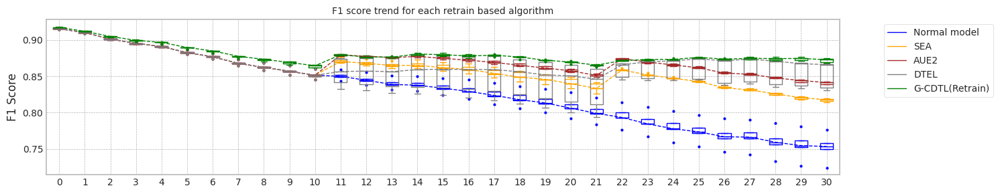

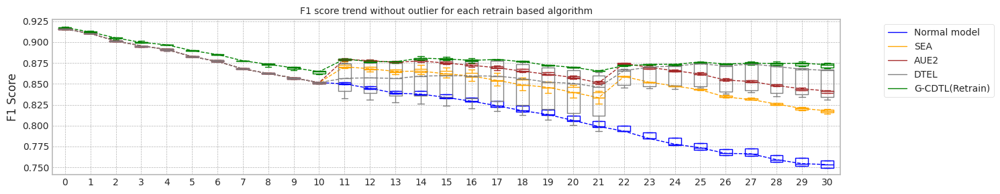

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.406270980834961
Base flops (train + inference flops of normal model, median): 3206385000.0


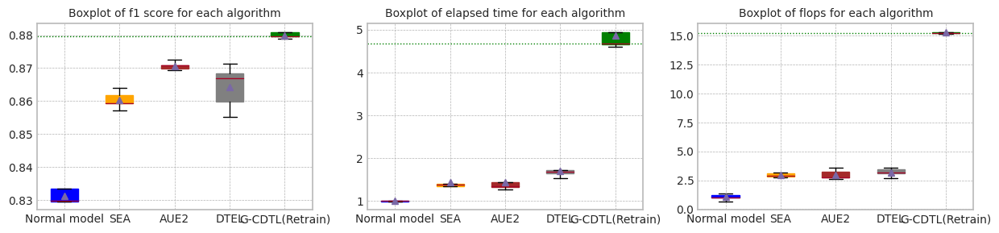

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.406270980834961


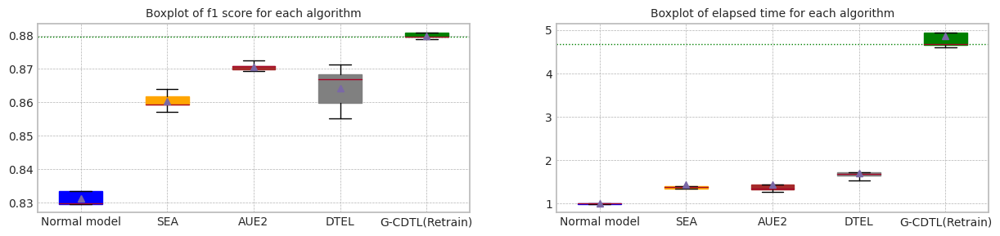

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.829748,0.749660,6.573595,3.793635e+09,121365000.0,3.915000e+09
1,1.0,0.915579,0.910222,0.833447,0.758317,6.410189,2.998890e+09,121365000.0,3.120255e+09
2,2.0,0.915306,0.910049,0.829658,0.753309,6.406271,3.085020e+09,121365000.0,3.206385e+09
3,3.0,0.914401,0.908813,0.818954,0.724145,6.369278,2.059290e+09,121365000.0,2.180655e+09
4,4.0,0.916595,0.911179,0.844266,0.776449,6.359962,4.271265e+09,121365000.0,4.392630e+09
5,median,0.915579,0.910222,0.829748,0.753309,6.406271,3.085020e+09,121365000.0,3.206385e+09
6,std,0.000785,0.000848,0.009086,0.018842,0.086572,8.435394e+08,0.0,8.435394e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.840734,0.752348,6.481685,4.015260e+10,609615000.0,4.076222e+10
1,1.0,0.916210,0.910644,0.837812,0.753283,6.421161,2.798168e+10,609615000.0,2.859129e+10
2,2.0,0.918385,0.913173,0.830301,0.725624,6.225959,1.175229e+10,609615000.0,1.236190e+10
3,3.0,0.916707,0.912018,0.845788,0.771953,6.280123,3.873672e+10,609615000.0,3.934634e+10
4,4.0,0.917568,0.912789,0.843201,0.760834,6.373516,3.993628e+10,609615000.0,4.054590e+10
5,median,0.917442,0.912018,0.840734,0.753283,6.373516,3.873672e+10,609615000.0,3.934634e+10
6,std,0.000837,0.001004,0.005963,0.017105,0.103702,1.225290e+10,0.0,1.225290e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.859440,0.815977,8.989450,5.027730e+09,4.910280e+09,9.938010e+09
1,1.0,0.915579,0.910222,0.861890,0.819476,8.661180,4.913325e+09,4.001130e+09,8.914455e+09
2,2.0,0.915306,0.910049,0.859344,0.814449,8.604402,4.901145e+09,4.075080e+09,8.976225e+09
3,3.0,0.914401,0.908813,0.857272,0.818643,10.819149,5.518410e+09,3.666615e+09,9.185025e+09
4,4.0,0.916595,0.911179,0.863968,0.817681,8.865983,4.946385e+09,5.306565e+09,1.025295e+10
5,median,0.915579,0.910222,0.859440,0.817681,8.865983,4.946385e+09,4.075080e+09,9.185025e+09
6,std,0.000785,0.000848,0.002587,0.002034,0.924917,2.602058e+08,6.863753e+08,6.050434e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.870955,0.841676,11.575850,5.721555e+09,5.725470e+09,1.144702e+10
1,1.0,0.915579,0.910222,0.870957,0.839238,8.430131,4.833720e+09,4.042890e+09,8.876610e+09
2,2.0,0.915306,0.910049,0.869766,0.839389,8.103706,4.757160e+09,4.052460e+09,8.809620e+09
3,3.0,0.914401,0.908813,0.869406,0.842527,9.151619,5.018160e+09,3.287730e+09,8.305890e+09
4,4.0,0.916595,0.911179,0.872441,0.841481,8.599401,4.890705e+09,5.372250e+09,1.026296e+10
5,median,0.915579,0.910222,0.870955,0.841481,8.599401,4.890705e+09,4.052460e+09,8.876610e+09
6,std,0.000785,0.000848,0.001195,0.001468,1.396281,3.904300e+08,1.017517e+09,1.289959e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.867041,0.830925,12.098090,5.828565e+09,5.564085e+09,1.139265e+10
1,1.0,0.915579,0.910222,0.868288,0.834320,11.028207,5.571915e+09,4.574025e+09,1.014594e+10
2,2.0,0.915306,0.910049,0.859889,0.866063,10.786003,5.467515e+09,4.494420e+09,9.961935e+09
3,3.0,0.914401,0.908813,0.855279,0.867411,9.835780,5.220870e+09,3.282945e+09,8.503815e+09
4,4.0,0.916595,0.911179,0.871265,0.866963,10.533659,5.409225e+09,5.678490e+09,1.108772e+10
5,median,0.915579,0.910222,0.867041,0.866063,10.786003,5.467515e+09,4.574025e+09,1.014594e+10
6,std,0.000785,0.000848,0.006572,0.018771,0.824939,2.237940e+08,9.706309e+08,1.134173e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.880868,0.875217,29.480821,4.874800e+10,80595000.0,4.882860e+10
1,1.0,0.916210,0.910644,0.878827,0.873989,30.011677,4.877824e+10,80595000.0,4.885884e+10
2,2.0,0.918385,0.913173,0.879700,0.869357,29.826500,4.859333e+10,80595000.0,4.867392e+10
3,3.0,0.916707,0.912018,0.879687,0.868794,34.536023,4.991379e+10,80595000.0,4.999438e+10
4,4.0,0.917568,0.912789,0.880955,0.872855,31.683643,4.904186e+10,80595000.0,4.912246e+10
5,median,0.917442,0.912018,0.879700,0.872855,30.011677,4.877824e+10,80595000.0,4.885884e+10
6,std,0.000837,0.001004,0.000899,0.002841,2.096102,5.276581e+08,0.0,5.276581e+08


trial_count: 5
Lambda :  0.9
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 12:25:58,615] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 968/2000 [00:02<00:02, 409.67it/s]

Early stop: 968
[2023-11-30 12:26:00,985] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3793635000
precision_recall_fscore: (array([0.89566143, 0.90749571]), array([0.87402597, 0.9238835 ]), array([0.88471145, 0.91561628]), array([3850, 5150]))
Test f1 score: 0.9156162801885885
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.94it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8297476836452425
inference_flops: 121365000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:26:07,329] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:26:07,332] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 439/2000 [00:03<00:11, 134.01it/s]

[2023-11-30 12:26:20,799] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:26:20,800] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6930000000 1722600000 40152600000
precision_recall_fscore: (array([0.88169586, 0.92550879]), array([0.90207792, 0.90951456]), array([0.89177045, 0.91744197]), array([3850, 5150]))
Test f1 score: 0.9174419743413965
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.00it/s]

mean of drift:
x0    0.214197
x1    0.459204
x2    0.169921
x3    0.231502
z0    0.337323
dtype: float64
Mean F1 for all data: 0.8407336960822396
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-30 12:26:27,071] [INFO] [profiler.py:80:start_profile] Flops profiler started



 38%|███▊      | 765/2000 [00:01<00:02, 416.59it/s]

Early stop: 765
[2023-11-30 12:26:28,914] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2998890000
precision_recall_fscore: (array([0.89855072, 0.90481608]), array([0.86961039, 0.92660194]), array([0.88384372, 0.91557943]), array([3850, 5150]))
Test f1 score: 0.9155794320798158
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.06it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8334474883649953
inference_flops: 121365000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:26:35,113] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:26:35,116] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 444/2000 [00:03<00:11, 132.04it/s]

[2023-11-30 12:26:44,633] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:26:44,634] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 19230750000 7008750000 1742175000 27981675000
precision_recall_fscore: (array([0.88052872, 0.92380576]), array([0.89974026, 0.90873786]), array([0.89003083, 0.91620987]), array([3850, 5150]))
Test f1 score: 0.9162098668754893
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.93it/s]

mean of drift:
x0    0.153763
x1    0.323978
x2    0.173430
x3    0.279502
z0    0.214986
dtype: float64
Mean F1 for all data: 0.8378116662863696
inference_flops: 609615000
Normal model median        : 0.8315975860051189
Drift tolerant model median: 0.8392726811843045
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-30 12:26:50,995] [INFO] [profiler.py:80:start_profile] Flops profiler started



 39%|███▉      | 787/2000 [00:01<00:02, 408.15it/s]

Early stop: 787
[2023-11-30 12:26:52,930] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3085020000
precision_recall_fscore: (array([0.89721627, 0.90539514]), array([0.87064935, 0.92543689]), array([0.88373319, 0.91530632]), array([3850, 5150]))
Test f1 score: 0.9153063184175149
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8296577026854857
inference_flops: 121365000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:26:59,257] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:26:59,260] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 29%|██▉       | 575/2000 [00:04<00:10, 134.58it/s]

[2023-11-30 12:27:03,995] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:27:03,996] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 9072000000 2255040000 11752290000
precision_recall_fscore: (array([0.90276659, 0.90733371]), array([0.87298701, 0.92970874]), array([0.8876271 , 0.91838496]), array([3850, 5150]))
Test f1 score: 0.9183849621175794
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.84it/s]

mean of drift:
x0    0.170061
x1    0.373964
x2    0.146014
x3    0.184556
z0    0.196495
dtype: float64
Mean F1 for all data: 0.8303009494211239
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8378116662863696
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-30 12:27:10,471] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▋       | 525/2000 [00:01<00:03, 413.65it/s]

Early stop: 525
[2023-11-30 12:27:11,746] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2059290000
precision_recall_fscore: (array([0.89548249, 0.90492489]), array([0.87012987, 0.92407767]), array([0.88262416, 0.914401  ]), array([3850, 5150]))
Test f1 score: 0.9144009991353637
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.98it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8189535580239609
inference_flops: 121365000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:27:18,055] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:27:18,058] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 367/2000 [00:02<00:11, 136.81it/s]

[2023-11-30 12:27:30,836] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:27:30,837] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5796000000 1440720000 38736720000
precision_recall_fscore: (array([0.90333063, 0.90314679]), array([0.86649351, 0.93067961]), array([0.8845287 , 0.91670651]), array([3850, 5150]))
Test f1 score: 0.9167065123840489
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.90it/s]

mean of drift:
x0    0.143351
x1    0.381183
x2    0.310957
x3    0.241613
z0    0.230939
dtype: float64
Mean F1 for all data: 0.8457878928025607
inference_flops: 609615000
Normal model median        : 0.8297026931653642
Drift tolerant model median: 0.8392726811843045
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-30 12:27:37,244] [INFO] [profiler.py:80:start_profile] Flops profiler started



 55%|█████▍    | 1090/2000 [00:02<00:02, 420.54it/s]

Early stop: 1090
[2023-11-30 12:27:39,844] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4271265000
precision_recall_fscore: (array([0.89949075, 0.90624407]), array([0.87168831, 0.92718447]), array([0.88537132, 0.91659468]), array([3850, 5150]))
Test f1 score: 0.9165946827910548
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8442659535091332
inference_flops: 121365000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:27:46,162] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:27:46,164] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:11, 136.09it/s]

[2023-11-30 12:27:59,408] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:27:59,410] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6756750000 1679535000 39936285000
precision_recall_fscore: (array([0.90337382, 0.90500472]), array([0.86935065, 0.93048544]), array([0.88603574, 0.91756821]), array([3850, 5150]))
Test f1 score: 0.9175682144566778
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.90it/s]


mean of drift:
x0    0.108262
x1    0.334530
x2    0.221606
x3    0.182735
z0    0.225756
dtype: float64
Mean F1 for all data: 0.843200881802644
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  4.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:28:07,480] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:28:07,483] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:28:15,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:28:15,903] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:10<01:06,  2.89s/it]

G-CDTL train flops: 1968750000 770000000 191400000 2930150000


 48%|████▊     | 15/31 [00:11<00:06,  2.41it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:28:17,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:28:17,547] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:28:30,208] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:28:30,209] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:24<01:02,  4.17s/it]

G-CDTL train flops: 3500000000 785750000 195315000 4481065000


 74%|███████▍  | 23/31 [00:25<00:04,  1.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:28:31,862] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:28:31,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:28:44,458] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:28:44,460] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:38<00:29,  4.21s/it]

G-CDTL train flops: 3500000000 759500000 188790000 4448290000


100%|██████████| 31/31 [00:40<00:00,  1.29s/it]


Early stop at  [439, 448, 433]
Train flops  [2930150000, 4481065000, 4448290000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8802915681626071
G_CDTL+AUE median: 0.8802915681626071
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:13,  1.77it/s]

Ensemble_SEA train flops: 310590000


 55%|█████▍    | 17/31 [00:05<00:05,  2.50it/s]

Ensemble_SEA train flops: 230550000


 81%|████████  | 25/31 [00:07<00:02,  2.52it/s]

Ensemble_SEA train flops: 244905000


100%|██████████| 31/31 [00:09<00:00,  3.37it/s]


Early stop at  [713, 529, 562]
Train flops  [310590000, 230550000, 244905000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8632443310957844
SEA median: 0.8632443310957844
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:02<00:07,  2.99it/s]

Ensemble_SEA train flops: 159645000


 55%|█████▍    | 17/31 [00:05<00:06,  2.23it/s]

Ensemble_SEA train flops: 308850000


 77%|███████▋  | 24/31 [00:07<00:04,  1.74it/s]

Ensemble_SEA train flops: 313200000


100%|██████████| 31/31 [00:09<00:00,  3.39it/s]


Early stop at  [366, 709, 719]
Train flops  [159645000, 308850000, 313200000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8734751546250257
AUE median: 0.8734751546250257
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:04<00:28,  1.24s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:06<00:04,  3.50it/s]

Ensemble_DTEL train flops: 249255000


 52%|█████▏    | 16/31 [00:08<00:11,  1.33it/s]

Ensemble_DTEL train flops: 189660000


 77%|███████▋  | 24/31 [00:12<00:08,  1.19s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:14<00:00,  2.16it/s]


Early stop at  [1999, 5, 572, 435, 1999, 5]
Train flops  [870000000, 2610000, 249255000, 189660000, 870000000, 2610000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8642899444715629
DTEL median: 0.8642899444715629
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  4.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:29:20,398] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:29:20,400] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:29:32,774] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:29:32,775] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 29%|██▉       | 9/31 [00:14<01:04,  2.91s/it]

G-CDTL train flops: 3500000000 710500000 176610000 4387110000


 48%|████▊     | 15/31 [00:15<00:08,  1.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:29:34,404] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:29:34,407] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:29:43,782] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:29:43,783] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:25<00:48,  3.25s/it]

G-CDTL train flops: 2360750000 721000000 179220000 3260970000


 74%|███████▍  | 23/31 [00:26<00:03,  2.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:29:45,396] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:29:45,399] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:29:58,152] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:29:58,153] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:39<00:29,  4.20s/it]

G-CDTL train flops: 3500000000 750750000 186615000 4437365000


100%|██████████| 31/31 [00:40<00:00,  1.31s/it]


Early stop at  [405, 411, 428]
Train flops  [4387110000, 3260970000, 4437365000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8804206800046991
G_CDTL+AUE median: 0.880356124083653
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 29%|██▉       | 9/31 [00:03<00:10,  2.11it/s]

Ensemble_SEA train flops: 334080000


 55%|█████▍    | 17/31 [00:05<00:06,  2.25it/s]

Ensemble_SEA train flops: 292755000


 77%|███████▋  | 24/31 [00:08<00:05,  1.34it/s]

Ensemble_SEA train flops: 456750000


100%|██████████| 31/31 [00:10<00:00,  3.01it/s]


Early stop at  [767, 672, 1049]
Train flops  [334080000, 292755000, 456750000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8644915398815641
SEA median: 0.8638679354886742
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:09,  2.41it/s]

Ensemble_SEA train flops: 175740000


 55%|█████▍    | 17/31 [00:05<00:07,  1.77it/s]

Ensemble_SEA train flops: 439785000


 81%|████████  | 25/31 [00:08<00:02,  2.32it/s]

Ensemble_SEA train flops: 257520000


100%|██████████| 31/31 [00:09<00:00,  3.22it/s]


Early stop at  [403, 1010, 591]
Train flops  [175740000, 439785000, 257520000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8732041108666992
AUE median: 0.8733396327458625
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.01it/s]

Ensemble_DTEL train flops: 464580000


 26%|██▌       | 8/31 [00:03<00:21,  1.06it/s]

Ensemble_DTEL train flops: 153120000


 52%|█████▏    | 16/31 [00:06<00:07,  2.11it/s]

Ensemble_DTEL train flops: 194445000
Ensemble_DTEL train flops: 2175000


 74%|███████▍  | 23/31 [00:07<00:01,  4.46it/s]

Ensemble_DTEL train flops: 187485000


 81%|████████  | 25/31 [00:09<00:03,  1.76it/s]

Ensemble_DTEL train flops: 255345000


100%|██████████| 31/31 [00:10<00:00,  2.82it/s]


Early stop at  [1067, 351, 446, 4, 430, 586]
Train flops  [464580000, 153120000, 194445000, 2175000, 187485000, 255345000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8759340399340181
DTEL median: 0.8701119922027905
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:30:32,213] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:30:32,215] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:30:40,692] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:30:40,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:10<01:06,  2.90s/it]

G-CDTL train flops: 1904000000 787500000 195750000 2887250000


 48%|████▊     | 15/31 [00:11<00:06,  2.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:30:42,301] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:30:42,304] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:30:58,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:30:58,706] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:28<01:19,  5.29s/it]

G-CDTL train flops: 3500000000 1631000000 405420000 5536420000


 74%|███████▍  | 23/31 [00:29<00:04,  1.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:31:00,308] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:31:00,311] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:31:14,776] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:31:14,777] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:44<00:33,  4.83s/it]

G-CDTL train flops: 3500000000 1132250000 281445000 4913695000


100%|██████████| 31/31 [00:45<00:00,  1.47s/it]


Early stop at  [449, 931, 646]
Train flops  [2887250000, 5536420000, 4913695000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.882455224711509
G_CDTL+AUE median: 0.8804206800046991
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:12,  1.87it/s]

Ensemble_SEA train flops: 259260000


 55%|█████▍    | 17/31 [00:05<00:05,  2.36it/s]

Ensemble_SEA train flops: 259695000


 81%|████████  | 25/31 [00:09<00:03,  1.55it/s]

Ensemble_SEA train flops: 535050000


100%|██████████| 31/31 [00:10<00:00,  2.98it/s]


Early stop at  [595, 596, 1229]
Train flops  [259260000, 259695000, 535050000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8633943496078759
SEA median: 0.8633943496078759
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:11,  1.96it/s]

Ensemble_SEA train flops: 251430000


 55%|█████▍    | 17/31 [00:05<00:06,  2.15it/s]

Ensemble_SEA train flops: 302325000


 81%|████████  | 25/31 [00:08<00:02,  2.54it/s]

Ensemble_SEA train flops: 223155000


100%|██████████| 31/31 [00:09<00:00,  3.33it/s]


Early stop at  [577, 694, 512]
Train flops  [251430000, 302325000, 223155000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8740919622263148
AUE median: 0.8734751546250257
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:11,  2.01it/s]

Ensemble_DTEL train flops: 241425000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:03<00:03,  4.44it/s]

Ensemble_DTEL train flops: 403245000


 52%|█████▏    | 16/31 [00:07<00:16,  1.11s/it]

Ensemble_DTEL train flops: 354525000


 77%|███████▋  | 24/31 [00:09<00:03,  1.80it/s]

Ensemble_DTEL train flops: 254040000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:11<00:00,  2.78it/s]


Early stop at  [554, 5, 926, 814, 583, 4]
Train flops  [241425000, 2610000, 403245000, 354525000, 254040000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8640494577731772
DTEL median: 0.8642899444715629
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  4.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:31:48,874] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:31:48,876] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:32:02,369] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:32:02,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:15<01:43,  4.50s/it]

G-CDTL train flops: 3500000000 878500000 218370000 4596870000


 48%|████▊     | 15/31 [00:16<00:08,  1.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:32:03,970] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:32:03,973] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:32:16,574] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:32:16,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:29<01:03,  4.23s/it]

G-CDTL train flops: 3500000000 637000000 158340000 4295340000


 74%|███████▍  | 23/31 [00:30<00:04,  1.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:32:18,197] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:32:18,200] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:32:31,168] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:32:31,169] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:43<00:30,  4.33s/it]

G-CDTL train flops: 3500000000 740250000 184005000 4424255000


100%|██████████| 31/31 [00:45<00:00,  1.46s/it]


Early stop at  [501, 363, 422]
Train flops  [4596870000, 4295340000, 4424255000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8796823491905104
G_CDTL+AUE median: 0.880356124083653
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:12,  1.88it/s]

Ensemble_SEA train flops: 262740000


 52%|█████▏    | 16/31 [00:05<00:09,  1.57it/s]

Ensemble_SEA train flops: 360615000


 77%|███████▋  | 24/31 [00:08<00:03,  1.75it/s]

Ensemble_SEA train flops: 288840000


100%|██████████| 31/31 [00:09<00:00,  3.13it/s]


Early stop at  [603, 828, 663]
Train flops  [262740000, 360615000, 288840000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8600822681404223
SEA median: 0.8633193403518301
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:04<00:23,  1.03s/it]

Ensemble_SEA train flops: 664680000


 55%|█████▍    | 17/31 [00:07<00:06,  2.06it/s]

Ensemble_SEA train flops: 307545000


 77%|███████▋  | 24/31 [00:09<00:03,  2.01it/s]

Ensemble_SEA train flops: 227070000


100%|██████████| 31/31 [00:10<00:00,  2.83it/s]


Early stop at  [1527, 706, 521]
Train flops  [664680000, 307545000, 227070000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.87277080028357
AUE median: 0.8733396327458625
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:09,  2.32it/s]

Ensemble_DTEL train flops: 184875000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:03<00:03,  4.68it/s]

Ensemble_DTEL train flops: 185745000


 55%|█████▍    | 17/31 [00:05<00:06,  2.30it/s]

Ensemble_DTEL train flops: 100920000


 77%|███████▋  | 24/31 [00:08<00:04,  1.54it/s]

Ensemble_DTEL train flops: 363225000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:09<00:00,  3.29it/s]


Early stop at  [424, 5, 426, 231, 834, 4]
Train flops  [184875000, 2610000, 185745000, 100920000, 363225000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8622384162218943
DTEL median: 0.8641697011223701
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:01<00:04,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:33:04,644] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:33:04,647] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:33:15,696] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:33:15,697] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:12<01:25,  3.72s/it]

G-CDTL train flops: 2850750000 675500000 167910000 3694160000


 48%|████▊     | 15/31 [00:14<00:07,  2.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:33:17,310] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:33:17,313] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:33:30,262] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:33:30,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:27<01:04,  4.29s/it]

G-CDTL train flops: 3500000000 710500000 176610000 4387110000


 74%|███████▍  | 23/31 [00:28<00:04,  1.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:33:31,846] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:33:31,849] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:33:45,376] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:33:45,377] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:42<00:31,  4.49s/it]

G-CDTL train flops: 3500000000 808500000 200970000 4509470000


100%|██████████| 31/31 [00:43<00:00,  1.41s/it]


Early stop at  [385, 405, 461]
Train flops  [3694160000, 4387110000, 4509470000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8815377490324805
G_CDTL+AUE median: 0.8804206800046991
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:04<00:24,  1.08s/it]

Ensemble_SEA train flops: 703395000


 55%|█████▍    | 17/31 [00:07<00:05,  2.34it/s]

Ensemble_SEA train flops: 231420000


 81%|████████  | 25/31 [00:11<00:05,  1.12it/s]

Ensemble_SEA train flops: 840420000


100%|██████████| 31/31 [00:13<00:00,  2.36it/s]


Early stop at  [1616, 531, 1931]
Train flops  [703395000, 231420000, 840420000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.867659910862458
SEA median: 0.8633943496078759
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:11,  1.93it/s]

Ensemble_SEA train flops: 255345000


 52%|█████▏    | 16/31 [00:06<00:14,  1.05it/s]

Ensemble_SEA train flops: 612045000


 81%|████████  | 25/31 [00:09<00:02,  2.31it/s]

Ensemble_SEA train flops: 247515000


100%|██████████| 31/31 [00:10<00:00,  2.91it/s]


Early stop at  [586, 1406, 568]
Train flops  [255345000, 612045000, 247515000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8749627060268107
AUE median: 0.8734751546250257
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:14,  1.57it/s]

Ensemble_DTEL train flops: 342780000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:04<00:03,  4.21it/s]

Ensemble_DTEL train flops: 616830000


 55%|█████▍    | 17/31 [00:08<00:13,  1.06it/s]

Ensemble_DTEL train flops: 265785000


 77%|███████▋  | 24/31 [00:11<00:04,  1.45it/s]

Ensemble_DTEL train flops: 372360000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]


Early stop at  [787, 5, 1417, 610, 855, 4]
Train flops  [342780000, 2610000, 616830000, 265785000, 372360000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8689940389100472
DTEL median: 0.8642899444715629


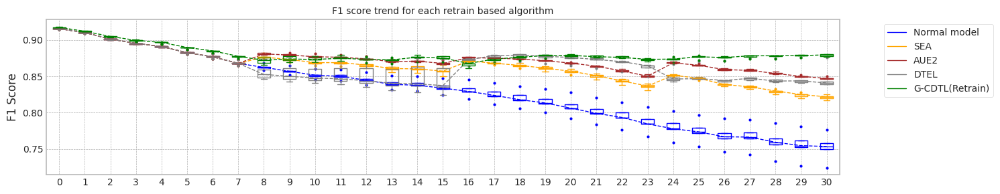

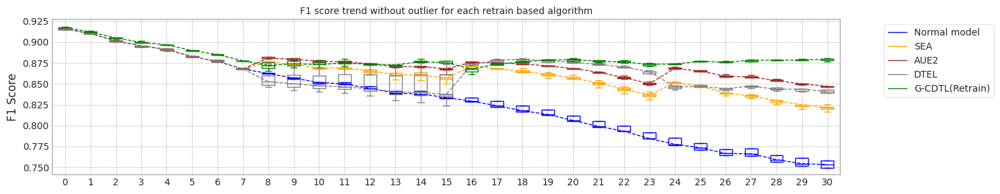

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.298115253448486
Base flops (train + inference flops of normal model, median): 3206385000.0


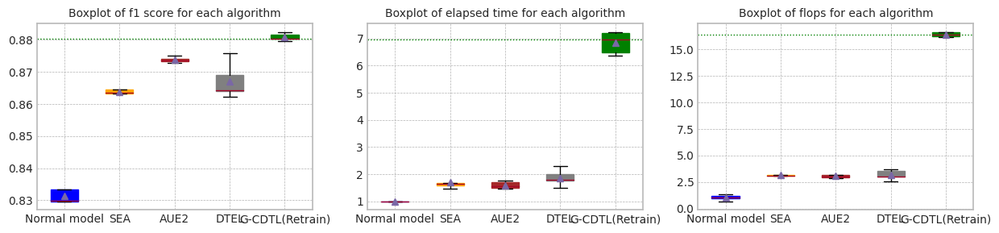

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.298115253448486


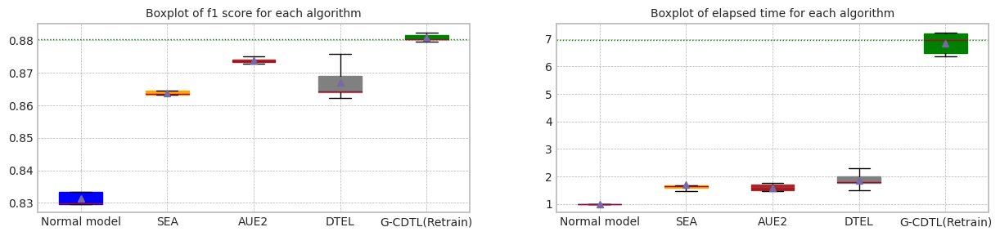

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.829748,0.749660,6.325120,3.793635e+09,121365000.0,3.915000e+09
1,1.0,0.915579,0.910222,0.833447,0.758317,6.178405,2.998890e+09,121365000.0,3.120255e+09
2,2.0,0.915306,0.910049,0.829658,0.753309,6.303529,3.085020e+09,121365000.0,3.206385e+09
3,3.0,0.914401,0.908813,0.818954,0.724145,6.289168,2.059290e+09,121365000.0,2.180655e+09
4,4.0,0.916595,0.911179,0.844266,0.776449,6.298115,4.271265e+09,121365000.0,4.392630e+09
5,median,0.915579,0.910222,0.829748,0.753309,6.298115,3.085020e+09,121365000.0,3.206385e+09
6,std,0.000785,0.000848,0.009086,0.018842,0.057699,8.435394e+08,0.0,8.435394e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.840734,0.752348,6.250272,4.015260e+10,609615000.0,4.076222e+10
1,1.0,0.916210,0.910644,0.837812,0.753283,6.340388,2.798168e+10,609615000.0,2.859129e+10
2,2.0,0.918385,0.913173,0.830301,0.725624,6.455108,1.175229e+10,609615000.0,1.236190e+10
3,3.0,0.916707,0.912018,0.845788,0.771953,6.382997,3.873672e+10,609615000.0,3.934634e+10
4,4.0,0.917568,0.912789,0.843201,0.760834,6.376683,3.993628e+10,609615000.0,4.054590e+10
5,median,0.917442,0.912018,0.840734,0.753283,6.376683,3.873672e+10,609615000.0,3.934634e+10
6,std,0.000837,0.001004,0.005963,0.017105,0.074618,1.225290e+10,0.0,1.225290e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.863244,0.819665,9.236840,5.057310e+09,5.002500e+09,1.005981e+10
1,1.0,0.915579,0.910222,0.864492,0.821731,10.339592,5.354850e+09,4.505295e+09,9.860145e+09
2,2.0,0.915306,0.910049,0.863394,0.822035,10.463638,5.325270e+09,4.561845e+09,9.887115e+09
3,3.0,0.914401,0.908813,0.860082,0.816996,9.939804,5.183460e+09,3.394305e+09,8.577765e+09
4,4.0,0.916595,0.911179,0.867660,0.825084,13.175224,6.046500e+09,6.469320e+09,1.251582e+10
5,median,0.915579,0.910222,0.863394,0.821731,10.339592,5.325270e+09,4.561845e+09,9.887115e+09
6,std,0.000785,0.000848,0.002723,0.003002,1.500619,3.839592e+08,1.112013e+09,1.434028e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.873475,0.847064,9.197968,5.052960e+09,5.119515e+09,1.017248e+10
1,1.0,0.915579,0.910222,0.873204,0.846284,9.682071,5.144310e+09,4.416120e+09,9.560430e+09
2,2.0,0.915306,0.910049,0.874092,0.849785,9.347212,5.048175e+09,4.406115e+09,9.454290e+09
3,3.0,0.914401,0.908813,0.872771,0.846293,10.996695,5.470560e+09,3.802770e+09,9.273330e+09
4,4.0,0.916595,0.911179,0.874963,0.847132,10.711500,5.386170e+09,5.930355e+09,1.131652e+10
5,median,0.915579,0.910222,0.873475,0.847064,9.682071,5.144310e+09,4.416120e+09,9.560430e+09
6,std,0.000785,0.000848,0.000853,0.001441,0.816895,1.959254e+08,8.148049e+08,8.324835e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.864290,0.839201,14.381017,6.455400e+09,5.347890e+09,1.180329e+10
1,1.0,0.915579,0.910222,0.875934,0.876075,11.037954,5.528415e+09,4.086390e+09,9.614805e+09
2,2.0,0.915306,0.910049,0.864049,0.843012,11.187317,5.529285e+09,4.187745e+09,9.717030e+09
3,3.0,0.914401,0.908813,0.862238,0.840785,9.482965,5.110815e+09,3.017595e+09,8.128410e+09
4,4.0,0.916595,0.911179,0.868994,0.838975,12.516192,5.873805e+09,5.403570e+09,1.127738e+10
5,median,0.915579,0.910222,0.864290,0.840785,11.187317,5.529285e+09,4.187745e+09,9.717030e+09
6,std,0.000785,0.000848,0.005533,0.015994,1.834951,5.016374e+08,9.949525e+08,1.462560e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.880292,0.876726,40.086984,5.179579e+10,62685000.0,5.185848e+10
1,1.0,0.916210,0.910644,0.880421,0.880059,40.823191,5.202173e+10,62685000.0,5.208442e+10
2,2.0,0.918385,0.913173,0.882455,0.877978,45.601625,5.327365e+10,62685000.0,5.333634e+10
3,3.0,0.916707,0.912018,0.879682,0.880420,45.381371,5.325275e+10,62685000.0,5.331544e+10
4,4.0,0.917568,0.912789,0.881538,0.879624,43.791944,5.252702e+10,62685000.0,5.258971e+10
5,median,0.917442,0.912018,0.880421,0.879624,43.791944,5.252702e+10,62685000.0,5.258971e+10
6,std,0.000837,0.001004,0.001107,0.001560,2.559142,6.824645e+08,0.0,6.824645e+08


trial_count: 5
Lambda :  0.9
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 12:34:27,412] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 968/2000 [00:02<00:02, 388.38it/s]

Early stop: 968
[2023-11-30 12:34:29,912] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3793635000
precision_recall_fscore: (array([0.89566143, 0.90749571]), array([0.87402597, 0.9238835 ]), array([0.88471145, 0.91561628]), array([3850, 5150]))
Test f1 score: 0.9156162801885885
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.03it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8297476836452425
inference_flops: 121365000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:34:36,168] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:34:36,172] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 439/2000 [00:03<00:12, 123.86it/s]

[2023-11-30 12:34:50,594] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:34:50,595] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6930000000 1722600000 40152600000
precision_recall_fscore: (array([0.88169586, 0.92550879]), array([0.90207792, 0.90951456]), array([0.89177045, 0.91744197]), array([3850, 5150]))
Test f1 score: 0.9174419743413965
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

mean of drift:
x0    0.214197
x1    0.459204
x2    0.169921
x3    0.231502
z0    0.337323
dtype: float64
Mean F1 for all data: 0.8407336960822396
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-30 12:34:56,914] [INFO] [profiler.py:80:start_profile] Flops profiler started



 38%|███▊      | 765/2000 [00:01<00:03, 392.67it/s]

Early stop: 765
[2023-11-30 12:34:58,870] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2998890000
precision_recall_fscore: (array([0.89855072, 0.90481608]), array([0.86961039, 0.92660194]), array([0.88384372, 0.91557943]), array([3850, 5150]))
Test f1 score: 0.9155794320798158
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.09it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8334474883649953
inference_flops: 121365000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:35:05,040] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:35:05,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 444/2000 [00:03<00:12, 123.37it/s]

[2023-11-30 12:35:15,332] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:35:15,333] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 19230750000 7008750000 1742175000 27981675000
precision_recall_fscore: (array([0.88052872, 0.92380576]), array([0.89974026, 0.90873786]), array([0.89003083, 0.91620987]), array([3850, 5150]))
Test f1 score: 0.9162098668754893
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.97it/s]

mean of drift:
x0    0.153763
x1    0.323978
x2    0.173430
x3    0.279502
z0    0.214986
dtype: float64
Mean F1 for all data: 0.8378116662863696
inference_flops: 609615000
Normal model median        : 0.8315975860051189
Drift tolerant model median: 0.8392726811843045
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-30 12:35:21,655] [INFO] [profiler.py:80:start_profile] Flops profiler started



 39%|███▉      | 787/2000 [00:02<00:03, 380.78it/s]

Early stop: 787
[2023-11-30 12:35:23,730] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3085020000
precision_recall_fscore: (array([0.89721627, 0.90539514]), array([0.87064935, 0.92543689]), array([0.88373319, 0.91530632]), array([3850, 5150]))
Test f1 score: 0.9153063184175149
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.99it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8296577026854857
inference_flops: 121365000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:35:30,017] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:35:30,019] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 29%|██▉       | 575/2000 [00:04<00:11, 122.34it/s]

[2023-11-30 12:35:34,881] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:35:34,882] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 9072000000 2255040000 11752290000
precision_recall_fscore: (array([0.90276659, 0.90733371]), array([0.87298701, 0.92970874]), array([0.8876271 , 0.91838496]), array([3850, 5150]))
Test f1 score: 0.9183849621175794
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.86it/s]

mean of drift:
x0    0.170061
x1    0.373964
x2    0.146014
x3    0.184556
z0    0.196495
dtype: float64
Mean F1 for all data: 0.8303009494211239
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8378116662863696
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-30 12:35:41,340] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▋       | 525/2000 [00:01<00:03, 387.53it/s]

Early stop: 525
[2023-11-30 12:35:42,701] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2059290000
precision_recall_fscore: (array([0.89548249, 0.90492489]), array([0.87012987, 0.92407767]), array([0.88262416, 0.914401  ]), array([3850, 5150]))
Test f1 score: 0.9144009991353637
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.93it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8189535580239609
inference_flops: 121365000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:35:49,071] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:35:49,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 18%|█▊        | 367/2000 [00:03<00:13, 121.99it/s]

[2023-11-30 12:36:02,924] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:36:02,925] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5796000000 1440720000 38736720000
precision_recall_fscore: (array([0.90333063, 0.90314679]), array([0.86649351, 0.93067961]), array([0.8845287 , 0.91670651]), array([3850, 5150]))
Test f1 score: 0.9167065123840489
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.94it/s]

mean of drift:
x0    0.143351
x1    0.381183
x2    0.310957
x3    0.241613
z0    0.230939
dtype: float64
Mean F1 for all data: 0.8457878928025607
inference_flops: 609615000
Normal model median        : 0.8297026931653642
Drift tolerant model median: 0.8392726811843045
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-30 12:36:09,274] [INFO] [profiler.py:80:start_profile] Flops profiler started



 55%|█████▍    | 1090/2000 [00:02<00:02, 389.51it/s]

Early stop: 1090
[2023-11-30 12:36:12,079] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4271265000
precision_recall_fscore: (array([0.89949075, 0.90624407]), array([0.87168831, 0.92718447]), array([0.88537132, 0.91659468]), array([3850, 5150]))
Test f1 score: 0.9165946827910548
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8442659535091332
inference_flops: 121365000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:36:18,495] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:36:18,498] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:12, 126.19it/s]

[2023-11-30 12:36:32,738] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:36:32,739] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6756750000 1679535000 39936285000
precision_recall_fscore: (array([0.90337382, 0.90500472]), array([0.86935065, 0.93048544]), array([0.88603574, 0.91756821]), array([3850, 5150]))
Test f1 score: 0.9175682144566778
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.97it/s]


mean of drift:
x0    0.108262
x1    0.334530
x2    0.221606
x3    0.182735
z0    0.225756
dtype: float64
Mean F1 for all data: 0.843200881802644
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.86it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:36:40,546] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:36:40,548] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:36:50,075] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:36:50,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:10<01:19,  3.32s/it]

G-CDTL train flops: 2140250000 719250000 178785000 3038285000


 42%|████▏     | 13/31 [00:12<00:09,  1.84it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:36:51,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:36:51,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:37:04,791] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:37:04,793] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:25<01:15,  4.45s/it]

G-CDTL train flops: 3500000000 665000000 165300000 4330300000


 65%|██████▍   | 20/31 [00:26<00:07,  1.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:37:06,238] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:37:06,241] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:37:20,311] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:37:20,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:41<00:47,  4.78s/it]

G-CDTL train flops: 3500000000 789250000 196185000 4485435000


 87%|████████▋ | 27/31 [00:42<00:02,  1.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:37:21,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:37:21,731] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:37:36,481] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:37:36,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:57<00:15,  5.01s/it]

G-CDTL train flops: 3500000000 992250000 246645000 4738895000


100%|██████████| 31/31 [00:58<00:00,  1.87s/it]


Early stop at  [410, 379, 450, 566]
Train flops  [3038285000, 4330300000, 4485435000, 4738895000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8826466205279138
G_CDTL+AUE median: 0.8826466205279138
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:09,  2.41it/s]

Ensemble_SEA train flops: 245775000


 45%|████▌     | 14/31 [00:05<00:12,  1.36it/s]

Ensemble_SEA train flops: 403245000


 71%|███████   | 22/31 [00:07<00:03,  2.43it/s]

Ensemble_SEA train flops: 208800000


 90%|█████████ | 28/31 [00:11<00:02,  1.20it/s]

Ensemble_SEA train flops: 517215000


100%|██████████| 31/31 [00:11<00:00,  2.64it/s]


Early stop at  [564, 926, 479, 1188]
Train flops  [245775000, 403245000, 208800000, 517215000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8642263803374867
SEA median: 0.8642263803374867
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:09,  2.31it/s]

Ensemble_SEA train flops: 261870000


 45%|████▌     | 14/31 [00:05<00:11,  1.54it/s]

Ensemble_SEA train flops: 350175000


 68%|██████▊   | 21/31 [00:08<00:08,  1.21it/s]

Ensemble_SEA train flops: 481980000


 94%|█████████▎| 29/31 [00:11<00:00,  2.46it/s]

Ensemble_SEA train flops: 213150000


100%|██████████| 31/31 [00:11<00:00,  2.71it/s]


Early stop at  [601, 804, 1107, 489]
Train flops  [261870000, 350175000, 481980000, 213150000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8739054652234101
AUE median: 0.8739054652234101
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:15,  1.54it/s]

Ensemble_DTEL train flops: 344520000
Ensemble_DTEL train flops: 2175000


 42%|████▏     | 13/31 [00:03<00:04,  4.01it/s]

Ensemble_DTEL train flops: 352350000


 45%|████▌     | 14/31 [00:08<00:27,  1.64s/it]

Ensemble_DTEL train flops: 790830000


 68%|██████▊   | 21/31 [00:11<00:07,  1.31it/s]

Ensemble_DTEL train flops: 274050000
Ensemble_DTEL train flops: 2175000


 87%|████████▋ | 27/31 [00:12<00:01,  3.78it/s]

Ensemble_DTEL train flops: 793440000


 94%|█████████▎| 29/31 [00:18<00:02,  1.24s/it]

Ensemble_DTEL train flops: 409770000


100%|██████████| 31/31 [00:18<00:00,  1.67it/s]


Early stop at  [791, 4, 809, 1817, 629, 4, 1823, 941]
Train flops  [344520000, 2175000, 352350000, 790830000, 274050000, 2175000, 793440000, 409770000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8705596508043659
DTEL median: 0.8705596508043659
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:38:20,472] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:38:20,474] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:38:33,834] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:38:33,835] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:14<01:49,  4.58s/it]

G-CDTL train flops: 3500000000 661500000 164430000 4325930000


 42%|████▏     | 13/31 [00:16<00:12,  1.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:38:35,264] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:38:35,266] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:38:48,760] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:38:48,761] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:29<01:18,  4.62s/it]

G-CDTL train flops: 3500000000 658000000 163560000 4321560000


 65%|██████▍   | 20/31 [00:30<00:07,  1.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:38:50,194] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:38:50,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:39:04,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:39:04,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:45<00:48,  4.82s/it]

G-CDTL train flops: 3500000000 810250000 201405000 4511655000


 87%|████████▋ | 27/31 [00:46<00:02,  1.34it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:39:05,798] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:39:05,801] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:39:20,106] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:39:20,108] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [01:01<00:14,  4.88s/it]

G-CDTL train flops: 3500000000 801500000 199230000 4500730000


100%|██████████| 31/31 [01:01<00:00,  1.99s/it]


Early stop at  [377, 375, 462, 457]
Train flops  [4325930000, 4321560000, 4511655000, 4500730000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.88202226068055
G_CDTL+AUE median: 0.8823344406042319
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:11,  2.06it/s]

Ensemble_SEA train flops: 321030000


 45%|████▌     | 14/31 [00:05<00:12,  1.35it/s]

Ensemble_SEA train flops: 411510000


 71%|███████   | 22/31 [00:08<00:03,  2.36it/s]

Ensemble_SEA train flops: 232290000


 90%|█████████ | 28/31 [00:10<00:01,  1.55it/s]

Ensemble_SEA train flops: 345825000


100%|██████████| 31/31 [00:11<00:00,  2.69it/s]


Early stop at  [737, 945, 533, 794]
Train flops  [321030000, 411510000, 232290000, 345825000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8650285567411538
SEA median: 0.8646274685393203
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:11,  2.03it/s]

Ensemble_SEA train flops: 220980000


 45%|████▌     | 14/31 [00:05<00:11,  1.46it/s]

Ensemble_SEA train flops: 374100000


 68%|██████▊   | 21/31 [00:08<00:06,  1.51it/s]

Ensemble_SEA train flops: 336690000


 90%|█████████ | 28/31 [00:12<00:03,  1.10s/it]

Ensemble_SEA train flops: 714270000


100%|██████████| 31/31 [00:12<00:00,  2.38it/s]


Early stop at  [507, 859, 773, 1641]
Train flops  [220980000, 374100000, 336690000, 714270000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8740168467340251
AUE median: 0.8739611559787176
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.92it/s]

Ensemble_DTEL train flops: 174870000


 23%|██▎       | 7/31 [00:05<00:36,  1.52s/it]

Ensemble_DTEL train flops: 807795000


 45%|████▌     | 14/31 [00:08<00:12,  1.39it/s]

Ensemble_DTEL train flops: 332775000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 20/31 [00:09<00:02,  3.88it/s]

Ensemble_DTEL train flops: 189225000


 71%|███████   | 22/31 [00:11<00:05,  1.63it/s]

Ensemble_DTEL train flops: 265350000


 90%|█████████ | 28/31 [00:16<00:03,  1.24s/it]

Ensemble_DTEL train flops: 825195000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:16<00:00,  1.84it/s]


Early stop at  [401, 1856, 764, 4, 434, 609, 1896, 4]
Train flops  [174870000, 807795000, 332775000, 2175000, 189225000, 265350000, 825195000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8707165465567288
DTEL median: 0.8706380986805473
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:40:03,748] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:40:03,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:40:17,418] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:40:17,419] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:15<01:52,  4.68s/it]

G-CDTL train flops: 3500000000 652750000 162255000 4315005000


 42%|████▏     | 13/31 [00:16<00:12,  1.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:40:18,855] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:40:18,858] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:40:32,765] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:40:32,766] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:30<01:20,  4.75s/it]

G-CDTL train flops: 3500000000 728000000 180960000 4408960000


 65%|██████▍   | 20/31 [00:31<00:08,  1.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:40:34,231] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:40:34,233] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:40:48,733] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:40:48,734] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:46<00:49,  4.94s/it]

G-CDTL train flops: 3500000000 838250000 208365000 4546615000


 87%|████████▋ | 27/31 [00:47<00:03,  1.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:40:50,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:40:50,133] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:41:04,780] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:41:04,782] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [01:02<00:14,  4.99s/it]

G-CDTL train flops: 3500000000 847000000 210540000 4557540000


100%|██████████| 31/31 [01:03<00:00,  2.04s/it]


Early stop at  [372, 415, 478, 483]
Train flops  [4315005000, 4408960000, 4546615000, 4557540000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8822846095204364
G_CDTL+AUE median: 0.8822846095204364
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:13,  1.77it/s]

Ensemble_SEA train flops: 257955000


 45%|████▌     | 14/31 [00:05<00:11,  1.42it/s]

Ensemble_SEA train flops: 369750000


 71%|███████   | 22/31 [00:07<00:03,  2.50it/s]

Ensemble_SEA train flops: 196185000


 94%|█████████▎| 29/31 [00:12<00:01,  1.05it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 31/31 [00:13<00:00,  2.33it/s]


Early stop at  [592, 849, 450, 1999]
Train flops  [257955000, 369750000, 196185000, 870000000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8636688884799129
SEA median: 0.8642263803374867
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:15,  1.54it/s]

Ensemble_SEA train flops: 325815000


 45%|████▌     | 14/31 [00:05<00:09,  1.74it/s]

Ensemble_SEA train flops: 280575000


 68%|██████▊   | 21/31 [00:07<00:05,  1.69it/s]

Ensemble_SEA train flops: 296670000


 90%|█████████ | 28/31 [00:10<00:01,  1.66it/s]

Ensemble_SEA train flops: 300150000


100%|██████████| 31/31 [00:11<00:00,  2.77it/s]


Early stop at  [748, 644, 681, 689]
Train flops  [325815000, 280575000, 296670000, 300150000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8740489230252366
AUE median: 0.8740168467340251
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:16,  1.48it/s]

Ensemble_DTEL train flops: 350610000
Ensemble_DTEL train flops: 1740000


 42%|████▏     | 13/31 [00:04<00:04,  3.90it/s]

Ensemble_DTEL train flops: 349305000


 45%|████▌     | 14/31 [00:06<00:17,  1.01s/it]

Ensemble_DTEL train flops: 253605000


 68%|██████▊   | 21/31 [00:09<00:05,  1.81it/s]

Ensemble_DTEL train flops: 227505000
Ensemble_DTEL train flops: 2175000


 87%|████████▋ | 27/31 [00:10<00:00,  4.18it/s]

Ensemble_DTEL train flops: 236205000


 90%|█████████ | 28/31 [00:13<00:02,  1.00it/s]

Ensemble_DTEL train flops: 382800000


100%|██████████| 31/31 [00:13<00:00,  2.25it/s]


Early stop at  [805, 3, 802, 582, 522, 4, 542, 879]
Train flops  [350610000, 1740000, 349305000, 253605000, 227505000, 2175000, 236205000, 382800000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8700688066887833
DTEL median: 0.8705596508043659
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.97it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:41:45,305] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:41:45,307] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:41:59,400] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:41:59,402] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:15<01:55,  4.81s/it]

G-CDTL train flops: 3500000000 696500000 173130000 4369630000


 42%|████▏     | 13/31 [00:16<00:12,  1.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:42:00,823] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:42:00,827] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:42:15,653] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:42:15,655] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:31<01:25,  5.04s/it]

G-CDTL train flops: 3500000000 829500000 206190000 4535690000


 65%|██████▍   | 20/31 [00:32<00:08,  1.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:42:17,095] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:42:17,098] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:42:32,031] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:42:32,032] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:48<00:50,  5.09s/it]

G-CDTL train flops: 3500000000 850500000 211410000 4561910000


 87%|████████▋ | 27/31 [00:49<00:03,  1.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:42:33,451] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:42:33,453] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:42:56,186] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:42:56,188] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [01:12<00:22,  7.43s/it]

G-CDTL train flops: 3500000000 2555000000 635100000 6690100000


100%|██████████| 31/31 [01:12<00:00,  2.35s/it]


Early stop at  [397, 473, 485, 1459]
Train flops  [4369630000, 4535690000, 4561910000, 6690100000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8815024805063502
G_CDTL+AUE median: 0.8821534351004932
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 26%|██▌       | 8/31 [00:02<00:11,  2.05it/s]

Ensemble_SEA train flops: 309720000


 45%|████▌     | 14/31 [00:04<00:08,  1.96it/s]

Ensemble_SEA train flops: 221850000


 68%|██████▊   | 21/31 [00:08<00:07,  1.35it/s]

Ensemble_SEA train flops: 402375000


 90%|█████████ | 28/31 [00:12<00:03,  1.17s/it]

Ensemble_SEA train flops: 750810000


100%|██████████| 31/31 [00:13<00:00,  2.34it/s]


Early stop at  [711, 509, 924, 1725]
Train flops  [309720000, 221850000, 402375000, 750810000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.860368376863539
SEA median: 0.8639476344086998
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:14,  1.66it/s]

Ensemble_SEA train flops: 284490000


 45%|████▌     | 14/31 [00:05<00:09,  1.82it/s]

Ensemble_SEA train flops: 240555000


 68%|██████▊   | 21/31 [00:08<00:08,  1.12it/s]

Ensemble_SEA train flops: 528090000


 94%|█████████▎| 29/31 [00:11<00:00,  2.23it/s]

Ensemble_SEA train flops: 237510000


100%|██████████| 31/31 [00:11<00:00,  2.63it/s]


Early stop at  [653, 552, 1213, 545]
Train flops  [284490000, 240555000, 528090000, 237510000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8730560819946785
AUE median: 0.8739611559787176
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:12,  1.89it/s]

Ensemble_DTEL train flops: 242295000
Ensemble_DTEL train flops: 2175000


 42%|████▏     | 13/31 [00:03<00:04,  4.27it/s]

Ensemble_DTEL train flops: 429780000


 48%|████▊     | 15/31 [00:06<00:12,  1.31it/s]

Ensemble_DTEL train flops: 187485000


 68%|██████▊   | 21/31 [00:09<00:06,  1.45it/s]

Ensemble_DTEL train flops: 327555000
Ensemble_DTEL train flops: 2610000


 87%|████████▋ | 27/31 [00:10<00:01,  3.95it/s]

Ensemble_DTEL train flops: 378885000


 90%|█████████ | 28/31 [00:13<00:03,  1.05s/it]

Ensemble_DTEL train flops: 278400000


100%|██████████| 31/31 [00:13<00:00,  2.23it/s]


Early stop at  [556, 4, 987, 430, 752, 5, 870, 639]
Train flops  [242295000, 2175000, 429780000, 187485000, 327555000, 2610000, 378885000, 278400000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8685719605170038
DTEL median: 0.8703142287465746
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:43:37,358] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:43:37,360] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:43:41,092] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:43:41,094] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:05<00:34,  1.42s/it]

G-CDTL train flops: 85750000 740250000 184005000 1010005000


 42%|████▏     | 13/31 [00:06<00:06,  2.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:43:42,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:43:42,574] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:43:57,001] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:43:57,002] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:21<01:19,  4.66s/it]

G-CDTL train flops: 3500000000 689500000 171390000 4360890000


 65%|██████▍   | 20/31 [00:22<00:07,  1.38it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:43:58,442] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:43:58,444] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:44:13,122] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:44:13,124] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:37<00:49,  4.97s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


 87%|████████▋ | 27/31 [00:38<00:03,  1.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:44:14,541] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:44:14,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:44:29,335] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:44:29,336] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:53<00:15,  5.03s/it]

G-CDTL train flops: 3500000000 761250000 189225000 4450475000


100%|██████████| 31/31 [00:53<00:00,  1.74s/it]


Early stop at  [422, 393, 416, 434]
Train flops  [1010005000, 4360890000, 4411145000, 4450475000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8834149697557165
G_CDTL+AUE median: 0.8822846095204364
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:14,  1.71it/s]

Ensemble_SEA train flops: 267960000


 45%|████▌     | 14/31 [00:05<00:09,  1.78it/s]

Ensemble_SEA train flops: 247950000


 71%|███████   | 22/31 [00:08<00:04,  2.06it/s]

Ensemble_SEA train flops: 287970000


 90%|█████████ | 28/31 [00:11<00:02,  1.01it/s]

Ensemble_SEA train flops: 601170000


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]


Early stop at  [615, 569, 661, 1381]
Train flops  [267960000, 247950000, 287970000, 601170000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8656711467829848
SEA median: 0.8642263803374867
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:11,  2.06it/s]

Ensemble_SEA train flops: 200535000


 45%|████▌     | 14/31 [00:06<00:16,  1.02it/s]

Ensemble_SEA train flops: 582900000


 68%|██████▊   | 21/31 [00:09<00:08,  1.15it/s]

Ensemble_SEA train flops: 475020000


 94%|█████████▎| 29/31 [00:12<00:00,  2.16it/s]

Ensemble_SEA train flops: 255345000


100%|██████████| 31/31 [00:12<00:00,  2.42it/s]


Early stop at  [460, 1339, 1091, 586]
Train flops  [200535000, 582900000, 475020000, 255345000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8762335669140201
AUE median: 0.8740168467340251
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:01<00:05,  4.99it/s]

Ensemble_DTEL train flops: 283185000


 23%|██▎       | 7/31 [00:03<00:22,  1.07it/s]

Ensemble_DTEL train flops: 247515000


 45%|████▌     | 14/31 [00:06<00:12,  1.41it/s]

Ensemble_DTEL train flops: 348435000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 20/31 [00:07<00:02,  3.86it/s]

Ensemble_DTEL train flops: 472410000


 68%|██████▊   | 21/31 [00:10<00:10,  1.10s/it]

Ensemble_DTEL train flops: 208365000


 90%|█████████ | 28/31 [00:13<00:02,  1.37it/s]

Ensemble_DTEL train flops: 360615000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:14<00:00,  2.16it/s]


Early stop at  [650, 568, 800, 4, 1085, 478, 828, 4]
Train flops  [283185000, 247515000, 348435000, 2175000, 472410000, 208365000, 360615000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8726997773148033
DTEL median: 0.8705596508043659


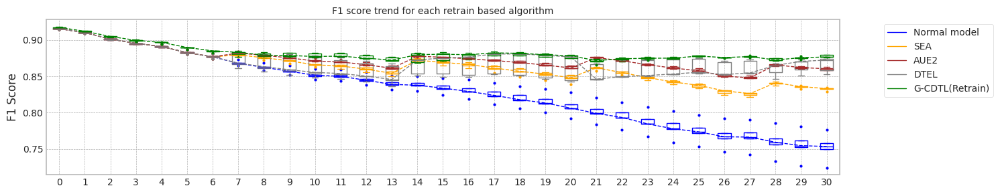

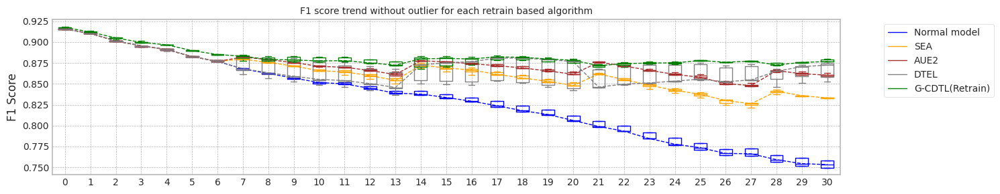

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.266607761383057
Base flops (train + inference flops of normal model, median): 3206385000.0


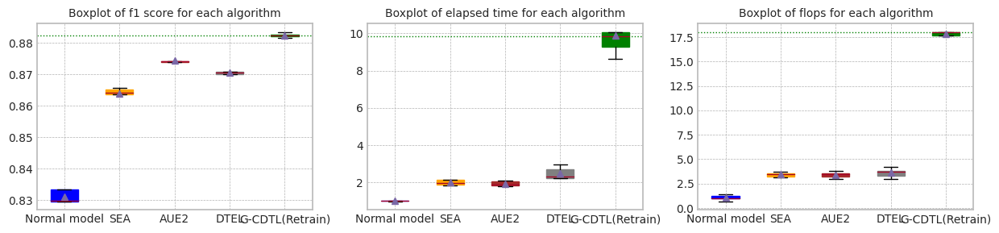

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.266607761383057


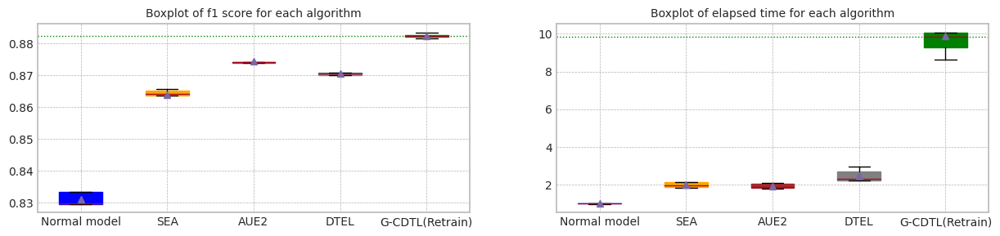

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.829748,0.749660,6.236370,3.793635e+09,121365000.0,3.915000e+09
1,1.0,0.915579,0.910222,0.833447,0.758317,6.151353,2.998890e+09,121365000.0,3.120255e+09
2,2.0,0.915306,0.910049,0.829658,0.753309,6.266608,3.085020e+09,121365000.0,3.206385e+09
3,3.0,0.914401,0.908813,0.818954,0.724145,6.351141,2.059290e+09,121365000.0,2.180655e+09
4,4.0,0.916595,0.911179,0.844266,0.776449,6.397830,4.271265e+09,121365000.0,4.392630e+09
5,median,0.915579,0.910222,0.829748,0.753309,6.266608,3.085020e+09,121365000.0,3.206385e+09
6,std,0.000785,0.000848,0.009086,0.018842,0.096922,8.435394e+08,0.0,8.435394e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.840734,0.752348,6.299217,4.015260e+10,609615000.0,4.076222e+10
1,1.0,0.916210,0.910644,0.837812,0.753283,6.302024,2.798168e+10,609615000.0,2.859129e+10
2,2.0,0.918385,0.913173,0.830301,0.725624,6.436958,1.175229e+10,609615000.0,1.236190e+10
3,3.0,0.916707,0.912018,0.845788,0.771953,6.328006,3.873672e+10,609615000.0,3.934634e+10
4,4.0,0.917568,0.912789,0.843201,0.760834,6.299152,3.993628e+10,609615000.0,4.054590e+10
5,median,0.917442,0.912018,0.840734,0.753283,6.302024,3.873672e+10,609615000.0,3.934634e+10
6,std,0.000837,0.001004,0.005963,0.017105,0.059327,1.225290e+10,0.0,1.225290e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.864226,0.834649,11.806651,5.646300e+09,5.626725e+09,1.127302e+10
1,1.0,0.915579,0.910222,0.865029,0.832963,11.590406,5.581920e+09,4.767600e+09,1.034952e+10
2,2.0,0.915306,0.910049,0.863669,0.833094,13.355355,5.965155e+09,5.236965e+09,1.120212e+10
3,3.0,0.914401,0.908813,0.860368,0.833590,13.349353,5.956020e+09,4.202100e+09,1.015812e+10
4,4.0,0.916595,0.911179,0.865671,0.828982,12.384959,5.676315e+09,6.134370e+09,1.181068e+10
5,median,0.915579,0.910222,0.864226,0.833094,12.384959,5.676315e+09,5.236965e+09,1.120212e+10
6,std,0.000785,0.000848,0.002061,0.002158,0.832815,1.816752e+08,7.481768e+08,6.884694e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.873905,0.860342,11.489074,5.578440e+09,5.680230e+09,1.125867e+10
1,1.0,0.915579,0.910222,0.874017,0.858656,13.049796,5.917305e+09,5.224350e+09,1.114166e+10
2,2.0,0.915306,0.910049,0.874049,0.860976,11.273410,5.474475e+09,4.867650e+09,1.034212e+10
3,3.0,0.914401,0.908813,0.873056,0.858321,11.814040,5.561910e+09,3.929355e+09,9.491265e+09
4,4.0,0.916595,0.911179,0.876234,0.862858,12.839282,5.785065e+09,6.364485e+09,1.214955e+10
5,median,0.915579,0.910222,0.874017,0.860342,11.814040,5.578440e+09,5.224350e+09,1.114166e+10
6,std,0.000785,0.000848,0.001180,0.001844,0.804156,1.819898e+08,9.098573e+08,1.005168e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.870560,0.872410,18.586087,7.240575e+09,6.281400e+09,1.352198e+10
1,1.0,0.915579,0.910222,0.870717,0.852366,16.854318,6.870825e+09,5.390955e+09,1.226178e+10
2,2.0,0.915306,0.910049,0.870069,0.874022,13.823813,6.075210e+09,4.450920e+09,1.052613e+10
3,3.0,0.914401,0.908813,0.868572,0.876595,13.926508,6.120450e+09,3.398220e+09,9.518670e+09
4,4.0,0.916595,0.911179,0.872700,0.858318,14.429946,6.196140e+09,5.581485e+09,1.177762e+10
5,median,0.915579,0.910222,0.870560,0.872410,14.429946,6.196140e+09,5.390955e+09,1.177762e+10
6,std,0.000785,0.000848,0.001482,0.010722,2.108654,5.250705e+08,1.117813e+09,1.550613e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.882647,0.879990,58.054244,5.652920e+10,26865000.0,5.655606e+10
1,1.0,0.916210,0.910644,0.882022,0.879261,61.737454,5.759616e+10,26865000.0,5.762302e+10
2,2.0,0.918385,0.913173,0.882285,0.876615,63.152217,5.776440e+10,26865000.0,5.779127e+10
3,3.0,0.916707,0.912018,0.881502,0.876429,72.948627,6.009362e+10,26865000.0,6.012048e+10
4,4.0,0.917568,0.912789,0.883415,0.876320,54.051920,5.416880e+10,26865000.0,5.419566e+10
5,median,0.917442,0.912018,0.882285,0.876615,61.737454,5.759616e+10,26865000.0,5.762302e+10
6,std,0.000837,0.001004,0.000716,0.001759,7.071232,2.149536e+09,0.0,2.149536e+09


trial_count: 5
Lambda :  0.9
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 12:45:13,919] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 968/2000 [00:02<00:02, 353.81it/s]

Early stop: 968
[2023-11-30 12:45:16,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3793635000
precision_recall_fscore: (array([0.89566143, 0.90749571]), array([0.87402597, 0.9238835 ]), array([0.88471145, 0.91561628]), array([3850, 5150]))
Test f1 score: 0.9156162801885885
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.97it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8297476836452425
inference_flops: 121365000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:45:22,983] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:45:22,986] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 439/2000 [00:04<00:14, 108.46it/s]

[2023-11-30 12:45:38,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:45:38,911] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6930000000 1722600000 40152600000
precision_recall_fscore: (array([0.88169586, 0.92550879]), array([0.90207792, 0.90951456]), array([0.89177045, 0.91744197]), array([3850, 5150]))
Test f1 score: 0.9174419743413965
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.82it/s]

mean of drift:
x0    0.214197
x1    0.459204
x2    0.169921
x3    0.231502
z0    0.337323
dtype: float64
Mean F1 for all data: 0.8407336960822396
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-30 12:45:45,434] [INFO] [profiler.py:80:start_profile] Flops profiler started



 38%|███▊      | 765/2000 [00:02<00:03, 363.65it/s]

Early stop: 765
[2023-11-30 12:45:47,544] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2998890000
precision_recall_fscore: (array([0.89855072, 0.90481608]), array([0.86961039, 0.92660194]), array([0.88384372, 0.91557943]), array([3850, 5150]))
Test f1 score: 0.9155794320798158
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.98it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8334474883649953
inference_flops: 121365000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:45:53,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:45:53,844] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 444/2000 [00:04<00:14, 108.16it/s]

[2023-11-30 12:46:05,254] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:46:05,255] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 19230750000 7008750000 1742175000 27981675000
precision_recall_fscore: (array([0.88052872, 0.92380576]), array([0.89974026, 0.90873786]), array([0.89003083, 0.91620987]), array([3850, 5150]))
Test f1 score: 0.9162098668754893
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.86it/s]

mean of drift:
x0    0.153763
x1    0.323978
x2    0.173430
x3    0.279502
z0    0.214986
dtype: float64
Mean F1 for all data: 0.8378116662863696
inference_flops: 609615000
Normal model median        : 0.8315975860051189
Drift tolerant model median: 0.8392726811843045
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-30 12:46:11,719] [INFO] [profiler.py:80:start_profile] Flops profiler started



 39%|███▉      | 787/2000 [00:02<00:03, 352.18it/s]

Early stop: 787
[2023-11-30 12:46:13,962] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3085020000
precision_recall_fscore: (array([0.89721627, 0.90539514]), array([0.87064935, 0.92543689]), array([0.88373319, 0.91530632]), array([3850, 5150]))
Test f1 score: 0.9153063184175149
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.94it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8296577026854857
inference_flops: 121365000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:46:20,312] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:46:20,314] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 29%|██▉       | 575/2000 [00:05<00:12, 114.09it/s]

[2023-11-30 12:46:25,527] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:46:25,528] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 9072000000 2255040000 11752290000
precision_recall_fscore: (array([0.90276659, 0.90733371]), array([0.87298701, 0.92970874]), array([0.8876271 , 0.91838496]), array([3850, 5150]))
Test f1 score: 0.9183849621175794
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.89it/s]

mean of drift:
x0    0.170061
x1    0.373964
x2    0.146014
x3    0.184556
z0    0.196495
dtype: float64
Mean F1 for all data: 0.8303009494211239
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8378116662863696
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-30 12:46:31,940] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▋       | 525/2000 [00:01<00:04, 361.79it/s]

Early stop: 525
[2023-11-30 12:46:33,399] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2059290000
precision_recall_fscore: (array([0.89548249, 0.90492489]), array([0.87012987, 0.92407767]), array([0.88262416, 0.914401  ]), array([3850, 5150]))
Test f1 score: 0.9144009991353637
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.91it/s]

mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8189535580239609
inference_flops: 121365000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:46:39,782] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:46:39,786] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 367/2000 [00:03<00:14, 111.32it/s]

[2023-11-30 12:46:54,985] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:46:54,987] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5796000000 1440720000 38736720000
precision_recall_fscore: (array([0.90333063, 0.90314679]), array([0.86649351, 0.93067961]), array([0.8845287 , 0.91670651]), array([3850, 5150]))
Test f1 score: 0.9167065123840489
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

mean of drift:
x0    0.143351
x1    0.381183
x2    0.310957
x3    0.241613
z0    0.230939
dtype: float64
Mean F1 for all data: 0.8457878928025607
inference_flops: 609615000
Normal model median        : 0.8297026931653642
Drift tolerant model median: 0.8392726811843045
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-30 12:47:01,335] [INFO] [profiler.py:80:start_profile] Flops profiler started



 55%|█████▍    | 1090/2000 [00:03<00:02, 362.93it/s]

Early stop: 1090
[2023-11-30 12:47:04,344] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4271265000
precision_recall_fscore: (array([0.89949075, 0.90624407]), array([0.87168831, 0.92718447]), array([0.88537132, 0.91659468]), array([3850, 5150]))
Test f1 score: 0.9165946827910548
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.86it/s]


mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8442659535091332
inference_flops: 121365000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 12:47:10,800] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:47:10,803] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:13, 114.34it/s]

[2023-11-30 12:47:26,508] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:47:26,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6756750000 1679535000 39936285000
precision_recall_fscore: (array([0.90337382, 0.90500472]), array([0.86935065, 0.93048544]), array([0.88603574, 0.91756821]), array([3850, 5150]))
Test f1 score: 0.9175682144566778
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  4.89it/s]


mean of drift:
x0    0.108262
x1    0.334530
x2    0.221606
x3    0.182735
z0    0.225756
dtype: float64
Mean F1 for all data: 0.843200881802644
inference_flops: 609615000
Normal model median        : 0.8297476836452425
Drift tolerant model median: 0.8407336960822396
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:01<00:05,  4.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:47:34,267] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:47:34,269] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:47:42,482] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:47:42,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:09<01:15,  3.01s/it]

G-CDTL train flops: 1386000000 754250000 187485000 2327735000


 35%|███▌      | 11/31 [00:10<00:12,  1.59it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:47:43,712] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:47:43,715] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:47:58,655] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:47:58,656] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:25<01:35,  5.05s/it]

G-CDTL train flops: 3500000000 714000000 177480000 4391480000


 55%|█████▍    | 17/31 [00:26<00:14,  1.01s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:47:59,906] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:47:59,909] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:48:04,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:48:04,568] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:31<00:28,  2.17s/it]

G-CDTL train flops: 84000000 918750000 228375000 1231125000


 74%|███████▍  | 23/31 [00:32<00:04,  1.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:48:05,803] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:48:05,806] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:48:21,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:48:21,497] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:48<00:36,  5.15s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


 94%|█████████▎| 29/31 [00:49<00:02,  1.03s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:48:22,714] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:48:22,716] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:48:38,494] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:48:38,495] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [01:05<00:05,  5.52s/it]

G-CDTL train flops: 3500000000 841750000 209235000 4550985000


100%|██████████| 31/31 [01:05<00:00,  2.12s/it]


Early stop at  [430, 407, 524, 454, 480]
Train flops  [2327735000, 4391480000, 1231125000, 4494175000, 4550985000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8814147993438375
G_CDTL+AUE median: 0.8814147993438375
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:03<00:27,  1.10s/it]

Ensemble_SEA train flops: 610740000


 39%|███▊      | 12/31 [00:06<00:13,  1.40it/s]

Ensemble_SEA train flops: 311460000


 58%|█████▊    | 18/31 [00:10<00:14,  1.09s/it]

Ensemble_SEA train flops: 647715000


 77%|███████▋  | 24/31 [00:12<00:04,  1.58it/s]

Ensemble_SEA train flops: 247080000


 97%|█████████▋| 30/31 [00:16<00:00,  1.12it/s]

Ensemble_SEA train flops: 498945000


100%|██████████| 31/31 [00:16<00:00,  1.90it/s]


Early stop at  [1403, 715, 1488, 567, 1146]
Train flops  [610740000, 311460000, 647715000, 247080000, 498945000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8628522506809825
SEA median: 0.8628522506809825
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:10,  2.35it/s]

Ensemble_SEA train flops: 224460000


 42%|████▏     | 13/31 [00:04<00:08,  2.13it/s]

Ensemble_SEA train flops: 265785000


 58%|█████▊    | 18/31 [00:07<00:09,  1.37it/s]

Ensemble_SEA train flops: 371490000


 77%|███████▋  | 24/31 [00:10<00:05,  1.38it/s]

Ensemble_SEA train flops: 350610000


 97%|█████████▋| 30/31 [00:12<00:00,  1.70it/s]

Ensemble_SEA train flops: 250560000


100%|██████████| 31/31 [00:12<00:00,  2.45it/s]


Early stop at  [515, 610, 853, 805, 575]
Train flops  [224460000, 265785000, 371490000, 350610000, 250560000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8738545963070052
AUE median: 0.8738545963070052
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:14,  1.70it/s]

Ensemble_DTEL train flops: 244470000
Ensemble_DTEL train flops: 2175000


 35%|███▌      | 11/31 [00:03<00:05,  3.77it/s]

Ensemble_DTEL train flops: 237075000


 39%|███▊      | 12/31 [00:06<00:21,  1.11s/it]

Ensemble_DTEL train flops: 412815000


 58%|█████▊    | 18/31 [00:08<00:08,  1.48it/s]

Ensemble_DTEL train flops: 279270000
Ensemble_DTEL train flops: 2175000


 74%|███████▍  | 23/31 [00:09<00:02,  3.55it/s]

Ensemble_DTEL train flops: 669030000


 77%|███████▋  | 24/31 [00:15<00:12,  1.80s/it]

Ensemble_DTEL train flops: 538530000


 97%|█████████▋| 30/31 [00:17<00:00,  1.37it/s]

Ensemble_DTEL train flops: 265350000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:17<00:00,  1.74it/s]


Early stop at  [561, 4, 544, 948, 641, 4, 1537, 1237, 609, 4]
Train flops  [244470000, 2175000, 237075000, 412815000, 279270000, 2175000, 669030000, 538530000, 265350000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8699623415315221
DTEL median: 0.8699623415315221
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:01<00:05,  4.96it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:49:26,882] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:49:26,885] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:49:41,988] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:49:41,989] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:16<02:13,  5.34s/it]

G-CDTL train flops: 3500000000 661500000 164430000 4325930000


 35%|███▌      | 11/31 [00:17<00:19,  1.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:49:43,264] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:49:43,268] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:49:59,094] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:49:59,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:33<01:45,  5.57s/it]

G-CDTL train flops: 3500000000 794500000 197490000 4491990000


 55%|█████▍    | 17/31 [00:34<00:15,  1.09s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:50:00,291] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:50:00,294] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:50:16,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:50:16,445] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:50<01:13,  5.68s/it]

G-CDTL train flops: 3500000000 843500000 209670000 4553170000


 74%|███████▍  | 23/31 [00:51<00:08,  1.12s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:50:17,676] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:50:17,678] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:50:32,743] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:50:32,744] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [01:07<00:37,  5.37s/it]

G-CDTL train flops: 3500000000 602000000 149640000 4251640000


 94%|█████████▎| 29/31 [01:08<00:02,  1.08s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:50:34,005] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:50:34,008] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:50:41,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:50:41,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [01:16<00:03,  3.20s/it]

G-CDTL train flops: 84000000 1573250000 391065000 2048315000


100%|██████████| 31/31 [01:16<00:00,  2.47s/it]


Early stop at  [377, 453, 481, 343, 898]
Train flops  [4325930000, 4491990000, 4553170000, 4251640000, 2048315000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8793749787986719
G_CDTL+AUE median: 0.8803948890712547
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:15,  1.56it/s]

Ensemble_SEA train flops: 284925000


 39%|███▊      | 12/31 [00:04<00:09,  1.94it/s]

Ensemble_SEA train flops: 182700000


 58%|█████▊    | 18/31 [00:08<00:12,  1.04it/s]

Ensemble_SEA train flops: 550710000


 77%|███████▋  | 24/31 [00:13<00:09,  1.31s/it]

Ensemble_SEA train flops: 799095000


 97%|█████████▋| 30/31 [00:16<00:00,  1.13it/s]

Ensemble_SEA train flops: 419775000


100%|██████████| 31/31 [00:16<00:00,  1.89it/s]


Early stop at  [654, 419, 1265, 1836, 964]
Train flops  [284925000, 182700000, 550710000, 799095000, 419775000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8643383786308101
SEA median: 0.8635953146558963
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:13,  1.91it/s]

Ensemble_SEA train flops: 213585000


 39%|███▊      | 12/31 [00:04<00:09,  1.99it/s]

Ensemble_SEA train flops: 201405000


 58%|█████▊    | 18/31 [00:06<00:07,  1.79it/s]

Ensemble_SEA train flops: 246210000


 77%|███████▋  | 24/31 [00:09<00:04,  1.53it/s]

Ensemble_SEA train flops: 304065000


 97%|█████████▋| 30/31 [00:12<00:00,  1.07it/s]

Ensemble_SEA train flops: 504165000


100%|██████████| 31/31 [00:12<00:00,  2.41it/s]


Early stop at  [490, 462, 565, 698, 1158]
Train flops  [213585000, 201405000, 246210000, 304065000, 504165000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8743207243989867
AUE median: 0.8740876603529959
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:14,  1.75it/s]

Ensemble_DTEL train flops: 240120000
Ensemble_DTEL train flops: 2175000


 35%|███▌      | 11/31 [00:03<00:05,  3.86it/s]

Ensemble_DTEL train flops: 508950000


 39%|███▊      | 12/31 [00:07<00:27,  1.43s/it]

Ensemble_DTEL train flops: 381060000


 58%|█████▊    | 18/31 [00:10<00:10,  1.28it/s]

Ensemble_DTEL train flops: 338865000
Ensemble_DTEL train flops: 2175000


 74%|███████▍  | 23/31 [00:11<00:02,  3.28it/s]

Ensemble_DTEL train flops: 378450000


 77%|███████▋  | 24/31 [00:14<00:08,  1.17s/it]

Ensemble_DTEL train flops: 297105000


 94%|█████████▎| 29/31 [00:15<00:00,  2.76it/s]

Ensemble_DTEL train flops: 846945000


100%|██████████| 31/31 [00:20<00:00,  1.19s/it]

Ensemble_DTEL train flops: 156165000


100%|██████████| 31/31 [00:20<00:00,  1.55it/s]


Early stop at  [551, 4, 1169, 875, 778, 4, 869, 682, 1946, 358]
Train flops  [240120000, 2175000, 508950000, 381060000, 338865000, 2175000, 378450000, 297105000, 846945000, 156165000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.873643500491314
DTEL median: 0.871802921011418
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:01<00:05,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:51:32,886] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:51:32,888] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:51:44,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:51:44,445] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:12<01:43,  4.13s/it]

G-CDTL train flops: 2514750000 596750000 148335000 3259835000


 35%|███▌      | 11/31 [00:13<00:15,  1.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:51:45,662] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:51:45,665] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:51:49,482] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:51:49,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:17<00:33,  1.78s/it]

G-CDTL train flops: 92750000 708750000 176175000 977675000


 55%|█████▍    | 17/31 [00:18<00:06,  2.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:51:50,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:51:50,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:52:07,242] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:52:07,243] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:35<01:09,  5.36s/it]

G-CDTL train flops: 3500000000 918750000 228375000 4647125000


 74%|███████▍  | 23/31 [00:36<00:08,  1.07s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:52:08,472] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:52:08,475] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:52:12,040] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:52:12,041] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:40<00:13,  1.88s/it]

G-CDTL train flops: 73500000 659750000 163995000 897245000


 94%|█████████▎| 29/31 [00:41<00:00,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:52:13,275] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:52:13,277] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:52:30,248] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:52:30,249] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:58<00:05,  5.50s/it]

G-CDTL train flops: 3500000000 971250000 241425000 4712675000


100%|██████████| 31/31 [00:58<00:00,  1.90s/it]


Early stop at  [340, 404, 524, 376, 554]
Train flops  [3259835000, 977675000, 4647125000, 897245000, 4712675000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8819098234789935
G_CDTL+AUE median: 0.8814147993438375
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.49it/s]

Ensemble_SEA train flops: 201840000


 39%|███▊      | 12/31 [00:04<00:09,  1.92it/s]

Ensemble_SEA train flops: 220110000


 58%|█████▊    | 18/31 [00:06<00:07,  1.67it/s]

Ensemble_SEA train flops: 268395000


 77%|███████▋  | 24/31 [00:09<00:04,  1.48it/s]

Ensemble_SEA train flops: 317985000


 97%|█████████▋| 30/31 [00:11<00:00,  1.45it/s]

Ensemble_SEA train flops: 307545000


100%|██████████| 31/31 [00:12<00:00,  2.54it/s]


Early stop at  [463, 505, 616, 730, 706]
Train flops  [201840000, 220110000, 268395000, 317985000, 307545000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.863028682861495
SEA median: 0.863028682861495
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:14,  1.77it/s]

Ensemble_SEA train flops: 235335000


 42%|████▏     | 13/31 [00:04<00:08,  2.07it/s]

Ensemble_SEA train flops: 269700000


 58%|█████▊    | 18/31 [00:07<00:07,  1.70it/s]

Ensemble_SEA train flops: 241425000


 77%|███████▋  | 24/31 [00:12<00:09,  1.38s/it]

Ensemble_SEA train flops: 840420000


100%|██████████| 31/31 [00:14<00:00,  2.08it/s]

Ensemble_SEA train flops: 327990000


Early stop at  [540, 619, 554, 1931, 753]
Train flops  [235335000, 269700000, 241425000, 840420000, 327990000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.873442481961077
AUE median: 0.8738545963070052
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:03<00:26,  1.05s/it]

Ensemble_DTEL train flops: 568110000
Ensemble_DTEL train flops: 2175000


 35%|███▌      | 11/31 [00:04<00:06,  2.99it/s]

Ensemble_DTEL train flops: 600735000


 42%|████▏     | 13/31 [00:10<00:24,  1.37s/it]

Ensemble_DTEL train flops: 558540000


 58%|█████▊    | 18/31 [00:12<00:11,  1.12it/s]

Ensemble_DTEL train flops: 381930000
Ensemble_DTEL train flops: 2175000


 74%|███████▍  | 23/31 [00:13<00:02,  3.18it/s]

Ensemble_DTEL train flops: 255345000


 77%|███████▋  | 24/31 [00:16<00:07,  1.06s/it]

Ensemble_DTEL train flops: 327555000


 97%|█████████▋| 30/31 [00:20<00:01,  1.20s/it]

Ensemble_DTEL train flops: 659895000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:21<00:00,  1.46it/s]


Early stop at  [1305, 4, 1380, 1283, 877, 4, 586, 752, 1516, 3]
Train flops  [568110000, 2175000, 600735000, 558540000, 381930000, 2175000, 255345000, 327555000, 659895000, 1740000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8703458192639549
DTEL median: 0.8703458192639549
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:01<00:05,  4.84it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:53:20,222] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:53:20,224] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:53:36,237] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:53:36,239] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:17<02:21,  5.66s/it]

G-CDTL train flops: 3500000000 743750000 184875000 4428625000


 35%|███▌      | 11/31 [00:18<00:20,  1.03s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:53:37,451] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:53:37,454] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:53:53,062] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:53:53,063] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:34<01:45,  5.53s/it]

G-CDTL train flops: 3500000000 645750000 160515000 4306265000


 55%|█████▍    | 17/31 [00:35<00:15,  1.09s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:53:54,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:53:54,288] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:54:10,814] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:54:10,816] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:51<01:15,  5.79s/it]

G-CDTL train flops: 3500000000 838250000 208365000 4546615000


 74%|███████▍  | 23/31 [00:52<00:09,  1.15s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:54:12,094] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:54:12,096] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:54:28,270] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:54:28,271] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [01:09<00:40,  5.72s/it]

G-CDTL train flops: 3500000000 726250000 180525000 4406775000


 94%|█████████▎| 29/31 [01:10<00:02,  1.13s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:54:29,481] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:54:29,483] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:54:48,237] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:54:48,239] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [01:29<00:06,  6.48s/it]

G-CDTL train flops: 3500000000 1295000000 321900000 5116900000


100%|██████████| 31/31 [01:29<00:00,  2.89s/it]


Early stop at  [424, 368, 478, 414, 739]
Train flops  [4428625000, 4306265000, 4546615000, 4406775000, 5116900000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8807917052660844
G_CDTL+AUE median: 0.8811032523049609
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:12,  2.01it/s]

Ensemble_SEA train flops: 190965000


 42%|████▏     | 13/31 [00:04<00:07,  2.34it/s]

Ensemble_SEA train flops: 217500000


 58%|█████▊    | 18/31 [00:06<00:07,  1.74it/s]

Ensemble_SEA train flops: 250560000


 77%|███████▋  | 24/31 [00:09<00:04,  1.54it/s]

Ensemble_SEA train flops: 306240000


 97%|█████████▋| 30/31 [00:11<00:00,  1.45it/s]

Ensemble_SEA train flops: 324510000


100%|██████████| 31/31 [00:12<00:00,  2.58it/s]


Early stop at  [438, 499, 575, 703, 745]
Train flops  [190965000, 217500000, 250560000, 306240000, 324510000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8601359019384242
SEA median: 0.8629404667712388
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:17,  1.45it/s]

Ensemble_SEA train flops: 311460000


 39%|███▊      | 12/31 [00:05<00:15,  1.19it/s]

Ensemble_SEA train flops: 428040000


 58%|█████▊    | 18/31 [00:08<00:10,  1.21it/s]

Ensemble_SEA train flops: 403245000


 81%|████████  | 25/31 [00:11<00:03,  1.83it/s]

Ensemble_SEA train flops: 312765000


 97%|█████████▋| 30/31 [00:14<00:00,  1.20it/s]

Ensemble_SEA train flops: 410640000


100%|██████████| 31/31 [00:14<00:00,  2.10it/s]


Early stop at  [715, 983, 926, 718, 943]
Train flops  [311460000, 428040000, 403245000, 312765000, 410640000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8741226173352289
AUE median: 0.8739886068211171
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:16,  1.47it/s]

Ensemble_DTEL train flops: 312765000
Ensemble_DTEL train flops: 2610000


 35%|███▌      | 11/31 [00:03<00:05,  3.67it/s]

Ensemble_DTEL train flops: 315810000


 42%|████▏     | 13/31 [00:06<00:12,  1.46it/s]

Ensemble_DTEL train flops: 152250000


 58%|█████▊    | 18/31 [00:08<00:08,  1.53it/s]

Ensemble_DTEL train flops: 269265000
Ensemble_DTEL train flops: 2175000


 74%|███████▍  | 23/31 [00:09<00:02,  3.64it/s]

Ensemble_DTEL train flops: 420645000


 77%|███████▋  | 24/31 [00:12<00:07,  1.05s/it]

Ensemble_DTEL train flops: 173130000


 97%|█████████▋| 30/31 [00:16<00:01,  1.26s/it]

Ensemble_DTEL train flops: 725145000
Ensemble_DTEL train flops: 2175000


100%|██████████| 31/31 [00:16<00:00,  1.84it/s]


Early stop at  [718, 5, 725, 349, 618, 4, 966, 397, 1666, 4]
Train flops  [312765000, 2610000, 315810000, 152250000, 269265000, 2175000, 420645000, 173130000, 725145000, 2175000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.869869549181271
DTEL median: 0.8701540803977386
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 16%|█▌        | 5/31 [00:01<00:05,  4.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:55:33,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:55:33,529] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:55:42,700] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:55:42,702] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:10<01:23,  3.33s/it]

G-CDTL train flops: 1422750000 782250000 194445000 2399445000


 35%|███▌      | 11/31 [00:11<00:13,  1.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:55:43,924] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:55:43,926] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:56:01,395] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:56:01,397] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:29<01:51,  5.85s/it]

G-CDTL train flops: 3500000000 962500000 239250000 4701750000


 55%|█████▍    | 17/31 [00:30<00:16,  1.14s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:56:02,654] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:56:02,657] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:56:28,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:56:28,760] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:56<01:53,  8.71s/it]

G-CDTL train flops: 3500000000 2619750000 651195000 6770945000


 74%|███████▍  | 23/31 [00:57<00:13,  1.63s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:56:30,010] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:56:30,013] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:56:45,935] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:56:45,937] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [01:13<00:41,  5.99s/it]

G-CDTL train flops: 3500000000 621250000 154425000 4275675000


 94%|█████████▎| 29/31 [01:14<00:02,  1.18s/it]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 12:56:47,204] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 12:56:47,208] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 12:57:03,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 12:57:03,308] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [01:31<00:05,  5.72s/it]

G-CDTL train flops: 3500000000 680750000 169215000 4349965000


100%|██████████| 31/31 [01:31<00:00,  2.94s/it]


Early stop at  [446, 549, 1496, 354, 388]
Train flops  [2399445000, 4701750000, 6770945000, 4275675000, 4349965000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8802738901923791
G_CDTL+AUE median: 0.8807917052660844
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:12,  2.04it/s]

Ensemble_SEA train flops: 187485000


 39%|███▊      | 12/31 [00:04<00:11,  1.61it/s]

Ensemble_SEA train flops: 277530000


 58%|█████▊    | 18/31 [00:07<00:08,  1.56it/s]

Ensemble_SEA train flops: 272310000


 77%|███████▋  | 24/31 [00:09<00:04,  1.51it/s]

Ensemble_SEA train flops: 284490000


 97%|█████████▋| 30/31 [00:13<00:01,  1.01s/it]

Ensemble_SEA train flops: 545925000


100%|██████████| 31/31 [00:13<00:00,  2.28it/s]


Early stop at  [430, 637, 625, 653, 1254]
Train flops  [187485000, 277530000, 272310000, 284490000, 545925000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8657634473139184
SEA median: 0.863028682861495
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:12,  2.02it/s]

Ensemble_SEA train flops: 194010000


 39%|███▊      | 12/31 [00:04<00:11,  1.66it/s]

Ensemble_SEA train flops: 263610000


 58%|█████▊    | 18/31 [00:06<00:07,  1.73it/s]

Ensemble_SEA train flops: 229245000


 77%|███████▋  | 24/31 [00:10<00:06,  1.14it/s]

Ensemble_SEA train flops: 462840000


 97%|█████████▋| 30/31 [00:12<00:00,  1.56it/s]

Ensemble_SEA train flops: 260565000


100%|██████████| 31/31 [00:12<00:00,  2.42it/s]


Early stop at  [445, 605, 526, 1063, 598]
Train flops  [194010000, 263610000, 229245000, 462840000, 260565000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8748924028080457
AUE median: 0.8741226173352289
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 19%|█▉        | 6/31 [00:02<00:13,  1.86it/s]

Ensemble_DTEL train flops: 214455000
Ensemble_DTEL train flops: 2175000


 35%|███▌      | 11/31 [00:03<00:05,  3.96it/s]

Ensemble_DTEL train flops: 229245000


 39%|███▊      | 12/31 [00:05<00:15,  1.26it/s]

Ensemble_DTEL train flops: 159210000


 58%|█████▊    | 18/31 [00:08<00:11,  1.18it/s]

Ensemble_DTEL train flops: 413250000
Ensemble_DTEL train flops: 2175000


 74%|███████▍  | 23/31 [00:09<00:02,  3.20it/s]

Ensemble_DTEL train flops: 401505000


 81%|████████  | 25/31 [00:12<00:05,  1.13it/s]

Ensemble_DTEL train flops: 254910000


 94%|█████████▎| 29/31 [00:13<00:00,  2.73it/s]

Ensemble_DTEL train flops: 236640000


 97%|█████████▋| 30/31 [00:17<00:01,  1.37s/it]

Ensemble_DTEL train flops: 526350000


100%|██████████| 31/31 [00:17<00:00,  1.77it/s]


Early stop at  [492, 4, 526, 365, 949, 4, 922, 585, 543, 1209]
Train flops  [214455000, 2175000, 229245000, 159210000, 413250000, 2175000, 401505000, 254910000, 236640000, 526350000]
Mean of drift:
x0    0.010828
x1    0.503194
x2    0.214534
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8739055559814439
DTEL median: 0.8703458192639549


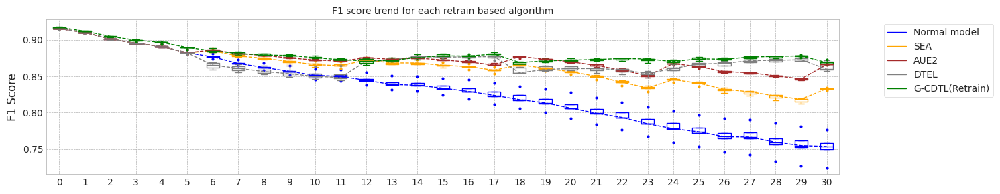

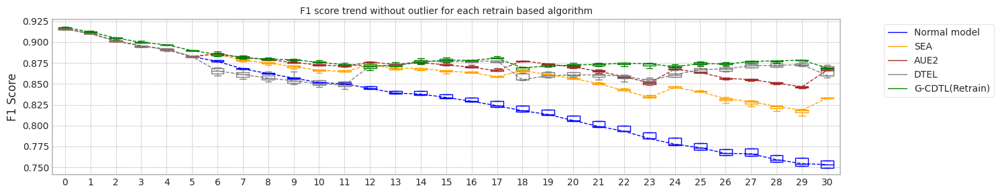

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.328224182128906
Base flops (train + inference flops of normal model, median): 3206385000.0


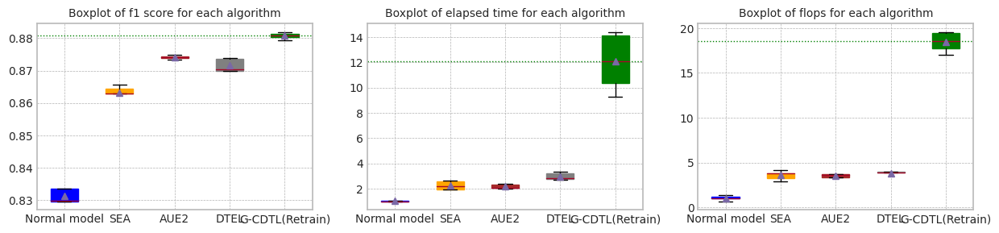

Base elapsed time (inference elapsed time of normal model, median (ms)): 6.328224182128906


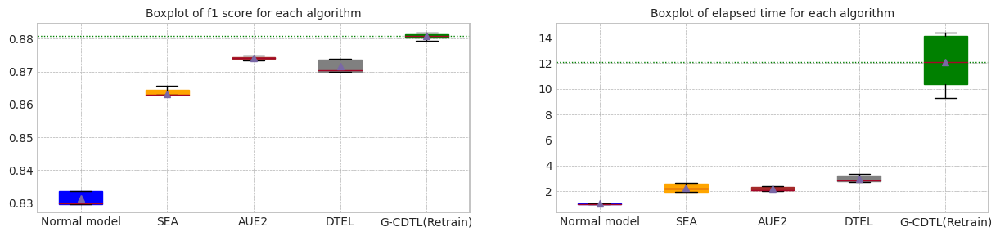

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.829748,0.749660,6.302023,3.793635e+09,121365000.0,3.915000e+09
1,1.0,0.915579,0.910222,0.833447,0.758317,6.278148,2.998890e+09,121365000.0,3.120255e+09
2,2.0,0.915306,0.910049,0.829658,0.753309,6.328224,3.085020e+09,121365000.0,3.206385e+09
3,3.0,0.914401,0.908813,0.818954,0.724145,6.363684,2.059290e+09,121365000.0,2.180655e+09
4,4.0,0.916595,0.911179,0.844266,0.776449,6.435695,4.271265e+09,121365000.0,4.392630e+09
5,median,0.915579,0.910222,0.829748,0.753309,6.328224,3.085020e+09,121365000.0,3.206385e+09
6,std,0.000785,0.000848,0.009086,0.018842,0.061467,8.435394e+08,0.0,8.435394e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.840734,0.752348,6.501032,4.015260e+10,609615000.0,4.076222e+10
1,1.0,0.916210,0.910644,0.837812,0.753283,6.443088,2.798168e+10,609615000.0,2.859129e+10
2,2.0,0.918385,0.913173,0.830301,0.725624,6.390514,1.175229e+10,609615000.0,1.236190e+10
3,3.0,0.916707,0.912018,0.845788,0.771953,6.322030,3.873672e+10,609615000.0,3.934634e+10
4,4.0,0.917568,0.912789,0.843201,0.760834,6.397119,3.993628e+10,609615000.0,4.054590e+10
5,median,0.917442,0.912018,0.840734,0.753283,6.397119,3.873672e+10,609615000.0,3.934634e+10
6,std,0.000837,0.001004,0.005963,0.017105,0.066451,1.225290e+10,0.0,1.225290e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.862852,0.832835,16.351330,6.587205e+09,6.610695e+09,1.319790e+10
1,1.0,0.915579,0.910222,0.864338,0.834496,16.452714,6.508470e+09,5.737215e+09,1.224568e+10
2,2.0,0.915306,0.910049,0.863029,0.833076,12.246484,5.587140e+09,4.902015e+09,1.048916e+10
3,3.0,0.914401,0.908813,0.860136,0.830280,12.070633,5.561040e+09,3.850185e+09,9.411225e+09
4,4.0,0.916595,0.911179,0.865763,0.833461,13.671931,5.839005e+09,6.340125e+09,1.217913e+10
5,median,0.915579,0.910222,0.863029,0.833076,13.671931,5.839005e+09,5.737215e+09,1.217913e+10
6,std,0.000785,0.000848,0.002086,0.001560,2.140307,4.977542e+08,1.126331e+09,1.523549e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.873855,0.866403,12.703934,5.734170e+09,5.879025e+09,1.161320e+10
1,1.0,0.915579,0.910222,0.874321,0.867543,12.897503,5.740695e+09,5.090805e+09,1.083150e+10
2,2.0,0.915306,0.910049,0.873442,0.866187,14.937357,6.186135e+09,5.622375e+09,1.180851e+10
3,3.0,0.914401,0.908813,0.874123,0.865616,14.810209,6.137415e+09,4.547925e+09,1.068534e+10
4,4.0,0.916595,0.911179,0.874892,0.866412,12.865227,5.681535e+09,6.304020e+09,1.198556e+10
5,median,0.915579,0.910222,0.874123,0.866403,12.897503,5.740695e+09,5.622375e+09,1.161320e+10
6,std,0.000785,0.000848,0.000540,0.000700,1.126974,2.443171e+08,6.852640e+08,5.890641e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.915616,0.910295,0.869962,0.860010,17.861923,6.924330e+09,5.506230e+09,1.243056e+10
1,1.0,0.915579,0.910222,0.873644,0.872509,20.122704,7.423275e+09,5.173890e+09,1.259716e+10
2,2.0,0.915306,0.910049,0.870346,0.859688,21.262846,7.629465e+09,5.126475e+09,1.275594e+10
3,3.0,0.914401,0.908813,0.869870,0.857596,16.921596,6.647235e+09,3.606150e+09,1.025338e+10
4,4.0,0.916595,0.911179,0.873906,0.870738,17.572273,6.711180e+09,5.942100e+09,1.265328e+10
5,median,0.915579,0.910222,0.870346,0.860010,17.861923,6.924330e+09,5.173890e+09,1.259716e+10
6,std,0.000785,0.000848,0.002045,0.006951,1.851856,4.377396e+08,8.814320e+08,1.060137e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.917442,0.911551,0.881415,0.872708,65.787445,5.693178e+10,8955000.0,5.694074e+10
1,1.0,0.916210,0.910644,0.879375,0.866467,76.518992,5.960733e+10,8955000.0,5.961628e+10
2,2.0,0.918385,0.913173,0.881910,0.869103,58.834295,5.443084e+10,8955000.0,5.443980e+10
3,3.0,0.916707,0.912018,0.880792,0.869032,89.539939,6.274146e+10,8955000.0,6.275042e+10
4,4.0,0.917568,0.912789,0.880274,0.867871,91.251621,6.243406e+10,8955000.0,6.244302e+10
5,median,0.917442,0.912018,0.880792,0.869032,76.518992,5.960733e+10,8955000.0,5.961628e+10
6,std,0.000837,0.001004,0.000988,0.002316,14.269042,3.572552e+09,0.0,3.572552e+09


Test F1 Score: 0.9154995425224675
G-CDTL, 1-retrain: 0.8735672885333633


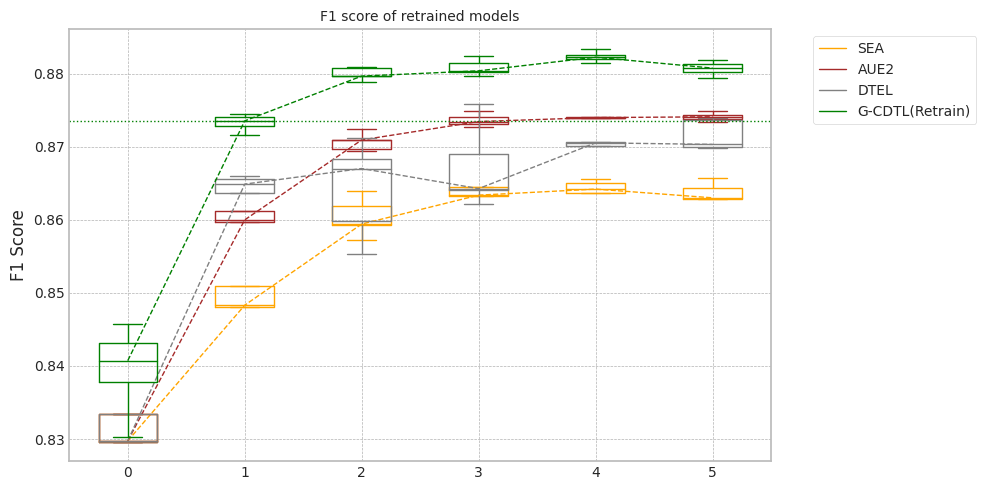

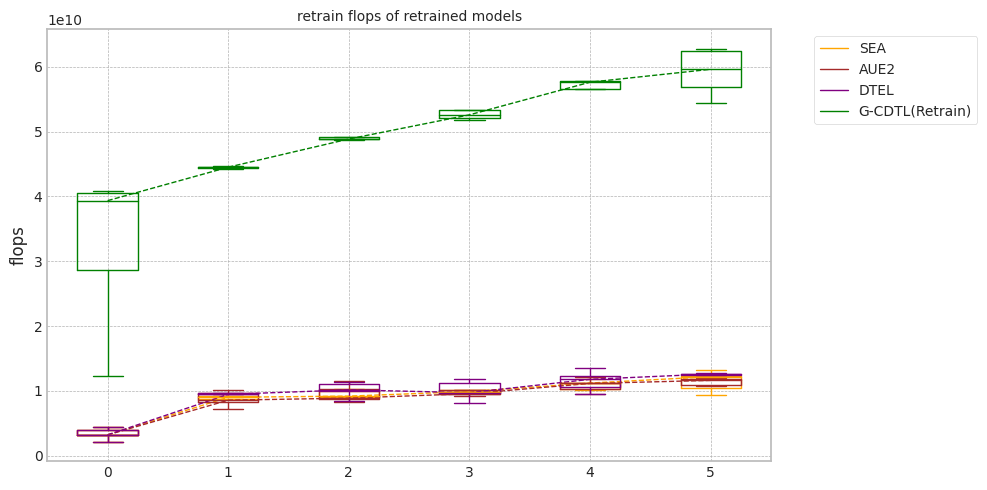

In [ ]:
experiment_all(2000,'case5',X1, Y1,train_size, test_size,avaible_range = 400,
               lambda_f2=0.9,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

# Real-world data 의 실험

In [96]:
from more_itertools import locate
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

def find_indices(list_to_check, item_to_find):
    indices = locate(list_to_check, lambda x: x == item_to_find)
    return list(indices)

def check_mi_drift(X:pd.DataFrame,Y:np.array,train_size:int,test_size:int,scaling=True):

    columns = X.columns
    is_Has_bucket = False
    # 'b' 즉, bucket count 가 있으며, 'b'를 제외 시킨다.
    if 'b' in columns:
        print('Dataset has buckets!')
        columns = columns[0:-1]
        buckets = list(X['b'])
        X = X[columns]
        is_Has_bucket = True

    mi_scores = make_mi_scores(X, Y, discrete_features="auto")
    #print(mi_scores)
    print(f'MI Analysis MI Max {np.max(mi_scores):.5f}, Min {np.min(mi_scores):.5f}, Mean {np.mean(mi_scores):.5f}, Std {np.std(mi_scores):.5f}')

    if scaling:
        scaler_c1 = MinMaxScaler()
        # trainset을 가지고 Scaler를 fit하고, testset을 포함한 그 이후의 Data를 모두 transform 한다.
        X = pd.DataFrame(np.concatenate((scaler_c1.fit_transform(X[0:train_size]), scaler_c1.transform(X[train_size:])),axis=0), columns=columns)
    else:
        X = pd.DataFrame(np.concatenate((X[0:train_size], X[train_size:]),axis=0), columns=columns)

    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    print('Dataset structure X_train,',X_train.shape,'X_test,',X_test.shape,'X_live',X_live.shape)
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    if is_Has_bucket:
        b_min = min(buckets[-X_live.shape[0]:])
        b_max = max(buckets[-X_live.shape[0]:])
        print(f'bucket range in live set {b_min}~{b_max}')
        for i in range(b_min,b_max+1):
            s = find_indices(buckets,i)
            if len(s) > 0:
                xl = X.iloc[s]
                yl = Y[s]
                X_live_set.append(xl)
                Y_live_set.append(yl)
    else:
        for i in range(int(X_live.shape[0]/test_size)):
            xl = X_live[i*test_size:i*test_size+train_size]
            yl = Y_live[i*test_size:i*test_size+train_size]

            if len(xl) ==  train_size:
                X_live_set.append(xl)
                Y_live_set.append(yl)
            else:
                #print(xl.shape)
                truncate_count = xl.shape[0] #truncate_count + len(xl)
                break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = np.asarray(X_live_set)
    Y_live_set = np.asarray(Y_live_set)

    MIS = {}
    DRF = {}
    for col in columns:
        MIS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        X_live_unit = pd.DataFrame(X_live_unit,columns = columns)
        mi_scores = make_mi_scores(X_live_unit, Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,X_live_unit.values)
        for ix,col in enumerate(columns):
            MIS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MIS)
    df_drf = pd.DataFrame(DRF)

    for c_name in df_mis.columns:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        df_mis[c_name].plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
        ax[0].set_title(f'Mutual Information of {c_name}',fontdict={'fontsize':10})

        df_drf[c_name].plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
        ax[1].set_title(f'Drift (KS-test) of {c_name}',fontdict={'fontsize':10})
        ax[1].legend(bbox_to_anchor=(1.0, 1.0))
        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    df_mis.plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
    ax[0].set_title(f'Mutual Information',fontdict={'fontsize':10})

    df_drf.plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
    ax[1].set_title(f'Drift (KS-test)',fontdict={'fontsize':10})
    ax[1].legend(bbox_to_anchor=(1.0, 1.0))
    plt.show()

    if is_Has_bucket:
        X['b'] = buckets
    return X,Y

## Loan data 실험

### Dataset 준비

#### Data load

In [97]:

df_accepted = pd.read_csv("/content/drive/MyDrive/Drift/accepted_2007_to_2018Q4.csv")

print(df_accepted.shape)

(2260701, 151)


#### Data 정제

In [98]:
# for the sake of simplicity, let's consider only Fully Paid and Charged Off values:
df_accepted = df_accepted[df_accepted.loan_status.isin(['Fully Paid', 'Charged Off'])]
print(df_accepted.shape)

cols_to_drop = df_accepted.isnull().sum().sort_values(ascending=False).head(50).index
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# maybe we can go further, and eliminate columns up to title:
cols_to_drop = df_accepted.isnull().sum().sort_values(ascending=False).head(45).index
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# Remaining columns have missing data points, but they account for less than 0.2% of the total data. Let's remove the rows that are missing those values in those columns with dropna():
df_accepted = df_accepted.dropna()
print(df_accepted.shape)

# These are constant columns. We can drop it either.
cols_to_drop = ['out_prncp', 'out_prncp_inv', 'policy_code']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# It seems we have many "duplicated" information. Let's drop some columns, based on visual inspection at corr_pairs dataframe:
cols_to_drop = ['fico_range_low', 'funded_amnt_inv', 'funded_amnt', 'total_pymnt_inv', 'total_pymnt', 'installment', 'collection_recovery_fee', 'total_rec_prncp', 'last_fico_range_low']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

values = df_accepted.loan_status.unique()
encode = [1,0]
d = dict(zip(values, encode))
df_accepted['loan_paid'] = df_accepted['loan_status'].map(d)
df_accepted = df_accepted.drop(columns=['loan_status'])

df_accepted

(1345310, 151)
(1345310, 101)
(1345310, 56)
(1341026, 56)
(1341026, 53)
(1341026, 44)


,id,loan_amnt,term,int_rate,grade,sub_grade,home_ownership,annual_inc,verification_status,issue_d,...,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens,hardship_flag,disbursement_method,debt_settlement_flag,loan_paid
0,68407277,3600.0,36 months,13.99,C,C4,MORTGAGE,55000.0,Not Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
1,68355089,24700.0,36 months,11.99,C,C1,MORTGAGE,65000.0,Not Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2,68341763,20000.0,60 months,10.78,B,B4,MORTGAGE,63000.0,Not Verified,Dec-2015,...,Joint App,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
4,68476807,10400.0,60 months,22.45,F,F1,MORTGAGE,104433.0,Source Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
5,68426831,11950.0,36 months,13.44,C,C3,RENT,34000.0,Source Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2260688,89905081,18000.0,60 months,9.49,B,B2,OWN,130000.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2260690,88948836,29400.0,60 months,13.99,C,C3,MORTGAGE,180792.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2260691,89996426,32000.0,60 months,14.49,C,C4,MORTGAGE,157000.0,Source Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,0
2260692,90006534,16000.0,60 months,12.79,C,C1,RENT,150000.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,3.0,0.0,N,Cash,N,1


In [99]:
# droping constant columns
print(df_accepted.pymnt_plan.value_counts())
print(df_accepted.hardship_flag.value_counts())
cols_to_drop = ['id', 'pymnt_plan', 'hardship_flag']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)
cat_cols = df_accepted.select_dtypes(include=['object']).columns
print(cat_cols)

print(df_accepted.term.value_counts())

# convert term into either a 36 or 60 integer numeric data type

l1 = df_accepted.term.unique()
l2 = [36, 60]
d = dict(zip(l1, l2))

df_accepted['term'] = df_accepted['term'].map(d)

# as grade is part of sub_grade, so let's just drop the grade feature.

df_accepted = df_accepted.drop(columns='grade')

df_accepted = pd.get_dummies(df_accepted, columns = ['sub_grade'], prefix='', prefix_sep='', drop_first=True)

cat_cols = df_accepted.select_dtypes(include=['object']).columns
print(cat_cols)

# for these columns, let's just create dummy variables, concatenate them with the original dataframe and drop original columns.

df_accepted = pd.get_dummies(df_accepted, columns = ['verification_status'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['application_type'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['initial_list_status'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['purpose'], prefix='', prefix_sep='', drop_first=True)
print(df_accepted.shape)

df_accepted['home_ownership'] = df_accepted.home_ownership.replace('NONE', 'ANY')
df_accepted = pd.get_dummies(df_accepted, columns = ['home_ownership'], prefix='', prefix_sep='', drop_first=True)
df_accepted = df_accepted.drop(columns=[ 'url', 'last_pymnt_d', 'last_credit_pull_d'])
df_accepted = df_accepted.drop(columns=['zip_code', 'addr_state'])
df_accepted = pd.get_dummies(df_accepted, columns = ['disbursement_method'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['debt_settlement_flag'], prefix='', prefix_sep='', drop_first=True)
df_accepted = df_accepted.drop(columns=['earliest_cr_line'])
print(df_accepted.shape)


df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jan','01')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Feb','02')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Mar','03')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Apr','04')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('May','05')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jun','06')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jul','07')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Aug','08')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Sep','09')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Oct','10')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Dec','11')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Nov','12')

def reorder_issue_d(dt):
    a = dt.split('-')
    return a[1]+a[0]

reorder_issue_d('01-2009')

df_accepted['issue_d'] = df_accepted['issue_d'].apply(reorder_issue_d)
df_accepted = df_accepted.sort_values(by='issue_d')
df_accepted.reset_index(drop=True, inplace=True)

df_accepted.info()

n    1341026
Name: pymnt_plan, dtype: int64
N    1341026
Name: hardship_flag, dtype: int64
(1341026, 41)
Index(['term', 'grade', 'sub_grade', 'home_ownership', 'verification_status',
       'issue_d', 'url', 'purpose', 'zip_code', 'addr_state',
       'earliest_cr_line', 'initial_list_status', 'last_pymnt_d',
       'last_credit_pull_d', 'application_type', 'disbursement_method',
       'debt_settlement_flag'],
      dtype='object')
 36 months    1017398
 60 months     323628
Name: term, dtype: int64
Index(['home_ownership', 'verification_status', 'issue_d', 'url', 'purpose',
       'zip_code', 'addr_state', 'earliest_cr_line', 'initial_list_status',
       'last_pymnt_d', 'last_credit_pull_d', 'application_type',
       'disbursement_method', 'debt_settlement_flag'],
      dtype='object')
(1341026, 86)
(1341026, 83)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1341026 entries, 0 to 1341025
Data columns (total 83 columns):
 #   Column                      Non-Null Count    Dtype  

#### Dataset 만들기

In [100]:
X = {}
Y = {}

df = df_accepted[df_accepted['issue_d'].str.startswith('2007') + df_accepted['issue_d'].str.startswith('2008') + df_accepted['issue_d'].str.startswith('2009')].copy()
df = df.drop(columns=['issue_d'])


X[2009] = df.loc[:, df.columns != 'loan_paid'].values
Y[2009] = df.loan_paid.values


for year in range(2010,2019):
    print(year)
    df = df_accepted[df_accepted['issue_d'].str.startswith(str(year))].copy()
    df = df.drop(columns=['issue_d'])
    X[year] = df.loc[:, df.columns != 'loan_paid'].values
    Y[year] = df.loan_paid.values

2010
2011
2012
2013
2014
2015
2016
2017
2018


In [101]:

X[2010].shape

(11497, 81)

In [102]:
COLUMNS = df.loc[:, df.columns != 'loan_paid'].columns
COLUMNS

Index(['loan_amnt', 'term', 'int_rate', 'annual_inc', 'dti', 'delinq_2yrs',
       'fico_range_high', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'last_pymnt_amnt', 'last_fico_range_high',
       'collections_12_mths_ex_med', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2', 'E3',
       'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4', 'G5',
       'Source Verified', 'Verified', 'Joint App', 'w', 'credit_card',
       'debt_consolidation', 'educational', 'home_improvement', 'house',
       'major_purchase', 'medical', 'moving', 'other', 'renewable_energy',
       'small_business', 'vacation', 'wedding', 'MORTGAGE', 'OTHER', 'OWN',
       'RENT', 'DirectPay', 'Y'],
      dtype

In [103]:
seed_everything(12)

X_df = pd.DataFrame(X[2010],columns=COLUMNS)
mi_scores = make_mi_scores(X_df, Y[2010], discrete_features="auto")
print(mi_scores)

recoveries                  0.375327
last_fico_range_high        0.090427
last_pymnt_amnt             0.085496
total_rec_late_fee          0.038954
int_rate                    0.016850
                              ...   
F2                          0.000000
chargeoff_within_12_mths    0.000000
G1                          0.000000
G3                          0.000000
D3                          0.000000
Name: MI Scores, Length: 81, dtype: float64


In [104]:
# MI Top 5, columns
top_columns = list(mi_scores[1:6].index)
top_columns

['last_fico_range_high',
 'last_pymnt_amnt',
 'total_rec_late_fee',
 'int_rate',
 'term']

### #1 고정 size로 bucket 만들기

In [ ]:
# 1/10 로 사이즈 줄이기...
seed_everything()

X2 = np.concatenate((X[2010],X[2011],X[2012],X[2013],X[2014],X[2015])) #,X[2016],X[2017]))
Y2 = np.concatenate((Y[2010],Y[2011],Y[2012],Y[2013],Y[2014],Y[2015])) #,Y[2016],Y[2017]))
s = np.sort(np.random.choice(X2.shape[0],int(X2.shape[0]/10),replace= False))
#print(s.shape)
X3 = pd.DataFrame(X2[s],columns=COLUMNS)
Y3 = Y2[s]

##### do

columns: ['recoveries', 'last_fico_range_high', 'last_pymnt_amnt', 'total_rec_late_fee', 'int_rate']
MI Analysis MI Max 0.30689, Min 0.01716, Mean 0.16391, Std 0.11465
Dataset structure X_train, (20000, 5) X_test, (20000, 5) X_live (77896, 5)
Truncate 17896 rows from live_set (77896, 5)
Search MI & Drift...for X_live_set (15, 20000, 5)


100%|██████████| 15/15 [00:06<00:00,  2.26it/s]


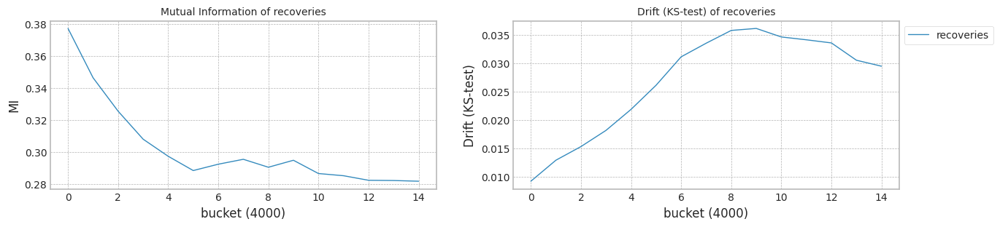

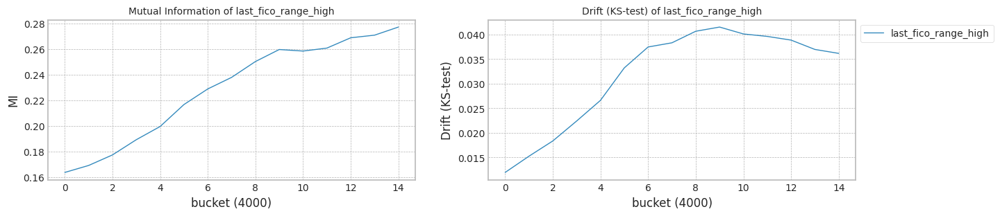

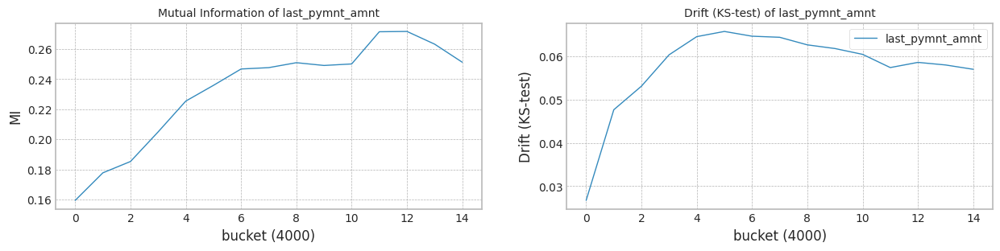

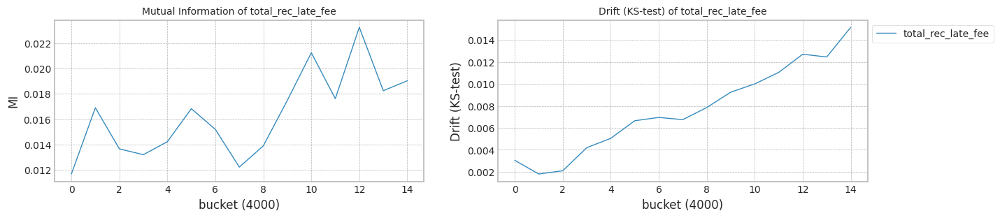

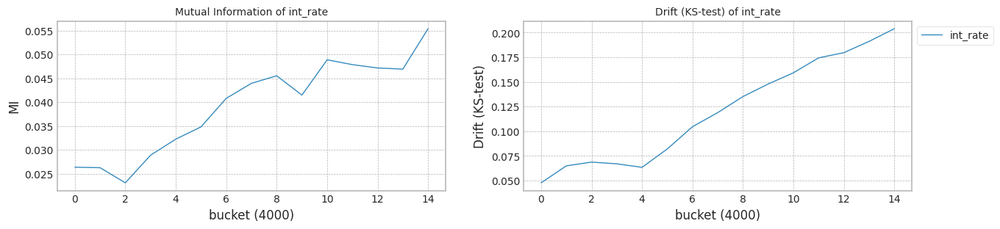

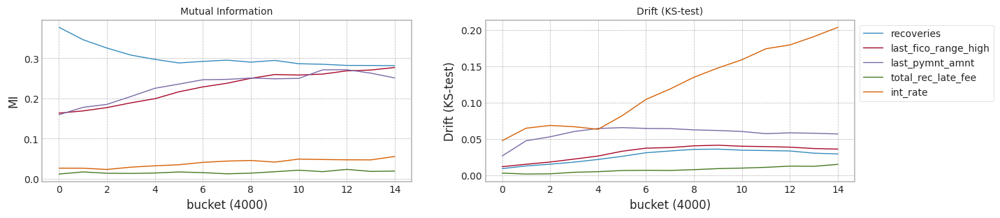

In [ ]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
top_columns = list(mi_scores[0:5].index)
#top_columns = ['int_rate', 'last_pymnt_amnt', 'fico_range_high', 'inq_last_6mths', 'total_rec_int'] #['recoveries', 'last_pymnt_amnt', 'total_rec_late_fee','total_rec_int','Y']  ## 'recoveries',
print('columns:',top_columns)
#print(s.shape)
X4 = X3[top_columns]

train_size = 10000*2
test_size = 2000*2

X1,Y1 = check_mi_drift(X4, Y3, train_size, test_size)

bucket_size = 500*2
X1['b'] = [int(b/bucket_size) for b in X1.index.values]

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,recoveries,last_fico_range_high,last_pymnt_amnt,total_rec_late_fee,int_rate,b
0,0.0,0.887059,0.000163,0.000000,0.170543,0
1,0.0,0.869412,0.000693,0.000000,0.411822,0
2,0.0,0.904706,0.023736,0.000000,0.344477,0
3,0.0,0.845882,0.005132,0.000000,0.411822,0
4,0.0,0.951765,0.007995,0.000000,0.153585,0
...,...,...,...,...,...,...
127963,0.0,0.622353,0.006972,0.000000,0.093508,127
127964,0.0,0.857647,0.747707,0.194747,1.227229,127
127965,0.0,0.875294,0.062245,0.000000,0.242248,127
127966,0.0,0.681176,0.017652,0.000000,0.395833,127


trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 10:08:33,263] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 2000/2000 [00:05<00:00, 348.40it/s]

Early stop: 1999
[2023-12-03 10:08:39,010] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89943074, 0.88250818]), array([0.29867675, 0.99370023]), array([0.44843898, 0.93480935]), array([ 3174, 16826]))
Test f1 score: 0.934809348093481
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.34it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9173319390967674
inference_flops: 226200000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:08:50,160] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:08:50,162] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:18<00:00, 105.38it/s]

[2023-12-03 10:09:22,463] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:09:22,465] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.99215505, 0.94257837]), array([0.6773787 , 0.99898966]), array([0.80509268, 0.96996451]), array([ 3174, 16826]))
Test f1 score: 0.9699645113823249
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.36it/s]

mean of drift:
recoveries              0.863871
last_fico_range_high    0.475187
last_pymnt_amnt         0.528398
total_rec_late_fee      0.965750
int_rate                0.130821
dtype: float64
Mean F1 for all data: 0.957741204656209
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.957741204656209
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 10:09:33,522] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 346.33it/s]

Early stop: 1999
[2023-12-03 10:09:39,303] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89495451, 0.88867011]), array([0.34089477, 0.99245216]), array([0.49372576, 0.93769829]), array([ 3174, 16826]))
Test f1 score: 0.9376982901423476
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.31it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9212417862658753
inference_flops: 226200000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:09:50,624] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:09:50,627] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:19<00:00, 104.36it/s]

[2023-12-03 10:10:23,244] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:10:23,245] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98900048, 0.93824334]), array([0.65154379, 0.99863307]), array([0.78556505, 0.96749676]), array([ 3174, 16826]))
Test f1 score: 0.9674967611918814
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.832729
last_fico_range_high    0.456425
last_pymnt_amnt         0.505794
total_rec_late_fee      0.965750
int_rate                0.109156
dtype: float64
Mean F1 for all data: 0.9510429341779746
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9543920694170918
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-12-03 10:10:34,154] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 340.67it/s]

Early stop: 1999
[2023-12-03 10:10:40,031] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89990467, 0.88232811]), array([0.29741651, 0.99375966]), array([0.44707554, 0.93473461]), array([ 3174, 16826]))
Test f1 score: 0.934734606031808
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.33it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9172405727818584
inference_flops: 226200000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:10:51,244] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:10:51,246] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:19<00:00, 102.00it/s]

[2023-12-03 10:11:24,417] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:11:24,419] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98214286, 0.94515766]), array([0.6931317 , 0.99762273]), array([0.81270779, 0.97068178]), array([ 3174, 16826]))
Test f1 score: 0.9706817787544093
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.30it/s]

mean of drift:
recoveries              0.869952
last_fico_range_high    0.462038
last_pymnt_amnt         0.529694
total_rec_late_fee      0.965750
int_rate                0.133481
dtype: float64
Mean F1 for all data: 0.9522551587041203
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-12-03 10:11:35,777] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:06<00:00, 331.66it/s]

Early stop: 1999
[2023-12-03 10:11:41,814] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90482399, 0.90328171]), array([0.43730309, 0.99132295]), array([0.58963466, 0.94525672]), array([ 3174, 16826]))
Test f1 score: 0.9452567154029242
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.34it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9332974273094798
inference_flops: 226200000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:11:52,999] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:11:53,002] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:19<00:00, 101.33it/s]

[2023-12-03 10:12:26,402] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:12:26,403] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.92627518, 0.94266146]), array([0.68084436, 0.98977772]), array([0.78481932, 0.9656452 ]), array([ 3174, 16826]))
Test f1 score: 0.9656452033745977
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.35it/s]

mean of drift:
recoveries              0.839398
last_fico_range_high    0.407798
last_pymnt_amnt         0.517254
total_rec_late_fee      0.965750
int_rate                0.127600
dtype: float64
Mean F1 for all data: 0.9441692001956904
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9516490464410474
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-12-03 10:12:37,535] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 345.65it/s]

Early stop: 1999
[2023-12-03 10:12:43,328] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90401567, 0.88139523]), array([0.29080025, 0.99417568]), array([0.44004768, 0.93439464]), array([ 3174, 16826]))
Test f1 score: 0.934394637620444
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.34it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9164770475937788
inference_flops: 226200000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:12:54,505] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:12:54,507] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:19<00:00, 104.68it/s]

[2023-12-03 10:13:27,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:13:27,037] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.95930736, 0.94584511]), array([0.69817265, 0.99441341]), array([0.80816922, 0.96952138]), array([ 3174, 16826]))
Test f1 score: 0.9695213813883415
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.37it/s]


mean of drift:
recoveries              0.871642
last_fico_range_high    0.360342
last_pymnt_amnt         0.510163
total_rec_late_fee      0.911712
int_rate                0.128648
dtype: float64
Mean F1 for all data: 0.9549246120285516
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.34it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:13:44,155] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:13:44,157] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:14:13,701] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:14:13,702] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:35<01:52,  9.36s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


100%|██████████| 26/26 [00:40<00:00,  1.57s/it]


Early stop at  [1999]
Train flops  [31480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9700241881612239
G_CDTL+AUE median: 0.9700241881612239
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.75s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.68it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9451148923286711
SEA median: 0.9451148923286711
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:14<00:35,  2.98s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9464873402738593
AUE median: 0.9464873402738593
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.37it/s]

Ensemble_DTEL train flops: 3128520000


 54%|█████▍    | 14/26 [00:14<00:35,  2.94s/it]

Ensemble_DTEL train flops: 3359940000


100%|██████████| 26/26 [00:19<00:00,  1.34it/s]


Early stop at  [1797, 1930]
Train flops  [3128520000, 3359940000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9481366252834901
DTEL median: 0.9481366252834901
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.35it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:15:19,743] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:15:19,745] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:15:25,108] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:15:25,109] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:11<00:24,  2.05s/it]

G-CDTL train flops: 476000000 3941000000 979620000 5396620000


100%|██████████| 26/26 [00:16<00:00,  1.55it/s]


Early stop at  [562]
Train flops  [5396620000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9695890622867345
G_CDTL+AUE median: 0.9698066252239792
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.79s/it]

Ensemble_SEA train flops: 3380820000


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  [1942]
Train flops  [3380820000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9473868750516511
SEA median: 0.9462508836901611
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:14<00:36,  3.07s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.948618925763152
AUE median: 0.9475531330185056
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.39it/s]

Ensemble_DTEL train flops: 3480000000


 54%|█████▍    | 14/26 [00:13<00:33,  2.81s/it]

Ensemble_DTEL train flops: 2771820000


100%|██████████| 26/26 [00:19<00:00,  1.36it/s]


Early stop at  [1999, 1592]
Train flops  [3480000000, 2771820000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9503949845812814
DTEL median: 0.9492658049323857
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.32it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:16:31,230] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:16:31,232] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:16:42,804] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:16:42,805] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:17<00:47,  3.93s/it]

G-CDTL train flops: 5971000000 4998000000 1242360000 12211360000


100%|██████████| 26/26 [00:22<00:00,  1.14it/s]


Early stop at  [713]
Train flops  [12211360000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9723429069162093
G_CDTL+AUE median: 0.9700241881612239
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.76s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9448819461568483
SEA median: 0.9451148923286711
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.77s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9465408258674738
AUE median: 0.9465408258674738
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.38it/s]

Ensemble_DTEL train flops: 3480000000


 54%|█████▍    | 14/26 [00:18<00:52,  4.35s/it]

Ensemble_DTEL train flops: 2846640000


100%|██████████| 26/26 [00:24<00:00,  1.08it/s]


Early stop at  [1999, 1635]
Train flops  [3480000000, 2846640000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9479919038286735
DTEL median: 0.9481366252834901
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.30it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:17:49,595] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:17:49,597] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:18:06,680] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:18:06,682] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:23<01:07,  5.59s/it]

G-CDTL train flops: 13622000000 4046000000 1005720000 18673720000


100%|██████████| 26/26 [00:28<00:00,  1.09s/it]


Early stop at  [577]
Train flops  [18673720000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9678509521183485
G_CDTL+AUE median: 0.9698066252239792
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.75s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9533366373372302
SEA median: 0.9462508836901611
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.77s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9550572621035779
AUE median: 0.9475798758153129
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.36it/s]

Ensemble_DTEL train flops: 3480000000


 54%|█████▍    | 14/26 [00:13<00:32,  2.70s/it]

Ensemble_DTEL train flops: 2397720000


100%|██████████| 26/26 [00:18<00:00,  1.40it/s]


Early stop at  [1999, 1377]
Train flops  [3480000000, 2397720000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9562683229318162
DTEL median: 0.9492658049323857
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.33it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:19:07,880] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:19:07,883] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:19:21,120] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:19:21,122] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:19<00:53,  4.43s/it]

G-CDTL train flops: 8253000000 4599000000 1143180000 13995180000


100%|██████████| 26/26 [00:24<00:00,  1.06it/s]


Early stop at  [656]
Train flops  [13995180000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9725696398040016
G_CDTL+AUE median: 0.9700241881612239
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:10<00:21,  1.78s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9445456483767865
SEA median: 0.9451148923286711
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:16<00:43,  3.63s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:21<00:00,  1.19it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9460475941688318
AUE median: 0.9465408258674738
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.30it/s]

Ensemble_DTEL train flops: 2710920000


 54%|█████▍    | 14/26 [00:13<00:32,  2.69s/it]

Ensemble_DTEL train flops: 3093720000


100%|██████████| 26/26 [00:18<00:00,  1.39it/s]


Early stop at  [1557, 1777]
Train flops  [2710920000, 3093720000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9480915205836665
DTEL median: 0.9481366252834901


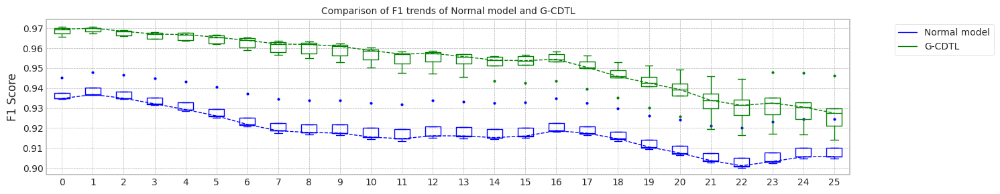

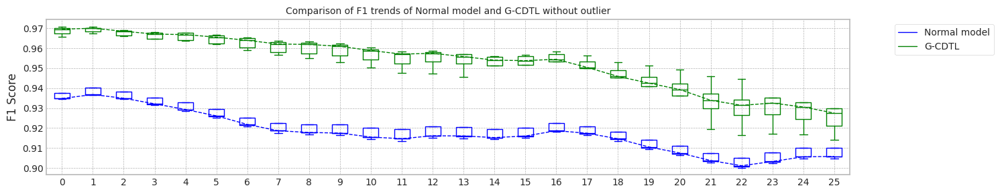

max_mean_trial= 0


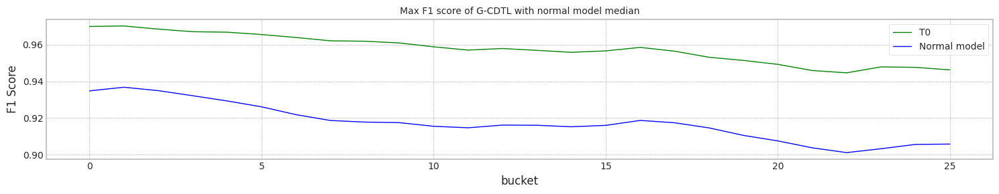

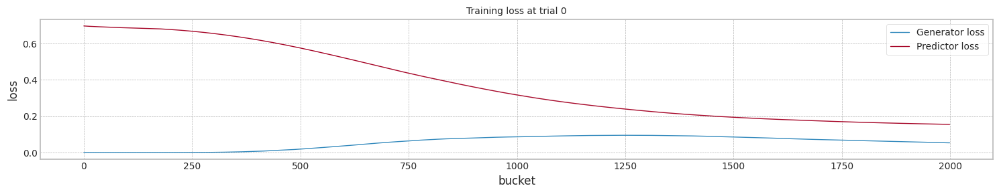

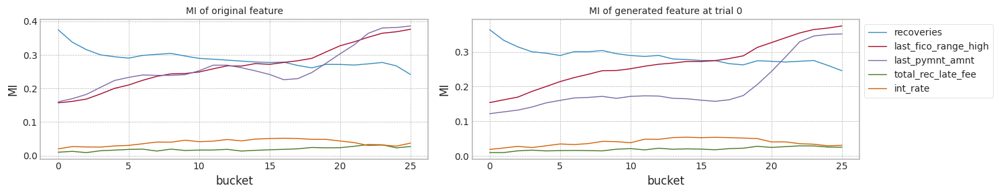

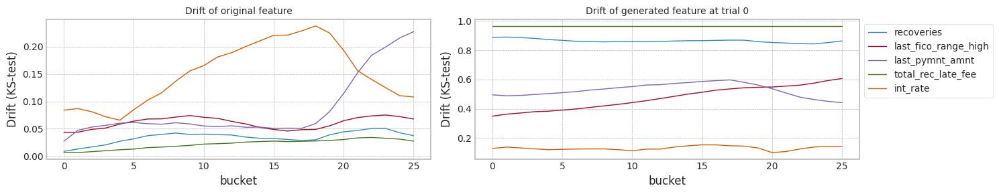

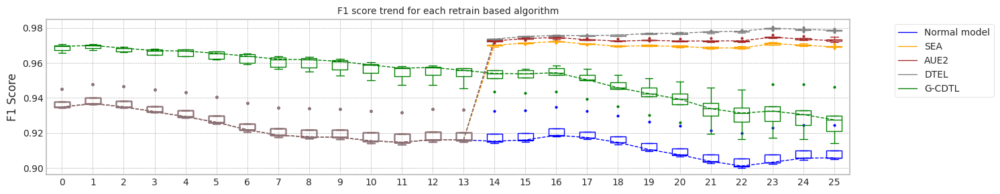

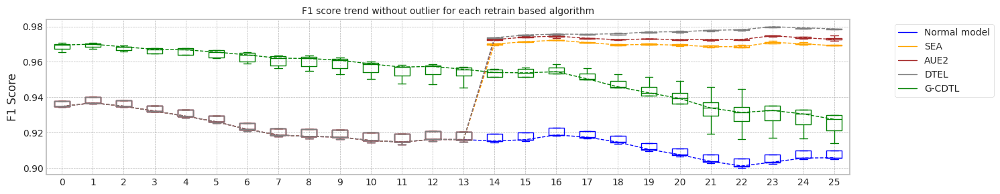

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.162230253219604
Base flops (inference flops of normal model, median): 226200000.0


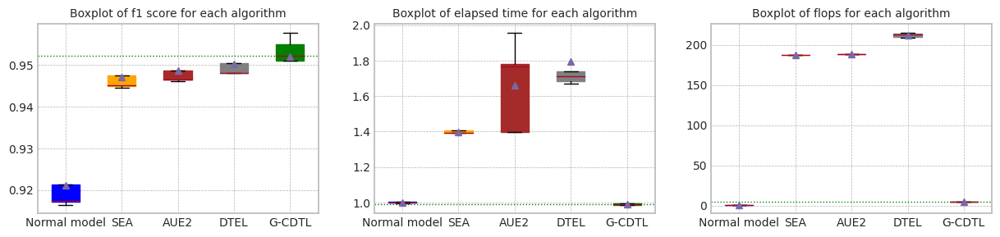

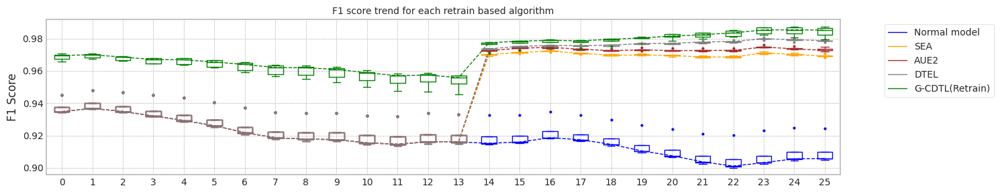

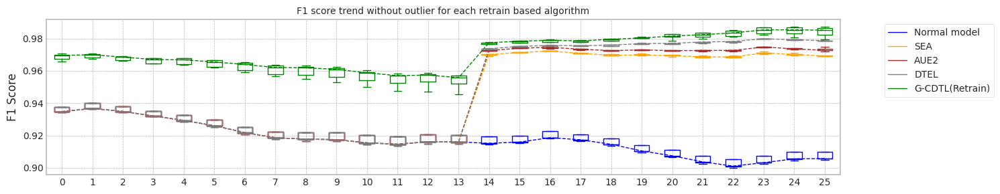

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.162230253219604
Base flops (train + inference flops of normal model, median): 17626200000.0


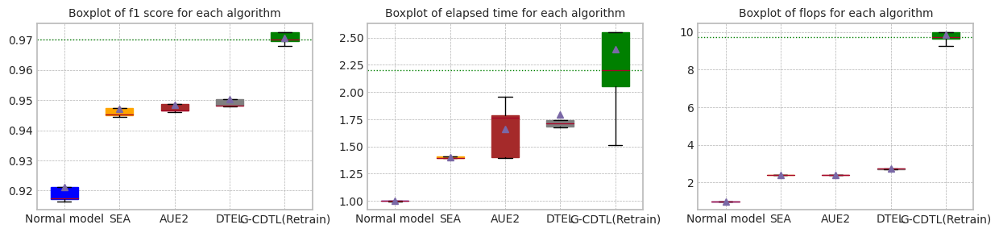

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.162230253219604


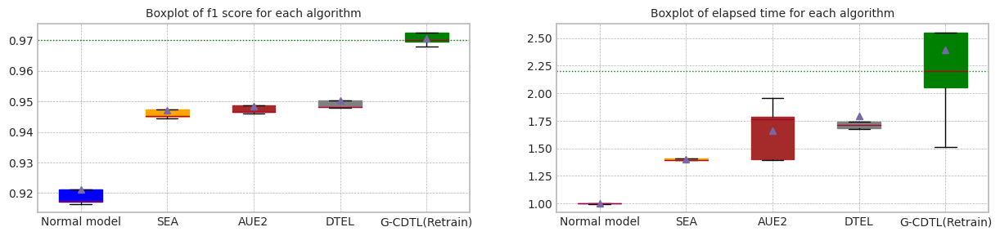

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.917332,0.905780,11.125378,1.740000e+10,226200000.0,1.762620e+10
1,1.0,0.937698,0.940101,0.921242,0.909930,11.297937,1.740000e+10,226200000.0,1.762620e+10
2,2.0,0.934735,0.936654,0.917241,0.905585,11.190939,1.740000e+10,226200000.0,1.762620e+10
3,3.0,0.945257,0.947906,0.933297,0.924414,11.162230,1.740000e+10,226200000.0,1.762620e+10
4,4.0,0.934395,0.936394,0.916477,0.904803,11.155185,1.740000e+10,226200000.0,1.762620e+10
5,median,0.934809,0.936785,0.917332,0.905780,11.162230,1.740000e+10,226200000.0,1.762620e+10
6,std,0.004601,0.004902,0.007058,0.008247,0.066602,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.957741,0.946251,11.034183,1.574000e+11,1.136200e+09,1.585362e+11
1,1.0,0.967497,0.968403,0.951043,0.927482,10.880001,1.574000e+11,1.136200e+09,1.585362e+11
2,2.0,0.970682,0.970795,0.952255,0.921099,11.326699,1.574000e+11,1.136200e+09,1.585362e+11
3,3.0,0.965645,0.967411,0.944169,0.914014,11.108236,1.574000e+11,1.136200e+09,1.585362e+11
4,4.0,0.969521,0.970020,0.954925,0.929771,11.026238,1.574000e+11,1.136200e+09,1.585362e+11
5,median,0.969521,0.970020,0.952255,0.927482,11.034183,1.574000e+11,1.136200e+09,1.585362e+11
6,std,0.002060,0.001409,0.005094,0.012035,0.163191,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.945115,0.969129,15.549399,2.088000e+10,2.144550e+10,4.232550e+10
1,1.0,0.937698,0.940101,0.947387,0.969562,15.719837,2.078082e+10,2.134632e+10,4.212714e+10
2,2.0,0.934735,0.936654,0.944882,0.969133,15.560307,2.088000e+10,2.144550e+10,4.232550e+10
3,3.0,0.945257,0.947906,0.953337,0.970685,15.564649,2.088000e+10,2.144550e+10,4.232550e+10
4,4.0,0.934395,0.936394,0.944546,0.968325,15.710462,2.088000e+10,2.144550e+10,4.232550e+10
5,median,0.934809,0.936785,0.945115,0.969133,15.564649,2.088000e+10,2.144550e+10,4.232550e+10
6,std,0.004601,0.004902,0.003686,0.000862,0.086253,4.435464e+07,4.435464e+07,8.870929e+07


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.946487,0.973613,19.714631,2.088000e+10,2.167170e+10,4.255170e+10
1,1.0,0.937698,0.940101,0.948619,0.972721,19.903574,2.088000e+10,2.167170e+10,4.255170e+10
2,2.0,0.934735,0.936654,0.946541,0.972659,15.617208,2.088000e+10,2.167170e+10,4.255170e+10
3,3.0,0.945257,0.947906,0.955057,0.974869,15.578570,2.088000e+10,2.167170e+10,4.255170e+10
4,4.0,0.934395,0.936394,0.946048,0.972049,21.856126,2.088000e+10,2.167170e+10,4.255170e+10
5,median,0.934809,0.936785,0.946541,0.972721,19.714631,2.088000e+10,2.167170e+10,4.255170e+10
6,std,0.004601,0.004902,0.003772,0.001095,2.808397,0.000000e+00,0.000000e+00,0.000000e+00


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.948137,0.978422,19.428567,2.388846e+10,2.480196e+10,4.869042e+10
1,1.0,0.937698,0.940101,0.950395,0.978751,19.119021,2.365182e+10,2.456532e+10,4.821714e+10
2,2.0,0.934735,0.936654,0.947992,0.977575,24.164656,2.372664e+10,2.464014e+10,4.836678e+10
3,3.0,0.945257,0.947906,0.956268,0.978655,18.660266,2.327772e+10,2.419122e+10,4.746894e+10
4,4.0,0.934395,0.936394,0.948092,0.979501,18.782873,2.320464e+10,2.411814e+10,4.732278e+10
5,median,0.934809,0.936785,0.948137,0.978655,19.119021,2.365182e+10,2.456532e+10,4.821714e+10
6,std,0.004601,0.004902,0.003551,0.000693,2.330154,2.956070e+08,2.956070e+08,5.912140e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.970024,0.982416,40.835278,1.888800e+11,238800000.0,1.891188e+11
1,1.0,0.967497,0.968403,0.969589,0.985182,16.846731,1.627966e+11,238800000.0,1.630354e+11
2,2.0,0.970682,0.970795,0.972343,0.986652,22.889637,1.696114e+11,238800000.0,1.698502e+11
3,3.0,0.965645,0.967411,0.967851,0.979245,28.486918,1.760737e+11,238800000.0,1.763125e+11
4,4.0,0.969521,0.970020,0.972570,0.987343,24.574425,1.713952e+11,238800000.0,1.716340e+11
5,median,0.969521,0.970020,0.970024,0.985182,24.574425,1.713952e+11,238800000.0,1.716340e+11
6,std,0.002060,0.001409,0.001984,0.003339,8.931957,9.707814e+09,0.0,9.707814e+09


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'LC_A',X1, Y1,train_size, test_size,avaible_range = 1000,
                                                            lambda_f2=0.8,trial_count=5,lr_g=0.0002,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 10:29:34,073] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 2000/2000 [00:06<00:00, 302.54it/s]

Early stop: 1999
[2023-12-03 10:29:40,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89943074, 0.88250818]), array([0.29867675, 0.99370023]), array([0.44843898, 0.93480935]), array([ 3174, 16826]))
Test f1 score: 0.934809348093481
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.39it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9173319390967674
inference_flops: 226200000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:29:51,636] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:29:51,638] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 163.14it/s]

[2023-12-03 10:30:12,182] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:30:12,183] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.99215505, 0.94257837]), array([0.6773787 , 0.99898966]), array([0.80509268, 0.96996451]), array([ 3174, 16826]))
Test f1 score: 0.9699645113823249
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.43it/s]

mean of drift:
recoveries              0.863871
last_fico_range_high    0.475187
last_pymnt_amnt         0.528398
total_rec_late_fee      0.965750
int_rate                0.130821
dtype: float64
Mean F1 for all data: 0.957741204656209
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.957741204656209
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 10:30:22,939] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:03<00:00, 503.50it/s]

Early stop: 1999
[2023-12-03 10:30:26,918] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89495451, 0.88867011]), array([0.34089477, 0.99245216]), array([0.49372576, 0.93769829]), array([ 3174, 16826]))
Test f1 score: 0.9376982901423476
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.42it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9212417862658753
inference_flops: 226200000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:30:37,721] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:30:37,723] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 158.23it/s]

[2023-12-03 10:30:58,731] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:30:58,732] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98900048, 0.93824334]), array([0.65154379, 0.99863307]), array([0.78556505, 0.96749676]), array([ 3174, 16826]))
Test f1 score: 0.9674967611918814
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.832729
last_fico_range_high    0.456425
last_pymnt_amnt         0.505794
total_rec_late_fee      0.965750
int_rate                0.109156
dtype: float64
Mean F1 for all data: 0.9510429341779746
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9543920694170918
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-12-03 10:31:09,332] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 498.29it/s]

Early stop: 1999
[2023-12-03 10:31:13,353] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89990467, 0.88232811]), array([0.29741651, 0.99375966]), array([0.44707554, 0.93473461]), array([ 3174, 16826]))
Test f1 score: 0.934734606031808
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.38it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9172405727818584
inference_flops: 226200000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:31:24,311] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:31:24,313] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 159.34it/s]

[2023-12-03 10:31:45,229] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:31:45,230] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98214286, 0.94515766]), array([0.6931317 , 0.99762273]), array([0.81270779, 0.97068178]), array([ 3174, 16826]))
Test f1 score: 0.9706817787544093
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.869952
last_fico_range_high    0.462038
last_pymnt_amnt         0.529694
total_rec_late_fee      0.965750
int_rate                0.133481
dtype: float64
Mean F1 for all data: 0.9522551587041203
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-12-03 10:31:55,825] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:03<00:00, 500.95it/s]

Early stop: 1999
[2023-12-03 10:31:59,823] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90482399, 0.90328171]), array([0.43730309, 0.99132295]), array([0.58963466, 0.94525672]), array([ 3174, 16826]))
Test f1 score: 0.9452567154029242
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9332974273094798
inference_flops: 226200000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:32:10,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:32:10,731] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 156.85it/s]

[2023-12-03 10:32:32,044] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:32:32,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.92627518, 0.94266146]), array([0.68084436, 0.98977772]), array([0.78481932, 0.9656452 ]), array([ 3174, 16826]))
Test f1 score: 0.9656452033745977
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.839398
last_fico_range_high    0.407798
last_pymnt_amnt         0.517254
total_rec_late_fee      0.965750
int_rate                0.127600
dtype: float64
Mean F1 for all data: 0.9441692001956904
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9516490464410474
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-12-03 10:32:42,632] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 490.74it/s]

Early stop: 1999
[2023-12-03 10:32:46,713] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90401567, 0.88139523]), array([0.29080025, 0.99417568]), array([0.44004768, 0.93439464]), array([ 3174, 16826]))
Test f1 score: 0.934394637620444
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.38it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9164770475937788
inference_flops: 226200000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:32:57,695] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:32:57,698] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:12<00:00, 158.22it/s]

[2023-12-03 10:33:18,807] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:33:18,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.95930736, 0.94584511]), array([0.69817265, 0.99441341]), array([0.80816922, 0.96952138]), array([ 3174, 16826]))
Test f1 score: 0.9695213813883415
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.44it/s]


mean of drift:
recoveries              0.871642
last_fico_range_high    0.360342
last_pymnt_amnt         0.510163
total_rec_late_fee      0.911712
int_rate                0.128648
dtype: float64
Mean F1 for all data: 0.9549246120285516
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.34it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:33:35,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:33:35,526] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:33:54,587] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:33:54,589] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:25<01:14,  6.19s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


100%|██████████| 26/26 [00:30<00:00,  1.16s/it]


Early stop at  [1999]
Train flops  [31480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9700241881612239
G_CDTL+AUE median: 0.9700241881612239
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:15,  1.25s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.91it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9451148923286711
SEA median: 0.9451148923286711
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.22s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.93it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9464873402738593
AUE median: 0.9464873402738593
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.46it/s]

Ensemble_DTEL train flops: 3128520000


 54%|█████▍    | 14/26 [00:10<00:22,  1.91s/it]

Ensemble_DTEL train flops: 3359940000


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  [1797, 1930]
Train flops  [3128520000, 3359940000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9481366252834901
DTEL median: 0.9481366252834901
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.40it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:34:48,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:34:48,580] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:34:52,024] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:34:52,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:09<00:17,  1.46s/it]

G-CDTL train flops: 476000000 3941000000 979620000 5396620000


100%|██████████| 26/26 [00:14<00:00,  1.80it/s]


Early stop at  [562]
Train flops  [5396620000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9695890622867345
G_CDTL+AUE median: 0.9698066252239792
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.19s/it]

Ensemble_SEA train flops: 3380820000


100%|██████████| 26/26 [00:13<00:00,  1.95it/s]


Early stop at  [1942]
Train flops  [3380820000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9473868750516511
SEA median: 0.9462508836901611
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.21s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.93it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.948618925763152
AUE median: 0.9475531330185056
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.45it/s]

Ensemble_DTEL train flops: 3480000000


 54%|█████▍    | 14/26 [00:10<00:22,  1.89s/it]

Ensemble_DTEL train flops: 2771820000


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  [1999, 1592]
Train flops  [3480000000, 2771820000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9503949845812814
DTEL median: 0.9492658049323857
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.44it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:35:45,721] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:35:45,723] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:35:53,116] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:35:53,117] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:13<00:31,  2.65s/it]

G-CDTL train flops: 5971000000 4998000000 1242360000 12211360000


100%|██████████| 26/26 [00:18<00:00,  1.42it/s]


Early stop at  [713]
Train flops  [12211360000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9723429069162093
G_CDTL+AUE median: 0.9700241881612239
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.23s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.93it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9448819461568483
SEA median: 0.9451148923286711
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.22s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.92it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9465408258674738
AUE median: 0.9465408258674738
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.40it/s]

Ensemble_DTEL train flops: 3480000000


 54%|█████▍    | 14/26 [00:10<00:22,  1.91s/it]

Ensemble_DTEL train flops: 2846640000


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  [1999, 1635]
Train flops  [3480000000, 2846640000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9479919038286735
DTEL median: 0.9481366252834901
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.45it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:36:46,926] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:36:46,928] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:36:57,943] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:36:57,946] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:16<00:44,  3.74s/it]

G-CDTL train flops: 13622000000 4046000000 1005720000 18673720000


100%|██████████| 26/26 [00:21<00:00,  1.19it/s]


Early stop at  [577]
Train flops  [18673720000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9678509521183485
G_CDTL+AUE median: 0.9698066252239792
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:15,  1.25s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.93it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9533366373372302
SEA median: 0.9462508836901611
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:15,  1.26s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.90it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9550572621035779
AUE median: 0.9475798758153129
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.39it/s]

Ensemble_DTEL train flops: 3480000000


 54%|█████▍    | 14/26 [00:10<00:21,  1.82s/it]

Ensemble_DTEL train flops: 2397720000


100%|██████████| 26/26 [00:15<00:00,  1.68it/s]


Early stop at  [1999, 1377]
Train flops  [3480000000, 2397720000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9562683229318162
DTEL median: 0.9492658049323857
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.42it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:37:51,611] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:37:51,614] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:38:00,230] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:38:00,232] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:14<00:36,  3.02s/it]

G-CDTL train flops: 8253000000 4599000000 1143180000 13995180000


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  [656]
Train flops  [13995180000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9725696398040016
G_CDTL+AUE median: 0.9700241881612239
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.24s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.93it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9445456483767865
SEA median: 0.9451148923286711
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.24s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:13<00:00,  1.90it/s]


Early stop at  [1999]
Train flops  [3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9460475941688318
AUE median: 0.9465408258674738
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:05,  2.45it/s]

Ensemble_DTEL train flops: 2710920000


 54%|█████▍    | 14/26 [00:10<00:22,  1.86s/it]

Ensemble_DTEL train flops: 3093720000


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  [1557, 1777]
Train flops  [2710920000, 3093720000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9480915205836665
DTEL median: 0.9481366252834901


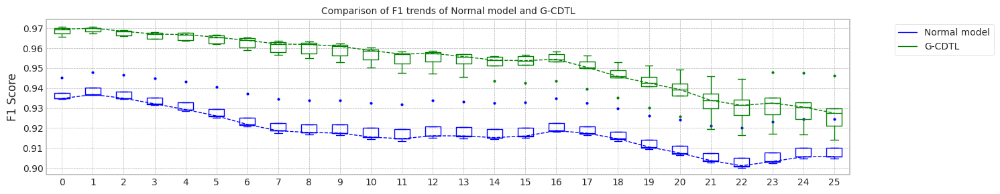

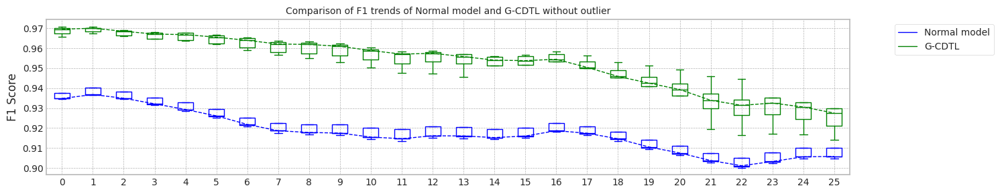

max_mean_trial= 0


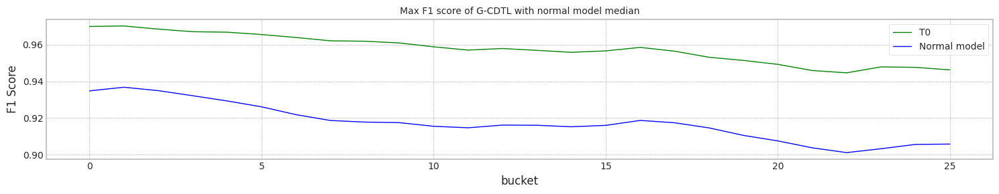

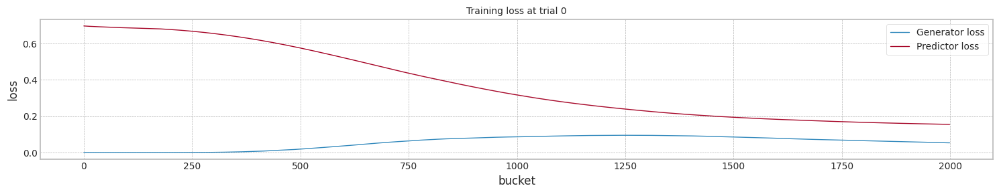

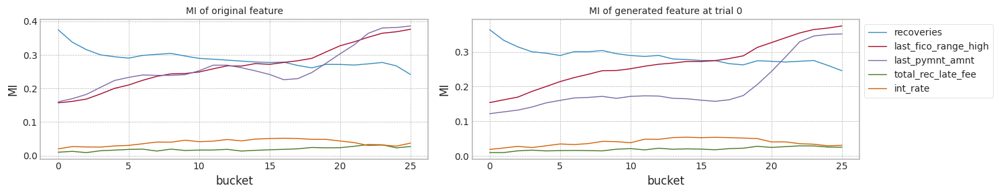

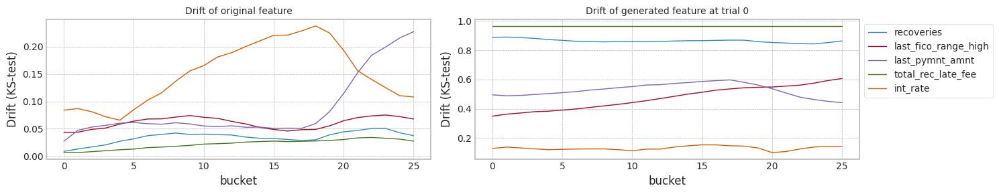

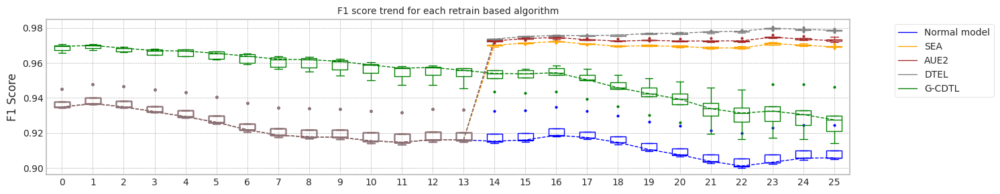

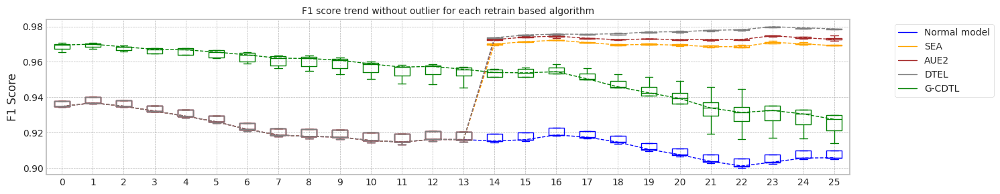

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.926462650299072
Base flops (inference flops of normal model, median): 226200000.0


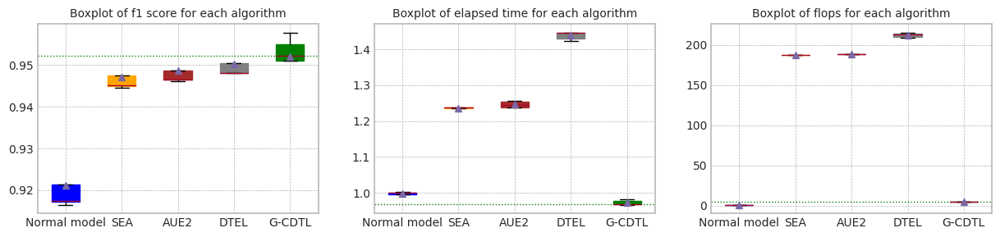

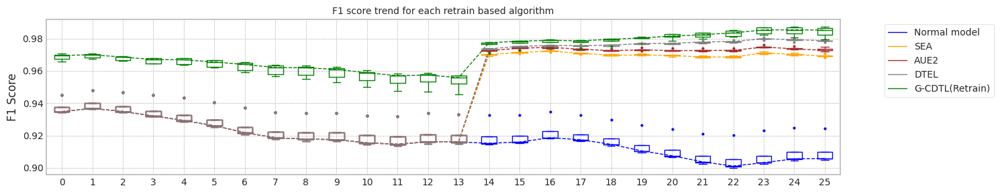

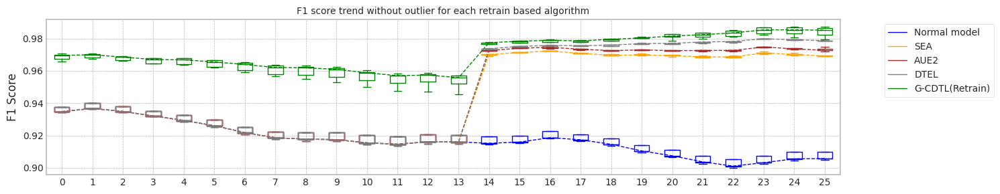

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.926462650299072
Base flops (train + inference flops of normal model, median): 17626200000.0


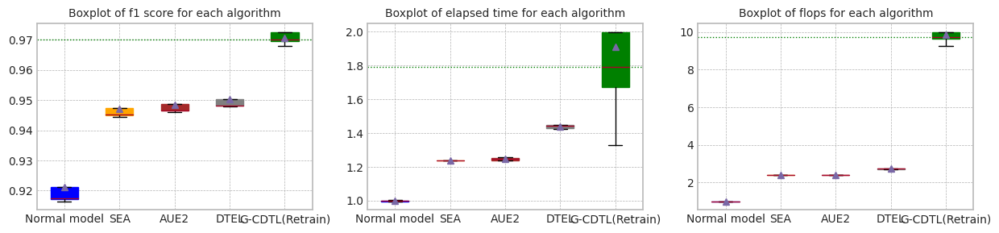

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.926462650299072


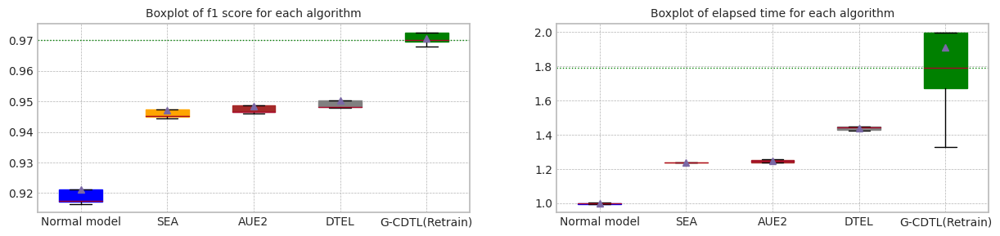

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.917332,0.905780,10.926463,1.740000e+10,226200000.0,1.762620e+10
1,1.0,0.937698,0.940101,0.921242,0.909930,10.782986,1.740000e+10,226200000.0,1.762620e+10
2,2.0,0.934735,0.936654,0.917241,0.905585,10.939417,1.740000e+10,226200000.0,1.762620e+10
3,3.0,0.945257,0.947906,0.933297,0.924414,10.882262,1.740000e+10,226200000.0,1.762620e+10
4,4.0,0.934395,0.936394,0.916477,0.904803,10.960814,1.740000e+10,226200000.0,1.762620e+10
5,median,0.934809,0.936785,0.917332,0.905780,10.926463,1.740000e+10,226200000.0,1.762620e+10
6,std,0.004601,0.004902,0.007058,0.008247,0.070616,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.957741,0.946251,10.734938,1.574000e+11,1.136200e+09,1.585362e+11
1,1.0,0.967497,0.968403,0.951043,0.927482,10.577574,1.574000e+11,1.136200e+09,1.585362e+11
2,2.0,0.970682,0.970795,0.952255,0.921099,10.572041,1.574000e+11,1.136200e+09,1.585362e+11
3,3.0,0.965645,0.967411,0.944169,0.914014,10.564503,1.574000e+11,1.136200e+09,1.585362e+11
4,4.0,0.969521,0.970020,0.954925,0.929771,10.690175,1.574000e+11,1.136200e+09,1.585362e+11
5,median,0.969521,0.970020,0.952255,0.927482,10.577574,1.574000e+11,1.136200e+09,1.585362e+11
6,std,0.002060,0.001409,0.005094,0.012035,0.079069,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.945115,0.969129,13.625497,2.088000e+10,2.144550e+10,4.232550e+10
1,1.0,0.937698,0.940101,0.947387,0.969562,13.367696,2.078082e+10,2.134632e+10,4.212714e+10
2,2.0,0.934735,0.936654,0.944882,0.969133,13.502623,2.088000e+10,2.144550e+10,4.232550e+10
3,3.0,0.945257,0.947906,0.953337,0.970685,13.518981,2.088000e+10,2.144550e+10,4.232550e+10
4,4.0,0.934395,0.936394,0.944546,0.968325,13.535015,2.088000e+10,2.144550e+10,4.232550e+10
5,median,0.934809,0.936785,0.945115,0.969133,13.518981,2.088000e+10,2.144550e+10,4.232550e+10
6,std,0.004601,0.004902,0.003686,0.000862,0.092670,4.435464e+07,4.435464e+07,8.870929e+07


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.946487,0.973613,13.522781,2.088000e+10,2.167170e+10,4.255170e+10
1,1.0,0.937698,0.940101,0.948619,0.972721,13.524339,2.088000e+10,2.167170e+10,4.255170e+10
2,2.0,0.934735,0.936654,0.946541,0.972659,13.605494,2.088000e+10,2.167170e+10,4.255170e+10
3,3.0,0.945257,0.947906,0.955057,0.974869,13.698020,2.088000e+10,2.167170e+10,4.255170e+10
4,4.0,0.934395,0.936394,0.946048,0.972049,13.713697,2.088000e+10,2.167170e+10,4.255170e+10
5,median,0.934809,0.936785,0.946541,0.972721,13.605494,2.088000e+10,2.167170e+10,4.255170e+10
6,std,0.004601,0.004902,0.003772,0.001095,0.091412,0.000000e+00,0.000000e+00,0.000000e+00


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.948137,0.978422,15.793222,2.388846e+10,2.480196e+10,4.869042e+10
1,1.0,0.937698,0.940101,0.950395,0.978751,15.801921,2.365182e+10,2.456532e+10,4.821714e+10
2,2.0,0.934735,0.936654,0.947992,0.977575,15.797750,2.372664e+10,2.464014e+10,4.836678e+10
3,3.0,0.945257,0.947906,0.956268,0.978655,15.536933,2.327772e+10,2.419122e+10,4.746894e+10
4,4.0,0.934395,0.936394,0.948092,0.979501,15.629559,2.320464e+10,2.411814e+10,4.732278e+10
5,median,0.934809,0.936785,0.948137,0.978655,15.793222,2.365182e+10,2.456532e+10,4.821714e+10
6,std,0.004601,0.004902,0.003551,0.000693,0.121944,2.956070e+08,2.956070e+08,5.912140e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.970024,0.982416,30.275686,1.888800e+11,238800000.0,1.891188e+11
1,1.0,0.967497,0.968403,0.969589,0.985182,14.504812,1.627966e+11,238800000.0,1.630354e+11
2,2.0,0.970682,0.970795,0.972343,0.986652,18.281135,1.696114e+11,238800000.0,1.698502e+11
3,3.0,0.965645,0.967411,0.967851,0.979245,21.837378,1.760737e+11,238800000.0,1.763125e+11
4,4.0,0.969521,0.970020,0.972570,0.987343,19.586962,1.713952e+11,238800000.0,1.716340e+11
5,median,0.969521,0.970020,0.970024,0.985182,19.586962,1.713952e+11,238800000.0,1.716340e+11
6,std,0.002060,0.001409,0.001984,0.003339,5.879266,9.707814e+09,0.0,9.707814e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 10:38:59,498] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 2000/2000 [00:04<00:00, 477.30it/s]

Early stop: 1999
[2023-12-03 10:39:03,694] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89943074, 0.88250818]), array([0.29867675, 0.99370023]), array([0.44843898, 0.93480935]), array([ 3174, 16826]))
Test f1 score: 0.934809348093481
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9173319390967674
inference_flops: 226200000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:39:14,588] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:39:14,591] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 147.61it/s]

[2023-12-03 10:39:37,130] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:39:37,131] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.99215505, 0.94257837]), array([0.6773787 , 0.99898966]), array([0.80509268, 0.96996451]), array([ 3174, 16826]))
Test f1 score: 0.9699645113823249
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.863871
last_fico_range_high    0.475187
last_pymnt_amnt         0.528398
total_rec_late_fee      0.965750
int_rate                0.130821
dtype: float64
Mean F1 for all data: 0.957741204656209
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.957741204656209
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 10:39:47,696] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 464.79it/s]

Early stop: 1999
[2023-12-03 10:39:52,005] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89495451, 0.88867011]), array([0.34089477, 0.99245216]), array([0.49372576, 0.93769829]), array([ 3174, 16826]))
Test f1 score: 0.9376982901423476
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9212417862658753
inference_flops: 226200000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:40:02,883] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:40:02,885] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 147.43it/s]

[2023-12-03 10:40:25,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:40:25,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98900048, 0.93824334]), array([0.65154379, 0.99863307]), array([0.78556505, 0.96749676]), array([ 3174, 16826]))
Test f1 score: 0.9674967611918814
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.44it/s]

mean of drift:
recoveries              0.832729
last_fico_range_high    0.456425
last_pymnt_amnt         0.505794
total_rec_late_fee      0.965750
int_rate                0.109156
dtype: float64
Mean F1 for all data: 0.9510429341779746
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9543920694170918
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-12-03 10:40:36,197] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 469.58it/s]

Early stop: 1999
[2023-12-03 10:40:40,463] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89990467, 0.88232811]), array([0.29741651, 0.99375966]), array([0.44707554, 0.93473461]), array([ 3174, 16826]))
Test f1 score: 0.934734606031808
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.42it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9172405727818584
inference_flops: 226200000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:40:51,268] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:40:51,271] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 148.06it/s]

[2023-12-03 10:41:13,746] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:41:13,747] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98214286, 0.94515766]), array([0.6931317 , 0.99762273]), array([0.81270779, 0.97068178]), array([ 3174, 16826]))
Test f1 score: 0.9706817787544093
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.869952
last_fico_range_high    0.462038
last_pymnt_amnt         0.529694
total_rec_late_fee      0.965750
int_rate                0.133481
dtype: float64
Mean F1 for all data: 0.9522551587041203
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-12-03 10:41:24,334] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 473.43it/s]

Early stop: 1999
[2023-12-03 10:41:28,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90482399, 0.90328171]), array([0.43730309, 0.99132295]), array([0.58963466, 0.94525672]), array([ 3174, 16826]))
Test f1 score: 0.9452567154029242
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.31it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9332974273094798
inference_flops: 226200000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:41:39,875] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:41:39,878] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 143.75it/s]

[2023-12-03 10:42:02,850] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:42:02,853] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.92627518, 0.94266146]), array([0.68084436, 0.98977772]), array([0.78481932, 0.9656452 ]), array([ 3174, 16826]))
Test f1 score: 0.9656452033745977
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.839398
last_fico_range_high    0.407798
last_pymnt_amnt         0.517254
total_rec_late_fee      0.965750
int_rate                0.127600
dtype: float64
Mean F1 for all data: 0.9441692001956904
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9516490464410474
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-12-03 10:42:13,431] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 469.29it/s]

Early stop: 1999
[2023-12-03 10:42:17,700] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90401567, 0.88139523]), array([0.29080025, 0.99417568]), array([0.44004768, 0.93439464]), array([ 3174, 16826]))
Test f1 score: 0.934394637620444
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.43it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9164770475937788
inference_flops: 226200000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:42:28,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:42:28,447] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:13<00:00, 147.92it/s]

[2023-12-03 10:42:51,134] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:42:51,135] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.95930736, 0.94584511]), array([0.69817265, 0.99441341]), array([0.80816922, 0.96952138]), array([ 3174, 16826]))
Test f1 score: 0.9695213813883415
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.46it/s]


mean of drift:
recoveries              0.871642
last_fico_range_high    0.360342
last_pymnt_amnt         0.510163
total_rec_late_fee      0.911712
int_rate                0.128648
dtype: float64
Mean F1 for all data: 0.9549246120285516
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.44it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:43:05,529] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:43:05,532] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:43:25,739] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:43:25,740] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▍      | 9/26 [00:23<01:54,  6.73s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 65%|██████▌   | 17/26 [00:27<00:06,  1.32it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:43:29,437] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:43:29,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:43:49,589] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:43:49,590] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:47<00:53,  6.71s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


100%|██████████| 26/26 [00:51<00:00,  1.97s/it]


Early stop at  [1999, 1999]
Train flops  [31480000000, 31480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9723947021684675
G_CDTL+AUE median: 0.9723947021684675
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:21,  1.26s/it]

Ensemble_SEA train flops: 3384300000


 69%|██████▉   | 18/26 [00:12<00:10,  1.26s/it]

Ensemble_SEA train flops: 3272940000


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  [1944, 1880]
Train flops  [3384300000, 3272940000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9565336337700762
SEA median: 0.9565336337700762
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:19,  1.12s/it]

Ensemble_SEA train flops: 2787480000


 69%|██████▉   | 18/26 [00:11<00:08,  1.11s/it]

Ensemble_SEA train flops: 2606520000


100%|██████████| 26/26 [00:15<00:00,  1.68it/s]


Early stop at  [1601, 1497]
Train flops  [2787480000, 2606520000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9581794916165969
AUE median: 0.9581794916165969
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.43it/s]

Ensemble_DTEL train flops: 3429540000


 35%|███▍      | 9/26 [00:08<00:34,  2.01s/it]

Ensemble_DTEL train flops: 2705700000


 69%|██████▉   | 18/26 [00:15<00:10,  1.33s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


100%|██████████| 26/26 [00:18<00:00,  1.38it/s]


Early stop at  [1970, 1554, 1999, 1]
Train flops  [3429540000, 2705700000, 3480000000, 3480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9584339431380523
DTEL median: 0.9584339431380523
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.41it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:44:47,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:44:47,343] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:44:50,687] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:44:50,689] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▍      | 9/26 [00:07<00:24,  1.46s/it]

G-CDTL train flops: 224000000 3437000000 854340000 4515340000


 65%|██████▌   | 17/26 [00:10<00:04,  2.09it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:44:54,520] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:44:54,523] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:45:03,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:45:03,371] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:19<00:24,  3.12s/it]

G-CDTL train flops: 5880000000 6244000000 1552080000 13676080000


100%|██████████| 26/26 [00:23<00:00,  1.12it/s]


Early stop at  [490, 891]
Train flops  [4515340000, 13676080000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9724655465346786
G_CDTL+AUE median: 0.972430124351573
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:22,  1.33s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:13<00:10,  1.32s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:16<00:00,  1.56it/s]


Early stop at  [1999, 1999]
Train flops  [3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9574791524938744
SEA median: 0.9570063931319752
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:22,  1.32s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:13<00:10,  1.33s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:16<00:00,  1.56it/s]


Early stop at  [1999, 1999]
Train flops  [3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9591021387117935
AUE median: 0.9586408151641952
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.41it/s]

Ensemble_DTEL train flops: 3222480000


 35%|███▍      | 9/26 [00:08<00:30,  1.81s/it]

Ensemble_DTEL train flops: 2211540000


 69%|██████▉   | 18/26 [00:14<00:10,  1.33s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


100%|██████████| 26/26 [00:18<00:00,  1.43it/s]


Early stop at  [1851, 1270, 1999, 1]
Train flops  [3222480000, 2211540000, 3480000000, 3480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9599239759414557
DTEL median: 0.959178959539754
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.41it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:46:02,311] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:46:02,313] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:46:07,145] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:46:07,147] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▍      | 9/26 [00:08<00:32,  1.93s/it]

G-CDTL train flops: 2107000000 4046000000 1005720000 7158720000


 65%|██████▌   | 17/26 [00:11<00:04,  2.01it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:46:10,882] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:46:10,884] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:46:16,235] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:46:16,236] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:17<00:16,  2.08s/it]

G-CDTL train flops: 4053000000 3290000000 817800000 8160800000


100%|██████████| 26/26 [00:21<00:00,  1.23it/s]


Early stop at  [577, 469]
Train flops  [7158720000, 8160800000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.974821633213799
G_CDTL+AUE median: 0.9724655465346786
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:22,  1.31s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:12<00:09,  1.19s/it]

Ensemble_SEA train flops: 2947560000


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  [1999, 1693]
Train flops  [3480000000, 2947560000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9555097083450483
SEA median: 0.9565336337700762
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:19,  1.16s/it]

Ensemble_SEA train flops: 2881440000


 69%|██████▉   | 18/26 [00:12<00:10,  1.30s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  [1655, 1999]
Train flops  [2881440000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9582861872663979
AUE median: 0.9582861872663979
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.43it/s]

Ensemble_DTEL train flops: 2326380000


 35%|███▍      | 9/26 [00:07<00:26,  1.54s/it]

Ensemble_DTEL train flops: 1966200000


 69%|██████▉   | 18/26 [00:13<00:10,  1.30s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


100%|██████████| 26/26 [00:17<00:00,  1.50it/s]


Early stop at  [1336, 1129, 1999, 1]
Train flops  [2326380000, 1966200000, 3480000000, 3480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9584248243133258
DTEL median: 0.9584339431380523
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.39it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:47:12,950] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:47:12,953] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:47:18,353] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:47:18,355] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▍      | 9/26 [00:09<00:35,  2.11s/it]

G-CDTL train flops: 2849000000 4116000000 1023120000 7988120000


 65%|██████▌   | 17/26 [00:12<00:04,  1.96it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:47:22,094] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:47:22,097] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:47:24,968] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:47:24,969] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:15<00:10,  1.35s/it]

G-CDTL train flops: 455000000 2870000000 713400000 4038400000


100%|██████████| 26/26 [00:19<00:00,  1.36it/s]


Early stop at  [587, 409]
Train flops  [7988120000, 4038400000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.973083543529498
G_CDTL+AUE median: 0.9727745450320884
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:22,  1.30s/it]

Ensemble_SEA train flops: 3399960000


 69%|██████▉   | 18/26 [00:13<00:10,  1.34s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:16<00:00,  1.57it/s]


Early stop at  [1953, 1999]
Train flops  [3399960000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9616396055537154
SEA median: 0.9570063931319752
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:22,  1.34s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:13<00:10,  1.31s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:16<00:00,  1.57it/s]


Early stop at  [1999, 1999]
Train flops  [3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9633950661828045
AUE median: 0.9586941629890957
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.41it/s]

Ensemble_DTEL train flops: 3480000000


 35%|███▍      | 9/26 [00:08<00:31,  1.84s/it]

Ensemble_DTEL train flops: 1980120000


 69%|██████▉   | 18/26 [00:13<00:08,  1.04s/it]

Ensemble_DTEL train flops: 2239380000
Ensemble_DTEL train flops: 3480000


100%|██████████| 26/26 [00:17<00:00,  1.50it/s]


Early stop at  [1999, 1137, 1286, 1]
Train flops  [3480000000, 1980120000, 2239380000, 3480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9634689576801609
DTEL median: 0.959178959539754
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.31it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:48:22,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:48:22,734] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:48:27,419] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:48:27,420] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▍      | 9/26 [00:08<00:32,  1.90s/it]

G-CDTL train flops: 2205000000 3682000000 915240000 6802240000


 65%|██████▌   | 17/26 [00:11<00:04,  1.95it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:48:31,301] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:48:31,304] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:48:34,769] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:48:34,771] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:15<00:12,  1.54s/it]

G-CDTL train flops: 448000000 3486000000 866520000 4800520000


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  [525, 497]
Train flops  [6802240000, 4800520000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.973065591963568
G_CDTL+AUE median: 0.973065591963568
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:06<00:22,  1.34s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:13<00:10,  1.34s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:16<00:00,  1.56it/s]


Early stop at  [1999, 1999]
Train flops  [3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9558230612232835
SEA median: 0.9565336337700762
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 35%|███▍      | 9/26 [00:05<00:14,  1.19it/s]

Ensemble_SEA train flops: 1534680000


 69%|██████▉   | 18/26 [00:11<00:10,  1.30s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:15<00:00,  1.73it/s]


Early stop at  [881, 1999]
Train flops  [1534680000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9577826759543979
AUE median: 0.9582861872663979
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 31%|███       | 8/26 [00:03<00:07,  2.40it/s]

Ensemble_DTEL train flops: 3476520000


 35%|███▍      | 9/26 [00:08<00:32,  1.93s/it]

Ensemble_DTEL train flops: 2469060000


 69%|██████▉   | 18/26 [00:15<00:10,  1.37s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


100%|██████████| 26/26 [00:18<00:00,  1.39it/s]


Early stop at  [1997, 1418, 1999, 1]
Train flops  [3476520000, 2469060000, 3480000000, 3480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9582001710374028
DTEL median: 0.9584339431380523


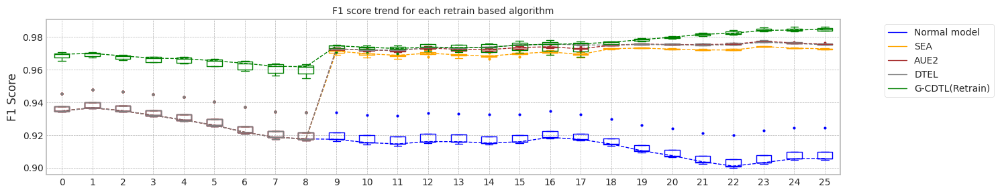

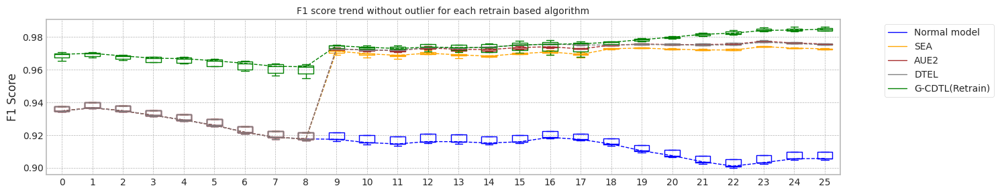

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.855308532714844
Base flops (train + inference flops of normal model, median): 17626200000.0


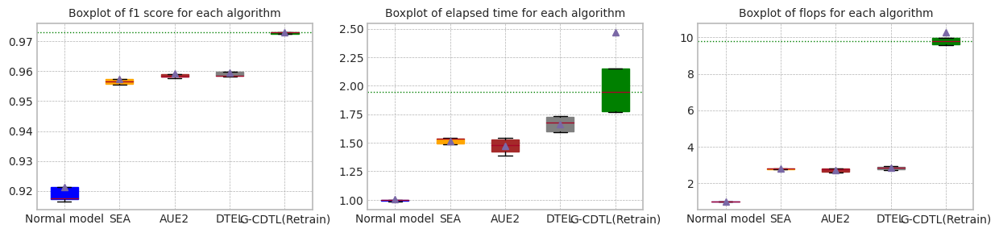

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.855308532714844


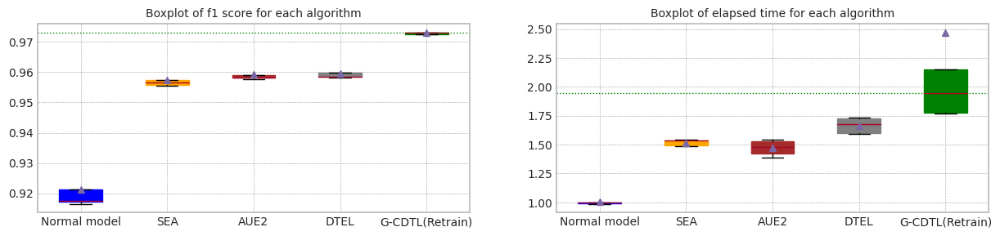

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.917332,0.905780,10.872394,1.740000e+10,226200000.0,1.762620e+10
1,1.0,0.937698,0.940101,0.921242,0.909930,10.855309,1.740000e+10,226200000.0,1.762620e+10
2,2.0,0.934735,0.936654,0.917241,0.905585,10.782744,1.740000e+10,226200000.0,1.762620e+10
3,3.0,0.945257,0.947906,0.933297,0.924414,11.285127,1.740000e+10,226200000.0,1.762620e+10
4,4.0,0.934395,0.936394,0.916477,0.904803,10.718694,1.740000e+10,226200000.0,1.762620e+10
5,median,0.934809,0.936785,0.917332,0.905780,10.855309,1.740000e+10,226200000.0,1.762620e+10
6,std,0.004601,0.004902,0.007058,0.008247,0.222296,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.957741,0.946251,10.541853,1.574000e+11,1.136200e+09,1.585362e+11
1,1.0,0.967497,0.968403,0.951043,0.927482,10.671900,1.574000e+11,1.136200e+09,1.585362e+11
2,2.0,0.970682,0.970795,0.952255,0.921099,10.564455,1.574000e+11,1.136200e+09,1.585362e+11
3,3.0,0.965645,0.967411,0.944169,0.914014,10.553508,1.574000e+11,1.136200e+09,1.585362e+11
4,4.0,0.969521,0.970020,0.954925,0.929771,10.583119,1.574000e+11,1.136200e+09,1.585362e+11
5,median,0.969521,0.970020,0.952255,0.927482,10.564455,1.574000e+11,1.136200e+09,1.585362e+11
6,std,0.002060,0.001409,0.005094,0.012035,0.051985,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.956534,0.973080,16.236217,2.405724e+10,2.473584e+10,4.879308e+10
1,1.0,0.937698,0.940101,0.957479,0.972893,16.675925,2.436000e+10,2.503860e+10,4.939860e+10
2,2.0,0.934735,0.936654,0.955510,0.972831,16.107078,2.382756e+10,2.450616e+10,4.833372e+10
3,3.0,0.945257,0.947906,0.961640,0.972484,16.638491,2.427996e+10,2.495856e+10,4.923852e+10
4,4.0,0.934395,0.936394,0.955823,0.972553,16.734343,2.436000e+10,2.503860e+10,4.939860e+10
5,median,0.934809,0.936785,0.956534,0.972831,16.638491,2.427996e+10,2.495856e+10,4.923852e+10
6,std,0.004601,0.004902,0.002490,0.000247,0.285782,2.313166e+08,2.313166e+08,4.626332e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.958179,0.975574,15.477737,2.279400e+10,2.369880e+10,4.649280e+10
1,1.0,0.937698,0.940101,0.959102,0.975787,16.742802,2.436000e+10,2.526480e+10,4.962480e+10
2,2.0,0.934735,0.936654,0.958286,0.975794,16.076409,2.376144e+10,2.466624e+10,4.842768e+10
3,3.0,0.945257,0.947906,0.963395,0.976322,16.591983,2.436000e+10,2.526480e+10,4.962480e+10
4,4.0,0.934395,0.936394,0.957783,0.975588,15.064683,2.241468e+10,2.331948e+10,4.573416e+10
5,median,0.934809,0.936785,0.958286,0.975787,16.076409,2.376144e+10,2.466624e+10,4.842768e+10
6,std,0.004601,0.004902,0.002312,0.000303,0.716795,8.967549e+08,8.967549e+08,1.793510e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.958434,0.975166,18.841833,2.701872e+10,2.450268e+10,5.152140e+10
1,1.0,0.937698,0.940101,0.959924,0.975916,18.197417,2.631750e+10,2.400852e+10,5.032602e+10
2,2.0,0.934735,0.936654,0.958425,0.975108,17.326266,2.517606e+10,2.376318e+10,4.893924e+10
3,3.0,0.945257,0.947906,0.963469,0.976104,17.333538,2.510298e+10,2.253648e+10,4.763946e+10
4,4.0,0.934395,0.936394,0.958200,0.975291,18.772685,2.682906e+10,2.426604e+10,5.109510e+10
5,median,0.934809,0.936785,0.958434,0.975291,18.197417,2.631750e+10,2.400852e+10,5.032602e+10
6,std,0.004601,0.004902,0.002221,0.000460,0.741330,9.041536e+08,7.666630e+08,1.602475e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.972395,0.984796,51.254453,2.203600e+11,159200000.0,2.205192e+11
1,1.0,0.967497,0.968403,0.972466,0.983941,23.350613,1.755914e+11,159200000.0,1.757506e+11
2,2.0,0.970682,0.970795,0.974822,0.985395,21.100466,1.727195e+11,159200000.0,1.728787e+11
3,3.0,0.965645,0.967411,0.973084,0.986362,19.196352,1.694265e+11,159200000.0,1.695857e+11
4,4.0,0.969521,0.970020,0.973066,0.984032,19.266166,1.690028e+11,159200000.0,1.691620e+11
5,median,0.969521,0.970020,0.973066,0.984796,21.100466,1.727195e+11,159200000.0,1.728787e+11
6,std,0.002060,0.001409,0.000980,0.001008,13.756560,2.193186e+10,0.0,2.193186e+10


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 10:49:32,356] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 2000/2000 [00:04<00:00, 443.00it/s]

Early stop: 1999
[2023-12-03 10:49:36,878] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89943074, 0.88250818]), array([0.29867675, 0.99370023]), array([0.44843898, 0.93480935]), array([ 3174, 16826]))
Test f1 score: 0.934809348093481
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.38it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9173319390967674
inference_flops: 226200000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:49:47,864] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:49:47,866] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 135.65it/s]

[2023-12-03 10:50:12,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:50:12,566] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.99215505, 0.94257837]), array([0.6773787 , 0.99898966]), array([0.80509268, 0.96996451]), array([ 3174, 16826]))
Test f1 score: 0.9699645113823249
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.48it/s]

mean of drift:
recoveries              0.863871
last_fico_range_high    0.475187
last_pymnt_amnt         0.528398
total_rec_late_fee      0.965750
int_rate                0.130821
dtype: float64
Mean F1 for all data: 0.957741204656209
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.957741204656209
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 10:50:23,115] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 448.30it/s]

Early stop: 1999
[2023-12-03 10:50:27,582] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89495451, 0.88867011]), array([0.34089477, 0.99245216]), array([0.49372576, 0.93769829]), array([ 3174, 16826]))
Test f1 score: 0.9376982901423476
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9212417862658753
inference_flops: 226200000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:50:38,459] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:50:38,461] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 136.13it/s]

[2023-12-03 10:51:03,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:51:03,149] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98900048, 0.93824334]), array([0.65154379, 0.99863307]), array([0.78556505, 0.96749676]), array([ 3174, 16826]))
Test f1 score: 0.9674967611918814
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.44it/s]

mean of drift:
recoveries              0.832729
last_fico_range_high    0.456425
last_pymnt_amnt         0.505794
total_rec_late_fee      0.965750
int_rate                0.109156
dtype: float64
Mean F1 for all data: 0.9510429341779746
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9543920694170918
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-12-03 10:51:13,853] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 442.24it/s]

Early stop: 1999
[2023-12-03 10:51:18,381] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89990467, 0.88232811]), array([0.29741651, 0.99375966]), array([0.44707554, 0.93473461]), array([ 3174, 16826]))
Test f1 score: 0.934734606031808
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9172405727818584
inference_flops: 226200000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:51:29,280] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:51:29,282] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 135.80it/s]

[2023-12-03 10:51:53,941] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:51:53,942] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98214286, 0.94515766]), array([0.6931317 , 0.99762273]), array([0.81270779, 0.97068178]), array([ 3174, 16826]))
Test f1 score: 0.9706817787544093
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.47it/s]

mean of drift:
recoveries              0.869952
last_fico_range_high    0.462038
last_pymnt_amnt         0.529694
total_rec_late_fee      0.965750
int_rate                0.133481
dtype: float64
Mean F1 for all data: 0.9522551587041203
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-12-03 10:52:04,528] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 440.43it/s]

Early stop: 1999
[2023-12-03 10:52:09,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90482399, 0.90328171]), array([0.43730309, 0.99132295]), array([0.58963466, 0.94525672]), array([ 3174, 16826]))
Test f1 score: 0.9452567154029242
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.39it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9332974273094798
inference_flops: 226200000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:52:20,009] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:52:20,012] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 133.46it/s]

[2023-12-03 10:52:45,098] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:52:45,101] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.92627518, 0.94266146]), array([0.68084436, 0.98977772]), array([0.78481932, 0.9656452 ]), array([ 3174, 16826]))
Test f1 score: 0.9656452033745977
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.42it/s]

mean of drift:
recoveries              0.839398
last_fico_range_high    0.407798
last_pymnt_amnt         0.517254
total_rec_late_fee      0.965750
int_rate                0.127600
dtype: float64
Mean F1 for all data: 0.9441692001956904
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9516490464410474
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-12-03 10:52:55,916] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 438.68it/s]

Early stop: 1999
[2023-12-03 10:53:00,481] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90401567, 0.88139523]), array([0.29080025, 0.99417568]), array([0.44004768, 0.93439464]), array([ 3174, 16826]))
Test f1 score: 0.934394637620444
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.42it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9164770475937788
inference_flops: 226200000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 10:53:11,292] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:53:11,295] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:14<00:00, 135.05it/s]

[2023-12-03 10:53:35,952] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:53:35,953] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.95930736, 0.94584511]), array([0.69817265, 0.99441341]), array([0.80816922, 0.96952138]), array([ 3174, 16826]))
Test f1 score: 0.9695213813883415
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]


mean of drift:
recoveries              0.871642
last_fico_range_high    0.360342
last_pymnt_amnt         0.510163
total_rec_late_fee      0.911712
int_rate                0.128648
dtype: float64
Mean F1 for all data: 0.9549246120285516
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.41it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:53:49,793] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:53:49,796] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:54:11,599] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:54:11,600] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 7/26 [00:24<02:23,  7.56s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 50%|█████     | 13/26 [00:27<00:15,  1.19s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:54:14,517] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:54:14,519] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:54:36,462] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:54:36,464] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:49<01:31,  7.59s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 77%|███████▋  | 20/26 [00:52<00:07,  1.25s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:54:39,344] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:54:39,346] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:55:01,401] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:55:01,402] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 21/26 [01:14<00:38,  7.62s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


100%|██████████| 26/26 [01:16<00:00,  2.95s/it]


Early stop at  [1999, 1999, 1999]
Train flops  [31480000000, 31480000000, 31480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9738645233014765
G_CDTL+AUE median: 0.9738645233014765
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:05<00:26,  1.41s/it]

Ensemble_SEA train flops: 3480000000


 54%|█████▍    | 14/26 [00:11<00:15,  1.32s/it]

Ensemble_SEA train flops: 3159840000


 81%|████████  | 21/26 [00:15<00:03,  1.47it/s]

Ensemble_SEA train flops: 720360000


100%|██████████| 26/26 [00:17<00:00,  1.50it/s]


Early stop at  [1999, 1815, 413]
Train flops  [3480000000, 3159840000, 720360000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9615739527856939
SEA median: 0.9615739527856939
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:05<00:23,  1.24s/it]

Ensemble_SEA train flops: 2860560000


 54%|█████▍    | 14/26 [00:11<00:17,  1.44s/it]

Ensemble_SEA train flops: 3480000000


 81%|████████  | 21/26 [00:17<00:07,  1.41s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  [1643, 1999, 1999]
Train flops  [2860560000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9635265525240609
AUE median: 0.9635265525240609
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.43it/s]

Ensemble_DTEL train flops: 3480000000


 27%|██▋       | 7/26 [00:08<00:43,  2.28s/it]

Ensemble_DTEL train flops: 3003240000


 54%|█████▍    | 14/26 [00:14<00:17,  1.47s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 81%|████████  | 21/26 [00:18<00:03,  1.32it/s]

Ensemble_DTEL train flops: 1026600000
Ensemble_DTEL train flops: 6960000


100%|██████████| 26/26 [00:20<00:00,  1.28it/s]


Early stop at  [1999, 1725, 1999, 1, 589, 3]
Train flops  [3480000000, 3003240000, 3480000000, 3480000, 1026600000, 6960000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9641703056432706
DTEL median: 0.9641703056432706
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.41it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:56:03,908] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:56:03,911] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:56:13,343] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:56:13,344] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 7/26 [00:12<01:06,  3.50s/it]

G-CDTL train flops: 9926000000 3276000000 814320000 14016320000


 50%|█████     | 13/26 [00:14<00:09,  1.34it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:56:16,229] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:56:16,231] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:56:25,844] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:56:25,845] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:24<00:42,  3.55s/it]

G-CDTL train flops: 9086000000 3934000000 977880000 13997880000


 77%|███████▋  | 20/26 [00:27<00:04,  1.27it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:56:28,800] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:56:28,803] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:56:39,135] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:56:39,136] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 21/26 [00:38<00:18,  3.78s/it]

G-CDTL train flops: 8197000000 5376000000 1336320000 14909320000


100%|██████████| 26/26 [00:40<00:00,  1.55s/it]


Early stop at  [467, 561, 767]
Train flops  [14016320000, 13997880000, 14909320000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9752180292511691
G_CDTL+AUE median: 0.9745412762763228
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:05<00:24,  1.31s/it]

Ensemble_SEA train flops: 3046740000


 54%|█████▍    | 14/26 [00:11<00:16,  1.39s/it]

Ensemble_SEA train flops: 3480000000


 81%|████████  | 21/26 [00:17<00:07,  1.41s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  [1750, 1999, 1999]
Train flops  [3046740000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9628299139449212
SEA median: 0.9622019333653076
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:05<00:26,  1.38s/it]

Ensemble_SEA train flops: 3480000000


 54%|█████▍    | 14/26 [00:11<00:15,  1.29s/it]

Ensemble_SEA train flops: 3015420000


 81%|████████  | 21/26 [00:15<00:04,  1.23it/s]

Ensemble_SEA train flops: 1197120000


100%|██████████| 26/26 [00:17<00:00,  1.48it/s]


Early stop at  [1999, 1732, 687]
Train flops  [3480000000, 3015420000, 1197120000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9639951607249455
AUE median: 0.9637608566245033
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.33it/s]

Ensemble_DTEL train flops: 3480000000


 27%|██▋       | 7/26 [00:06<00:29,  1.55s/it]

Ensemble_DTEL train flops: 408900000


 50%|█████     | 13/26 [00:08<00:07,  1.84it/s]

Ensemble_DTEL train flops: 3015420000


 54%|█████▍    | 14/26 [00:12<00:17,  1.49s/it]

Ensemble_DTEL train flops: 755160000


 81%|████████  | 21/26 [00:16<00:04,  1.20it/s]

Ensemble_DTEL train flops: 1280640000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:18<00:00,  1.38it/s]


Early stop at  [1999, 234, 1732, 433, 735, 4]
Train flops  [3480000000, 408900000, 3015420000, 755160000, 1280640000, 8700000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9639219286829339
DTEL median: 0.9640461171631023
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.39it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:57:40,337] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:57:40,341] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:57:46,488] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:57:46,489] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 7/26 [00:09<00:46,  2.43s/it]

G-CDTL train flops: 2996000000 4536000000 1127520000 8659520000


 50%|█████     | 13/26 [00:11<00:08,  1.56it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:57:49,446] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:57:49,448] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:57:53,140] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:57:53,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:15<00:20,  1.69s/it]

G-CDTL train flops: 434000000 3549000000 882180000 4865180000


 77%|███████▋  | 20/26 [00:18<00:03,  1.77it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:57:56,065] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:57:56,068] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:58:09,890] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:58:09,892] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 21/26 [00:32<00:23,  4.67s/it]

G-CDTL train flops: 10220000000 7532000000 1872240000 19624240000


100%|██████████| 26/26 [00:34<00:00,  1.33s/it]


Early stop at  [647, 506, 1075]
Train flops  [8659520000, 4865180000, 19624240000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9760517419622551
G_CDTL+AUE median: 0.9752180292511691
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:05<00:26,  1.41s/it]

Ensemble_SEA train flops: 3426060000


 54%|█████▍    | 14/26 [00:12<00:17,  1.45s/it]

Ensemble_SEA train flops: 3480000000


 81%|████████  | 21/26 [00:15<00:03,  1.32it/s]

Ensemble_SEA train flops: 936120000


100%|██████████| 26/26 [00:17<00:00,  1.45it/s]


Early stop at  [1968, 1999, 537]
Train flops  [3426060000, 3480000000, 936120000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9619814651804235
SEA median: 0.9619814651804235
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:04<00:20,  1.06s/it]

Ensemble_SEA train flops: 2047980000


 54%|█████▍    | 14/26 [00:11<00:17,  1.43s/it]

Ensemble_SEA train flops: 3480000000


 81%|████████  | 21/26 [00:17<00:07,  1.48s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:19<00:00,  1.34it/s]


Early stop at  [1176, 1999, 1999]
Train flops  [2047980000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9618473510874549
AUE median: 0.9635265525240609
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.32it/s]

Ensemble_DTEL train flops: 3480000000


 27%|██▋       | 7/26 [00:06<00:30,  1.58s/it]

Ensemble_DTEL train flops: 607260000


 54%|█████▍    | 14/26 [00:12<00:17,  1.46s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 81%|████████  | 21/26 [00:18<00:06,  1.31s/it]

Ensemble_DTEL train flops: 3102420000
Ensemble_DTEL train flops: 10440000


100%|██████████| 26/26 [00:20<00:00,  1.27it/s]


Early stop at  [1999, 348, 1999, 1, 1782, 5]
Train flops  [3480000000, 607260000, 3480000000, 3480000, 3102420000, 10440000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9626838874770862
DTEL median: 0.9639219286829339
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.37it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:59:12,886] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:59:12,888] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:59:19,715] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:59:19,717] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 7/26 [00:09<00:50,  2.65s/it]

G-CDTL train flops: 4620000000 3927000000 976140000 9523140000


 50%|█████     | 13/26 [00:12<00:08,  1.52it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:59:22,619] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:59:22,622] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:59:32,345] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:59:32,346] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:22<00:42,  3.52s/it]

G-CDTL train flops: 9940000000 3185000000 791700000 13916700000


 77%|███████▋  | 20/26 [00:24<00:04,  1.29it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 10:59:35,231] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 10:59:35,233] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 10:59:43,171] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 10:59:43,173] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 21/26 [00:33<00:15,  3.05s/it]

G-CDTL train flops: 5600000000 4431000000 1101420000 11132420000


100%|██████████| 26/26 [00:35<00:00,  1.36s/it]


Early stop at  [560, 454, 632]
Train flops  [9523140000, 13916700000, 11132420000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9746420988397809
G_CDTL+AUE median: 0.974930064045475
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:06<00:27,  1.45s/it]

Ensemble_SEA train flops: 3480000000


 54%|█████▍    | 14/26 [00:11<00:15,  1.31s/it]

Ensemble_SEA train flops: 2970180000


 81%|████████  | 21/26 [00:16<00:04,  1.08it/s]

Ensemble_SEA train flops: 1595580000


100%|██████████| 26/26 [00:18<00:00,  1.43it/s]


Early stop at  [1999, 1706, 916]
Train flops  [3480000000, 2970180000, 1595580000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9649799512603822
SEA median: 0.9624056895626724
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:06<00:27,  1.43s/it]

Ensemble_SEA train flops: 3417360000


 54%|█████▍    | 14/26 [00:12<00:17,  1.44s/it]

Ensemble_SEA train flops: 3480000000


 81%|████████  | 21/26 [00:15<00:04,  1.25it/s]

Ensemble_SEA train flops: 1071840000


100%|██████████| 26/26 [00:18<00:00,  1.44it/s]


Early stop at  [1963, 1999, 615]
Train flops  [3417360000, 3480000000, 1071840000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9662417564298129
AUE median: 0.9637608566245033
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.38it/s]

Ensemble_DTEL train flops: 3356460000


 27%|██▋       | 7/26 [00:07<00:36,  1.94s/it]

Ensemble_DTEL train flops: 1872240000


 54%|█████▍    | 14/26 [00:13<00:17,  1.50s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 81%|████████  | 21/26 [00:17<00:03,  1.42it/s]

Ensemble_DTEL train flops: 756900000
Ensemble_DTEL train flops: 6960000


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  [1928, 1075, 1999, 1, 434, 3]
Train flops  [3356460000, 1872240000, 3480000000, 3480000, 756900000, 6960000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9676914484854771
DTEL median: 0.9640461171631023
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 7
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.37it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:00:44,264] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:00:44,267] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:00:52,696] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:00:52,697] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 7/26 [00:11<01:00,  3.18s/it]

G-CDTL train flops: 6993000000 3745000000 930900000 11668900000


 50%|█████     | 13/26 [00:13<00:09,  1.40it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:00:55,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:00:55,603] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:01:03,828] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:01:03,829] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:22<00:37,  3.11s/it]

G-CDTL train flops: 7084000000 3521000000 875220000 11480220000


 77%|███████▋  | 20/26 [00:24<00:04,  1.38it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:01:06,700] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:01:06,703] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:01:17,306] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:01:17,308] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 81%|████████  | 21/26 [00:36<00:19,  3.82s/it]

G-CDTL train flops: 9653000000 4165000000 1035300000 14853300000


100%|██████████| 26/26 [00:38<00:00,  1.47s/it]


Early stop at  [534, 502, 594]
Train flops  [11668900000, 11480220000, 14853300000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9758103759817567
G_CDTL+AUE median: 0.9752180292511691
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:06<00:28,  1.52s/it]

Ensemble_SEA train flops: 3480000000


 54%|█████▍    | 14/26 [00:12<00:17,  1.45s/it]

Ensemble_SEA train flops: 3480000000


 81%|████████  | 21/26 [00:18<00:07,  1.46s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:20<00:00,  1.26it/s]


Early stop at  [1999, 1999, 1999]
Train flops  [3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9619298489906115
SEA median: 0.9619814651804235
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 27%|██▋       | 7/26 [00:06<00:27,  1.46s/it]

Ensemble_SEA train flops: 3480000000


 54%|█████▍    | 14/26 [00:12<00:17,  1.45s/it]

Ensemble_SEA train flops: 3415620000


 81%|████████  | 21/26 [00:15<00:03,  1.39it/s]

Ensemble_SEA train flops: 760380000


100%|██████████| 26/26 [00:17<00:00,  1.45it/s]


Early stop at  [1999, 1962, 436]
Train flops  [3480000000, 3415620000, 760380000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9475224596963302
AUE median: 0.9635265525240609
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:02<00:08,  2.43it/s]

Ensemble_DTEL train flops: 3480000000


 27%|██▋       | 7/26 [00:08<00:42,  2.25s/it]

Ensemble_DTEL train flops: 2571720000


 54%|█████▍    | 14/26 [00:14<00:18,  1.50s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 81%|████████  | 21/26 [00:18<00:04,  1.22it/s]

Ensemble_DTEL train flops: 1169280000
Ensemble_DTEL train flops: 6960000


100%|██████████| 26/26 [00:20<00:00,  1.26it/s]


Early stop at  [1999, 1477, 1999, 1, 671, 3]
Train flops  [3480000000, 2571720000, 3480000000, 3480000, 1169280000, 6960000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9642959868925848
DTEL median: 0.9641703056432706


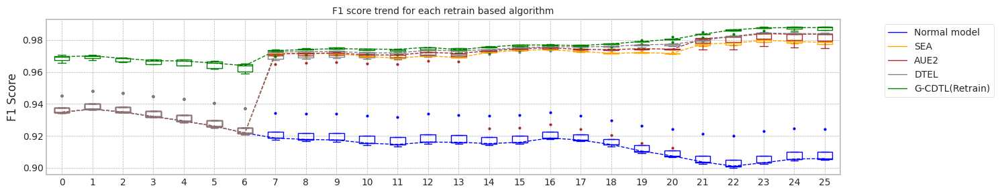

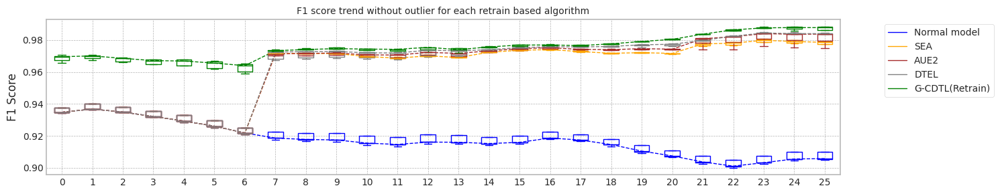

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.877040386199951
Base flops (train + inference flops of normal model, median): 17626200000.0


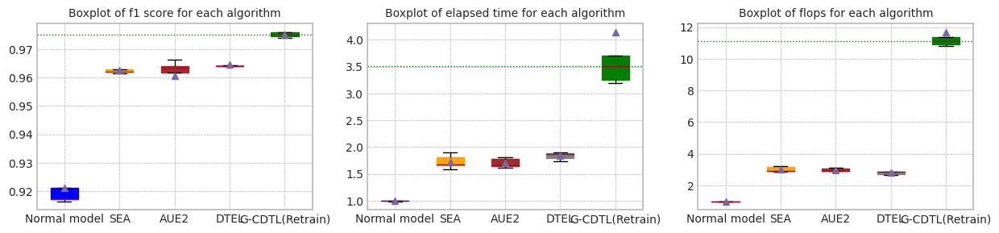

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.877040386199951


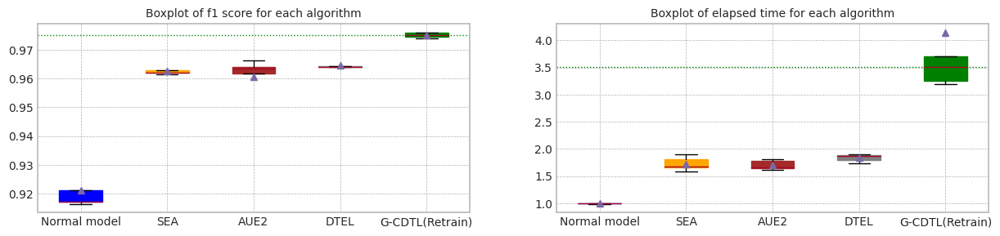

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.917332,0.905780,10.964917,1.740000e+10,226200000.0,1.762620e+10
1,1.0,0.937698,0.940101,0.921242,0.909930,10.853433,1.740000e+10,226200000.0,1.762620e+10
2,2.0,0.934735,0.936654,0.917241,0.905585,10.877040,1.740000e+10,226200000.0,1.762620e+10
3,3.0,0.945257,0.947906,0.933297,0.924414,10.912465,1.740000e+10,226200000.0,1.762620e+10
4,4.0,0.934395,0.936394,0.916477,0.904803,10.787091,1.740000e+10,226200000.0,1.762620e+10
5,median,0.934809,0.936785,0.917332,0.905780,10.877040,1.740000e+10,226200000.0,1.762620e+10
6,std,0.004601,0.004902,0.007058,0.008247,0.066345,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.957741,0.946251,10.527087,1.574000e+11,1.136200e+09,1.585362e+11
1,1.0,0.967497,0.968403,0.951043,0.927482,10.679448,1.574000e+11,1.136200e+09,1.585362e+11
2,2.0,0.970682,0.970795,0.952255,0.921099,10.557955,1.574000e+11,1.136200e+09,1.585362e+11
3,3.0,0.965645,0.967411,0.944169,0.914014,10.789588,1.574000e+11,1.136200e+09,1.585362e+11
4,4.0,0.969521,0.970020,0.954925,0.929771,10.854535,1.574000e+11,1.136200e+09,1.585362e+11
5,median,0.969521,0.970020,0.952255,0.927482,10.679448,1.574000e+11,1.136200e+09,1.585362e+11
6,std,0.002060,0.001409,0.005094,0.012035,0.142069,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.961574,0.977241,17.323918,2.476020e+10,2.553450e+10,5.029470e+10
1,1.0,0.937698,0.940101,0.962830,0.979083,19.693940,2.740674e+10,2.818104e+10,5.558778e+10
2,2.0,0.934735,0.936654,0.961981,0.978459,18.022806,2.524218e+10,2.601648e+10,5.125866e+10
3,3.0,0.945257,0.947906,0.964980,0.977576,18.248976,2.544576e+10,2.622006e+10,5.166582e+10
4,4.0,0.934395,0.936394,0.961930,0.979124,20.604393,2.784000e+10,2.861430e+10,5.645430e+10
5,median,0.934809,0.936785,0.961981,0.978459,18.248976,2.544576e+10,2.622006e+10,5.166582e+10
6,std,0.004601,0.004902,0.001377,0.000861,1.335964,1.386229e+09,1.386229e+09,2.772458e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.963527,0.983797,19.670975,2.722056e+10,2.822106e+10,5.544162e+10
1,1.0,0.937698,0.940101,0.963995,0.983667,17.542988,2.509254e+10,2.609304e+10,5.118558e+10
2,2.0,0.934735,0.936654,0.961847,0.983915,19.379647,2.640798e+10,2.740848e+10,5.381646e+10
3,3.0,0.945257,0.947906,0.966242,0.979309,18.145311,2.536920e+10,2.636970e+10,5.173890e+10
4,4.0,0.934395,0.936394,0.947522,0.974908,17.989878,2.505600e+10,2.605650e+10,5.111250e+10
5,median,0.934809,0.936785,0.963527,0.983667,18.145311,2.536920e+10,2.636970e+10,5.173890e+10
6,std,0.004601,0.004902,0.007492,0.003979,0.926875,9.517057e+08,9.517057e+08,1.903411e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.964170,0.983494,20.410002,2.840028e+10,2.235378e+10,5.075406e+10
1,1.0,0.937698,0.940101,0.963922,0.983844,18.817524,2.634882e+10,2.076690e+10,4.711572e+10
2,2.0,0.934735,0.936654,0.962684,0.984202,20.460624,2.808360e+10,2.203710e+10,5.012070e+10
3,3.0,0.945257,0.947906,0.967691,0.983901,19.553759,2.687604e+10,2.095308e+10,4.782912e+10
4,4.0,0.934395,0.936394,0.964296,0.984429,20.649551,2.811144e+10,2.206494e+10,5.017638e+10
5,median,0.934809,0.936785,0.964170,0.983901,20.410002,2.808360e+10,2.203710e+10,5.012070e+10
6,std,0.004601,0.004902,0.001868,0.000358,0.774147,8.970772e+08,7.214205e+08,1.615522e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.973865,0.985977,76.736754,2.518400e+11,99500000.0,2.519395e+11
1,1.0,0.967497,0.968403,0.975218,0.988284,40.319540,2.003235e+11,99500000.0,2.004230e+11
2,2.0,0.970682,0.970795,0.976052,0.988297,34.682037,1.905489e+11,99500000.0,1.906484e+11
3,3.0,0.965645,0.967411,0.974642,0.987702,35.421170,1.919723e+11,99500000.0,1.920718e+11
4,4.0,0.969521,0.970020,0.975810,0.986292,38.173085,1.954024e+11,99500000.0,1.955019e+11
5,median,0.969521,0.970020,0.975218,0.987702,38.173085,1.954024e+11,99500000.0,1.955019e+11
6,std,0.002060,0.001409,0.000889,0.001106,17.846059,2.589087e+10,0.0,2.589087e+10


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 11:02:22,332] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 2000/2000 [00:04<00:00, 410.98it/s]

Early stop: 1999
[2023-12-03 11:02:27,205] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89943074, 0.88250818]), array([0.29867675, 0.99370023]), array([0.44843898, 0.93480935]), array([ 3174, 16826]))
Test f1 score: 0.934809348093481
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.41it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9173319390967674
inference_flops: 226200000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:02:38,056] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:02:38,058] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 123.18it/s]

[2023-12-03 11:03:05,279] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:03:05,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.99215505, 0.94257837]), array([0.6773787 , 0.99898966]), array([0.80509268, 0.96996451]), array([ 3174, 16826]))
Test f1 score: 0.9699645113823249
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.44it/s]

mean of drift:
recoveries              0.863871
last_fico_range_high    0.475187
last_pymnt_amnt         0.528398
total_rec_late_fee      0.965750
int_rate                0.130821
dtype: float64
Mean F1 for all data: 0.957741204656209
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.957741204656209
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 11:03:15,996] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 414.83it/s]

Early stop: 1999
[2023-12-03 11:03:20,824] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89495451, 0.88867011]), array([0.34089477, 0.99245216]), array([0.49372576, 0.93769829]), array([ 3174, 16826]))
Test f1 score: 0.9376982901423476
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9212417862658753
inference_flops: 226200000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:03:31,722] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:03:31,724] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 121.81it/s]

[2023-12-03 11:03:59,374] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:03:59,375] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98900048, 0.93824334]), array([0.65154379, 0.99863307]), array([0.78556505, 0.96749676]), array([ 3174, 16826]))
Test f1 score: 0.9674967611918814
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.44it/s]

mean of drift:
recoveries              0.832729
last_fico_range_high    0.456425
last_pymnt_amnt         0.505794
total_rec_late_fee      0.965750
int_rate                0.109156
dtype: float64
Mean F1 for all data: 0.9510429341779746
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9543920694170918
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-12-03 11:04:10,092] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 408.99it/s]

Early stop: 1999
[2023-12-03 11:04:14,988] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89990467, 0.88232811]), array([0.29741651, 0.99375966]), array([0.44707554, 0.93473461]), array([ 3174, 16826]))
Test f1 score: 0.934734606031808
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.41it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9172405727818584
inference_flops: 226200000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:04:25,827] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:04:25,829] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 123.14it/s]

[2023-12-03 11:04:53,302] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:04:53,304] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98214286, 0.94515766]), array([0.6931317 , 0.99762273]), array([0.81270779, 0.97068178]), array([ 3174, 16826]))
Test f1 score: 0.9706817787544093
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.43it/s]

mean of drift:
recoveries              0.869952
last_fico_range_high    0.462038
last_pymnt_amnt         0.529694
total_rec_late_fee      0.965750
int_rate                0.133481
dtype: float64
Mean F1 for all data: 0.9522551587041203
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-12-03 11:05:04,044] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 418.03it/s]

Early stop: 1999
[2023-12-03 11:05:08,834] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90482399, 0.90328171]), array([0.43730309, 0.99132295]), array([0.58963466, 0.94525672]), array([ 3174, 16826]))
Test f1 score: 0.9452567154029242
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.41it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9332974273094798
inference_flops: 226200000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:05:19,658] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:05:19,661] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 122.06it/s]

[2023-12-03 11:05:47,057] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:05:47,057] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.92627518, 0.94266146]), array([0.68084436, 0.98977772]), array([0.78481932, 0.9656452 ]), array([ 3174, 16826]))
Test f1 score: 0.9656452033745977
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.43it/s]

mean of drift:
recoveries              0.839398
last_fico_range_high    0.407798
last_pymnt_amnt         0.517254
total_rec_late_fee      0.965750
int_rate                0.127600
dtype: float64
Mean F1 for all data: 0.9441692001956904
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9516490464410474
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-12-03 11:05:57,817] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:04<00:00, 411.43it/s]

Early stop: 1999
[2023-12-03 11:06:02,684] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90401567, 0.88139523]), array([0.29080025, 0.99417568]), array([0.44004768, 0.93439464]), array([ 3174, 16826]))
Test f1 score: 0.934394637620444
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.39it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9164770475937788
inference_flops: 226200000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:06:13,609] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:06:13,612] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:16<00:00, 124.32it/s]

[2023-12-03 11:06:40,673] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:06:40,674] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.95930736, 0.94584511]), array([0.69817265, 0.99441341]), array([0.80816922, 0.96952138]), array([ 3174, 16826]))
Test f1 score: 0.9695213813883415
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.39it/s]


mean of drift:
recoveries              0.871642
last_fico_range_high    0.360342
last_pymnt_amnt         0.510163
total_rec_late_fee      0.911712
int_rate                0.128648
dtype: float64
Mean F1 for all data: 0.9549246120285516
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.43it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:06:54,098] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:06:54,100] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:07:17,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:07:17,897] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 6/26 [00:26<02:50,  8.51s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 42%|████▏     | 11/26 [00:28<00:24,  1.64s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:07:20,384] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:07:20,387] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:07:44,658] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:07:44,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 46%|████▌     | 12/26 [00:53<02:01,  8.65s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 65%|██████▌   | 17/26 [00:55<00:16,  1.78s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:07:47,129] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:07:47,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:08:11,302] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:08:11,303] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [01:19<01:09,  8.63s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 88%|████████▊ | 23/26 [01:21<00:05,  1.80s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:08:13,860] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:08:13,863] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:08:38,594] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:08:38,596] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 92%|█████████▏| 24/26 [01:46<00:17,  8.82s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


100%|██████████| 26/26 [01:47<00:00,  4.15s/it]


Early stop at  [1999, 1999, 1999, 1999]
Train flops  [31480000000, 31480000000, 31480000000, 31480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9730924378498482
G_CDTL+AUE median: 0.9730924378498482
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:04<00:23,  1.19s/it]

Ensemble_SEA train flops: 2392500000


 46%|████▌     | 12/26 [00:10<00:20,  1.49s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:15<00:11,  1.39s/it]

Ensemble_SEA train flops: 2989320000


 92%|█████████▏| 24/26 [00:21<00:03,  1.56s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:22<00:00,  1.14it/s]


Early stop at  [1374, 1999, 1717, 1999]
Train flops  [2392500000, 3480000000, 2989320000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9637211517918184
SEA median: 0.9637211517918184
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:31,  1.55s/it]

Ensemble_SEA train flops: 3480000000


 46%|████▌     | 12/26 [00:11<00:21,  1.55s/it]

Ensemble_SEA train flops: 3473040000


 69%|██████▉   | 18/26 [00:17<00:12,  1.54s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:21<00:01,  1.08it/s]

Ensemble_SEA train flops: 1325880000


100%|██████████| 26/26 [00:22<00:00,  1.18it/s]


Early stop at  [1999, 1995, 1999, 761]
Train flops  [3480000000, 3473040000, 3480000000, 1325880000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9648435170937023
AUE median: 0.9648435170937023
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.41it/s]

Ensemble_DTEL train flops: 3114600000


 23%|██▎       | 6/26 [00:08<00:50,  2.51s/it]

Ensemble_DTEL train flops: 3330360000


 46%|████▌     | 12/26 [00:14<00:23,  1.67s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 69%|██████▉   | 18/26 [00:20<00:12,  1.56s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 10440000


 92%|█████████▏| 24/26 [00:26<00:03,  1.53s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 6960000


100%|██████████| 26/26 [00:26<00:00,  1.04s/it]


Early stop at  [1789, 1913, 1999, 1, 1999, 5, 1999, 3]
Train flops  [3114600000, 3330360000, 3480000000, 3480000, 3480000000, 10440000, 3480000000, 6960000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9656615401902168
DTEL median: 0.9656615401902168
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.37it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:09:53,968] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:09:53,971] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:10:04,410] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:10:04,412] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 6/26 [00:12<01:19,  3.98s/it]

G-CDTL train flops: 8281000000 4403000000 1094460000 13778460000


 42%|████▏     | 11/26 [00:15<00:14,  1.05it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:10:06,915] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:10:06,917] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:10:12,904] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:10:12,905] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 46%|████▌     | 12/26 [00:21<00:36,  2.62s/it]

G-CDTL train flops: 4305000000 2765000000 687300000 7757300000


 65%|██████▌   | 17/26 [00:23<00:07,  1.28it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:10:15,415] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:10:15,417] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:10:24,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:10:24,847] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:33<00:28,  3.51s/it]

G-CDTL train flops: 210000000 8876000000 2206320000 11292320000


 88%|████████▊ | 23/26 [00:35<00:02,  1.06it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:10:27,390] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:10:27,392] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:10:39,184] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:10:39,185] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 92%|█████████▏| 24/26 [00:47<00:08,  4.33s/it]

G-CDTL train flops: 9135000000 4795000000 1191900000 15121900000


100%|██████████| 26/26 [00:48<00:00,  1.87s/it]


Early stop at  [628, 394, 1267, 684]
Train flops  [13778460000, 7757300000, 11292320000, 15121900000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.975357207747638
G_CDTL+AUE median: 0.9742248227987431
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:31,  1.56s/it]

Ensemble_SEA train flops: 3480000000


 46%|████▌     | 12/26 [00:11<00:21,  1.54s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:17<00:12,  1.57s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:21<00:01,  1.14it/s]

Ensemble_SEA train flops: 1050960000


100%|██████████| 26/26 [00:21<00:00,  1.18it/s]


Early stop at  [1999, 1999, 1999, 603]
Train flops  [3480000000, 3480000000, 3480000000, 1050960000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.964158362095541
SEA median: 0.9639397569436796
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:31,  1.55s/it]

Ensemble_SEA train flops: 3480000000


 46%|████▌     | 12/26 [00:11<00:18,  1.34s/it]

Ensemble_SEA train flops: 2759640000


 69%|██████▉   | 18/26 [00:16<00:12,  1.52s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:20<00:01,  1.09it/s]

Ensemble_SEA train flops: 1251060000


100%|██████████| 26/26 [00:21<00:00,  1.21it/s]


Early stop at  [1999, 1585, 1999, 718]
Train flops  [3480000000, 2759640000, 3480000000, 1251060000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.965727687155609
AUE median: 0.9652856021246556
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.40it/s]

Ensemble_DTEL train flops: 3480000000


 23%|██▎       | 6/26 [00:08<00:46,  2.31s/it]

Ensemble_DTEL train flops: 2277660000


 46%|████▌     | 12/26 [00:13<00:22,  1.64s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 69%|██████▉   | 18/26 [00:19<00:12,  1.56s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


 92%|█████████▏| 24/26 [00:24<00:02,  1.36s/it]

Ensemble_DTEL train flops: 2848380000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:25<00:00,  1.01it/s]


Early stop at  [1999, 1308, 1999, 1, 1999, 2, 1636, 4]
Train flops  [3480000000, 2277660000, 3480000000, 3480000, 3480000000, 5220000, 2848380000, 8700000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.965756622440763
DTEL median: 0.9657090813154898
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 6
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.40it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:11:51,942] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:11:51,944] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:12:00,637] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:12:00,638] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 6/26 [00:11<01:07,  3.39s/it]

G-CDTL train flops: 7644000000 2996000000 744720000 11384720000


 42%|████▏     | 11/26 [00:13<00:12,  1.16it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:12:03,102] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:12:03,105] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:12:07,039] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:12:07,040] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 46%|████▌     | 12/26 [00:17<00:26,  1.92s/it]

G-CDTL train flops: 427000000 3311000000 823020000 4561020000


 65%|██████▌   | 17/26 [00:19<00:05,  1.50it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:12:09,548] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:12:09,551] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:12:19,357] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:12:19,358] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:29<00:28,  3.54s/it]

G-CDTL train flops: 7273000000 4263000000 1059660000 12595660000


 88%|████████▊ | 23/26 [00:32<00:02,  1.04it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:12:21,986] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:12:21,988] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:12:27,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:12:27,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 92%|█████████▏| 24/26 [00:37<00:04,  2.42s/it]

G-CDTL train flops: 553000000 4690000000 1165800000 6408800000


100%|██████████| 26/26 [00:38<00:00,  1.49s/it]


Early stop at  [427, 472, 608, 669]
Train flops  [11384720000, 4561020000, 12595660000, 6408800000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9760839847442374
G_CDTL+AUE median: 0.975357207747638
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:31,  1.58s/it]

Ensemble_SEA train flops: 3480000000


 46%|████▌     | 12/26 [00:11<00:20,  1.43s/it]

Ensemble_SEA train flops: 2985840000


 69%|██████▉   | 18/26 [00:17<00:12,  1.55s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:23<00:03,  1.59s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:24<00:00,  1.08it/s]


Early stop at  [1999, 1715, 1999, 1999]
Train flops  [3480000000, 2985840000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9629079663000945
SEA median: 0.9637211517918184
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:31,  1.56s/it]

Ensemble_SEA train flops: 3480000000


 46%|████▌     | 12/26 [00:11<00:21,  1.56s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:17<00:12,  1.56s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:21<00:01,  1.04it/s]

Ensemble_SEA train flops: 1341540000


100%|██████████| 26/26 [00:22<00:00,  1.16it/s]


Early stop at  [1999, 1999, 1999, 770]
Train flops  [3480000000, 3480000000, 3480000000, 1341540000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9651887124319104
AUE median: 0.9651887124319104
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.44it/s]

Ensemble_DTEL train flops: 3480000000


 23%|██▎       | 6/26 [00:07<00:45,  2.29s/it]

Ensemble_DTEL train flops: 2251560000


 46%|████▌     | 12/26 [00:13<00:23,  1.65s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


 69%|██████▉   | 18/26 [00:19<00:13,  1.63s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 92%|█████████▏| 24/26 [00:23<00:01,  1.14it/s]

Ensemble_DTEL train flops: 1023120000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:24<00:00,  1.06it/s]


Early stop at  [1999, 1293, 1999, 2, 1999, 1, 587, 4]
Train flops  [3480000000, 2251560000, 3480000000, 5220000, 3480000000, 3480000, 1023120000, 8700000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9646133818677899
DTEL median: 0.9656615401902168
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 6
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.39it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:13:41,843] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:13:41,845] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:13:53,556] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:13:53,558] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 6/26 [00:14<01:28,  4.41s/it]

G-CDTL train flops: 9926000000 4004000000 995280000 14925280000


 42%|████▏     | 11/26 [00:16<00:15,  1.02s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:13:56,066] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:13:56,068] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:14:03,378] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:14:03,379] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 46%|████▌     | 12/26 [00:24<00:42,  3.06s/it]

G-CDTL train flops: 5439000000 3073000000 763860000 9275860000


 65%|██████▌   | 17/26 [00:26<00:07,  1.16it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:14:05,887] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:14:05,889] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:14:10,498] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:14:10,499] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:31<00:16,  2.11s/it]

G-CDTL train flops: 483000000 3857000000 958740000 5298740000


 88%|████████▊ | 23/26 [00:33<00:02,  1.41it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:14:13,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:14:13,045] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:14:31,431] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:14:31,433] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 92%|█████████▏| 24/26 [00:52<00:12,  6.15s/it]

G-CDTL train flops: 9590000000 10234000000 2543880000 22367880000


100%|██████████| 26/26 [00:52<00:00,  2.04s/it]


Early stop at  [571, 438, 550, 1461]
Train flops  [14925280000, 9275860000, 5298740000, 22367880000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9745011420009478
G_CDTL+AUE median: 0.974929174874293
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:04<00:23,  1.17s/it]

Ensemble_SEA train flops: 2194140000


 46%|████▌     | 12/26 [00:10<00:19,  1.36s/it]

Ensemble_SEA train flops: 2810100000


 69%|██████▉   | 18/26 [00:15<00:11,  1.50s/it]

Ensemble_SEA train flops: 3260760000


 92%|█████████▏| 24/26 [00:21<00:03,  1.59s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:22<00:00,  1.15it/s]


Early stop at  [1260, 1614, 1873, 1999]
Train flops  [2194140000, 2810100000, 3260760000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9668455939740905
SEA median: 0.9639397569436796
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:28,  1.44s/it]

Ensemble_SEA train flops: 3038040000


 46%|████▌     | 12/26 [00:11<00:21,  1.57s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:17<00:12,  1.59s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:23<00:03,  1.56s/it]

Ensemble_SEA train flops: 3405180000


100%|██████████| 26/26 [00:24<00:00,  1.08it/s]


Early stop at  [1745, 1999, 1999, 1956]
Train flops  [3038040000, 3480000000, 3480000000, 3405180000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9677747475762727
AUE median: 0.9654581997937597
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.41it/s]

Ensemble_DTEL train flops: 2636100000


 23%|██▎       | 6/26 [00:07<00:40,  2.01s/it]

Ensemble_DTEL train flops: 2091480000


 46%|████▌     | 12/26 [00:13<00:22,  1.64s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


 69%|██████▉   | 18/26 [00:19<00:12,  1.55s/it]

Ensemble_DTEL train flops: 3314700000
Ensemble_DTEL train flops: 3480000


 92%|█████████▏| 24/26 [00:22<00:01,  1.09it/s]

Ensemble_DTEL train flops: 1214520000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:23<00:00,  1.10it/s]


Early stop at  [1514, 1201, 1999, 2, 1904, 1, 697, 4]
Train flops  [2636100000, 2091480000, 3480000000, 5220000, 3314700000, 3480000, 1214520000, 8700000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9674666773883389
DTEL median: 0.9657090813154898
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 6
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.40it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:15:45,352] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:15:45,354] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:15:54,474] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:15:54,476] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 6/26 [00:11<01:10,  3.52s/it]

G-CDTL train flops: 371000000 8029000000 1995780000 10395780000


 42%|████▏     | 11/26 [00:13<00:13,  1.13it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:15:56,988] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:15:56,991] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:16:06,743] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:16:06,745] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 46%|████▌     | 12/26 [00:23<00:51,  3.71s/it]

G-CDTL train flops: 7819000000 3570000000 887400000 12276400000


 65%|██████▌   | 17/26 [00:26<00:08,  1.03it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:16:09,267] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:16:09,270] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:16:15,072] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:16:15,074] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 69%|██████▉   | 18/26 [00:32<00:20,  2.55s/it]

G-CDTL train flops: 308000000 5068000000 1259760000 6635760000


 88%|████████▊ | 23/26 [00:34<00:02,  1.28it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:16:17,625] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:16:17,627] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:16:26,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:16:26,644] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 92%|█████████▏| 24/26 [00:43<00:06,  3.38s/it]

G-CDTL train flops: 5705000000 4214000000 1047480000 10966480000


100%|██████████| 26/26 [00:44<00:00,  1.72s/it]


Early stop at  [1146, 509, 723, 601]
Train flops  [10395780000, 12276400000, 6635760000, 10966480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9758706392712634
G_CDTL+AUE median: 0.975357207747638
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:04<00:24,  1.21s/it]

Ensemble_SEA train flops: 2380320000


 46%|████▌     | 12/26 [00:09<00:17,  1.25s/it]

Ensemble_SEA train flops: 2489940000


 69%|██████▉   | 18/26 [00:15<00:12,  1.55s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:20<00:02,  1.13s/it]

Ensemble_SEA train flops: 1900080000


100%|██████████| 26/26 [00:21<00:00,  1.23it/s]


Early stop at  [1367, 1430, 1999, 1091]
Train flops  [2380320000, 2489940000, 3480000000, 1900080000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9632322028628478
SEA median: 0.9637211517918184
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 23%|██▎       | 6/26 [00:05<00:31,  1.59s/it]

Ensemble_SEA train flops: 3480000000


 46%|████▌     | 12/26 [00:11<00:22,  1.61s/it]

Ensemble_SEA train flops: 3480000000


 69%|██████▉   | 18/26 [00:17<00:12,  1.60s/it]

Ensemble_SEA train flops: 3480000000


 92%|█████████▏| 24/26 [00:21<00:01,  1.16it/s]

Ensemble_SEA train flops: 1026600000


100%|██████████| 26/26 [00:22<00:00,  1.16it/s]


Early stop at  [1999, 1999, 1999, 589]
Train flops  [3480000000, 3480000000, 3480000000, 1026600000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9648939242791824
AUE median: 0.9651887124319104
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:02<00:08,  2.42it/s]

Ensemble_DTEL train flops: 3480000000


 23%|██▎       | 6/26 [00:08<00:48,  2.44s/it]

Ensemble_DTEL train flops: 2448180000


 46%|████▌     | 12/26 [00:14<00:23,  1.66s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 69%|██████▉   | 18/26 [00:20<00:13,  1.63s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


 92%|█████████▏| 24/26 [00:26<00:03,  1.60s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:27<00:00,  1.05s/it]


Early stop at  [1999, 1406, 1999, 1, 1999, 2, 1999, 4]
Train flops  [3480000000, 2448180000, 3480000000, 3480000, 3480000000, 5220000, 3480000000, 8700000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9648323938860279
DTEL median: 0.9656615401902168


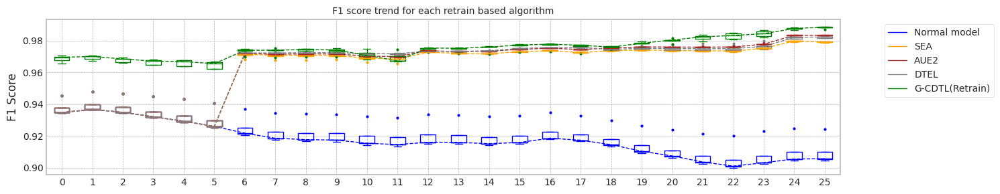

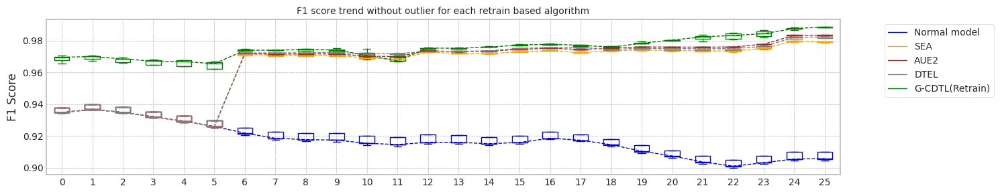

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.827256441116333
Base flops (train + inference flops of normal model, median): 17626200000.0


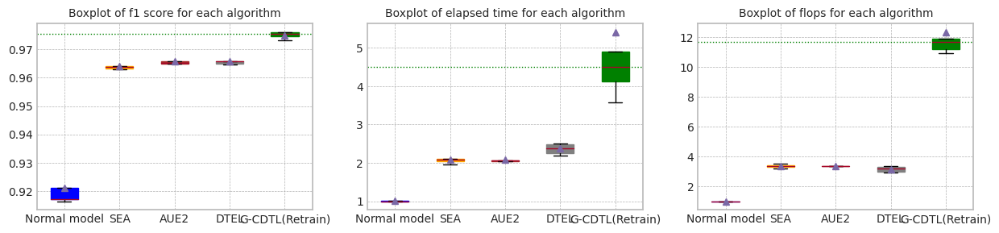

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.827256441116333


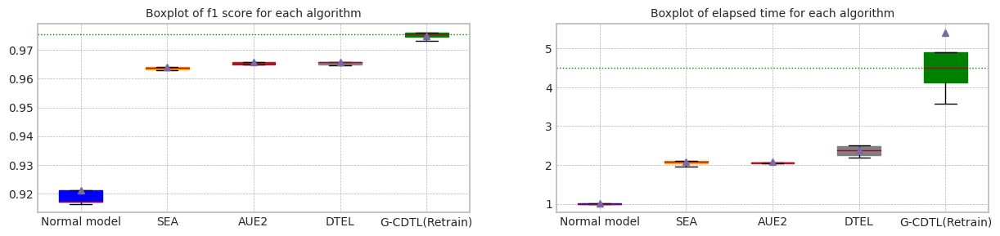

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.917332,0.905780,10.827256,1.740000e+10,226200000.0,1.762620e+10
1,1.0,0.937698,0.940101,0.921242,0.909930,10.878432,1.740000e+10,226200000.0,1.762620e+10
2,2.0,0.934735,0.936654,0.917241,0.905585,10.814729,1.740000e+10,226200000.0,1.762620e+10
3,3.0,0.945257,0.947906,0.933297,0.924414,10.801579,1.740000e+10,226200000.0,1.762620e+10
4,4.0,0.934395,0.936394,0.916477,0.904803,10.897961,1.740000e+10,226200000.0,1.762620e+10
5,median,0.934809,0.936785,0.917332,0.905780,10.827256,1.740000e+10,226200000.0,1.762620e+10
6,std,0.004601,0.004902,0.007058,0.008247,0.041935,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.957741,0.946251,10.693269,1.574000e+11,1.136200e+09,1.585362e+11
1,1.0,0.967497,0.968403,0.951043,0.927482,10.692371,1.574000e+11,1.136200e+09,1.585362e+11
2,2.0,0.970682,0.970795,0.952255,0.921099,10.716281,1.574000e+11,1.136200e+09,1.585362e+11
3,3.0,0.965645,0.967411,0.944169,0.914014,10.734544,1.574000e+11,1.136200e+09,1.585362e+11
4,4.0,0.969521,0.970020,0.954925,0.929771,10.909537,1.574000e+11,1.136200e+09,1.585362e+11
5,median,0.969521,0.970020,0.952255,0.927482,10.716281,1.574000e+11,1.136200e+09,1.585362e+11
6,std,0.002060,0.001409,0.005094,0.012035,0.091329,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.963721,0.979067,22.831042,2.974182e+10,3.058572e+10,6.032754e+10
1,1.0,0.937698,0.940101,0.964158,0.978945,22.020819,2.889096e+10,2.973486e+10,5.862582e+10
2,2.0,0.934735,0.936654,0.962908,0.979534,24.164187,3.082584e+10,3.166974e+10,6.249558e+10
3,3.0,0.945257,0.947906,0.966846,0.979414,22.674738,2.914500e+10,2.998890e+10,5.913390e+10
4,4.0,0.934395,0.936394,0.963232,0.978418,21.102680,2.765034e+10,2.849424e+10,5.614458e+10
5,median,0.934809,0.936785,0.963721,0.979067,22.674738,2.914500e+10,2.998890e+10,5.913390e+10
6,std,0.004601,0.004902,0.001568,0.000440,1.126336,1.164474e+09,1.164474e+09,2.328949e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.964844,0.983651,22.103512,2.915892e+10,3.022902e+10,5.938794e+10
1,1.0,0.937698,0.940101,0.965728,0.983362,21.459575,2.837070e+10,2.944080e+10,5.781150e+10
2,2.0,0.934735,0.936654,0.965189,0.983804,22.397844,2.918154e+10,3.025164e+10,5.943318e+10
3,3.0,0.945257,0.947906,0.967775,0.983267,24.125410,3.080322e+10,3.187332e+10,6.267654e+10
4,4.0,0.934395,0.936394,0.964894,0.983172,22.436733,2.886660e+10,2.993670e+10,5.880330e+10
5,median,0.934809,0.936785,0.965189,0.983362,22.397844,2.915892e+10,3.022902e+10,5.938794e+10
6,std,0.004601,0.004902,0.001220,0.000267,0.986911,9.140853e+08,9.140853e+08,1.828171e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.965662,0.982822,26.979676,3.430584e+10,2.514474e+10,5.945058e+10
1,1.0,0.937698,0.940101,0.965757,0.982299,25.836695,3.298344e+10,2.345694e+10,5.644038e+10
2,2.0,0.934735,0.936654,0.964613,0.981509,24.496377,3.113208e+10,2.160558e+10,5.273766e+10
3,3.0,0.945257,0.947906,0.967467,0.981385,23.685022,3.015420e+10,2.163690e+10,5.179110e+10
4,4.0,0.934395,0.936394,0.964832,0.982431,27.203938,3.378558e+10,2.425908e+10,5.804466e+10
5,median,0.934809,0.936785,0.965662,0.982299,25.836695,3.298344e+10,2.345694e+10,5.644038e+10
6,std,0.004601,0.004902,0.001124,0.000619,1.533715,1.769012e+09,1.577419e+09,3.322918e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.973092,0.986931,107.882612,2.833200e+11,39800000.0,2.833598e+11
1,1.0,0.967497,0.968403,0.975357,0.988704,48.658400,2.053500e+11,39800000.0,2.053898e+11
2,2.0,0.970682,0.970795,0.976084,0.988080,38.841450,1.923502e+11,39800000.0,1.923900e+11
3,3.0,0.965645,0.967411,0.974501,0.988760,53.023418,2.092678e+11,39800000.0,2.093076e+11
4,4.0,0.969521,0.970020,0.975871,0.988465,44.728256,1.976744e+11,39800000.0,1.977142e+11
5,median,0.969521,0.970020,0.975357,0.988465,48.658400,2.053500e+11,39800000.0,2.053898e+11
6,std,0.002060,0.001409,0.001219,0.000752,28.024683,3.732690e+10,0.0,3.732690e+10


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 11:17:42,013] [INFO] [profiler.py:80:start_profile] Flops profiler started


100%|██████████| 2000/2000 [00:05<00:00, 378.23it/s]

Early stop: 1999
[2023-12-03 11:17:47,308] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89943074, 0.88250818]), array([0.29867675, 0.99370023]), array([0.44843898, 0.93480935]), array([ 3174, 16826]))
Test f1 score: 0.934809348093481
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.42it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9173319390967674
inference_flops: 226200000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:17:58,130] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:17:58,132] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:17<00:00, 111.37it/s]

[2023-12-03 11:18:28,462] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:18:28,463] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.99215505, 0.94257837]), array([0.6773787 , 0.99898966]), array([0.80509268, 0.96996451]), array([ 3174, 16826]))
Test f1 score: 0.9699645113823249
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.863871
last_fico_range_high    0.475187
last_pymnt_amnt         0.528398
total_rec_late_fee      0.965750
int_rate                0.130821
dtype: float64
Mean F1 for all data: 0.957741204656209
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.957741204656209
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 11:18:39,350] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 371.57it/s]

Early stop: 1999
[2023-12-03 11:18:44,740] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89495451, 0.88867011]), array([0.34089477, 0.99245216]), array([0.49372576, 0.93769829]), array([ 3174, 16826]))
Test f1 score: 0.9376982901423476
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9212417862658753
inference_flops: 226200000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:18:55,617] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:18:55,619] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:17<00:00, 111.96it/s]

[2023-12-03 11:19:25,822] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:19:25,823] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98900048, 0.93824334]), array([0.65154379, 0.99863307]), array([0.78556505, 0.96749676]), array([ 3174, 16826]))
Test f1 score: 0.9674967611918814
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.43it/s]

mean of drift:
recoveries              0.832729
last_fico_range_high    0.456425
last_pymnt_amnt         0.505794
total_rec_late_fee      0.965750
int_rate                0.109156
dtype: float64
Mean F1 for all data: 0.9510429341779746
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9543920694170918
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-12-03 11:19:36,580] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 375.48it/s]

Early stop: 1999
[2023-12-03 11:19:41,914] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.89990467, 0.88232811]), array([0.29741651, 0.99375966]), array([0.44707554, 0.93473461]), array([ 3174, 16826]))
Test f1 score: 0.934734606031808
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.40it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9172405727818584
inference_flops: 226200000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:19:52,794] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:19:52,796] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:17<00:00, 112.42it/s]

[2023-12-03 11:20:22,837] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:20:22,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.98214286, 0.94515766]), array([0.6931317 , 0.99762273]), array([0.81270779, 0.97068178]), array([ 3174, 16826]))
Test f1 score: 0.9706817787544093
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.46it/s]

mean of drift:
recoveries              0.869952
last_fico_range_high    0.462038
last_pymnt_amnt         0.529694
total_rec_late_fee      0.965750
int_rate                0.133481
dtype: float64
Mean F1 for all data: 0.9522551587041203
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-12-03 11:20:33,463] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 372.12it/s]

Early stop: 1999
[2023-12-03 11:20:38,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90482399, 0.90328171]), array([0.43730309, 0.99132295]), array([0.58963466, 0.94525672]), array([ 3174, 16826]))
Test f1 score: 0.9452567154029242
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.38it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9332974273094798
inference_flops: 226200000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:20:49,827] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:20:49,830] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:17<00:00, 113.15it/s]

[2023-12-03 11:21:19,894] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:21:19,895] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.92627518, 0.94266146]), array([0.68084436, 0.98977772]), array([0.78481932, 0.9656452 ]), array([ 3174, 16826]))
Test f1 score: 0.9656452033745977
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.43it/s]

mean of drift:
recoveries              0.839398
last_fico_range_high    0.407798
last_pymnt_amnt         0.517254
total_rec_late_fee      0.965750
int_rate                0.127600
dtype: float64
Mean F1 for all data: 0.9441692001956904
inference_flops: 1136200000
Normal model median        : 0.9192868626813213
Drift tolerant model median: 0.9516490464410474
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-12-03 11:21:30,666] [INFO] [profiler.py:80:start_profile] Flops profiler started



100%|██████████| 2000/2000 [00:05<00:00, 379.28it/s]

Early stop: 1999
[2023-12-03 11:21:35,947] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 17400000000
precision_recall_fscore: (array([0.90401567, 0.88139523]), array([0.29080025, 0.99417568]), array([0.44004768, 0.93439464]), array([ 3174, 16826]))
Test f1 score: 0.934394637620444
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.38it/s]

mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9164770475937788
inference_flops: 226200000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-12-03 11:21:46,903] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:21:46,906] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


100%|██████████| 2000/2000 [00:17<00:00, 111.30it/s]

[2023-12-03 11:22:17,198] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:22:17,199] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 70000000000 70000000000 17400000000 157400000000
precision_recall_fscore: (array([0.95930736, 0.94584511]), array([0.69817265, 0.99441341]), array([0.80816922, 0.96952138]), array([ 3174, 16826]))
Test f1 score: 0.9695213813883415
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:10<00:00,  2.42it/s]


mean of drift:
recoveries              0.871642
last_fico_range_high    0.360342
last_pymnt_amnt         0.510163
total_rec_late_fee      0.911712
int_rate                0.128648
dtype: float64
Mean F1 for all data: 0.9549246120285516
inference_flops: 1136200000
Normal model median        : 0.9173319390967674
Drift tolerant model median: 0.9522551587041203
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.38it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:22:30,127] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:22:30,130] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:22:57,104] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:22:57,105] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 5/26 [00:29<03:33, 10.15s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 35%|███▍      | 9/26 [00:30<00:41,  2.45s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:22:59,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:22:59,228] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:23:26,355] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:23:26,356] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 38%|███▊      | 10/26 [00:58<02:43, 10.20s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 54%|█████▍    | 14/26 [01:00<00:32,  2.72s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:23:28,467] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:23:28,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:23:55,919] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:23:55,921] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 15/26 [01:27<01:53, 10.30s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 73%|███████▎  | 19/26 [01:29<00:19,  2.79s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:23:58,052] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:23:58,054] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:24:25,164] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:24:25,165] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 20/26 [01:57<01:01, 10.22s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


 92%|█████████▏| 24/26 [01:58<00:05,  2.78s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:24:27,305] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:24:27,308] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:24:54,923] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:24:54,924] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 96%|█████████▌| 25/26 [02:26<00:10, 10.36s/it]

G-CDTL train flops: 14000000000 14000000000 3480000000 31480000000


100%|██████████| 26/26 [02:27<00:00,  5.67s/it]


Early stop at  [1999, 1999, 1999, 1999, 1999]
Train flops  [31480000000, 31480000000, 31480000000, 31480000000, 31480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9739041534066543
G_CDTL+AUE median: 0.9739041534066543
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:36,  1.73s/it]

Ensemble_SEA train flops: 3480000000


 38%|███▊      | 10/26 [00:09<00:20,  1.26s/it]

Ensemble_SEA train flops: 1990560000


 58%|█████▊    | 15/26 [00:15<00:17,  1.62s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:21<00:10,  1.70s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:27<00:01,  1.75s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:27<00:00,  1.06s/it]


Early stop at  [1999, 1143, 1999, 1999, 1999]
Train flops  [3480000000, 1990560000, 3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.96660479624363
SEA median: 0.96660479624363
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:34,  1.66s/it]

Ensemble_SEA train flops: 3408660000


 38%|███▊      | 10/26 [00:11<00:27,  1.72s/it]

Ensemble_SEA train flops: 3480000000


 58%|█████▊    | 15/26 [00:17<00:19,  1.74s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:22<00:10,  1.75s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:28<00:01,  1.68s/it]

Ensemble_SEA train flops: 3219000000


100%|██████████| 26/26 [00:28<00:00,  1.11s/it]


Early stop at  [1958, 1999, 1999, 1999, 1849]
Train flops  [3408660000, 3480000000, 3480000000, 3480000000, 3219000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9680684939244528
AUE median: 0.9680684939244528
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.34it/s]

Ensemble_DTEL train flops: 3480000000


 19%|█▉        | 5/26 [00:08<00:55,  2.63s/it]

Ensemble_DTEL train flops: 2345520000


 38%|███▊      | 10/26 [00:13<00:29,  1.84s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 58%|█████▊    | 15/26 [00:17<00:12,  1.11s/it]

Ensemble_DTEL train flops: 1444200000
Ensemble_DTEL train flops: 3480000


 77%|███████▋  | 20/26 [00:23<00:09,  1.62s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 8700000


 96%|█████████▌| 25/26 [00:28<00:01,  1.69s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


100%|██████████| 26/26 [00:29<00:00,  1.13s/it]


Early stop at  [1999, 1347, 1999, 1, 829, 1, 1999, 4, 1999, 2]
Train flops  [3480000000, 2345520000, 3480000000, 3480000, 1444200000, 3480000, 3480000000, 8700000, 3480000000, 5220000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9675030305545422
DTEL median: 0.9675030305545422
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.36it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:26:23,365] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:26:23,368] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:26:34,339] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:26:34,340] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 5/26 [00:13<01:32,  4.38s/it]

G-CDTL train flops: 8722000000 3367000000 836940000 12925940000


 35%|███▍      | 9/26 [00:14<00:21,  1.25s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:26:36,491] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:26:36,494] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:26:45,755] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:26:45,756] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 38%|███▊      | 10/26 [00:24<01:01,  3.86s/it]

G-CDTL train flops: 6076000000 3710000000 922200000 10708200000


 54%|█████▍    | 14/26 [00:26<00:14,  1.22s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:26:47,810] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:26:47,813] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:26:57,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:26:57,205] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 15/26 [00:35<00:41,  3.81s/it]

G-CDTL train flops: 4466000000 4893000000 1216260000 10575260000


 73%|███████▎  | 19/26 [00:37<00:08,  1.23s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:26:59,279] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:26:59,281] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:27:15,436] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:27:15,437] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 20/26 [00:54<00:35,  5.84s/it]

G-CDTL train flops: 14000000000 4032000000 1002240000 19034240000


 92%|█████████▏| 24/26 [00:55<00:03,  1.73s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:27:17,597] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:27:17,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:27:28,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:27:28,115] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 96%|█████████▌| 25/26 [01:06<00:04,  4.50s/it]

G-CDTL train flops: 6216000000 4550000000 1131000000 11897000000


100%|██████████| 26/26 [01:07<00:00,  2.59s/it]


Early stop at  [480, 529, 698, 575, 649]
Train flops  [12925940000, 10708200000, 10575260000, 19034240000, 11897000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.976178170937454
G_CDTL+AUE median: 0.975041162172054
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:36,  1.76s/it]

Ensemble_SEA train flops: 3480000000


 38%|███▊      | 10/26 [00:11<00:27,  1.72s/it]

Ensemble_SEA train flops: 3347760000


 58%|█████▊    | 15/26 [00:17<00:19,  1.74s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:22<00:10,  1.72s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:28<00:01,  1.78s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:29<00:00,  1.13s/it]


Early stop at  [1999, 1923, 1999, 1999, 1999]
Train flops  [3480000000, 3347760000, 3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.967378836134732
SEA median: 0.9669918161891811
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:36,  1.73s/it]

Ensemble_SEA train flops: 3480000000


 38%|███▊      | 10/26 [00:11<00:27,  1.73s/it]

Ensemble_SEA train flops: 3480000000


 58%|█████▊    | 15/26 [00:15<00:14,  1.35s/it]

Ensemble_SEA train flops: 2270700000


 77%|███████▋  | 20/26 [00:20<00:07,  1.18s/it]

Ensemble_SEA train flops: 1966200000


 96%|█████████▌| 25/26 [00:25<00:01,  1.65s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:26<00:00,  1.01s/it]


Early stop at  [1999, 1999, 1304, 1129, 1999]
Train flops  [3480000000, 3480000000, 2270700000, 1966200000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9682440421482076
AUE median: 0.9681562680363303
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.35it/s]

Ensemble_DTEL train flops: 3480000000


 19%|█▉        | 5/26 [00:07<00:51,  2.44s/it]

Ensemble_DTEL train flops: 1767840000


 38%|███▊      | 10/26 [00:11<00:18,  1.15s/it]

Ensemble_DTEL train flops: 1315440000
Ensemble_DTEL train flops: 3480000


 58%|█████▊    | 15/26 [00:17<00:17,  1.63s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 77%|███████▋  | 20/26 [00:22<00:10,  1.69s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 8700000


 96%|█████████▌| 25/26 [00:28<00:01,  1.74s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


100%|██████████| 26/26 [00:28<00:00,  1.11s/it]


Early stop at  [1999, 1015, 755, 1, 1999, 1, 1999, 4, 1999, 2]
Train flops  [3480000000, 1767840000, 1315440000, 3480000, 3480000000, 3480000, 3480000000, 8700000, 3480000000, 5220000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9681121179280218
DTEL median: 0.9678075742412819
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.32it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:28:55,508] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:28:55,510] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:29:03,160] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:29:03,161] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 5/26 [00:09<01:06,  3.19s/it]

G-CDTL train flops: 4109000000 3521000000 875220000 8505220000


 35%|███▍      | 9/26 [00:11<00:16,  1.00it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:29:05,280] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:29:05,283] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:29:15,580] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:29:15,582] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 38%|███▊      | 10/26 [00:22<01:04,  4.00s/it]

G-CDTL train flops: 6755000000 3976000000 988320000 11719320000


 54%|█████▍    | 14/26 [00:23<00:15,  1.26s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:29:17,658] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:29:17,660] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:29:22,794] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:29:22,795] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 15/26 [00:29<00:28,  2.55s/it]

G-CDTL train flops: 819000000 3787000000 941340000 5547340000


 73%|███████▎  | 19/26 [00:31<00:06,  1.07it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:29:24,920] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:29:24,922] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:29:34,779] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:29:34,781] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 20/26 [00:41<00:22,  3.74s/it]

G-CDTL train flops: 6916000000 3451000000 857820000 11224820000


 92%|█████████▏| 24/26 [00:43<00:02,  1.22s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:29:36,930] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:29:36,933] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:29:49,845] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:29:49,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 96%|█████████▌| 25/26 [00:56<00:04,  4.86s/it]

G-CDTL train flops: 9800000000 3815000000 948300000 14563300000


100%|██████████| 26/26 [00:56<00:00,  2.19s/it]


Early stop at  [502, 567, 540, 492, 544]
Train flops  [8505220000, 11719320000, 5547340000, 11224820000, 14563300000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9763413590584118
G_CDTL+AUE median: 0.976178170937454
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:32,  1.55s/it]

Ensemble_SEA train flops: 2867520000


 38%|███▊      | 10/26 [00:09<00:22,  1.38s/it]

Ensemble_SEA train flops: 2455140000


 58%|█████▊    | 15/26 [00:15<00:17,  1.57s/it]

Ensemble_SEA train flops: 3145920000


 77%|███████▋  | 20/26 [00:21<00:10,  1.73s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:26<00:01,  1.56s/it]

Ensemble_SEA train flops: 2869260000


100%|██████████| 26/26 [00:26<00:00,  1.03s/it]


Early stop at  [1647, 1410, 1807, 1999, 1648]
Train flops  [2867520000, 2455140000, 3145920000, 3480000000, 2869260000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9667455934938339
SEA median: 0.9667455934938339
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:36,  1.73s/it]

Ensemble_SEA train flops: 3480000000


 38%|███▊      | 10/26 [00:11<00:27,  1.72s/it]

Ensemble_SEA train flops: 3480000000


 58%|█████▊    | 15/26 [00:17<00:19,  1.73s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:22<00:10,  1.74s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:28<00:01,  1.76s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:29<00:00,  1.12s/it]


Early stop at  [1999, 1999, 1999, 1999, 1999]
Train flops  [3480000000, 3480000000, 3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9676215161126419
AUE median: 0.9680684939244528
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.44it/s]

Ensemble_DTEL train flops: 3467820000


 19%|█▉        | 5/26 [00:08<00:53,  2.57s/it]

Ensemble_DTEL train flops: 2056680000


 38%|███▊      | 10/26 [00:13<00:26,  1.68s/it]

Ensemble_DTEL train flops: 2958000000
Ensemble_DTEL train flops: 3480000


 58%|█████▊    | 15/26 [00:19<00:19,  1.75s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 77%|███████▋  | 20/26 [00:24<00:10,  1.73s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 6960000


 96%|█████████▌| 25/26 [00:30<00:01,  1.75s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


100%|██████████| 26/26 [00:31<00:00,  1.19s/it]


Early stop at  [1992, 1181, 1699, 1, 1999, 1, 1999, 3, 1999, 1]
Train flops  [3467820000, 2056680000, 2958000000, 3480000, 3480000000, 3480000, 3480000000, 6960000, 3480000000, 3480000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9675409634472272
DTEL median: 0.9675409634472272
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.38it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:31:19,459] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:31:19,462] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:31:25,186] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:31:25,187] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 5/26 [00:07<00:52,  2.49s/it]

G-CDTL train flops: 2191000000 3248000000 807360000 6246360000


 35%|███▍      | 9/26 [00:09<00:14,  1.19it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:31:27,244] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:31:27,246] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:31:37,269] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:31:37,271] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 38%|███▊      | 10/26 [00:19<01:00,  3.80s/it]

G-CDTL train flops: 6748000000 3465000000 861300000 11074300000


 54%|█████▍    | 14/26 [00:21<00:14,  1.21s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:31:39,371] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:31:39,374] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:31:44,164] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:31:44,166] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 15/26 [00:26<00:26,  2.42s/it]

G-CDTL train flops: 336000000 3696000000 918720000 4950720000


 73%|███████▎  | 19/26 [00:28<00:06,  1.12it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:31:46,257] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:31:46,259] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:31:51,864] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:31:51,865] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 20/26 [00:34<00:14,  2.44s/it]

G-CDTL train flops: 399000000 4312000000 1071840000 5782840000


 92%|█████████▏| 24/26 [00:36<00:01,  1.10it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:31:54,031] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:31:54,033] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:32:03,826] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:32:03,827] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 96%|█████████▌| 25/26 [00:46<00:03,  3.71s/it]

G-CDTL train flops: 483000000 7749000000 1926180000 10158180000


100%|██████████| 26/26 [00:46<00:00,  1.80s/it]


Early stop at  [463, 494, 527, 615, 1106]
Train flops  [6246360000, 11074300000, 4950720000, 5782840000, 10158180000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.975375564635978
G_CDTL+AUE median: 0.975776867786716
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:37,  1.76s/it]

Ensemble_SEA train flops: 3393000000


 38%|███▊      | 10/26 [00:11<00:28,  1.77s/it]

Ensemble_SEA train flops: 3480000000


 58%|█████▊    | 15/26 [00:17<00:19,  1.77s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:23<00:10,  1.80s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:29<00:01,  1.79s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:29<00:00,  1.15s/it]


Early stop at  [1949, 1999, 1999, 1999, 1999]
Train flops  [3393000000, 3480000000, 3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9514190959999884
SEA median: 0.966675194868732
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:36,  1.73s/it]

Ensemble_SEA train flops: 3283380000


 38%|███▊      | 10/26 [00:11<00:28,  1.76s/it]

Ensemble_SEA train flops: 3480000000


 58%|█████▊    | 15/26 [00:17<00:19,  1.79s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:23<00:10,  1.79s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:29<00:01,  1.77s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:29<00:00,  1.14s/it]


Early stop at  [1886, 1999, 1999, 1999, 1999]
Train flops  [3283380000, 3480000000, 3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9703247091346225
AUE median: 0.9681562680363303
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.36it/s]

Ensemble_DTEL train flops: 3480000000


 19%|█▉        | 5/26 [00:07<00:51,  2.46s/it]

Ensemble_DTEL train flops: 1825260000


 38%|███▊      | 10/26 [00:12<00:23,  1.48s/it]

Ensemble_DTEL train flops: 2321160000
Ensemble_DTEL train flops: 3480000


 58%|█████▊    | 15/26 [00:17<00:18,  1.67s/it]

Ensemble_DTEL train flops: 3365160000
Ensemble_DTEL train flops: 3480000


 77%|███████▋  | 20/26 [00:23<00:10,  1.77s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 6960000


 96%|█████████▌| 25/26 [00:29<00:01,  1.84s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 10440000


100%|██████████| 26/26 [00:30<00:00,  1.17s/it]


Early stop at  [1999, 1048, 1333, 1, 1933, 1, 1999, 3, 1999, 5]
Train flops  [3480000000, 1825260000, 2321160000, 3480000, 3365160000, 3480000, 3480000000, 6960000, 3480000000, 10440000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9698584387722382
DTEL median: 0.9678265406876245
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.32it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:33:36,399] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:33:36,401] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:33:40,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:33:40,098] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 5/26 [00:05<00:36,  1.76s/it]

G-CDTL train flops: 308000000 2793000000 694260000 3795260000


 35%|███▍      | 9/26 [00:07<00:11,  1.44it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:33:42,179] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:33:42,182] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:33:54,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:33:54,665] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 38%|███▊      | 10/26 [00:20<01:11,  4.47s/it]

G-CDTL train flops: 8323000000 4305000000 1070100000 13698100000


 54%|█████▍    | 14/26 [00:22<00:16,  1.37s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:33:56,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:33:56,753] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:34:02,242] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:34:02,243] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 15/26 [00:28<00:30,  2.74s/it]

G-CDTL train flops: 462000000 4130000000 1026600000 5618600000


 73%|███████▎  | 19/26 [00:29<00:06,  1.03it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:34:04,322] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:34:04,324] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:34:18,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:34:18,204] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 20/26 [00:43<00:29,  4.97s/it]

G-CDTL train flops: 10290000000 3885000000 965700000 15140700000


 92%|█████████▏| 24/26 [00:45<00:03,  1.52s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-12-03 11:34:20,360] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 11:34:20,362] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-03 11:34:26,881] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 11:34:26,882] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 96%|█████████▌| 25/26 [00:52<00:03,  3.15s/it]

G-CDTL train flops: 420000000 4935000000 1226700000 6581700000


100%|██████████| 26/26 [00:53<00:00,  2.04s/it]


Early stop at  [398, 614, 589, 554, 704]
Train flops  [3795260000, 13698100000, 5618600000, 15140700000, 6581700000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9767120093272477
G_CDTL+AUE median: 0.976178170937454
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:31,  1.51s/it]

Ensemble_SEA train flops: 2723100000


 38%|███▊      | 10/26 [00:10<00:26,  1.64s/it]

Ensemble_SEA train flops: 3152880000


 58%|█████▊    | 15/26 [00:16<00:19,  1.77s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:20<00:07,  1.20s/it]

Ensemble_SEA train flops: 1687800000


 96%|█████████▌| 25/26 [00:26<00:01,  1.70s/it]

Ensemble_SEA train flops: 3420840000


100%|██████████| 26/26 [00:26<00:00,  1.04s/it]


Early stop at  [1564, 1811, 1999, 969, 1965]
Train flops  [2723100000, 3152880000, 3480000000, 1687800000, 3420840000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.966517933680995
SEA median: 0.96660479624363
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 19%|█▉        | 5/26 [00:05<00:38,  1.82s/it]

Ensemble_SEA train flops: 3480000000


 38%|███▊      | 10/26 [00:11<00:28,  1.79s/it]

Ensemble_SEA train flops: 3480000000


 58%|█████▊    | 15/26 [00:17<00:19,  1.78s/it]

Ensemble_SEA train flops: 3480000000


 77%|███████▋  | 20/26 [00:23<00:10,  1.78s/it]

Ensemble_SEA train flops: 3480000000


 96%|█████████▌| 25/26 [00:29<00:01,  1.78s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 26/26 [00:29<00:00,  1.15s/it]


Early stop at  [1999, 1999, 1999, 1999, 1999]
Train flops  [3480000000, 3480000000, 3480000000, 3480000000, 3480000000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9676377724778717
AUE median: 0.9680684939244528
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 15%|█▌        | 4/26 [00:01<00:09,  2.44it/s]

Ensemble_DTEL train flops: 3480000000


 19%|█▉        | 5/26 [00:08<00:57,  2.74s/it]

Ensemble_DTEL train flops: 2364660000


 38%|███▊      | 10/26 [00:14<00:30,  1.91s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 3480000


 58%|█████▊    | 15/26 [00:18<00:15,  1.41s/it]

Ensemble_DTEL train flops: 2295060000
Ensemble_DTEL train flops: 3480000


 77%|███████▋  | 20/26 [00:24<00:09,  1.61s/it]

Ensemble_DTEL train flops: 3121560000
Ensemble_DTEL train flops: 8700000


 96%|█████████▌| 25/26 [00:30<00:01,  1.78s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


100%|██████████| 26/26 [00:30<00:00,  1.19s/it]


Early stop at  [1999, 1358, 1999, 1, 1318, 1, 1793, 4, 1999, 2]
Train flops  [3480000000, 2364660000, 3480000000, 3480000, 2295060000, 3480000, 3121560000, 8700000, 3480000000, 5220000]
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9674506205079628
DTEL median: 0.9675409634472272


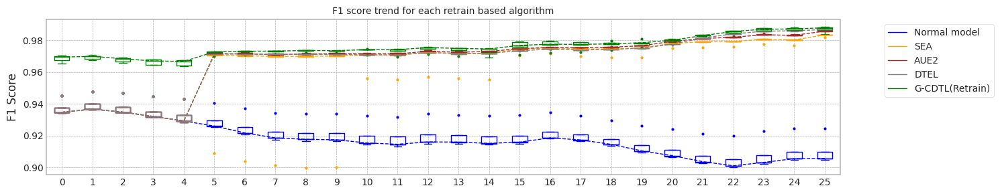

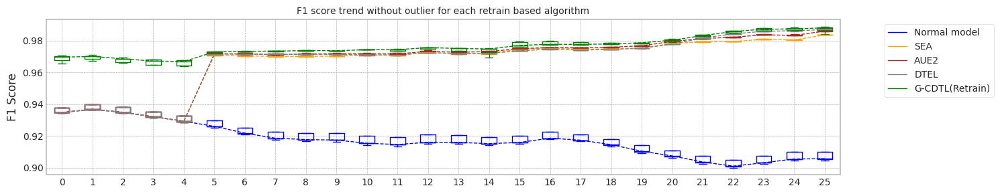

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.859191417694092
Base flops (train + inference flops of normal model, median): 17626200000.0


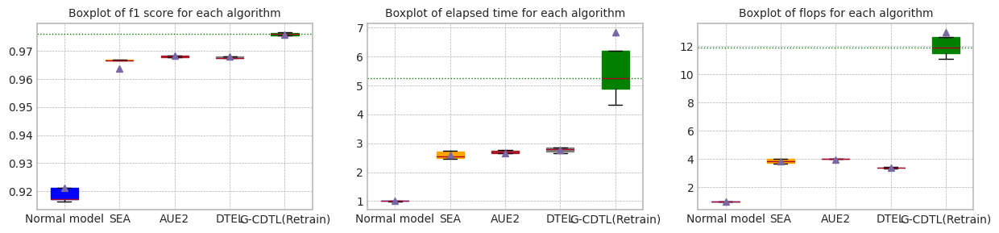

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.859191417694092


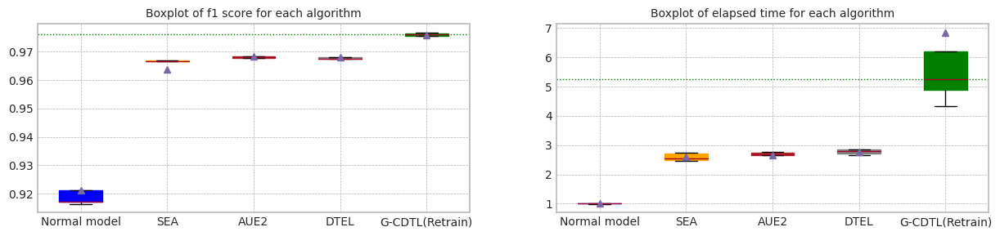

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.917332,0.905780,10.797101,1.740000e+10,226200000.0,1.762620e+10
1,1.0,0.937698,0.940101,0.921242,0.909930,10.854616,1.740000e+10,226200000.0,1.762620e+10
2,2.0,0.934735,0.936654,0.917241,0.905585,10.859191,1.740000e+10,226200000.0,1.762620e+10
3,3.0,0.945257,0.947906,0.933297,0.924414,10.958061,1.740000e+10,226200000.0,1.762620e+10
4,4.0,0.934395,0.936394,0.916477,0.904803,10.934596,1.740000e+10,226200000.0,1.762620e+10
5,median,0.934809,0.936785,0.917332,0.905780,10.859191,1.740000e+10,226200000.0,1.762620e+10
6,std,0.004601,0.004902,0.007058,0.008247,0.065233,0.000000e+00,0.0,0.000000e+00


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.957741,0.946251,10.863348,1.574000e+11,1.136200e+09,1.585362e+11
1,1.0,0.967497,0.968403,0.951043,0.927482,10.732354,1.574000e+11,1.136200e+09,1.585362e+11
2,2.0,0.970682,0.970795,0.952255,0.921099,10.596804,1.574000e+11,1.136200e+09,1.585362e+11
3,3.0,0.965645,0.967411,0.944169,0.914014,10.745884,1.574000e+11,1.136200e+09,1.585362e+11
4,4.0,0.969521,0.970020,0.954925,0.929771,10.779548,1.574000e+11,1.136200e+09,1.585362e+11
5,median,0.969521,0.970020,0.952255,0.927482,10.745884,1.574000e+11,1.136200e+09,1.585362e+11
6,std,0.002060,0.001409,0.005094,0.012035,0.096582,0.000000e+00,0.000000e+00,0.000000e+00


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.966605,0.983715,27.594379,3.331056e+10,3.425016e+10,6.756072e+10
1,1.0,0.937698,0.940101,0.967379,0.983496,29.427630,3.466776e+10,3.560736e+10,7.027512e+10
2,2.0,0.934735,0.936654,0.966746,0.983557,26.738009,3.221784e+10,3.315744e+10,6.537528e+10
3,3.0,0.945257,0.947906,0.951419,0.981756,29.847794,3.471300e+10,3.565260e+10,7.036560e+10
4,4.0,0.934395,0.936394,0.966518,0.983526,26.994571,3.186462e+10,3.280422e+10,6.466884e+10
5,median,0.934809,0.936785,0.966605,0.983526,27.594379,3.331056e+10,3.425016e+10,6.756072e+10
6,std,0.004601,0.004902,0.006892,0.000817,1.427229,1.330774e+09,1.330774e+09,2.661549e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.968068,0.986086,28.874065,3.446766e+10,3.563346e+10,7.010112e+10
1,1.0,0.937698,0.940101,0.968244,0.985798,26.342185,3.207690e+10,3.324270e+10,6.531960e+10
2,2.0,0.934735,0.936654,0.967622,0.985772,29.250906,3.480000e+10,3.596580e+10,7.076580e+10
3,3.0,0.945257,0.947906,0.970325,0.986122,29.644182,3.460338e+10,3.576918e+10,7.037256e+10
4,4.0,0.934395,0.936394,0.967638,0.985898,29.927553,3.480000e+10,3.596580e+10,7.076580e+10
5,median,0.934809,0.936785,0.968068,0.985898,29.250906,3.460338e+10,3.576918e+10,7.037256e+10
6,std,0.004601,0.004902,0.001121,0.000162,1.434693,1.167177e+09,1.167177e+09,2.334353e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.934809,0.936785,0.967503,0.986850,29.356839,3.513060e+10,2.415990e+10,5.929050e+10
1,1.0,0.937698,0.940101,0.968112,0.986921,28.971543,3.442416e+10,2.358222e+10,5.800638e+10
2,2.0,0.934735,0.936654,0.967541,0.986573,31.043109,3.633990e+10,2.386758e+10,6.020748e+10
3,3.0,0.945257,0.947906,0.969858,0.986810,30.440061,3.537594e+10,2.364312e+10,5.901906e+10
4,4.0,0.934395,0.936394,0.967451,0.986960,30.857484,3.564216e+10,2.417904e+10,5.982120e+10
5,median,0.934809,0.936785,0.967541,0.986850,30.440061,3.537594e+10,2.386758e+10,5.929050e+10
6,std,0.004601,0.004902,0.001023,0.000152,0.921801,7.010617e+08,2.795108e+08,8.430319e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.969965,0.970218,0.973904,0.986399,147.376974,3.148000e+11,19900000.0,3.148199e+11
1,1.0,0.967497,0.968403,0.976178,0.988681,67.379579,2.225406e+11,19900000.0,2.225605e+11
2,2.0,0.970682,0.970795,0.976341,0.988289,56.961318,2.089600e+11,19900000.0,2.089799e+11
3,3.0,0.965645,0.967411,0.975376,0.984046,46.948279,1.956124e+11,19900000.0,1.956323e+11
4,4.0,0.969521,0.970020,0.976712,0.987991,53.118675,2.022344e+11,19900000.0,2.022543e+11
5,median,0.969521,0.970020,0.976178,0.987991,56.961318,2.089600e+11,19900000.0,2.089799e+11
6,std,0.002060,0.001409,0.001117,0.001905,41.489502,4.908144e+10,0.0,4.908144e+10


Test F1 Score: 0.937378719458201
G-CDTL, 1-retrain: 0.9700241881612239


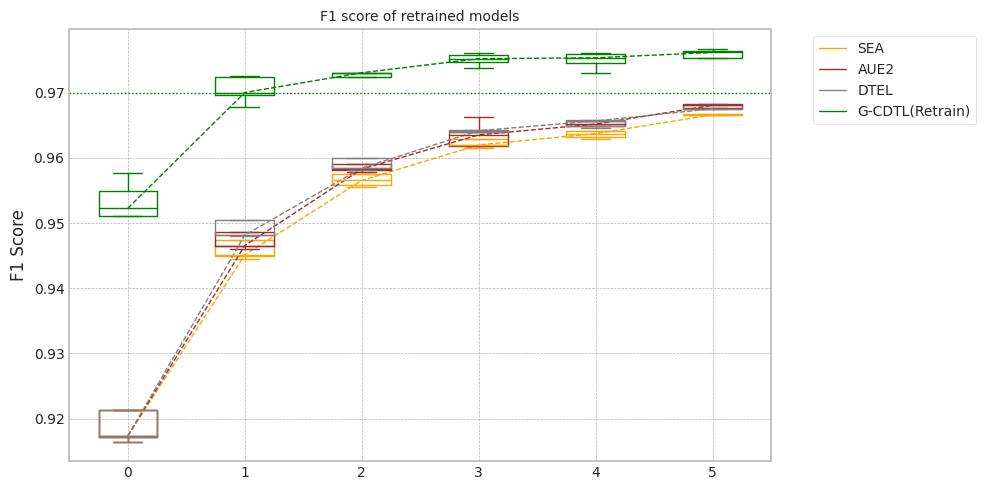

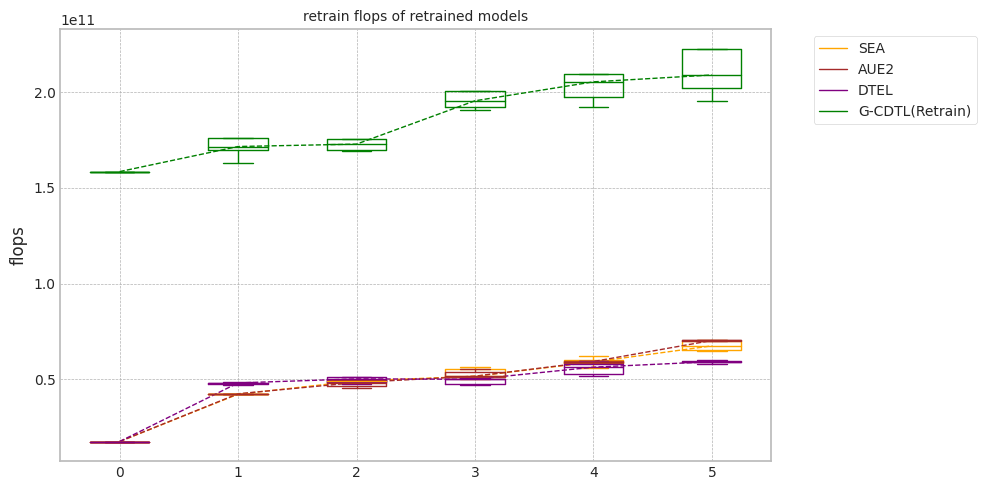

In [ ]:
experiment_all(2000,'LC_A',X1, Y1,train_size, test_size,avaible_range = 1000,
               lambda_f2=0.8,trial_count=5,lr_g=0.0002,retrain_count=5,weight_init=True)

### #2 시간 단위로 bucket 만들기

#### data 정제

In [105]:
X = {}
Y = {}

df = df_accepted[df_accepted['issue_d'].str.startswith('2007') + df_accepted['issue_d'].str.startswith('2008') + df_accepted['issue_d'].str.startswith('2009')].copy()
#df = df.drop(columns=['issue_d'])


X[2009] = df.loc[:, df.columns != 'loan_paid'].values
Y[2009] = df.loan_paid.values


for year in range(2010,2019):
    print(year)
    df = df_accepted[df_accepted['issue_d'].str.startswith(str(year))].copy()
    #df = df.drop(columns=['issue_d'])
    X[year] = df.loc[:, df.columns != 'loan_paid'].values
    Y[year] = df.loan_paid.values

2010
2011
2012
2013
2014
2015
2016
2017
2018


In [106]:
COLUMNS = df.loc[:, df.columns != 'loan_paid'].columns
COLUMNS

Index(['loan_amnt', 'term', 'int_rate', 'annual_inc', 'issue_d', 'dti',
       'delinq_2yrs', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'last_pymnt_amnt',
       'last_fico_range_high', 'collections_12_mths_ex_med', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2', 'E3',
       'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4', 'G5',
       'Source Verified', 'Verified', 'Joint App', 'w', 'credit_card',
       'debt_consolidation', 'educational', 'home_improvement', 'house',
       'major_purchase', 'medical', 'moving', 'other', 'renewable_energy',
       'small_business', 'vacation', 'wedding', 'MORTGAGE', 'OTHER', 'OWN',
       'RENT', 'DirectPay', 'Y'],


In [107]:
X2 = np.concatenate((X[2010],X[2011],X[2012],X[2013],X[2014],X[2015])) #,X[2016],X[2017]))
Y2 = np.concatenate((Y[2010],Y[2011],Y[2012],Y[2013],Y[2014],Y[2015])) #,Y[2016],Y[2017]))
X2 = pd.DataFrame(X2,columns = list(COLUMNS))#[top_columns+['issue_d']]

In [108]:
X2

,loan_amnt,term,int_rate,annual_inc,issue_d,dti,delinq_2yrs,fico_range_high,inq_last_6mths,open_acc,...,renewable_energy,small_business,vacation,wedding,MORTGAGE,OTHER,OWN,RENT,DirectPay,Y
0,12000.0,36,13.57,42000.0,201001,21.77,0.0,684.0,2.0,10.0,...,0,0,0,0,0,0,0,1,0,0
1,7500.0,36,12.18,26000.0,201001,0.0,0.0,764.0,3.0,5.0,...,0,0,0,0,0,0,0,1,0,0
2,10000.0,36,14.61,62400.0,201001,8.46,0.0,714.0,1.0,7.0,...,0,0,0,0,1,0,0,0,0,0
3,15000.0,36,16.0,96000.0,201001,11.13,2.0,664.0,2.0,13.0,...,0,0,0,0,0,0,0,1,0,0
4,20000.0,36,11.83,105000.0,201001,13.87,0.0,759.0,0.0,9.0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
818963,35000.0,60,18.99,76465.0,201512,20.37,0.0,684.0,0.0,15.0,...,0,0,0,0,0,0,0,1,0,0
818964,18000.0,60,9.99,70000.0,201512,30.65,0.0,714.0,2.0,14.0,...,0,0,0,0,1,0,0,0,0,0
818965,10800.0,36,17.57,30000.0,201512,38.48,0.0,674.0,1.0,12.0,...,0,0,0,0,0,0,0,1,0,0
818966,15000.0,36,5.32,82000.0,201512,22.83,0.0,759.0,0.0,15.0,...,0,0,0,0,1,0,0,0,0,0


In [109]:
from datetime import date
from datetime import datetime

def date_bucket_num(d,start_day='20100101'):
    date1 = datetime.strptime(start_day, '%Y%m%d')
    date2 = datetime.strptime(str(d)+'01', '%Y%m%d')
    delta = date2 - date1
    return int(delta.days/30)

In [110]:
X2['b'] = [date_bucket_num(d) for d in X2['issue_d']]

In [111]:
b_cnt = X2.groupby(['b'])['b'].count()

In [112]:
# 1/10 로 사이즈 줄이기...
seed_everything()
s = np.sort(np.random.choice(X2.shape[0],int(X2.shape[0]/10),replace= False))
#print(s.shape)
X3 = X2.iloc[s,:]
Y3 = Y2[s]

In [113]:
b_cnt2 = X3.groupby(['b'])['b'].count()

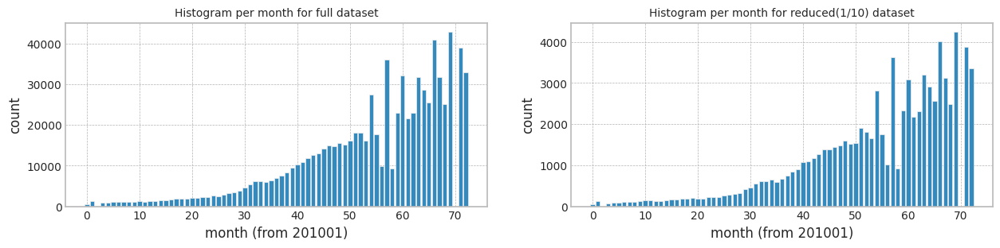

In [114]:
fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
ax[0].bar(b_cnt.index,b_cnt.values)
ax[0].set_ylabel('count')
ax[0].set_xlabel('month (from 201001)')
ax[0].set_title(f'Histogram per month for full dataset',fontdict={'fontsize':10})

ax[1].bar(b_cnt2.index,b_cnt2.values)
ax[1].set_ylabel('count')
ax[1].set_xlabel('month (from 201001)')
ax[1].set_title(f'Histogram per month for reduced(1/10) dataset',fontdict={'fontsize':10})

plt.show()

In [115]:
X3.drop(columns=['issue_d'],inplace=True)

In [116]:
X3

,loan_amnt,term,int_rate,annual_inc,dti,delinq_2yrs,fico_range_high,inq_last_6mths,open_acc,pub_rec,...,small_business,vacation,wedding,MORTGAGE,OTHER,OWN,RENT,DirectPay,Y,b
25,5000.0,36,8.59,70000.0,2.35,0.0,749.0,1.0,11.0,0.0,...,0,0,0,0,0,1,0,0,0,0
42,7750.0,36,12.87,29808.0,22.42,0.0,694.0,0.0,6.0,1.0,...,0,0,0,0,0,0,1,0,0,0
50,19600.0,36,15.65,67499.0,13.58,0.0,679.0,0.0,14.0,1.0,...,0,0,0,1,0,0,0,0,0,0
59,12000.0,36,8.94,90000.0,6.19,0.0,754.0,0.0,11.0,0.0,...,0,0,0,0,0,0,1,0,0,0
63,20000.0,36,12.87,51600.0,0.23,0.0,804.0,3.0,3.0,0.0,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
818907,19075.0,36,15.41,45444.84,17.48,0.0,669.0,0.0,8.0,0.0,...,0,0,0,0,0,1,0,0,0,72
818918,6000.0,36,12.05,100000.0,13.27,0.0,669.0,1.0,9.0,0.0,...,0,0,0,0,0,0,1,0,0,72
818935,20425.0,36,17.57,65000.0,19.81,0.0,669.0,1.0,17.0,2.0,...,0,0,0,1,0,0,0,0,0,72
818947,6000.0,36,11.49,90000.0,11.88,0.0,669.0,2.0,10.0,1.0,...,0,0,0,1,0,0,0,0,0,72


#### Drift tolerant 학습

train_size 19157
Dataset has buckets!
MI Analysis MI Max 0.30709, Min 0.01637, Mean 0.16365, Std 0.11537
Dataset structure X_train, (19157, 5) X_test, (19157, 5) X_live (79896, 5)
bucket range in live set 17~72
Truncate 0 rows from live_set (79896, 5)
Search MI & Drift...for X_live_set (55,)


100%|██████████| 55/55 [00:02<00:00, 20.27it/s]


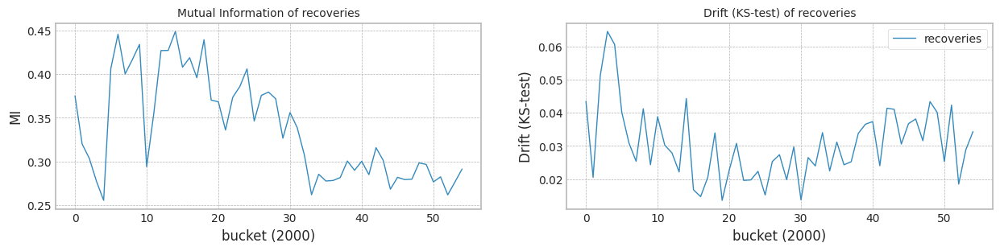

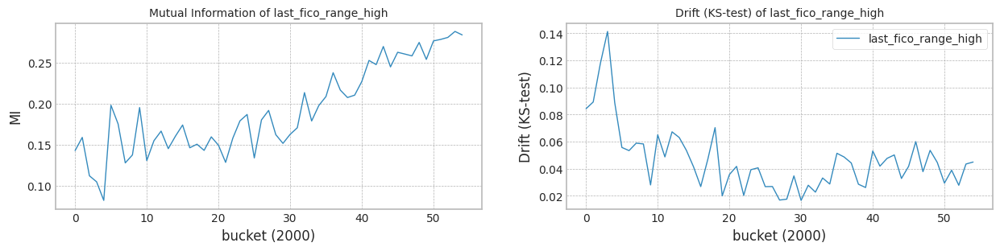

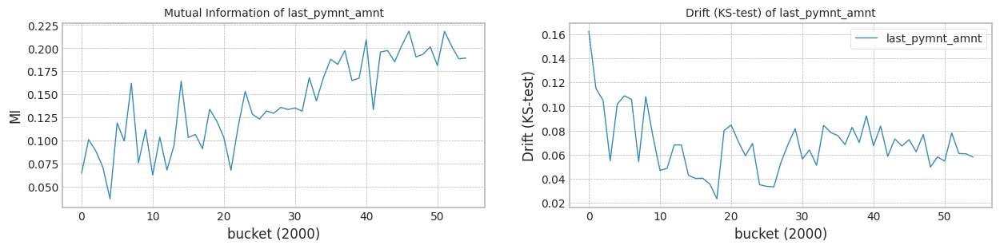

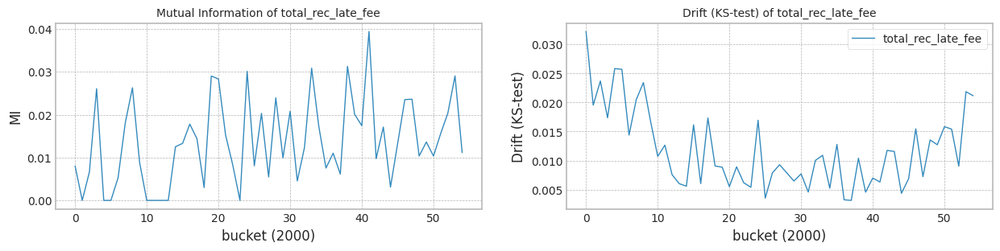

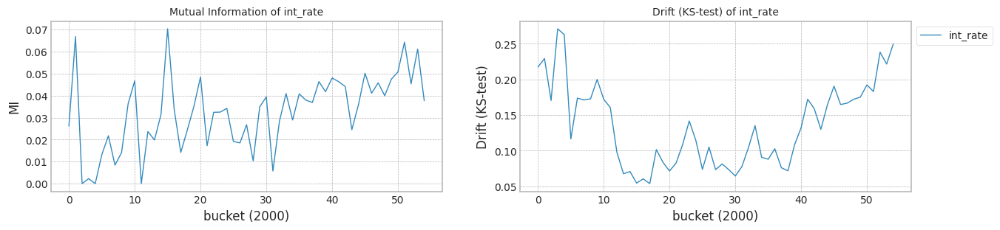

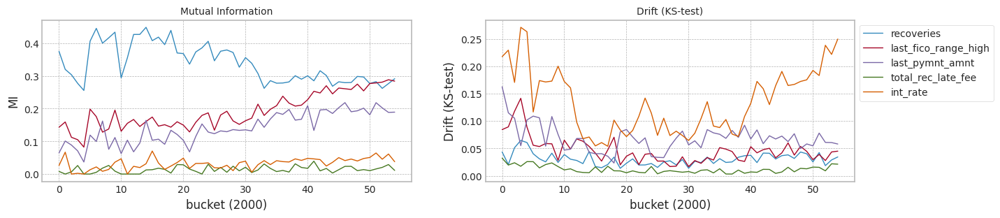

In [117]:
top_columns = list(mi_scores[0:5].index)
#top_columns = ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']
#top_columns = ['int_rate', 'last_pymnt_amnt', 'fico_range_high', 'inq_last_6mths', 'total_rec_int']

train_size = X3[X3['b'] < 46].shape[0] # 2010년 1월에서 39개월 (약 3년6개월간의 data)
#train_size = X3[X3['b'] < 36].shape[0] # 2010년 1월에서 39개월 (약 3년6개월간의 data)
print('train_size',train_size)
test_size = 2000

X1,Y1 = check_mi_drift(X3[top_columns+['b']], Y3, train_size, test_size)

trial_count: 2
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 21:25:38,036] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 343.83it/s]

Early stop: 686
[2023-12-03 21:25:40,038] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.23it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:25:53,971] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:25:53,973] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 16
min_bucket_num: 0.0


 16%|█▌        | 320/2000 [00:02<00:15, 111.62it/s]

[2023-12-03 21:25:56,959] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:25:56,961] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 10761444750 2674987695 14006353195
precision_recall_fscore: (array([0.96541418, 0.95432649]), array([0.74645097, 0.99497768]), array([0.84192888, 0.97422821]), array([ 3029, 16128]))
Test f1 score: 0.9742282123668154
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.34it/s]

mean of drift:
recoveries              0.862616
last_fico_range_high    0.188229
last_pymnt_amnt         0.503303
total_rec_late_fee      0.906720
int_rate                0.127641
dtype: float64
Mean F1 for all data: 0.9698005253083366
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9698005253083366
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 21:26:10,290] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 363.87it/s]

Early stop: 640
[2023-12-03 21:26:12,055] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:26:25,510] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:26:25,512] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 34
min_bucket_num: 0.0


 13%|█▎        | 264/2000 [00:02<00:15, 111.33it/s]

[2023-12-03 21:26:28,126] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:26:28,127] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1173366250 8884058750 2208323175 12265748175
precision_recall_fscore: (array([0.97224631, 0.95329654]), array([0.74017828, 0.99603175]), array([0.84048735, 0.9741957 ]), array([ 3029, 16128]))
Test f1 score: 0.9741957002941265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.35it/s]


mean of drift:
recoveries              0.864244
last_fico_range_high    0.210217
last_pymnt_amnt         0.507721
total_rec_late_fee      0.884880
int_rate                0.117158
dtype: float64
Mean F1 for all data: 0.9686091656985393
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9692048455034379
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:11,  2.22it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:26:44,757] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:26:44,760] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:26:47,181] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:26:47,182] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:05<00:29,  1.24s/it]

G-CDTL train flops: 94500000 927500000 230550000 1252550000


 42%|████▏     | 13/31 [00:08<00:09,  1.92it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:26:50,241] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:26:50,244] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 29
min_bucket_num: 0.0
[2023-12-03 21:26:52,484] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:26:52,486] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:11<00:19,  1.17s/it]

G-CDTL train flops: 105000000 896000000 222720000 1223720000


 65%|██████▍   | 20/31 [00:13<00:05,  1.93it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:26:55,510] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:26:55,513] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 27
min_bucket_num: 0.0
[2023-12-03 21:26:57,802] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:26:57,803] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:16<00:11,  1.18s/it]

G-CDTL train flops: 98000000 903000000 224460000 1225460000


 87%|████████▋ | 27/31 [00:19<00:02,  1.85it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:27:00,991] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:27:00,994] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 29
min_bucket_num: 0.0
[2023-12-03 21:27:03,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:27:03,547] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:22<00:03,  1.29s/it]

G-CDTL train flops: 105000000 1011500000 251430000 1367930000


100%|██████████| 31/31 [00:23<00:00,  1.32it/s]


Early stop at  [264, 255, 257, 288]
Train flops  [1252550000, 1223720000, 1225460000, 1367930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721391975402077
G_CDTL+AUE median: 0.9721391975402077
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:32,  1.34s/it]

Ensemble_SEA train flops: 879570000


 45%|████▌     | 14/31 [00:10<00:15,  1.11it/s]

Ensemble_SEA train flops: 372360000


 68%|██████▊   | 21/31 [00:15<00:10,  1.09s/it]

Ensemble_SEA train flops: 643800000


 90%|█████████ | 28/31 [00:21<00:04,  1.39s/it]

Ensemble_SEA train flops: 963090000


100%|██████████| 31/31 [00:22<00:00,  1.36it/s]


Early stop at  [1010, 427, 739, 1106]
Train flops  [879570000, 372360000, 643800000, 963090000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710255193220678
SEA median: 0.9710255193220678
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:31,  1.31s/it]

Ensemble_SEA train flops: 878700000


 45%|████▌     | 14/31 [00:10<00:16,  1.01it/s]

Ensemble_SEA train flops: 672510000


 68%|██████▊   | 21/31 [00:16<00:15,  1.53s/it]

Ensemble_SEA train flops: 1145790000


 90%|█████████ | 28/31 [00:22<00:03,  1.24s/it]

Ensemble_SEA train flops: 994410000


100%|██████████| 31/31 [00:23<00:00,  1.31it/s]


Early stop at  [1009, 772, 1316, 1142]
Train flops  [878700000, 672510000, 1145790000, 994410000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716229351529815
AUE median: 0.9716229351529815
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:06<00:40,  1.70s/it]

Ensemble_DTEL train flops: 1271070000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:13<00:28,  1.70s/it]

Ensemble_DTEL train flops: 1236270000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:17<00:08,  1.12it/s]

Ensemble_DTEL train flops: 474150000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:24<00:04,  1.43s/it]

Ensemble_DTEL train flops: 1330230000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:25<00:00,  1.21it/s]


Early stop at  [1460, 1, 1420, 1, 544, 1, 1528, 1]
Train flops  [1271070000, 1740000, 1236270000, 1740000, 474150000, 1740000, 1330230000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9701765674663698
DTEL median: 0.9701765674663698
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:10,  2.29it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:28:20,056] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:28:20,058] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 32
min_bucket_num: 0.0
[2023-12-03 21:28:27,178] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:28:27,179] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:10<01:06,  2.77s/it]

G-CDTL train flops: 115500000 2954000000 734280000 3803780000


 42%|████▏     | 13/31 [00:12<00:12,  1.48it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:28:30,148] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:28:30,150] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 14
min_bucket_num: 0.0
[2023-12-03 21:28:35,009] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:28:35,010] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:18<00:35,  2.07s/it]

G-CDTL train flops: 52500000 1991500000 495030000 2539030000


 65%|██████▍   | 20/31 [00:20<00:06,  1.58it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:28:38,135] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:28:38,137] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 40
min_bucket_num: 0.0
[2023-12-03 21:28:40,803] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:28:40,804] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:23<00:13,  1.38s/it]

G-CDTL train flops: 143500000 1022000000 254040000 1419540000


 87%|████████▋ | 27/31 [00:26<00:02,  1.83it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:28:43,873] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:28:43,875] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 23
min_bucket_num: 0.0
[2023-12-03 21:28:47,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:28:47,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:30<00:05,  1.74s/it]

G-CDTL train flops: 84000000 1648500000 409770000 2142270000


100%|██████████| 31/31 [00:32<00:00,  1.04s/it]


Early stop at  [843, 568, 291, 470]
Train flops  [3803780000, 2539030000, 1419540000, 2142270000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9733184183140098
G_CDTL+AUE median: 0.9727288079271088
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:06<00:35,  1.47s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 14/31 [00:10<00:18,  1.06s/it]

Ensemble_SEA train flops: 771690000


 68%|██████▊   | 21/31 [00:16<00:11,  1.15s/it]

Ensemble_SEA train flops: 893490000


 90%|█████████ | 28/31 [00:22<00:04,  1.52s/it]

Ensemble_SEA train flops: 822150000


100%|██████████| 31/31 [00:24<00:00,  1.29it/s]


Early stop at  [999, 886, 1026, 944]
Train flops  [870000000, 771690000, 893490000, 822150000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715103974730905
SEA median: 0.9712679583975792
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:26,  1.10s/it]

Ensemble_SEA train flops: 823890000


 45%|████▌     | 14/31 [00:09<00:17,  1.00s/it]

Ensemble_SEA train flops: 736890000


 68%|██████▊   | 21/31 [00:13<00:08,  1.23it/s]

Ensemble_SEA train flops: 452400000


 90%|█████████ | 28/31 [00:19<00:03,  1.20s/it]

Ensemble_SEA train flops: 998760000


100%|██████████| 31/31 [00:20<00:00,  1.49it/s]


Early stop at  [946, 846, 519, 1147]
Train flops  [823890000, 736890000, 452400000, 998760000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721987849135504
AUE median: 0.971910860033266
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:06<00:38,  1.62s/it]

Ensemble_DTEL train flops: 796920000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:11<00:18,  1.10s/it]

Ensemble_DTEL train flops: 773430000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:16<00:10,  1.05s/it]

Ensemble_DTEL train flops: 792570000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:22<00:04,  1.51s/it]

Ensemble_DTEL train flops: 1412880000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:24<00:00,  1.28it/s]


Early stop at  [915, 1, 888, 1, 910, 1, 1623, 1]
Train flops  [796920000, 1740000, 773430000, 1740000, 792570000, 1740000, 1412880000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9706180120334442
DTEL median: 0.970397289749907


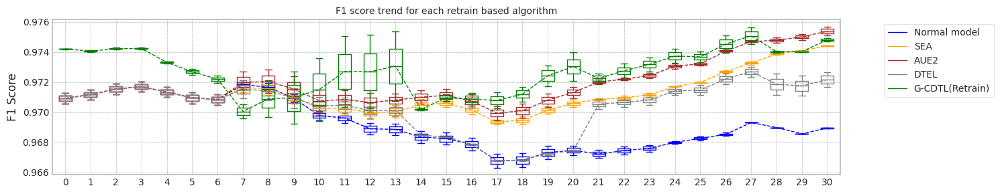

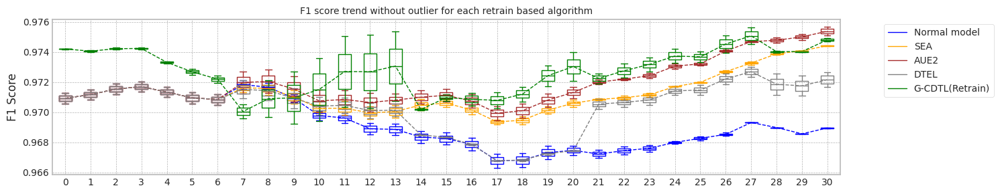

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.670932292938232
Base flops (train + inference flops of normal model, median): 5791640025.0


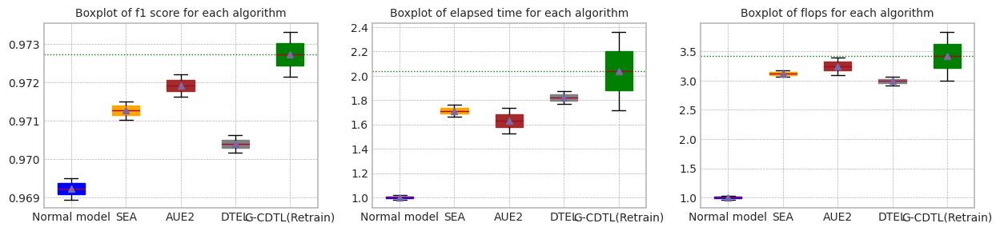

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.670932292938232


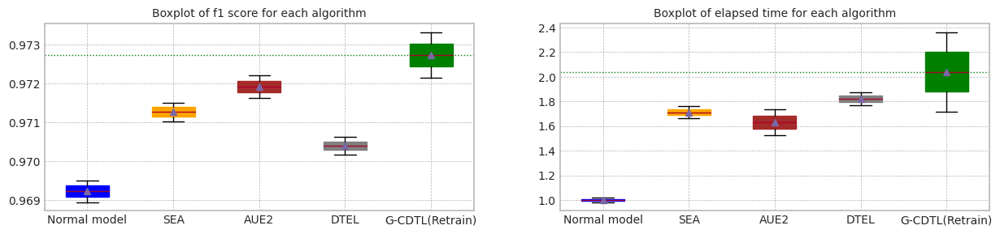

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,13.911102,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,13.430763,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,13.670932,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.339651,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.969801,0.967797,13.302860,1.400635e+10,1.297599e+09,1.530395e+10
1,1.0,0.974196,0.974007,0.968609,0.965362,13.245188,1.226575e+10,1.297599e+09,1.356335e+10
2,median,0.974212,0.974068,0.969205,0.966580,13.274024,1.313605e+10,1.297599e+09,1.443365e+10
3,std,0.000023,0.000086,0.000842,0.001722,0.040780,1.230794e+09,0.000000e+00,1.230794e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971026,0.974405,22.754763,8.200462e+09,9.558789e+09,1.775925e+10
1,1.0,0.971291,0.971524,0.971510,0.974443,24.071206,8.698972e+09,9.673968e+09,1.837294e+10
2,median,0.970932,0.971180,0.971268,0.974424,23.412985,8.449717e+09,9.616378e+09,1.806610e+10
3,std,0.000508,0.000487,0.000343,0.000027,0.930866,3.524998e+08,8.144345e+07,4.339433e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971623,0.975692,23.745068,9.033052e+09,1.064971e+10,1.968276e+10
1,1.0,0.971291,0.971524,0.972199,0.975094,20.877891,8.353582e+09,9.586910e+09,1.794049e+10
2,median,0.970932,0.971180,0.971911,0.975393,22.311479,8.693317e+09,1.011831e+10,1.881163e+10
3,std,0.000508,0.000487,0.000407,0.000423,2.027401,4.804578e+08,7.515142e+08,1.231972e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970177,0.972674,25.592610,9.660322e+09,8.103826e+09,1.776415e+10
1,1.0,0.971291,0.971524,0.970618,0.971668,24.224074,9.124402e+09,7.803144e+09,1.692755e+10
2,median,0.970932,0.971180,0.970397,0.972171,24.908342,9.392362e+09,7.953485e+09,1.734585e+10
3,std,0.000508,0.000487,0.000312,0.000711,0.967701,3.789527e+08,2.126140e+08,5.915666e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.972139,0.974918,23.484068,1.733541e+10,57183645.0,1.739259e+10
1,1.0,0.974196,0.974007,0.973318,0.974706,32.298706,2.217037e+10,57183645.0,2.222755e+10
2,median,0.974212,0.974068,0.972729,0.974812,27.891387,1.975289e+10,57183645.0,1.981007e+10
3,std,0.000023,0.000086,0.000834,0.000150,6.232890,3.418833e+09,0.0,3.418833e+09


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 700,
                                                            lambda_f2=0.8,trial_count=2,lr_g=0.004,
                                                            retrain_count=4,weight_init=True)

trial_count: 2
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 21:32:10,249] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:02<00:03, 333.37it/s]

Early stop: 686
[2023-12-03 21:32:12,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.32it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:32:25,757] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:32:25,759] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 16
min_bucket_num: 0.0


 16%|█▌        | 320/2000 [00:02<00:15, 106.77it/s]

[2023-12-03 21:32:28,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:32:28,888] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 10761444750 2674987695 14006353195
precision_recall_fscore: (array([0.96541418, 0.95432649]), array([0.74645097, 0.99497768]), array([0.84192888, 0.97422821]), array([ 3029, 16128]))
Test f1 score: 0.9742282123668154
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.36it/s]

mean of drift:
recoveries              0.862616
last_fico_range_high    0.188229
last_pymnt_amnt         0.503303
total_rec_late_fee      0.906720
int_rate                0.127641
dtype: float64
Mean F1 for all data: 0.9698005253083366
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9698005253083366
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 21:32:42,103] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 351.66it/s]

Early stop: 640
[2023-12-03 21:32:43,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.32it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:32:57,375] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:32:57,377] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 34
min_bucket_num: 0.0


 13%|█▎        | 264/2000 [00:02<00:16, 108.40it/s]

[2023-12-03 21:33:00,059] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:33:00,060] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1173366250 8884058750 2208323175 12265748175
precision_recall_fscore: (array([0.97224631, 0.95329654]), array([0.74017828, 0.99603175]), array([0.84048735, 0.9741957 ]), array([ 3029, 16128]))
Test f1 score: 0.9741957002941265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.34it/s]


mean of drift:
recoveries              0.864244
last_fico_range_high    0.210217
last_pymnt_amnt         0.507721
total_rec_late_fee      0.884880
int_rate                0.117158
dtype: float64
Mean F1 for all data: 0.9686091656985393
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9692048455034379
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:06<00:06,  2.30it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:33:20,317] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:33:20,320] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:33:22,788] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:33:22,789] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:09<00:17,  1.19s/it]

G-CDTL train flops: 94500000 924000000 229680000 1248180000


100%|██████████| 31/31 [00:15<00:00,  1.94it/s]


Early stop at  [263]
Train flops  [1248180000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716894235150251
G_CDTL+AUE median: 0.9716894235150251
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:11<00:25,  1.72s/it]

Ensemble_SEA train flops: 848250000


100%|██████████| 31/31 [00:17<00:00,  1.75it/s]


Early stop at  [974]
Train flops  [848250000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704310510892388
SEA median: 0.9704310510892388
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:13,  1.09it/s]

Ensemble_SEA train flops: 670770000


100%|██████████| 31/31 [00:15<00:00,  2.06it/s]


Early stop at  [770]
Train flops  [670770000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708867134498106
AUE median: 0.9708867134498106
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:16,  1.09s/it]

Ensemble_DTEL train flops: 888270000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:15<00:00,  1.99it/s]


Early stop at  [1020, 2]
Train flops  [888270000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9707083296140623
DTEL median: 0.9707083296140623
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:06<00:06,  2.38it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:34:24,677] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:34:24,679] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 20
min_bucket_num: 0.0
[2023-12-03 21:34:27,146] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:34:27,147] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:09<00:17,  1.17s/it]

G-CDTL train flops: 73500000 955500000 237510000 1266510000


100%|██████████| 31/31 [00:15<00:00,  1.95it/s]


Early stop at  [272]
Train flops  [1266510000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9718780007927523
G_CDTL+AUE median: 0.9717837121538887
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:15,  1.04s/it]

Ensemble_SEA train flops: 782130000


100%|██████████| 31/31 [00:15<00:00,  1.99it/s]


Early stop at  [898]
Train flops  [782130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712076238970014
SEA median: 0.9708193374931201
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:09<00:19,  1.33s/it]

Ensemble_SEA train flops: 1212780000


100%|██████████| 31/31 [00:16<00:00,  1.92it/s]


Early stop at  [1393]
Train flops  [1212780000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.971388370026293
AUE median: 0.9711375417380518
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:15,  1.06s/it]

Ensemble_DTEL train flops: 864780000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:15<00:00,  1.99it/s]


Early stop at  [993, 2]
Train flops  [864780000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713309061802787
DTEL median: 0.9710196178971705


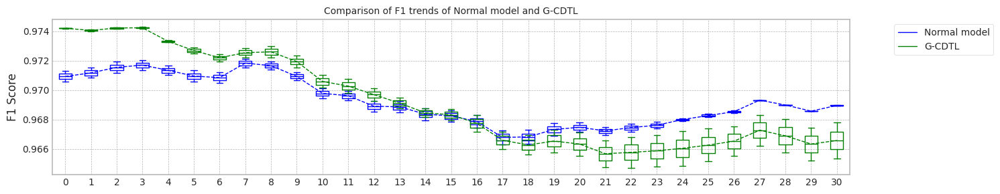

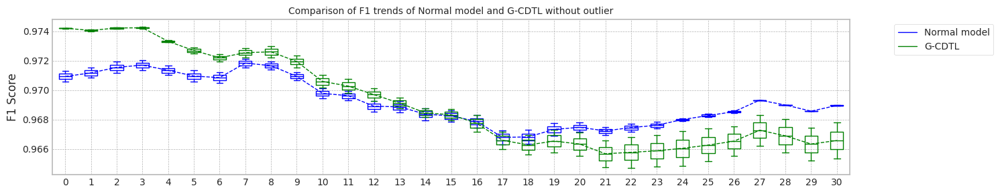

max_mean_trial= 0


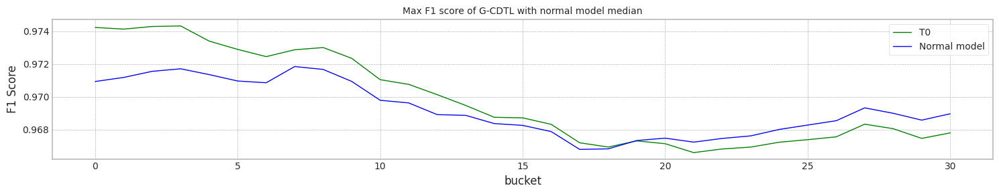

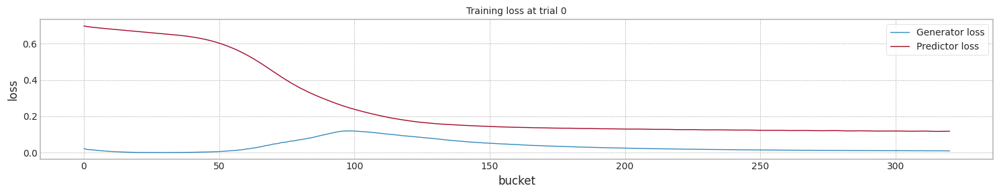

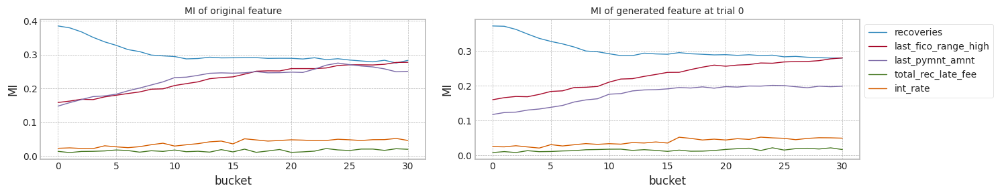

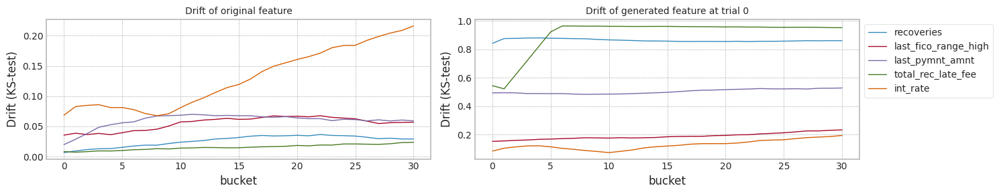

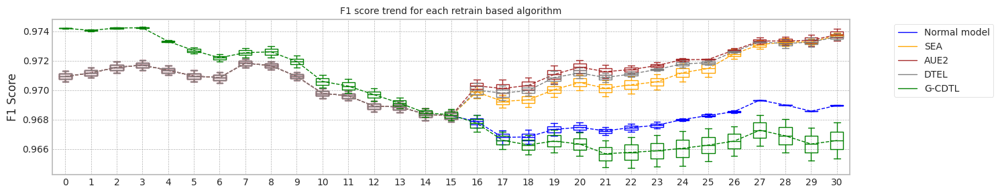

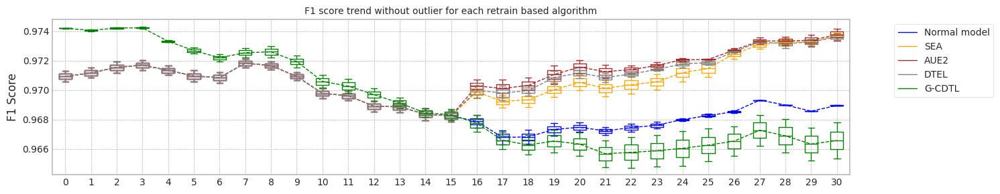

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.423284888267517
Base flops (inference flops of normal model, median): 258332145.0


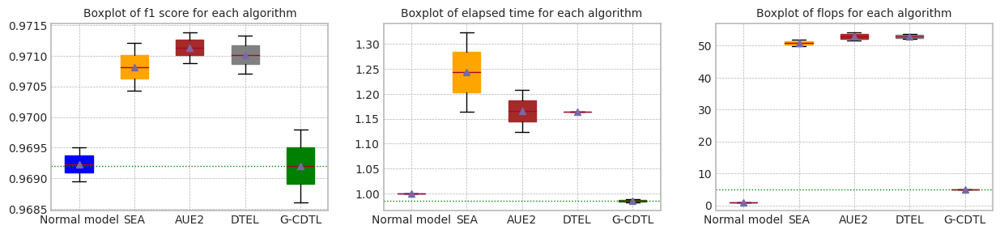

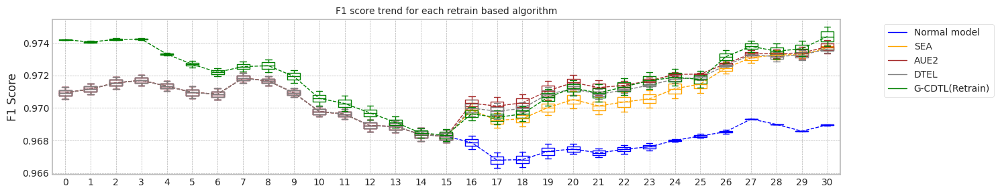

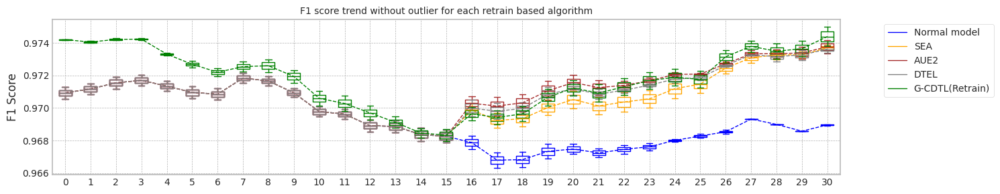

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.423284888267517
Base flops (train + inference flops of normal model, median): 5791640025.0


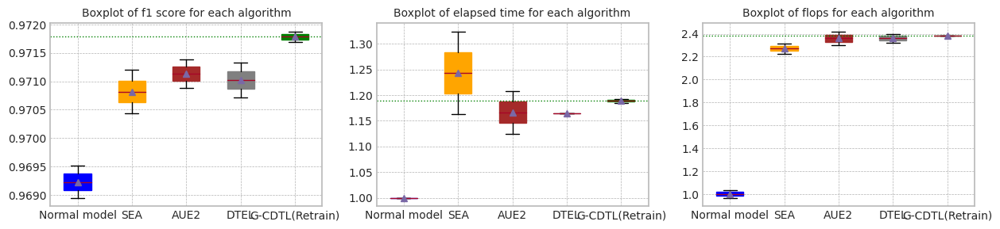

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.423284888267517


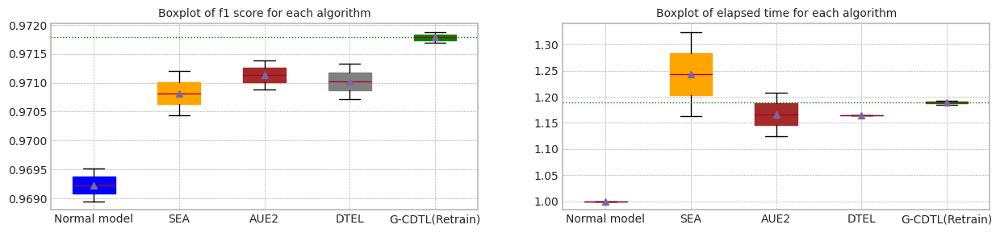

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,13.422594,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,13.423976,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,13.423285,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.000977,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.969801,0.967797,13.191017,1.400635e+10,1.297599e+09,1.530395e+10
1,1.0,0.974196,0.974007,0.968609,0.965362,13.277016,1.226575e+10,1.297599e+09,1.356335e+10
2,median,0.974212,0.974068,0.969205,0.966580,13.234017,1.313605e+10,1.297599e+09,1.443365e+10
3,std,0.000023,0.000086,0.000842,0.001722,0.060811,1.230794e+09,0.000000e+00,1.230794e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970431,0.973518,17.770034,6.189892e+09,7.223221e+09,1.341311e+10
1,1.0,0.971291,0.971524,0.971208,0.973904,15.614946,6.123772e+09,6.773769e+09,1.289754e+10
2,median,0.970932,0.971180,0.970819,0.973711,16.692490,6.156832e+09,6.998495e+09,1.315533e+10
3,std,0.000508,0.000487,0.000549,0.000273,1.523877,4.675390e+07,3.178103e+08,3.645642e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970887,0.974193,15.089656,6.012412e+09,7.304073e+09,1.331648e+10
1,1.0,0.971291,0.971524,0.971388,0.973356,16.217566,6.554422e+09,7.462751e+09,1.401717e+10
2,median,0.970932,0.971180,0.971138,0.973774,15.653611,6.283417e+09,7.383412e+09,1.366683e+10
3,std,0.000508,0.000487,0.000355,0.000591,0.797552,3.832589e+08,1.122026e+08,4.954615e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970708,0.973385,15.628561,6.232522e+09,7.657516e+09,1.389004e+10
1,1.0,0.971291,0.971524,0.971331,0.973867,15.620709,6.209032e+09,7.250694e+09,1.345973e+10
2,median,0.970932,0.971180,0.971020,0.973626,15.624635,6.220777e+09,7.454105e+09,1.367488e+10
3,std,0.000508,0.000487,0.000440,0.000341,0.005552,1.660994e+07,2.876663e+08,3.042762e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.971689,0.973796,16.010535,1.351393e+10,285918225.0,1.379985e+10
1,1.0,0.974196,0.974007,0.971878,0.975013,15.907029,1.353226e+10,285918225.0,1.381818e+10
2,median,0.974212,0.974068,0.971784,0.974404,15.958782,1.352309e+10,285918225.0,1.380901e+10
3,std,0.000023,0.000086,0.000133,0.000861,0.073190,1.296127e+07,0.0,1.296127e+07


trial_count: 2
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 21:35:34,687] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:02<00:04, 315.52it/s]

Early stop: 686
[2023-12-03 21:35:36,870] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.29it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:35:50,482] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:35:50,484] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 16
min_bucket_num: 0.0


 16%|█▌        | 320/2000 [00:03<00:15, 105.24it/s]

[2023-12-03 21:35:53,665] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:35:53,666] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 10761444750 2674987695 14006353195
precision_recall_fscore: (array([0.96541418, 0.95432649]), array([0.74645097, 0.99497768]), array([0.84192888, 0.97422821]), array([ 3029, 16128]))
Test f1 score: 0.9742282123668154
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.38it/s]

mean of drift:
recoveries              0.862616
last_fico_range_high    0.188229
last_pymnt_amnt         0.503303
total_rec_late_fee      0.906720
int_rate                0.127641
dtype: float64
Mean F1 for all data: 0.9698005253083366
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9698005253083366
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 21:36:06,777] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 346.02it/s]

Early stop: 640
[2023-12-03 21:36:08,634] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:36:22,114] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:36:22,117] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 34
min_bucket_num: 0.0


 13%|█▎        | 264/2000 [00:02<00:16, 104.87it/s]

[2023-12-03 21:36:24,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:36:24,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1173366250 8884058750 2208323175 12265748175
precision_recall_fscore: (array([0.97224631, 0.95329654]), array([0.74017828, 0.99603175]), array([0.84048735, 0.9741957 ]), array([ 3029, 16128]))
Test f1 score: 0.9741957002941265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.34it/s]


mean of drift:
recoveries              0.864244
last_fico_range_high    0.210217
last_pymnt_amnt         0.507721
total_rec_late_fee      0.884880
int_rate                0.117158
dtype: float64
Mean F1 for all data: 0.9686091656985393
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9692048455034379
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:04<00:09,  2.27it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:36:43,038] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:36:43,041] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:36:45,195] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:36:45,196] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:22,  1.10s/it]

G-CDTL train flops: 94500000 812000000 201840000 1108340000


 68%|██████▊   | 21/31 [00:11<00:04,  2.15it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:36:50,078] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:36:50,081] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 29
min_bucket_num: 0.0
[2023-12-03 21:36:52,308] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:36:52,309] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:14<00:10,  1.13s/it]

G-CDTL train flops: 105000000 833000000 207060000 1145060000


100%|██████████| 31/31 [00:18<00:00,  1.72it/s]


Early stop at  [231, 237]
Train flops  [1108340000, 1145060000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9725149950072037
G_CDTL+AUE median: 0.9725149950072037
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:17,  1.15it/s]

Ensemble_SEA train flops: 585510000


 71%|███████   | 22/31 [00:12<00:09,  1.06s/it]

Ensemble_SEA train flops: 799530000


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  [672, 918]
Train flops  [585510000, 799530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9705658267182677
SEA median: 0.9705658267182677
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:16,  1.25it/s]

Ensemble_SEA train flops: 470670000


 71%|███████   | 22/31 [00:13<00:10,  1.18s/it]

Ensemble_SEA train flops: 969180000


100%|██████████| 31/31 [00:17<00:00,  1.80it/s]


Early stop at  [540, 1113]
Train flops  [470670000, 969180000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708640720037569
AUE median: 0.9708640720037569
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:07<00:25,  1.28s/it]

Ensemble_DTEL train flops: 1137960000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:14<00:09,  1.06s/it]

Ensemble_DTEL train flops: 809970000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:18<00:00,  1.70it/s]


Early stop at  [1307, 1, 930, 1]
Train flops  [1137960000, 1740000, 809970000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9698597378586643
DTEL median: 0.9698597378586643
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:04<00:09,  2.29it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:37:53,638] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:37:53,640] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 24
min_bucket_num: 0.0
[2023-12-03 21:37:56,103] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:37:56,104] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:07<00:23,  1.19s/it]

G-CDTL train flops: 87500000 945000000 234900000 1267400000


 68%|██████▊   | 21/31 [00:11<00:04,  2.23it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:38:00,785] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:38:00,787] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 22
min_bucket_num: 0.0
[2023-12-03 21:38:03,239] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:38:03,241] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:14<00:10,  1.18s/it]

G-CDTL train flops: 80500000 959000000 238380000 1277880000


100%|██████████| 31/31 [00:18<00:00,  1.69it/s]


Early stop at  [269, 273]
Train flops  [1267400000, 1277880000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9727250308905268
G_CDTL+AUE median: 0.9726200129488652
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:17,  1.15it/s]

Ensemble_SEA train flops: 558540000


 71%|███████   | 22/31 [00:15<00:17,  1.92s/it]

Ensemble_SEA train flops: 628140000


100%|██████████| 31/31 [00:19<00:00,  1.57it/s]


Early stop at  [641, 721]
Train flops  [558540000, 628140000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.970911245086851
SEA median: 0.9707385359025593
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:07<00:25,  1.28s/it]

Ensemble_SEA train flops: 1104900000


 71%|███████   | 22/31 [00:16<00:15,  1.74s/it]

Ensemble_SEA train flops: 1740000000


100%|██████████| 31/31 [00:20<00:00,  1.50it/s]


Early stop at  [1269, 1999]
Train flops  [1104900000, 1740000000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712023197923523
AUE median: 0.9710331958980546
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:19,  1.02it/s]

Ensemble_DTEL train flops: 750810000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:13<00:09,  1.03s/it]

Ensemble_DTEL train flops: 782130000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  [862, 1, 898, 1]
Train flops  [750810000, 1740000, 782130000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704735127799214
DTEL median: 0.9701666253192929


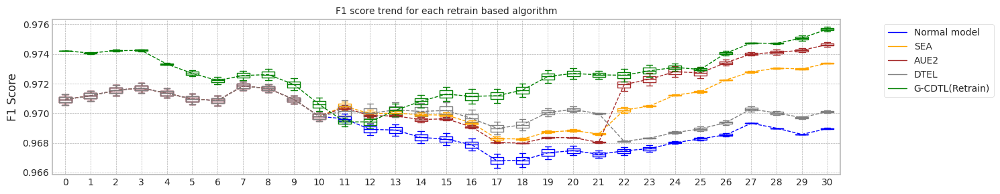

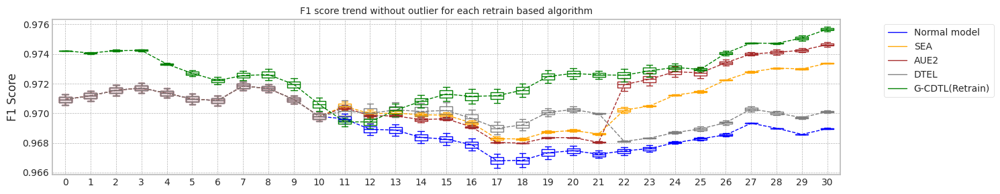

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.523056387901306
Base flops (train + inference flops of normal model, median): 5791640025.0


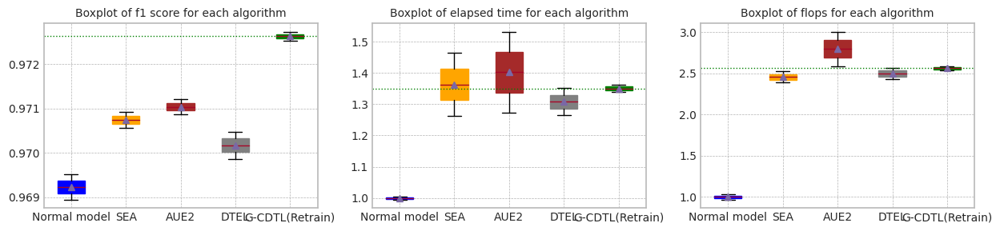

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.523056387901306


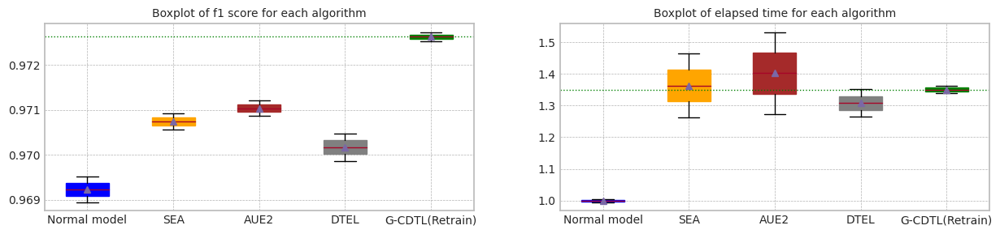

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,13.589560,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,13.456553,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,13.523056,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.094050,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.969801,0.967797,13.086206,1.400635e+10,1.297599e+09,1.530395e+10
1,1.0,0.974196,0.974007,0.968609,0.965362,13.280606,1.226575e+10,1.297599e+09,1.356335e+10
2,median,0.974212,0.974068,0.969205,0.966580,13.183406,1.313605e+10,1.297599e+09,1.443365e+10
3,std,0.000023,0.000086,0.000842,0.001722,0.137461,1.230794e+09,0.000000e+00,1.230794e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970566,0.973395,17.065304,6.726682e+09,7.876677e+09,1.460336e+10
1,1.0,0.971291,0.971524,0.970911,0.973351,19.805835,6.528322e+09,7.294985e+09,1.382331e+10
2,median,0.970932,0.971180,0.970739,0.973373,18.435570,6.627502e+09,7.585831e+09,1.421333e+10
3,std,0.000508,0.000487,0.000244,0.000031,1.937848,1.402617e+08,4.113181e+08,5.515798e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970864,0.974473,17.216048,6.781492e+09,8.189819e+09,1.497131e+10
1,1.0,0.971291,0.971524,0.971202,0.974798,20.717510,8.186542e+09,9.211537e+09,1.739808e+10
2,median,0.970932,0.971180,0.971033,0.974636,18.966779,7.484017e+09,8.700678e+09,1.618470e+10
3,std,0.000508,0.000487,0.000239,0.000230,2.475907,9.935204e+08,7.224640e+08,1.715984e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969860,0.970019,18.274153,7.293052e+09,7.580086e+09,1.487314e+10
1,1.0,0.971291,0.971524,0.970474,0.970208,17.099283,6.878062e+09,7.168914e+09,1.404698e+10
2,median,0.970932,0.971180,0.970167,0.970113,17.686718,7.085557e+09,7.374500e+09,1.446006e+10
3,std,0.000508,0.000487,0.000434,0.000134,0.830758,2.934422e+08,2.907422e+08,5.841844e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.972515,0.975846,18.096386,1.451915e+10,171550935.0,1.469070e+10
1,1.0,0.974196,0.974007,0.972725,0.975508,18.422136,1.481103e+10,171550935.0,1.498258e+10
2,median,0.974212,0.974068,0.972620,0.975677,18.259261,1.466509e+10,171550935.0,1.483664e+10
3,std,0.000023,0.000086,0.000149,0.000239,0.230340,2.063903e+08,0.0,2.063903e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 21:39:08,796] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:02<00:04, 323.03it/s]

Early stop: 686
[2023-12-03 21:39:10,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.27it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:39:24,619] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:39:24,622] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 16
min_bucket_num: 0.0


 16%|█▌        | 320/2000 [00:03<00:16, 100.16it/s]

[2023-12-03 21:39:27,952] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:39:27,954] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 10761444750 2674987695 14006353195
precision_recall_fscore: (array([0.96541418, 0.95432649]), array([0.74645097, 0.99497768]), array([0.84192888, 0.97422821]), array([ 3029, 16128]))
Test f1 score: 0.9742282123668154
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.35it/s]

mean of drift:
recoveries              0.862616
last_fico_range_high    0.188229
last_pymnt_amnt         0.503303
total_rec_late_fee      0.906720
int_rate                0.127641
dtype: float64
Mean F1 for all data: 0.9698005253083366
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9698005253083366
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 21:39:41,228] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:04, 324.40it/s]

Early stop: 640
[2023-12-03 21:39:43,208] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.28it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:39:56,883] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:39:56,885] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 34
min_bucket_num: 0.0


 13%|█▎        | 264/2000 [00:02<00:16, 102.71it/s]

[2023-12-03 21:39:59,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:39:59,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1173366250 8884058750 2208323175 12265748175
precision_recall_fscore: (array([0.97224631, 0.95329654]), array([0.74017828, 0.99603175]), array([0.84048735, 0.9741957 ]), array([ 3029, 16128]))
Test f1 score: 0.9741957002941265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]


mean of drift:
recoveries              0.864244
last_fico_range_high    0.210217
last_pymnt_amnt         0.507721
total_rec_late_fee      0.884880
int_rate                0.117158
dtype: float64
Mean F1 for all data: 0.9686091656985393
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9692048455034379
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:03<00:10,  2.24it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:40:16,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:40:16,731] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:40:19,255] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:40:19,257] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:06<00:28,  1.25s/it]

G-CDTL train flops: 94500000 941500000 234030000 1270030000


 48%|████▊     | 15/31 [00:09<00:08,  1.99it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:40:22,818] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:40:22,822] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 29
min_bucket_num: 0.0
[2023-12-03 21:40:25,228] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:40:25,230] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:12<00:18,  1.22s/it]

G-CDTL train flops: 105000000 882000000 219240000 1206240000


 74%|███████▍  | 23/31 [00:15<00:04,  1.99it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:40:28,753] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:40:28,755] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:40:31,129] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:40:31,130] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:17<00:08,  1.20s/it]

G-CDTL train flops: 94500000 878500000 218370000 1191370000


100%|██████████| 31/31 [00:21<00:00,  1.47it/s]


Early stop at  [268, 251, 250]
Train flops  [1270030000, 1206240000, 1191370000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721623473138562
G_CDTL+AUE median: 0.9721623473138562
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:06<00:32,  1.41s/it]

Ensemble_SEA train flops: 1204950000


 52%|█████▏    | 16/31 [00:15<00:34,  2.30s/it]

Ensemble_SEA train flops: 829980000


 77%|███████▋  | 24/31 [00:21<00:08,  1.18s/it]

Ensemble_SEA train flops: 834330000


100%|██████████| 31/31 [00:24<00:00,  1.25it/s]


Early stop at  [1384, 953, 958]
Train flops  [1204950000, 829980000, 834330000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713691910242813
SEA median: 0.9713691910242813
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:23,  1.04s/it]

Ensemble_SEA train flops: 728190000


 52%|█████▏    | 16/31 [00:10<00:13,  1.11it/s]

Ensemble_SEA train flops: 534180000


 77%|███████▋  | 24/31 [00:15<00:07,  1.02s/it]

Ensemble_SEA train flops: 696870000


100%|██████████| 31/31 [00:18<00:00,  1.63it/s]


Early stop at  [836, 613, 800]
Train flops  [728190000, 534180000, 696870000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711426732523949
AUE median: 0.9711426732523949
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:27,  1.18s/it]

Ensemble_DTEL train flops: 932640000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:08<00:07,  2.06it/s]

Ensemble_DTEL train flops: 783870000


 52%|█████▏    | 16/31 [00:11<00:19,  1.29s/it]

Ensemble_DTEL train flops: 284490000


 77%|███████▋  | 24/31 [00:17<00:06,  1.02it/s]

Ensemble_DTEL train flops: 632490000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:20<00:00,  1.53it/s]


Early stop at  [1071, 2, 900, 326, 726, 2]
Train flops  [932640000, 2610000, 783870000, 284490000, 632490000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9709881639156753
DTEL median: 0.9709881639156753
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:03<00:10,  2.33it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:41:41,759] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:41:41,762] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 18
min_bucket_num: 0.0
[2023-12-03 21:41:47,897] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:41:47,899] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:09<00:54,  2.39s/it]

G-CDTL train flops: 66500000 2317000000 575940000 2959440000


 48%|████▊     | 15/31 [00:12<00:09,  1.70it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:41:51,415] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:41:51,418] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 21
min_bucket_num: 0.0
[2023-12-03 21:41:54,893] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:41:54,895] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:16<00:23,  1.60s/it]

G-CDTL train flops: 77000000 1298500000 322770000 1698270000


 74%|███████▍  | 23/31 [00:19<00:04,  1.82it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:41:58,547] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:41:58,550] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 14
min_bucket_num: 0.0
[2023-12-03 21:42:01,703] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:42:01,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:23<00:10,  1.47s/it]

G-CDTL train flops: 52500000 1186500000 294930000 1533930000


100%|██████████| 31/31 [00:26<00:00,  1.17it/s]


Early stop at  [661, 370, 338]
Train flops  [2959440000, 1698270000, 1533930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9733627469013212
G_CDTL+AUE median: 0.9727625471075887
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:06<00:30,  1.32s/it]

Ensemble_SEA train flops: 1044870000


 52%|█████▏    | 16/31 [00:11<00:14,  1.06it/s]

Ensemble_SEA train flops: 581160000


 77%|███████▋  | 24/31 [00:17<00:09,  1.41s/it]

Ensemble_SEA train flops: 1217130000


100%|██████████| 31/31 [00:21<00:00,  1.47it/s]


Early stop at  [1200, 667, 1398]
Train flops  [1044870000, 581160000, 1217130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715993679389141
SEA median: 0.9714842794815977
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:09<00:52,  2.30s/it]

Ensemble_SEA train flops: 509820000


 52%|█████▏    | 16/31 [00:14<00:17,  1.15s/it]

Ensemble_SEA train flops: 764730000


 77%|███████▋  | 24/31 [00:20<00:07,  1.12s/it]

Ensemble_SEA train flops: 816060000


100%|██████████| 31/31 [00:23<00:00,  1.31it/s]


Early stop at  [585, 878, 937]
Train flops  [509820000, 764730000, 816060000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712542407310201
AUE median: 0.9711984569917075
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:19,  1.20it/s]

Ensemble_DTEL train flops: 503730000
Ensemble_DTEL train flops: 1740000


 52%|█████▏    | 16/31 [00:10<00:18,  1.24s/it]

Ensemble_DTEL train flops: 1026600000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:17<00:10,  1.49s/it]

Ensemble_DTEL train flops: 1273680000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:20<00:00,  1.50it/s]


Early stop at  [578, 1, 1179, 1, 1463, 1]
Train flops  [503730000, 1740000, 1026600000, 1740000, 1273680000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9697548341943903
DTEL median: 0.9703714990550328


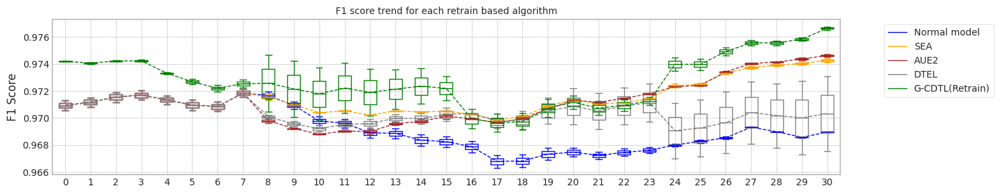

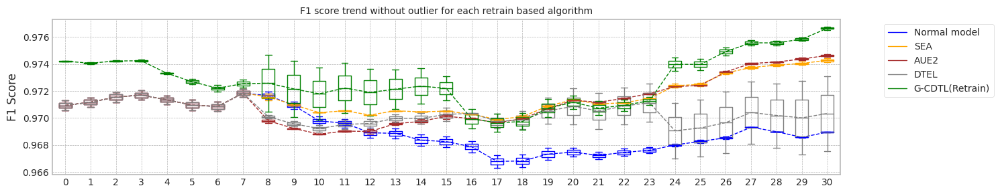

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.660956740379333
Base flops (train + inference flops of normal model, median): 5791640025.0


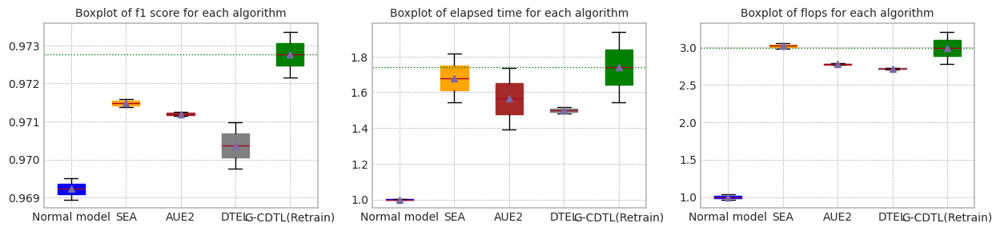

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.660956740379333


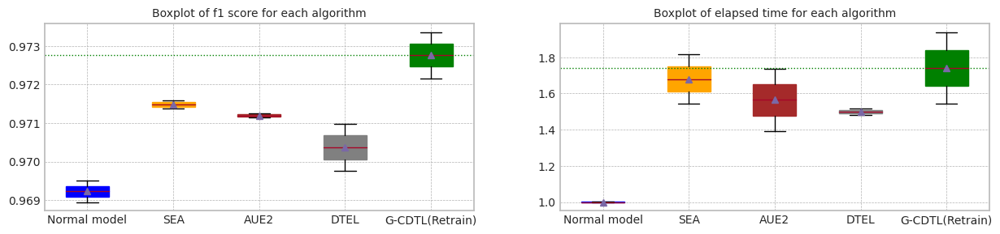

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,13.668898,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,13.653016,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,13.660957,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.011230,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.969801,0.967797,13.242102,1.400635e+10,1.297599e+09,1.530395e+10
1,1.0,0.974196,0.974007,0.968609,0.965362,13.438052,1.226575e+10,1.297599e+09,1.356335e+10
2,median,0.974212,0.974068,0.969205,0.966580,13.340077,1.313605e+10,1.297599e+09,1.443365e+10
3,std,0.000023,0.000086,0.000842,0.001722,0.138557,1.230794e+09,0.000000e+00,1.230794e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971369,0.974142,24.805635,8.210902e+09,9.494230e+09,1.770513e+10
1,1.0,0.971291,0.971524,0.971599,0.974424,21.100508,8.184802e+09,9.084798e+09,1.726960e+10
2,median,0.970932,0.971180,0.971484,0.974283,22.953071,8.197852e+09,9.289514e+09,1.748737e+10
3,std,0.000508,0.000487,0.000163,0.000199,2.619921,1.845549e+07,2.895118e+08,3.079673e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971143,0.974745,19.007407,7.300882e+09,8.842542e+09,1.614342e+10
1,1.0,0.971291,0.971524,0.971254,0.974540,23.746218,7.432252e+09,8.590580e+09,1.602283e+10
2,median,0.970932,0.971180,0.971198,0.974642,21.376812,7.366567e+09,8.716561e+09,1.608313e+10
3,std,0.000508,0.000487,0.000079,0.000145,3.350846,9.289262e+07,1.781637e+08,8.527112e+07


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970988,0.973120,20.231524,7.980352e+09,7.688836e+09,1.566919e+10
1,1.0,0.971291,0.971524,0.969755,0.967562,20.733111,8.150872e+09,7.662204e+09,1.581308e+10
2,median,0.970932,0.971180,0.970371,0.970341,20.482318,8.065612e+09,7.675520e+09,1.574113e+10
3,std,0.000508,0.000487,0.000872,0.003931,0.354676,1.205758e+08,1.883136e+07,1.017445e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.972162,0.976533,21.077966,1.593339e+10,133428505.0,1.606682e+10
1,1.0,0.974196,0.974007,0.973363,0.976771,26.495798,1.845739e+10,133428505.0,1.859082e+10
2,median,0.974212,0.974068,0.972763,0.976652,23.786882,1.719539e+10,133428505.0,1.732882e+10
3,std,0.000023,0.000086,0.000849,0.000169,3.830986,1.784738e+09,0.0,1.784738e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 21:43:14,293] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:02<00:04, 316.59it/s]

Early stop: 686
[2023-12-03 21:43:16,468] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:43:29,977] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:43:29,981] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 16
min_bucket_num: 0.0


 16%|█▌        | 320/2000 [00:03<00:17, 97.14it/s]

[2023-12-03 21:43:33,419] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:43:33,421] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 10761444750 2674987695 14006353195
precision_recall_fscore: (array([0.96541418, 0.95432649]), array([0.74645097, 0.99497768]), array([0.84192888, 0.97422821]), array([ 3029, 16128]))
Test f1 score: 0.9742282123668154
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]

mean of drift:
recoveries              0.862616
last_fico_range_high    0.188229
last_pymnt_amnt         0.503303
total_rec_late_fee      0.906720
int_rate                0.127641
dtype: float64
Mean F1 for all data: 0.9698005253083366
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9698005253083366
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 21:43:46,928] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:02<00:04, 319.73it/s]

Early stop: 640
[2023-12-03 21:43:48,936] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.32it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:44:02,341] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:44:02,343] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 34
min_bucket_num: 0.0


 13%|█▎        | 264/2000 [00:02<00:17, 101.01it/s]

[2023-12-03 21:44:05,215] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:44:05,216] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1173366250 8884058750 2208323175 12265748175
precision_recall_fscore: (array([0.97224631, 0.95329654]), array([0.74017828, 0.99603175]), array([0.84048735, 0.9741957 ]), array([ 3029, 16128]))
Test f1 score: 0.9741957002941265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.30it/s]


mean of drift:
recoveries              0.864244
last_fico_range_high    0.210217
last_pymnt_amnt         0.507721
total_rec_late_fee      0.884880
int_rate                0.117158
dtype: float64
Mean F1 for all data: 0.9686091656985393
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9692048455034379
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:10,  2.34it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:44:21,810] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:44:21,813] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:44:24,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:44:24,372] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:05<00:30,  1.27s/it]

G-CDTL train flops: 94500000 927500000 230550000 1252550000


 42%|████▏     | 13/31 [00:08<00:09,  1.89it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:44:27,432] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:44:27,436] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 29
min_bucket_num: 0.0
[2023-12-03 21:44:29,944] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:44:29,945] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:11<00:21,  1.26s/it]

G-CDTL train flops: 105000000 896000000 222720000 1223720000


 65%|██████▍   | 20/31 [00:13<00:05,  1.87it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:44:33,018] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:44:33,021] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 27
min_bucket_num: 0.0
[2023-12-03 21:44:35,491] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:44:35,493] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:16<00:12,  1.25s/it]

G-CDTL train flops: 98000000 903000000 224460000 1225460000


 87%|████████▋ | 27/31 [00:19<00:02,  1.84it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:44:38,648] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:44:38,651] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 29
min_bucket_num: 0.0
[2023-12-03 21:44:41,541] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:44:41,542] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:22<00:04,  1.39s/it]

G-CDTL train flops: 105000000 1011500000 251430000 1367930000


100%|██████████| 31/31 [00:24<00:00,  1.29it/s]


Early stop at  [264, 255, 257, 288]
Train flops  [1252550000, 1223720000, 1225460000, 1367930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721391975402077
G_CDTL+AUE median: 0.9721391975402077
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:28,  1.18s/it]

Ensemble_SEA train flops: 879570000


 45%|████▌     | 14/31 [00:09<00:13,  1.28it/s]

Ensemble_SEA train flops: 372360000


 68%|██████▊   | 21/31 [00:14<00:09,  1.01it/s]

Ensemble_SEA train flops: 643800000


 90%|█████████ | 28/31 [00:19<00:03,  1.26s/it]

Ensemble_SEA train flops: 963090000


100%|██████████| 31/31 [00:21<00:00,  1.47it/s]


Early stop at  [1010, 427, 739, 1106]
Train flops  [879570000, 372360000, 643800000, 963090000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710255193220678
SEA median: 0.9710255193220678
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:28,  1.20s/it]

Ensemble_SEA train flops: 878700000


 45%|████▌     | 14/31 [00:10<00:17,  1.01s/it]

Ensemble_SEA train flops: 672510000


 68%|██████▊   | 21/31 [00:21<00:31,  3.11s/it]

Ensemble_SEA train flops: 1145790000


 90%|█████████ | 28/31 [00:27<00:04,  1.44s/it]

Ensemble_SEA train flops: 994410000


100%|██████████| 31/31 [00:28<00:00,  1.07it/s]


Early stop at  [1009, 772, 1316, 1142]
Train flops  [878700000, 672510000, 1145790000, 994410000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716229351529815
AUE median: 0.9716229351529815
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:06<00:36,  1.52s/it]

Ensemble_DTEL train flops: 1271070000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:12<00:24,  1.47s/it]

Ensemble_DTEL train flops: 1236270000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:16<00:09,  1.09it/s]

Ensemble_DTEL train flops: 474150000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:23<00:04,  1.50s/it]

Ensemble_DTEL train flops: 1330230000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:24<00:00,  1.25it/s]


Early stop at  [1460, 1, 1420, 1, 544, 1, 1528, 1]
Train flops  [1271070000, 1740000, 1236270000, 1740000, 474150000, 1740000, 1330230000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9701765674663698
DTEL median: 0.9701765674663698
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:10,  2.33it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:46:00,773] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:46:00,776] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 32
min_bucket_num: 0.0
[2023-12-03 21:46:08,862] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:46:08,863] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:11<01:13,  3.08s/it]

G-CDTL train flops: 115500000 2954000000 734280000 3803780000


 42%|████▏     | 13/31 [00:13<00:12,  1.39it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:46:11,882] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:46:11,885] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 14
min_bucket_num: 0.0
[2023-12-03 21:46:17,382] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:46:17,384] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:19<00:39,  2.30s/it]

G-CDTL train flops: 52500000 1991500000 495030000 2539030000


 65%|██████▍   | 20/31 [00:22<00:07,  1.48it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:46:20,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:46:20,578] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 40
min_bucket_num: 0.0
[2023-12-03 21:46:23,590] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:46:23,591] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:25<00:15,  1.51s/it]

G-CDTL train flops: 143500000 1022000000 254040000 1419540000


 87%|████████▋ | 27/31 [00:28<00:02,  1.75it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:46:26,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:46:26,754] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 23
min_bucket_num: 0.0
[2023-12-03 21:46:31,435] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:46:31,437] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:33<00:05,  1.95s/it]

G-CDTL train flops: 84000000 1648500000 409770000 2142270000


100%|██████████| 31/31 [00:34<00:00,  1.13s/it]


Early stop at  [843, 568, 291, 470]
Train flops  [3803780000, 2539030000, 1419540000, 2142270000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9733184183140098
G_CDTL+AUE median: 0.9727288079271088
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:28,  1.20s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 14/31 [00:10<00:19,  1.13s/it]

Ensemble_SEA train flops: 771690000


 68%|██████▊   | 21/31 [00:15<00:12,  1.22s/it]

Ensemble_SEA train flops: 893490000


 90%|█████████ | 28/31 [00:21<00:03,  1.18s/it]

Ensemble_SEA train flops: 822150000


100%|██████████| 31/31 [00:22<00:00,  1.37it/s]


Early stop at  [999, 886, 1026, 944]
Train flops  [870000000, 771690000, 893490000, 822150000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715103974730905
SEA median: 0.9712679583975792
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:27,  1.15s/it]

Ensemble_SEA train flops: 823890000


 45%|████▌     | 14/31 [00:10<00:18,  1.07s/it]

Ensemble_SEA train flops: 736890000


 68%|██████▊   | 21/31 [00:14<00:08,  1.14it/s]

Ensemble_SEA train flops: 452400000


 90%|█████████ | 28/31 [00:27<00:10,  3.38s/it]

Ensemble_SEA train flops: 998760000


100%|██████████| 31/31 [00:28<00:00,  1.08it/s]


Early stop at  [946, 846, 519, 1147]
Train flops  [823890000, 736890000, 452400000, 998760000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721987849135504
AUE median: 0.971910860033266
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:26,  1.12s/it]

Ensemble_DTEL train flops: 796920000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:10<00:18,  1.09s/it]

Ensemble_DTEL train flops: 773430000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:15<00:11,  1.15s/it]

Ensemble_DTEL train flops: 792570000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:22<00:04,  1.63s/it]

Ensemble_DTEL train flops: 1412880000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:23<00:00,  1.31it/s]


Early stop at  [915, 1, 888, 1, 910, 1, 1623, 1]
Train flops  [796920000, 1740000, 773430000, 1740000, 792570000, 1740000, 1412880000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9706180120334442
DTEL median: 0.970397289749907


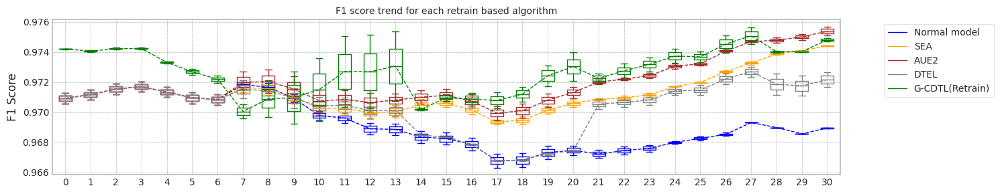

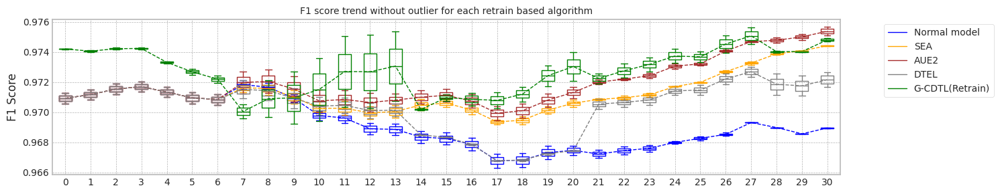

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.432822823524475
Base flops (train + inference flops of normal model, median): 5791640025.0


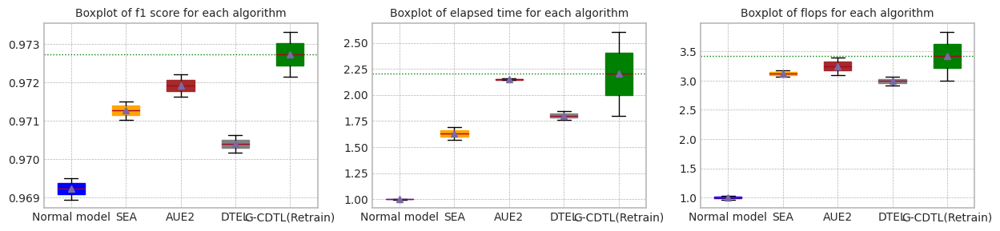

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.432822823524475


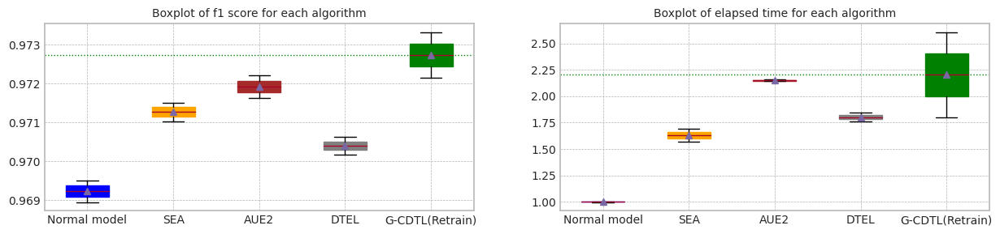

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,13.483790,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,13.381855,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,13.432823,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.072079,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.969801,0.967797,13.478588,1.400635e+10,1.297599e+09,1.530395e+10
1,1.0,0.974196,0.974007,0.968609,0.965362,13.533235,1.226575e+10,1.297599e+09,1.356335e+10
2,median,0.974212,0.974068,0.969205,0.966580,13.505912,1.313605e+10,1.297599e+09,1.443365e+10
3,std,0.000023,0.000086,0.000842,0.001722,0.038641,1.230794e+09,0.000000e+00,1.230794e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971026,0.974405,21.119127,8.200462e+09,9.558789e+09,1.775925e+10
1,1.0,0.971291,0.971524,0.971510,0.974443,22.688321,8.698972e+09,9.673968e+09,1.837294e+10
2,median,0.970932,0.971180,0.971268,0.974424,21.903724,8.449717e+09,9.616378e+09,1.806610e+10
3,std,0.000508,0.000487,0.000343,0.000027,1.109588,3.524998e+08,8.144345e+07,4.339433e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971623,0.975692,28.971630,9.033052e+09,1.064971e+10,1.968276e+10
1,1.0,0.971291,0.971524,0.972199,0.975094,28.753344,8.353582e+09,9.586910e+09,1.794049e+10
2,median,0.970932,0.971180,0.971911,0.975393,28.862487,8.693317e+09,1.011831e+10,1.881163e+10
3,std,0.000508,0.000487,0.000407,0.000423,0.154352,4.804578e+08,7.515142e+08,1.231972e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970177,0.972674,24.740102,9.660322e+09,8.103826e+09,1.776415e+10
1,1.0,0.971291,0.971524,0.970618,0.971668,23.633656,9.124402e+09,7.803144e+09,1.692755e+10
2,median,0.970932,0.971180,0.970397,0.972171,24.186879,9.392362e+09,7.953485e+09,1.734585e+10
3,std,0.000508,0.000487,0.000312,0.000711,0.782375,3.789527e+08,2.126140e+08,5.915666e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.972139,0.974918,24.130713,1.733541e+10,57183645.0,1.739259e+10
1,1.0,0.974196,0.974007,0.973318,0.974706,35.023656,2.217037e+10,57183645.0,2.222755e+10
2,median,0.974212,0.974068,0.972729,0.974812,29.577185,1.975289e+10,57183645.0,1.981007e+10
3,std,0.000023,0.000086,0.000834,0.000150,7.702474,3.418833e+09,0.0,3.418833e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-12-03 21:47:51,908] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:02<00:04, 292.65it/s]

Early stop: 686
[2023-12-03 21:47:54,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.31it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:48:07,722] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:48:07,726] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 16
min_bucket_num: 0.0


 16%|█▌        | 320/2000 [00:03<00:17, 95.40it/s]

[2023-12-03 21:48:11,216] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-12-03 21:48:11,218] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 569920750 10761444750 2674987695 14006353195
precision_recall_fscore: (array([0.96541418, 0.95432649]), array([0.74645097, 0.99497768]), array([0.84192888, 0.97422821]), array([ 3029, 16128]))
Test f1 score: 0.9742282123668154
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.34it/s]

mean of drift:
recoveries              0.862616
last_fico_range_high    0.188229
last_pymnt_amnt         0.503303
total_rec_late_fee      0.906720
int_rate                0.127641
dtype: float64
Mean F1 for all data: 0.9698005253083366
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9698005253083366
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-12-03 21:48:24,534] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:04, 327.37it/s]

Early stop: 640
[2023-12-03 21:48:26,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.32it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-03 21:48:39,910] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:48:39,912] [INFO] [profiler.py:80:start_profile] Flops profiler started


Generator pre-train early stop: 34
min_bucket_num: 0.0


 13%|█▎        | 264/2000 [00:02<00:18, 95.67it/s]

[2023-12-03 21:48:42,946] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:48:42,948] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1173366250 8884058750 2208323175 12265748175
precision_recall_fscore: (array([0.97224631, 0.95329654]), array([0.74017828, 0.99603175]), array([0.84048735, 0.9741957 ]), array([ 3029, 16128]))
Test f1 score: 0.9741957002941265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:13<00:00,  2.33it/s]


mean of drift:
recoveries              0.864244
last_fico_range_high    0.210217
last_pymnt_amnt         0.507721
total_rec_late_fee      0.884880
int_rate                0.117158
dtype: float64
Mean F1 for all data: 0.9686091656985393
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9692048455034379
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:02<00:11,  2.29it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:48:58,933] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:48:58,935] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 26
min_bucket_num: 0.0
[2023-12-03 21:49:01,959] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:49:01,961] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:05<00:36,  1.47s/it]

G-CDTL train flops: 94500000 1053500000 261870000 1409870000


 35%|███▌      | 11/31 [00:07<00:11,  1.74it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:49:04,463] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:49:04,466] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 30
min_bucket_num: 0.0
[2023-12-03 21:49:07,132] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:49:07,133] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:10<00:25,  1.34s/it]

G-CDTL train flops: 108500000 920500000 228810000 1257810000


 55%|█████▍    | 17/31 [00:12<00:08,  1.72it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:49:09,712] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:49:09,715] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 28
min_bucket_num: 0.0
[2023-12-03 21:49:12,555] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:49:12,557] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:16<00:18,  1.39s/it]

G-CDTL train flops: 101500000 969500000 240990000 1311990000


 74%|███████▍  | 23/31 [00:18<00:04,  1.67it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:49:15,228] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:49:15,230] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 28
min_bucket_num: 0.0
[2023-12-03 21:49:18,516] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:49:18,518] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:22<00:10,  1.54s/it]

G-CDTL train flops: 101500000 1141000000 283620000 1526120000


 94%|█████████▎| 29/31 [00:24<00:01,  1.60it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:49:21,169] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:49:21,172] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 22
min_bucket_num: 0.0
[2023-12-03 21:49:24,206] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:49:24,207] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:27<00:01,  1.48s/it]

G-CDTL train flops: 80500000 1078000000 267960000 1426460000


100%|██████████| 31/31 [00:28<00:00,  1.09it/s]


Early stop at  [300, 262, 276, 325, 307]
Train flops  [1409870000, 1257810000, 1311990000, 1526120000, 1426460000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9725397170099627
G_CDTL+AUE median: 0.9725397170099627
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:04<00:25,  1.02s/it]

Ensemble_SEA train flops: 650760000


 39%|███▊      | 12/31 [00:09<00:22,  1.16s/it]

Ensemble_SEA train flops: 857820000


 58%|█████▊    | 18/31 [00:13<00:15,  1.22s/it]

Ensemble_SEA train flops: 876960000


 77%|███████▋  | 24/31 [00:18<00:08,  1.18s/it]

Ensemble_SEA train flops: 796050000


 97%|█████████▋| 30/31 [00:23<00:01,  1.26s/it]

Ensemble_SEA train flops: 903930000


100%|██████████| 31/31 [00:24<00:00,  1.28it/s]


Early stop at  [747, 985, 1007, 914, 1038]
Train flops  [650760000, 857820000, 876960000, 796050000, 903930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711175965760679
SEA median: 0.9711175965760679
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:06<00:46,  1.85s/it]

Ensemble_SEA train flops: 1557300000


 39%|███▊      | 12/31 [00:10<00:19,  1.02s/it]

Ensemble_SEA train flops: 555930000


 58%|█████▊    | 18/31 [00:16<00:17,  1.32s/it]

Ensemble_SEA train flops: 1010070000


 77%|███████▋  | 24/31 [00:20<00:07,  1.13s/it]

Ensemble_SEA train flops: 716010000


 97%|█████████▋| 30/31 [00:25<00:01,  1.33s/it]

Ensemble_SEA train flops: 995280000


100%|██████████| 31/31 [00:26<00:00,  1.17it/s]


Early stop at  [1789, 638, 1160, 822, 1143]
Train flops  [1557300000, 555930000, 1010070000, 716010000, 995280000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712888666969133
AUE median: 0.9712888666969133
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:13<01:39,  3.98s/it]

Ensemble_DTEL train flops: 662940000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:17<00:29,  1.54s/it]

Ensemble_DTEL train flops: 910020000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:24<00:24,  1.87s/it]

Ensemble_DTEL train flops: 1636470000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:29<00:09,  1.31s/it]

Ensemble_DTEL train flops: 866520000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:35<00:01,  1.38s/it]

Ensemble_DTEL train flops: 1030950000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:35<00:00,  1.15s/it]


Early stop at  [761, 1, 1045, 1, 1880, 1, 995, 2, 1184, 2]
Train flops  [662940000, 1740000, 910020000, 1740000, 1636470000, 1740000, 866520000, 2610000, 1030950000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9696813476817351
DTEL median: 0.9696813476817351
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:02<00:10,  2.40it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:50:53,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:50:53,841] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 23
min_bucket_num: 0.0
[2023-12-03 21:50:56,824] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:50:56,825] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:05<00:35,  1.44s/it]

G-CDTL train flops: 84000000 1032500000 256650000 1373150000


 35%|███▌      | 11/31 [00:07<00:11,  1.72it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:50:59,392] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:50:59,394] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 22
min_bucket_num: 0.0
[2023-12-03 21:51:02,212] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:51:02,213] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:10<00:26,  1.40s/it]

G-CDTL train flops: 80500000 948500000 235770000 1264770000


 55%|█████▍    | 17/31 [00:13<00:08,  1.70it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:51:04,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:51:04,791] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 22
min_bucket_num: 0.0
[2023-12-03 21:51:08,293] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:51:08,295] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:16<00:20,  1.60s/it]

G-CDTL train flops: 80500000 1228500000 305370000 1614370000


 74%|███████▍  | 23/31 [00:19<00:05,  1.59it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:51:10,918] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:51:10,920] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 16
min_bucket_num: 0.0
[2023-12-03 21:51:13,739] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:51:13,741] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:22<00:09,  1.42s/it]

G-CDTL train flops: 59500000 966000000 240120000 1265620000


 94%|█████████▎| 29/31 [00:24<00:01,  1.63it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-03 21:51:16,446] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-03 21:51:16,449] [INFO] [profiler.py:80:start_profile] Flops profiler started
Generator pre-train early stop: 12
min_bucket_num: 0.0
[2023-12-03 21:51:22,032] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-03 21:51:22,033] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:30<00:02,  2.24s/it]

G-CDTL train flops: 45500000 1998500000 496770000 2540770000


100%|██████████| 31/31 [00:31<00:00,  1.01s/it]


Early stop at  [294, 270, 350, 275, 570]
Train flops  [1373150000, 1264770000, 1614370000, 1265620000, 2540770000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9727516941844015
G_CDTL+AUE median: 0.9726457055971821
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:04<00:24,  1.01it/s]

Ensemble_SEA train flops: 590730000


 39%|███▊      | 12/31 [00:09<00:23,  1.23s/it]

Ensemble_SEA train flops: 897840000


 58%|█████▊    | 18/31 [00:14<00:18,  1.46s/it]

Ensemble_SEA train flops: 1156230000


 77%|███████▋  | 24/31 [00:19<00:08,  1.27s/it]

Ensemble_SEA train flops: 856950000


 97%|█████████▋| 30/31 [00:24<00:01,  1.10s/it]

Ensemble_SEA train flops: 683820000


100%|██████████| 31/31 [00:24<00:00,  1.25it/s]


Early stop at  [678, 1031, 1328, 984, 785]
Train flops  [590730000, 897840000, 1156230000, 856950000, 683820000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715388974373196
SEA median: 0.9713282470066937
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:05<00:35,  1.41s/it]

Ensemble_SEA train flops: 1054440000


 39%|███▊      | 12/31 [00:11<00:28,  1.52s/it]

Ensemble_SEA train flops: 1181460000


 58%|█████▊    | 18/31 [00:15<00:15,  1.20s/it]

Ensemble_SEA train flops: 789090000


 77%|███████▋  | 24/31 [00:20<00:08,  1.19s/it]

Ensemble_SEA train flops: 809970000


 97%|█████████▋| 30/31 [00:25<00:01,  1.04s/it]

Ensemble_SEA train flops: 625530000


100%|██████████| 31/31 [00:25<00:00,  1.21it/s]


Early stop at  [1211, 1357, 906, 930, 718]
Train flops  [1054440000, 1181460000, 789090000, 809970000, 625530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9580149166477061
AUE median: 0.9646518916723097
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:04<00:26,  1.05s/it]

Ensemble_DTEL train flops: 688170000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:09<00:26,  1.42s/it]

Ensemble_DTEL train flops: 1101420000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:14<00:15,  1.17s/it]

Ensemble_DTEL train flops: 787350000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:30<00:31,  4.44s/it]

Ensemble_DTEL train flops: 970050000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:35<00:01,  1.74s/it]

Ensemble_DTEL train flops: 1006590000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:36<00:00,  1.16s/it]


Early stop at  [790, 1, 1265, 1, 904, 1, 1114, 2, 1156, 2]
Train flops  [688170000, 1740000, 1101420000, 1740000, 787350000, 1740000, 970050000, 2610000, 1006590000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704439393300356
DTEL median: 0.9700626435058853


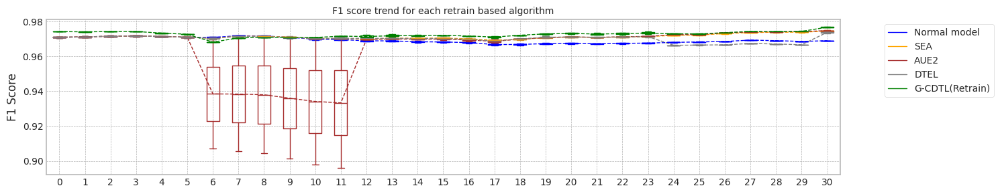

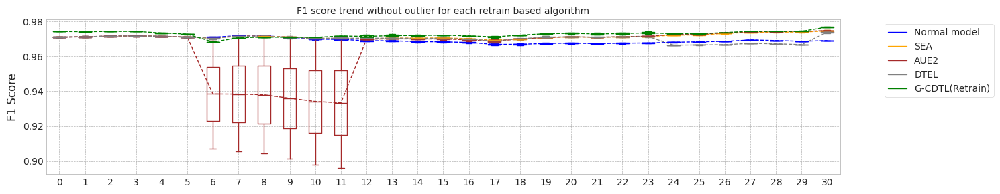

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.416207313537598
Base flops (train + inference flops of normal model, median): 5791640025.0


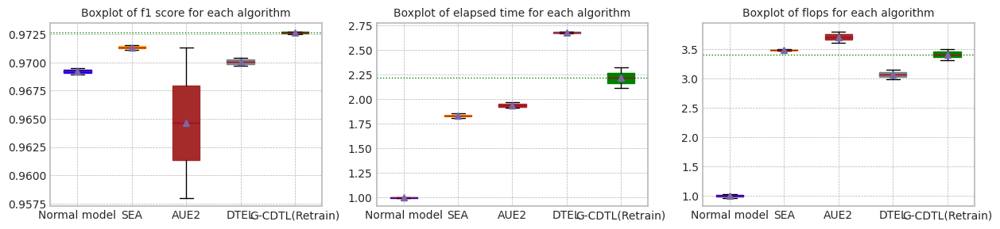

Base elapsed time (inference elapsed time of normal model, median (ms)): 13.416207313537598


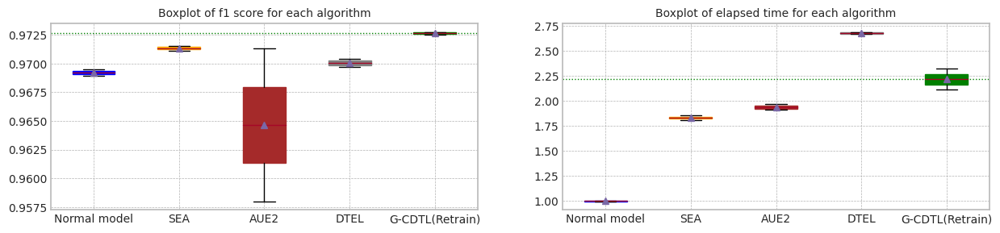

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,13.440079,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,13.392336,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,13.416207,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.033760,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.969801,0.967797,13.289429,1.400635e+10,1.297599e+09,1.530395e+10
1,1.0,0.974196,0.974007,0.968609,0.965362,13.324970,1.226575e+10,1.297599e+09,1.356335e+10
2,median,0.974212,0.974068,0.969205,0.966580,13.307200,1.313605e+10,1.297599e+09,1.443365e+10
3,std,0.000023,0.000086,0.000842,0.001722,0.025132,1.230794e+09,0.000000e+00,1.230794e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971118,0.974161,24.300436,9.427162e+09,1.087716e+10,2.030432e+10
1,1.0,0.971291,0.971524,0.971539,0.974868,24.875081,9.527212e+09,1.059387e+10,2.012109e+10
2,median,0.970932,0.971180,0.971328,0.974515,24.587759,9.477187e+09,1.073551e+10,2.021270e+10
3,std,0.000508,0.000487,0.000298,0.000500,0.406336,7.074603e+07,2.003103e+08,1.295643e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971289,0.974603,26.467505,1.017623e+10,1.188456e+10,2.206079e+10
1,1.0,0.971291,0.971524,0.958015,0.974947,25.637353,9.802132e+09,1.112713e+10,2.092926e+10
2,median,0.970932,0.971180,0.964652,0.974775,26.052429,9.989182e+09,1.150584e+10,2.149502e+10
3,std,0.000508,0.000487,0.009386,0.000243,0.587006,2.645286e+08,5.355850e+08,8.001136e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969681,0.973311,35.831258,1.045898e+10,7.808026e+09,1.826701e+10
1,1.0,0.971291,0.971524,0.970444,0.974352,36.108150,9.905662e+09,7.400334e+09,1.730600e+10
2,median,0.970932,0.971180,0.970063,0.973832,35.969704,1.018232e+10,7.604180e+09,1.778650e+10
3,std,0.000508,0.000487,0.000539,0.000736,0.195793,3.912563e+08,2.882815e+08,6.795378e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.974228,0.974128,0.972540,0.976452,28.388893,1.919800e+10,19061215.0,1.921706e+10
1,1.0,0.974196,0.974007,0.972752,0.977022,31.200272,2.032443e+10,19061215.0,2.034349e+10
2,median,0.974212,0.974068,0.972646,0.976737,29.794582,1.976121e+10,19061215.0,1.978027e+10
3,std,0.000023,0.000086,0.000150,0.000403,1.987945,7.965063e+08,0.0,7.965063e+08


Test F1 Score: 0.9709319896192645
G-CDTL, 1-retrain: 0.9717837121538887


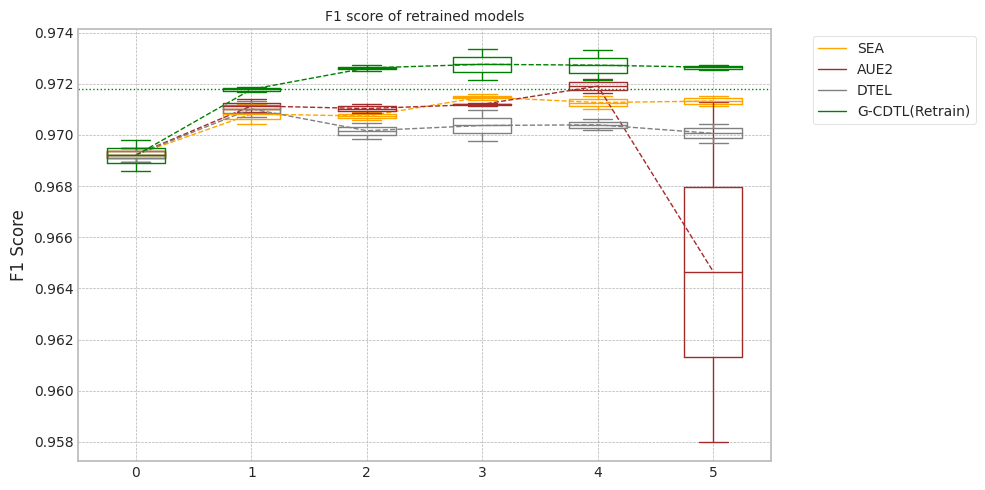

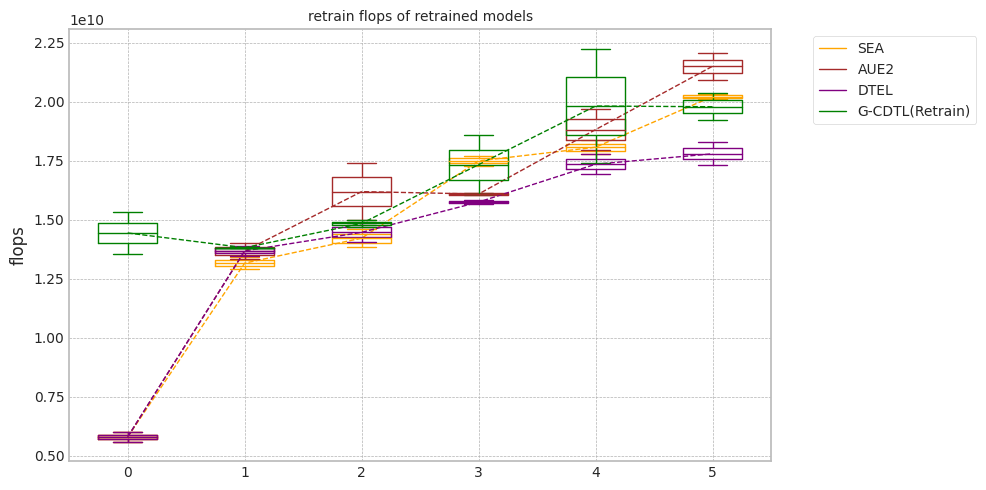

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 700,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

trial_count: 2
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:09:20,159] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:02, 465.73it/s]

Early stop: 686
[2023-12-04 00:09:21,639] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.54it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:09:33,897] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:09:33,900] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 15%|█▍        | 294/2000 [00:02<00:12, 141.49it/s]

[2023-12-04 00:09:36,067] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:09:36,069] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 502871250 9889801250 2458322025 12850994525
precision_recall_fscore: (array([0.95389774, 0.95510107]), array([0.7514031 , 0.99317956]), array([0.84062789, 0.9737682 ]), array([ 3029, 16128]))
Test f1 score: 0.9737681996413265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.57it/s]

mean of drift:
recoveries              0.904846
last_fico_range_high    0.213662
last_pymnt_amnt         0.505290
total_rec_late_fee      0.888600
int_rate                0.127783
dtype: float64
Mean F1 for all data: 0.9724615255525413
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9724615255525413
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:09:48,186] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:02, 471.35it/s]

Early stop: 640
[2023-12-04 00:09:49,550] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.54it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:10:01,821] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:10:01,823] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 11%|█         | 216/2000 [00:01<00:12, 139.72it/s]

[2023-12-04 00:10:03,520] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:10:03,522] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 905168250 7274870750 1808325015 9988364015
precision_recall_fscore: (array([0.94037267, 0.95472464]), array([0.74975239, 0.99107143]), array([0.83431301, 0.97255856]), array([ 3029, 16128]))
Test f1 score: 0.9725585640401582
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.56it/s]


mean of drift:
recoveries              0.918330
last_fico_range_high    0.314308
last_pymnt_amnt         0.490489
total_rec_late_fee      0.964086
int_rate                0.135369
dtype: float64
Mean F1 for all data: 0.9711856491235048
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.971823587338023
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:05<00:06,  2.52it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:10:22,088] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:10:22,091] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:10:23,568] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:10:23,569] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:07<00:12,  1.18it/s]

G-CDTL train flops: 70000000 777000000 193140000 1040140000


100%|██████████| 31/31 [00:13<00:00,  2.23it/s]


Early stop at  [221]
Train flops  [1040140000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710505737967324
G_CDTL+AUE median: 0.9710505737967324
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:12,  1.19it/s]

Ensemble_SEA train flops: 848250000


100%|██████████| 31/31 [00:13<00:00,  2.27it/s]


Early stop at  [974]
Train flops  [848250000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704310510892388
SEA median: 0.9704310510892388
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:10,  1.37it/s]

Ensemble_SEA train flops: 670770000


100%|██████████| 31/31 [00:13<00:00,  2.33it/s]


Early stop at  [770]
Train flops  [670770000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708867134498106
AUE median: 0.9708867134498106
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:12,  1.16it/s]

Ensemble_DTEL train flops: 888270000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:13<00:00,  2.25it/s]


Early stop at  [1020, 2]
Train flops  [888270000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9707083296140623
DTEL median: 0.9707083296140623
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:05<00:06,  2.57it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:11:16,752] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:11:16,755] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:11:18,300] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:11:18,302] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:07<00:12,  1.16it/s]

G-CDTL train flops: 84000000 805000000 200100000 1089100000


100%|██████████| 31/31 [00:13<00:00,  2.23it/s]


Early stop at  [229]
Train flops  [1089100000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9706383483097993
G_CDTL+AUE median: 0.9708444610532658
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:11,  1.26it/s]

Ensemble_SEA train flops: 782130000


100%|██████████| 31/31 [00:13<00:00,  2.28it/s]


Early stop at  [898]
Train flops  [782130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712076238970014
SEA median: 0.9708193374931201
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:15,  1.01s/it]

Ensemble_SEA train flops: 1212780000


100%|██████████| 31/31 [00:14<00:00,  2.16it/s]


Early stop at  [1393]
Train flops  [1212780000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.971388370026293
AUE median: 0.9711375417380518
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:12,  1.20it/s]

Ensemble_DTEL train flops: 864780000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:13<00:00,  2.27it/s]


Early stop at  [993, 2]
Train flops  [864780000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713309061802787
DTEL median: 0.9710196178971705


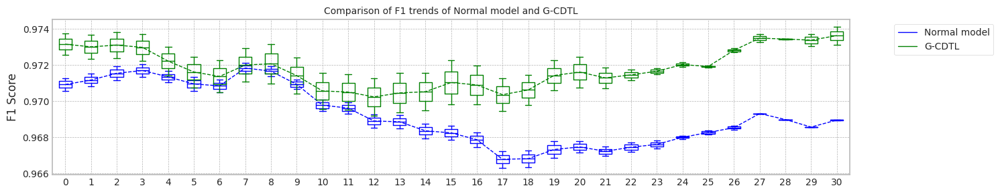

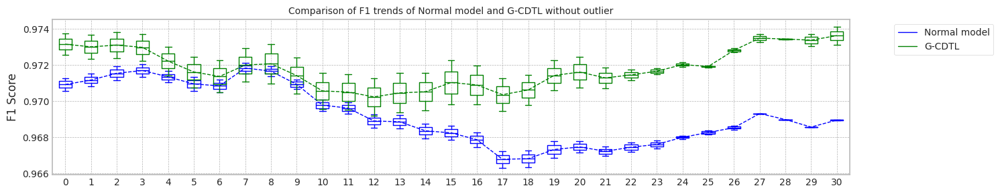

max_mean_trial= 0


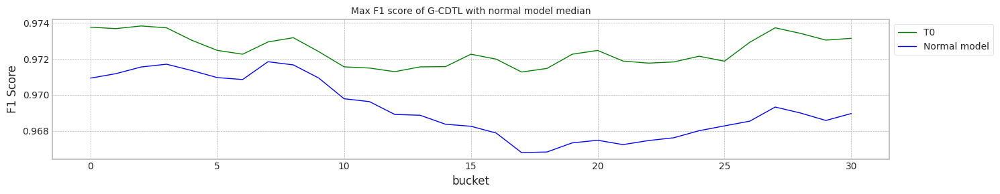

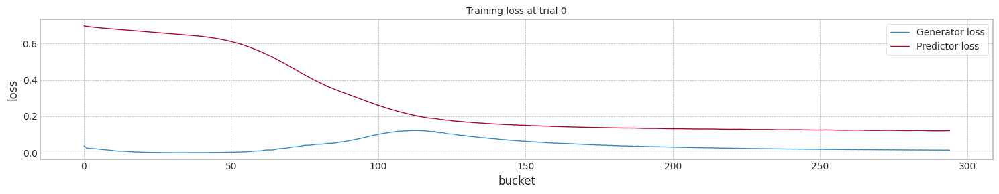

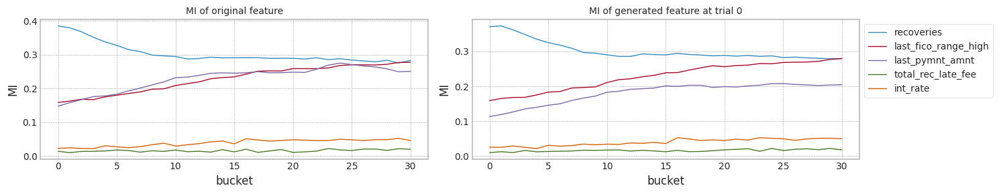

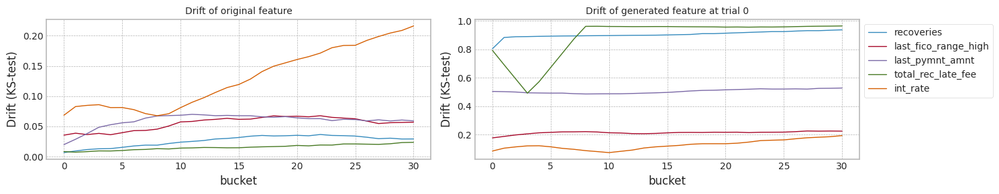

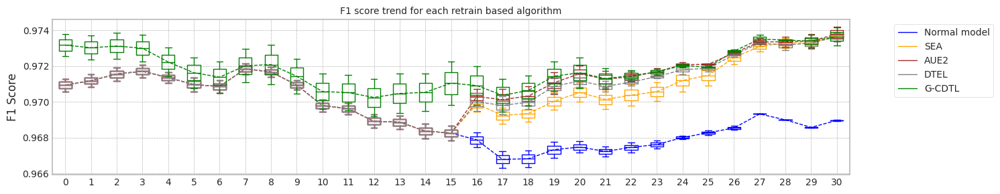

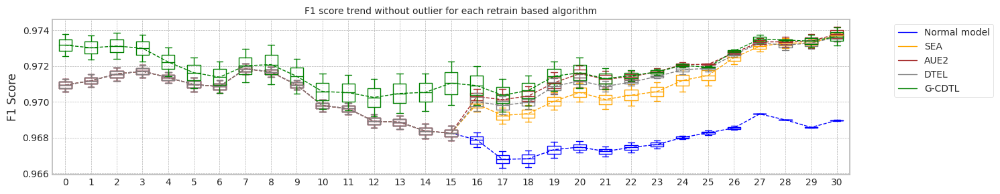

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.244831800460815
Base flops (inference flops of normal model, median): 258332145.0


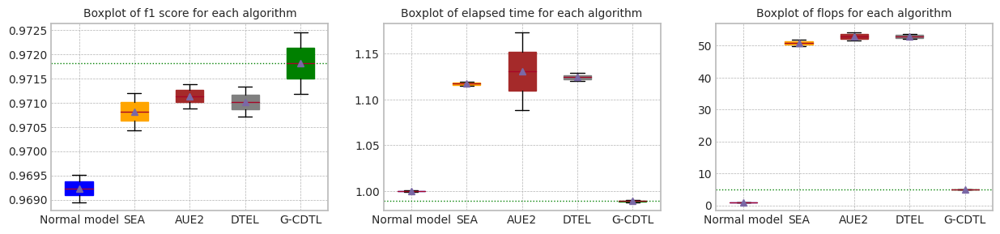

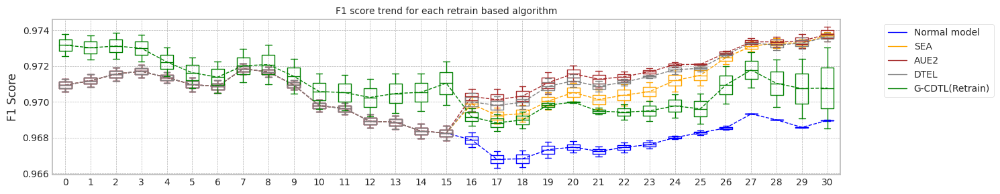

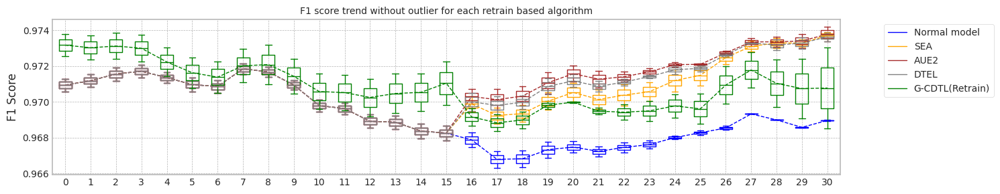

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.244831800460815
Base flops (train + inference flops of normal model, median): 5791640025.0


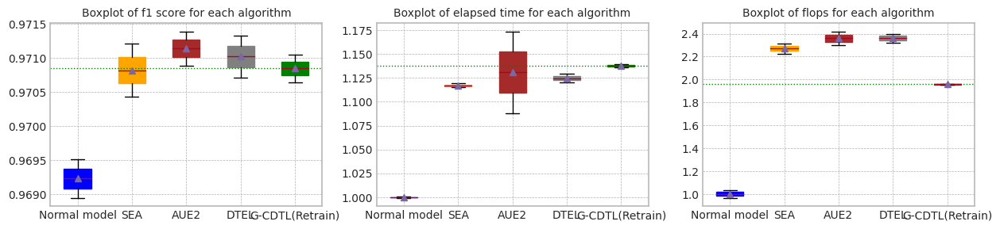

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.244831800460815


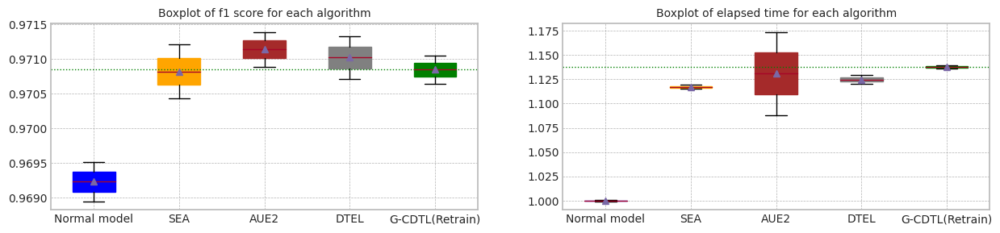

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.237129,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.252534,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.244832,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.010893,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972462,0.973146,12.096371,1.285099e+10,1.297599e+09,1.414859e+10
1,1.0,0.972559,0.972347,0.971186,0.974133,12.126674,9.988364e+09,1.297599e+09,1.128596e+10
2,median,0.973163,0.973016,0.971824,0.973639,12.111522,1.141968e+10,1.297599e+09,1.271728e+10
3,std,0.000855,0.000947,0.000902,0.000698,0.021427,2.024185e+09,0.000000e+00,2.024185e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970431,0.973518,13.704106,6.189892e+09,7.223221e+09,1.341311e+10
1,1.0,0.971291,0.971524,0.971208,0.973904,13.656625,6.123772e+09,6.773769e+09,1.289754e+10
2,median,0.970932,0.971180,0.970819,0.973711,13.680365,6.156832e+09,6.998495e+09,1.315533e+10
3,std,0.000508,0.000487,0.000549,0.000273,0.033574,4.675390e+07,3.178103e+08,3.645642e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970887,0.974193,13.324484,6.012412e+09,7.304073e+09,1.331648e+10
1,1.0,0.971291,0.971524,0.971388,0.973356,14.372403,6.554422e+09,7.462751e+09,1.401717e+10
2,median,0.970932,0.971180,0.971138,0.973774,13.848444,6.283417e+09,7.383412e+09,1.366683e+10
3,std,0.000508,0.000487,0.000355,0.000591,0.740991,3.832589e+08,1.122026e+08,4.954615e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970708,0.973385,13.825546,6.232522e+09,7.657516e+09,1.389004e+10
1,1.0,0.971291,0.971524,0.971331,0.973867,13.717657,6.209032e+09,7.250694e+09,1.345973e+10
2,median,0.970932,0.971180,0.971020,0.973626,13.771601,6.220777e+09,7.454105e+09,1.367488e+10
3,std,0.000508,0.000487,0.000440,0.000341,0.076289,1.660994e+07,2.876663e+08,3.042762e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.971051,0.968516,13.913832,1.102850e+10,285918225.0,1.131442e+10
1,1.0,0.972559,0.972347,0.970638,0.973026,13.954442,1.107746e+10,285918225.0,1.136338e+10
2,median,0.973163,0.973016,0.970844,0.970771,13.934137,1.105298e+10,285918225.0,1.133890e+10
3,std,0.000855,0.000947,0.000291,0.003189,0.028715,3.461995e+07,0.0,3.461995e+07


trial_count: 2
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:12:16,718] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 434.82it/s]

Early stop: 686
[2023-12-04 00:12:18,301] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.47it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:12:30,916] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:12:30,918] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 15%|█▍        | 294/2000 [00:02<00:12, 138.85it/s]

[2023-12-04 00:12:33,126] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:12:33,127] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 502871250 9889801250 2458322025 12850994525
precision_recall_fscore: (array([0.95389774, 0.95510107]), array([0.7514031 , 0.99317956]), array([0.84062789, 0.9737682 ]), array([ 3029, 16128]))
Test f1 score: 0.9737681996413265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:11<00:00,  2.59it/s]

mean of drift:
recoveries              0.904846
last_fico_range_high    0.213662
last_pymnt_amnt         0.505290
total_rec_late_fee      0.888600
int_rate                0.127783
dtype: float64
Mean F1 for all data: 0.9724615255525413
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9724615255525413
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:12:45,186] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 440.67it/s]

Early stop: 640
[2023-12-04 00:12:46,646] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.50it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:12:59,079] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:12:59,081] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 11%|█         | 216/2000 [00:01<00:13, 134.27it/s]

[2023-12-04 00:13:00,845] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:13:00,848] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 905168250 7274870750 1808325015 9988364015
precision_recall_fscore: (array([0.94037267, 0.95472464]), array([0.74975239, 0.99107143]), array([0.83431301, 0.97255856]), array([ 3029, 16128]))
Test f1 score: 0.9725585640401582
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.57it/s]


mean of drift:
recoveries              0.918330
last_fico_range_high    0.314308
last_pymnt_amnt         0.490489
total_rec_late_fee      0.964086
int_rate                0.135369
dtype: float64
Mean F1 for all data: 0.9711856491235048
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.971823587338023
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:03<00:08,  2.58it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:13:17,255] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:13:17,257] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:13:18,774] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:13:18,775] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:05<00:17,  1.17it/s]

G-CDTL train flops: 70000000 791000000 196620000 1057620000


 68%|██████▊   | 21/31 [00:09<00:04,  2.42it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:13:23,166] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:13:23,168] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:13:24,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:13:24,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:11<00:08,  1.11it/s]

G-CDTL train flops: 70000000 826000000 205320000 1101320000


100%|██████████| 31/31 [00:15<00:00,  2.00it/s]


Early stop at  [225, 235]
Train flops  [1057620000, 1101320000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9720796468019997
G_CDTL+AUE median: 0.9720796468019997
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:14,  1.41it/s]

Ensemble_SEA train flops: 585510000


 71%|███████   | 22/31 [00:11<00:07,  1.18it/s]

Ensemble_SEA train flops: 799530000


100%|██████████| 31/31 [00:14<00:00,  2.10it/s]


Early stop at  [672, 918]
Train flops  [585510000, 799530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9705658267182677
SEA median: 0.9705658267182677
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:12,  1.57it/s]

Ensemble_SEA train flops: 470670000


 71%|███████   | 22/31 [00:11<00:08,  1.08it/s]

Ensemble_SEA train flops: 969180000


100%|██████████| 31/31 [00:14<00:00,  2.09it/s]


Early stop at  [540, 1113]
Train flops  [470670000, 969180000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708640720037569
AUE median: 0.9708640720037569
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:19,  1.00it/s]

Ensemble_DTEL train flops: 1137960000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:12<00:07,  1.21it/s]

Ensemble_DTEL train flops: 809970000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:15<00:00,  1.97it/s]


Early stop at  [1307, 1, 930, 1]
Train flops  [1137960000, 1740000, 809970000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9698597378586643
DTEL median: 0.9698597378586643
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:03<00:08,  2.53it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:14:18,273] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:14:18,275] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:14:20,083] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:14:20,085] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:19,  1.05it/s]

G-CDTL train flops: 59500000 948500000 235770000 1243770000


 68%|██████▊   | 21/31 [00:10<00:04,  2.40it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:14:24,521] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:14:24,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:14:26,329] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:14:26,330] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:12<00:08,  1.04it/s]

G-CDTL train flops: 59500000 959000000 238380000 1256880000


100%|██████████| 31/31 [00:16<00:00,  1.93it/s]


Early stop at  [270, 273]
Train flops  [1243770000, 1256880000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716147879502132
G_CDTL+AUE median: 0.9718472173761064
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:13,  1.46it/s]

Ensemble_SEA train flops: 558540000


 71%|███████   | 22/31 [00:10<00:06,  1.35it/s]

Ensemble_SEA train flops: 628140000


100%|██████████| 31/31 [00:14<00:00,  2.16it/s]


Early stop at  [641, 721]
Train flops  [558540000, 628140000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.970911245086851
SEA median: 0.9707385359025593
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:19,  1.03it/s]

Ensemble_SEA train flops: 1104900000


 71%|███████   | 22/31 [00:13<00:11,  1.33s/it]

Ensemble_SEA train flops: 1740000000


100%|██████████| 31/31 [00:17<00:00,  1.79it/s]


Early stop at  [1269, 1999]
Train flops  [1104900000, 1740000000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712023197923523
AUE median: 0.9710331958980546
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:15,  1.28it/s]

Ensemble_DTEL train flops: 750810000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:11<00:07,  1.20it/s]

Ensemble_DTEL train flops: 782130000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:14<00:00,  2.07it/s]


Early stop at  [862, 1, 898, 1]
Train flops  [750810000, 1740000, 782130000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704735127799214
DTEL median: 0.9701666253192929


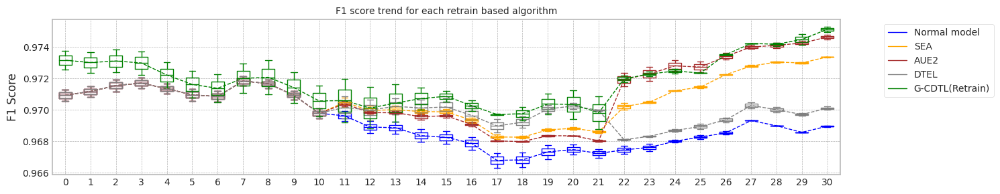

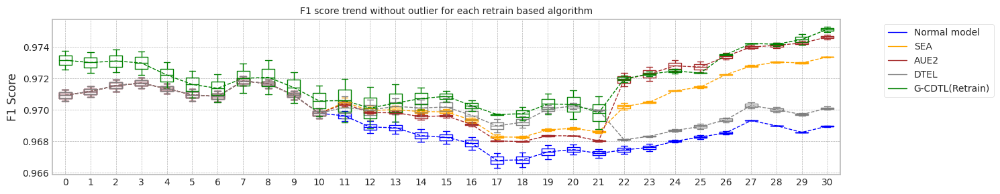

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.50416362285614
Base flops (train + inference flops of normal model, median): 5791640025.0


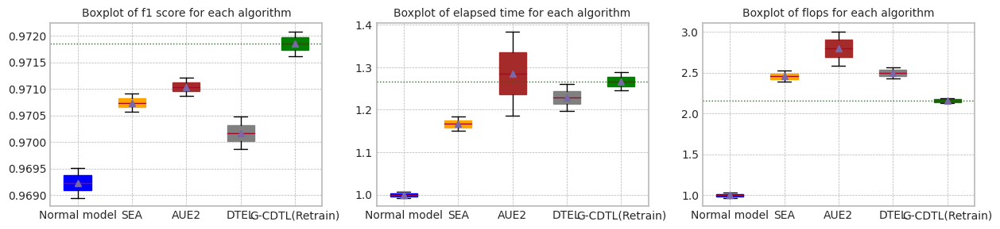

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.50416362285614


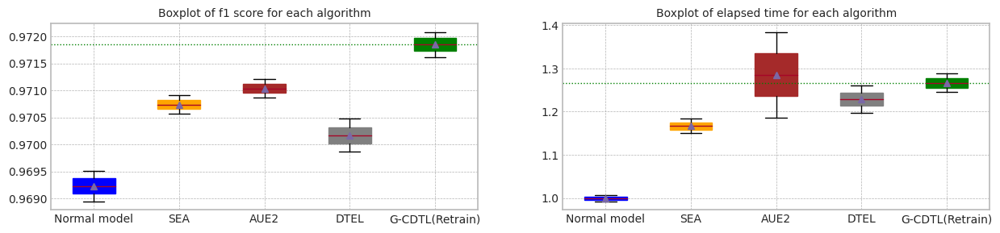

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.594006,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.414322,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.504164,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.127056,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972462,0.973146,12.032563,1.285099e+10,1.297599e+09,1.414859e+10
1,1.0,0.972559,0.972347,0.971186,0.974133,12.072674,9.988364e+09,1.297599e+09,1.128596e+10
2,median,0.973163,0.973016,0.971824,0.973639,12.052618,1.141968e+10,1.297599e+09,1.271728e+10
3,std,0.000855,0.000947,0.000902,0.000698,0.028363,2.024185e+09,0.000000e+00,2.024185e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970566,0.973395,14.806067,6.726682e+09,7.876677e+09,1.460336e+10
1,1.0,0.971291,0.971524,0.970911,0.973351,14.384986,6.528322e+09,7.294985e+09,1.382331e+10
2,median,0.970932,0.971180,0.970739,0.973373,14.595526,6.627502e+09,7.585831e+09,1.421333e+10
3,std,0.000508,0.000487,0.000244,0.000031,0.297749,1.402617e+08,4.113181e+08,5.515798e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970864,0.974473,14.840783,6.781492e+09,8.189819e+09,1.497131e+10
1,1.0,0.971291,0.971524,0.971202,0.974798,17.308544,8.186542e+09,9.211537e+09,1.739808e+10
2,median,0.970932,0.971180,0.971033,0.974636,16.074663,7.484017e+09,8.700678e+09,1.618470e+10
3,std,0.000508,0.000487,0.000239,0.000230,1.744971,9.935204e+08,7.224640e+08,1.715984e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969860,0.970019,15.754632,7.293052e+09,7.580086e+09,1.487314e+10
1,1.0,0.971291,0.971524,0.970474,0.970208,14.976468,6.878062e+09,7.168914e+09,1.404698e+10
2,median,0.970932,0.971180,0.970167,0.970113,15.365550,7.085557e+09,7.374500e+09,1.446006e+10
3,std,0.000508,0.000487,0.000434,0.000134,0.550245,2.934422e+08,2.907422e+08,5.841844e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972080,0.975299,15.565564,1.214730e+10,171550935.0,1.231885e+10
1,1.0,0.972559,0.972347,0.971615,0.974971,16.100217,1.248901e+10,171550935.0,1.266056e+10
2,median,0.973163,0.973016,0.971847,0.975135,15.832890,1.231816e+10,171550935.0,1.248971e+10
3,std,0.000855,0.000947,0.000329,0.000231,0.378057,2.416255e+08,0.0,2.416255e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:15:20,508] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:02, 438.35it/s]

Early stop: 686
[2023-12-04 00:15:22,079] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:15:34,489] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:15:34,492] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 15%|█▍        | 294/2000 [00:02<00:12, 132.22it/s]

[2023-12-04 00:15:36,813] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:15:36,814] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 502871250 9889801250 2458322025 12850994525
precision_recall_fscore: (array([0.95389774, 0.95510107]), array([0.7514031 , 0.99317956]), array([0.84062789, 0.9737682 ]), array([ 3029, 16128]))
Test f1 score: 0.9737681996413265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.56it/s]

mean of drift:
recoveries              0.904846
last_fico_range_high    0.213662
last_pymnt_amnt         0.505290
total_rec_late_fee      0.888600
int_rate                0.127783
dtype: float64
Mean F1 for all data: 0.9724615255525413
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9724615255525413
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:15:48,981] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 436.12it/s]

Early stop: 640
[2023-12-04 00:15:50,454] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.52it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:16:02,799] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:16:02,801] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 11%|█         | 216/2000 [00:01<00:13, 134.04it/s]

[2023-12-04 00:16:04,571] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:16:04,572] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 905168250 7274870750 1808325015 9988364015
precision_recall_fscore: (array([0.94037267, 0.95472464]), array([0.74975239, 0.99107143]), array([0.83431301, 0.97255856]), array([ 3029, 16128]))
Test f1 score: 0.9725585640401582
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.57it/s]


mean of drift:
recoveries              0.918330
last_fico_range_high    0.314308
last_pymnt_amnt         0.490489
total_rec_late_fee      0.964086
int_rate                0.135369
dtype: float64
Mean F1 for all data: 0.9711856491235048
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.971823587338023
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.54it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:16:19,870] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:16:19,872] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:16:21,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:16:21,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:04<00:21,  1.07it/s]

G-CDTL train flops: 73500000 847000000 210540000 1131040000


 48%|████▊     | 15/31 [00:07<00:06,  2.32it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:16:24,719] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:16:24,721] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:16:26,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:16:26,140] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:09<00:12,  1.17it/s]

G-CDTL train flops: 73500000 700000000 174000000 947500000


 74%|███████▍  | 23/31 [00:12<00:03,  2.29it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:16:29,354] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:16:29,356] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:16:31,011] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:16:31,012] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:14<00:06,  1.08it/s]

G-CDTL train flops: 52500000 826000000 205320000 1083820000


100%|██████████| 31/31 [00:17<00:00,  1.81it/s]


Early stop at  [241, 199, 235]
Train flops  [1131040000, 947500000, 1083820000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9720552073466402
G_CDTL+AUE median: 0.9720552073466402
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:24,  1.08s/it]

Ensemble_SEA train flops: 1204950000


 52%|█████▏    | 16/31 [00:09<00:13,  1.14it/s]

Ensemble_SEA train flops: 829980000


 77%|███████▋  | 24/31 [00:14<00:06,  1.13it/s]

Ensemble_SEA train flops: 834330000


100%|██████████| 31/31 [00:17<00:00,  1.78it/s]


Early stop at  [1384, 953, 958]
Train flops  [1204950000, 829980000, 834330000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713691910242813
SEA median: 0.9713691910242813
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:18,  1.26it/s]

Ensemble_SEA train flops: 728190000


 52%|█████▏    | 16/31 [00:08<00:10,  1.41it/s]

Ensemble_SEA train flops: 534180000


 77%|███████▋  | 24/31 [00:12<00:05,  1.26it/s]

Ensemble_SEA train flops: 696870000


100%|██████████| 31/31 [00:15<00:00,  1.96it/s]


Early stop at  [836, 613, 800]
Train flops  [728190000, 534180000, 696870000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711426732523949
AUE median: 0.9711426732523949
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:21,  1.09it/s]

Ensemble_DTEL train flops: 932640000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:07<00:06,  2.31it/s]

Ensemble_DTEL train flops: 783870000


 52%|█████▏    | 16/31 [00:09<00:15,  1.01s/it]

Ensemble_DTEL train flops: 284490000


 77%|███████▋  | 24/31 [00:14<00:05,  1.30it/s]

Ensemble_DTEL train flops: 632490000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:17<00:00,  1.82it/s]


Early stop at  [1071, 2, 900, 326, 726, 2]
Train flops  [932640000, 2610000, 783870000, 284490000, 632490000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9709881639156753
DTEL median: 0.9709881639156753
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.54it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:17:27,479] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:17:27,481] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:17:29,580] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:17:29,582] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:05<00:24,  1.07s/it]

G-CDTL train flops: 49000000 1067500000 265350000 1381850000


 48%|████▊     | 15/31 [00:08<00:07,  2.23it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:17:32,779] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:17:32,782] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:17:34,671] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:17:34,672] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:10<00:15,  1.01s/it]

G-CDTL train flops: 80500000 931000000 231420000 1242920000


 74%|███████▍  | 23/31 [00:13<00:03,  2.21it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:17:37,905] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:17:37,908] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:17:39,948] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:17:39,949] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:15<00:07,  1.05s/it]

G-CDTL train flops: 231000000 871500000 216630000 1319130000


100%|██████████| 31/31 [00:18<00:00,  1.68it/s]


Early stop at  [304, 265, 248]
Train flops  [1381850000, 1242920000, 1319130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711475259813759
G_CDTL+AUE median: 0.971601366664008
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:22,  1.00it/s]

Ensemble_SEA train flops: 1044870000


 52%|█████▏    | 16/31 [00:09<00:11,  1.31it/s]

Ensemble_SEA train flops: 581160000


 77%|███████▋  | 24/31 [00:14<00:07,  1.07s/it]

Ensemble_SEA train flops: 1217130000


100%|██████████| 31/31 [00:17<00:00,  1.77it/s]


Early stop at  [1200, 667, 1398]
Train flops  [1044870000, 581160000, 1217130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715993679389141
SEA median: 0.9714842794815977
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:15,  1.44it/s]

Ensemble_SEA train flops: 509820000


 52%|█████▏    | 16/31 [00:08<00:12,  1.21it/s]

Ensemble_SEA train flops: 764730000


 77%|███████▋  | 24/31 [00:13<00:06,  1.14it/s]

Ensemble_SEA train flops: 816060000


100%|██████████| 31/31 [00:16<00:00,  1.92it/s]


Early stop at  [585, 878, 937]
Train flops  [509820000, 764730000, 816060000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712542407310201
AUE median: 0.9711984569917075
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:16,  1.41it/s]

Ensemble_DTEL train flops: 503730000
Ensemble_DTEL train flops: 1740000


 52%|█████▏    | 16/31 [00:09<00:14,  1.03it/s]

Ensemble_DTEL train flops: 1026600000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:14<00:07,  1.14s/it]

Ensemble_DTEL train flops: 1273680000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:17<00:00,  1.76it/s]


Early stop at  [578, 1, 1179, 1, 1463, 1]
Train flops  [503730000, 1740000, 1026600000, 1740000, 1273680000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9697548341943903
DTEL median: 0.9703714990550328


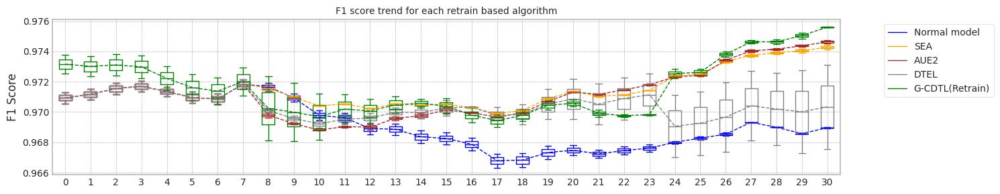

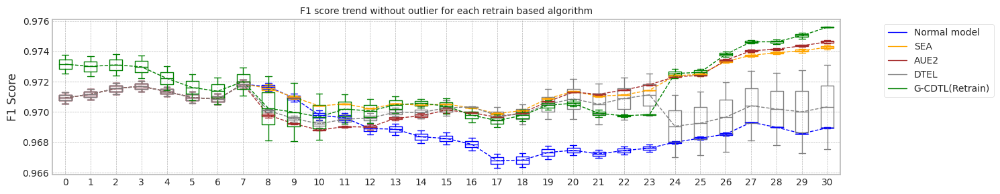

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.354995489120483
Base flops (train + inference flops of normal model, median): 5791640025.0


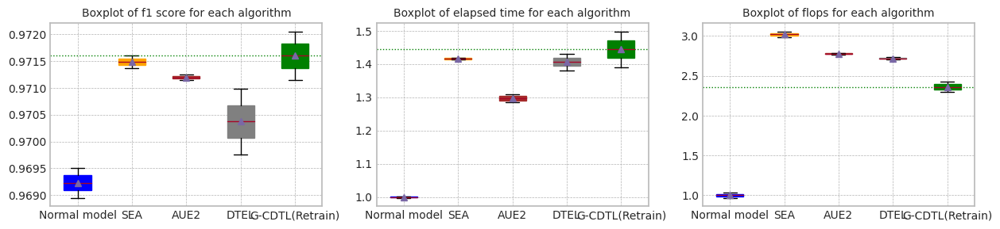

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.354995489120483


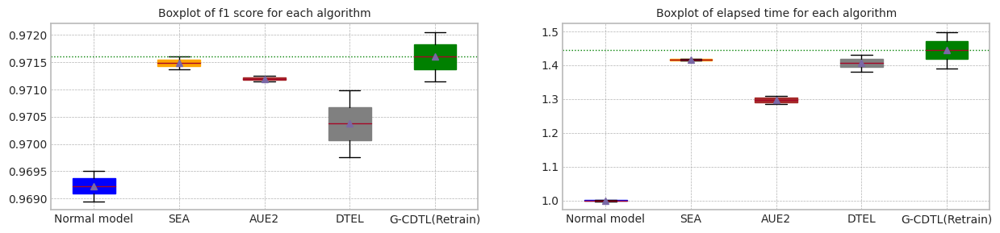

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.385081,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.324910,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.354995,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.042547,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972462,0.973146,12.145924,1.285099e+10,1.297599e+09,1.414859e+10
1,1.0,0.972559,0.972347,0.971186,0.974133,12.095086,9.988364e+09,1.297599e+09,1.128596e+10
2,median,0.973163,0.973016,0.971824,0.973639,12.120505,1.141968e+10,1.297599e+09,1.271728e+10
3,std,0.000855,0.000947,0.000902,0.000698,0.035948,2.024185e+09,0.000000e+00,2.024185e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971369,0.974142,17.459906,8.210902e+09,9.494230e+09,1.770513e+10
1,1.0,0.971291,0.971524,0.971599,0.974424,17.536156,8.184802e+09,9.084798e+09,1.726960e+10
2,median,0.970932,0.971180,0.971484,0.974283,17.498031,8.197852e+09,9.289514e+09,1.748737e+10
3,std,0.000508,0.000487,0.000163,0.000199,0.053917,1.845549e+07,2.895118e+08,3.079673e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971143,0.974745,15.871293,7.300882e+09,8.842542e+09,1.614342e+10
1,1.0,0.971291,0.971524,0.971254,0.974540,16.182498,7.432252e+09,8.590580e+09,1.602283e+10
2,median,0.970932,0.971180,0.971198,0.974642,16.026896,7.366567e+09,8.716561e+09,1.608313e+10
3,std,0.000508,0.000487,0.000079,0.000145,0.220055,9.289262e+07,1.781637e+08,8.527112e+07


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970988,0.973120,17.069834,7.980352e+09,7.688836e+09,1.566919e+10
1,1.0,0.971291,0.971524,0.969755,0.967562,17.672729,8.150872e+09,7.662204e+09,1.581308e+10
2,median,0.970932,0.971180,0.970371,0.970341,17.371281,8.065612e+09,7.675520e+09,1.574113e+10
3,std,0.000508,0.000487,0.000872,0.003931,0.426312,1.205758e+08,1.883136e+07,1.017445e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972055,0.975640,17.185977,1.315072e+10,133428505.0,1.328415e+10
1,1.0,0.972559,0.972347,0.971148,0.975580,18.509001,1.393226e+10,133428505.0,1.406569e+10
2,median,0.973163,0.973016,0.971601,0.975610,17.847489,1.354149e+10,133428505.0,1.367492e+10
3,std,0.000855,0.000947,0.000642,0.000043,0.935519,5.526322e+08,0.0,5.526322e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:18:38,294] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 422.13it/s]

Early stop: 686
[2023-12-04 00:18:39,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:18:52,461] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:18:52,463] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 15%|█▍        | 294/2000 [00:02<00:13, 129.66it/s]

[2023-12-04 00:18:54,828] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:18:54,829] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 502871250 9889801250 2458322025 12850994525
precision_recall_fscore: (array([0.95389774, 0.95510107]), array([0.7514031 , 0.99317956]), array([0.84062789, 0.9737682 ]), array([ 3029, 16128]))
Test f1 score: 0.9737681996413265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.55it/s]

mean of drift:
recoveries              0.904846
last_fico_range_high    0.213662
last_pymnt_amnt         0.505290
total_rec_late_fee      0.888600
int_rate                0.127783
dtype: float64
Mean F1 for all data: 0.9724615255525413
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9724615255525413
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:19:07,056] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 420.46it/s]

Early stop: 640
[2023-12-04 00:19:08,584] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.52it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:19:20,950] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:19:20,952] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 11%|█         | 216/2000 [00:01<00:13, 130.41it/s]

[2023-12-04 00:19:22,779] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-12-04 00:19:22,780] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 905168250 7274870750 1808325015 9988364015
precision_recall_fscore: (array([0.94037267, 0.95472464]), array([0.74975239, 0.99107143]), array([0.83431301, 0.97255856]), array([ 3029, 16128]))
Test f1 score: 0.9725585640401582
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.55it/s]


mean of drift:
recoveries              0.918330
last_fico_range_high    0.314308
last_pymnt_amnt         0.490489
total_rec_late_fee      0.964086
int_rate                0.135369
dtype: float64
Mean F1 for all data: 0.9711856491235048
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.971823587338023
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:09,  2.53it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:19:37,778] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:19:37,782] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:19:39,549] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:19:39,551] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:04<00:23,  1.02it/s]

G-CDTL train flops: 73500000 833000000 207060000 1113560000


 42%|████▏     | 13/31 [00:06<00:08,  2.19it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:19:42,318] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:19:42,320] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:19:44,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:19:44,139] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:09<00:16,  1.01it/s]

G-CDTL train flops: 73500000 864500000 214890000 1152890000


 65%|██████▍   | 20/31 [00:11<00:05,  2.11it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:19:46,996] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:19:46,998] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:19:48,717] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:19:48,719] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:13<00:09,  1.03it/s]

G-CDTL train flops: 52500000 822500000 204450000 1079450000


 87%|████████▋ | 27/31 [00:16<00:01,  2.10it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:19:51,581] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:19:51,583] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:19:53,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:19:53,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:18<00:03,  1.00s/it]

G-CDTL train flops: 63000000 857500000 213150000 1133650000


100%|██████████| 31/31 [00:19<00:00,  1.58it/s]


Early stop at  [237, 246, 234, 244]
Train flops  [1113560000, 1152890000, 1079450000, 1133650000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715797913402219
G_CDTL+AUE median: 0.9715797913402219
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:22,  1.08it/s]

Ensemble_SEA train flops: 879570000


 45%|████▌     | 14/31 [00:07<00:10,  1.56it/s]

Ensemble_SEA train flops: 372360000


 68%|██████▊   | 21/31 [00:11<00:07,  1.27it/s]

Ensemble_SEA train flops: 643800000


 90%|█████████ | 28/31 [00:16<00:02,  1.04it/s]

Ensemble_SEA train flops: 963090000


100%|██████████| 31/31 [00:17<00:00,  1.76it/s]


Early stop at  [1010, 427, 739, 1106]
Train flops  [879570000, 372360000, 643800000, 963090000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710255193220678
SEA median: 0.9710255193220678
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:22,  1.08it/s]

Ensemble_SEA train flops: 878700000


 45%|████▌     | 14/31 [00:08<00:13,  1.23it/s]

Ensemble_SEA train flops: 672510000


 68%|██████▊   | 21/31 [00:13<00:10,  1.06s/it]

Ensemble_SEA train flops: 1145790000


 90%|█████████ | 28/31 [00:17<00:02,  1.00it/s]

Ensemble_SEA train flops: 994410000


100%|██████████| 31/31 [00:19<00:00,  1.62it/s]


Early stop at  [1009, 772, 1316, 1142]
Train flops  [878700000, 672510000, 1145790000, 994410000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716229351529815
AUE median: 0.9716229351529815
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:27,  1.16s/it]

Ensemble_DTEL train flops: 1271070000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:10<00:19,  1.12s/it]

Ensemble_DTEL train flops: 1236270000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:13<00:07,  1.36it/s]

Ensemble_DTEL train flops: 474150000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:19<00:03,  1.17s/it]

Ensemble_DTEL train flops: 1330230000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:20<00:00,  1.53it/s]


Early stop at  [1460, 1, 1420, 1, 544, 1, 1528, 1]
Train flops  [1271070000, 1740000, 1236270000, 1740000, 474150000, 1740000, 1330230000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9701765674663698
DTEL median: 0.9701765674663698
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:09,  2.57it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:20:54,548] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:20:54,550] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:20:55,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:20:55,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:04<00:20,  1.19it/s]

G-CDTL train flops: 91000000 623000000 154860000 868860000


 42%|████▏     | 13/31 [00:06<00:08,  2.24it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:20:58,727] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:20:58,730] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:21:01,797] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:21:01,798] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:09<00:23,  1.36s/it]

G-CDTL train flops: 49000000 1473500000 366270000 1888770000


 65%|██████▍   | 20/31 [00:12<00:05,  1.93it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:21:04,639] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:21:04,642] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:21:06,558] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:21:06,559] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:14<00:10,  1.06s/it]

G-CDTL train flops: 133000000 833000000 207060000 1173060000


 87%|████████▋ | 27/31 [00:17<00:01,  2.07it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:21:09,408] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:21:09,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:21:12,875] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:21:12,876] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:21<00:04,  1.50s/it]

G-CDTL train flops: 70000000 1662500000 413250000 2145750000


100%|██████████| 31/31 [00:22<00:00,  1.39it/s]


Early stop at  [177, 420, 237, 474]
Train flops  [868860000, 1888770000, 1173060000, 2145750000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708120795423146
G_CDTL+AUE median: 0.9711959354412683
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:22,  1.09it/s]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 14/31 [00:08<00:14,  1.16it/s]

Ensemble_SEA train flops: 771690000


 68%|██████▊   | 21/31 [00:12<00:09,  1.07it/s]

Ensemble_SEA train flops: 893490000


 90%|█████████ | 28/31 [00:17<00:02,  1.11it/s]

Ensemble_SEA train flops: 822150000


100%|██████████| 31/31 [00:18<00:00,  1.67it/s]


Early stop at  [999, 886, 1026, 944]
Train flops  [870000000, 771690000, 893490000, 822150000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715103974730905
SEA median: 0.9712679583975792
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:21,  1.11it/s]

Ensemble_SEA train flops: 823890000


 45%|████▌     | 14/31 [00:08<00:14,  1.18it/s]

Ensemble_SEA train flops: 736890000


 68%|██████▊   | 21/31 [00:12<00:06,  1.45it/s]

Ensemble_SEA train flops: 452400000


 90%|█████████ | 28/31 [00:16<00:02,  1.02it/s]

Ensemble_SEA train flops: 998760000


100%|██████████| 31/31 [00:17<00:00,  1.73it/s]


Early stop at  [946, 846, 519, 1147]
Train flops  [823890000, 736890000, 452400000, 998760000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721987849135504
AUE median: 0.971910860033266
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:20,  1.15it/s]

Ensemble_DTEL train flops: 796920000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:08<00:14,  1.17it/s]

Ensemble_DTEL train flops: 773430000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:12<00:08,  1.12it/s]

Ensemble_DTEL train flops: 792570000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:18<00:03,  1.27s/it]

Ensemble_DTEL train flops: 1412880000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:19<00:00,  1.59it/s]


Early stop at  [915, 1, 888, 1, 910, 1, 1623, 1]
Train flops  [796920000, 1740000, 773430000, 1740000, 792570000, 1740000, 1412880000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9706180120334442
DTEL median: 0.970397289749907


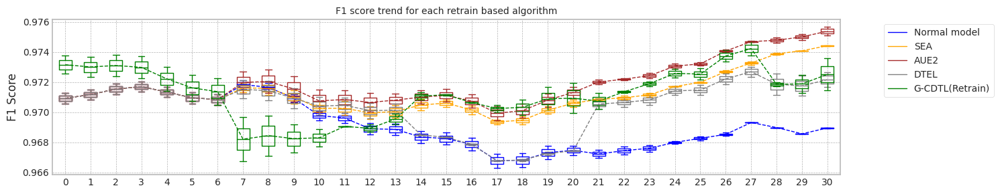

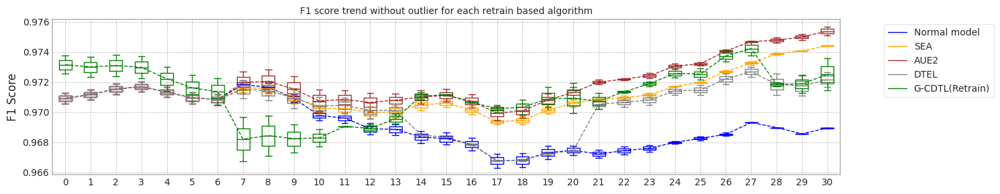

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.428171396255493
Base flops (train + inference flops of normal model, median): 5791640025.0


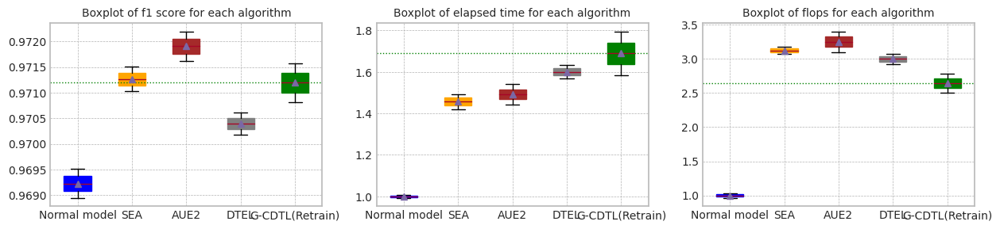

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.428171396255493


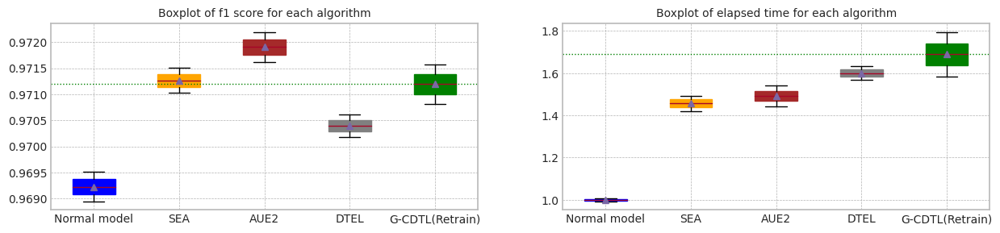

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.514375,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.341968,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.428171,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.121910,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972462,0.973146,12.203917,1.285099e+10,1.297599e+09,1.414859e+10
1,1.0,0.972559,0.972347,0.971186,0.974133,12.167692,9.988364e+09,1.297599e+09,1.128596e+10
2,median,0.973163,0.973016,0.971824,0.973639,12.185805,1.141968e+10,1.297599e+09,1.271728e+10
3,std,0.000855,0.000947,0.000902,0.000698,0.025615,2.024185e+09,0.000000e+00,2.024185e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971026,0.974405,17.662468,8.200462e+09,9.558789e+09,1.775925e+10
1,1.0,0.971291,0.971524,0.971510,0.974443,18.567439,8.698972e+09,9.673968e+09,1.837294e+10
2,median,0.970932,0.971180,0.971268,0.974424,18.114953,8.449717e+09,9.616378e+09,1.806610e+10
3,std,0.000508,0.000487,0.000343,0.000027,0.639911,3.524998e+08,8.144345e+07,4.339433e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971623,0.975692,19.163289,9.033052e+09,1.064971e+10,1.968276e+10
1,1.0,0.971291,0.971524,0.972199,0.975094,17.932467,8.353582e+09,9.586910e+09,1.794049e+10
2,median,0.970932,0.971180,0.971911,0.975393,18.547878,8.693317e+09,1.011831e+10,1.881163e+10
3,std,0.000508,0.000487,0.000407,0.000423,0.870323,4.804578e+08,7.515142e+08,1.231972e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970177,0.972674,20.310504,9.660322e+09,8.103826e+09,1.776415e+10
1,1.0,0.971291,0.971524,0.970618,0.971668,19.483249,9.124402e+09,7.803144e+09,1.692755e+10
2,median,0.970932,0.971180,0.970397,0.972171,19.896877,9.392362e+09,7.953485e+09,1.734585e+10
3,std,0.000508,0.000487,0.000312,0.000711,0.584958,3.789527e+08,2.126140e+08,5.915666e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.971580,0.973590,19.676039,1.446791e+10,57183645.0,1.452510e+10
1,1.0,0.972559,0.972347,0.970812,0.971452,22.316424,1.606480e+10,57183645.0,1.612199e+10
2,median,0.973163,0.973016,0.971196,0.972521,20.996232,1.526636e+10,57183645.0,1.532354e+10
3,std,0.000855,0.000947,0.000543,0.001511,1.867034,1.129172e+09,0.0,1.129172e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:22:13,944] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 409.02it/s]

Early stop: 686
[2023-12-04 00:22:15,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:22:28,117] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:22:28,119] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 15%|█▍        | 294/2000 [00:02<00:14, 121.41it/s]

[2023-12-04 00:22:30,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:22:30,644] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 502871250 9889801250 2458322025 12850994525
precision_recall_fscore: (array([0.95389774, 0.95510107]), array([0.7514031 , 0.99317956]), array([0.84062789, 0.9737682 ]), array([ 3029, 16128]))
Test f1 score: 0.9737681996413265
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.56it/s]

mean of drift:
recoveries              0.904846
last_fico_range_high    0.213662
last_pymnt_amnt         0.505290
total_rec_late_fee      0.888600
int_rate                0.127783
dtype: float64
Mean F1 for all data: 0.9724615255525413
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9724615255525413
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:22:42,797] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 397.42it/s]

Early stop: 640
[2023-12-04 00:22:44,414] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.54it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:22:56,677] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:22:56,679] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 11%|█         | 216/2000 [00:01<00:14, 120.29it/s]

[2023-12-04 00:22:58,644] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:22:58,646] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 905168250 7274870750 1808325015 9988364015
precision_recall_fscore: (array([0.94037267, 0.95472464]), array([0.74975239, 0.99107143]), array([0.83431301, 0.97255856]), array([ 3029, 16128]))
Test f1 score: 0.9725585640401582
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.57it/s]


mean of drift:
recoveries              0.918330
last_fico_range_high    0.314308
last_pymnt_amnt         0.490489
total_rec_late_fee      0.964086
int_rate                0.135369
dtype: float64
Mean F1 for all data: 0.9711856491235048
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.971823587338023
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:02<00:10,  2.49it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:23:13,177] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:23:13,179] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:23:14,824] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:23:14,826] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:04<00:24,  1.04it/s]

G-CDTL train flops: 73500000 766500000 190530000 1030530000


 35%|███▌      | 11/31 [00:06<00:09,  2.11it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:23:17,173] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:23:17,176] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:23:18,919] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:23:18,920] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:08<00:18,  1.02it/s]

G-CDTL train flops: 73500000 787500000 195750000 1056750000


 55%|█████▍    | 17/31 [00:10<00:06,  2.01it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:23:21,325] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:23:21,328] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:23:23,602] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:23:23,604] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:12<00:15,  1.16s/it]

G-CDTL train flops: 56000000 1025500000 254910000 1336410000


 74%|███████▍  | 23/31 [00:14<00:04,  1.88it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:23:26,034] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:23:26,036] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:23:27,932] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:23:27,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:17<00:07,  1.06s/it]

G-CDTL train flops: 66500000 861000000 214020000 1141520000


 94%|█████████▎| 29/31 [00:19<00:01,  1.93it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:23:30,386] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:23:30,389] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:23:32,210] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:23:32,211] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:21<00:01,  1.03s/it]

G-CDTL train flops: 52500000 847000000 210540000 1110040000


100%|██████████| 31/31 [00:21<00:00,  1.42it/s]


Early stop at  [218, 224, 292, 245, 241]
Train flops  [1030530000, 1056750000, 1336410000, 1141520000, 1110040000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.971949189385019
G_CDTL+AUE median: 0.971949189385019
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:20,  1.25it/s]

Ensemble_SEA train flops: 650760000


 39%|███▊      | 12/31 [00:07<00:17,  1.07it/s]

Ensemble_SEA train flops: 857820000


 58%|█████▊    | 18/31 [00:11<00:12,  1.02it/s]

Ensemble_SEA train flops: 876960000


 77%|███████▋  | 24/31 [00:15<00:06,  1.06it/s]

Ensemble_SEA train flops: 796050000


 97%|█████████▋| 30/31 [00:19<00:01,  1.00s/it]

Ensemble_SEA train flops: 903930000


100%|██████████| 31/31 [00:20<00:00,  1.53it/s]


Early stop at  [747, 985, 1007, 914, 1038]
Train flops  [650760000, 857820000, 876960000, 796050000, 903930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711175965760679
SEA median: 0.9711175965760679
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:05<00:35,  1.41s/it]

Ensemble_SEA train flops: 1557300000


 39%|███▊      | 12/31 [00:08<00:15,  1.22it/s]

Ensemble_SEA train flops: 555930000


 58%|█████▊    | 18/31 [00:13<00:13,  1.02s/it]

Ensemble_SEA train flops: 1010070000


 77%|███████▋  | 24/31 [00:16<00:06,  1.14it/s]

Ensemble_SEA train flops: 716010000


 97%|█████████▋| 30/31 [00:21<00:01,  1.04s/it]

Ensemble_SEA train flops: 995280000


100%|██████████| 31/31 [00:21<00:00,  1.44it/s]


Early stop at  [1789, 638, 1160, 822, 1143]
Train flops  [1557300000, 555930000, 1010070000, 716010000, 995280000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712888666969133
AUE median: 0.9712888666969133
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:20,  1.19it/s]

Ensemble_DTEL train flops: 662940000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:07<00:18,  1.04it/s]

Ensemble_DTEL train flops: 910020000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:13<00:17,  1.37s/it]

Ensemble_DTEL train flops: 1636470000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:17<00:07,  1.01s/it]

Ensemble_DTEL train flops: 866520000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:21<00:01,  1.07s/it]

Ensemble_DTEL train flops: 1030950000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:22<00:00,  1.41it/s]


Early stop at  [761, 1, 1045, 1, 1880, 1, 995, 2, 1184, 2]
Train flops  [662940000, 1740000, 910020000, 1740000, 1636470000, 1740000, 866520000, 2610000, 1030950000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9696813476817351
DTEL median: 0.9696813476817351
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:01<00:10,  2.57it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:24:39,023] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:24:39,025] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:24:41,078] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:24:41,079] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:04<00:27,  1.09s/it]

G-CDTL train flops: 80500000 927500000 230550000 1238550000


 35%|███▌      | 11/31 [00:06<00:09,  2.03it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:24:43,422] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:24:43,425] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:24:45,422] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:24:45,423] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:08<00:20,  1.07s/it]

G-CDTL train flops: 63000000 899500000 223590000 1186090000


 55%|█████▍    | 17/31 [00:10<00:07,  1.95it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:24:47,819] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:24:47,821] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:24:49,795] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:24:49,797] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:13<00:13,  1.08s/it]

G-CDTL train flops: 63000000 892500000 221850000 1177350000


 74%|███████▍  | 23/31 [00:15<00:04,  1.94it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:24:52,218] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:24:52,221] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:24:54,118] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:24:54,119] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:17<00:07,  1.05s/it]

G-CDTL train flops: 56000000 871500000 216630000 1144130000


 94%|█████████▎| 29/31 [00:19<00:01,  1.94it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:24:56,573] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:24:56,576] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:24:58,675] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:24:58,676] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:21<00:01,  1.12s/it]

G-CDTL train flops: 31500000 966000000 240120000 1237620000


100%|██████████| 31/31 [00:22<00:00,  1.38it/s]


Early stop at  [264, 256, 254, 248, 275]
Train flops  [1238550000, 1186090000, 1177350000, 1144130000, 1237620000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715141839458695
G_CDTL+AUE median: 0.9717316866654442
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:19,  1.28it/s]

Ensemble_SEA train flops: 590730000


 39%|███▊      | 12/31 [00:07<00:18,  1.03it/s]

Ensemble_SEA train flops: 897840000


 58%|█████▊    | 18/31 [00:12<00:15,  1.16s/it]

Ensemble_SEA train flops: 1156230000


 77%|███████▋  | 24/31 [00:16<00:07,  1.01s/it]

Ensemble_SEA train flops: 856950000


 97%|█████████▋| 30/31 [00:20<00:00,  1.14it/s]

Ensemble_SEA train flops: 683820000


100%|██████████| 31/31 [00:20<00:00,  1.50it/s]


Early stop at  [678, 1031, 1328, 984, 785]
Train flops  [590730000, 897840000, 1156230000, 856950000, 683820000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715388974373196
SEA median: 0.9713282470066937
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:04<00:26,  1.08s/it]

Ensemble_SEA train flops: 1054440000


 39%|███▊      | 12/31 [00:09<00:22,  1.17s/it]

Ensemble_SEA train flops: 1181460000


 58%|█████▊    | 18/31 [00:12<00:12,  1.05it/s]

Ensemble_SEA train flops: 789090000


 77%|███████▋  | 24/31 [00:16<00:06,  1.06it/s]

Ensemble_SEA train flops: 809970000


 97%|█████████▋| 30/31 [00:20<00:00,  1.21it/s]

Ensemble_SEA train flops: 625530000


100%|██████████| 31/31 [00:20<00:00,  1.48it/s]


Early stop at  [1211, 1357, 906, 930, 718]
Train flops  [1054440000, 1181460000, 789090000, 809970000, 625530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9580149166477061
AUE median: 0.9646518916723097
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:21,  1.18it/s]

Ensemble_DTEL train flops: 688170000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:08<00:20,  1.09s/it]

Ensemble_DTEL train flops: 1101420000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:12<00:12,  1.05it/s]

Ensemble_DTEL train flops: 787350000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:16<00:07,  1.03s/it]

Ensemble_DTEL train flops: 970050000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:20<00:01,  1.06s/it]

Ensemble_DTEL train flops: 1006590000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:21<00:00,  1.46it/s]


Early stop at  [790, 1, 1265, 1, 904, 1, 1114, 2, 1156, 2]
Train flops  [688170000, 1740000, 1101420000, 1740000, 787350000, 1740000, 970050000, 2610000, 1006590000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704439393300356
DTEL median: 0.9700626435058853


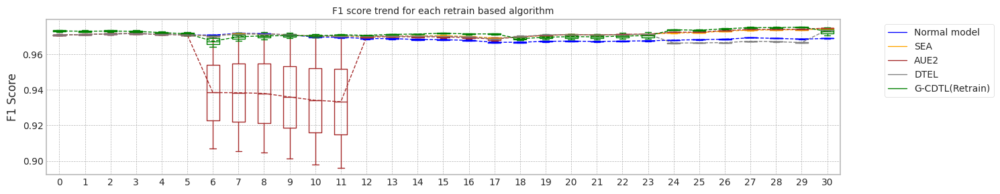

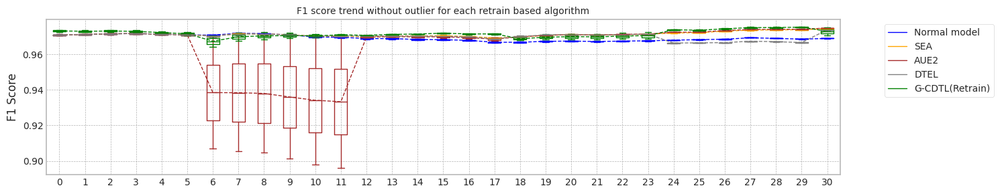

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.35658347606659
Base flops (train + inference flops of normal model, median): 5791640025.0


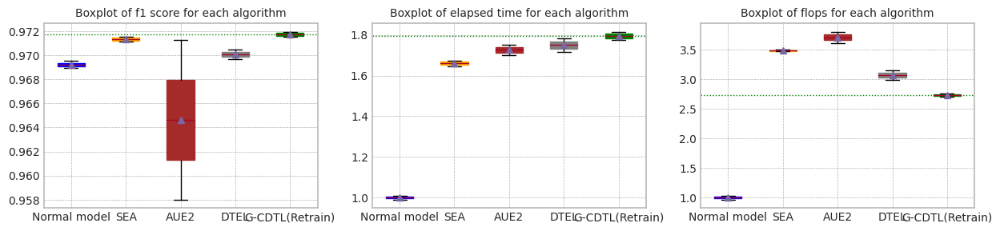

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.35658347606659


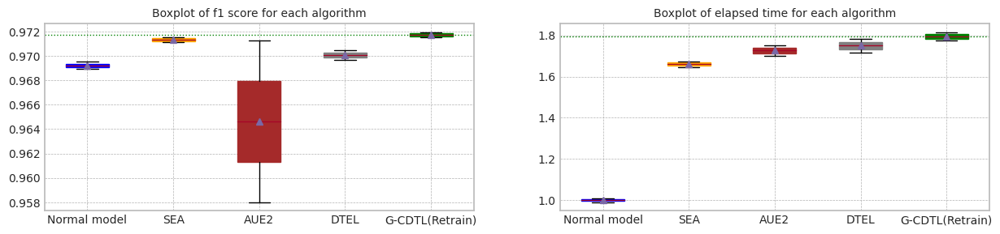

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.472057,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.241110,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.356583,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.163304,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.972462,0.973146,12.131438,1.285099e+10,1.297599e+09,1.414859e+10
1,1.0,0.972559,0.972347,0.971186,0.974133,12.074336,9.988364e+09,1.297599e+09,1.128596e+10
2,median,0.973163,0.973016,0.971824,0.973639,12.102887,1.141968e+10,1.297599e+09,1.271728e+10
3,std,0.000855,0.000947,0.000902,0.000698,0.040377,2.024185e+09,0.000000e+00,2.024185e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971118,0.974161,20.323659,9.427162e+09,1.087716e+10,2.030432e+10
1,1.0,0.971291,0.971524,0.971539,0.974868,20.689899,9.527212e+09,1.059387e+10,2.012109e+10
2,median,0.970932,0.971180,0.971328,0.974515,20.506779,9.477187e+09,1.073551e+10,2.021270e+10
3,std,0.000508,0.000487,0.000298,0.000500,0.258971,7.074603e+07,2.003103e+08,1.295643e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971289,0.974603,21.626348,1.017623e+10,1.188456e+10,2.206079e+10
1,1.0,0.971291,0.971524,0.958015,0.974947,21.024956,9.802132e+09,1.112713e+10,2.092926e+10
2,median,0.970932,0.971180,0.964652,0.974775,21.325652,9.989182e+09,1.150584e+10,2.149502e+10
3,std,0.000508,0.000487,0.009386,0.000243,0.425249,2.645286e+08,5.355850e+08,8.001136e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969681,0.973311,22.047882,1.045898e+10,7.808026e+09,1.826701e+10
1,1.0,0.971291,0.971524,0.970444,0.974352,21.206400,9.905662e+09,7.400334e+09,1.730600e+10
2,median,0.970932,0.971180,0.970063,0.973832,21.627141,1.018232e+10,7.604180e+09,1.778650e+10
3,std,0.000508,0.000487,0.000539,0.000736,0.595017,3.912563e+08,2.882815e+08,6.795378e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973768,0.973686,0.971949,0.975248,21.920685,1.566361e+10,19061215.0,1.568268e+10
1,1.0,0.972559,0.972347,0.971514,0.970723,22.434438,1.597210e+10,19061215.0,1.599117e+10
2,median,0.973163,0.973016,0.971732,0.972986,22.177561,1.581786e+10,19061215.0,1.583692e+10
3,std,0.000855,0.000947,0.000308,0.003200,0.363278,2.181354e+08,0.0,2.181354e+08


Test F1 Score: 0.9709319896192645
G-CDTL, 1-retrain: 0.9708444610532658


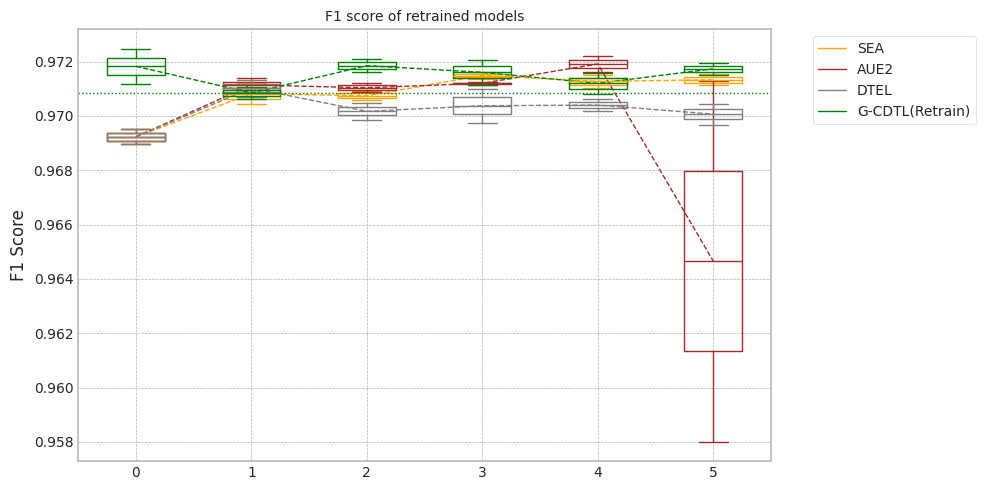

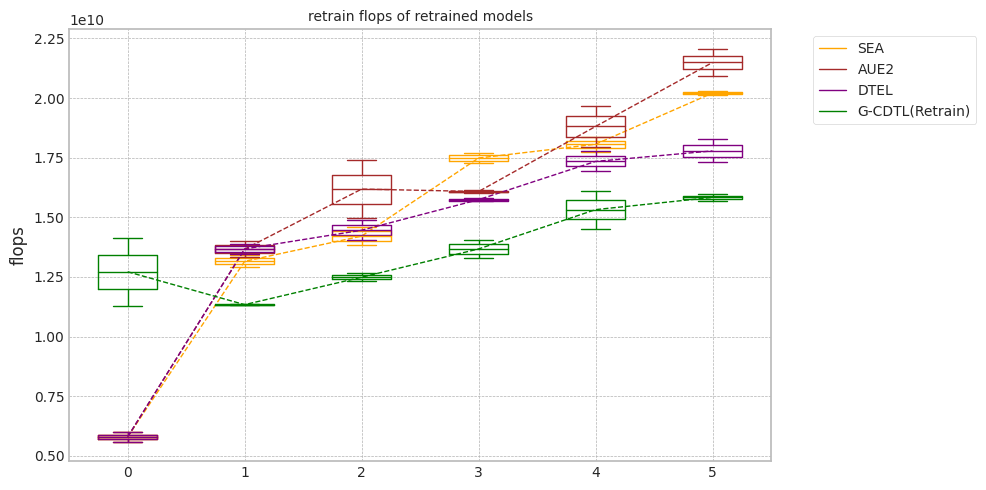

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 100,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

trial_count: 2
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:44:56,033] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:04<00:08, 152.26it/s]

Early stop: 686
[2023-12-04 00:45:00,544] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.44it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:45:13,303] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:45:13,305] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 269/2000 [00:01<00:10, 158.52it/s]

[2023-12-04 00:45:15,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:45:15,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 536396000 9051682500 2249989650 11838068150
precision_recall_fscore: (array([0.95683453, 0.95426938]), array([0.74645097, 0.9936756 ]), array([0.83864985, 0.9735739 ]), array([ 3029, 16128]))
Test f1 score: 0.9735739019500638
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.50it/s]

mean of drift:
recoveries              0.808287
last_fico_range_high    0.234578
last_pymnt_amnt         0.509060
total_rec_late_fee      0.885287
int_rate                0.130336
dtype: float64
Mean F1 for all data: 0.9711229895492556
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9711229895492556
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:45:27,555] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:02, 483.35it/s]

Early stop: 640
[2023-12-04 00:45:28,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.46it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:45:41,548] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:45:41,550] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 12%|█▎        | 250/2000 [00:01<00:11, 158.70it/s]

[2023-12-04 00:45:43,280] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:45:43,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1005742500 8414712250 2091657045 11512111795
precision_recall_fscore: (array([0.96470082, 0.95318997]), array([0.73984813, 0.99491567]), array([0.83744395, 0.97360597]), array([ 3029, 16128]))
Test f1 score: 0.9736059705114981
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.50it/s]


mean of drift:
recoveries              0.913880
last_fico_range_high    0.294566
last_pymnt_amnt         0.501739
total_rec_late_fee      0.941847
int_rate                0.127934
dtype: float64
Mean F1 for all data: 0.9717465061993269
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9714347478742913
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:05<00:06,  2.50it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:46:02,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:46:02,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:46:03,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:46:03,666] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:07<00:12,  1.17it/s]

G-CDTL train flops: 80500000 882000000 219240000 1181740000


100%|██████████| 31/31 [00:14<00:00,  2.18it/s]


Early stop at  [251]
Train flops  [1181740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716050426624195
G_CDTL+AUE median: 0.9716050426624195
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:11,  1.28it/s]

Ensemble_SEA train flops: 848250000


100%|██████████| 31/31 [00:13<00:00,  2.24it/s]


Early stop at  [974]
Train flops  [848250000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704310510892388
SEA median: 0.9704310510892388
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:10,  1.41it/s]

Ensemble_SEA train flops: 670770000


100%|██████████| 31/31 [00:13<00:00,  2.27it/s]


Early stop at  [770]
Train flops  [670770000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708867134498106
AUE median: 0.9708867134498106
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:12,  1.24it/s]

Ensemble_DTEL train flops: 888270000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:13<00:00,  2.22it/s]


Early stop at  [1020, 2]
Train flops  [888270000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9707083296140623
DTEL median: 0.9707083296140623
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:05<00:06,  2.51it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:46:57,952] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:46:57,954] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:46:59,646] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:46:59,648] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:08<00:13,  1.09it/s]

G-CDTL train flops: 91000000 1015000000 252300000 1358300000


100%|██████████| 31/31 [00:14<00:00,  2.17it/s]


Early stop at  [289]
Train flops  [1358300000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713378948138612
G_CDTL+AUE median: 0.9714714687381404
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:11,  1.27it/s]

Ensemble_SEA train flops: 782130000


100%|██████████| 31/31 [00:14<00:00,  2.21it/s]


Early stop at  [898]
Train flops  [782130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712076238970014
SEA median: 0.9708193374931201
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:15,  1.01s/it]

Ensemble_SEA train flops: 1212780000


100%|██████████| 31/31 [00:14<00:00,  2.10it/s]


Early stop at  [1393]
Train flops  [1212780000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.971388370026293
AUE median: 0.9711375417380518
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:12,  1.20it/s]

Ensemble_DTEL train flops: 864780000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:14<00:00,  2.20it/s]


Early stop at  [993, 2]
Train flops  [864780000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713309061802787
DTEL median: 0.9710196178971705


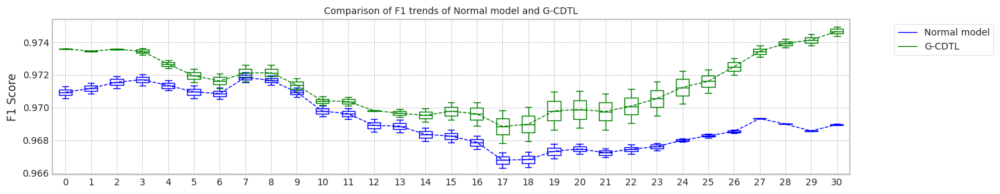

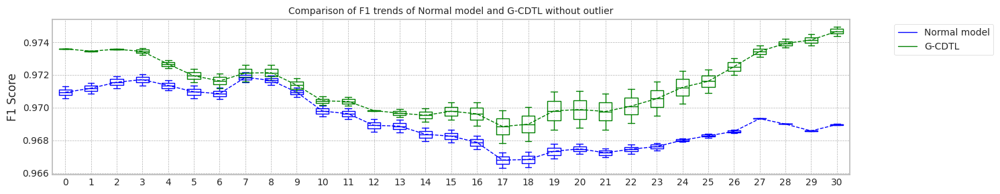

max_mean_trial= 1


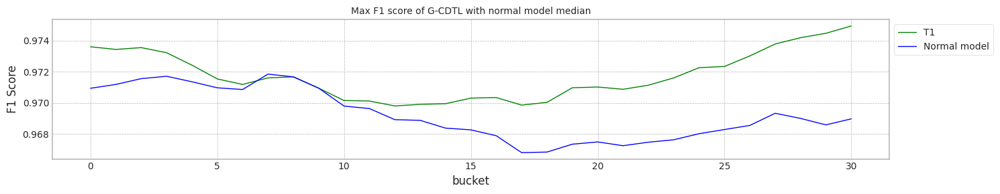

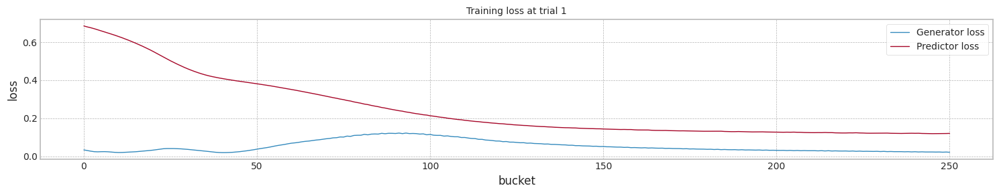

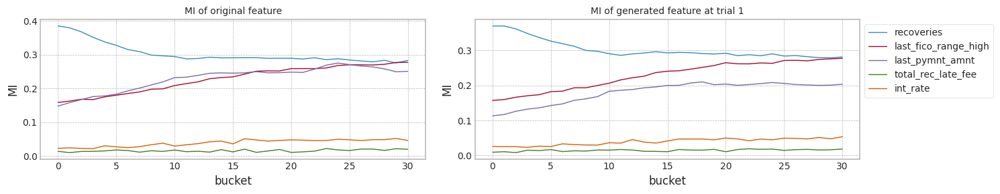

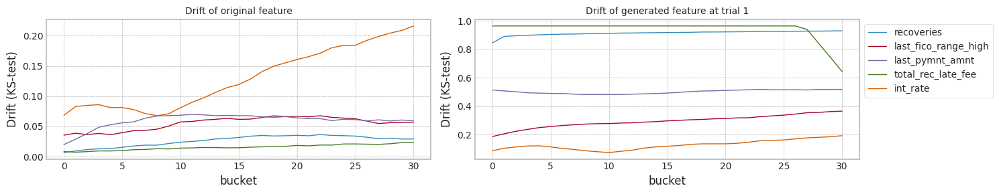

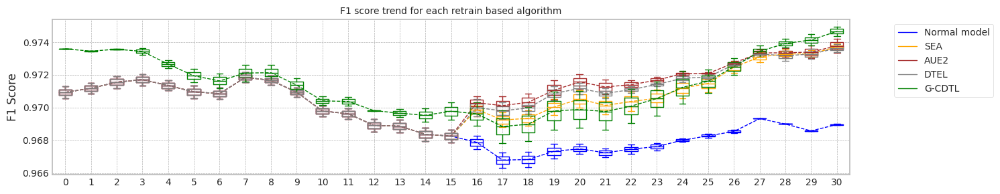

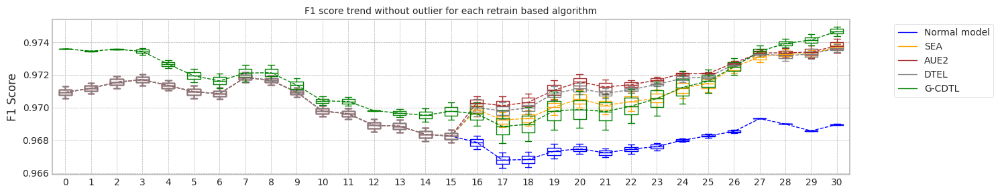

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.689690709114075
Base flops (inference flops of normal model, median): 258332145.0


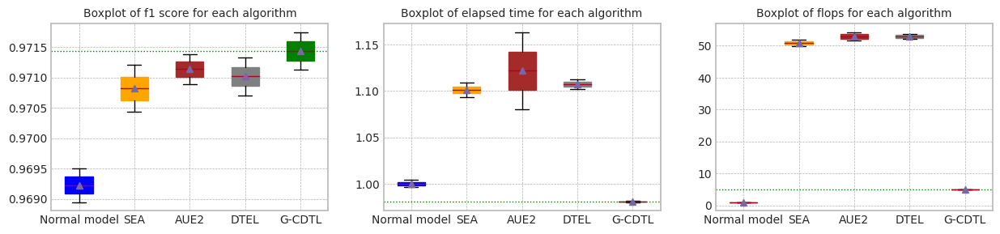

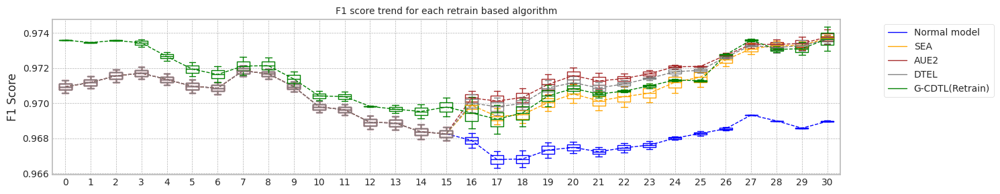

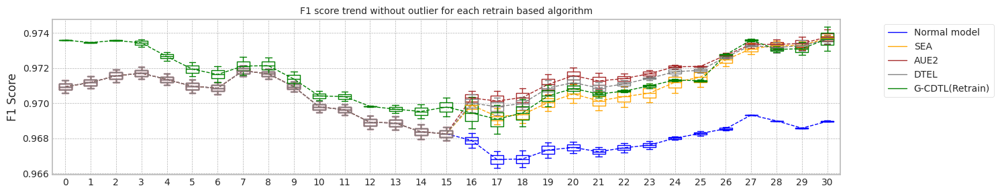

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.689690709114075
Base flops (train + inference flops of normal model, median): 5791640025.0


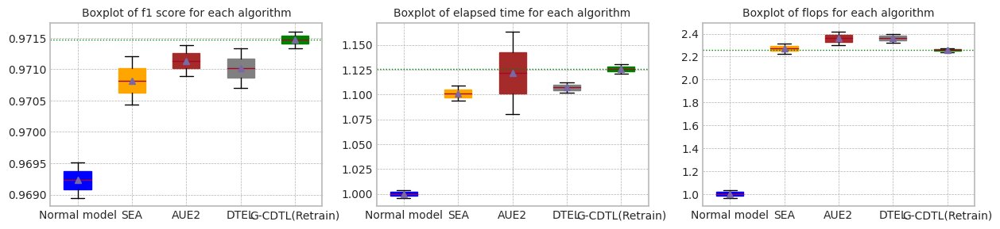

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.689690709114075


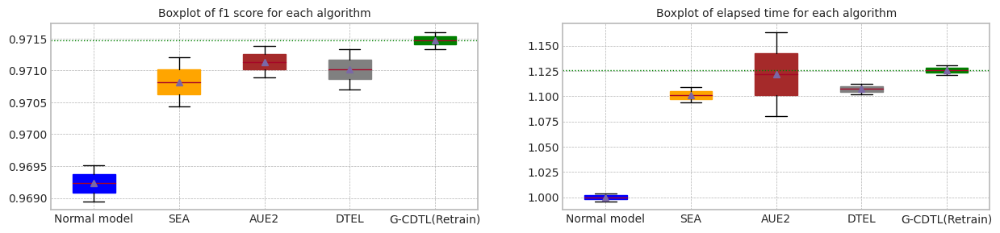

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.738994,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.640388,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.689691,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.069725,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971123,0.974376,12.436781,1.183807e+10,1.297599e+09,1.313567e+10
1,1.0,0.973606,0.973435,0.971747,0.974947,12.450154,1.151211e+10,1.297599e+09,1.280971e+10
2,median,0.973590,0.973450,0.971435,0.974661,12.443467,1.167509e+10,1.297599e+09,1.297269e+10
3,std,0.000023,0.000021,0.000441,0.000404,0.009456,2.304859e+08,0.000000e+00,2.304859e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970431,0.973518,13.876511,6.189892e+09,7.223221e+09,1.341311e+10
1,1.0,0.971291,0.971524,0.971208,0.973904,14.069874,6.123772e+09,6.773769e+09,1.289754e+10
2,median,0.970932,0.971180,0.970819,0.973711,13.973192,6.156832e+09,6.998495e+09,1.315533e+10
3,std,0.000508,0.000487,0.000549,0.000273,0.136728,4.675390e+07,3.178103e+08,3.645642e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970887,0.974193,13.705184,6.012412e+09,7.304073e+09,1.331648e+10
1,1.0,0.971291,0.971524,0.971388,0.973356,14.764953,6.554422e+09,7.462751e+09,1.401717e+10
2,median,0.970932,0.971180,0.971138,0.973774,14.235068,6.283417e+09,7.383412e+09,1.366683e+10
3,std,0.000508,0.000487,0.000355,0.000591,0.749370,3.832589e+08,1.122026e+08,4.954615e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970708,0.973385,13.981501,6.232522e+09,7.657516e+09,1.389004e+10
1,1.0,0.971291,0.971524,0.971331,0.973867,14.117676,6.209032e+09,7.250694e+09,1.345973e+10
2,median,0.970932,0.971180,0.971020,0.973626,14.049589,6.220777e+09,7.454105e+09,1.367488e+10
3,std,0.000508,0.000487,0.000440,0.000341,0.096290,1.660994e+07,2.876663e+08,3.042762e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971605,0.972977,14.222970,1.269385e+10,285918225.0,1.297977e+10
1,1.0,0.973606,0.973435,0.971338,0.974354,14.343536,1.287041e+10,285918225.0,1.315633e+10
2,median,0.973590,0.973450,0.971471,0.973665,14.283253,1.278213e+10,285918225.0,1.306805e+10
3,std,0.000023,0.000021,0.000189,0.000974,0.085253,1.248468e+08,0.0,1.248468e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:48:01,215] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:02, 488.36it/s]

Early stop: 686
[2023-12-04 00:48:02,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.42it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:48:15,505] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:48:15,508] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 269/2000 [00:01<00:11, 154.46it/s]

[2023-12-04 00:48:17,339] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:48:17,340] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 536396000 9051682500 2249989650 11838068150
precision_recall_fscore: (array([0.95683453, 0.95426938]), array([0.74645097, 0.9936756 ]), array([0.83864985, 0.9735739 ]), array([ 3029, 16128]))
Test f1 score: 0.9735739019500638
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]

mean of drift:
recoveries              0.808287
last_fico_range_high    0.234578
last_pymnt_amnt         0.509060
total_rec_late_fee      0.885287
int_rate                0.130336
dtype: float64
Mean F1 for all data: 0.9711229895492556
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9711229895492556
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:48:29,914] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:02, 487.21it/s]

Early stop: 640
[2023-12-04 00:48:31,234] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.42it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:48:44,095] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:48:44,098] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 12%|█▎        | 250/2000 [00:01<00:11, 151.87it/s]

[2023-12-04 00:48:45,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-12-04 00:48:45,910] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 1005742500 8414712250 2091657045 11512111795
precision_recall_fscore: (array([0.96470082, 0.95318997]), array([0.73984813, 0.99491567]), array([0.83744395, 0.97360597]), array([ 3029, 16128]))
Test f1 score: 0.9736059705114981
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]


mean of drift:
recoveries              0.913880
last_fico_range_high    0.294566
last_pymnt_amnt         0.501739
total_rec_late_fee      0.941847
int_rate                0.127934
dtype: float64
Mean F1 for all data: 0.9717465061993269
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9714347478742913
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:04<00:08,  2.44it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:49:03,016] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:49:03,018] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:49:04,611] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:49:04,612] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:18,  1.11it/s]

G-CDTL train flops: 98000000 917000000 227940000 1242940000


 68%|██████▊   | 21/31 [00:10<00:04,  2.36it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:49:09,116] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:49:09,118] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:49:10,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:49:10,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:12<00:07,  1.16it/s]

G-CDTL train flops: 84000000 840000000 208800000 1132800000


100%|██████████| 31/31 [00:15<00:00,  1.96it/s]


Early stop at  [261, 239]
Train flops  [1242940000, 1132800000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9723849760846135
G_CDTL+AUE median: 0.9723849760846135
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:13,  1.48it/s]

Ensemble_SEA train flops: 585510000


 71%|███████   | 22/31 [00:11<00:07,  1.28it/s]

Ensemble_SEA train flops: 799530000


100%|██████████| 31/31 [00:14<00:00,  2.08it/s]


Early stop at  [672, 918]
Train flops  [585510000, 799530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9705658267182677
SEA median: 0.9705658267182677
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:12,  1.61it/s]

Ensemble_SEA train flops: 470670000


 71%|███████   | 22/31 [00:11<00:07,  1.14it/s]

Ensemble_SEA train flops: 969180000


100%|██████████| 31/31 [00:14<00:00,  2.09it/s]


Early stop at  [540, 1113]
Train flops  [470670000, 969180000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708640720037569
AUE median: 0.9708640720037569
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:18,  1.06it/s]

Ensemble_DTEL train flops: 1137960000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:12<00:07,  1.20it/s]

Ensemble_DTEL train flops: 809970000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:15<00:00,  1.95it/s]


Early stop at  [1307, 1, 930, 1]
Train flops  [1137960000, 1740000, 809970000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9698597378586643
DTEL median: 0.9698597378586643
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:04<00:08,  2.48it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:50:04,502] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:50:04,504] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:50:06,257] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:50:06,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:18,  1.06it/s]

G-CDTL train flops: 70000000 1008000000 250560000 1328560000


 68%|██████▊   | 21/31 [00:10<00:04,  2.30it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:50:10,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:50:10,869] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:50:12,206] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:50:12,207] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:12<00:07,  1.20it/s]

G-CDTL train flops: 66500000 766500000 190530000 1023530000


100%|██████████| 31/31 [00:15<00:00,  1.95it/s]


Early stop at  [287, 218]
Train flops  [1328560000, 1023530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9720545838971303
G_CDTL+AUE median: 0.9722197799908718
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:13,  1.46it/s]

Ensemble_SEA train flops: 558540000


 71%|███████   | 22/31 [00:10<00:06,  1.40it/s]

Ensemble_SEA train flops: 628140000


100%|██████████| 31/31 [00:14<00:00,  2.12it/s]


Early stop at  [641, 721]
Train flops  [558540000, 628140000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.970911245086851
SEA median: 0.9707385359025593
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:19,  1.03it/s]

Ensemble_SEA train flops: 1104900000


 71%|███████   | 22/31 [00:13<00:11,  1.25s/it]

Ensemble_SEA train flops: 1740000000


100%|██████████| 31/31 [00:17<00:00,  1.79it/s]


Early stop at  [1269, 1999]
Train flops  [1104900000, 1740000000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712023197923523
AUE median: 0.9710331958980546
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:15,  1.32it/s]

Ensemble_DTEL train flops: 750810000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:11<00:07,  1.27it/s]

Ensemble_DTEL train flops: 782130000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:15<00:00,  2.06it/s]


Early stop at  [862, 1, 898, 1]
Train flops  [750810000, 1740000, 782130000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704735127799214
DTEL median: 0.9701666253192929


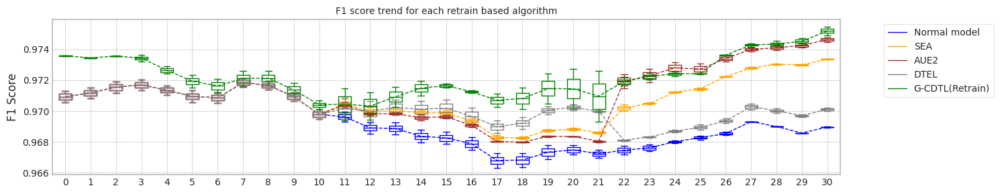

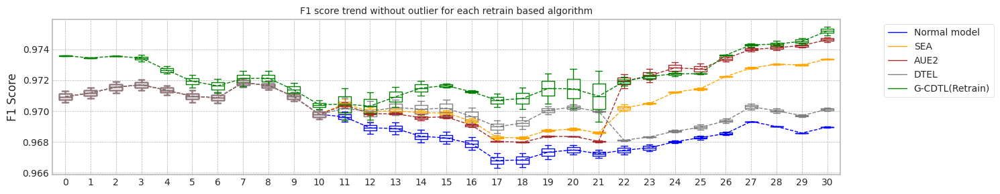

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.84596049785614
Base flops (train + inference flops of normal model, median): 5791640025.0


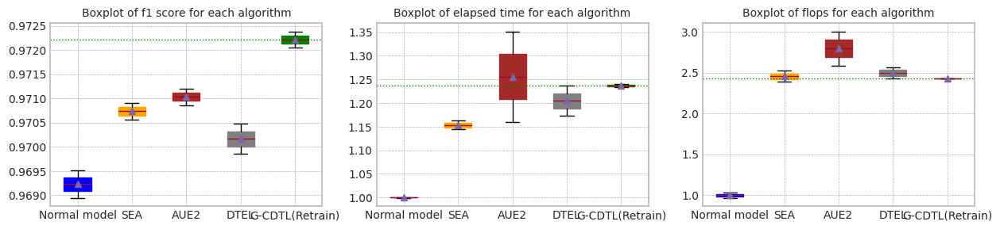

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.84596049785614


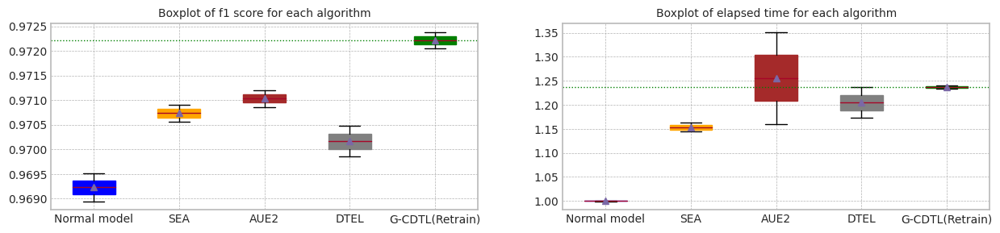

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.855305,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.836616,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.845960,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.013215,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971123,0.974376,12.553115,1.183807e+10,1.297599e+09,1.313567e+10
1,1.0,0.973606,0.973435,0.971747,0.974947,12.558880,1.151211e+10,1.297599e+09,1.280971e+10
2,median,0.973590,0.973450,0.971435,0.974661,12.555997,1.167509e+10,1.297599e+09,1.297269e+10
3,std,0.000023,0.000021,0.000441,0.000404,0.004077,2.304859e+08,0.000000e+00,2.304859e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970566,0.973395,14.931358,6.726682e+09,7.876677e+09,1.460336e+10
1,1.0,0.971291,0.971524,0.970911,0.973351,14.697084,6.528322e+09,7.294985e+09,1.382331e+10
2,median,0.970932,0.971180,0.970739,0.973373,14.814221,6.627502e+09,7.585831e+09,1.421333e+10
3,std,0.000508,0.000487,0.000244,0.000031,0.165657,1.402617e+08,4.113181e+08,5.515798e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970864,0.974473,14.896616,6.781492e+09,8.189819e+09,1.497131e+10
1,1.0,0.971291,0.971524,0.971202,0.974798,17.364614,8.186542e+09,9.211537e+09,1.739808e+10
2,median,0.970932,0.971180,0.971033,0.974636,16.130615,7.484017e+09,8.700678e+09,1.618470e+10
3,std,0.000508,0.000487,0.000239,0.000230,1.745138,9.935204e+08,7.224640e+08,1.715984e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969860,0.970019,15.891836,7.293052e+09,7.580086e+09,1.487314e+10
1,1.0,0.971291,0.971524,0.970474,0.970208,15.061572,6.878062e+09,7.168914e+09,1.404698e+10
2,median,0.970932,0.971180,0.970167,0.970113,15.476704,7.085557e+09,7.374500e+09,1.446006e+10
3,std,0.000508,0.000487,0.000434,0.000134,0.587085,2.934422e+08,2.907422e+08,5.841844e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.972385,0.975478,15.837022,1.388785e+10,171550935.0,1.405940e+10
1,1.0,0.973606,0.973435,0.972055,0.974925,15.927379,1.386420e+10,171550935.0,1.403575e+10
2,median,0.973590,0.973450,0.972220,0.975201,15.882200,1.387603e+10,171550935.0,1.404758e+10
3,std,0.000023,0.000021,0.000234,0.000391,0.063892,1.672308e+07,0.0,1.672308e+07


trial_count: 2
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:51:07,047] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:02, 465.20it/s]

Early stop: 686
[2023-12-04 00:51:08,527] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.43it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:51:21,321] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:51:21,323] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 269/2000 [00:01<00:11, 150.46it/s]

[2023-12-04 00:51:23,204] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:51:23,206] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 536396000 9051682500 2249989650 11838068150
precision_recall_fscore: (array([0.95683453, 0.95426938]), array([0.74645097, 0.9936756 ]), array([0.83864985, 0.9735739 ]), array([ 3029, 16128]))
Test f1 score: 0.9735739019500638
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.47it/s]

mean of drift:
recoveries              0.808287
last_fico_range_high    0.234578
last_pymnt_amnt         0.509060
total_rec_late_fee      0.885287
int_rate                0.130336
dtype: float64
Mean F1 for all data: 0.9711229895492556
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9711229895492556
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:51:35,811] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:02, 472.19it/s]

Early stop: 640
[2023-12-04 00:51:37,172] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.43it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:51:49,983] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:51:49,985] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 12%|█▎        | 250/2000 [00:01<00:11, 148.73it/s]

[2023-12-04 00:51:51,834] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:51:51,835] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1005742500 8414712250 2091657045 11512111795
precision_recall_fscore: (array([0.96470082, 0.95318997]), array([0.73984813, 0.99491567]), array([0.83744395, 0.97360597]), array([ 3029, 16128]))
Test f1 score: 0.9736059705114981
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]


mean of drift:
recoveries              0.913880
last_fico_range_high    0.294566
last_pymnt_amnt         0.501739
total_rec_late_fee      0.941847
int_rate                0.127934
dtype: float64
Mean F1 for all data: 0.9717465061993269
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9714347478742913
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.48it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:52:07,569] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:52:07,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:52:09,038] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:52:09,040] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:04<00:20,  1.15it/s]

G-CDTL train flops: 98000000 801500000 199230000 1098730000


 48%|████▊     | 15/31 [00:07<00:07,  2.28it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:52:12,286] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:52:12,288] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:52:13,740] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:52:13,741] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:09<00:13,  1.15it/s]

G-CDTL train flops: 84000000 805000000 200100000 1089100000


 74%|███████▍  | 23/31 [00:12<00:03,  2.22it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:52:17,055] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:52:17,057] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:52:18,613] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:52:18,614] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:14<00:06,  1.10it/s]

G-CDTL train flops: 73500000 885500000 220110000 1179110000


100%|██████████| 31/31 [00:17<00:00,  1.79it/s]


Early stop at  [228, 229, 252]
Train flops  [1098730000, 1089100000, 1179110000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.971879258615079
G_CDTL+AUE median: 0.971879258615079
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:23,  1.01s/it]

Ensemble_SEA train flops: 1204950000


 52%|█████▏    | 16/31 [00:09<00:12,  1.19it/s]

Ensemble_SEA train flops: 829980000


 77%|███████▋  | 24/31 [00:14<00:06,  1.14it/s]

Ensemble_SEA train flops: 834330000


100%|██████████| 31/31 [00:17<00:00,  1.78it/s]


Early stop at  [1384, 953, 958]
Train flops  [1204950000, 829980000, 834330000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713691910242813
SEA median: 0.9713691910242813
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:17,  1.30it/s]

Ensemble_SEA train flops: 728190000


 52%|█████▏    | 16/31 [00:08<00:10,  1.42it/s]

Ensemble_SEA train flops: 534180000


 77%|███████▋  | 24/31 [00:13<00:05,  1.28it/s]

Ensemble_SEA train flops: 696870000


100%|██████████| 31/31 [00:15<00:00,  1.94it/s]


Early stop at  [836, 613, 800]
Train flops  [728190000, 534180000, 696870000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711426732523949
AUE median: 0.9711426732523949
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:20,  1.14it/s]

Ensemble_DTEL train flops: 932640000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:07<00:07,  2.27it/s]

Ensemble_DTEL train flops: 783870000


 52%|█████▏    | 16/31 [00:09<00:14,  1.05it/s]

Ensemble_DTEL train flops: 284490000


 77%|███████▋  | 24/31 [00:13<00:05,  1.34it/s]

Ensemble_DTEL train flops: 632490000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:16<00:00,  1.84it/s]


Early stop at  [1071, 2, 900, 326, 726, 2]
Train flops  [932640000, 2610000, 783870000, 284490000, 632490000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9709881639156753
DTEL median: 0.9709881639156753
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.48it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:53:15,263] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:53:15,265] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:53:18,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:53:18,372] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:06<00:32,  1.39s/it]

G-CDTL train flops: 59500000 1827000000 454140000 2340640000


 48%|████▊     | 15/31 [00:09<00:07,  2.09it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:53:21,640] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:53:21,643] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:53:23,409] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:53:23,410] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:11<00:15,  1.01s/it]

G-CDTL train flops: 84000000 969500000 240990000 1294490000


 74%|███████▍  | 23/31 [00:14<00:03,  2.16it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:53:26,725] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:53:26,728] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:53:28,428] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:53:28,430] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:16<00:06,  1.04it/s]

G-CDTL train flops: 45500000 962500000 239250000 1247250000


100%|██████████| 31/31 [00:19<00:00,  1.61it/s]


Early stop at  [521, 276, 274]
Train flops  [2340640000, 1294490000, 1247250000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9718581987136423
G_CDTL+AUE median: 0.9718687286643606
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:22,  1.04it/s]

Ensemble_SEA train flops: 1044870000


 52%|█████▏    | 16/31 [00:09<00:11,  1.35it/s]

Ensemble_SEA train flops: 581160000


 77%|███████▋  | 24/31 [00:14<00:07,  1.08s/it]

Ensemble_SEA train flops: 1217130000


100%|██████████| 31/31 [00:17<00:00,  1.75it/s]


Early stop at  [1200, 667, 1398]
Train flops  [1044870000, 581160000, 1217130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715993679389141
SEA median: 0.9714842794815977
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:15,  1.44it/s]

Ensemble_SEA train flops: 509820000


 52%|█████▏    | 16/31 [00:08<00:12,  1.22it/s]

Ensemble_SEA train flops: 764730000


 77%|███████▋  | 24/31 [00:13<00:05,  1.19it/s]

Ensemble_SEA train flops: 816060000


100%|██████████| 31/31 [00:16<00:00,  1.90it/s]


Early stop at  [585, 878, 937]
Train flops  [509820000, 764730000, 816060000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712542407310201
AUE median: 0.9711984569917075
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:15,  1.47it/s]

Ensemble_DTEL train flops: 503730000
Ensemble_DTEL train flops: 1740000


 52%|█████▏    | 16/31 [00:09<00:14,  1.07it/s]

Ensemble_DTEL train flops: 1026600000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:14<00:07,  1.09s/it]

Ensemble_DTEL train flops: 1273680000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:17<00:00,  1.78it/s]


Early stop at  [578, 1, 1179, 1, 1463, 1]
Train flops  [503730000, 1740000, 1026600000, 1740000, 1273680000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9697548341943903
DTEL median: 0.9703714990550328


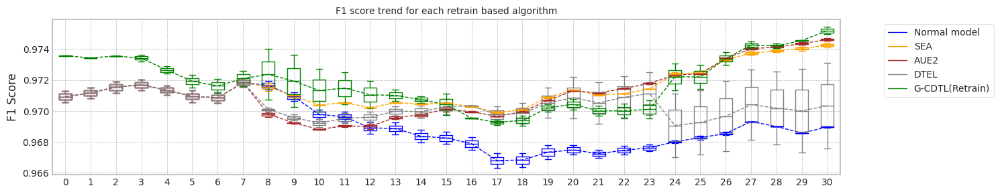

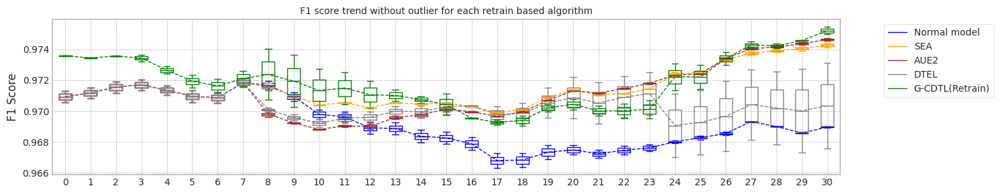

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.781062483787537
Base flops (train + inference flops of normal model, median): 5791640025.0


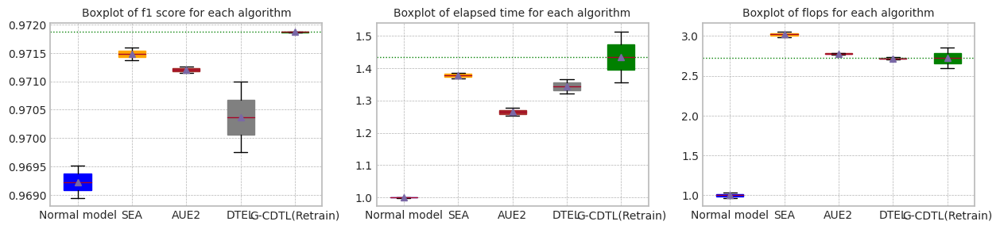

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.781062483787537


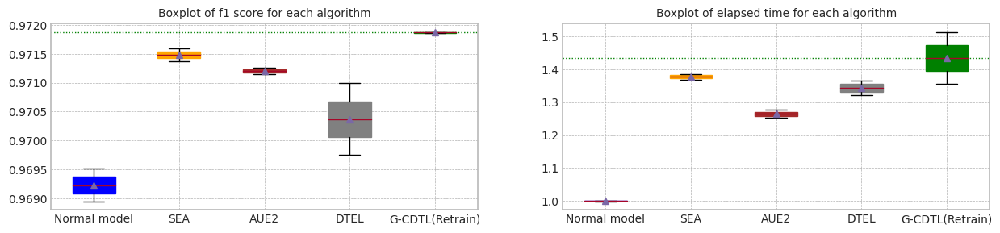

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.772074,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.790051,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.781062,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.012711,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971123,0.974376,12.580120,1.183807e+10,1.297599e+09,1.313567e+10
1,1.0,0.973606,0.973435,0.971747,0.974947,12.475801,1.151211e+10,1.297599e+09,1.280971e+10
2,median,0.973590,0.973450,0.971435,0.974661,12.527960,1.167509e+10,1.297599e+09,1.297269e+10
3,std,0.000023,0.000021,0.000441,0.000404,0.073765,2.304859e+08,0.000000e+00,2.304859e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971369,0.974142,17.498246,8.210902e+09,9.494230e+09,1.770513e+10
1,1.0,0.971291,0.971524,0.971599,0.974424,17.715914,8.184802e+09,9.084798e+09,1.726960e+10
2,median,0.970932,0.971180,0.971484,0.974283,17.607080,8.197852e+09,9.289514e+09,1.748737e+10
3,std,0.000508,0.000487,0.000163,0.000199,0.153914,1.845549e+07,2.895118e+08,3.079673e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971143,0.974745,16.003565,7.300882e+09,8.842542e+09,1.614342e+10
1,1.0,0.971291,0.971524,0.971254,0.974540,16.328688,7.432252e+09,8.590580e+09,1.602283e+10
2,median,0.970932,0.971180,0.971198,0.974642,16.166126,7.366567e+09,8.716561e+09,1.608313e+10
3,std,0.000508,0.000487,0.000079,0.000145,0.229896,9.289262e+07,1.781637e+08,8.527112e+07


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970988,0.973120,16.880342,7.980352e+09,7.688836e+09,1.566919e+10
1,1.0,0.971291,0.971524,0.969755,0.967562,17.460747,8.150872e+09,7.662204e+09,1.581308e+10
2,median,0.970932,0.971180,0.970371,0.970341,17.170545,8.065612e+09,7.675520e+09,1.574113e+10
3,std,0.000508,0.000487,0.000872,0.003931,0.410408,1.205758e+08,1.883136e+07,1.017445e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971879,0.974973,17.317046,1.487905e+10,133428505.0,1.501248e+10
1,1.0,0.973606,0.973435,0.971858,0.975476,19.341366,1.639449e+10,133428505.0,1.652792e+10
2,median,0.973590,0.973450,0.971869,0.975225,18.329206,1.563677e+10,133428505.0,1.577020e+10
3,std,0.000023,0.000021,0.000015,0.000356,1.431410,1.071578e+09,0.0,1.071578e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:54:27,139] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:02, 450.74it/s]

Early stop: 686
[2023-12-04 00:54:28,667] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.45it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:54:41,366] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:54:41,368] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 269/2000 [00:01<00:12, 143.87it/s]

[2023-12-04 00:54:43,332] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:54:43,333] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 536396000 9051682500 2249989650 11838068150
precision_recall_fscore: (array([0.95683453, 0.95426938]), array([0.74645097, 0.9936756 ]), array([0.83864985, 0.9735739 ]), array([ 3029, 16128]))
Test f1 score: 0.9735739019500638
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]

mean of drift:
recoveries              0.808287
last_fico_range_high    0.234578
last_pymnt_amnt         0.509060
total_rec_late_fee      0.885287
int_rate                0.130336
dtype: float64
Mean F1 for all data: 0.9711229895492556
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9711229895492556
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:54:55,893] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 449.63it/s]

Early stop: 640
[2023-12-04 00:54:57,323] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.46it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:55:09,999] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:55:10,002] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 12%|█▎        | 250/2000 [00:01<00:12, 144.00it/s]

[2023-12-04 00:55:11,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:55:11,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1005742500 8414712250 2091657045 11512111795
precision_recall_fscore: (array([0.96470082, 0.95318997]), array([0.73984813, 0.99491567]), array([0.83744395, 0.97360597]), array([ 3029, 16128]))
Test f1 score: 0.9736059705114981
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.47it/s]


mean of drift:
recoveries              0.913880
last_fico_range_high    0.294566
last_pymnt_amnt         0.501739
total_rec_late_fee      0.941847
int_rate                0.127934
dtype: float64
Mean F1 for all data: 0.9717465061993269
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9714347478742913
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:10,  2.44it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:55:27,460] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:55:27,462] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:55:29,063] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:55:29,064] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:04<00:22,  1.06it/s]

G-CDTL train flops: 98000000 843500000 209670000 1151170000


 42%|████▏     | 13/31 [00:07<00:08,  2.14it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:55:31,957] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:55:31,959] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:55:33,586] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:55:33,587] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:09<00:16,  1.06it/s]

G-CDTL train flops: 84000000 854000000 212280000 1150280000


 65%|██████▍   | 20/31 [00:11<00:05,  2.07it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:55:36,534] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:55:36,536] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:55:38,143] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:55:38,144] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:13<00:09,  1.05it/s]

G-CDTL train flops: 77000000 854000000 212280000 1143280000


 87%|████████▋ | 27/31 [00:16<00:01,  2.09it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:55:41,064] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:55:41,066] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:55:42,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:55:42,645] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:18<00:02,  1.07it/s]

G-CDTL train flops: 87500000 833000000 207060000 1127560000


100%|██████████| 31/31 [00:19<00:00,  1.60it/s]


Early stop at  [240, 243, 243, 237]
Train flops  [1151170000, 1150280000, 1143280000, 1127560000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9719688340613399
G_CDTL+AUE median: 0.9719688340613399
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:21,  1.13it/s]

Ensemble_SEA train flops: 879570000


 45%|████▌     | 14/31 [00:07<00:10,  1.59it/s]

Ensemble_SEA train flops: 372360000


 68%|██████▊   | 21/31 [00:11<00:07,  1.28it/s]

Ensemble_SEA train flops: 643800000


 90%|█████████ | 28/31 [00:16<00:02,  1.08it/s]

Ensemble_SEA train flops: 963090000


100%|██████████| 31/31 [00:17<00:00,  1.77it/s]


Early stop at  [1010, 427, 739, 1106]
Train flops  [879570000, 372360000, 643800000, 963090000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710255193220678
SEA median: 0.9710255193220678
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:21,  1.14it/s]

Ensemble_SEA train flops: 878700000


 45%|████▌     | 14/31 [00:08<00:13,  1.26it/s]

Ensemble_SEA train flops: 672510000


 68%|██████▊   | 21/31 [00:13<00:10,  1.02s/it]

Ensemble_SEA train flops: 1145790000


 90%|█████████ | 28/31 [00:17<00:02,  1.05it/s]

Ensemble_SEA train flops: 994410000


100%|██████████| 31/31 [00:18<00:00,  1.64it/s]


Early stop at  [1009, 772, 1316, 1142]
Train flops  [878700000, 672510000, 1145790000, 994410000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716229351529815
AUE median: 0.9716229351529815
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:26,  1.09s/it]

Ensemble_DTEL train flops: 1271070000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:09<00:18,  1.09s/it]

Ensemble_DTEL train flops: 1236270000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:13<00:07,  1.39it/s]

Ensemble_DTEL train flops: 474150000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:18<00:03,  1.11s/it]

Ensemble_DTEL train flops: 1330230000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:20<00:00,  1.55it/s]


Early stop at  [1460, 1, 1420, 1, 544, 1, 1528, 1]
Train flops  [1271070000, 1740000, 1236270000, 1740000, 474150000, 1740000, 1330230000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9701765674663698
DTEL median: 0.9701765674663698
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:09,  2.51it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:56:43,267] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:56:43,269] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:56:48,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:56:48,149] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:07<00:48,  2.00s/it]

G-CDTL train flops: 101500000 2660000000 661200000 3422700000


 42%|████▏     | 13/31 [00:10<00:10,  1.73it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:56:51,004] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:56:51,007] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:56:53,484] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:56:53,485] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:13<00:21,  1.28s/it]

G-CDTL train flops: 52500000 1340500000 333210000 1726210000


 65%|██████▍   | 20/31 [00:15<00:05,  1.93it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:56:56,431] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:56:56,433] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:56:58,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:56:58,115] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:17<00:10,  1.00s/it]

G-CDTL train flops: 140000000 794500000 197490000 1131990000


 87%|████████▋ | 27/31 [00:20<00:01,  2.05it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:57:01,071] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:57:01,073] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:57:03,561] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:57:03,563] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:23<00:03,  1.22s/it]

G-CDTL train flops: 77000000 1295000000 321900000 1693900000


100%|██████████| 31/31 [00:24<00:00,  1.27it/s]


Early stop at  [759, 382, 226, 369]
Train flops  [3422700000, 1726210000, 1131990000, 1693900000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710565578929007
G_CDTL+AUE median: 0.9715126959771203
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:21,  1.14it/s]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 14/31 [00:08<00:14,  1.21it/s]

Ensemble_SEA train flops: 771690000


 68%|██████▊   | 21/31 [00:12<00:09,  1.09it/s]

Ensemble_SEA train flops: 893490000


 90%|█████████ | 28/31 [00:17<00:02,  1.16it/s]

Ensemble_SEA train flops: 822150000


100%|██████████| 31/31 [00:18<00:00,  1.69it/s]


Early stop at  [999, 886, 1026, 944]
Train flops  [870000000, 771690000, 893490000, 822150000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715103974730905
SEA median: 0.9712679583975792
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:20,  1.16it/s]

Ensemble_SEA train flops: 823890000


 45%|████▌     | 14/31 [00:08<00:14,  1.21it/s]

Ensemble_SEA train flops: 736890000


 68%|██████▊   | 21/31 [00:12<00:06,  1.49it/s]

Ensemble_SEA train flops: 452400000


 90%|█████████ | 28/31 [00:16<00:02,  1.06it/s]

Ensemble_SEA train flops: 998760000


100%|██████████| 31/31 [00:17<00:00,  1.73it/s]


Early stop at  [946, 846, 519, 1147]
Train flops  [823890000, 736890000, 452400000, 998760000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721987849135504
AUE median: 0.971910860033266
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:20,  1.19it/s]

Ensemble_DTEL train flops: 796920000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:08<00:14,  1.21it/s]

Ensemble_DTEL train flops: 773430000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:12<00:08,  1.17it/s]

Ensemble_DTEL train flops: 792570000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:17<00:03,  1.17s/it]

Ensemble_DTEL train flops: 1412880000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:19<00:00,  1.62it/s]


Early stop at  [915, 1, 888, 1, 910, 1, 1623, 1]
Train flops  [796920000, 1740000, 773430000, 1740000, 792570000, 1740000, 1412880000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9706180120334442
DTEL median: 0.970397289749907


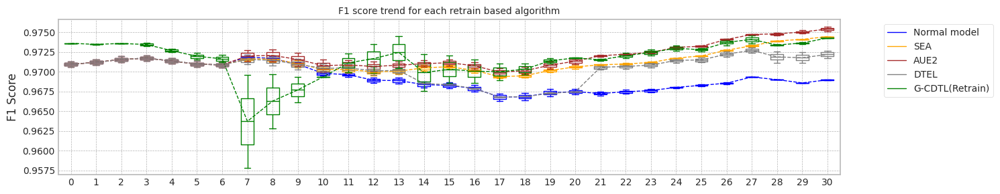

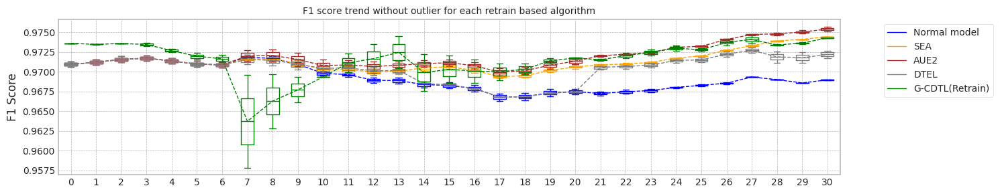

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.6656014919281
Base flops (train + inference flops of normal model, median): 5791640025.0


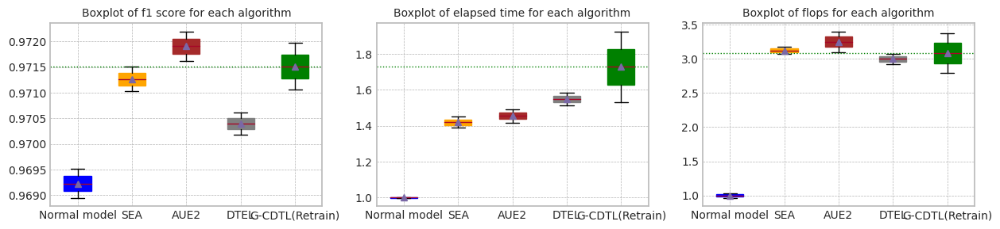

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.6656014919281


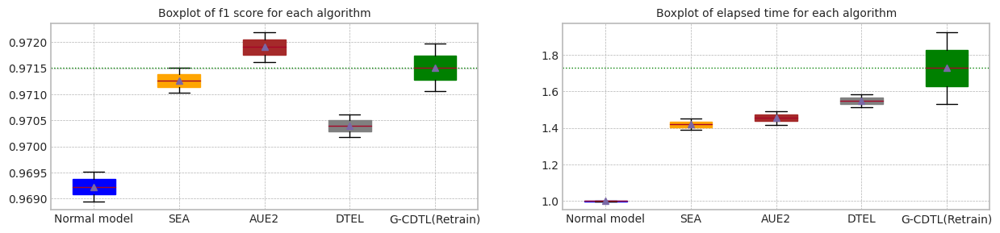

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.679393,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.651810,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.665601,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.019505,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971123,0.974376,12.539508,1.183807e+10,1.297599e+09,1.313567e+10
1,1.0,0.973606,0.973435,0.971747,0.974947,12.582840,1.151211e+10,1.297599e+09,1.280971e+10
2,median,0.973590,0.973450,0.971435,0.974661,12.561174,1.167509e+10,1.297599e+09,1.297269e+10
3,std,0.000023,0.000021,0.000441,0.000404,0.030640,2.304859e+08,0.000000e+00,2.304859e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971026,0.974405,17.578500,8.200462e+09,9.558789e+09,1.775925e+10
1,1.0,0.971291,0.971524,0.971510,0.974443,18.359333,8.698972e+09,9.673968e+09,1.837294e+10
2,median,0.970932,0.971180,0.971268,0.974424,17.968916,8.449717e+09,9.616378e+09,1.806610e+10
3,std,0.000508,0.000487,0.000343,0.000027,0.552132,3.524998e+08,8.144345e+07,4.339433e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971623,0.975692,18.910443,9.033052e+09,1.064971e+10,1.968276e+10
1,1.0,0.971291,0.971524,0.972199,0.975094,17.946511,8.353582e+09,9.586910e+09,1.794049e+10
2,median,0.970932,0.971180,0.971911,0.975393,18.428477,8.693317e+09,1.011831e+10,1.881163e+10
3,std,0.000508,0.000487,0.000407,0.000423,0.681603,4.804578e+08,7.515142e+08,1.231972e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970177,0.972674,20.042430,9.660322e+09,8.103826e+09,1.776415e+10
1,1.0,0.971291,0.971524,0.970618,0.971668,19.153925,9.124402e+09,7.803144e+09,1.692755e+10
2,median,0.970932,0.971180,0.970397,0.972171,19.598178,9.392362e+09,7.953485e+09,1.734585e+10
3,std,0.000508,0.000487,0.000312,0.000711,0.628268,3.789527e+08,2.126140e+08,5.915666e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971969,0.974314,19.395680,1.608440e+10,57183645.0,1.614159e+10
1,1.0,0.973606,0.973435,0.971057,0.974213,24.372382,1.948691e+10,57183645.0,1.954410e+10
2,median,0.973590,0.973450,0.971513,0.974263,21.884031,1.778566e+10,57183645.0,1.784284e+10
3,std,0.000023,0.000021,0.000645,0.000071,3.519060,2.405938e+09,0.0,2.405938e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 00:58:04,304] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 434.90it/s]

Early stop: 686
[2023-12-04 00:58:05,889] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.43it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:58:18,705] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:58:18,708] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 269/2000 [00:02<00:12, 133.81it/s]

[2023-12-04 00:58:20,821] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:58:20,822] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 536396000 9051682500 2249989650 11838068150
precision_recall_fscore: (array([0.95683453, 0.95426938]), array([0.74645097, 0.9936756 ]), array([0.83864985, 0.9735739 ]), array([ 3029, 16128]))
Test f1 score: 0.9735739019500638
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.46it/s]

mean of drift:
recoveries              0.808287
last_fico_range_high    0.234578
last_pymnt_amnt         0.509060
total_rec_late_fee      0.885287
int_rate                0.130336
dtype: float64
Mean F1 for all data: 0.9711229895492556
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9711229895492556
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 00:58:33,485] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 421.77it/s]

Early stop: 640
[2023-12-04 00:58:35,009] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.43it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 00:58:47,820] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:58:47,823] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 12%|█▎        | 250/2000 [00:01<00:13, 131.76it/s]

[2023-12-04 00:58:49,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:58:49,897] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1005742500 8414712250 2091657045 11512111795
precision_recall_fscore: (array([0.96470082, 0.95318997]), array([0.73984813, 0.99491567]), array([0.83744395, 0.97360597]), array([ 3029, 16128]))
Test f1 score: 0.9736059705114981
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.47it/s]


mean of drift:
recoveries              0.913880
last_fico_range_high    0.294566
last_pymnt_amnt         0.501739
total_rec_late_fee      0.941847
int_rate                0.127934
dtype: float64
Mean F1 for all data: 0.9717465061993269
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9714347478742913
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:02<00:10,  2.41it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:59:05,025] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:59:05,027] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:59:06,822] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:59:06,823] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:04<00:25,  1.02s/it]

G-CDTL train flops: 101500000 906500000 225330000 1233330000


 35%|███▌      | 11/31 [00:06<00:09,  2.01it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:59:09,252] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:59:09,255] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:59:10,912] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:59:10,914] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:08<00:18,  1.02it/s]

G-CDTL train flops: 87500000 854000000 212280000 1153780000


 55%|█████▍    | 17/31 [00:10<00:08,  1.67it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:59:13,682] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:59:13,684] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:59:15,616] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:59:15,617] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:13<00:14,  1.13s/it]

G-CDTL train flops: 77000000 983500000 244470000 1304970000


 74%|███████▍  | 23/31 [00:15<00:04,  1.87it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:59:18,126] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:59:18,129] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:59:20,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:59:20,904] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:18<00:09,  1.33s/it]

G-CDTL train flops: 87500000 1421000000 353220000 1861720000


 94%|█████████▎| 29/31 [00:20<00:01,  1.75it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 00:59:23,408] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 00:59:23,411] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 00:59:25,200] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 00:59:25,201] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:22<00:01,  1.06s/it]

G-CDTL train flops: 63000000 920500000 228810000 1212310000


100%|██████████| 31/31 [00:23<00:00,  1.34it/s]


Early stop at  [258, 243, 280, 405, 262]
Train flops  [1233330000, 1153780000, 1304970000, 1861720000, 1212310000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9723388168649203
G_CDTL+AUE median: 0.9723388168649203
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:20,  1.25it/s]

Ensemble_SEA train flops: 650760000


 39%|███▊      | 12/31 [00:07<00:17,  1.10it/s]

Ensemble_SEA train flops: 857820000


 58%|█████▊    | 18/31 [00:11<00:12,  1.07it/s]

Ensemble_SEA train flops: 876960000


 77%|███████▋  | 24/31 [00:15<00:06,  1.12it/s]

Ensemble_SEA train flops: 796050000


 97%|█████████▋| 30/31 [00:19<00:00,  1.06it/s]

Ensemble_SEA train flops: 903930000


100%|██████████| 31/31 [00:19<00:00,  1.55it/s]


Early stop at  [747, 985, 1007, 914, 1038]
Train flops  [650760000, 857820000, 876960000, 796050000, 903930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711175965760679
SEA median: 0.9711175965760679
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:05<00:33,  1.35s/it]

Ensemble_SEA train flops: 1557300000


 39%|███▊      | 12/31 [00:08<00:15,  1.25it/s]

Ensemble_SEA train flops: 555930000


 58%|█████▊    | 18/31 [00:12<00:13,  1.00s/it]

Ensemble_SEA train flops: 1010070000


 77%|███████▋  | 24/31 [00:16<00:06,  1.15it/s]

Ensemble_SEA train flops: 716010000


 97%|█████████▋| 30/31 [00:20<00:01,  1.00s/it]

Ensemble_SEA train flops: 995280000


100%|██████████| 31/31 [00:21<00:00,  1.45it/s]


Early stop at  [1789, 638, 1160, 822, 1143]
Train flops  [1557300000, 555930000, 1010070000, 716010000, 995280000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712888666969133
AUE median: 0.9712888666969133
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:20,  1.24it/s]

Ensemble_DTEL train flops: 662940000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:07<00:17,  1.08it/s]

Ensemble_DTEL train flops: 910020000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:12<00:17,  1.32s/it]

Ensemble_DTEL train flops: 1636470000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:16<00:07,  1.00s/it]

Ensemble_DTEL train flops: 866520000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:21<00:01,  1.01s/it]

Ensemble_DTEL train flops: 1030950000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:21<00:00,  1.43it/s]


Early stop at  [761, 1, 1045, 1, 1880, 1, 995, 2, 1184, 2]
Train flops  [662940000, 1740000, 910020000, 1740000, 1636470000, 1740000, 866520000, 2610000, 1030950000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9696813476817351
DTEL median: 0.9696813476817351
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:02<00:10,  2.49it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:00:31,171] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:00:31,173] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:00:33,109] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:00:33,110] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:04<00:26,  1.06s/it]

G-CDTL train flops: 87500000 948500000 235770000 1271770000


 35%|███▌      | 11/31 [00:06<00:10,  1.91it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:00:35,623] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:00:35,625] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:00:37,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:00:37,511] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:08<00:20,  1.07s/it]

G-CDTL train flops: 77000000 934500000 232290000 1243790000


 55%|█████▍    | 17/31 [00:10<00:07,  1.93it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:00:39,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:00:39,966] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:00:42,043] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:00:42,044] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:13<00:14,  1.11s/it]

G-CDTL train flops: 73500000 1050000000 261000000 1384500000


 74%|███████▍  | 23/31 [00:15<00:04,  1.88it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:00:44,525] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:00:44,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:00:46,283] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:00:46,285] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:17<00:07,  1.03s/it]

G-CDTL train flops: 59500000 875000000 217500000 1152000000


 94%|█████████▎| 29/31 [00:19<00:01,  1.91it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:00:48,823] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:00:48,826] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:00:52,213] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:00:52,214] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:23<00:01,  1.51s/it]

G-CDTL train flops: 38500000 1718500000 427170000 2184170000


100%|██████████| 31/31 [00:23<00:00,  1.30it/s]


Early stop at  [270, 266, 299, 249, 490]
Train flops  [1271770000, 1243790000, 1384500000, 1152000000, 2184170000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9724157151597986
G_CDTL+AUE median: 0.9723772660123595
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:19,  1.31it/s]

Ensemble_SEA train flops: 590730000


 39%|███▊      | 12/31 [00:07<00:17,  1.07it/s]

Ensemble_SEA train flops: 897840000


 58%|█████▊    | 18/31 [00:12<00:14,  1.10s/it]

Ensemble_SEA train flops: 1156230000


 77%|███████▋  | 24/31 [00:16<00:06,  1.05it/s]

Ensemble_SEA train flops: 856950000


 97%|█████████▋| 30/31 [00:19<00:00,  1.18it/s]

Ensemble_SEA train flops: 683820000


100%|██████████| 31/31 [00:20<00:00,  1.53it/s]


Early stop at  [678, 1031, 1328, 984, 785]
Train flops  [590730000, 897840000, 1156230000, 856950000, 683820000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715388974373196
SEA median: 0.9713282470066937
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:04<00:26,  1.06s/it]

Ensemble_SEA train flops: 1054440000


 39%|███▊      | 12/31 [00:08<00:21,  1.12s/it]

Ensemble_SEA train flops: 1181460000


 58%|█████▊    | 18/31 [00:12<00:11,  1.10it/s]

Ensemble_SEA train flops: 789090000


 77%|███████▋  | 24/31 [00:16<00:06,  1.07it/s]

Ensemble_SEA train flops: 809970000


 97%|█████████▋| 30/31 [00:20<00:00,  1.24it/s]

Ensemble_SEA train flops: 625530000


100%|██████████| 31/31 [00:20<00:00,  1.49it/s]


Early stop at  [1211, 1357, 906, 930, 718]
Train flops  [1054440000, 1181460000, 789090000, 809970000, 625530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9580149166477061
AUE median: 0.9646518916723097
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:20,  1.20it/s]

Ensemble_DTEL train flops: 688170000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:08<00:20,  1.05s/it]

Ensemble_DTEL train flops: 1101420000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:11<00:11,  1.10it/s]

Ensemble_DTEL train flops: 787350000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:16<00:06,  1.01it/s]

Ensemble_DTEL train flops: 970050000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:20<00:01,  1.01s/it]

Ensemble_DTEL train flops: 1006590000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:20<00:00,  1.49it/s]


Early stop at  [790, 1, 1265, 1, 904, 1, 1114, 2, 1156, 2]
Train flops  [688170000, 1740000, 1101420000, 1740000, 787350000, 1740000, 970050000, 2610000, 1006590000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704439393300356
DTEL median: 0.9700626435058853


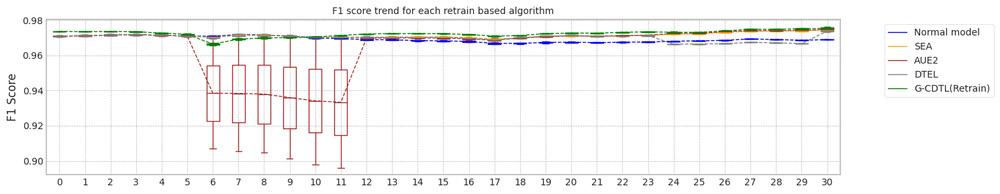

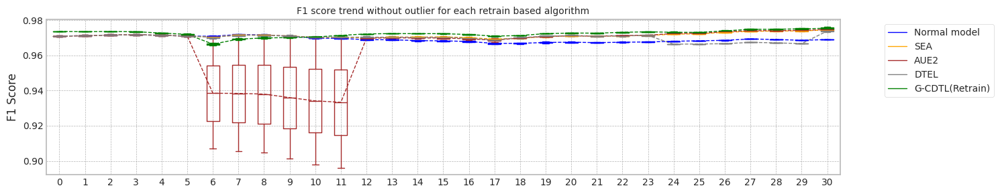

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.791395783424377
Base flops (train + inference flops of normal model, median): 5791640025.0


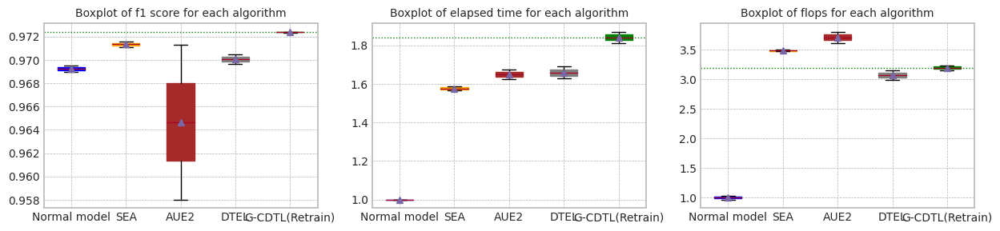

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.791395783424377


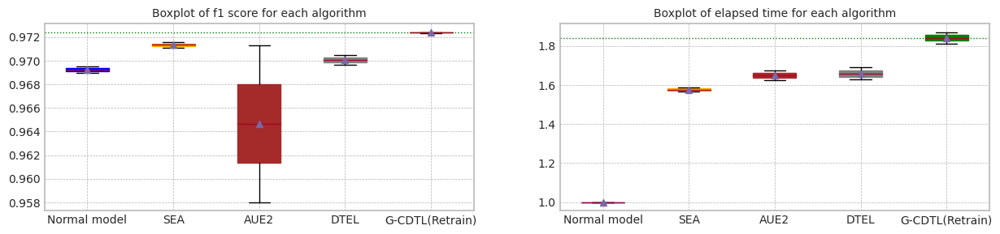

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.794259,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.788532,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.791396,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.004049,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.971123,0.974376,12.638371,1.183807e+10,1.297599e+09,1.313567e+10
1,1.0,0.973606,0.973435,0.971747,0.974947,12.563209,1.151211e+10,1.297599e+09,1.280971e+10
2,median,0.973590,0.973450,0.971435,0.974661,12.600790,1.167509e+10,1.297599e+09,1.297269e+10
3,std,0.000023,0.000021,0.000441,0.000404,0.053147,2.304859e+08,0.000000e+00,2.304859e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971118,0.974161,20.029380,9.427162e+09,1.087716e+10,2.030432e+10
1,1.0,0.971291,0.971524,0.971539,0.974868,20.306207,9.527212e+09,1.059387e+10,2.012109e+10
2,median,0.970932,0.971180,0.971328,0.974515,20.167793,9.477187e+09,1.073551e+10,2.021270e+10
3,std,0.000508,0.000487,0.000298,0.000500,0.195746,7.074603e+07,2.003103e+08,1.295643e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971289,0.974603,21.393774,1.017623e+10,1.188456e+10,2.206079e+10
1,1.0,0.971291,0.971524,0.958015,0.974947,20.805429,9.802132e+09,1.112713e+10,2.092926e+10
2,median,0.970932,0.971180,0.964652,0.974775,21.099601,9.989182e+09,1.150584e+10,2.149502e+10
3,std,0.000508,0.000487,0.009386,0.000243,0.416023,2.645286e+08,5.355850e+08,8.001136e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969681,0.973311,21.637198,1.045898e+10,7.808026e+09,1.826701e+10
1,1.0,0.971291,0.971524,0.970444,0.974352,20.808190,9.905662e+09,7.400334e+09,1.730600e+10
2,median,0.970932,0.971180,0.970063,0.973832,21.222694,1.018232e+10,7.604180e+09,1.778650e+10
3,std,0.000508,0.000487,0.000539,0.000736,0.586197,3.912563e+08,2.882815e+08,6.795378e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973574,0.973465,0.972339,0.974523,23.162631,1.827822e+10,19061215.0,1.829728e+10
1,1.0,0.973606,0.973435,0.972416,0.976301,23.930902,1.874834e+10,19061215.0,1.876740e+10
2,median,0.973590,0.973450,0.972377,0.975412,23.546766,1.851328e+10,19061215.0,1.853234e+10
3,std,0.000023,0.000021,0.000054,0.001257,0.543249,3.324250e+08,0.0,3.324250e+08


Test F1 Score: 0.9709319896192645
G-CDTL, 1-retrain: 0.9714714687381404


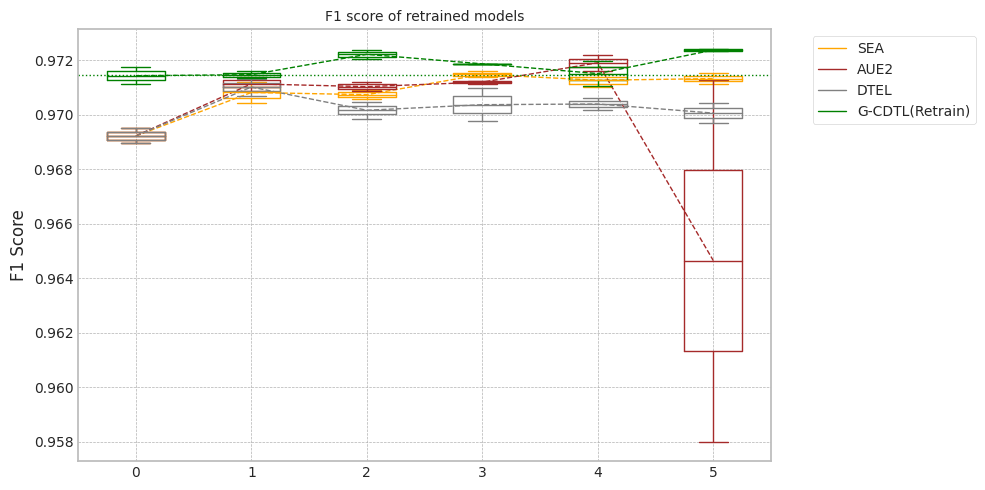

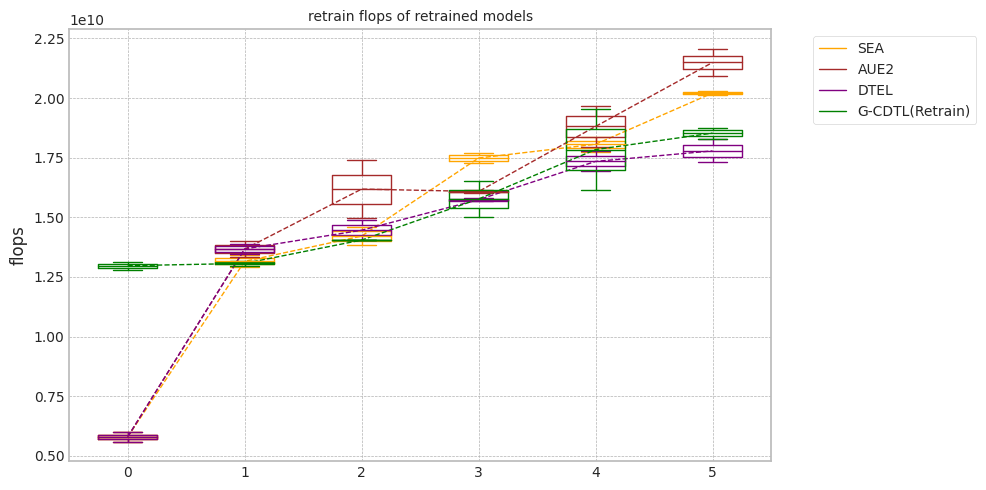

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 200,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

trial_count: 2
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 01:05:59,453] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 423.38it/s]

Early stop: 686
[2023-12-04 01:06:01,081] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:06:13,597] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:06:13,599] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 14%|█▍        | 282/2000 [00:02<00:13, 129.15it/s]

[2023-12-04 01:06:15,897] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:06:15,898] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 9487504250 2358322485 12415747485
precision_recall_fscore: (array([0.95940803, 0.95474035]), array([0.74909211, 0.99404762]), array([0.84130515, 0.97399757]), array([ 3029, 16128]))
Test f1 score: 0.9739975698663427
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]

mean of drift:
recoveries              0.791889
last_fico_range_high    0.231788
last_pymnt_amnt         0.510207
total_rec_late_fee      0.885026
int_rate                0.126363
dtype: float64
Mean F1 for all data: 0.9701435360233125
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9701435360233125
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 01:06:28,312] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 421.71it/s]

Early stop: 640
[2023-12-04 01:06:29,835] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.47it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:06:42,441] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:06:42,443] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 254/2000 [00:01<00:13, 129.68it/s]

[2023-12-04 01:06:44,604] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:06:44,606] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1106316750 8548811250 2124990225 11780118225
precision_recall_fscore: (array([0.9684529 , 0.95321499]), array([0.73984813, 0.99547371]), array([0.83885458, 0.97388614]), array([ 3029, 16128]))
Test f1 score: 0.9738861423675351
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]


mean of drift:
recoveries              0.904265
last_fico_range_high    0.297267
last_pymnt_amnt         0.504243
total_rec_late_fee      0.887199
int_rate                0.127513
dtype: float64
Mean F1 for all data: 0.9702782886982642
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9702109123607883
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:05<00:06,  2.49it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:07:03,453] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:07:03,456] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:07:05,591] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:07:05,592] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:08<00:15,  1.05s/it]

G-CDTL train flops: 94500000 1039500000 258390000 1392390000


100%|██████████| 31/31 [00:14<00:00,  2.11it/s]


Early stop at  [296]
Train flops  [1392390000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715923630336183
G_CDTL+AUE median: 0.9715923630336183
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:13,  1.15it/s]

Ensemble_SEA train flops: 848250000


100%|██████████| 31/31 [00:14<00:00,  2.19it/s]


Early stop at  [974]
Train flops  [848250000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704310510892388
SEA median: 0.9704310510892388
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:11,  1.30it/s]

Ensemble_SEA train flops: 670770000


100%|██████████| 31/31 [00:13<00:00,  2.24it/s]


Early stop at  [770]
Train flops  [670770000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708867134498106
AUE median: 0.9708867134498106
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:13,  1.14it/s]

Ensemble_DTEL train flops: 888270000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:14<00:00,  2.19it/s]


Early stop at  [1020, 2]
Train flops  [888270000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9707083296140623
DTEL median: 0.9707083296140623
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 48%|████▊     | 15/31 [00:05<00:06,  2.52it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:08:00,437] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:08:00,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:08:02,335] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:08:02,337] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:08<00:14,  1.02it/s]

G-CDTL train flops: 77000000 920500000 228810000 1226310000


100%|██████████| 31/31 [00:14<00:00,  2.14it/s]


Early stop at  [262]
Train flops  [1226310000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.972398053161831
G_CDTL+AUE median: 0.9719952080977247
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:12,  1.20it/s]

Ensemble_SEA train flops: 782130000


100%|██████████| 31/31 [00:14<00:00,  2.20it/s]


Early stop at  [898]
Train flops  [782130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712076238970014
SEA median: 0.9708193374931201
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:08<00:16,  1.08s/it]

Ensemble_SEA train flops: 1212780000


100%|██████████| 31/31 [00:14<00:00,  2.09it/s]


Early stop at  [1393]
Train flops  [1212780000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.971388370026293
AUE median: 0.9711375417380518
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 52%|█████▏    | 16/31 [00:07<00:13,  1.13it/s]

Ensemble_DTEL train flops: 864780000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:14<00:00,  2.18it/s]


Early stop at  [993, 2]
Train flops  [864780000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713309061802787
DTEL median: 0.9710196178971705


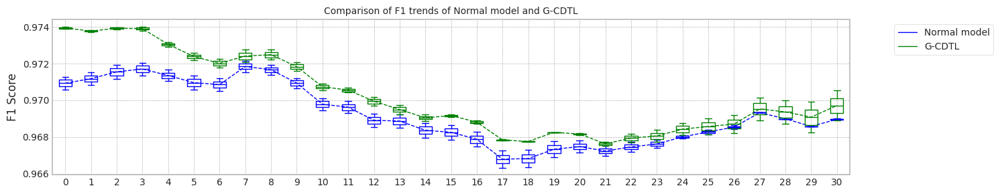

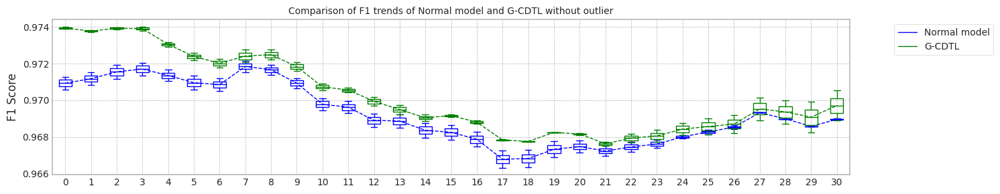

max_mean_trial= 1


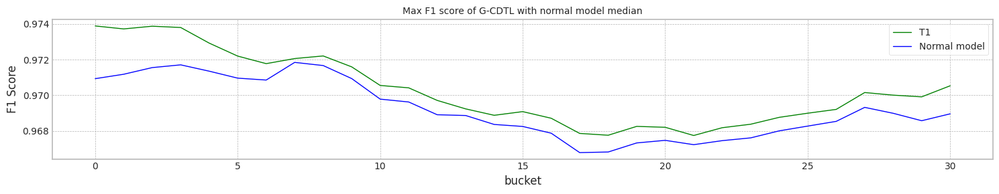

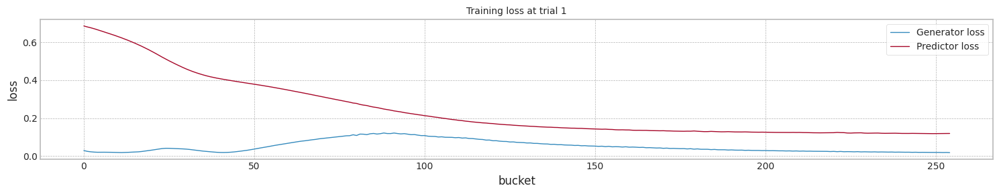

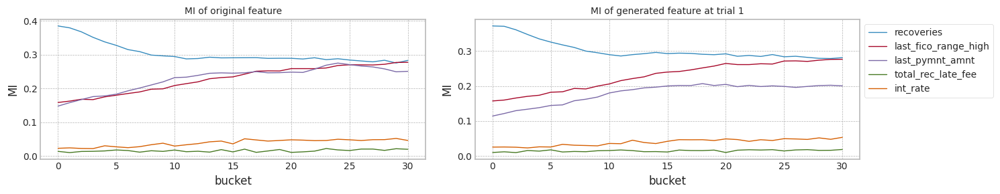

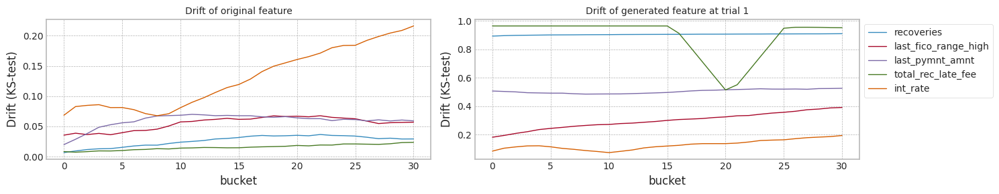

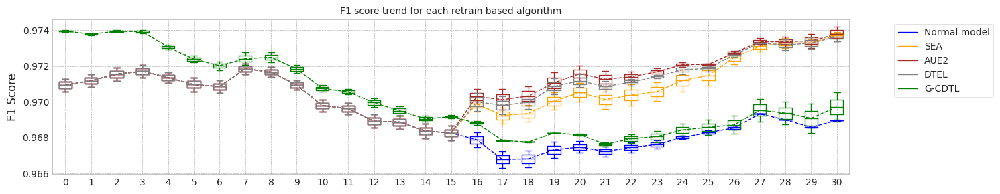

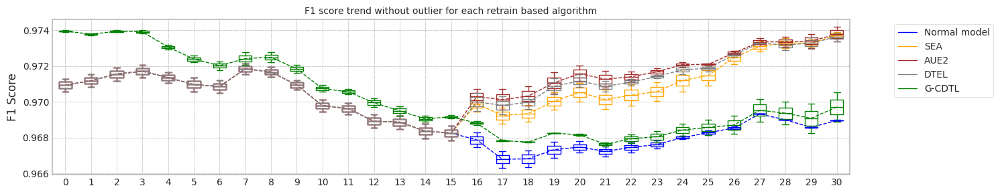

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.539852857589722
Base flops (inference flops of normal model, median): 258332145.0


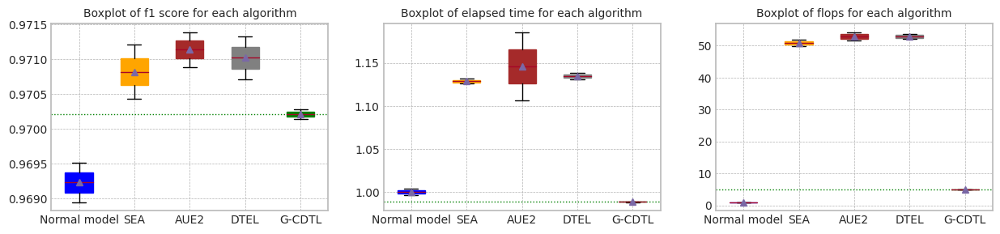

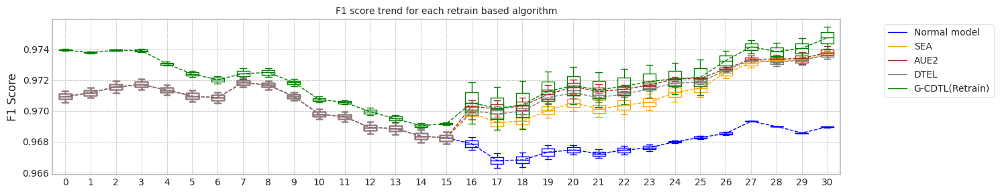

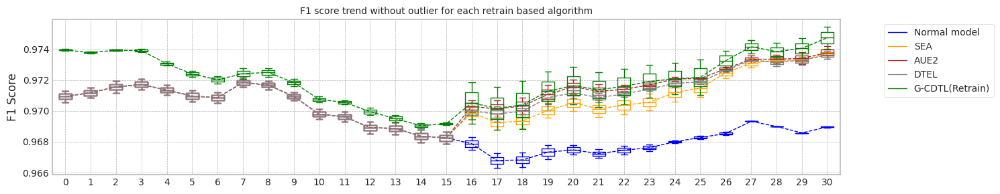

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.539852857589722
Base flops (train + inference flops of normal model, median): 5791640025.0


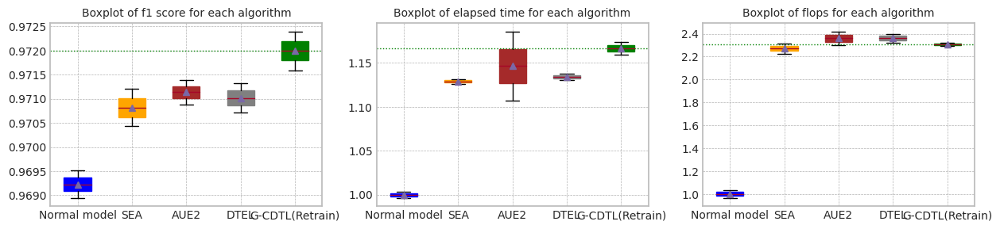

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.539852857589722


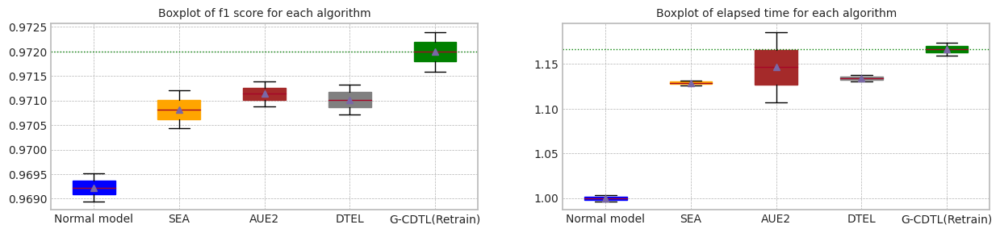

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.495823,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.583883,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.539853,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.062267,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.970144,0.968894,12.390810,1.241575e+10,1.297599e+09,1.371335e+10
1,1.0,0.973886,0.973720,0.970278,0.970535,12.400916,1.178012e+10,1.297599e+09,1.307772e+10
2,median,0.973942,0.973776,0.970211,0.969714,12.395863,1.209793e+10,1.297599e+09,1.339553e+10
3,std,0.000079,0.000079,0.000095,0.001160,0.007146,4.494578e+08,0.000000e+00,4.494578e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970431,0.973518,14.193351,6.189892e+09,7.223221e+09,1.341311e+10
1,1.0,0.971291,0.971524,0.971208,0.973904,14.119689,6.123772e+09,6.773769e+09,1.289754e+10
2,median,0.970932,0.971180,0.970819,0.973711,14.156520,6.156832e+09,6.998495e+09,1.315533e+10
3,std,0.000508,0.000487,0.000549,0.000273,0.052087,4.675390e+07,3.178103e+08,3.645642e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970887,0.974193,13.880955,6.012412e+09,7.304073e+09,1.331648e+10
1,1.0,0.971291,0.971524,0.971388,0.973356,14.871704,6.554422e+09,7.462751e+09,1.401717e+10
2,median,0.970932,0.971180,0.971138,0.973774,14.376330,6.283417e+09,7.383412e+09,1.366683e+10
3,std,0.000508,0.000487,0.000355,0.000591,0.700566,3.832589e+08,1.122026e+08,4.954615e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970708,0.973385,14.177282,6.232522e+09,7.657516e+09,1.389004e+10
1,1.0,0.971291,0.971524,0.971331,0.973867,14.273278,6.209032e+09,7.250694e+09,1.345973e+10
2,median,0.970932,0.971180,0.971020,0.973626,14.225280,6.220777e+09,7.454105e+09,1.367488e+10
3,std,0.000508,0.000487,0.000440,0.000341,0.067879,1.660994e+07,2.876663e+08,3.042762e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.971592,0.974023,14.725965,1.317251e+10,285918225.0,1.345843e+10
1,1.0,0.973886,0.973720,0.972398,0.975452,14.535504,1.300643e+10,285918225.0,1.329235e+10
2,median,0.973942,0.973776,0.971995,0.974738,14.630734,1.308947e+10,285918225.0,1.337539e+10
3,std,0.000079,0.000079,0.000570,0.001010,0.134676,1.174363e+08,0.0,1.174363e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 01:09:02,941] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 419.62it/s]

Early stop: 686
[2023-12-04 01:09:04,582] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.46it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:09:17,238] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:09:17,241] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 14%|█▍        | 282/2000 [00:02<00:13, 126.75it/s]

[2023-12-04 01:09:19,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:09:19,576] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 9487504250 2358322485 12415747485
precision_recall_fscore: (array([0.95940803, 0.95474035]), array([0.74909211, 0.99404762]), array([0.84130515, 0.97399757]), array([ 3029, 16128]))
Test f1 score: 0.9739975698663427
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]

mean of drift:
recoveries              0.791889
last_fico_range_high    0.231788
last_pymnt_amnt         0.510207
total_rec_late_fee      0.885026
int_rate                0.126363
dtype: float64
Mean F1 for all data: 0.9701435360233125
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9701435360233125
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 01:09:32,091] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 416.84it/s]

Early stop: 640
[2023-12-04 01:09:33,634] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:09:46,194] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:09:46,196] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 254/2000 [00:02<00:13, 126.57it/s]

[2023-12-04 01:09:48,407] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:09:48,408] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1106316750 8548811250 2124990225 11780118225
precision_recall_fscore: (array([0.9684529 , 0.95321499]), array([0.73984813, 0.99547371]), array([0.83885458, 0.97388614]), array([ 3029, 16128]))
Test f1 score: 0.9738861423675351
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]


mean of drift:
recoveries              0.904265
last_fico_range_high    0.297267
last_pymnt_amnt         0.504243
total_rec_late_fee      0.887199
int_rate                0.127513
dtype: float64
Mean F1 for all data: 0.9702782886982642
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9702109123607883
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:03<00:08,  2.52it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:10:05,296] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:10:05,299] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:10:07,257] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:10:07,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:19,  1.00it/s]

G-CDTL train flops: 94500000 913500000 227070000 1235070000


 68%|██████▊   | 21/31 [00:10<00:04,  2.33it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:10:11,793] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:10:11,795] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:10:13,603] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:10:13,604] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:12<00:08,  1.03it/s]

G-CDTL train flops: 112000000 836500000 207930000 1156430000


100%|██████████| 31/31 [00:16<00:00,  1.89it/s]


Early stop at  [260, 238]
Train flops  [1235070000, 1156430000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9724889949066705
G_CDTL+AUE median: 0.9724889949066705
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:14,  1.36it/s]

Ensemble_SEA train flops: 585510000


 71%|███████   | 22/31 [00:11<00:07,  1.16it/s]

Ensemble_SEA train flops: 799530000


100%|██████████| 31/31 [00:15<00:00,  2.04it/s]


Early stop at  [672, 918]
Train flops  [585510000, 799530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9705658267182677
SEA median: 0.9705658267182677
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:13,  1.48it/s]

Ensemble_SEA train flops: 470670000


 71%|███████   | 22/31 [00:11<00:08,  1.06it/s]

Ensemble_SEA train flops: 969180000


100%|██████████| 31/31 [00:15<00:00,  2.03it/s]


Early stop at  [540, 1113]
Train flops  [470670000, 969180000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9708640720037569
AUE median: 0.9708640720037569
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:21,  1.05s/it]

Ensemble_DTEL train flops: 1137960000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:12<00:07,  1.13it/s]

Ensemble_DTEL train flops: 809970000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:16<00:00,  1.91it/s]


Early stop at  [1307, 1, 930, 1]
Train flops  [1137960000, 1740000, 809970000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9698597378586643
DTEL median: 0.9698597378586643
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 32%|███▏      | 10/31 [00:03<00:08,  2.53it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:11:08,590] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:11:08,593] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:11:10,634] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:11:10,635] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 11/31 [00:06<00:20,  1.02s/it]

G-CDTL train flops: 84000000 973000000 241860000 1298860000


 68%|██████▊   | 21/31 [00:10<00:04,  2.33it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:11:15,116] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:11:15,119] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:11:16,984] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:11:16,985] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 22/31 [00:12<00:08,  1.01it/s]

G-CDTL train flops: 73500000 875000000 217500000 1166000000


100%|██████████| 31/31 [00:16<00:00,  1.88it/s]


Early stop at  [277, 249]
Train flops  [1298860000, 1166000000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9728779708126022
G_CDTL+AUE median: 0.9726834828596364
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:14,  1.39it/s]

Ensemble_SEA train flops: 558540000


 71%|███████   | 22/31 [00:11<00:06,  1.30it/s]

Ensemble_SEA train flops: 628140000


100%|██████████| 31/31 [00:14<00:00,  2.09it/s]


Early stop at  [641, 721]
Train flops  [558540000, 628140000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.970911245086851
SEA median: 0.9707385359025593
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:06<00:20,  1.04s/it]

Ensemble_SEA train flops: 1104900000


 71%|███████   | 22/31 [00:14<00:12,  1.42s/it]

Ensemble_SEA train flops: 1740000000


100%|██████████| 31/31 [00:18<00:00,  1.72it/s]


Early stop at  [1269, 1999]
Train flops  [1104900000, 1740000000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712023197923523
AUE median: 0.9710331958980546
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 35%|███▌      | 11/31 [00:05<00:16,  1.20it/s]

Ensemble_DTEL train flops: 750810000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 22/31 [00:11<00:07,  1.18it/s]

Ensemble_DTEL train flops: 782130000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:15<00:00,  2.00it/s]


Early stop at  [862, 1, 898, 1]
Train flops  [750810000, 1740000, 782130000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704735127799214
DTEL median: 0.9701666253192929


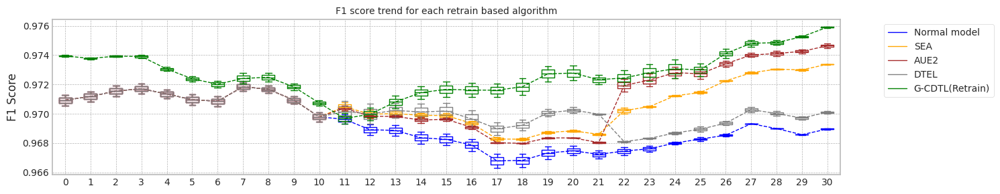

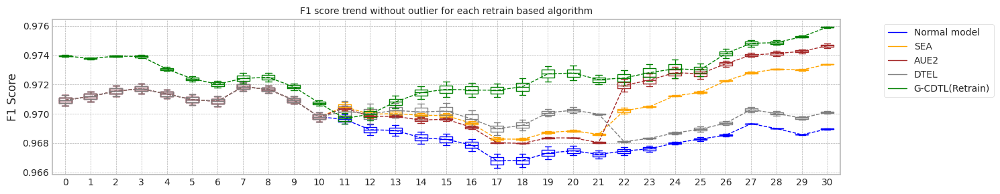

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.588154911994934
Base flops (train + inference flops of normal model, median): 5791640025.0


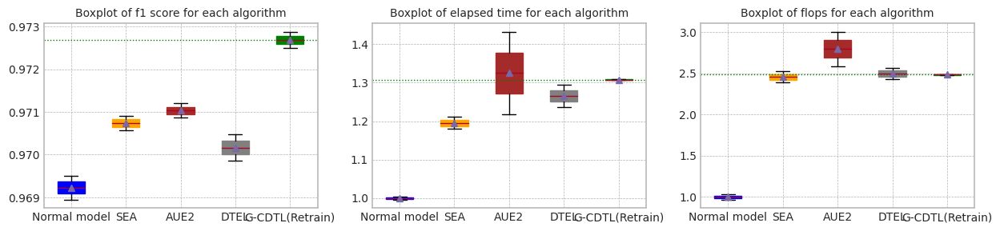

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.588154911994934


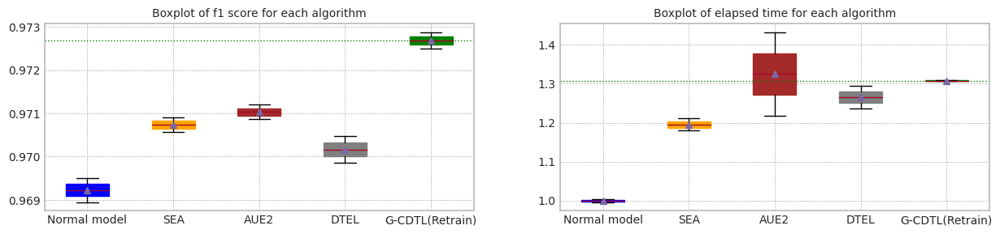

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.636597,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.539713,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.588155,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.068507,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.970144,0.968894,12.493609,1.241575e+10,1.297599e+09,1.371335e+10
1,1.0,0.973886,0.973720,0.970278,0.970535,12.459441,1.178012e+10,1.297599e+09,1.307772e+10
2,median,0.973942,0.973776,0.970211,0.969714,12.476525,1.209793e+10,1.297599e+09,1.339553e+10
3,std,0.000079,0.000079,0.000095,0.001160,0.024160,4.494578e+08,0.000000e+00,4.494578e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970566,0.973395,15.261872,6.726682e+09,7.876677e+09,1.460336e+10
1,1.0,0.971291,0.971524,0.970911,0.973351,14.845871,6.528322e+09,7.294985e+09,1.382331e+10
2,median,0.970932,0.971180,0.970739,0.973373,15.053872,6.627502e+09,7.585831e+09,1.421333e+10
3,std,0.000508,0.000487,0.000244,0.000031,0.294157,1.402617e+08,4.113181e+08,5.515798e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970864,0.974473,15.323604,6.781492e+09,8.189819e+09,1.497131e+10
1,1.0,0.971291,0.971524,0.971202,0.974798,18.034239,8.186542e+09,9.211537e+09,1.739808e+10
2,median,0.970932,0.971180,0.971033,0.974636,16.678922,7.484017e+09,8.700678e+09,1.618470e+10
3,std,0.000508,0.000487,0.000239,0.000230,1.916708,9.935204e+08,7.224640e+08,1.715984e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969860,0.970019,16.299287,7.293052e+09,7.580086e+09,1.487314e+10
1,1.0,0.971291,0.971524,0.970474,0.970208,15.553566,6.878062e+09,7.168914e+09,1.404698e+10
2,median,0.970932,0.971180,0.970167,0.970113,15.926426,7.085557e+09,7.374500e+09,1.446006e+10
3,std,0.000508,0.000487,0.000434,0.000134,0.527305,2.934422e+08,2.907422e+08,5.841844e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.972489,0.975940,16.445803,1.417162e+10,171550935.0,1.434317e+10
1,1.0,0.973886,0.973720,0.972878,0.975864,16.484834,1.424498e+10,171550935.0,1.441653e+10
2,median,0.973942,0.973776,0.972683,0.975902,16.465319,1.420830e+10,171550935.0,1.437985e+10
3,std,0.000079,0.000079,0.000275,0.000053,0.027600,5.187335e+07,0.0,5.187335e+07


trial_count: 2
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 01:12:13,402] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 406.98it/s]

Early stop: 686
[2023-12-04 01:12:15,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.45it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:12:27,821] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:12:27,824] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 14%|█▍        | 282/2000 [00:02<00:13, 122.84it/s]

[2023-12-04 01:12:30,230] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-12-04 01:12:30,232] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 569920750 9487504250 2358322485 12415747485
precision_recall_fscore: (array([0.95940803, 0.95474035]), array([0.74909211, 0.99404762]), array([0.84130515, 0.97399757]), array([ 3029, 16128]))
Test f1 score: 0.9739975698663427
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]

mean of drift:
recoveries              0.791889
last_fico_range_high    0.231788
last_pymnt_amnt         0.510207
total_rec_late_fee      0.885026
int_rate                0.126363
dtype: float64
Mean F1 for all data: 0.9701435360233125
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9701435360233125
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 01:12:42,654] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 414.27it/s]

Early stop: 640
[2023-12-04 01:12:44,204] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.45it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:12:56,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:12:56,931] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 254/2000 [00:02<00:14, 124.14it/s]

[2023-12-04 01:12:59,180] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:12:59,181] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1106316750 8548811250 2124990225 11780118225
precision_recall_fscore: (array([0.9684529 , 0.95321499]), array([0.73984813, 0.99547371]), array([0.83885458, 0.97388614]), array([ 3029, 16128]))
Test f1 score: 0.9738861423675351
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.50it/s]


mean of drift:
recoveries              0.904265
last_fico_range_high    0.297267
last_pymnt_amnt         0.504243
total_rec_late_fee      0.887199
int_rate                0.127513
dtype: float64
Mean F1 for all data: 0.9702782886982642
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9702109123607883
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.51it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:13:14,841] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:13:14,844] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:13:16,974] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:13:16,975] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:05<00:24,  1.08s/it]

G-CDTL train flops: 94500000 969500000 240990000 1304990000


 48%|████▊     | 15/31 [00:08<00:07,  2.23it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:13:20,164] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:13:20,167] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:13:22,080] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:13:22,081] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:10<00:15,  1.02s/it]

G-CDTL train flops: 112000000 861000000 214020000 1187020000


 74%|███████▍  | 23/31 [00:13<00:03,  2.17it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:13:25,379] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:13:25,381] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:13:27,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:13:27,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:15<00:07,  1.04s/it]

G-CDTL train flops: 91000000 871500000 216630000 1179130000


100%|██████████| 31/31 [00:18<00:00,  1.66it/s]


Early stop at  [276, 245, 248]
Train flops  [1304990000, 1187020000, 1179130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9724521371059482
G_CDTL+AUE median: 0.9724521371059482
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:25,  1.13s/it]

Ensemble_SEA train flops: 1204950000


 52%|█████▏    | 16/31 [00:10<00:14,  1.06it/s]

Ensemble_SEA train flops: 829980000


 77%|███████▋  | 24/31 [00:15<00:06,  1.08it/s]

Ensemble_SEA train flops: 834330000


100%|██████████| 31/31 [00:18<00:00,  1.70it/s]


Early stop at  [1384, 953, 958]
Train flops  [1204950000, 829980000, 834330000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9713691910242813
SEA median: 0.9713691910242813
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:19,  1.20it/s]

Ensemble_SEA train flops: 728190000


 52%|█████▏    | 16/31 [00:08<00:11,  1.35it/s]

Ensemble_SEA train flops: 534180000


 77%|███████▋  | 24/31 [00:13<00:05,  1.22it/s]

Ensemble_SEA train flops: 696870000


100%|██████████| 31/31 [00:16<00:00,  1.89it/s]


Early stop at  [836, 613, 800]
Train flops  [728190000, 534180000, 696870000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711426732523949
AUE median: 0.9711426732523949
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:22,  1.04it/s]

Ensemble_DTEL train flops: 932640000
Ensemble_DTEL train flops: 2610000


 48%|████▊     | 15/31 [00:07<00:07,  2.28it/s]

Ensemble_DTEL train flops: 783870000


 52%|█████▏    | 16/31 [00:10<00:15,  1.04s/it]

Ensemble_DTEL train flops: 284490000


 77%|███████▋  | 24/31 [00:14<00:05,  1.22it/s]

Ensemble_DTEL train flops: 632490000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:17<00:00,  1.76it/s]


Early stop at  [1071, 2, 900, 326, 726, 2]
Train flops  [932640000, 2610000, 783870000, 284490000, 632490000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9709881639156753
DTEL median: 0.9709881639156753
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 8
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:02<00:09,  2.42it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:14:25,965] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:14:25,968] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:14:28,532] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:14:28,533] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 26%|██▌       | 8/31 [00:05<00:28,  1.23s/it]

G-CDTL train flops: 63000000 1179500000 293190000 1535690000


 48%|████▊     | 15/31 [00:08<00:07,  2.10it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:14:31,836] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:14:31,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:14:33,860] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:14:33,861] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:11<00:16,  1.07s/it]

G-CDTL train flops: 80500000 920500000 228810000 1229810000


 74%|███████▍  | 23/31 [00:14<00:03,  2.12it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:14:37,217] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:14:37,220] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:14:39,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:14:39,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:16<00:07,  1.13s/it]

G-CDTL train flops: 49000000 1039500000 258390000 1346890000


100%|██████████| 31/31 [00:19<00:00,  1.58it/s]


Early stop at  [336, 262, 296]
Train flops  [1535690000, 1229810000, 1346890000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9727256904098626
G_CDTL+AUE median: 0.9725889137579053
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:05<00:23,  1.03s/it]

Ensemble_SEA train flops: 1044870000


 52%|█████▏    | 16/31 [00:09<00:11,  1.29it/s]

Ensemble_SEA train flops: 581160000


 77%|███████▋  | 24/31 [00:15<00:07,  1.13s/it]

Ensemble_SEA train flops: 1217130000


100%|██████████| 31/31 [00:18<00:00,  1.72it/s]


Early stop at  [1200, 667, 1398]
Train flops  [1044870000, 581160000, 1217130000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715993679389141
SEA median: 0.9714842794815977
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:16,  1.40it/s]

Ensemble_SEA train flops: 509820000


 52%|█████▏    | 16/31 [00:08<00:12,  1.17it/s]

Ensemble_SEA train flops: 764730000


 77%|███████▋  | 24/31 [00:13<00:06,  1.11it/s]

Ensemble_SEA train flops: 816060000


100%|██████████| 31/31 [00:16<00:00,  1.87it/s]


Early stop at  [585, 878, 937]
Train flops  [509820000, 764730000, 816060000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712542407310201
AUE median: 0.9711984569917075
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 26%|██▌       | 8/31 [00:04<00:16,  1.43it/s]

Ensemble_DTEL train flops: 503730000
Ensemble_DTEL train flops: 1740000


 52%|█████▏    | 16/31 [00:09<00:15,  1.00s/it]

Ensemble_DTEL train flops: 1026600000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:15<00:08,  1.22s/it]

Ensemble_DTEL train flops: 1273680000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:17<00:00,  1.72it/s]


Early stop at  [578, 1, 1179, 1, 1463, 1]
Train flops  [503730000, 1740000, 1026600000, 1740000, 1273680000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9697548341943903
DTEL median: 0.9703714990550328


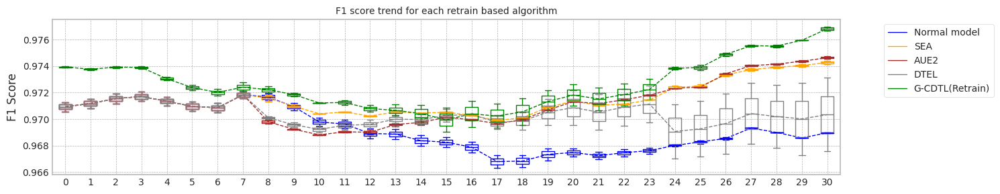

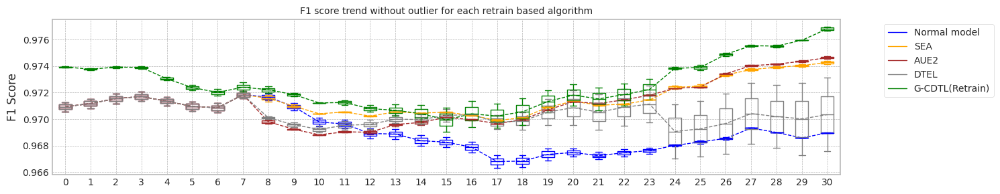

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.704479217529297
Base flops (train + inference flops of normal model, median): 5791640025.0


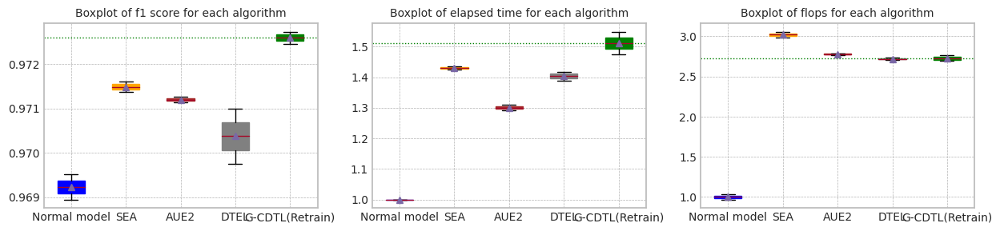

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.704479217529297


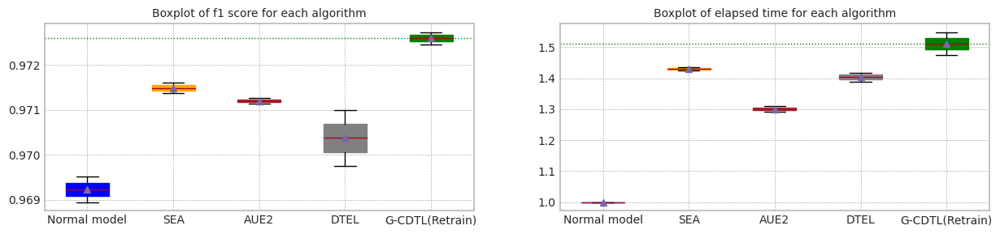

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.703956,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.705003,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.704479,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.000740,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.970144,0.968894,12.397594,1.241575e+10,1.297599e+09,1.371335e+10
1,1.0,0.973886,0.973720,0.970278,0.970535,12.429337,1.178012e+10,1.297599e+09,1.307772e+10
2,median,0.973942,0.973776,0.970211,0.969714,12.413466,1.209793e+10,1.297599e+09,1.339553e+10
3,std,0.000079,0.000079,0.000095,0.001160,0.022446,4.494578e+08,0.000000e+00,4.494578e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971369,0.974142,18.245843,8.210902e+09,9.494230e+09,1.770513e+10
1,1.0,0.971291,0.971524,0.971599,0.974424,18.107457,8.184802e+09,9.084798e+09,1.726960e+10
2,median,0.970932,0.971180,0.971484,0.974283,18.176650,8.197852e+09,9.289514e+09,1.748737e+10
3,std,0.000508,0.000487,0.000163,0.000199,0.097854,1.845549e+07,2.895118e+08,3.079673e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971143,0.974745,16.414481,7.300882e+09,8.842542e+09,1.614342e+10
1,1.0,0.971291,0.971524,0.971254,0.974540,16.632599,7.432252e+09,8.590580e+09,1.602283e+10
2,median,0.970932,0.971180,0.971198,0.974642,16.523540,7.366567e+09,8.716561e+09,1.608313e+10
3,std,0.000508,0.000487,0.000079,0.000145,0.154233,9.289262e+07,1.781637e+08,8.527112e+07


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970988,0.973120,17.651213,7.980352e+09,7.688836e+09,1.566919e+10
1,1.0,0.971291,0.971524,0.969755,0.967562,18.016785,8.150872e+09,7.662204e+09,1.581308e+10
2,median,0.970932,0.971180,0.970371,0.970341,17.833999,8.065612e+09,7.675520e+09,1.574113e+10
3,std,0.000508,0.000487,0.000872,0.003931,0.258498,1.205758e+08,1.883136e+07,1.017445e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.972452,0.976991,18.718918,1.545126e+10,133428505.0,1.558469e+10
1,1.0,0.973886,0.973720,0.972726,0.976673,19.674156,1.589251e+10,133428505.0,1.602594e+10
2,median,0.973942,0.973776,0.972589,0.976832,19.196537,1.567188e+10,133428505.0,1.580531e+10
3,std,0.000079,0.000079,0.000193,0.000224,0.675455,3.120109e+08,0.0,3.120109e+08


trial_count: 2
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 01:15:39,030] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 391.63it/s]

Early stop: 686
[2023-12-04 01:15:40,787] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.44it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:15:53,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:15:53,575] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 14%|█▍        | 282/2000 [00:02<00:14, 117.39it/s]

[2023-12-04 01:15:56,092] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:15:56,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 9487504250 2358322485 12415747485
precision_recall_fscore: (array([0.95940803, 0.95474035]), array([0.74909211, 0.99404762]), array([0.84130515, 0.97399757]), array([ 3029, 16128]))
Test f1 score: 0.9739975698663427
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]

mean of drift:
recoveries              0.791889
last_fico_range_high    0.231788
last_pymnt_amnt         0.510207
total_rec_late_fee      0.885026
int_rate                0.126363
dtype: float64
Mean F1 for all data: 0.9701435360233125
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9701435360233125
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 01:16:08,581] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 399.98it/s]

Early stop: 640
[2023-12-04 01:16:10,186] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:16:22,740] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:16:22,742] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 254/2000 [00:02<00:14, 118.21it/s]

[2023-12-04 01:16:25,108] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:16:25,109] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1106316750 8548811250 2124990225 11780118225
precision_recall_fscore: (array([0.9684529 , 0.95321499]), array([0.73984813, 0.99547371]), array([0.83885458, 0.97388614]), array([ 3029, 16128]))
Test f1 score: 0.9738861423675351
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.49it/s]


mean of drift:
recoveries              0.904265
last_fico_range_high    0.297267
last_pymnt_amnt         0.504243
total_rec_late_fee      0.887199
int_rate                0.127513
dtype: float64
Mean F1 for all data: 0.9702782886982642
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9702109123607883
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:09,  2.53it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:16:40,418] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:16:40,420] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:16:42,462] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:16:42,463] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:04<00:25,  1.07s/it]

G-CDTL train flops: 94500000 899500000 223590000 1217590000


 42%|████▏     | 13/31 [00:07<00:08,  2.11it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:16:45,272] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:16:45,274] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:16:47,320] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:16:47,321] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:09<00:18,  1.07s/it]

G-CDTL train flops: 112000000 896000000 222720000 1230720000


 65%|██████▍   | 20/31 [00:12<00:05,  2.03it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:16:50,248] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:16:50,250] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:16:52,425] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:16:52,427] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:14<00:11,  1.12s/it]

G-CDTL train flops: 91000000 945000000 234900000 1270900000


 87%|████████▋ | 27/31 [00:17<00:01,  2.02it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:16:55,321] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:16:55,323] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:16:57,619] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:16:57,620] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:19<00:03,  1.17s/it]

G-CDTL train flops: 101500000 1001000000 248820000 1351320000


100%|██████████| 31/31 [00:21<00:00,  1.46it/s]


Early stop at  [256, 255, 269, 285]
Train flops  [1217590000, 1230720000, 1270900000, 1351320000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9719829861348266
G_CDTL+AUE median: 0.9719829861348266
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:23,  1.01it/s]

Ensemble_SEA train flops: 879570000


 45%|████▌     | 14/31 [00:08<00:11,  1.50it/s]

Ensemble_SEA train flops: 372360000


 68%|██████▊   | 21/31 [00:12<00:08,  1.23it/s]

Ensemble_SEA train flops: 643800000


 90%|█████████ | 28/31 [00:17<00:03,  1.03s/it]

Ensemble_SEA train flops: 963090000


100%|██████████| 31/31 [00:18<00:00,  1.69it/s]


Early stop at  [1010, 427, 739, 1106]
Train flops  [879570000, 372360000, 643800000, 963090000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9710255193220678
SEA median: 0.9710255193220678
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:23,  1.04it/s]

Ensemble_SEA train flops: 878700000


 45%|████▌     | 14/31 [00:08<00:14,  1.20it/s]

Ensemble_SEA train flops: 672510000


 68%|██████▊   | 21/31 [00:13<00:11,  1.15s/it]

Ensemble_SEA train flops: 1145790000


 90%|█████████ | 28/31 [00:18<00:03,  1.06s/it]

Ensemble_SEA train flops: 994410000


100%|██████████| 31/31 [00:19<00:00,  1.56it/s]


Early stop at  [1009, 772, 1316, 1142]
Train flops  [878700000, 672510000, 1145790000, 994410000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9716229351529815
AUE median: 0.9716229351529815
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:05<00:29,  1.22s/it]

Ensemble_DTEL train flops: 1271070000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:10<00:20,  1.23s/it]

Ensemble_DTEL train flops: 1236270000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:14<00:08,  1.22it/s]

Ensemble_DTEL train flops: 474150000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:20<00:03,  1.24s/it]

Ensemble_DTEL train flops: 1330230000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:21<00:00,  1.43it/s]


Early stop at  [1460, 1, 1420, 1, 544, 1, 1528, 1]
Train flops  [1271070000, 1740000, 1236270000, 1740000, 474150000, 1740000, 1330230000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9701765674663698
DTEL median: 0.9701765674663698
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 7
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:02<00:09,  2.50it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:18:01,703] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:18:01,706] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:18:05,732] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:18:05,733] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 23%|██▎       | 7/31 [00:06<00:41,  1.72s/it]

G-CDTL train flops: 108500000 1802500000 448050000 2359050000


 42%|████▏     | 13/31 [00:09<00:09,  1.81it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:18:08,632] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:18:08,635] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:18:13,120] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:18:13,121] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 14/31 [00:14<00:31,  1.87s/it]

G-CDTL train flops: 56000000 2054500000 510690000 2621190000


 65%|██████▍   | 20/31 [00:16<00:06,  1.72it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:18:16,000] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:18:16,002] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:18:18,249] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:18:18,250] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 68%|██████▊   | 21/31 [00:19<00:12,  1.21s/it]

G-CDTL train flops: 143500000 941500000 234030000 1319030000


 87%|████████▋ | 27/31 [00:21<00:02,  1.98it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:18:21,134] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:18:21,136] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:18:26,593] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:18:26,594] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 28/31 [00:27<00:06,  2.12s/it]

G-CDTL train flops: 80500000 2443000000 607260000 3130760000


100%|██████████| 31/31 [00:28<00:00,  1.07it/s]


Early stop at  [514, 586, 268, 697]
Train flops  [2359050000, 2621190000, 1319030000, 3130760000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9702401184306724
G_CDTL+AUE median: 0.9711115522827495
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:23,  1.03it/s]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 14/31 [00:08<00:15,  1.10it/s]

Ensemble_SEA train flops: 771690000


 68%|██████▊   | 21/31 [00:13<00:09,  1.00it/s]

Ensemble_SEA train flops: 893490000


 90%|█████████ | 28/31 [00:18<00:02,  1.05it/s]

Ensemble_SEA train flops: 822150000


100%|██████████| 31/31 [00:19<00:00,  1.59it/s]


Early stop at  [999, 886, 1026, 944]
Train flops  [870000000, 771690000, 893490000, 822150000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715103974730905
SEA median: 0.9712679583975792
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:22,  1.06it/s]

Ensemble_SEA train flops: 823890000


 45%|████▌     | 14/31 [00:08<00:14,  1.14it/s]

Ensemble_SEA train flops: 736890000


 68%|██████▊   | 21/31 [00:12<00:07,  1.39it/s]

Ensemble_SEA train flops: 452400000


 90%|█████████ | 28/31 [00:17<00:03,  1.04s/it]

Ensemble_SEA train flops: 998760000


100%|██████████| 31/31 [00:18<00:00,  1.67it/s]


Early stop at  [946, 846, 519, 1147]
Train flops  [823890000, 736890000, 452400000, 998760000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9721987849135504
AUE median: 0.971910860033266
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 23%|██▎       | 7/31 [00:04<00:22,  1.07it/s]

Ensemble_DTEL train flops: 796920000
Ensemble_DTEL train flops: 1740000


 45%|████▌     | 14/31 [00:08<00:15,  1.10it/s]

Ensemble_DTEL train flops: 773430000
Ensemble_DTEL train flops: 1740000


 68%|██████▊   | 21/31 [00:13<00:09,  1.08it/s]

Ensemble_DTEL train flops: 792570000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 28/31 [00:18<00:03,  1.28s/it]

Ensemble_DTEL train flops: 1412880000
Ensemble_DTEL train flops: 1740000


100%|██████████| 31/31 [00:20<00:00,  1.54it/s]


Early stop at  [915, 1, 888, 1, 910, 1, 1623, 1]
Train flops  [796920000, 1740000, 773430000, 1740000, 792570000, 1740000, 1412880000, 1740000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9706180120334442
DTEL median: 0.970397289749907


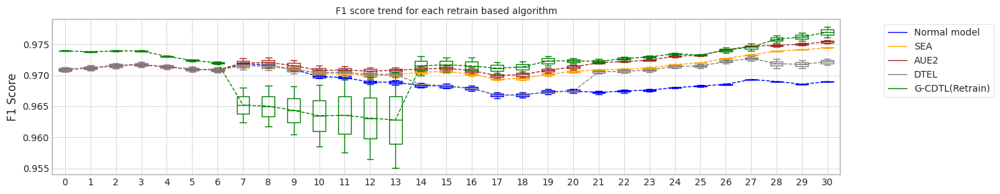

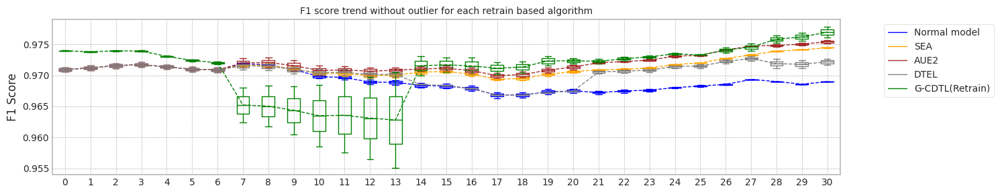

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.644989967346191
Base flops (train + inference flops of normal model, median): 5791640025.0


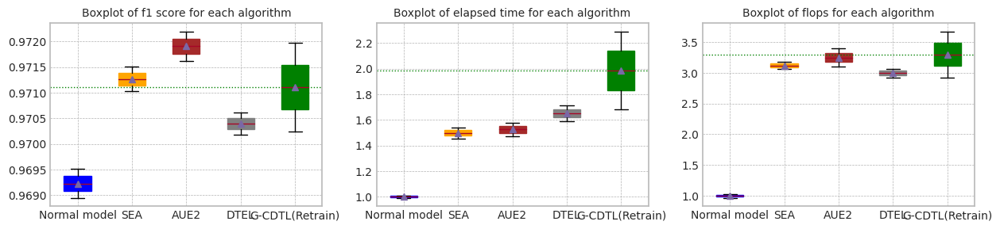

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.644989967346191


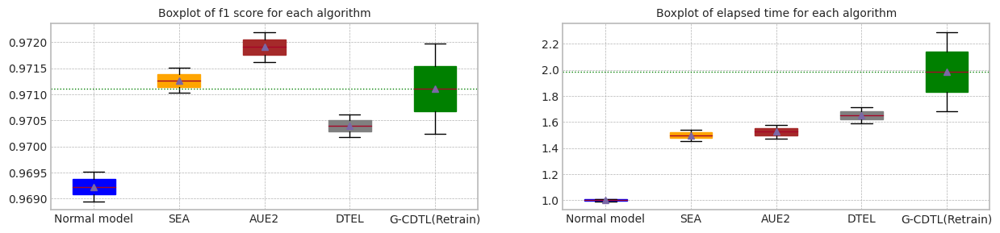

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.760908,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.529072,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.644990,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.163933,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.970144,0.968894,12.464754,1.241575e+10,1.297599e+09,1.371335e+10
1,1.0,0.973886,0.973720,0.970278,0.970535,12.486883,1.178012e+10,1.297599e+09,1.307772e+10
2,median,0.973942,0.973776,0.970211,0.969714,12.475818,1.209793e+10,1.297599e+09,1.339553e+10
3,std,0.000079,0.000079,0.000095,0.001160,0.015648,4.494578e+08,0.000000e+00,4.494578e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971026,0.974405,18.406319,8.200462e+09,9.558789e+09,1.775925e+10
1,1.0,0.971291,0.971524,0.971510,0.974443,19.485901,8.698972e+09,9.673968e+09,1.837294e+10
2,median,0.970932,0.971180,0.971268,0.974424,18.946110,8.449717e+09,9.616378e+09,1.806610e+10
3,std,0.000508,0.000487,0.000343,0.000027,0.763380,3.524998e+08,8.144345e+07,4.339433e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971623,0.975692,19.942856,9.033052e+09,1.064971e+10,1.968276e+10
1,1.0,0.971291,0.971524,0.972199,0.975094,18.601094,8.353582e+09,9.586910e+09,1.794049e+10
2,median,0.970932,0.971180,0.971911,0.975393,19.271975,8.693317e+09,1.011831e+10,1.881163e+10
3,std,0.000508,0.000487,0.000407,0.000423,0.948769,4.804578e+08,7.515142e+08,1.231972e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.970177,0.972674,21.665270,9.660322e+09,8.103826e+09,1.776415e+10
1,1.0,0.971291,0.971524,0.970618,0.971668,20.118998,9.124402e+09,7.803144e+09,1.692755e+10
2,median,0.970932,0.971180,0.970397,0.972171,20.892134,9.392362e+09,7.953485e+09,1.734585e+10
3,std,0.000508,0.000487,0.000312,0.000711,1.093379,3.789527e+08,2.126140e+08,5.915666e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.971983,0.976071,21.251267,1.685065e+10,57183645.0,1.690783e+10
1,1.0,0.973886,0.973720,0.970240,0.977817,28.961835,2.121015e+10,57183645.0,2.126733e+10
2,median,0.973942,0.973776,0.971112,0.976944,25.106551,1.903040e+10,57183645.0,1.908758e+10
3,std,0.000079,0.000079,0.001232,0.001235,5.452195,3.082632e+09,0.0,3.082632e+09


trial_count: 2
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 01:19:30,332] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:01<00:03, 371.00it/s]

Early stop: 686
[2023-12-04 01:19:32,187] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.44it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9689477522000828
inference_flops: 258332145
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:19:44,979] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:19:44,981] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 14%|█▍        | 282/2000 [00:02<00:14, 114.57it/s]

[2023-12-04 01:19:47,568] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:19:47,569] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 569920750 9487504250 2358322485 12415747485
precision_recall_fscore: (array([0.95940803, 0.95474035]), array([0.74909211, 0.99404762]), array([0.84130515, 0.97399757]), array([ 3029, 16128]))
Test f1 score: 0.9739975698663427
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.50it/s]

mean of drift:
recoveries              0.791889
last_fico_range_high    0.231788
last_pymnt_amnt         0.510207
total_rec_late_fee      0.885026
int_rate                0.126363
dtype: float64
Mean F1 for all data: 0.9701435360233125
inference_flops: 1297599395
Normal model median        : 0.9689477522000828
Drift tolerant model median: 0.9701435360233125
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-12-04 01:20:00,043] [INFO] [profiler.py:80:start_profile] Flops profiler started



 32%|███▏      | 640/2000 [00:01<00:03, 387.84it/s]

Early stop: 640
[2023-12-04 01:20:01,700] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5341642095
precision_recall_fscore: (array([0.92195714, 0.95510669]), array([0.75272367, 0.98803323]), array([0.82878953, 0.97129099]), array([ 3029, 16128]))
Test f1 score: 0.9712909911008168
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.48it/s]

mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9695089781604371
inference_flops: 258332145
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19157, 6])
[2023-12-04 01:20:14,267] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:20:14,269] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 13%|█▎        | 254/2000 [00:02<00:15, 114.54it/s]

[2023-12-04 01:20:16,710] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:20:16,711] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 1106316750 8548811250 2124990225 11780118225
precision_recall_fscore: (array([0.9684529 , 0.95321499]), array([0.73984813, 0.99547371]), array([0.83885458, 0.97388614]), array([ 3029, 16128]))
Test f1 score: 0.9738861423675351
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


100%|██████████| 31/31 [00:12<00:00,  2.51it/s]


mean of drift:
recoveries              0.904265
last_fico_range_high    0.297267
last_pymnt_amnt         0.504243
total_rec_late_fee      0.887199
int_rate                0.127513
dtype: float64
Mean F1 for all data: 0.9702782886982642
inference_flops: 1297599395
Normal model median        : 0.96922836518026
Drift tolerant model median: 0.9702109123607883
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:01<00:10,  2.53it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:20:31,543] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:20:31,546] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:20:33,796] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:20:33,797] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:04<00:29,  1.17s/it]

G-CDTL train flops: 94500000 945000000 234900000 1274400000


 35%|███▌      | 11/31 [00:06<00:10,  1.94it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:20:36,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:20:36,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:20:38,320] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:20:38,321] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:09<00:21,  1.13s/it]

G-CDTL train flops: 112000000 868000000 215760000 1195760000


 55%|█████▍    | 17/31 [00:11<00:07,  1.88it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:20:40,806] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:20:40,808] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:20:43,110] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:20:43,111] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:13<00:15,  1.20s/it]

G-CDTL train flops: 91000000 962500000 239250000 1292750000


 74%|███████▍  | 23/31 [00:16<00:04,  1.84it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:20:45,597] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:20:45,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:20:49,996] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:20:49,998] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:20<00:12,  1.83s/it]

G-CDTL train flops: 98000000 1886500000 468930000 2453430000


 94%|█████████▎| 29/31 [00:22<00:01,  1.54it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:20:52,486] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:20:52,488] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:20:54,786] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:20:54,787] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:25<00:01,  1.27s/it]

G-CDTL train flops: 70000000 976500000 242730000 1289230000


100%|██████████| 31/31 [00:26<00:00,  1.19it/s]


Early stop at  [269, 247, 274, 538, 278]
Train flops  [1274400000, 1195760000, 1292750000, 2453430000, 1289230000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9729867572641012
G_CDTL+AUE median: 0.9729867572641012
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:21,  1.19it/s]

Ensemble_SEA train flops: 650760000


 39%|███▊      | 12/31 [00:07<00:18,  1.01it/s]

Ensemble_SEA train flops: 857820000


 58%|█████▊    | 18/31 [00:12<00:13,  1.01s/it]

Ensemble_SEA train flops: 876960000


 77%|███████▋  | 24/31 [00:16<00:06,  1.03it/s]

Ensemble_SEA train flops: 796050000


 97%|█████████▋| 30/31 [00:20<00:01,  1.04s/it]

Ensemble_SEA train flops: 903930000


100%|██████████| 31/31 [00:20<00:00,  1.48it/s]


Early stop at  [747, 985, 1007, 914, 1038]
Train flops  [650760000, 857820000, 876960000, 796050000, 903930000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9711175965760679
SEA median: 0.9711175965760679
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:05<00:36,  1.46s/it]

Ensemble_SEA train flops: 1557300000


 39%|███▊      | 12/31 [00:09<00:16,  1.16it/s]

Ensemble_SEA train flops: 555930000


 58%|█████▊    | 18/31 [00:13<00:13,  1.07s/it]

Ensemble_SEA train flops: 1010070000


 77%|███████▋  | 24/31 [00:17<00:06,  1.08it/s]

Ensemble_SEA train flops: 716010000


 97%|█████████▋| 30/31 [00:21<00:01,  1.07s/it]

Ensemble_SEA train flops: 995280000


100%|██████████| 31/31 [00:22<00:00,  1.39it/s]


Early stop at  [1789, 638, 1160, 822, 1143]
Train flops  [1557300000, 555930000, 1010070000, 716010000, 995280000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9712888666969133
AUE median: 0.9712888666969133
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:21,  1.15it/s]

Ensemble_DTEL train flops: 662940000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:08<00:19,  1.01s/it]

Ensemble_DTEL train flops: 910020000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:13<00:19,  1.47s/it]

Ensemble_DTEL train flops: 1636470000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:17<00:07,  1.06s/it]

Ensemble_DTEL train flops: 866520000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:22<00:01,  1.11s/it]

Ensemble_DTEL train flops: 1030950000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:22<00:00,  1.35it/s]


Early stop at  [761, 1, 1045, 1, 1880, 1, 995, 2, 1184, 2]
Train flops  [662940000, 1740000, 910020000, 1740000, 1636470000, 1740000, 866520000, 2610000, 1030950000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9696813476817351
DTEL median: 0.9696813476817351
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 6
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 16%|█▌        | 5/31 [00:01<00:10,  2.53it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:22:03,984] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:22:03,986] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:22:06,385] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:22:06,386] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▉        | 6/31 [00:04<00:30,  1.21s/it]

G-CDTL train flops: 87500000 1008000000 250560000 1346060000


 35%|███▌      | 11/31 [00:06<00:10,  1.92it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:22:08,773] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:22:08,776] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:22:11,028] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:22:11,029] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 39%|███▊      | 12/31 [00:09<00:22,  1.17s/it]

G-CDTL train flops: 80500000 927500000 230550000 1238550000


 55%|█████▍    | 17/31 [00:11<00:07,  1.82it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:22:13,523] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:22:13,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:22:16,085] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:22:16,086] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 58%|█████▊    | 18/31 [00:14<00:16,  1.28s/it]

G-CDTL train flops: 80500000 1043000000 259260000 1382760000


 74%|███████▍  | 23/31 [00:16<00:04,  1.81it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:22:18,535] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:22:18,538] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:22:23,331] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:22:23,332] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 77%|███████▋  | 24/31 [00:21<00:13,  1.95s/it]

G-CDTL train flops: 1844500000 805000000 200100000 2849600000


 94%|█████████▎| 29/31 [00:23<00:01,  1.49it/s]

G-CDTL Train: torch.Size([2000, 6])
[2023-12-04 01:22:25,831] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-12-04 01:22:25,834] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-12-04 01:22:30,561] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-12-04 01:22:30,562] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 97%|█████████▋| 30/31 [00:28<00:02,  2.02s/it]

G-CDTL train flops: 45500000 2058000000 511560000 2615060000


100%|██████████| 31/31 [00:29<00:00,  1.06it/s]


Early stop at  [287, 264, 297, 229, 587]
Train flops  [1346060000, 1238550000, 1382760000, 2849600000, 2615060000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9725664188623964
G_CDTL+AUE median: 0.9727765880632488
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:20,  1.22it/s]

Ensemble_SEA train flops: 590730000


 39%|███▊      | 12/31 [00:07<00:19,  1.01s/it]

Ensemble_SEA train flops: 897840000


 58%|█████▊    | 18/31 [00:12<00:15,  1.20s/it]

Ensemble_SEA train flops: 1156230000


 77%|███████▋  | 24/31 [00:16<00:07,  1.03s/it]

Ensemble_SEA train flops: 856950000


 97%|█████████▋| 30/31 [00:20<00:00,  1.11it/s]

Ensemble_SEA train flops: 683820000


100%|██████████| 31/31 [00:21<00:00,  1.46it/s]


Early stop at  [678, 1031, 1328, 984, 785]
Train flops  [590730000, 897840000, 1156230000, 856950000, 683820000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9715388974373196
SEA median: 0.9713282470066937
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:04<00:28,  1.13s/it]

Ensemble_SEA train flops: 1054440000


 39%|███▊      | 12/31 [00:09<00:22,  1.21s/it]

Ensemble_SEA train flops: 1181460000


 58%|█████▊    | 18/31 [00:13<00:12,  1.02it/s]

Ensemble_SEA train flops: 789090000


 77%|███████▋  | 24/31 [00:17<00:06,  1.02it/s]

Ensemble_SEA train flops: 809970000


 97%|█████████▋| 30/31 [00:21<00:00,  1.16it/s]

Ensemble_SEA train flops: 625530000


100%|██████████| 31/31 [00:21<00:00,  1.43it/s]


Early stop at  [1211, 1357, 906, 930, 718]
Train flops  [1054440000, 1181460000, 789090000, 809970000, 625530000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9580149166477061
AUE median: 0.9646518916723097
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set torch.Size([31, 19157, 6])


 19%|█▉        | 6/31 [00:03<00:21,  1.14it/s]

Ensemble_DTEL train flops: 688170000
Ensemble_DTEL train flops: 1740000


 39%|███▊      | 12/31 [00:08<00:21,  1.13s/it]

Ensemble_DTEL train flops: 1101420000
Ensemble_DTEL train flops: 1740000


 58%|█████▊    | 18/31 [00:12<00:12,  1.03it/s]

Ensemble_DTEL train flops: 787350000
Ensemble_DTEL train flops: 1740000


 77%|███████▋  | 24/31 [00:16<00:07,  1.07s/it]

Ensemble_DTEL train flops: 970050000
Ensemble_DTEL train flops: 2610000


 97%|█████████▋| 30/31 [00:21<00:01,  1.12s/it]

Ensemble_DTEL train flops: 1006590000
Ensemble_DTEL train flops: 2610000


100%|██████████| 31/31 [00:21<00:00,  1.42it/s]


Early stop at  [790, 1, 1265, 1, 904, 1, 1114, 2, 1156, 2]
Train flops  [688170000, 1740000, 1101420000, 1740000, 787350000, 1740000, 970050000, 2610000, 1006590000, 2610000]
Mean of drift:
recoveries              0.026107
last_fico_range_high    0.054955
last_pymnt_amnt         0.059522
total_rec_late_fee      0.015453
int_rate                0.129595
dtype: float64
Mean F1 for all data: 0.9704439393300356
DTEL median: 0.9700626435058853


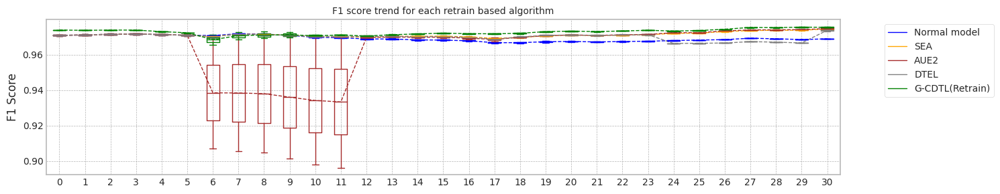

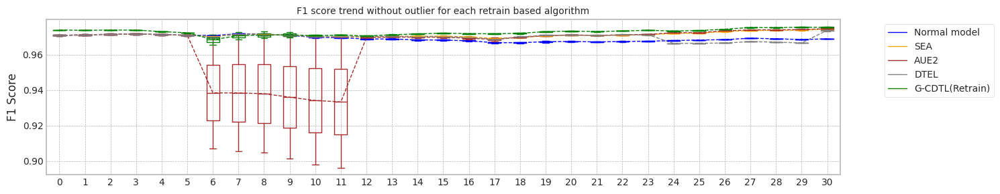

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.655796885490417
Base flops (train + inference flops of normal model, median): 5791640025.0


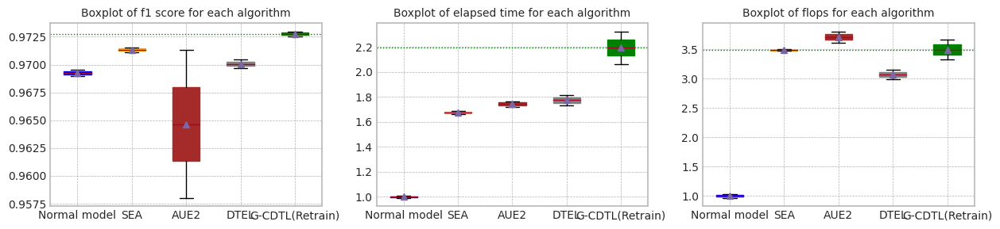

Base elapsed time (inference elapsed time of normal model, median (ms)): 12.655796885490417


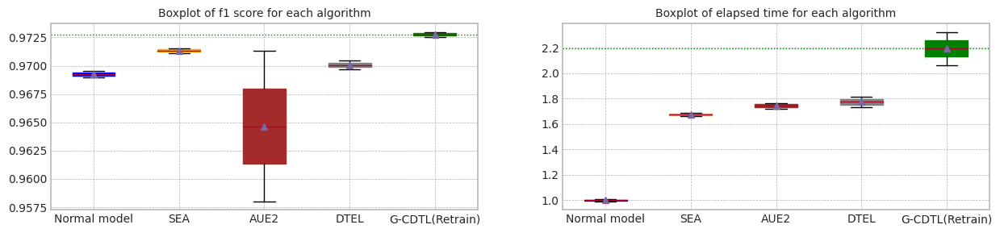

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.968948,0.968927,12.765043,5.724974e+09,258332145.0,5.983306e+09
1,1.0,0.971291,0.971524,0.969509,0.968998,12.546551,5.341642e+09,258332145.0,5.599974e+09
2,median,0.970932,0.971180,0.969228,0.968963,12.655797,5.533308e+09,258332145.0,5.791640e+09
3,std,0.000508,0.000487,0.000397,0.000050,0.154497,2.710564e+08,0.0,2.710564e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.970144,0.968894,12.449846,1.241575e+10,1.297599e+09,1.371335e+10
1,1.0,0.973886,0.973720,0.970278,0.970535,12.372638,1.178012e+10,1.297599e+09,1.307772e+10
2,median,0.973942,0.973776,0.970211,0.969714,12.411242,1.209793e+10,1.297599e+09,1.339553e+10
3,std,0.000079,0.000079,0.000095,0.001160,0.054594,4.494578e+08,0.000000e+00,4.494578e+08


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971118,0.974161,21.027208,9.427162e+09,1.087716e+10,2.030432e+10
1,1.0,0.971291,0.971524,0.971539,0.974868,21.330116,9.527212e+09,1.059387e+10,2.012109e+10
2,median,0.970932,0.971180,0.971328,0.974515,21.178662,9.477187e+09,1.073551e+10,2.021270e+10
3,std,0.000508,0.000487,0.000298,0.000500,0.214188,7.074603e+07,2.003103e+08,1.295643e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.971289,0.974603,22.356310,1.017623e+10,1.188456e+10,2.206079e+10
1,1.0,0.971291,0.971524,0.958015,0.974947,21.724788,9.802132e+09,1.112713e+10,2.092926e+10
2,median,0.970932,0.971180,0.964652,0.974775,22.040549,9.989182e+09,1.150584e+10,2.149502e+10
3,std,0.000508,0.000487,0.009386,0.000243,0.446554,2.645286e+08,5.355850e+08,8.001136e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.970573,0.970835,0.969681,0.973311,22.961344,1.045898e+10,7.808026e+09,1.826701e+10
1,1.0,0.971291,0.971524,0.970444,0.974352,21.927494,9.905662e+09,7.400334e+09,1.730600e+10
2,median,0.970932,0.971180,0.970063,0.973832,22.444419,1.018232e+10,7.604180e+09,1.778650e+10
3,std,0.000508,0.000487,0.000539,0.000736,0.731042,3.912563e+08,2.882815e+08,6.795378e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.973998,0.973832,0.972987,0.975131,26.116835,1.928569e+10,19061215.0,1.930475e+10
1,1.0,0.973886,0.973720,0.972566,0.975844,29.414102,2.121215e+10,19061215.0,2.123121e+10
2,median,0.973942,0.973776,0.972777,0.975488,27.765469,2.024892e+10,19061215.0,2.026798e+10
3,std,0.000079,0.000079,0.000297,0.000505,2.331520,1.362213e+09,0.0,1.362213e+09


Test F1 Score: 0.9709319896192645
G-CDTL, 1-retrain: 0.9719952080977247


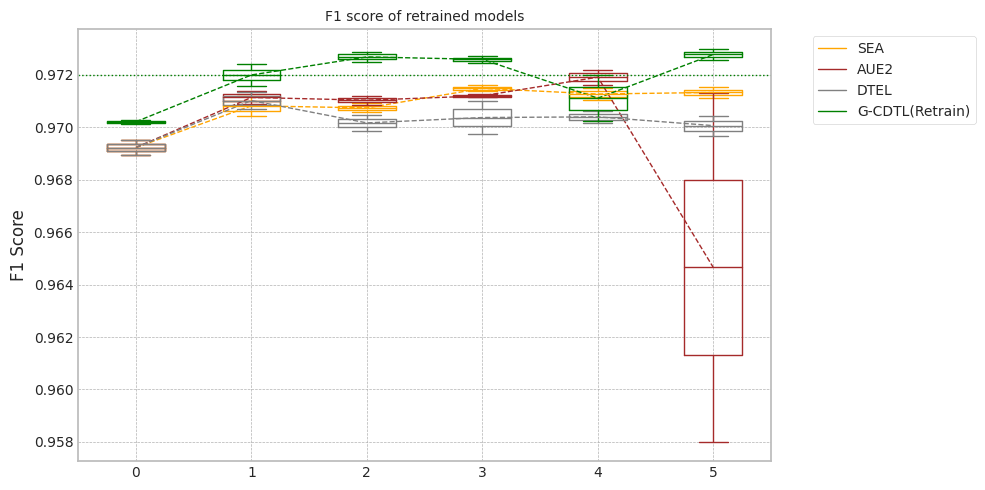

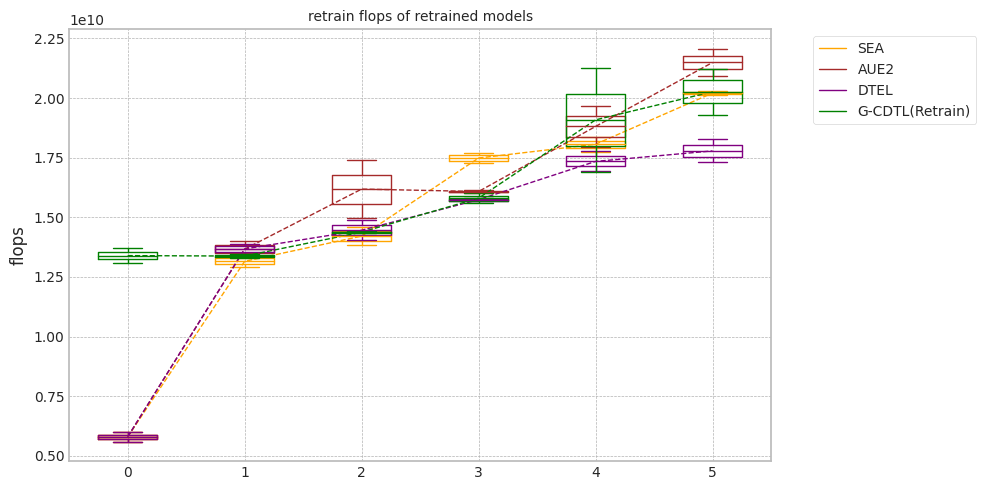

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 400,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

In [131]:
# importing the modules
from IPython.display import display
import time

def drift_tolerant2(m_epochs,experiment_title,X, Y,train_size, test_size,avaible_range = 400,lambda_f2 = 1.0,trial_count=20,lr_g=0.001,retrain_count=1, weight_init = False,isTest = False):

    seed_everything()

    print('trial_count:',trial_count)
    columns = X.columns[:-1]
    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    train_tensors = Namespace(XS_train = torch.tensor(X_train.values, dtype=torch.float32),
                            y_train = torch.tensor(Y_train, dtype=torch.float32))
    test_tensors = Namespace(XS_test = torch.tensor(X_test.values, dtype=torch.float32),
                            y_test = torch.tensor(Y_test, dtype=torch.float32))

    train_opt = Namespace(val=0, n_epochs=m_epochs, k=5, lr_g=lr_g, lr_f=0.001, lr_r=0.001,weight_init=weight_init)

    lambda_f_set = np.asarray([[-0.1,0.0] for v in range(trial_count)]).reshape(-1,) # np.concatenate([[-0.1 for v in range(trial_count)],[0.0 for v in range(trial_count)]])
    lambda_a2 = 0.0

    print('Lambda : ',lambda_f2)
    # Normal model
    nor_result_data,nor_train_data,nor_result_table = prepare_result_data()
    #G-CDTL
    gcd_result_data,gcd_train_data,gcd_result_table = prepare_result_data()

    #G-CDTL+SEA
    gea_result_data,gea_train_data,gea_result_table = prepare_result_data()
    #SEA
    sea_result_data,sea_train_data,sea_result_table = prepare_result_data()
    #AUE
    aue_result_data,aue_train_data,aue_result_table = prepare_result_data()
    #DTEL
    dte_result_data,dte_train_data,dte_result_table = prepare_result_data()

    org_g_cdtls = []
    org_discriminators = []

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(nor_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
        else:
            idx = len(gcd_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)
            print(f'######################### Retrain {retrain_count} Trial {idx} for G-CDTL ###########################')


        f1,model, df_loss, train_flops = train_model(train_tensors, test_tensors, train_opt, lambda_f = lambda_f, avaible_range = avaible_range, alpha= lambda_f2,columns = columns,ShowChart=False)# 0.00057)

        start = time.time()
        tad,df_mis,df_drf, inference_flops = test_all_data(model,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
        inference_time = time.time() - start
        print('inference_flops:',inference_flops)
        if lambda_f < 0.0:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,nor_result_data,nor_train_data,nor_result_table,[train_flops],inference_flops)
            org_discriminators.append((model,df_loss['Predictor loss'][-1:].values[0]))
            org_flops = train_flops
        else:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,gcd_result_data,gcd_train_data,gcd_result_table,[train_flops],inference_flops)
            org_g_cdtls.append((model,df_loss['Predictor loss'][-1:].values[0]))
            gdc_flops = train_flops

            print('Normal model median        :',np.median(nor_result_table['Mean F1']))
            print('Drift tolerant model median:',np.median(gcd_result_table['Mean F1']))



    if isTest:
        original_statistics_df = pd.DataFrame(nor_result_table)
        drift_statistics_df = pd.DataFrame(gcd_result_table)
        return original_statistics_df,drift_statistics_df

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(sea_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
            retrain_interval = int(len(tad)/(retrain_count+1)) + 1
            # 중간에 1회 retrain 하도록 함.
            print('retrain_interval:',retrain_interval)

            ensemble_gcdtl = G_CDTL_AUE2(10,retrain_interval,avaible_range,lambda_f2,do_early_stop=True)
            ensemble_gcdtl.add_model(org_g_cdtls[idx][0],None,None)

            ensemble_sea = Ensemble_SEA(10,retrain_interval)
            ensemble_sea.add_model(org_discriminators[idx][0],None,None)

            ensemble_aue = Ensemble_AUE2(10,retrain_interval)
            ensemble_aue.add_model(org_discriminators[idx][0],None,None)

            ensemble_dte = Ensemble_DTEL(10,retrain_interval)
            ensemble_dte.add_model(org_discriminators[idx][0],None,None)

        else:

            # f1 은 normal model과 같다.

            idx = len(sea_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)

            print(f'######################### Retrain {retrain_count} Trial {idx} for G_CDTL+AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(retrain_count,train_opt,ensemble_gcdtl,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,gea_result_data,gea_train_data,gea_result_table,train_flops+[gdc_flops],inference_flops)
            print('G_CDTL+AUE median:',np.median(gea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for SEA ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(retrain_count,train_opt,ensemble_sea,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,sea_result_data,sea_train_data,sea_result_table,train_flops+[org_flops],inference_flops)
            print('SEA median:',np.median(sea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(retrain_count,train_opt,ensemble_aue,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,aue_result_data,aue_train_data,aue_result_table,train_flops+[org_flops],inference_flops)
            print('AUE median:',np.median(aue_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for DTEL ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(retrain_count,train_opt,ensemble_dte,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,dte_result_data,dte_train_data,dte_result_table,train_flops+[org_flops],inference_flops)
            print('DTEL median:',np.median(dte_result_table['Mean F1']))


    Orginal_df = pd.DataFrame(nor_result_data)
    Driftto_df = pd.DataFrame(gcd_result_data)

    GEA_df = pd.DataFrame(gea_result_data)
    SEA_df = pd.DataFrame(sea_result_data)
    AUE_df = pd.DataFrame(aue_result_data)
    DTEL_df = pd.DataFrame(dte_result_data)

    original_statistics_df = pd.DataFrame(nor_result_table)
    drift_statistics_df = pd.DataFrame(gcd_result_table)

    gea_statistics_df = pd.DataFrame(gea_result_table)
    sea_statistics_df = pd.DataFrame(sea_result_table)
    aue_statistics_df = pd.DataFrame(aue_result_table)
    dte_statistics_df = pd.DataFrame(dte_result_table)

    set_mean_sem(original_statistics_df)
    set_mean_sem(drift_statistics_df)

    set_mean_sem(gea_statistics_df)
    set_mean_sem(sea_statistics_df)
    set_mean_sem(aue_statistics_df)
    set_mean_sem(dte_statistics_df)

    if retrain_count == 1:

        #G-CDTL 과 Normal model 의 plot
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL')
        plt.tight_layout()
        plt.show()
        #G-CDTL 과 Normal model 의 plot, outlier 제거
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL without outlier')
        plt.tight_layout()
        plt.show()
        # Best case를 찾는다.
        max_mean_trial = int(drift_statistics_df[drift_statistics_df['Mean F1']==np.max(drift_statistics_df['Mean F1'])]['Trial'].values[0])
        print('max_mean_trial=',max_mean_trial)

        # Best case에 대한 G-CDTL
        fig, ax = plt.subplots(figsize=main_figsize)
        Driftto_df[[f'T{max_mean_trial}']].plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='green',label=f'Drift tolerant model (T{max_mean_trial})')
        Orginal_df.T.median().plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='blue',label='Normal model')
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        ax.set_title('Max F1 score of G-CDTL with normal model median',fontdict={'fontsize':10})
        plt.tight_layout()
        plt.show()

        # Best case에 대한 G-CDTL의 loss
        og_loss,og_mis,og_drf = nor_train_data['T0']
        df_loss,df_mis,df_drf = gcd_train_data[f'T{max_mean_trial}']

        ax = df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        ax.set_title(f'Training loss at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        # Best case에서 Generator 이전, 이후의 MI
        fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
        og_mis.astype(np.float32).plot(ax = ax[0],linewidth=1,ylabel='MI',xlabel='bucket',legend=None)
        ax[0].set_title(f'MI of original feature',fontdict={'fontsize':10})
        df_mis.astype(np.float32).plot(ax = ax[1],linewidth=1,ylabel='MI',xlabel='bucket')
        ax[1].set_title(f'MI of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()
        # Best case에서 Generator 이전, 이후의 Drift
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        og_drf.astype(np.float32).plot(ax=ax[0],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket',legend=None)
        ax[0].set_title(f'Drift of original feature',fontdict={'fontsize':10})
        df_drf.astype(np.float32).plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket')
        ax[1].set_title(f'Drift of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
        plt.tight_layout()
        plt.show()


    if retrain_count == 1:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
        # mean f1
        box = ax[0].boxplot(
                    [original_statistics_df['Mean F1'][0:trial_count].values,
                    sea_statistics_df['Mean F1'][0:trial_count].values,
                    aue_statistics_df['Mean F1'][0:trial_count].values,
                    dte_statistics_df['Mean F1'][0:trial_count].values,
                    [i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[0].axhline(y = np.median(drift_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

        # Elapsed time
        median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
        print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
        box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    drift_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[1].axhline(y = np.median(drift_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

        # flops
        median_time = np.median(original_statistics_df['Inference flops'][0:trial_count].values)
        print('Base flops (inference flops of normal model, median):',median_time)
        box = ax[2].boxplot([original_statistics_df['Inference flops'][0:trial_count].values/median_time,
                    sea_statistics_df['flops'][0:trial_count].values/median_time,
                    aue_statistics_df['flops'][0:trial_count].values/median_time,
                    dte_statistics_df['flops'][0:trial_count].values/median_time,
                    drift_statistics_df['Inference flops'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[2].axhline(y = np.median(drift_statistics_df['Inference flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=True)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
    set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
    set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

    # flops
    median_time = np.median(original_statistics_df['flops'][0:trial_count].values)
    print('Base flops (train + inference flops of normal model, median):',median_time)
    box = ax[2].boxplot([original_statistics_df['flops'][0:trial_count].values/median_time,
                 sea_statistics_df['flops'][0:trial_count].values/median_time,
                 aue_statistics_df['flops'][0:trial_count].values/median_time,
                 dte_statistics_df['flops'][0:trial_count].values/median_time,
                 gea_statistics_df['flops'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[2].axhline(y = np.median(gea_statistics_df['flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

    plt.show()

    ############################################################################
    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})
    plt.show()
    ############################################################################

    print('@ Normal model')
    display(original_statistics_df)
    original_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_NM.csv",index=False)
    print('@ G-CDTL')
    display(drift_statistics_df)
    drift_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_G-CDTL.csv",index=False)
    print('@ SEA')
    display(sea_statistics_df)
    sea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_SEA.csv",index=False)
    print('@ AUE2')
    display(aue_statistics_df)
    aue_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_AUE2.csv",index=False)
    print('@ DTEL')
    display(dte_statistics_df)
    dte_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_DTEL.csv",index=False)
    print('@ G-CDTL+Retrain')
    display(gea_statistics_df)
    gea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_GEA.csv",index=False)


    del X_train
    del Y_train
    del X_test
    del Y_test
    del X_live
    del Y_live
    del train_tensors
    del test_tensors
    del train_opt

    del nor_result_data
    del nor_train_data
    del nor_result_table

    del gcd_result_data
    del gcd_train_data
    del gcd_result_table

    del gea_result_data
    del gea_train_data
    del gea_result_table

    del sea_result_data
    del sea_train_data
    del sea_result_table

    del aue_result_data
    del aue_train_data
    del aue_result_table

    del dte_result_data
    del dte_train_data
    del dte_result_table

    del ensemble_gcdtl
    del ensemble_sea
    del ensemble_aue
    del ensemble_dte

    del Orginal_df
    del Driftto_df
    del GEA_df
    del SEA_df
    del AUE_df
    del DTEL_df

    return original_statistics_df, drift_statistics_df, sea_statistics_df, aue_statistics_df, dte_statistics_df, gea_statistics_df

In [136]:

def compare_algorithm(retrain_count,train_opt,ensemble,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    '''
    for i in range(int(X_live[(train_size-test_size):].shape[0]/test_size)):
        xl = X_live[train_size+i*test_size - test_size:train_size+i*test_size]
        yl = Y_live[train_size+i*test_size - test_size:train_size+i*test_size]
        if len(xl) ==  test_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break
    '''
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        #X_live_unit = X_live_unit[:,0:b_dim]
        predicted_y = (ensemble.predict(X_live_unit) > 0.5).astype(float)
        #predicted_y = (predicted_y.cpu().data.numpy()

        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        X_live_unit2 = X_live_unit[:,0:b_dim]
        cpu_xs = X_live_unit2.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

        # 여기서 새로운 liveset으로 새로운 모델 하나를 학습한다.
        Y_live_unit = torch.tensor(np.asarray(Y_live_unit),dtype=torch.float32).to(device)
        #new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)

        if isinstance(ensemble,G_CDTL_AUE2) and retrain_count == 4 and ensemble.tc == 0:
            print('retrain:',type(ensemble).__name__, retrain_count,ensemble.tc)
            new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
            ensemble.add_model(copy.deepcopy(ensemble.models),X_live_unit[-test_size:],Y_live_unit[-test_size:])
        elif isinstance(ensemble,Ensemble_AUE2) and retrain_count == 5 and ensemble.tc == 0:
            print('retrain:',type(ensemble).__name__, retrain_count,ensemble.tc)
            new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
            if new_model is not None:
                new_model = copy.deepcopy(ensemble.models[-1])
            ensemble.add_model(new_model,X_live_unit[-test_size:],Y_live_unit[-test_size:])
        else:
            new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
            ensemble.add_model(new_model,X_live_unit[-test_size:],Y_live_unit[-test_size:])

    print('Early stop at ',ensemble.early_stop_at)
    print('Train flops ',ensemble.train_flops)

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'Mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf, ensemble.train_flops, ensemble.get_inference_flops()

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 400,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

trial_count: 2
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-12-04 06:19:24,381] [INFO] [profiler.py:80:start_profile] Flops profiler started


 34%|███▍      | 686/2000 [00:02<00:04, 273.45it/s]

Early stop: 686
[2023-12-04 06:19:26,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5724973665
precision_recall_fscore: (array([0.9141252 , 0.95493549]), array([0.75206339, 0.98673115]), array([0.82521282, 0.97057299]), array([ 3029, 16128]))
Test f1 score: 0.9705729881377123
X_live.shape (79896, 6)
Truncate 17896 rows from live_set (79896, 6)
Search MI & Drift...for X_live_set (31, 19157, 6)


 81%|████████  | 25/31 [00:10<00:02,  2.29it/s]

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 1000,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 2000,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)

In [ ]:
experiment_all(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 10000,
               lambda_f2=0.8,trial_count=2,lr_g=0.004,retrain_count=5,weight_init=True)